# DonorsChoose

<p>
DonorsChoose.org receives hundreds of thousands of project proposals each year for classroom projects in need of funding. Right now, a large number of volunteers is needed to manually screen each submission before it's approved to be posted on the DonorsChoose.org website.
</p>
<p>
    Next year, DonorsChoose.org expects to receive close to 500,000 project proposals. As a result, there are three main problems they need to solve:
<ul>
<li>
    How to scale current manual processes and resources to screen 500,000 projects so that they can be posted as quickly and as efficiently as possible</li>
    <li>How to increase the consistency of project vetting across different volunteers to improve the experience for teachers</li>
    <li>How to focus volunteer time on the applications that need the most assistance</li>
    </ul>
</p>    
<p>
The goal of the competition is to predict whether or not a DonorsChoose.org project proposal submitted by a teacher will be approved, using the text of project descriptions as well as additional metadata about the project, teacher, and school. DonorsChoose.org can then use this information to identify projects most likely to need further review before approval.
</p>

## About the DonorsChoose Data Set

The `train.csv` data set provided by DonorsChoose contains the following features:

Feature | Description 
----------|---------------
**`project_id`** | A unique identifier for the proposed project. **Example:** `p036502`   
**`project_title`**    | Title of the project. **Examples:**<br><ul><li><code>Art Will Make You Happy!</code></li><li><code>First Grade Fun</code></li></ul> 
**`project_grade_category`** | Grade level of students for which the project is targeted. One of the following enumerated values: <br/><ul><li><code>Grades PreK-2</code></li><li><code>Grades 3-5</code></li><li><code>Grades 6-8</code></li><li><code>Grades 9-12</code></li></ul>  
 **`project_subject_categories`** | One or more (comma-separated) subject categories for the project from the following enumerated list of values:  <br/><ul><li><code>Applied Learning</code></li><li><code>Care &amp; Hunger</code></li><li><code>Health &amp; Sports</code></li><li><code>History &amp; Civics</code></li><li><code>Literacy &amp; Language</code></li><li><code>Math &amp; Science</code></li><li><code>Music &amp; The Arts</code></li><li><code>Special Needs</code></li><li><code>Warmth</code></li></ul><br/> **Examples:** <br/><ul><li><code>Music &amp; The Arts</code></li><li><code>Literacy &amp; Language, Math &amp; Science</code></li>  
  **`school_state`** | State where school is located ([Two-letter U.S. postal code](https://en.wikipedia.org/wiki/List_of_U.S._state_abbreviations#Postal_codes)). **Example:** `WY`
**`project_subject_subcategories`** | One or more (comma-separated) subject subcategories for the project. **Examples:** <br/><ul><li><code>Literacy</code></li><li><code>Literature &amp; Writing, Social Sciences</code></li></ul> 
**`project_resource_summary`** | An explanation of the resources needed for the project. **Example:** <br/><ul><li><code>My students need hands on literacy materials to manage sensory needs!</code</li></ul> 
**`project_essay_1`**    | First application essay<sup>*</sup>  
**`project_essay_2`**    | Second application essay<sup>*</sup> 
**`project_essay_3`**    | Third application essay<sup>*</sup> 
**`project_essay_4`**    | Fourth application essay<sup>*</sup> 
**`project_submitted_datetime`** | Datetime when project application was submitted. **Example:** `2016-04-28 12:43:56.245`   
**`teacher_id`** | A unique identifier for the teacher of the proposed project. **Example:** `bdf8baa8fedef6bfeec7ae4ff1c15c56`  
**`teacher_prefix`** | Teacher's title. One of the following enumerated values: <br/><ul><li><code>nan</code></li><li><code>Dr.</code></li><li><code>Mr.</code></li><li><code>Mrs.</code></li><li><code>Ms.</code></li><li><code>Teacher.</code></li></ul>  
**`teacher_number_of_previously_posted_projects`** | Number of project applications previously submitted by the same teacher. **Example:** `2` 

<sup>*</sup> See the section <b>Notes on the Essay Data</b> for more details about these features.

Additionally, the `resources.csv` data set provides more data about the resources required for each project. Each line in this file represents a resource required by a project:

Feature | Description 
----------|---------------
**`id`** | A `project_id` value from the `train.csv` file.  **Example:** `p036502`   
**`description`** | Desciption of the resource. **Example:** `Tenor Saxophone Reeds, Box of 25`   
**`quantity`** | Quantity of the resource required. **Example:** `3`   
**`price`** | Price of the resource required. **Example:** `9.95`   

**Note:** Many projects require multiple resources. The `id` value corresponds to a `project_id` in train.csv, so you use it as a key to retrieve all resources needed for a project:

The data set contains the following label (the value you will attempt to predict):

Label | Description
----------|---------------
`project_is_approved` | A binary flag indicating whether DonorsChoose approved the project. A value of `0` indicates the project was not approved, and a value of `1` indicates the project was approved.

### Notes on the Essay Data

<ul>
Prior to May 17, 2016, the prompts for the essays were as follows:
<li>__project_essay_1:__ "Introduce us to your classroom"</li>
<li>__project_essay_2:__ "Tell us more about your students"</li>
<li>__project_essay_3:__ "Describe how your students will use the materials you're requesting"</li>
<li>__project_essay_3:__ "Close by sharing why your project will make a difference"</li>
</ul>


<ul>
Starting on May 17, 2016, the number of essays was reduced from 4 to 2, and the prompts for the first 2 essays were changed to the following:<br>
<li>__project_essay_1:__ "Describe your students: What makes your students special? Specific details about their background, your neighborhood, and your school are all helpful."</li>
<li>__project_essay_2:__ "About your project: How will these materials make a difference in your students' learning and improve their school lives?"</li>
<br>For all projects with project_submitted_datetime of 2016-05-17 and later, the values of project_essay_3 and project_essay_4 will be NaN.
</ul>


In [1]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

import sqlite3
import pandas as pd
import numpy as np
import nltk
import string
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from nltk.stem.porter import PorterStemmer

import re
# Tutorial about Python regular expressions: https://pymotw.com/2/re/
import string
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer

from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import pickle

from tqdm import tqdm
import os

from plotly import plotly
import plotly.offline as offline
import plotly.graph_objs as go
offline.init_notebook_mode()
from collections import Counter

C:\Users\samar\Anaconda3\lib\site-packages\gensim\utils.py:1197: UserWarning: detected Windows; aliasing chunkize to chunkize_serial
  warnings.warn("detected Windows; aliasing chunkize to chunkize_serial")


## 1.1 Reading Data

In [2]:
project_data = pd.read_csv('train_data.csv')
resource_data = pd.read_csv('resources.csv')

In [3]:
print("Number of data points in train data", project_data.shape)
print('-'*50)
print("The attributes of data :", project_data.columns.values)

Number of data points in train data (109248, 17)
--------------------------------------------------
The attributes of data : ['Unnamed: 0' 'id' 'teacher_id' 'teacher_prefix' 'school_state'
 'project_submitted_datetime' 'project_grade_category'
 'project_subject_categories' 'project_subject_subcategories'
 'project_title' 'project_essay_1' 'project_essay_2' 'project_essay_3'
 'project_essay_4' 'project_resource_summary'
 'teacher_number_of_previously_posted_projects' 'project_is_approved']


In [4]:
print("Number of data points in train data", resource_data.shape)
print(resource_data.columns.values)
resource_data.head(2)

Number of data points in train data (1541272, 4)
['id' 'description' 'quantity' 'price']


,id,description,quantity,price
0,p233245,LC652 - Lakeshore Double-Space Mobile Drying Rack,1,149.00
1,p069063,Bouncy Bands for Desks (Blue support pipes),3,14.95


## 1.2 preprocessing of `project_subject_categories`

In [5]:
catogories = list(project_data['project_subject_categories'].values)
# remove special characters from list of strings python: https://stackoverflow.com/a/47301924/4084039

# https://www.geeksforgeeks.org/removing-stop-words-nltk-python/
# https://stackoverflow.com/questions/23669024/how-to-strip-a-specific-word-from-a-string
# https://stackoverflow.com/questions/8270092/remove-all-whitespace-in-a-string-in-python
cat_list = []
for i in catogories:
    temp = ""
    # consider we have text like this "Math & Science, Warmth, Care & Hunger"
    for j in i.split(','): # it will split it in three parts ["Math & Science", "Warmth", "Care & Hunger"]
        if 'The' in j.split(): # this will split each of the catogory based on space "Math & Science"=> "Math","&", "Science"
            j=j.replace('The','') # if we have the words "The" we are going to replace it with ''(i.e removing 'The')
        j = j.replace(' ','') # we are placeing all the ' '(space) with ''(empty) ex:"Math & Science"=>"Math&Science"
        temp+=j.strip()+" " #" abc ".strip() will return "abc", remove the trailing spaces
        temp = temp.replace('&','_') # we are replacing the & value into 
    cat_list.append(temp.strip())
    
project_data['clean_categories'] = cat_list
project_data.drop(['project_subject_categories'], axis=1, inplace=True)

from collections import Counter
my_counter = Counter()
for word in project_data['clean_categories'].values:
    my_counter.update(word.split())

cat_dict = dict(my_counter)
sorted_cat_dict = dict(sorted(cat_dict.items(), key=lambda kv: kv[1]))


## 1.3 preprocessing of `project_subject_subcategories`

In [6]:
sub_catogories = list(project_data['project_subject_subcategories'].values)
# remove special characters from list of strings python: https://stackoverflow.com/a/47301924/4084039

# https://www.geeksforgeeks.org/removing-stop-words-nltk-python/
# https://stackoverflow.com/questions/23669024/how-to-strip-a-specific-word-from-a-string
# https://stackoverflow.com/questions/8270092/remove-all-whitespace-in-a-string-in-python

sub_cat_list = []
for i in sub_catogories:
    temp = ""
    # consider we have text like this "Math & Science, Warmth, Care & Hunger"
    for j in i.split(','): # it will split it in three parts ["Math & Science", "Warmth", "Care & Hunger"]
        if 'The' in j.split(): # this will split each of the catogory based on space "Math & Science"=> "Math","&", "Science"
            j=j.replace('The','') # if we have the words "The" we are going to replace it with ''(i.e removing 'The')
        j = j.replace(' ','') # we are placeing all the ' '(space) with ''(empty) ex:"Math & Science"=>"Math&Science"
        temp +=j.strip()+" "#" abc ".strip() will return "abc", remove the trailing spaces
        temp = temp.replace('&','_')
    sub_cat_list.append(temp.strip())

project_data['clean_subcategories'] = sub_cat_list
project_data.drop(['project_subject_subcategories'], axis=1, inplace=True)

# count of all the words in corpus python: https://stackoverflow.com/a/22898595/4084039
my_counter = Counter()
for word in project_data['clean_subcategories'].values:
    my_counter.update(word.split())
    
sub_cat_dict = dict(my_counter)
sorted_sub_cat_dict = dict(sorted(sub_cat_dict.items(), key=lambda kv: kv[1]))

## 1.4 preprocessing of project_grade_category

In [7]:
prj_grade_cat = list(project_data['project_grade_category'].values)
# remove special characters from list of strings python: https://stackoverflow.com/a/47301924/4084039

# https://www.geeksforgeeks.org/removing-stop-words-nltk-python/
# https://stackoverflow.com/questions/23669024/how-to-strip-a-specific-word-from-a-string
# https://stackoverflow.com/questions/8270092/remove-all-whitespace-in-a-string-in-python

prj_grade_cat_list = []
for i in prj_grade_cat:
    for j in i.split(' '): # it will split by space
        j=j.replace('Grades','') # if we have the words "Grades" we are going to replace it with ''(i.e removing 'Grades')
    prj_grade_cat_list.append(j.strip())

project_data['clean_grade'] = prj_grade_cat_list
project_data.drop(['project_grade_category'], axis=1, inplace=True)

# count of all the words in corpus python: https://stackoverflow.com/a/22898595/4084039
my_counter = Counter()
for word in project_data['clean_grade'].values:
    my_counter.update(word.split())
    
prj_grade_cat_dict = dict(my_counter)
sorted_prj_grade_cat_dict = dict(sorted(prj_grade_cat_dict.items(), key=lambda kv: kv[1]))

project_data['clean_grade'].values

array(['PreK-2', '6-8', '6-8', ..., 'PreK-2', '3-5', '6-8'], dtype=object)

## 1.5 preprocessing of teacher_prefix

In [8]:
#tea_pfx_cat = list(project_data['teacher_prefix'].values)
tea_pfx_cat = list(project_data['teacher_prefix'].astype(str).values)
# remove special characters from list of strings python: https://stackoverflow.com/a/47301924/4084039

# https://www.geeksforgeeks.org/removing-stop-words-nltk-python/
# https://stackoverflow.com/questions/23669024/how-to-strip-a-specific-word-from-a-string
# https://stackoverflow.com/questions/8270092/remove-all-whitespace-in-a-string-in-python

##https://stackoverflow.com/questions/52736900/how-to-solve-the-attribute-error-float-object-has-no-attribute-split-in-pyth
#vectorizer.fit(project_data['teacher_prefix'].astype(str).values)

tea_pfx_cat_list = []
for i in tea_pfx_cat:
    #for j in i.split(' '): # it will split by space
    #j=j.replace('.','') # if we have the words "Grades" we are going to replace it with ''(i.e removing 'Grades')
    i=i.replace('.','') # if we have the words "Grades" we are going to replace it with ''(i.e removing 'Grades')
    i=i.replace('nan','') # if we have the words "Grades" we are going to replace it with ''(i.e removing 'Grades')
    tea_pfx_cat_list.append(i.strip())

project_data['clean_tea_pfx'] = tea_pfx_cat_list
project_data.drop(['teacher_prefix'], axis=1, inplace=True)

# count of all the words in corpus python: https://stackoverflow.com/a/22898595/4084039
my_counter = Counter()
for word in project_data['clean_tea_pfx'].values:
    my_counter.update(word.split())
    
tea_pfx_cat_dict = dict(my_counter)
sorted_tea_pfx_cat_dict = dict(sorted(tea_pfx_cat_dict.items(), key=lambda kv: kv[1]))

project_data['clean_tea_pfx'].values

array(['Mrs', 'Mr', 'Ms', ..., 'Mrs', 'Mrs', 'Ms'], dtype=object)

## 1.6 Text preprocessing

In [9]:
# merge two column text dataframe: 
project_data["essay"] = project_data["project_essay_1"].map(str) +\
                        project_data["project_essay_2"].map(str) + \
                        project_data["project_essay_3"].map(str) + \
                        project_data["project_essay_4"].map(str)

In [10]:
project_data.head(2)

,Unnamed: 0,id,teacher_id,school_state,project_submitted_datetime,project_title,project_essay_1,project_essay_2,project_essay_3,project_essay_4,project_resource_summary,teacher_number_of_previously_posted_projects,project_is_approved,clean_categories,clean_subcategories,clean_grade,clean_tea_pfx,essay
0,160221,p253737,c90749f5d961ff158d4b4d1e7dc665fc,IN,2016-12-05 13:43:57,Educational Support for English Learners at Home,My students are English learners that are work...,"\""The limits of your language are the limits o...",NaN,NaN,My students need opportunities to practice beg...,0,0,Literacy_Language,ESL Literacy,PreK-2,Mrs,My students are English learners that are work...
1,140945,p258326,897464ce9ddc600bced1151f324dd63a,FL,2016-10-25 09:22:10,Wanted: Projector for Hungry Learners,Our students arrive to our school eager to lea...,The projector we need for our school is very c...,NaN,NaN,My students need a projector to help with view...,7,1,History_Civics Health_Sports,Civics_Government TeamSports,6-8,Mr,Our students arrive to our school eager to lea...


In [11]:
#### 1.4.2.3 Using Pretrained Models: TFIDF weighted W2V

In [12]:
# printing some random reviews
print(project_data['essay'].values[0])
print("="*50)
print(project_data['essay'].values[150])
print("="*50)
print(project_data['essay'].values[1000])
print("="*50)
print(project_data['essay'].values[20000])
print("="*50)
print(project_data['essay'].values[99999])
print("="*50)

My students are English learners that are working on English as their second or third languages. We are a melting pot of refugees, immigrants, and native-born Americans bringing the gift of language to our school. \r\n\r\n We have over 24 languages represented in our English Learner program with students at every level of mastery.  We also have over 40 countries represented with the families within our school.  Each student brings a wealth of knowledge and experiences to us that open our eyes to new cultures, beliefs, and respect.\"The limits of your language are the limits of your world.\"-Ludwig Wittgenstein  Our English learner's have a strong support system at home that begs for more resources.  Many times our parents are learning to read and speak English along side of their children.  Sometimes this creates barriers for parents to be able to help their child learn phonetics, letter recognition, and other reading skills.\r\n\r\nBy providing these dvd's and players, students are ab

In [13]:
# https://stackoverflow.com/a/47091490/4084039
import re

def decontracted(phrase):
    # specific
    phrase = re.sub(r"won't", "will not", phrase)
    phrase = re.sub(r"can\'t", "can not", phrase)

    # general
    phrase = re.sub(r"n\'t", " not", phrase)
    phrase = re.sub(r"\'re", " are", phrase)
    phrase = re.sub(r"\'s", " is", phrase)
    phrase = re.sub(r"\'d", " would", phrase)
    phrase = re.sub(r"\'ll", " will", phrase)
    phrase = re.sub(r"\'t", " not", phrase)
    phrase = re.sub(r"\'ve", " have", phrase)
    phrase = re.sub(r"\'m", " am", phrase)
    return phrase

In [14]:
sent = decontracted(project_data['essay'].values[20000])
print(sent)
print("="*50)

My kindergarten students have varied disabilities ranging from speech and language delays, cognitive delays, gross/fine motor delays, to autism. They are eager beavers and always strive to work their hardest working past their limitations. \r\n\r\nThe materials we have are the ones I seek out for my students. I teach in a Title I school where most of the students receive free or reduced price lunch.  Despite their disabilities and limitations, my students love coming to school and come eager to learn and explore.Have you ever felt like you had ants in your pants and you needed to groove and move as you were in a meeting? This is how my kids feel all the time. The want to be able to move as they learn or so they say.Wobble chairs are the answer and I love then because they develop their core, which enhances gross motor and in Turn fine motor skills. \r\nThey also want to learn through games, my kids do not want to sit and do worksheets. They want to learn to count by jumping and playing

In [15]:
# \r \n \t remove from string python: http://texthandler.com/info/remove-line-breaks-python/
sent = sent.replace('\\r', ' ')
sent = sent.replace('\\"', ' ')
sent = sent.replace('\\n', ' ')
print(sent)

My kindergarten students have varied disabilities ranging from speech and language delays, cognitive delays, gross/fine motor delays, to autism. They are eager beavers and always strive to work their hardest working past their limitations.     The materials we have are the ones I seek out for my students. I teach in a Title I school where most of the students receive free or reduced price lunch.  Despite their disabilities and limitations, my students love coming to school and come eager to learn and explore.Have you ever felt like you had ants in your pants and you needed to groove and move as you were in a meeting? This is how my kids feel all the time. The want to be able to move as they learn or so they say.Wobble chairs are the answer and I love then because they develop their core, which enhances gross motor and in Turn fine motor skills.   They also want to learn through games, my kids do not want to sit and do worksheets. They want to learn to count by jumping and playing. Phys

In [16]:
#remove spacial character: https://stackoverflow.com/a/5843547/4084039
sent = re.sub('[^A-Za-z0-9]+', ' ', sent)
print(sent)

My kindergarten students have varied disabilities ranging from speech and language delays cognitive delays gross fine motor delays to autism They are eager beavers and always strive to work their hardest working past their limitations The materials we have are the ones I seek out for my students I teach in a Title I school where most of the students receive free or reduced price lunch Despite their disabilities and limitations my students love coming to school and come eager to learn and explore Have you ever felt like you had ants in your pants and you needed to groove and move as you were in a meeting This is how my kids feel all the time The want to be able to move as they learn or so they say Wobble chairs are the answer and I love then because they develop their core which enhances gross motor and in Turn fine motor skills They also want to learn through games my kids do not want to sit and do worksheets They want to learn to count by jumping and playing Physical engagement is the

In [17]:
# https://gist.github.com/sebleier/554280
# we are removing the words from the stop words list: 'no', 'nor', 'not'
stopwords= ['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've",\
            "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', \
            'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their',\
            'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', \
            'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', \
            'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', \
            'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after',\
            'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further',\
            'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more',\
            'most', 'other', 'some', 'such', 'only', 'own', 'same', 'so', 'than', 'too', 'very', \
            's', 't', 'can', 'will', 'just', 'don', "don't", 'should', "should've", 'now', 'd', 'll', 'm', 'o', 're', \
            've', 'y', 'ain', 'aren', "aren't", 'couldn', "couldn't", 'didn', "didn't", 'doesn', "doesn't", 'hadn',\
            "hadn't", 'hasn', "hasn't", 'haven', "haven't", 'isn', "isn't", 'ma', 'mightn', "mightn't", 'mustn',\
            "mustn't", 'needn', "needn't", 'shan', "shan't", 'shouldn', "shouldn't", 'wasn', "wasn't", 'weren', "weren't", \
            'won', "won't", 'wouldn', "wouldn't"]

In [18]:
# Combining all the above stundents 
from tqdm import tqdm
preprocessed_essays = []
# tqdm is for printing the status bar
for sentance in tqdm(project_data['essay'].values):
    sent = decontracted(sentance)
    sent = sent.replace('\\r', ' ')
    sent = sent.replace('\\"', ' ')
    sent = sent.replace('\\n', ' ')
    sent = re.sub('[^A-Za-z0-9]+', ' ', sent)
    # https://gist.github.com/sebleier/554280
    sent = ' '.join(e for e in sent.split() if e not in stopwords)
    preprocessed_essays.append(sent.lower().strip())

100%|████████████████████████████████████████████████████████████████████████| 109248/109248 [00:56<00:00, 1950.45it/s]


In [19]:
# after preprocesing
preprocessed_essays[20000]

'my kindergarten students varied disabilities ranging speech language delays cognitive delays gross fine motor delays autism they eager beavers always strive work hardest working past limitations the materials ones i seek students i teach title i school students receive free reduced price lunch despite disabilities limitations students love coming school come eager learn explore have ever felt like ants pants needed groove move meeting this kids feel time the want able move learn say wobble chairs answer i love develop core enhances gross motor turn fine motor skills they also want learn games kids not want sit worksheets they want learn count jumping playing physical engagement key success the number toss color shape mats make happen my students forget work fun 6 year old deserves nannan'

In [20]:
preprocessed_essays[0]

'my students english learners working english second third languages we melting pot refugees immigrants native born americans bringing gift language school we 24 languages represented english learner program students every level mastery we also 40 countries represented families within school each student brings wealth knowledge experiences us open eyes new cultures beliefs respect the limits language limits world ludwig wittgenstein our english learner strong support system home begs resources many times parents learning read speak english along side children sometimes creates barriers parents able help child learn phonetics letter recognition reading skills by providing dvd players students able continue mastery english language even no one home able assist all families students within level 1 proficiency status offered part program these educational videos specially chosen english learner teacher sent home regularly watch the videos help child develop early reading skills parents not

<h2><font color='red'> 1.7 Preprocessing of `project_title`</font></h2>

In [21]:
project_data.head(2)

,Unnamed: 0,id,teacher_id,school_state,project_submitted_datetime,project_title,project_essay_1,project_essay_2,project_essay_3,project_essay_4,project_resource_summary,teacher_number_of_previously_posted_projects,project_is_approved,clean_categories,clean_subcategories,clean_grade,clean_tea_pfx,essay
0,160221,p253737,c90749f5d961ff158d4b4d1e7dc665fc,IN,2016-12-05 13:43:57,Educational Support for English Learners at Home,My students are English learners that are work...,"\""The limits of your language are the limits o...",NaN,NaN,My students need opportunities to practice beg...,0,0,Literacy_Language,ESL Literacy,PreK-2,Mrs,My students are English learners that are work...
1,140945,p258326,897464ce9ddc600bced1151f324dd63a,FL,2016-10-25 09:22:10,Wanted: Projector for Hungry Learners,Our students arrive to our school eager to lea...,The projector we need for our school is very c...,NaN,NaN,My students need a projector to help with view...,7,1,History_Civics Health_Sports,Civics_Government TeamSports,6-8,Mr,Our students arrive to our school eager to lea...


In [22]:
# printing some random essays.
print(project_data['project_title'].values[0])
print("="*50)
print(project_data['project_title'].values[150])
print("="*50)
print(project_data['project_title'].values[1000])
print("="*50)
print(project_data['project_title'].values[20000])
print("="*50)
print(project_data['project_title'].values[99999])
print("="*50)

Educational Support for English Learners at Home
More Movement with Hokki Stools
Sailing Into a Super 4th Grade Year
We Need To Move It While We Input It!
Inspiring Minds by Enhancing the Educational Experience


In [23]:
sent_title = decontracted(project_data['project_title'].values[20000])
print(sent_title)
print("="*50)

We Need To Move It While We Input It!


In [24]:
# \r \n \t remove from string python: http://texthandler.com/info/remove-line-breaks-python/
sent_title = sent_title.replace('\\r', ' ')
sent_title = sent_title.replace('\\"', ' ')
sent_title = sent_title.replace('\\n', ' ')
print(sent_title)

We Need To Move It While We Input It!


In [25]:
#remove spacial character: https://stackoverflow.com/a/5843547/4084039
sent_title = re.sub('[^A-Za-z0-9]+', ' ', sent_title)
print(sent_title)

We Need To Move It While We Input It 


In [26]:
# Combining all the above statemennts 
from tqdm import tqdm
preprocessed_title = []
# tqdm is for printing the status bar
for sentance in tqdm(project_data['project_title'].values):
    sent_title = decontracted(sentance)
    sent_title = sent_title.replace('\\r', ' ')
    sent_title = sent_title.replace('\\"', ' ')
    sent_title = sent_title.replace('\\n', ' ')
    sent_title = re.sub('[^A-Za-z0-9]+', ' ', sent_title)
    # https://gist.github.com/sebleier/554280
    sent_title = ' '.join(e for e in sent_title.split() if e not in stopwords)
    preprocessed_title.append(sent_title.lower().strip())

100%|███████████████████████████████████████████████████████████████████████| 109248/109248 [00:02<00:00, 46035.05it/s]


In [27]:
# after preprocesing
preprocessed_title[10]

'reading changes lives'

In [28]:
# Combining all the above statemennts 
from tqdm import tqdm
preprocessed_prj_sum = []
# tqdm is for printing the status bar
for sentance in tqdm(project_data['project_resource_summary'].values):
    sent_title = decontracted(sentance)
    sent_title = sent_title.replace('\\r', ' ')
    sent_title = sent_title.replace('\\"', ' ')
    sent_title = sent_title.replace('\\n', ' ')
    sent_title = re.sub('[^A-Za-z0-9]+', ' ', sent_title)
    # https://gist.github.com/sebleier/554280
    sent_title = ' '.join(e for e in sent_title.split() if e not in stopwords)
    preprocessed_prj_sum.append(sent_title.lower().strip())

100%|███████████████████████████████████████████████████████████████████████| 109248/109248 [00:05<00:00, 19182.89it/s]


## 1.8 Numeric feature for Text

### 1.8.1 Numerric feature for essay

In [29]:
# Suggestion 5.you can try improving the score using feature engineering hacks.Try including length,summary 
# and observe the results and re-submit the assignment.

# https://stackoverflow.com/questions/18827198/python-count-number-of-words-in-a-list-strings
preprocessed_essays_wc = []
for item in tqdm(preprocessed_essays):
    preprocessed_essays_wc.append(len(item.split()))
    
print(preprocessed_essays_wc[101])

100%|███████████████████████████████████████████████████████████████████████| 109248/109248 [00:01<00:00, 98363.91it/s]


141


### 1.8.2 Numerric feature for title

In [30]:
# Suggestion 5.you can try improving the score using feature engineering hacks.Try including length,summary 
# and observe the results and re-submit the assignment.

# https://stackoverflow.com/questions/18827198/python-count-number-of-words-in-a-list-strings
preprocessed_title_wc = []
for item in tqdm(preprocessed_title):
    preprocessed_title_wc.append(len(item.split()))
    
print(preprocessed_title_wc[101])

100%|█████████████████████████████████████████████████████████████████████| 109248/109248 [00:00<00:00, 1244778.98it/s]


3


### 1.8.3 Vectorizing Numerical features

In [31]:
price_data = resource_data.groupby('id').agg({'price':'sum', 'quantity':'sum'}).reset_index()
project_data = pd.merge(project_data, price_data, on='id', how='left')

In [32]:
# check this one: https://www.youtube.com/watch?v=0HOqOcln3Z4&t=530s
# standardization sklearn: https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html
from sklearn.preprocessing import StandardScaler

# price_standardized = standardScalar.fit(project_data['price'].values)
# this will rise the error
# ValueError: Expected 2D array, got 1D array instead: array=[725.05 213.03 329.   ... 399.   287.73   5.5 ].
# Reshape your data either using array.reshape(-1, 1)

price_scalar = StandardScaler()
price_scalar.fit(project_data['price'].values.reshape(-1,1)) # finding the mean and standard deviation of this data
print(f"Mean : {price_scalar.mean_[0]}, Standard deviation : {np.sqrt(price_scalar.var_[0])}")

# Now standardize the data with above maen and variance.
price_standardized = price_scalar.transform(project_data['price'].values.reshape(-1, 1))

Mean : 298.1193425966608, Standard deviation : 367.49634838483496


In [33]:
price_standardized

array([[-0.3905327 ],
       [ 0.00239637],
       [ 0.59519138],
       ...,
       [-0.15825829],
       [-0.61243967],
       [-0.51216657]])

## Computing Sentiment Scores

In [34]:
## https://monkeylearn.com/sentiment-analysis/
## http://t-redactyl.io/blog/2017/04/using-vader-to-handle-sentiment-analysis-with-social-media-text.html
#
#import nltk
#from nltk.sentiment.vader import SentimentIntensityAnalyzer
#
#import nltk
#nltk.download('vader_lexicon')
#
#sid = SentimentIntensityAnalyzer()
#
#for_sentiment = 'a person is a person no matter how small dr seuss i teach the smallest students with the biggest enthusiasm \
#for learning my students learn in many different ways using all of our senses and multiple intelligences i use a wide range\
#of techniques to help all my students succeed students in my class come from a variety of different backgrounds which makes\
#for wonderful sharing of experiences and cultures including native americans our school is a caring community of successful \
#learners which can be seen through collaborative student project based learning in and out of the classroom kindergarteners \
#in my class love to work with hands on materials and have many different opportunities to practice a skill before it is\
#mastered having the social skills to work cooperatively with friends is a crucial aspect of the kindergarten curriculum\
#montana is the perfect place to learn about agriculture and nutrition my students love to role play in our pretend kitchen\
#in the early childhood classroom i have had several kids ask me can we try cooking with real food i will take their idea \
#and create common core cooking lessons where we learn important math and writing concepts while cooking delicious healthy \
#food for snack time my students will have a grounded appreciation for the work that went into making the food and knowledge \
#of where the ingredients came from as well as how it is healthy for their bodies this project would expand our learning of \
#nutrition and agricultural cooking recipes by having us peel our own apples to make homemade applesauce make our own bread \
#and mix up healthy plants from our classroom garden in the spring we will also create our own cookbooks to be printed and \
#shared with families students will gain math and literature skills as well as a life long enjoyment for healthy cooking \
#nannan'
#ss = sid.polarity_scores(for_sentiment)
#
## The end=' ' is just to say that you want a space after the end of the statement instead of a new line character. 
#for k in ss:
#    print('{0}: {1}, '.format(k, ss[k]), end='')
#
#for k in ss:
#    print('{0}: {1}, '.format(k, ss[k])) 
#    
# we can use these 4 things as features/attributes (neg, neu, pos, compound)
# neg: 0.0, neu: 0.753, pos: 0.247, compound: 0.93
#print(type(ss))
#print(ss)

In [35]:
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer

import nltk
nltk.download('vader_lexicon')

sid = SentimentIntensityAnalyzer()

from tqdm import tqdm
from tqdm import tqdm_notebook
preprocessed_sentiments = []
# tqdm is for printing the status bar
for sentance in tqdm_notebook(project_data['essay'].values):
    sentiment = []
    sentiment = sid.polarity_scores(sentance)
    preprocessed_sentiments.append([sentiment['neg'], sentiment['pos'], sentiment['neu'], sentiment['compound']])

C:\Users\samar\Anaconda3\lib\site-packages\nltk\twitter\__init__.py:20: UserWarning:

The twython library has not been installed. Some functionality from the twitter package will not be available.



[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\samar\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [36]:
print(type(preprocessed_sentiments))
print(preprocessed_sentiments[1:5])
#print(preprocessed_sentiments([sentiment['neg']]))
print(sentiment['neg'])

project_data[['neg', 'pos', 'neu', 'compound']] = pd.DataFrame(preprocessed_sentiments)

<class 'list'>
[[0.037, 0.112, 0.851, 0.9267], [0.058, 0.179, 0.764, 0.995], [0.052, 0.214, 0.733, 0.9931], [0.016, 0.087, 0.897, 0.9192]]
0.023


In [37]:
print(project_data.columns.values)
project_data['neg'].values

['Unnamed: 0' 'id' 'teacher_id' 'school_state'
 'project_submitted_datetime' 'project_title' 'project_essay_1'
 'project_essay_2' 'project_essay_3' 'project_essay_4'
 'project_resource_summary' 'teacher_number_of_previously_posted_projects'
 'project_is_approved' 'clean_categories' 'clean_subcategories'
 'clean_grade' 'clean_tea_pfx' 'essay' 'price' 'quantity' 'neg' 'pos'
 'neu' 'compound']


array([0.008, 0.037, 0.058, ..., 0.   , 0.013, 0.023])

## Adding word count for essay and Title

In [38]:
project_data['essay_wc'] = preprocessed_essays_wc

project_data['title_wc'] = preprocessed_title_wc

## Adding Preprocessed essay and Preprocessed Title

In [39]:
project_data['essay'] = preprocessed_essays
project_data['project_title'] = preprocessed_title

In [40]:
project_data.columns

Index(['Unnamed: 0', 'id', 'teacher_id', 'school_state',
       'project_submitted_datetime', 'project_title', 'project_essay_1',
       'project_essay_2', 'project_essay_3', 'project_essay_4',
       'project_resource_summary',
       'teacher_number_of_previously_posted_projects', 'project_is_approved',
       'clean_categories', 'clean_subcategories', 'clean_grade',
       'clean_tea_pfx', 'essay', 'price', 'quantity', 'neg', 'pos', 'neu',
       'compound', 'essay_wc', 'title_wc'],
      dtype='object')

## 1.9 Preparing data for models

In [41]:
project_data.columns

Index(['Unnamed: 0', 'id', 'teacher_id', 'school_state',
       'project_submitted_datetime', 'project_title', 'project_essay_1',
       'project_essay_2', 'project_essay_3', 'project_essay_4',
       'project_resource_summary',
       'teacher_number_of_previously_posted_projects', 'project_is_approved',
       'clean_categories', 'clean_subcategories', 'clean_grade',
       'clean_tea_pfx', 'essay', 'price', 'quantity', 'neg', 'pos', 'neu',
       'compound', 'essay_wc', 'title_wc'],
      dtype='object')

we are going to consider

       - school_state : categorical data
       - clean_categories : categorical data
       - clean_subcategories : categorical data
       - project_grade_category : categorical data
       - teacher_prefix : categorical data
       
       - project_title : text data
       - text : text data
       - project_resource_summary: text data (optinal)
       
       - quantity : numerical (optinal)
       - teacher_number_of_previously_posted_projects : numerical
       - price : numerical

__ Computing Sentiment Scores__

In [42]:
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer

# import nltk
# nltk.download('vader_lexicon')

sid = SentimentIntensityAnalyzer()

for_sentiment = 'a person is a person no matter how small dr seuss i teach the smallest students with the biggest enthusiasm \
for learning my students learn in many different ways using all of our senses and multiple intelligences i use a wide range\
of techniques to help all my students succeed students in my class come from a variety of different backgrounds which makes\
for wonderful sharing of experiences and cultures including native americans our school is a caring community of successful \
learners which can be seen through collaborative student project based learning in and out of the classroom kindergarteners \
in my class love to work with hands on materials and have many different opportunities to practice a skill before it is\
mastered having the social skills to work cooperatively with friends is a crucial aspect of the kindergarten curriculum\
montana is the perfect place to learn about agriculture and nutrition my students love to role play in our pretend kitchen\
in the early childhood classroom i have had several kids ask me can we try cooking with real food i will take their idea \
and create common core cooking lessons where we learn important math and writing concepts while cooking delicious healthy \
food for snack time my students will have a grounded appreciation for the work that went into making the food and knowledge \
of where the ingredients came from as well as how it is healthy for their bodies this project would expand our learning of \
nutrition and agricultural cooking recipes by having us peel our own apples to make homemade applesauce make our own bread \
and mix up healthy plants from our classroom garden in the spring we will also create our own cookbooks to be printed and \
shared with families students will gain math and literature skills as well as a life long enjoyment for healthy cooking \
nannan'
ss = sid.polarity_scores(for_sentiment)

for k in ss:
    print('{0}: {1}, '.format(k, ss[k]), end='')

# we can use these 4 things as features/attributes (neg, neu, pos, compound)
# neg: 0.01, neu: 0.745, pos: 0.245, compound: 0.9975

neg: 0.01, neu: 0.745, pos: 0.245, compound: 0.9975, 

# Assignment 11: TruncatedSVD

- <font color='red'>step 1</font> Select the top 2k words from essay text and project_title (concatinate essay text with project title and then find the top 2k words) based on their <a href='https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfVectorizer.html'>`idf_`</a> values 
- <font color='red'>step 2</font> Compute the co-occurance matrix with these 2k words, with window size=5 (<a href='https://www.analyticsvidhya.com/blog/2017/06/word-embeddings-count-word2veec/'>ref</a>)
    <img src='cooc.JPG' width=300px>
- <font color='red'>step 3</font> Use <a href='http://scikit-learn.org/stable/modules/generated/sklearn.decomposition.TruncatedSVD.html'>TruncatedSVD</a> on calculated co-occurance matrix and reduce its dimensions, choose the number of components (`n_components`) using <a href='https://www.appliedaicourse.com/course/applied-ai-course-online/lessons/pca-code-example-using-non-visualization/'>elbow method</a>
 >- The shape of the matrix after TruncatedSVD will be 2000\*n, i.e. each row represents a vector form of the corresponding word. <br>
 >- Vectorize the essay text and project titles using these word vectors. (while vectorizing, do ignore all the words which are not in top 2k words)
- <font color='red'>step 4</font> Concatenate these truncatedSVD matrix, with the matrix with features
<ul>
    <li><strong>school_state</strong> : categorical data</li>
    <li><strong>clean_categories</strong> : categorical data</li>
    <li><strong>clean_subcategories</strong> : categorical data</li>
    <li><strong>project_grade_category</strong> :categorical data</li>
    <li><strong>teacher_prefix</strong> : categorical data</li>
    <li><strong>quantity</strong> : numerical data</li>
    <li><strong>teacher_number_of_previously_posted_projects</strong> : numerical data</li>
    <li><strong>price</strong> : numerical data</li>
    <li><strong>sentiment score's of each of the essay</strong> : numerical data</li>
    <li><strong>number of words in the title</strong> : numerical data</li>
    <li><strong>number of words in the combine essays</strong> : numerical data</li>
    <li><strong>word vectors calculated in</strong> <font color='red'>step 3</font> : numerical data</li>
</ul>
- <font color='red'>step 5</font>: Apply GBDT on matrix that was formed in <font color='red'>step 4</font> of this assignment, <font color='blue'><strong>DO REFER THIS BLOG: <a href='https://www.kdnuggets.com/2017/03/simple-xgboost-tutorial-iris-dataset.html'>XGBOOST DMATRIX<strong></a></font>
<li><font color='red'>step 6</font>:Hyper parameter tuning (Consider any two hyper parameters)<ul><li>Find the best hyper parameter which will give the maximum <a href='https://www.appliedaicourse.com/course/applied-ai-course-online/lessons/receiver-operating-characteristic-curve-roc-curve-and-auc-1/'>AUC</a> value</li>
    <li>Find the best hyper paramter using k-fold cross validation or simple cross validation data</li>
    <li>Use gridsearch cv or randomsearch cv or you can also write your own for loops to do this task of hyperparameter tuning</li> 
        </ul>
    </li>



In [43]:
##taking 50K datapoint
project_data50K=project_data[:50000]
#project_data100K=project_data[:100000]
#X=project_data100K
X=project_data50K
print(project_data50K.shape)
#print(project_data100K.shape)
print(X.shape)

(50000, 26)
(50000, 26)


In [44]:
y = project_data['
                 '].values
project_data=project_data.drop(['project_is_approved'], axis=1, inplace=True)
#print(y.shape)
project_data.head(1)

y50K=y[:50000]
y=y50K

In [45]:
print(X.shape)
print(y.shape)

(50000, 26)
(50000,)


In [46]:
# train test split | https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html
# spliting Xq and Yq in Train(further into Train and CV) and Test matrix
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, stratify=y)
#X_train, X_cv, y_train, y_cv = train_test_split(X_train, y_train, test_size=0.33, stratify=y_train)

print(X_train.shape, y_train.shape)
#print(X_cv.shape, y_cv.shape)
print(X_test.shape, y_test.shape)

print("="*100)

(33500, 26) (33500,)
(16500, 26) (16500,)


## 2.1.1 Make Data Model Ready: encoding school_state categorical data

In [47]:
from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer(min_df=10,ngram_range=(1,2), max_features=5000)
vectorizer.fit(X_train['school_state'].values) # fit has to happen only on train data

# we use the fitted CountVectorizer to convert the text to vector
X_train_state_ohe = vectorizer.transform(X_train['school_state'].values)
#X_cv_state_ohe = vectorizer.transform(X_cv['school_state'].values)
X_test_state_ohe = vectorizer.transform(X_test['school_state'].values)

print("school_state After vectorizations")
print(X_train_state_ohe.shape, y_train.shape)
#print(X_cv_state_ohe.shape, y_cv.shape)
print(X_test_state_ohe.shape, y_test.shape)
st=vectorizer.get_feature_names()
print(vectorizer.get_feature_names())
print("="*100)

school_state After vectorizations
(33500, 51) (33500,)
(16500, 51) (16500,)
['ak', 'al', 'ar', 'az', 'ca', 'co', 'ct', 'dc', 'de', 'fl', 'ga', 'hi', 'ia', 'id', 'il', 'in', 'ks', 'ky', 'la', 'ma', 'md', 'me', 'mi', 'mn', 'mo', 'ms', 'mt', 'nc', 'nd', 'ne', 'nh', 'nj', 'nm', 'nv', 'ny', 'oh', 'ok', 'or', 'pa', 'ri', 'sc', 'sd', 'tn', 'tx', 'ut', 'va', 'vt', 'wa', 'wi', 'wv', 'wy']


## 2.1.2 Make Data Model Ready: encoding clean_categories

In [48]:
from sklearn.feature_extraction.text import CountVectorizer
#vectorizer = CountVectorizer(min_df=10,ngram_range=(1,2), max_features=5000)
vectorizer = CountVectorizer(vocabulary =list(sorted_cat_dict.keys()),lowercase =False,binary=True)
vectorizer.fit(X_train['clean_categories'].values) # fit has to happen only on train data

# we use the fitted CountVectorizer to convert the text to vector
X_train_clean_ohe = vectorizer.transform(X_train['clean_categories'].values)
#X_cv_clean_ohe = vectorizer.transform(X_cv['clean_categories'].values)
X_test_clean_ohe = vectorizer.transform(X_test['clean_categories'].values)

print("clean_categories After vectorizations")
print(X_train_clean_ohe.shape, y_train.shape)
#print(X_cv_clean_ohe.shape, y_cv.shape)
print(X_test_clean_ohe.shape, y_test.shape)
print(vectorizer.get_feature_names())
print("="*100)
cc=vectorizer.get_feature_names()
print(cc)
print("="*100)

clean_categories After vectorizations
(33500, 9) (33500,)
(16500, 9) (16500,)
['Warmth', 'Care_Hunger', 'History_Civics', 'Music_Arts', 'AppliedLearning', 'SpecialNeeds', 'Health_Sports', 'Math_Science', 'Literacy_Language']
['Warmth', 'Care_Hunger', 'History_Civics', 'Music_Arts', 'AppliedLearning', 'SpecialNeeds', 'Health_Sports', 'Math_Science', 'Literacy_Language']


## 2.1.3 Make Data Model Ready: encoding clean_subcategories

In [49]:
from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer(vocabulary =list(sorted_sub_cat_dict.keys()),lowercase =False,binary=True)
vectorizer.fit(X_train['clean_subcategories'].values) # fit has to happen only on train data

# we use the fitted CountVectorizer to convert the text to vector
X_train_cleanSub_ohe = vectorizer.transform(X_train['clean_subcategories'].values)
#X_cv_cleanSub_ohe = vectorizer.transform(X_cv['clean_subcategories'].values)
X_test_cleanSub_ohe = vectorizer.transform(X_test['clean_subcategories'].values)

print("clean_subcategories After vectorizations")
print(X_train_cleanSub_ohe.shape, y_train.shape)
#print(X_cv_cleanSub_ohe.shape, y_cv.shape)
print(X_test_cleanSub_ohe.shape, y_test.shape)
cst=vectorizer.get_feature_names()
#print(cst)
print("="*100)

clean_subcategories After vectorizations
(33500, 30) (33500,)
(16500, 30) (16500,)


## 2.1.4 Make Data Model Ready: encoding project_grade_category

In [50]:
from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer(vocabulary =list(sorted_prj_grade_cat_dict.keys()),lowercase =False,binary=True)
vectorizer.fit(X_train['clean_grade'].values) # fit has to happen only on train data

# we use the fitted CountVectorizer to convert the text to vector
X_train_grade_ohe = vectorizer.transform(X_train['clean_grade'].values)
#X_cv_grade_ohe = vectorizer.transform(X_cv['clean_grade'].values)
X_test_grade_ohe = vectorizer.transform(X_test['clean_grade'].values)

print("project_grade_category After vectorizations")
print(X_train_grade_ohe.shape, y_train.shape)
#print(X_cv_grade_ohe.shape, y_cv.shape)
print(X_test_grade_ohe.shape, y_test.shape)

pgc=vectorizer.get_feature_names()
print(pgc)
print("="*100)

project_grade_category After vectorizations
(33500, 4) (33500,)
(16500, 4) (16500,)
['9-12', '6-8', '3-5', 'PreK-2']


## 2.1.5 Make Data Model Ready: encoding teacher_prefix

In [51]:
from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer(vocabulary =list(sorted_tea_pfx_cat_dict.keys()),lowercase =False,binary=True)
#https://stackoverflow.com/questions/52736900/how-to-solve-the-attribute-error-float-object-has-no-attribute-split-in-pyth
vectorizer.fit(X_train['clean_tea_pfx'].astype(str).values) # fit has to happen only on train data

# we use the fitted CountVectorizer to convert the text to vector
X_train_teacher_ohe = vectorizer.transform(X_train['clean_tea_pfx'].astype(str).values)
#X_cv_teacher_ohe = vectorizer.transform(X_cv['clean_tea_pfx'].astype(str).values)
X_test_teacher_ohe = vectorizer.transform(X_test['clean_tea_pfx'].astype(str).values)

print("teacher_prefix After vectorizations")
print(X_train_teacher_ohe.shape, y_train.shape)
#print(X_cv_teacher_ohe.shape, y_cv.shape)
print(X_test_teacher_ohe.shape, y_test.shape)
tp=vectorizer.get_feature_names()
print(tp)
print("="*100)

teacher_prefix After vectorizations
(33500, 5) (33500,)
(16500, 5) (16500,)
['Dr', 'Teacher', 'Mr', 'Ms', 'Mrs']


# 2.2 Make Data Model Ready: encoding numerical, categorical features

## 2.2.1 Make Data Model Ready: encoding numerical | quantity

In [52]:
from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['quantity'].values.reshape(-1,1))

X_train_quantity_norm = normalizer.transform(X_train['quantity'].values.reshape(-1,1))
#X_cv_quantity_norm = normalizer.transform(X_cv['quantity'].values.reshape(-1,1))
X_test_quantity_norm = normalizer.transform(X_test['quantity'].values.reshape(-1,1))

print("quantity After vectorizations")
print(X_train_quantity_norm.shape, y_train.shape)
#print(X_cv_quantity_norm.shape, y_cv.shape)
print(X_test_quantity_norm.shape, y_test.shape)
print("="*100)

quantity After vectorizations
(33500, 1) (33500,)
(16500, 1) (16500,)


## 2.2.2 Make Data Model Ready: encoding numerical| teacher_number_of_previously_posted_projects

In [53]:
from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['teacher_number_of_previously_posted_projects'].values.reshape(-1,1))

X_train_TprevPrj_norm = normalizer.transform(X_train['teacher_number_of_previously_posted_projects'].values.reshape(-1,1))
#X_cv_TprevPrj_norm = normalizer.transform(X_cv['teacher_number_of_previously_posted_projects'].values.reshape(-1,1))
X_test_TprevPrj_norm = normalizer.transform(X_test['teacher_number_of_previously_posted_projects'].values.reshape(-1,1))

print("teacher_number_of_previously_posted_projects After vectorizations")
print(X_train_TprevPrj_norm.shape, y_train.shape)
#print(X_cv_TprevPrj_norm.shape, y_cv.shape)
print(X_test_TprevPrj_norm.shape, y_test.shape)
print("="*100)

teacher_number_of_previously_posted_projects After vectorizations
(33500, 1) (33500,)
(16500, 1) (16500,)


## 2.2.3 Make Data Model Ready: encoding numerical | price

In [54]:
from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['price'].values.reshape(-1,1))

X_train_price_norm = normalizer.transform(X_train['price'].values.reshape(-1,1))
#X_cv_price_norm = normalizer.transform(X_cv['price'].values.reshape(-1,1))
X_test_price_norm = normalizer.transform(X_test['price'].values.reshape(-1,1))

print("Price After vectorizations")
print(X_train_price_norm.shape, y_train.shape)
#print(X_cv_price_norm.shape, y_cv.shape)
print(X_test_price_norm.shape, y_test.shape)
print("="*100)

Price After vectorizations
(33500, 1) (33500,)
(16500, 1) (16500,)


In [55]:
h=['price','quantity','teacher_number_of_previously_posted_projects']
print(type(h))

<class 'list'>


## 2.2.4 Make Data Model Ready: encoding numerical | sentimental score

### 2.2.4.1 Make Data Model Ready: encoding numerical | sentimental score | neg

In [56]:
from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['neg'].values.reshape(-1,1))

X_train_neg_norm = normalizer.transform(X_train['neg'].values.reshape(-1,1))
#X_cv_neg_norm = normalizer.transform(X_cv['neg'].values.reshape(-1,1))
X_test_neg_norm = normalizer.transform(X_test['neg'].values.reshape(-1,1))

print("neg After vectorizations")
print(X_train_neg_norm.shape, y_train.shape)
#print(X_cv_neg_norm.shape, y_cv.shape)
print(X_test_neg_norm.shape, y_test.shape)
print("="*100)

neg After vectorizations
(33500, 1) (33500,)
(16500, 1) (16500,)


### 2.2.4.2 Make Data Model Ready: encoding numerical | sentimental score | pos

In [57]:
from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['pos'].values.reshape(-1,1))

X_train_pos_norm = normalizer.transform(X_train['pos'].values.reshape(-1,1))
#X_cv_pos_norm = normalizer.transform(X_cv['pos'].values.reshape(-1,1))
X_test_pos_norm = normalizer.transform(X_test['pos'].values.reshape(-1,1))

print("pos After vectorizations")
print(X_train_pos_norm.shape, y_train.shape)
#print(X_cv_pos_norm.shape, y_cv.shape)
print(X_test_pos_norm.shape, y_test.shape)
print("="*100)

pos After vectorizations
(33500, 1) (33500,)
(16500, 1) (16500,)


### 2.2.4.3 Make Data Model Ready: encoding numerical | sentimental score | neu

In [58]:
from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['neu'].values.reshape(-1,1))

X_train_neu_norm = normalizer.transform(X_train['neu'].values.reshape(-1,1))
#X_cv_neu_norm = normalizer.transform(X_cv['neu'].values.reshape(-1,1))
X_test_neu_norm = normalizer.transform(X_test['neu'].values.reshape(-1,1))

print("neu After vectorizations")
print(X_train_neu_norm.shape, y_train.shape)
#print(X_cv_neu_norm.shape, y_cv.shape)
print(X_test_neu_norm.shape, y_test.shape)
print("="*100)

neu After vectorizations
(33500, 1) (33500,)
(16500, 1) (16500,)


### 2.2.4.4 Make Data Model Ready: encoding numerical | sentimental score | compound

In [59]:
from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['compound'].values.reshape(-1,1))

X_train_compound_norm = normalizer.transform(X_train['compound'].values.reshape(-1,1))
#X_cv_compound_norm = normalizer.transform(X_cv['compound'].values.reshape(-1,1))
X_test_compound_norm = normalizer.transform(X_test['compound'].values.reshape(-1,1))

print("compound After vectorizations")
print(X_train_compound_norm.shape, y_train.shape)
#print(X_cv_compound_norm.shape, y_cv.shape)
print(X_test_compound_norm.shape, y_test.shape)
print("="*100)

compound After vectorizations
(33500, 1) (33500,)
(16500, 1) (16500,)


## 2.2.5 Make Data Model Ready: encoding numerical | number of words in the title

In [60]:
from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['title_wc'].values.reshape(-1,1))

X_train_title_wc_norm = normalizer.transform(X_train['title_wc'].values.reshape(-1,1))
#X_cv_title_wc_norm = normalizer.transform(X_cv['title_wc'].values.reshape(-1,1))
X_test_title_wc_norm = normalizer.transform(X_test['title_wc'].values.reshape(-1,1))

print("title_wc After vectorizations")
print(X_train_title_wc_norm.shape, y_train.shape)
#print(X_cv_title_wc_norm.shape, y_cv.shape)
print(X_test_title_wc_norm.shape, y_test.shape)
print("="*100)

title_wc After vectorizations
(33500, 1) (33500,)
(16500, 1) (16500,)


## 2.2.6 Make Data Model Ready: encoding numerical | number of words in the essay

In [61]:
from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
# normalizer.fit(X['price'].values)
# this will rise an error Expected 2D array, got 1D array instead: 
# array=[105.22 215.96  96.01 ... 368.98  80.53 709.67].
# Reshape your data either using 
# array.reshape(-1, 1) if your data has a single feature 
# array.reshape(1, -1)  if it contains a single sample.
normalizer.fit(X_train['essay_wc'].values.reshape(-1,1))

X_train_essay_wc_norm = normalizer.transform(X_train['essay_wc'].values.reshape(-1,1))
#X_cv_essay_wc_norm = normalizer.transform(X_cv['essay_wc'].values.reshape(-1,1))
X_test_essay_wc_norm = normalizer.transform(X_test['essay_wc'].values.reshape(-1,1))

print("essay_wc After vectorizations")
print(X_train_essay_wc_norm.shape, y_train.shape)
#print(X_cv_essay_wc_norm.shape, y_cv.shape)
print(X_test_essay_wc_norm.shape, y_test.shape)
print("="*100)

essay_wc After vectorizations
(33500, 1) (33500,)
(16500, 1) (16500,)


<h1>2. TruncatedSVD </h1>

<h2>2.1 Selecting top 2000 words from `essay` and `project_title`</h2>

In [62]:
# please write all the code with proper documentation, and proper titles for each subsection
# go through documentations and blogs before you start coding
# first figure out what to do, and then think about how to do.
# reading and understanding error messages will be very much helpfull in debugging your code
# when you plot any graph make sure you use 
    # a. Title, that describes your plot, this will be very helpful to the reader
    # b. Legends if needed
    # c. X-axis label
    # d. Y-axis label

- <font color='red'>step 1</font> Select the top 2k words from essay text and project_title (concatinate essay text with project title and then find the top 2k words) based on their <a href='https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfVectorizer.html'>`idf_`</a> values

In [63]:
# https://stackoverflow.com/questions/19377969/combine-two-columns-of-text-in-dataframe-in-pandas-python
# dataframe["period"] = dataframe["Year"].map(str) + dataframe["quarter"]
#project_data.info()
#print("Essay")
#print(project_data.essay[0])
#print(project_data.project_title[0])
#print(project_data.essay.head(2))
#print("Project_title")
#print(project_data.project_title.head(2))
X_train["EssayTitle"] = X_train.essay + X_train.project_title
X_test["EssayTitle"] = X_test.essay + X_test.project_title

#X_train["EssayTitle"] = X_train.preprocessed_essays+X_train.preprocessed_title
#X_test["EssayTitle"] = X_test.preprocessed_essays+X_test.preprocessed_title
#print(project_data.columns)
print(X_train.columns)
print(X_train.shape)
#print("EssayTitle")
#print(project_data.EssayTitle[0])

Index(['Unnamed: 0', 'id', 'teacher_id', 'school_state',
       'project_submitted_datetime', 'project_title', 'project_essay_1',
       'project_essay_2', 'project_essay_3', 'project_essay_4',
       'project_resource_summary',
       'teacher_number_of_previously_posted_projects', 'project_is_approved',
       'clean_categories', 'clean_subcategories', 'clean_grade',
       'clean_tea_pfx', 'essay', 'price', 'quantity', 'neg', 'pos', 'neu',
       'compound', 'essay_wc', 'title_wc', 'EssayTitle'],
      dtype='object')
(33500, 27)


In [64]:
X_train["EssayTitle"]

9115     liberty elementary title 1 school large percen...
13389    my students come diverse backgrounds they come...
13827    environment shapes experience no less true cla...
7263     my students diverse group ambitious enthusiast...
45303    my students diverse ethnicity also abilities t...
30987    my students love coming school everyday i teac...
16803    music truly helps change lives better for stud...
37341    our school consists entirely k 5 students spec...
37610    i 23 first graders nine girls fourteen boys th...
45753    my students enthusiastic dynamic resourceful l...
17107    for children playtime venue create understandi...
43244    every student deserves best education possible...
31783    my school small community central wi my studen...
8527     as teacher low income school high poverty town...
5423     my students diverse population within rural co...
9259     this first year wonderful elementary school my...
26995    i work public charter school really done lot t.

In [65]:
# https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfVectorizer.html
#idf_ : array, shape (n_features)
#The inverse document frequency (IDF) vector; only defined if use_idf is True.

from sklearn.feature_extraction.text import TfidfVectorizer

Tfidf_vectorizer = TfidfVectorizer(min_df=10,ngram_range=(1,1), max_features=5000,use_idf=True)
X_text_tfidf = Tfidf_vectorizer.fit_transform(X_train['EssayTitle'].values)

print("Essay After vectorizations")
tf=Tfidf_vectorizer.get_feature_names()
print(tf)
print("="*100)

Essay After vectorizations
['00', '000', '10', '100', '1000', '10th', '11', '110', '11th', '12', '120', '12th', '13', '14', '15', '150', '16', '17', '18', '180', '19', '1st', '20', '200', '2015', '2016', '2017', '21', '21st', '22', '23', '24', '25', '26', '27', '28', '29', '2nd', '30', '300', '31', '32', '33', '34', '35', '36', '3d', '3doodler', '3rd', '40', '400', '45', '450', '48', '4th', '50', '500', '55', '5th', '60', '600', '65', '6th', '70', '700', '74', '75', '7th', '80', '800', '84', '85', '8th', '90', '900', '92', '94', '95', '96', '97', '98', '99', '9th', 'abc', 'abilities', 'ability', 'able', 'about', 'absent', 'absolute', 'absolutely', 'absorb', 'abstract', 'abundance', 'abuse', 'academic', 'academically', 'academics', 'academy', 'accelerated', 'accept', 'acceptance', 'accepted', 'accepting', 'access', 'accessed', 'accessibility', 'accessible', 'accessing', 'accessories', 'accidents', 'accommodate', 'accommodations', 'accompany', 'accomplish', 'accomplished', 'accomplishing

### IDF and wrod (Features name) for AVG W2V

Taking words, so later we can use it for deriving vectorize of both essay and title.

In [66]:
print(Tfidf_vectorizer.idf_)

df_idf = pd.DataFrame(Tfidf_vectorizer.idf_, index=tf,columns=["tf_idf_weights"])
df_idf_sort_desc=df_idf.sort_values(by=["tf_idf_weights"],ascending=False)
#df_idf_sort_desc=df_idf_sort_desc
df_idf_sort_desc_2k=df_idf_sort_desc[:2000]
df_idf_sort_desc_2k#

[7.26044748 5.99879557 4.52668893 ... 6.40205073 7.56918297 7.27619584]


,tf_idf_weights
archery,8.474892
german,8.328288
violins,8.241277
dell,8.161234
golf,8.018133
bot,8.018133
waves,7.985343
violin,7.985343
echo,7.953595
hockey,7.953595


In [67]:
print(type(Tfidf_vectorizer.idf_))
print(Tfidf_vectorizer.idf_)

# argsort() will return the indices of values from low to high.
# When you print feature names of these indices, these indices will return you the feature names with low probability.
# So, please reverse the indices after argsort()

tf_sorted_Asc=Tfidf_vectorizer.idf_.argsort()
print(tf_sorted_Asc)
tf_sorted_desc=tf_sorted_Asc[::-1]
print(tf_sorted_desc)

# https://cmdlinetips.com/2018/01/how-to-create-pandas-dataframe-from-multiple-lists/
TFIDF_Feature_IDX_dataFrame=pd.DataFrame({'Feature_Word': tf,'Feature_index' : tf_sorted_desc})

# https://cmdlinetips.#com/2018/02/how-to-sort-pandas-dataframe-by-columns-and-row/
TFIDF_Feature_IDX_dataFrame_sorted=TFIDF_Feature_IDX_dataFrame.sort_values('Feature_index',ascending=False)
TFIDF_Feature_IDX_dataFrame_sorted.head(11)

TFIDF_Feature_2K=TFIDF_Feature_IDX_dataFrame_sorted[:2000]
print(type(TFIDF_Feature_2K))
TFIDF_Feature_2K

#TFIDF_Feature_40=TFIDF_Feature_IDX_dataFrame_sorted[:40]
#print(type(TFIDF_Feature_40))
#TFIDF_Feature_40

<class 'numpy.ndarray'>
[7.26044748 5.99879557 4.52668893 ... 6.40205073 7.56918297 7.27619584]
[4357 3962 2953 ... 4798 1988  323]
[ 323 1988 4798 ... 2953 3962 4357]
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>


,Feature_Word,Feature_index
499,belief,4999
77,95,4998
2233,hungry,4997
982,consist,4996
832,clipboards,4995
1219,determination,4994
2725,majority,4993
4611,touches,4992
2170,historical,4991
3614,puppet,4990


In [68]:
#TFIDF_Feature_40=TFIDF_Feature_IDX_dataFrame_sorted[:40]
#print(type(TFIDF_Feature_40))
#TFIDF_Feature_40
#
#TFIDF_Feature_EssTitle_40=TFIDF_Feature_40.drop(columns="Feature_index")
#print(type(TFIDF_Feature_EssTitle_40))
#print(TFIDF_Feature_EssTitle_40)

<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
       Feature_Word
499          belief
77               95
2233         hungry
982         consist
832      clipboards
1219  determination
2725       majority
4611        touches
2170     historical
3614         puppet
4801      virtually
4486           teen
3577     promethean
3982      searching
4600           tool
376          assure
3076         needed
4851             we
841         clothes
1325    documenting
292              ap
4975            www
276       animation
50              400
403        autistic
1598            etc
2165      hilarious
4027       separate
4864       weekends
4192           soon
2605            let
4712    unfortunate
1188         depend
4971        writing
919     competitive
568          boring
3160       obstacle
327            area
1761        fiction
3633      qualified


In [69]:
TFIDF_Feature_EssTitle=TFIDF_Feature_2K.drop(columns="Feature_index")
print(type(TFIDF_Feature_EssTitle))
print(TFIDF_Feature_EssTitle)

<class 'pandas.core.frame.DataFrame'>
       Feature_Word
499          belief
77               95
2233         hungry
982         consist
832      clipboards
1219  determination
2725       majority
4611        touches
2170     historical
3614         puppet
4801      virtually
4486           teen
3577     promethean
3982      searching
4600           tool
376          assure
3076         needed
4851             we
841         clothes
1325    documenting
292              ap
4975            www
276       animation
50              400
403        autistic
1598            etc
2165      hilarious
4027       separate
4864       weekends
4192           soon
...             ...
1399       dynamics
3513          press
2222            hub
533            bins
315     approaching
2272      immersion
986      consisting
601          breaks
415       awareness
2164         highly
1617        evident
793          chosen
400          author
1888           four
973     connections
2881          model
31

In [70]:
#TFIDF_Feature_EssTitle.Feature_Word.value_counts()

mentors          1
fluorescent      1
clay             1
who              1
are              1
magazine         1
creators         1
account          1
contributions    1
syndrome         1
brainstorm       1
everyday         1
pen              1
emphasis         1
newcomers        1
other            1
wanting          1
reason           1
deficit          1
helped           1
individually     1
increasing       1
roll             1
supplied         1
responding       1
dire             1
calming          1
effective        1
age              1
enriching        1
                ..
dad              1
although         1
raz              1
violin           1
pushing          1
schools          1
clean            1
pupils           1
dynamics         1
missed           1
detroit          1
normally         1
very             1
wrong            1
strategic        1
several          1
crime            1
freely           1
distance         1
interaction      1
economic         1
eliminate   

<h2>2.2 Computing Co-occurance matrix</h2>

In [71]:
# please write all the code with proper documentation, and proper titles for each subsection
# go through documentations and blogs before you start coding 
# first figure out what to do, and then think about how to do.
# reading and understanding error messages will be very much helpfull in debugging your code
# make sure you featurize train and test data separatly

# when you plot any graph make sure you use 
    # a. Title, that describes your plot, this will be very helpful to the reader
    # b. Legends if needed
    # c. X-axis label
    # d. Y-axis label

In [72]:
## https://stackoverflow.com/questions/55148750/converting-pandas-dataframe-to-numpy-array
#TFIDF_EssTitle_npAarr = TFIDF_Feature_EssTitle.Feature_Word.values
#print(type(TFIDF_EssTitle_npAarr))
#TFIDF_EssTitle_npAarr#

<class 'numpy.ndarray'>


array(['belief', '95', 'hungry', ..., 'exceed', 'hallways', 'know'],
      dtype=object)

In [73]:
## https://stackoverflow.com/questions/55148750/converting-pandas-dataframe-to-numpy-array
#TFIDF_EssTitle_40_npAarr = TFIDF_Feature_EssTitle_40.Feature_Word.values
#print(type(TFIDF_EssTitle_40_npAarr))
#TFIDF_EssTitle_40_npAarr

<class 'numpy.ndarray'>


array(['belief', '95', 'hungry', 'consist', 'clipboards', 'determination',
       'majority', 'touches', 'historical', 'puppet', 'virtually', 'teen',
       'promethean', 'searching', 'tool', 'assure', 'needed', 'we',
       'clothes', 'documenting', 'ap', 'www', 'animation', '400',
       'autistic', 'etc', 'hilarious', 'separate', 'weekends', 'soon',
       'let', 'unfortunate', 'depend', 'writing', 'competitive', 'boring',
       'obstacle', 'area', 'fiction', 'qualified'], dtype=object)

In [74]:
## https://stackoverflow.com/questions/41661801/python-calculate-the-co-occurrence-matrix
#length=2000
#CoMatrix = np.zeros([length,length]) # n is the count of all words
#print(CoMatrix[1,2])
#print(CoMatrix.shape)
#print(type(CoMatrix))
##def cal_occ(TFIDF_EssTitle_npAarr, listofSentence,CoMatrix):
#def cal_occ(TFIDF_EssTitle_npAarr, CoMatrix):    
#    # https://www.geeksforgeeks.org/enumerate-in-python/
#    #print(listofSentence)
#    #for i,word in enumerate(listofSentence):
#    for i,word in enumerate(TFIDF_EssTitle_npAarr):
#        #print(i,word)
#        # if i = 3; max(3-5,0) and min(3+5,2000)    ----+----+----+
#        #           max(0) and min(8)               0 3    8
#        # if i = 100; max(100-5,0) and min(100+5,2000)    ----+--100----+----+
#        #           max(95) and min(105)                     95    |  105  
#        # if i = 1998; max(1998-5,0) and min(1998+5,2000)    +----1998-+
#        #           max(1993) and min(105)                               
#        for j in range(max(i-window,0),min(i+window,length)):
#            print(word,i,TFIDF_EssTitle_npAarr[j],j)
#            if (i==j):
#                continue
#            elif (word==TFIDF_EssTitle_npAarr[j]):
#                print("Hello")
#                CoMatrix[word,TFIDF_EssTitle_npAarr[j]]+=1
#                CoMatrix[TFIDF_EssTitle_npAarr[j],word]=CoMatrix[word,TFIDF_EssTitle_npAarr[j]]
#
#
#window=5                
#for sentence in tqdm(TFIDF_EssTitle_npAarr):
#    # https://developers.google.com/edu/python/lists
#    cal_occ(TFIDF_EssTitle_npAarr, CoMatrix)

In [75]:
## https://stackoverflow.com/questions/41661801/python-calculate-the-co-occurrence-matrix
#length=40
#CoMatrix = np.zeros([length,length]) # n is the count of all words
#print(CoMatrix[1,2])
#print(CoMatrix.shape)
#print(type(CoMatrix))
##def cal_occ(TFIDF_EssTitle_npAarr, listofSentence,CoMatrix):
#def cal_occ(TFIDF_EssTitle_40_npAarr, CoMatrix):    
#    # https://www.geeksforgeeks.org/enumerate-in-python/
#    #print(listofSentence)
#    #for i,word in enumerate(listofSentence):
#    for i,word in tqdm(enumerate(TFIDF_EssTitle_40_npAarr)):
#        #print(i,word)
#        # if i = 3; max(3-5,0) and min(3+5,2000)    ----+----+----+
#        #           max(0) and min(8)               0 3    8
#        # if i = 100; max(100-5,0) and min(100+5,2000)    ----+--100----+----+
#        #           max(95) and min(105)                     95    |  105  
#        # if i = 1998; max(1998-5,0) and min(1998+5,2000)    +----1998-+
#        #           max(1993) and min(105)                               
#        for j in range(max(i-window,0),min(i+window,length)):
#            if (i==j):
#                continue
#            elif (word==TFIDF_EssTitle_40_npAarr[j]):
#                CoMatrix[word,TFIDF_EssTitle_40_npAarr[j]]+=1
#                CoMatrix[TFIDF_EssTitle_40_npAarr[j],word]=CoMatrix[word,TFIDF_EssTitle_40_npAarr[j]]
#
#
#window=2
#for sentence in tqdm(TFIDF_EssTitle_40_npAarr):
#    # https://developers.google.com/edu/python/lists
#    cal_occ(TFIDF_EssTitle_npAarr, CoMatrix)

In [76]:
#print(CoMatrix[1,2])
#print(CoMatrix.shape)
#print(type(CoMatrix))
#print(CoMatrix)

# I tried to run first example mentioend in below link
# https://www.analyticsvidhya.com/blog/2017/06/word-embeddings-count-word2veec/

In [77]:
# https://stackoverflow.com/questions/41661801/python-calculate-the-co-occurrence-matrix
length=6
CoMatrix = np.zeros([length,length]) # n is the count of all words

print(CoMatrix[1,2])
print(CoMatrix.shape)
print(type(CoMatrix))
#def cal_occ(TFIDF_EssTitle_npAarr, listofSentence,CoMatrix):
def cal_occ(CoMatDF,CorpusList):    
    # https://www.geeksforgeeks.org/enumerate-in-python/
    for i,word in enumerate(CorpusList):
        #print(i,word)
        # if i = 3; max(3-5,0) and min(3+5,2000)    ----+----+----+
        #           max(0) and min(8)               0 3    8
        # if i = 100; max(100-5,0) and min(100+5,2000)    ----+--100----+----+
        #           max(95) and min(105)                     95    |  105  
        # if i = 1998; max(1998-5,0) and min(1998+5,2000)    +----1998-+
        #           max(1993) and min(105)                               
        for j in range(max(i-window,0),min(i+window,rangeLength)+1): # adding 1, coz loop won't execute till last interation.
            #print(word,i,CorpusList[j],j)
            #print("Range:",max(i-window,0),min(i+window,rangeLength))
            if (i==j):
                continue #print("---diagonal---")
            else: #if (word==Corpus[j]):
                #print("-------------incrementby1")
                CoMatDF.loc[word,CorpusList[j]]+=1
                #print(CoMatDF)
                #CoMatrix[Corpus[j],word]=CoMatrix[word,Corpus[j]]


window=2
Corpus = "He is not lazy He is intelligent He is smart"
CorpusList=[]
CorpusList=list(Corpus.split(" "))
print(CorpusList)
# ['He', 'is', 'not', 'lazy', 'He', 'is', 'intelligent', 'He', 'is', 'smart']
# --0-----1------2------3------4------5---------6---------7------8------9---

#rangeLength=length+1 #because range func do not include the last interation.
rangeLength=len(CorpusList)-1
print("rangeLength:",rangeLength)
MatColumns=['He', 'is', 'not', 'lazy', 'intelligent', 'smart']

CoMatDF=pd.DataFrame(data=CoMatrix,index=MatColumns,columns=MatColumns)
print(CoMatDF)
#for sentence in tqdm(CorpusList):
    #print("-----------------------STARTING---------------------")
    # https://developers.google.com/edu/python/lists
cal_occ(CoMatDF,CorpusList)
print(CoMatDF)

0.0
(6, 6)
<class 'numpy.ndarray'>
['He', 'is', 'not', 'lazy', 'He', 'is', 'intelligent', 'He', 'is', 'smart']
rangeLength: 9
              He   is  not  lazy  intelligent  smart
He           0.0  0.0  0.0   0.0          0.0    0.0
is           0.0  0.0  0.0   0.0          0.0    0.0
not          0.0  0.0  0.0   0.0          0.0    0.0
lazy         0.0  0.0  0.0   0.0          0.0    0.0
intelligent  0.0  0.0  0.0   0.0          0.0    0.0
smart        0.0  0.0  0.0   0.0          0.0    0.0
              He   is  not  lazy  intelligent  smart
He           0.0  4.0  2.0   1.0          2.0    1.0
is           4.0  0.0  1.0   2.0          2.0    1.0
not          2.0  1.0  0.0   1.0          0.0    0.0
lazy         1.0  2.0  1.0   0.0          0.0    0.0
intelligent  2.0  2.0  0.0   0.0          0.0    0.0
smart        1.0  1.0  0.0   0.0          0.0    0.0


In [78]:
X_train["EssayTitle"].head(5)

9115     liberty elementary title 1 school large percen...
13389    my students come diverse backgrounds they come...
13827    environment shapes experience no less true cla...
7263     my students diverse group ambitious enthusiast...
45303    my students diverse ethnicity also abilities t...
Name: EssayTitle, dtype: object

In [79]:
#TFIDF_Feature_EssTitle
#TFIDF_Feature_EssTitle_40

,Feature_Word
499,belief
77,95
2233,hungry
982,consist
832,clipboards
1219,determination
2725,majority
4611,touches
2170,historical
3614,puppet


In [80]:
TFIDF_Feature_EssTitle

,Feature_Word
499,belief
77,95
2233,hungry
982,consist
832,clipboards
1219,determination
2725,majority
4611,touches
2170,historical
3614,puppet


In [81]:
#X_EssayTitle_200=X_train["EssayTitle"][:200]
#X_EssayTitle_200
#
#X_EssayTitle_2=X_train["EssayTitle"][:2]
#X_EssayTitle_2

9115     liberty elementary title 1 school large percen...
13389    my students come diverse backgrounds they come...
Name: EssayTitle, dtype: object

In [82]:
#type(TFIDF_Feature_EssTitle_40)

pandas.core.frame.DataFrame

In [83]:
def chk_with_Key_feature_list(text):
    wlist=[]
    #print(text)
    #print(type(text))
    wlist=list(text.split(sep=None))
    # https://stackoverflow.com/questions/14769162/find-matching-words-in-a-list-and-a-string
    if set(wlist).intersection(Key_feature_list):
        return True
    return False

In [159]:
def cal_occ(CoMatDF,CorpusList,rangeLength,window):    
    # https://www.geeksforgeeks.org/enumerate-in-python/
    for i,word in enumerate(CorpusList):
        #print(i,word)
        #print(type(word))
        
        if(chk_with_Key_feature_list(word)):
        # if i = 3; max(3-5,0) and min(3+5,2000)    ----+----+----+
        #           max(0) and min(8)               0 3    8
        # if i = 100; max(100-5,0) and min(100+5,2000)    ----+--100----+----+
        #           max(95) and min(105)                     95    |  105  
        # if i = 1998; max(1998-5,0) and min(1998+5,2000)    +----1998-+
        #           max(1993) and min(105)                               
            for j in range(max(i-window,0),min(i+window,rangeLength)+1): # adding 1, coz loop won't execute till last interation.
                print(word,i,CorpusList[j],j)
                if(chk_with_Key_feature_list(CorpusList[j])):
                    #print("Range:",max(i-window,0),min(i+window,rangeLength))
                    if (i==j):
                        print("---diagonal---")
                    else: #if (word==Corpus[j]):
                        #print("-------------incrementby1")
                        CoMatDF.loc[word,CorpusList[j]]+=1
                        #print(CoMatDF)
                        #CoMatrix[Corpus[j],word]=CoMatrix[word,Corpus[j]]

In [ ]:
length=2000
CoMatrix = np.zeros([length,length]) # n is the count of all words
#print(type(TFIDF_Feature_EssTitle))
CoMatDF=pd.DataFrame(data=CoMatrix,index=TFIDF_Feature_EssTitle.Feature_Word,columns=TFIDF_Feature_EssTitle.Feature_Word)
#print(CoMatDF)

#CoMatDF.loc[word,CorpusList[j]]
#print("l,w",CoMatDF.loc["learners","working"])
#print("l,w",CoMatDF.index("learners",)  loc["learners","working"])
 

window=5
Key_feature_list=[]
Key_feature_list=list(TFIDF_Feature_EssTitle.Feature_Word)
#print(Key_feature_list)
#print(type(Key_feature_list))


for sentence in tqdm(X_train["EssayTitle"]):
    CorpusList=[]
    CorpusList=list(sentence.split(" "))
    #print("-"*100)
    #print(CorpusList)
    #print("-"*100)
    rangeLength=len(CorpusList)-1
    #print("rangeLength:",rangeLength)
    cal_occ(CoMatDF,CorpusList,rangeLength,window)
print(CoMatDF)


  0%|                                                                                        | 0/33500 [00:00<?, ?it/s]

elementary 1 liberty 0
elementary 1 elementary 1
---diagonal---
elementary 1 title 2
elementary 1 1 3
elementary 1 school 4
elementary 1 large 5
elementary 1 percentage 6
school 4 liberty 0
school 4 elementary 1
school 4 title 2
school 4 1 3
school 4 school 4
---diagonal---
school 4 large 5
school 4 percentage 6
school 4 student 7
school 4 population 8
school 4 living 9
large 5 liberty 0
large 5 elementary 1
large 5 title 2
large 5 1 3
large 5 school 4
large 5 large 5
---diagonal---
large 5 percentage 6
large 5 student 7
large 5 population 8
large 5 living 9
large 5 poverty 10
living 9 school 4
living 9 large 5
living 9 percentage 6
living 9 student 7
living 9 population 8
living 9 living 9
---diagonal---
living 9 poverty 10
living 9 level 11
living 9 they 12
living 9 live 13
living 9 society 14
they 12 student 7
they 12 population 8
they 12 living 9
they 12 poverty 10
they 12 level 11
they 12 they 12
---diagonal---
they 12 live 13
they 12 society 14
they 12 filled 15
they 12 technolog


  0%|                                                                             | 1/33500 [00:03<34:12:27,  3.68s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 diverse 3
students 1 backgrounds 4
students 1 they 5
students 1 come 6
they 5 my 0
they 5 students 1
they 5 come 2
they 5 diverse 3
they 5 backgrounds 4
they 5 they 5
---diagonal---
they 5 come 6
they 5 together 7
they 5 art 8
they 5 history 9
they 5 learn 10
cultures 12 together 7
cultures 12 art 8
cultures 12 history 9
cultures 12 learn 10
cultures 12 different 11
cultures 12 cultures 12
---diagonal---
cultures 12 cultures 13
cultures 12 intermingle 14
cultures 12 make 15
cultures 12 world 16
cultures 12 go 17
cultures 13 art 8
cultures 13 history 9
cultures 13 learn 10
cultures 13 different 11
cultures 13 cultures 12
cultures 13 cultures 13
---diagonal---
cultures 13 intermingle 14
cultures 13 make 15
cultures 13 world 16
cultures 13 go 17
cultures 13 round 18
world 16 different 11
world 16 cultures 12
world 16 cultures 13
world 16 intermingle 14
world 16 make 15
world 16 world 16
---diagonal---
world 

when 10 classroom 6
when 10 mary 7
when 10 ellen 8
when 10 flannery 9
when 10 when 10
---diagonal---
when 10 i 11
when 10 need 12
when 10 get 13
when 10 work 14
when 10 done 15
done 15 when 10
done 15 i 11
done 15 need 12
done 15 get 13
done 15 work 14
done 15 done 15
---diagonal---
done 15 i 16
done 15 like 17
done 15 sit 18
done 15 couch 19
done 15 find 20
couch 19 work 14
couch 19 done 15
couch 19 i 16
couch 19 like 17
couch 19 sit 18
couch 19 couch 19
---diagonal---
couch 19 find 20
couch 19 comfortable 21
couch 19 spot 22
couch 19 house 23
couch 19 classroom 24
spot 22 like 17
spot 22 sit 18
spot 22 couch 19
spot 22 find 20
spot 22 comfortable 21
spot 22 spot 22
---diagonal---
spot 22 house 23
spot 22 classroom 24
spot 22 the 25
spot 22 goes 26
spot 22 students 27
the 25 find 20
the 25 comfortable 21
the 25 spot 22
the 25 house 23
the 25 classroom 24
the 25 the 25
---diagonal---
the 25 goes 26
the 25 students 27
the 25 it 28
the 25 may 29
the 25 table 30
students 27 spot 22
studen


  0%|                                                                             | 3/33500 [00:13<39:42:16,  4.27s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 diverse 2
students 1 group 3
students 1 ambitious 4
students 1 enthusiastic 5
students 1 learners 6
group 3 my 0
group 3 students 1
group 3 diverse 2
group 3 group 3
---diagonal---
group 3 ambitious 4
group 3 enthusiastic 5
group 3 learners 6
group 3 work 7
group 3 hard 8
ambitious 4 my 0
ambitious 4 students 1
ambitious 4 diverse 2
ambitious 4 group 3
ambitious 4 ambitious 4
---diagonal---
ambitious 440
required 38 tasks 41
required 38 given 42
required 38 due 43
due 43 required 38
due 43 complete 39
due 43 daily 40
due 43 tasks 41
due 43 given 42
due 43 due 43
---diagonal---
due 43 limited 44
due 43 budget 45
due 43 school 46
due 43 supplies 47
due 43 i 48
limited 44 complete 39
limited 44 daily 40
limited 44 tasks 41
limited 44 given 42
limited 44 due 43
limited 44 limited 44
---diagonal---
limited 44 budget 45
limited 44 school 46
limited 44 supplies 47
limited 44 i 48
limited 44 often 49
budget 45 daily 40
budget 45 t


  0%|                                                                             | 4/33500 [00:17<41:01:47,  4.41s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 diverse 2
students 1 ethnicity 3
students 1 also 4
students 1 abilities 5
students 1 they 6
they 6 students 1
they 6 diverse 2
they 6 ethnicity 3
they 6 also 4
they 6 abilities 5
they 6 they 6
---diagonal---
they 6 young 7
they 6 kids 8
they 6 love 9
they 6 move 10
they 6 several 11
kids 8 ethnicity 3
kids 8 also 4
kids 8 abilities 5
kids 8 they 6
kids 8 young 7
kids 8 kids 8
---diagonal---
kids 8 love 9
kids 8 move 10
kids 8 several 11
kids 8 various 12
kids 8 sensory 13
love 9 also 4
love 9 abilities 5
love 9 they 6
love 9 young 7
love 9 kids 8
love 9 love 9
---diagonal---
love 9 move 10
love 9 several 11
love 9 various 12
love 9 sensory 13
love 9 issues 14
move 10 abilities 5
move 10 they 6
move 10 young 7
move 10 kids24 classroom 19
large 24 setting 20
large 24 many 21
large 24 students 22
large 24 live 23
large 24 large 24
---diagonal---
large 24 apartment 25
large 24 complexes 26
large 24 simply 27
large 24 lack 28
l


  0%|                                                                             | 5/33500 [00:20<36:17:30,  3.90s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 love 2
students 1 coming 3
students 1 school 4
students 1 everyday 5
students 1 i 6
love 2 my 0
love 2 students 1
love 2 love 2
---diagonal---
love 2 coming 3
love 2 school 4
love 2 everyday 5
love 2 i 6
love 2 teacher 7
school 4 my 0
school 4 students 1
school 4 love 2
school 4 coming 3
school 4 school 4
---diagonal---
school 4 everyday 5
school 4 i 6
school 4 teacher 7
school 4 24 8
school 4 active 9
everyday 5 my 0
everyday 5 students 1
everyday 5 love 2
everyday 5 coming 3
everyday 5 school 4
everyday 5 everyday 5
---diagonal---
everyday 5 i 6
everyday 5 teacher 7
everyday 5 24 8
everyday 5 active 9
everyday 5 enthusiastic 10
majority 13 24 8
majority 13 active 9
majority 13 enthusiastic 10
majority 13 kindergartens 11
majority 13 a 12
majority 13 majority 13
---diagonal---
majority 13 students 14
majority 13 english 15
majority 13 language 16
majority 13 learners 17
majority 13 spanish 18
students 14 active 9
students

patience 40 staff 44
patience 40 serves 45
demonstrated 42 develop 37
demonstrated 42 learn 38
demonstrated 42 the 39
demonstrated 42 patience 40
demonstrated 42 expertise 41
demonstrated 42 demonstrated 42
---diagonal---
demonstrated 42 school 43
demonstrated 42 staff 44
demonstrated 42 serves 45
demonstrated 42 optimize 46
demonstrated 42 students 47
school 43 learn 38
school 43 the 39
school 43 patience 40
school 43 expertise 41
school 43 demonstrated 42
school 43 school 43
---diagonal---
school 43 staff 44
school 43 serves 45
school 43 optimize 46
school 43 students 47
school 43 learning 48
optimize 46 expertise 41
optimize 46 demonstrated 42
optimize 46 school 43
optimize 46 staff 44
optimize 46 serves 45
optimize 46 optimize 46
---diagonal---
optimize 46 students 47
optimize 46 learning 48
optimize 46 self 49
optimize 46 confidence 50
optimize 46 our 51
students 47 demonstrated 42
students 47 school 43
students 47 staff 44
students 47 serves 45
students 47 optimize 46
students 47


  0%|                                                                             | 9/33500 [00:34<32:02:23,  3.44s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 enthusiastic 2
students 1 dynamic 3
students 1 resourceful 4
students 1 learners 5
students 1 they 6
dynamic 3 my 0
dynamic 3 students 1
dynamic 3 enthusiastic 2
dynamic 3 dynamic 3
---diagonal---
dynamic 3 resourceful 4
dynamic 3 learners 5
dynamic 3 they 6
dynamic 3 diverse 7
dynamic 3 learning 8
they 6 students 1
they 6 enthusiastic 2
they 6 dynamic 3
they  58
bright 56 mozart 59
bright 56 playing 60
bright 56 softly 61
rug 58 feel 53
rug 58 comfortable 54
rug 58 a 55
rug 58 bright 56
rug 58 soft 57
rug 58 rug 58
---diagonal---
rug 58 mozart 59
rug 58 playing 60
rug 58 softly 61
rug 58 background 62
rug 58 ideal 63
begin 65 playing 60
begin 65 softly 61
begin 65 background 62
begin 65 ideal 63
begin 65 place 64
begin 65 begin 65
---diagonal---
begin 65 day 66
begin 65 third 67
begin 65 grade 68
begin 65 having 69
begin 65 rug 70
third 67 background 62
third 67 ideal 63
third 67 place 64
third 67 begin 65
third 67 day 66


  0%|                                                                            | 10/33500 [00:37<30:07:54,  3.24s/it]

create 4 for 0
create 4 children 1
create 4 playtime 2
create 4 venue 3
create 4 create 4
---diagonal---
create 4 understanding 5
create 4 world 6
create 4 people 7
create 4 interact 8
create 4 my 9
understanding 5 for 0
understanding 5 children 1
understanding 5 playtime 2
understanding 5 venue 3
understanding 5 create 4
understanding 5 understanding 5
---diagonal---
understanding 5 world 6
understanding 5 people 7
understanding 5 interact 8
understanding 5 my 9
understanding 5 students 10
world 6 children 1
world 6 playtime 2
world 6 venue 3
world 6 create 4
world 6 understanding 5
world 6 world 6
---diagonal---
world 6 people 7
world 6 interact 8
world 6 my 9
world 6 students 10
world 6 need 11
students 10 understanding 5
students
public 37 public 37
---diagonal---
public 37 school 38
public 37 despite 39
public 37 certain 40
public 37 disadvantages 41
public 37 come 42
school 38 they 33
school 38 attend 34
school 38 k 35
school 38 8 36
school 38 public 37
school 38 school 38
---dia

erase 151 able 154
erase 151 collaborate 155
erase 151 easily 156
easel 152 group 147
easel 152 instruction 148
easel students 172 skills 171
students 172 students 172
---diagonal---
students 172 practice 173
students 172 independently 174
students 172 nannansmall 175
students 172 groups 176
students 172 make 177
groups 176 skills 171
groups 176 students 172
groups 176 practice 173
groups 176 independently 174
groups 176 nannansmall 175
groups 176 groups 176
---diagonal---
groups 176 make 177
groups 176 difference 178



  0%|                                                                            | 12/33500 [00:47<37:52:19,  4.07s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 small 2
school 1 community 3
school 1 central 4
school 1 wi 5
school 1 my 6
small 2 my 0
small 2 school 1
small 2 small 2
---diagonal---
small 2 community 3
small 2 central 4
small 2 wi 5
small 2 my 6
small 2 students 7
students 7 small 2
students 7 community 3
students 7 central 4
students 7 wi 5
students 7 my 6
students 7 students 7
---diagonal---
students 7 curious 8
students 7 considerate 9
students 7 amazing 10
students 7 learners 11
students 7 growing 12
amazing 10 wi 5
amazing 10 my 6
amazing 10 students 7
amazing 10 curious 8
amazing 10 considerate 9
amazing 10 amazing 10
---diagonal---
amazing 10 learners 11
amazing 10 growing 12
amazing 10 everyday 13
amazing 10 they 14
amazing 10 mostly 15
growing 12 students 7
growing 12 curious 8
growing 12 considerate 9
growing 12 amazing 10
growing 12 learners 11
growing 12 growing 12
---diagonal---
growing 12 everyday 13
growing 12 they 14
growing 12 mostly 15
growing 12 low 16
gro


  0%|                                                                            | 14/33500 [00:53<34:06:45,  3.67s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 diverse 2
students 1 population 3
students 1 within 4
students 1 rural 5
students 1 community 6
proper 13 student 8
proper 13 unique 9
proper 13 capable 10
proper 13 success 11
proper 13 given 12
proper 13 proper 13
---diagonal---
proper 13 resources 14
proper 13 support 15
proper 13 i 16
proper 13 23 17
proper 13 students 18
resources 14 unique 9
resources 14 capable 10
resources 14 success 11
resources 14 given 12
resources 14 proper 13
resources 14 resources 14
---diagonal---
resources 14 support 15
resources 14 i 16
resources 14 23 17
resources 14 students 18
resources 14 kindergarten 19
students 18 proper 13
students 18 resources 14
students 18 support 15
students 18 i 16
students 18 23 17
students 18 students 18
---diagonal---
students 18 kindergarten 19
students 18 classroom 20
students 18 developing 21
students 18 foundational 22
students 18 skills 23
developing 21 i 16
developing 21 23 17
developing 21 students 18


  0%|                                                                            | 16/33500 [01:02<37:41:02,  4.05s/it]

public 2 i 0
public 2 work 1
public 2 public 2
---diagonal---
public 2 charter 3
public 2 school 4
public 2 really 5
public 2 done 6
public 2 lot 7
school 4 i 0
school 4 work 1
school 4 public 2
school 4 charter 3
school 4 school 4
---diagonal---
school 4 really 5
school 4 done 6
school 4 lot 7
school 4 transform 8
school 4 neighborhood 9
done 6 work 1
done 6 public 2
done 6 charter 3
done 6 school 4
done 6 really 5
done 6 done 6
---diagonal---
done 6 lot 7
done 6 transform 8
done 6 neighborhood 9
done 6 families 10
done 6 part 11
transform 8 charter 3
transform 8 school 4
transform 8 really 5
transform 8 done 6
transform 8 lot 7
transform 8 transform 8
---diagonal---
transform 8 neighborhood 9
transform 8 families 10
transform 8 part 11
transform 8 school 12
transform 8 community 13
school 12 lot 7
school 12 transform 8
school 12 neighborhood 9
school 12 families 10
school 12 part 11
school 12 school 12
---diagonal---
school 12 community 13
school 12 really 14
school 12 get 15
school 


  0%|                                                                            | 18/33500 [01:10<36:21:55,  3.91s/it]

our 0 our 0
---diagonal---
our 0 robots 1
our 0 not 2
our 0 battlebots 3
our 0 students 4
our 0 put 5
not 2 our 0
not 2 robots 1
not 2 not 2
---diagonal---
not 2 battlebots 3
not 2 students 4
not 2 put 5
not 2 hearts 6
not 2 souls 7
students 4 our 0
students 4 robots 1
students 4 not 2
students 4 battlebots 3
students 4 students 4
---diagonal---
students 4 put 5
students 4 hearts 6
students 4 souls 7
students 4 building 8
students 4 there 9
hearts 6 robots 1
hearts 6 not 2
hearts 6 battlebots 3
hearts 6 students 4
hearts 6 put 5
hearts 6 hearts 6
---diagonal---
hearts 6 souls 7
hearts 6 building 8
hearts 6 there 9
hearts 6 many 10
hearts 6 facets 11
business 14 there 9
business 14 many 10
business 14 facets 11
business 14 robotics 12
business 14 encompassing 13
business 14 business 14
---diagonal---
business 14 we 15
business 14 need 16
business 14 fundraisers 17
business 14 accountants 18
business 14 videographers 19
we 15 many 10
we 15 facets 11
we 15 robotics 12
we 15 encompassing 1


  0%|                                                                            | 19/33500 [01:13<34:15:33,  3.68s/it]

we 0 we 0
---diagonal---
we 0 moving 1
we 0 brand 2
we 0 new 3
we 0 building 4
we 0 school 5
moving 1 we 0
moving 1 moving 1
---diagonal---
moving 1 brand 2
moving 1 new 3
moving 1 building 4
moving 1 school 5
moving 1 year 6
school 5 we 0
school 5 moving 1
school 5 brand 2
school 5 new 3
school 5 building 4
school 5 school 5
---diagonal---
school 5 year 6
school 5 as 7
school 5 i 8
school 5 prepare 9
school 5 move 10
year 6 moving 1
year 6 brand 2
year 6 new 3
year 6 building 4
year 6 school 5
year 6 year 6
---diagonal---
year 6 as 7
year 6 i 8
year 6 prepare 9
year 6 move 10
year 6 new 11
prepare 9 building 4
prepare 9 school 5
prepare 9 year 6
prepare 9 as 7
prepare 9 i 8
prepare 9 prepare 9
---diagonal---
prepare 9 move 10
prepare 9 new 11
prepare 9 classroom 12
prepare 9 i 13
prepare 9 want 14
move 10 school 5
move 10 year 6
move 10 as 7
move 10 i 8
move 10 prepare 9
move 10 move 10
---diagonal---
move 10 new 11
move 10 classroom 12
move 10 i 13
move 10 want 14
move 10 make 15
sur

adding 21 items 22
adding 21 classroom 23
adding 21 excite 24
adding 21 minds 25
adding 21 hearts 26
items 22 basic 17
items 22 classroom 18
items 22 essentials 19
items 22 however 20
items 22 adding 21
items 22 items 22
---diagonal---
items 22 classroom 23
items 22 excite 24
items 22 minds 25
items 22 hearts 26
items 22 want 27
hearts 26 adding 21
hearts 26 items 22
hearts 26 classroom 23
hearts 26 excite 24
hearts 26 minds 25
hearts 26 hearts 26
---diagonal---
hearts 26 want 27
hearts 26 learn 28
hearts 26 my 29
hearts 26 students 30
hearts 26 use 31
students 30 minds 25
students 30 hearts 26
students 30 want 27
students 30 learn 28
students 30 my 29
students 30 students 30
---diagonal---
students 30 use 31
students 30 document 32
students 30 camera 33
students 30 share 34
students 30 work 35
use 31 hearts 26
use 31 want 27
use 31 learn 28
use 31 my 29
use 31 students 30
use 31 use 31
---diagonal---
use 31 document 32
use 31 camera 33
use 31 share 34
use 31 work 35
use 31 one 36
the 


  0%|                                                                            | 23/33500 [01:26<29:48:54,  3.21s/it]

second 1 my 0
second 1 second 1
---diagonal---
second 1 grade 2
second 1 classroom 3
second 1 place 4
second 1 learning 5
second 1 discovery 6
grade 2 my 0
grade 2 second 1
grade 2 grade 2
---diagonal---
grade 2 classroom 3
grade 2 place 4
grade 2 learning 5
grade 2 discovery 6
grade 2 second 7
second 7 grade 2
second 7 classroom 3
second 7 place 4
second 7 learning 5
second 7 discovery 6
second 7 second 7
---diagonal---
second 7 graders 8
second 7 love 9
second 7 exploring 10
second 7 reading 11
second 7 writing 12
graders 8 classroom 3
graders 8 place 4
graders 8 learning 5
graders 8 discovery 6
graders 8 second 7
graders 8 graders 8
---diagonal---
graders 8 love 9
graders 8 exploring 10
graders 8 reading 11
graders 8 writing 12
graders 8 creating 13
love 9 place 4
love 9 learning 5
love 9 discovery 6
love 9 second 7
love 9 graders 8
love 9 love 9
---diagonal---
love 9 exploring 10
love 9 reading 11
love 9 writing 12
love 9 creating 13
love 9 playing 14
reading 11 discovery 6
reading

high 43 every 48
uniforms 47 cover 42
uniforms 47 high 43
uniforms 47 costs 44
uniforms 47 competition 45
uniforms 47 provide 46
uniforms 47 uniforms 47
---diagonal---
uniforms 47 every 48
uniforms 47 female 49
uniforms 47 wrestler 50
uniforms 47 wants 51
uniforms 47 compete 52
female 49 costs 44
female 49 competition 45
female 49 provide 46
female 49 uniforms 47
female 49 every 48
female 49 female 49
---diagonal---
female 49 wrestler 50
female 49 wants 51
female 49 compete 52
female 49 sport 53
female 49 i 54
wants 51 provide 46
wants 51 uniforms 47
wants 51 every 48
wants 51 female 49
wants 51 wrestler 50
wants 51 wants 51
---diagonal---
wants 51 compete 52
wants 51 sport 53
wants 51 i 54
wants 51 excited 55
wants 51 increase 56
compete 52 uniforms 47
compete 52 every 48
compete 52 female 49
compete 52 wrestler 50
compete 52 wants 51
compete 52 compete 52
---diagonal---
compete 52 sport 53
compete 52 i 54
compete 52 excited 55
compete 52 increase 56
compete 52 women 57
excited 55 wre


  0%|                                                                            | 26/33500 [01:37<31:20:57,  3.37s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 incredible 2
students 1 i 3
students 1 24 4
students 1 motivated 5
students 1 english 6
incredible 2 my 0
incredible 2 students 1
incredible 2 incredible 2
---diagonal---
incredible 2 i 3
incredible 2 24 4
incredible 2 motivated 5
incredible 2 english 6
incredible 2 language 7
motivated 5 my 0
motivated 5 students 1
motivated 5 incredible 2
motivated 5 i 3
motivated 5 24 4
motivated 5 motivated 5
---diagonal---
motivated 5 english 6
motivated 5 language 7
motivated 5 learners 8
motivated 5 eager 9
motivated 5 learn 10
english 6 students 1
english 6 incredible 2
english 6 i 3
english 6 24 4
english 6 motivated 5
english 6 english 6
---diagonal---
english 6 language 7
english 6 learners 8
english 6 eager 9
english 6 learn 10
english 6 my 11
language 7 incredible 2
language 7 i 3
language 7 24 4
language 7 motivated 5
language 7 english 6
language 7 language 7
---diagonal---
language 7 learners 8
language 7 eager 9
language 7

beautiful 43 beautiful 43
---diagonal---
beautiful 43 costumes 44
beautiful 43 students 45
beautiful 43 wear 46
beautiful 43 on 47
beautiful 43 cinco 48
students 45 school 40
students 45 parade 41
students 45 show 42
students 45 beautiful 43
students 45 costumes 44
students 45 students 45
---diagonal---
students 45 wear 46
students 45 on 47
students 45 cinco 48
students 45 de 49
students 45 mayo 50
de 49 costumes 44
de 49 students 45
de 49 wear 46
de 49 on 47
de 49 cinco 48
de 49 de 49
---diagonal---
de 49 mayo 50
de 49 put 51
de 49 big 52
de 49 festival 53
de 49 crafts 54
big 52 on 47
big 52 cinco 48
big 52 de 49
big 52 mayo 50
big 52 put 51
big 52 big 52
---diagonal---
big 52 festival 53
big 52 crafts 54
big 52 made 55
big 52 students 56
big 52 dances 57
students 56 put 51
students 56 big 52
students 56 festival 53
students 56 crafts 54
students 56 made 55
students 56 students 56
---diagonal---
students 56 dances 57
students 56 games 58
students 56 at 59
students 56 end 60
students 5

week 92 schools 96
week 92 still 97
we 93 art 88
we 93 music 89
we 93 pe 90
we 93 media 91
we 93 week 92
we 93 we 93
---diagonal---
we 93 one 94
we 93 fortunate 95
we 93 schools 96

text 120 book 121
text 120 lower 122
text 120 levels 123
text 120 dra 124
text 120 reading 125
book 121 find 116
book 121 content 117
book 121 rich 118
book 121 nonfiction 119
book 121 text 120
book 121 book 121
---diagonal---
book 121 lower 122
book 121 levels 123
book 121 dra 124
book 121 reading 125
book 121 continuum 126
reading 125 text 120
reading 125 book 121
reading 125 lower 122
reading 125 levels 123
reading 125 dra 124
reading 125 reading 125
---diagonal---
reading 125 continuum 126
reading 125 scholastic 127
reading 125 news 128
reading 125 also 129
reading 125 available 130
scholastic 127 lower 122
scholastic 127 levels 123
scholastic 127 dra 124
scholastic 127 reading 125
scholastic 127 continuum 126
scholastic 127 scholastic 127
---diagonal---
scholastic 127 news 128
scholastic 127 also 129
s


  0%|                                                                            | 31/33500 [01:58<39:01:01,  4.20s/it]

project 1 this 0
project 1 project 1
---diagonal---
project 1 boys 2
project 1 girls 3
project 1 participate 4
project 1 physical 5
project 1 education 6
boys 2 this 0
boys 2 project 1
boys 2 boys 2
---diagonal---
boys 2 girls 3
boys 2 participate 4
boys 2 physical 5
boys 2 education 6
boys 2 school 7
physical 5 this 0
physical 5 project 1
physical 5 boys 2
physical 5 girls 3
physical 5 participate 4
physical 5 physical 5
---diagonal---
physical 5 education 6
physical 5 school 7
physical 5 our 8
physical 5 school 9
physical 5 mixed 10
school 7 boys 2
school 7 girls 3
school 7 participate 4
school 7 physical 5
school 7 education 6
school 7 school 7
---diagonal---
school 7 our 8
school 7 school 9
school 7 mixed 10
school 7 neighborhood 11
school 7 kids 12
our 8 girls 3
our 8 participate 4
our 8 physical 5
our 8 education 6
our 8 school 7
our 8 our 8
---diagonal---
our 8 school 9
our 8 mixed 10
our 8 neighborhood 11
our 8 kids 12
our 8 students 13
school 9 participate 4
school 9 physical 


  0%|                                                                            | 32/33500 [02:03<39:53:31,  4.29s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 live 2
students 1 south 3
students 1 shore 4
students 1 long 5
students 1 island 6
york 8 south 3
york 8 shore 4
york 8 long 5
york 8 island 6
york 8 new 7
york 8 york 8
---diagonal---
york 8 we 9
york 8 currently 10
york 8 six 11
york 8 elementary 12
york 8 schools 13
we 9 shore 4
we 9 long 5
we 9 island 6
we 9 new 7
we 9 york 8
we 9 we 9
---diagonal---
we 9 currently 10
we 9 six 11
we 9 elementary 12
we 9 schools 13
we 9 serve 14
elementary 12 new 7
elementary 12 york 8
elementary 12 we 9
elementary 12 currently 10
elementary 12 six 11
elementary 12 elementary 12
---diagonal---
elementary 12 schools 13
elementary 12 serve 14
elementary 12 students 15
elementary 12 variety 16
elementary 12 abilities 17
schools 13 york 8
schools 13 we 9
schools 13 currently 10
schools 13 six 11
schools 13 elementary 12
schools 13 schools 13
---diagonal---
schools 13 serve 14
schools 13 students 15
schools 13 variety 16
schools 13 abilities


  0%|                                                                            | 34/33500 [02:09<35:35:15,  3.83s/it]

incredible 2 i 0
incredible 2 work 1
incredible 2 incredible 2
---diagonal---
incredible 2 group 3
incredible 2 diverse 4
incredible 2 four 5
incredible 2 year 6
incredible 2 olds 7
group 3 i 0
group 3 work 1
group 3 incredible 2
group 3 group 3
---diagonal---
group 3 diverse 4
group 3 four 5
group 3 year 6
group 3 olds 7
group 3 lower 8
four 5 i 0
four 5 work 1
four 5 incredible 2
four 5 group 3
four 5 diverse 4
four 5 four 5
---diagonal---
four 5 year 6
four 5 olds 7
four 5 lower 8
four 5 east 9
four 5 side 10
year 6 work 1
year 6 incredible 2
year 6 group 3
year 6 diverse 4
year 6 four 5
year 6 year 6
---diagonal---
year 6 olds 7
year 6 lower 8
year 6 east 9
year 6 side 10
year 6 we 11
olds 7 incredible 2
olds 7 group 3
olds 7 diverse 4
olds 7 four 5
olds 7 year 6
olds 7 olds 7
---diagonal---
olds 7 lower 8
olds 7 east 9
olds 7 side 10
olds 7 we 11
olds 7 families 12
east 9 diverse 4
east 9 four 5
east 9 year 6
east 9 olds 7
east 9 lower 8
east 9 east 9
---diagonal---
east 9 side 10

comprehension 80 read 76
comprehension 80 pace 77
comprehension 80 reread 78
comprehension 80 help 79
comprehension 80 comprehension 80
---diagonal---
comprehension 80 also 81
comprehension 80 everyone 82
comprehension 80 edition 83
comprehension 80 make 84
comprehension 80 rereading 85
everyone 82 pace 77
everyone 82 reread 78
everyone 82 help 79
everyone 82 comprehension 80
everyone 82 also 81
everyone 82 everyone 82
---diagonal---
everyone 82 edition 83
everyone 82 make 84
everyone 82 rereading 85
everyone 82 specific 86
everyone 82 excerpts 87
with 91 classic 111
number 109 novel 112
number 109 gets 113
number 109 students 114
classic 111 enjoy 106
classic 111 story 107
classic 111 completely 108
classic 111 number 109
classic 111 stars 110
classic 111 classic 111
---diagonal---
classic 111 novel 112
classic 111 gets 113
classic 111 students 114
classic 111 engaged 115
classic 111 highly 116
students 114 number 109
students 114 stars 110
students 114 classic 111
students 114 novel 

we 30 sign 28
we 30 language 29
we 30 we 30
---diagonal---
we 30 pre 31
we 30 k 32
we 30 learning 33
we 30 disabled 34
we 30 class 35
class 35 we 30
class 35 pre 31
class 35 k 32
class 35 learning 33
64
family 67 learners 65
family 67 we 66
family 67 family 67
---diagonal---
family 67 our 68
family 67 school 69
family 67 newly 70
family 67 designated 71
family 67 steam 72
our 68 cooperative 63
our 68 curious 64
our 68 learners 65
our 68 we 66
our 68 family 67
our 68 our 68
---diagonal---
our 68 school 69
our 68 newly 70
our 68 designated 71
our 68 steam 72
our 68 science 73
school 69 curious 64
school 69 learners 65
school 69 we 66
school 69 family 67
school 69 our 68
school 69 school 69
---diagonal---
school 69 newly 70
school 69 designated 71
school 69 steam 72
school 69 science 73
school 69 technology 74
technology 74 school 69
technology 74 newly 70
technology 74 designated 71
technology 74 steam 72
technology 74 science 73
technology 74 technology 74
---diagonal---
technology 74 e


  0%|                                                                            | 40/33500 [02:30<31:23:44,  3.38s/it]

room 3 a 0
room 3 typical 1
room 3 day 2
room 3 room 3
---diagonal---
room 3 variety 4
room 3 stations 5
room 3 happening 6
room 3 room 7
room 3 one 8
stations 5 a 0
stations 5 typical 1
stations 5 day 2
stations 5 room 3
stations 5 variety 4
stations 5 stations 5
---diagonal---
stations 5 happening 6
stations 5 room 7
stations 5 one 8
stations 5 time 9
stations 5 one 10
room 7 day 2
room 7 room 3
room 7 variety 4
room 7 stations 5
room 7 happening 6
room 7 room 7
---diagonal---
room 7 one 8
room 7 time 9
room 7 one 10
room 7 station 11
room 7 room 12
time 9 variety 4
time 9 stations 5
time 9 happening 6
time 9 room 7
time 9 one 8
time 9 time 9
---diagonal---
time 9 one 10
time 9 station 11
time 9 room 12
time 9 using 13
time 9 ipads 14
room 12 room 7
room 12 one 8
room 12 time 9
room 12 one 10
room 12 station 11
room 12 room 12
---diagonal---
room 12 using 13
room 12 ipads 14
room 12 another 15
room 12 maybe 16
room 12 using 17
using 13 one 8
using 13 time 9
using 13 one 10
using 13 s

students 113 writing 118
aid 117 older 112
aid 117 students 113
aid 117 collaborate 114
aid 117 younger 115
aid 117 student 116
aid 117 aid 117
---diagonal---
aid 117 writing 118
aid 117 process 119
aid 117 two 120
aid 117 copies 121
aid 117 alphabet 122
writing 118 students 113
writing 118 collaborate 114
writing 118 younger 115
writing 118 student 116
writing 118 aid 117
writing 118 writing 118
---diagonal---
writing 118 process 119
writing 118 two 120
writing 118 copies 121
writing 118 alphabet 122
writing 118 book 123
book 123 writing 118
book 123 process 119
book 123 two 120
book 123 copies 121
book 123 alphabet 122
book 123 book 123
---diagonal---
book 123 placed 124
 147
create 150 organization 148
create 150 students 149
create 150 create 150
---diagonal---
create 150 25 151
create 150 fleece 152
create 150 blankets 153
create 150 delivered 154
create 150 five 155
centers 158 blankets 153
centers 158 delivered 154
centers 158 five 155
centers 158 local 156
centers 158 treatment

toys 101 classroom 103
toys 101 new 104
toys 101 fun 105
toys 101 exciting 106
help 102 we 97
help 102 hoping 98
help 102 bringing 99
help 102 new 100
help 102 toys 101
help 102 help 102
---diagonal---
help 102 classroom 103
help 102 new 104
help 102 fun 105
help 102 exciting 106
use 127 help 124
use 127 adjust 125
use 127 we 126
use 127 use 127
---diagonal---
use 127 materials 128
use 127 community 129
use 127 helper 130
use 127 unit 131
use 127 social 132
unit 131 we 126
unit 131 use 127
unit 131 materials 128
unit 131 community 129
unit 131 helper 130
unit 131 unit 131
---diagonal---
unit 131 social 132
unit 131 skills 133
unit 131 facilitated 134
unit 131 play 135
unit 131 much 136
social 132 use 127
social 132 materials 128
social 132 community 129
social 132 helper 130
social 132 unit 131
social 132 social 132
---diagonal---
social 132 skills 133
social 132 facilitated 134
social 132 play 135
social 132 much 136
social 132 nannanfacilitated 137
helps 139 facilitated 134
helps 139


  0%|                                                                            | 44/33500 [02:48<39:00:20,  4.20s/it]

these 4 eager 0
these 4 fun 1
these 4 ready 2
these 4 learn 3
these 4 these 4
---diagonal---
these 4 words 5
these 4 best 6
these 4 describe 7
these 4 students 8
these 4 you 9
best 6 fun 1
best 6 ready 2
best 6 learn 3
best 6 these 4
best 6 words 5
best 6 best 6
---diagonal---
best 6 describe 7
best 6 students 8
best 6 you 9
best 6 would 10
best 6 not 11
describe 7 ready 2
describe 7 learn 3
describe 7 these 4
describe 7 words 5
describe 7 best 6
describe 7 describe 7
---diagonal---
describe 7 students 8
describe 7 you 9
describe 7 would 10
describe 7 not 11
describe 7 think 12
students 8 learn 3
students 8 these 4
students 8 words 5
students 8 best 6
students 8 describe 7
students 8 students 8
---diagonal---
students 8 you 9
students 8 would 10
students 8 not 11
students 8 think 12
students 8 true 13
you 9 these 4
you 9 words 5
you 9 best 6
you 9 describe 7
you 9 students 8
you 9 you 9
---diagonal---
you 9 would 10
you 9 not 11
you 9 think 12
you 9 true 13
you 9 seeing 14
not 11 best 


  0%|                                                                            | 45/33500 [02:52<39:43:05,  4.27s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 eager 2
students 1 bunch 3
students 1 first 4
students 1 graders 5
students 1 come 6
bunch 3 my 0
bunch 3 students 1
bunch 3 eager 2
bunch 3 bunch 3
---diagonal---
bunch 3 first 4
bunch 3 graders 5
bunch 3 come 6
bunch 3 school 7
bunch 3 full 8
graders 5 my 0
graders 5 students 1
graders 5 eager 2
graders 5 bunch 3
graders 5 first 4
graders 5 graders 5
---diagonal---
graders 5 come 6
graders 5 school 7
graders 5 full 8
graders 5 energy 9
graders 5 ready 10
school 7 eager 2
school 7 bunch 3
school 7 first 4
school 7 graders 5
school 7 come 6
school 7 school 7
---diagonal---
school 7 full 8
school 7 energy 9
school 7 ready 10
school 7 learn 11
school 7 every 12
full 8 bunch 3
full 8 first 4
full 8 graders 5
full 8 come 6
full 8 school 7
full 8 full 8
---diagonal---
full 8 energy 9
full 8 ready 10
full 8 learn 11
full 8 every 12
full 8 day 13
energy 9 first 4
energy 9 graders 5
energy 9 come 6
energy 9 school 7
energy 9 full 


  0%|                                                                            | 46/33500 [02:54<32:28:42,  3.50s/it]

teach 2 i 0
teach 2
high 34 high 34
---diagonal---
high 34 school 35
high 34 ged 36
high 34 educations 37
high 34 the 38
high 34 majority 39
school 35 students 30
school 35 live 31
school 35 homes 32
school 35 parents 33
school 35 high 34
school 35 school 35
---diagonal---
school 35 ged 36
school 35 educations 37
school 35 the 38
school 35 majority 39
school 35 parents 40
the 38 parents 33
the 38 high 34
the 38 school 35
the 38 ged 36
the 38 educations 37
the 38 the 38
---diagonal---
the 38 majority 39
the 38 parents 40
the 38 not 41
the 38 lot 42
the 38 smile 43
majority 39 high 34
majority 39 school 35
majority 39 ged 36
majority 39 educations 37
majority 39 the 38
majority 39 majority 39
---diagonal---
majority 39 parents 40
majority 39 not 41
majority 39 lot 42
majority 39 smile 43
majority 39 our 44
not 41 ged 36
not 41 educations 37
not 41 the 38
not 41 majority 39
not 41 parents 40
not 41 not 41
---diagonal---
not 41 lot 42
not 41 smile 43
not 41 our 44
not 41 community 45
not 4


  0%|                                                                            | 47/33500 [02:56<29:19:54,  3.16s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 low 2
teach 1 income 3
teach 1 2nd 4
teach 1 grade 5
teach 1 classroom 6
2nd 4 i 0
2nd 4 teach 1
2nd 4 low 2
2nd 4 income 3
2nd 4 2nd 4
---diagonal---
2nd 4 grade 5
2nd 4 classroom 6
2nd 4 this 7
2nd 4 first 8
2nd 4 year 9
grade 5 i 0
grade 5 teach 1
grade 5 low 2
grade 5 income 3
grade 5 2nd 4
grade 5 grade 5
---diagonal---
grade 5 classroom 6
grade 5 this 7
grade 5 first 8
grade 5 year 9
grade 5 school 10
year 9 2nd 4
year 9 grade 5
year 9 classroom 6
year 9 this 7
year 9 first 8
year 9 year 9
---diagonal---
year 9 school 10
year 9 the 11
year 9 students 12
year 9 diverse 13
year 9 range 14
school 10 grade 5
school 10 classroom 6
school 10 this 7
school 10 first 8
school 10 year 9
school 10 school 10
---diagonal---
school 10 the 11
school 10 students 12
school 10 diverse 13
school 10 range 14
school 10 learning 15
the 11 classroom 6
the 11 this 7
the 11 first 8
the 11 year 9
the 11 school 10
the 11 the 11
---diagonal---
the 11 studen


  0%|                                                                            | 48/33500 [03:01<33:36:05,  3.62s/it]

students 2 there 0
students 2 32 1
students 2 students 2
---diagonal---
students 2 second 3
students 2 grade 4
students 2 intergrated 5
students 2 co 6
students 2 teaching 7
second 3 there 0
second 3 32 1
second 3 students 2
second 3 second 3
---diagonal---
second 3 grade 4
second 3 intergrated 5
second 3 co 6
second 3 teaching 7
second 3 class 8
grade 4 there 0
grade 4 32 1
grade 4 students 2
grade 4 second 3
grade 4 grade 4
---diagonal---
grade 4 intergrated 5
grade 4 co 6
grade 4 teaching 7
grade 4 class 8
grade 4 12 9
class 8 second 3
class 8 grade 4
class 8 intergrated 5
class 8 co 6
class 8 teaching 7
class 8 class 8
---diagonal---
class 8 12 9
class 8 disabilities 10
class 8 the 11
class 8 disabilities 12
class 8 class most 41
breakfast 39 not 42
breakfast 39 supplies 43
breakfast 39 need 44
most 41 families 36
most 41 receive 37
most 41 free 38
most 41 breakfast 39
most 41 lunch 40
most 41 most 41
---diagonal---
most 41 not 42
most 41 supplies 43
most 41 need 44
most 41 they 45


  0%|                                                                            | 49/33500 [03:04<32:02:09,  3.45s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 elementary 2
teach 1 school 3
teach 1 georgia 4
teach 1 my 5
teach 1 students 6
elementary 2 i 0
elementary 2 teach 1
elementary 2 need 32
things 28 assistance 33
they 31 not 26
they 31 worry 27
they 31 things 28
they 31 cannot 29
they 31 control 30
they 31 they 31
---diagonal---
they 31 need 32
they 31 assistance 33
they 31 school 34
they 31 supplies 35
they 31 pencils 36
assistance 33 things 28
assistance 33 cannot 29
assistance 33 control 30
assistance 33 they 31
assistance 33 need 32
assistance 33 assistance 33
---diagonal---
assistance 33 school 34
assistance 33 supplies 35
assistance 33 pencils 36
assistance 33 gluesticks 37
assistance 33 notebooks 38
school 34 cannot 29
school 34 control 30
school 34 they 31
school 34 need 32
school 34 assistance 33
school 34 school 34
---diagonal---
school 34 supplies 35
school 34 pencils 36
school 34 gluesticks 37
school 34 notebooks 38
school 34 markers 39
supplies 35 control 30
supplies 35 t


  0%|                                                                            | 50/33500 [03:07<31:07:24,  3.35s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 town 3
students 1 bringing 4
students 1 varying 5
students 1 levels 6
varying 5 my 0
varying 5 students 1
varying 5 come 2
varying 5 town 3
varying 5 bringing 4
varying 5 varying 5
---diagonal---
varying 5 levels 6
varying 5 financial 7
varying 5 stability 8
varying 5 diagnoses 9
varying 5 parental 10
financial 7 come 2
financial 7 town 3
financial 7 bringing 4
financial 7 varying 5
financial 7 levels 6
financial 7 financial 7
---diagonal---
financial 7 stability 8
financial 7 diagnoses 9
financial 7 parental 10
financial 7 support 11
financial 7 experiences 12
stability 8 town 3
stability 8 bringing 4
stability 8 varying 5
stability 8 levels 6
stability 8 financial 7
stability 8 stability 8
---diagonal---
stability
care 44 care 44
---diagonal---
care 44 learning 45
care 44 give 46
care 44 back 47
care 44 contribute 48
care 44 community 49
give 46 walk 41
give 46 learning 42
give 46 take 43
give 46 care 4


  0%|                                                                            | 51/33500 [03:11<33:11:21,  3.57s/it]

students 1 as 0
students 1 students 1
---diagonal---
students 1 special 2
students 1 needs 3
students 1 kids 4
students 1 learning 5
students 1 gaps 6
kids 4 as 0
kids 4 students 1
kids 4 special 2
kids 4 needs 3
kids 4 kids 4
---diagonal---
kids 4 learning 5
kids 4 gaps 6
kids 4 they 7
kids 4 need 8
kids 4 individualized 9
they 7 special 2
they 7 needs 3
they 7 kids 4
they 7 learning 5
they 7 gaps 6
they 7 they 7
---diagonal---
they 7 need 8
they 7 individualized 9
they 7 instruction 10
they 7 close 11
they 7 gap 12
gap 12 they 7
gap 12 need 8
gap 12 individualized 9
gap 12 instruction 10
gap 12 close 11
gap 12 gap 12
---diagonal---
gap 12 need 13
gap 12 academically 14
gap 12 many 15
gap 12 also 16
gap 12 behavior 17
academically 14 individualized 9
academically 14 instruction 10
academically 14 close 11
academically 14 gap 12
academically 14 need 13
academically 14 academically 14
---diagonal---
academically 14 many 15
academically 14 also 16
academically 14 behavior 17
academically

talking 68 world 66
talking 68 after 67
talking 68 talking 68
---diagonal---
talking 68 staff 69
talking 68 members 70
talking 68 i 71
talking 68 realized 72
talking 68 students 73
students 73 talking 68
students  beneficial 108
project 109 project 109
---diagonal---
project 109 future 110
project 109 projects 111
project 109 come 112
project 109 using 113
project 109 pencils 114
using 113 beneficial 108
using 113 project 109
using 113 future 110
using 113 projects 111
using 113 come 112
using 113 using 113
---diagonal---
using 113 pencils 114
using 113 markers 115
using 113 color 116
using 113 pencils 117
using 113 black 118
color 116 projects 111
color 116 come 112
color 116 using 113
color 116 pencils 114
color 116 markers 115
color 116 color 116
---diagonal---
color 116 pencils 117
color 116 black 118
color 116 markers 119
color 116 crayons 120
color 116 4th 121
black 118 using 113
black 118 pencils 114
black 118 markers 115
black 118 color 116
black 118 pencils 117
black 118 black


  0%|                                                                            | 55/33500 [03:27<36:12:36,  3.90s/it]

the 0 the 0
---diagonal---
the 0 beauty 1
the 0 art 2
the 0 comes 3
the 0 heart 4
the 0 t 5
comes 3 the 0
comes 3 beauty 1
comes 3 art 2
comes 3 comes 3
---diagonal---
comes 3 heart 4
comes 3 t 5
comes 3 a 6
comes 3 uner 7
comes 3 my 8
students 9 heart 4
students 9 t 5
students 9 a 6
students 9 uner 7
students 9 my 8
students 9 students 9
---diagonal---
students 9 need 10
students 9 mentor 11
students 9 texts 12
students 9 watercolor 13
students 9 paint 14
mentor 11 a 6
mentor 11 uner 7
mentor 30 benefit 34
create 30 school 35
beautiful 31 sale 26
beautiful 31 students 27
beautiful 31 community 28
beautiful 31 club 29
beautiful 31 create 30
beautiful 31 beautiful 31
---diagonal---
beautiful 31 pieces 32
beautiful 31 art 33
beautiful 31 benefit 34
beautiful 31 school 35
beautiful 31 community 36
pieces 32 students 27
pieces 32 community 28
pieces 32 club 29
pieces 32 create 30
pieces 32 beautiful 31
pieces 32 pieces 32
---diagonal---
pieces 32 art 33
pieces 32 benefit 34
pieces 32 schoo

group 87 this 83
group 87 table 84
group 87 used 85
group 87 small 86
group 87 group 87
---diagonal---
group 87 instruction 88
group 87 reading 89
group 87 comprehension 90
group 87 reading 91
group 87 fluency 92
reading 89 table 84
reading 89 used 85
reading 89 small 86
reading 89 group 87
reading 89 instruction 88
reading 89 reading 89
---diagonal---
reading 89 comprehension 90
reading 89 reading 91
reading 89 fluency 92
reading 89 writing 93
reading 89 workshops 94
comprehension 90 used 85
comprehension 90 small 86
comprehension 90 group 87
comprehension 90 instruction 88
comprehension 90 reading 89
comprehension 90 comprehension 90
---diagonal---
comprehension 90 reading 91
comprehension 90 fluency 92
comprehension 90 writing 93
comprehension 90 workshops 94
comprehension 90 7th 95
reading 91 small 86
reading 91 group 87
reading 91 instruction 88
reading 91 reading 89
reading 91 comprehension 90
reading 91 reading 91
---diagonal---
reading 91 fluency 92
reading 91 writing 93
readin


  0%|▏                                                                           | 57/33500 [03:38<42:47:01,  4.61s/it]

students 1 100 0
students 1 students 1
---diagonal---
students 1 qualify 2
students 1 free 3
students 1 lunch 4
students 1 live 5
students 1 small 6
small 6 students 1
small 6 qualify 2
small 6 free 3
small 6 lunch 4
small 6 live 5
small 6 small 6
---diagonal---
small 6 town 7
small 6 surrounded 8
small 6 crops 9
small 6 many 10
small 6 students 11
students 11 small 6
students 11 town 7
students 11 surrounded 8
students 11 crops 9
students 11 many 10
students 11 students 11
---diagonal---
students 11 parents 12
students 11 work 13
students 11 fields 14
students 11 provide 15
students 11 families 16
fields 14 crops 9
fields 14 many 10
fields 14 students 11
fields 14 parents 12
fields 14 work 13
fields 14 fields 14
---diagonal---
fields 14 provide 15
fields 14 families 16
fields 14 given 17
fields 14 odds 18
fields 14 bright 19
odds 18 work 13
odds 18 fields 14
odds 18 provide 15
odds 18 families 16
odds 18 given 17
odds 18 odds 18
---diagonal---
odds 18 bright 19
odds 18 curious 20
odds


  0%|▏                                                                           | 58/33500 [03:41<38:13:28,  4.11s/it]

we 0 we 0
---diagonal---
we 0 500 1
we 0 wonderful 2
we 0 students 3
we 0 elementary 4
we 0 school 5
students 3 we 0
students 3 500 1
students 3 wonderful 2
students 3 students 3
---diagonal---
students 3 elementary 4
students 3 school 5
students 3 continue 6
students 3 grow 7
students 3 year 8
elementary 4 we 0
elementary 4 500 1
elementary 4 wonderful 2
elementary 4 students 3
elementary 4 elementary 4
---diagonal---
elementary 4 school 5
elementary 4 continue 6
elementary 4 grow 7
elementary 4 year 8
elementary 4 our 9
school 5 we 0
school 5 500 1
school 5 wonderful 2
school 5 students 3
school 5 elementary 4
school 5 school 5
---diagonal---
school 5 continue 6
school 5 grow 7
school 5 year 8
school 5 our 9
school 5 classroom 10
year 8 students 3
year 8 elementary 4
year 8 school 5
year 8 continue 6
year 8 grow 7
year 8 year 8
---diagonal---
year 8 our 9
year 8 classroom 10
year 8 little 11
year 8 different 12
year 8 classrooms 13
our 9 elementary 4
our 9 school 5
our 9 continue 6
o

students 19 essential 24
sports 22 program 17
sports 22 teach 18
sports 22 students 19
sports 22 different 20
sports 22 types 21
sports 22 sports 22
---diagonal---
sports 22 sports 23
sports 22 essential 24
sports 22 part 25
sports 22 students 26
sports 22 lives 27
sports 23 teach 18
sports 23 students 19
sports 23 different 20
sports 23 types 21
sports 23 sports 22
sports 23 sports 23
---diagonal---
sports 23 essential 24
sports 23 part 25
sports 23 students 26
sports 23 lives 27
sports 23 sometimes 28
students 26 types 21
students 26 sports 22
students 26 sports 23
students 26 essential 24
students 26 part 25
students 26 students 26
---diagonal---
students 26 lives 27
students 26 sometimes 28
students 26 chance 29
students 26 get 30
students 26 tough 31
chance 29 essential 24
chance 29 part 25
chance 29 students 26
chance 29 lives 27
chance 29 sometimes 28
chance 29 chance 29
---diagonal---
chance 29 get 30
chance 29 tough 31
chance 29 living 32
chance 29 situations 33
chance 29 spor


  0%|▏                                                                           | 63/33500 [03:58<32:29:50,  3.50s/it]

second 1 this 0
second 1 second 1
---diagonal---
second 1 year 2
second 1 middle 3
second 1 school 4
second 1 i 5
second 1 constantly 6
year 2 this 0
year 2 second 1
year 2 year 2
---diagonal---
year 2 middle 3
year 2 school 4
year 2 i 5
year 2 constantly 6
year 2 amazed 7
school 4 this 0
school 4 second 1
school 4 year 2
school 4 middle 3
school 4 school 4
---diagonal---
school 4 i 5
school 4 constantly 6
school 4 amazed 7
school 4 light 8
school 4 students 9
students 9 school 4
students 9 i 5
students 9 constantly 6
students 9 amazed 7
students 9 light 8
students 9 students 9
---diagonal---
students 9 shine 10
students 9 everyday 11
students 9 they 12
students 9 hungry 13
students 9 learn 14
everyday 11 constantly 6
everyday 11 amazed 7
everyday 11 light 8
everyday 11 students 9
everyday 11 shine 10
everyday 11 everyday 11
---diagonal---
everyday 11 they 12
everyday 11 hungry 13
everyday 11 learn 14
everyday 11 deep 15
everyday 11 desire 16
they 12 amazed 7
they 12 light 8
they 12 st


  0%|▏                                                                           | 65/33500 [04:05<33:19:44,  3.59s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 energetic 2
students 1 seventh 3
students 1 graders 4
students 1 always 5
students 1 excited 6
seventh 3 my 0
seventh 3 students 1
seventh 3 energetic 2
seventh 3 seventh 3
---diagonal---
seventh 3 graders 4
seventh 3 always 5
seventh 3 excited 6
seventh 3 learn 7
seventh 3 approximately 8
graders 4 my 0
graders 4 students 1
graders 4 energetic 2
graders 4 seventh 3
graders 4 graders 4
---diagonal---
graders 4 always 5
graders 4 excited 6
graders 4 learn 7
graders 4 approximately 8
graders 4 93 9
excited 6 students 1
excited 6 energetic 2
excited 6 seventh 3
excited 6 graders 4
excited 6 always 5
excited 6 excited 6
---diagonal---
excited 6 learn 7
excited 6 approximately 8
excited 6 93 9
excited 6 percent 10
excited 6 students 11
students 11 excited 6
students 11 learn 7
students 11 approximately 8
students 11 93 9
students 11 percent 10
students 11 students 11
---diagonal---
students 11 school 12
students 11 qualify 13
s

parent 140 homework 136
parent 140 club 137
parent 140 faculty 138
parent 140 meetings 139
parent 140 parent 140
---diagonal---
parent 140 meetings 141
parent 140 community 142
parent 140 gatherings 143
parent 140 the 144
parent 140 library 145
the 144 meetings 139
the 144 parent 140
the 144 meetings 141
the 144 community 142
the 144 gatherings 143
the 144 the 144
---diagonal---
the 144 library 145
the 144 meeting 146
the 144 place 147
the 144 people 148
the 144 ideas 149
library 145 parent 140
library 145 meetings 141
library 145 community 142
library 145 gatherings 143
library 145 the 144
library 145 library 145
---diagonal---
library 145 meeting 146
library 145 place 147
library 145 people 148
library 145 ideas 149
library 145 shared 150
ideas 149 the 144
ideas 149 library 145
ideas 149 meeting 146
ideas 149 place 147
ideas 149 people 148
ideas 149 ideas 149
---diagonal---
ideas 149 shared 150
ideas 149 these 151
ideas 149 tables 152
ideas 149 make 153
ideas 149 big 154
shared 150 l

students 40 confidence 38
students 40 curiosity 39
students 40 students 40
---diagonal---
students 40 furthered 41
students 40 art 42
students 40 classroom 43
students 40 creativity 44
students 40 it 45
hard 46 furthered 41
hard 46 art 42
hard 46 classroom 43
hard 46 creativity 44
hard 46 it 45
hard 46 hard 46
---diagonal---
hard 46 believe 47
hard 46 already 48
hard 46 halfway 49
hard 46 school 50
hard 46 year 51
believe 47 art 42
believe 47 classroom 43
believe 47 creativity 44
believe 47 it 45
believe 47 hard 46
believe 47 believe 47
---diagonal---
believe 47 already 48
believe 47 halfway 49
believe 47 school 50
believe 47 year 51
believe 47 it 52
school 50 it 45
school 50 hard 46
school 50 believe 47
school 50 already 48
school 50 halfway 49
school 50 school 50
---diagonal---
school 50 year 51
school 50 it 52
school 50 difficult 53
school 50 use 54
school 50 traditional 55
year 51 hard 46
year 51 believe 47
year 51 already 48
year 51 halfway 49
year 51 school 50
year 51 year 51
---

at 51 luxuries 47
at 51 home 48
at 51 american 49
at 51 children 50
at 51 at 51
---diagonal---
at 51 title 52
at 51 one 53
at 51 school 54
at 51 80 55
at 51 student 56
school 54 american 49
school 54 children 50
school 54 at 51
school 54 title 52
school 54 one 53
school 54 school 54
---diagonal---
school 54 80 55
school 54 student 56
school 54 population 57
school 54 reduced 58
school 54 free 59
students 62 population 57
students 62 reduced 58
students 62 free 59
students 62 lunch 60
students 62 many 61
students 62 students 62
---diagonal---
students 62 not 63
students 62 get 64
students 62 valuable 65
students 62 experience 66
students 62 using 67
not 63 reduced 58
not 63101
budget 97 paint 102
create 98 adventure 93
create 98 on 94
create 98 extremely 95
create 98 limited 96
create 98 budget 97
create 98 create 98
---diagonal---
create 98 masterpieces 99
create 98 paper 100
create 98 pencil 101
create 98 paint 102
create 98 i 103
paint 102 budget 97
paint 102 create 98
paint 102 mast


  0%|▏                                                                           | 73/33500 [04:33<31:28:39,  3.39s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 face 2
students 1 many 3
students 1 challenges 4
students 1 low 5

quality 30 education 31
quality 30 provide 32
quality 30 students 33
quality 30 creative 34
quality 30 meaningful 35
students 33 provide 28
students 33 highest 29
students 33 quality 30
students 33 education 31
students 33 provide 32
students 33 students 33
---diagonal---
students 33 creative 34
students 33 meaningful 35
students 33 learning 36
students 33 experiences 37
students 33 through 38
past 40 meaningful 35
past 40 learning 36
past 40 experiences 37
past 40 through 38
past 40 craziness 39
past 40 past 40
---diagonal---
past 40 years 41
past 40 flooding 42
past 40 area 43
past 40 drop 44
past 40 moral 45
area 43 through 38
area 43 craziness 39
area 43 past 40
area 43 years 41
area 43 flooding 42
area 43 area 43
---diagonal---
area 43 drop 44
area 43 moral 45
area 43 i 46
area 43 focus 47
area 43 potential 48
potential 48 area 43
potential 48 drop 44



  0%|▏                                                                           | 75/33500 [04:40<31:28:39,  3.39s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 district 2
our 0 partnered 3
our 0 new 4
our 0 england 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 district 2
school 1 partnered 3
school 1 new 4
school 1 england 5
school 1 science 6
enrich 8 partnered 3
enrich 8 new 4
enrich 8 england 5
enrich 8 science 6
enrich 8 sailing 7
enrich 8 enrich 8
---diagonal---
enrich 8 stem 9
enrich 8 program 10
enrich 8 fantastic 11
enrich 8 hands 12
enrich 8 learning 13
program 10 england 5
program 10 science 6
program 10 sailing 7
program 10 enrich 8
program 10 stem 9
program 10 program 10
---diagonal---
program 10 fantastic 11
program 10 hands 12
program 10 learning 13
program 10 opportunities 14
program 10 students 15
students 15 program 10
students 15 fantastic 11
students 15 hands 12
students 15 learning 13
students 15 opportunities 14
students 15 students 15
---diagonal---
students 15 outside 16
students 15 active 17
students 15 students 18
students 15 get 19
students 15 things 20
out

desks 59 seating 56
desks 59 options 57
desks 59 stand 58
desks 59 desks 59
---diagonal---
desks 59 this 80 students 75
sure 80 standing 76
sure 80 classroom 77
sure 80 writing 78
sure 80 we 79
sure 80 sure 80
---diagonal---
sure 80 many 81
sure 80 students 82
sure 80 unable 83
sure 80 stay 84
sure 80 seated 85
students 82 classroom 77
students 82 writing 78
students 82 we 79
students 82 sure 80
students 82 many 81
students 82 students 82
---diagonal---
students 82 unable 83
students 82 stay 84
students 82 seated 85
students 82 desk 86
students 82 they 87
they 87 students 82
they 87 unable 83
they 87 stay 84
they 87 seated 85
they 87 desk 86
they 87 they 87
---diagonal---
they 87 need 88
they 87 places 89
they 87 classroom 90
they 87 move 91
they 87 around 92
places 89 stay 84
places 89 seated 85
places 89 desk 86
places 89 they 87
places 89 need 88
places 89 places 89
---diagonal---
places 89 classroom 90
places 89 move 91
places 89 around 92
places 89 we 93
places 89 amazed 94
move 9


  0%|▏                                                                           | 78/33500 [04:52<37:00:04,  3.99s/it]

music 0 music 0
---diagonal---
music 0 piece 1
music 0 art 2
music 0 goes 3
music 0 ears 4
music 0 straight 5
students 7 art 2
students 7 goes 3
students 7 ears 4
students 7 straight 5
students 7 heart 6
students 7 students 7
---diagonal---
students 7 they 8
students 7 love 9
students 7 sing 10
students 7 connect 11
students 7 songs 12
they 8 goes 3
they 8 ears 4
they 8 straight 5
they 8 heart 6
they 8 students 7
they 8 they 8
---diagonal---
they 8 love 9
they 8 sing 10
they 8 connect 11
they 8 songs 12
they 8 i 13
love 9 ears 4
love 9 straight 5
love 9 heart 6
love 9 students 7
love 9 they 8
love 9 love 9
---diagonal---
love 9 sing 10
love 9 connect 11
love 9 songs 12
love 9 i 13
love 9 thankful 14
thankful 14 love 9
thankful 14 sing 10
thankful 14 connect 11
thankful 14 songs 12
thankful 14 i 13
thankful 14 thankful 14
---diagonal---
thankful 14 opportunity 15
thankful 14 make 16
thankful 14 music 17
thankful 14 middle 18
thankful 14 school 19
music 17 songs 12
music 17 i 13
music 17


  0%|▏                                                                           | 79/33500 [04:54<33:18:19,  3.59s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 entering 2
students 1 new 3
students 1 campus 4
students 1 year 5
students 1 they 6
year 5 my 0
year 5 students 1
year 5 entering 2
year 5 new 3
year 5 campus 4
year 5 year 5
---diagonal---
year 5 they 6
year 5 currently 7
year 5 enrolled 8
year 5 three 9
year 5 different 10
they 6 students 1
they 6 entering 2
they 6 new 3
they 6 campus 4
they 6 year 5
they 6 they 6
---diagonal---
they 6 currently 7
they 6 enrolled 8
they 6 three 9
they 6 different 10
they 6 campuses 11
enrolled 8 new 3
enrolled 8 campus 4
enrolled 8 year 5
enrolled 8 they 6
enrolled 8 currently 7
enrolled 8 enrolled 8
---diagonal---
enrolled 8 three 9
enrolled 8 different 10
enrolled 8 campuses 11
enrolled 8 entering 12
enrolled 8 classroom 13
three 9 campus 4
three 9 year 5
three 9 they 6
three 9 currently 7
three 9 enrolled 8
three 9 three 9
---diagonal---
three 9 different 10
three 9 campuses 11
three 9 entering 12
three 9 classroom 13
three 9 not 14
n


  0%|▏                                                                           | 80/33500 [04:57<31:17:14,  3.37s/it]

high 4 as 0
high 4 teachers 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 students 6
high 4 try 7
high 4 give 8
high 4 students 9
students 6 teachers 1
students 6 low 2
students 6 income 3
students 6 high 4
students 6 poverty 5
students 6 students 6
---diagonal---
students 6 try 7
students 6 give 8
students 6 students 9
students 6 best 10
students 6 experience 11
give 8 income 3
give 8 high 4
give 8 poverty 5
give 8 students 6
give 8 try 7
give 8 give 8
---diagonal---
give 8 students 9
give 8 best 10
give 8 experience 11
give 8 possible 12
give 8 there 13
students 9 high 4
students 9 poverty 5
students 9 students 6
students 9 try 7
students 9 give 8
students 9 students 9
---diagonal---
students 9 best 10
students 9 experience 11
students 9 possible 12
students 9 there 13
students 9 many 14
best 10 poverty 5
best 10 students 6
best 10 try 7
best 10 give 8
best 10 students 9
best 10 best 10
---diagonal---
best 10 experience 11
best 10 possible 12
bes

chromebooks 93 ensure 94
chromebooks 93 students 95
chromebooks 93 able 96
chromebooks 93 interact 97
chromebooks 93 online 98
ensure 94 i 89
ensure 94 would 90
ensure 94 use 91
ensure 94 extra 92
ensure 94 chromebooks 93
ensure 94 ensure 94
---diagonal---
ensure 94 students 95
ensure 94 able 96
ensure 94 interact 97
ensure 94 online 98
ensure 94 materials 99
students 95 would 90
students 95 use 91
students 95 extra 92
students 95 chromebooks 93
students 95 ensure 94
students 95 students 95
---diagonal---
students 95 able 96
students 95 interact 97
students 95 online 98
students 95 materials 99
students 95 resources 100
online 98 chromebooks 93despite 16
face 19 many 17
face 19 challenges 18
face 19 face 19
---diagonal---
face 19 i 20
face 19 continue 21
face 19 strive 22
face 19 provide 23
face 19 opportunities 24
strive 22 many 17
strive 22 challenges 18
strive 22 face 19
strive 22 i 20
strive 22 continue 21
strive 22 strive 22
---diagonal---
strive 22 provide 23
strive 22 opportunit


  0%|▏                                                                           | 85/33500 [05:12<28:42:26,  3.09s/it]

small 3 i 0
small 3 art 1
small 3 teacher 2
small 3 small 3
---diagonal---
small 3 title 4
small 3 1 5
small 3 school 6
small 3 300 7
small 3 students 8
school 6 art 1
school 6 teacher 2
school 6 small 3
school 6 title 4
school 6 1 5
school 6 school 6
---diagonal---
school 6 300 7
school 6 students 8
school 6 over 9
school 6 90 10
school 6 students 11
students 8 small 3
students 8 title 4
students 8 1 5
students 8 school 6
students 8 300 7
students 8 students 8
---diagonal---
students 8 over 9
students 8 90 10
students 8 students 11
students 8 receive 12
students 8 free 13
over 9 title 4
over 9 1 5
over 9 school 6
over 9 300 7
over 9 students 8
over 9 over 9
---diagonal---
over 9 90 10
over 9 students 11
over 9 receive 12
over 9 free 13
over 9 reduced 14
90 10 1 5
90 10 school 6
90 10 300 7
90 10 students 8
90 10 over 9
90 10 90 10
---diagonal---
90 10 students 11
90 10 receive 12
90 10 free 13
90 10 reduced 14
90 10 lunches 15
students 11 school 6
students 11 300 7
students 11 student


  0%|▏                                                                           | 86/33500 [05:15<27:35:43,  2.97s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 energized 2
students 1 creative 3
students 1 hard 4
students 1 working 5
students 1 third 6
energized 2 my 0
energized 2 students 1
energized 2 energized 2
---diagonal---
energized 2 creative 3
energized 2 hard 4
energized 2 working 5
energized 2 third 6
energized 2 grade 7
hard 4 my 0
hard 4 students 1
hard 4 energized 2
hard 4 creative 3
hard 4 hard 4
---diagonal---
hard 4 working 5
hard 4 third 6
hard 4 grade 7
hard 4 children 8
hard 4 they 9
third 6 students 1
third 6 energized 2
third 6 creative 3
third 6 hard 4
third 6 working 5
third 6 third 6
---diagonal---
third 6 grade 7
third 6 children 8
third 6 they 9
third 6 writers 10
third 6 illustrators 11
grade 7 energized 2
grade 7 creative 3
grade 7 hard 4
grade 7 working 5
grade 7 third 6
grade 7 grade 7
---diagonal---
grade 7 children 8
grade 7 they 9
grade 7 writers 10
grade 7 illustrators 11
grade 7 singers 12
they 9 hard 4
they 9 working 5
they 9 third 6
they 9 gra


  0%|▏                                                                           | 87/33500 [05:18<27:52:49,  3.00s/it]

our 0 our 0
---diagonal---
our 0 classroom 1
our 0 made 2
our 0 diverse 3
our 0 group 4
our 0 students 5
group 4 our 0
group 4 classroom 1
group 4 made 2
group 4 diverse 3
group 4 group 4
---diagonal---
group 4 students 5
group 4 our 6
group 4 backgrounds 7
group 4 include 8
group 4 english 9
students 5 our 0
students 5 classroom 1
students 5 made 2
students 5 diverse 3
students 5 group 4
students 5 students 5
---diagonal---
students 5 our 6
students 5 backgrounds 7
students 5 include 8
students 5 english 9
students 5 spanish 10
our 6hard 38 books 41
hard 38 read 42
hard 38 home 43
not 39 school 34
not 39 every 35
not 39 day 36
not 39 work 37
not 39 hard 38
not 39 not 39
---diagonal---
not 39 leveled 40
not 39 books 41
not 39 read 42
not 39 home 43
not 39 parents 44
books 41 day 36
books 41 work 37
books 41 hard 38
books 41 not 39
books 41 leveled 40
books 41 books 41
---diagonal---
books 41 read 42
books 41 home 43
books 41 parents 44
books 41 help 45
books 41 successful 46
help 45 le


  0%|▏                                                                           | 88/33500 [05:21<28:18:36,  3.05s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 unique 2
students 1 learners 3
students 1 strive 4
students 1 best 5
students 1 they 6
strive 4 my 0
strive 4 students 1
strive 4 unique 2
strive 4 learners 3
strive 4 strive 4
---diagonal---
strive 4 best 5
strive 4 they 6
strive 4 want 7
strive 4 well 8
strive 4 core 9
best 5 my 0
best 5 students 1
best 5 unique 2
best 5 learners 3
best 5 strive 4
best 5 best 5
---diagonal---
best 5 they 6
best 5 want 7
best 5 well 8
best 5 core 9
best 5 subjects 10
they 6 students 1
they 6 unique 2
they 6 learners 3
they 6 strive 4
they 6 best 5
they 6 they 6
---diagonal---
they 6 want 7
they 6 well 8
they 6 core 9
they 6 subjects 10
they 6 in 11
core 9 strive 4
core 9 best 5
core 9 they 6
core 9 want 7
core 9 well 8
core 9 core 9
---diagonal---
core 9 subjects 10
core 9 in 11
core 9 spite 12
core 9 oppositions 13
core 9 faced 14
in 11 they 6
in 11 want 7
in 11 well 8
in 11 core 9
in 11 subjects 10
in 11 in 11
---diagonal---
in 11 spite

students 81 show 85
students 81 class 86
use 83 with 78
use 83 use 79
use 83 projector 80
use 83 students 81
use 83 able 82
use 83 use 83
---diagonal---
use 83 stylus 84
use 83 show 85
use 83 class 86
use 83 different 87
use 83 strategies 88
class 86 students 81
class 86 able 82
class 86 use 83
class 86 stylus 84
class 86 show 85
class 86 class 86
---diagonal---
class 86 different 87
class 86 strategies 88
class 86 solve 89
class 86 math 90
class 86 equation 91
not 92 different 87
not 92 strategies 88
not 92 solve 89
not 92 math 90
not 92 equation 91
not 92 not 92
---diagonal---
not 92 students 93
not 92 able 94
not 92 use 95
not 92 supplies 96
not 92 teach 97
students 93 strategies 88
students 93 solve 89
students 93 math 90
students 93 equation 91
students 93 not 92
students 93 students 93
---diagonal---
students 93 able 94
students 93 use 95
students 93 supplies 96
students 93 teach 97
students 93 classmates 98
use 95 math 90
use 95 equation 91
use 95 not 92
use 95 students 93
use 9

lovers 114 lovers 114
---diagonal---



  0%|▏                                                                           | 93/33500 [05:38<31:27:24,  3.39s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 serves 2
school 1 students 3
school 1 grades 4
school 1 pre 5
school 1 k 6
students 3 my 0
students 3 school 1
students 3 serves 2
students 3 students 3
---diagonal---
students 3 grades 4
students 3 pre 5
students 3 k 6
students 3 5th 7
students 3 grade 8
grades 4 my 0
grades 4 school 1
grades 4 serves 2
grades 4 students 3
grades 4 grades 4
---diagonal---
grades 4 pre 5
grades 4 k 6
grades 4 5th 7
grades 4 grade 8
grades 4 it 9
grade 8 students 3
grade 8 grades 4
grade 8 pre 5
grade 8 k 6
grade 8 5th 7
grade 8 grade 8
---diagonal---
grade 8 it 9
grade 8 provides 10
grade 8 rigorous 11
grade 8 academics 12
grade 8 amazing 13
provides 10 pre 5
provides 10 k 6
provides 10 5th 7
provides 10 grade 8
provides 10 it 9
provides 10 provides 10
---diagonal---
provides 10 rigorous 11
provides 10 academics 12
provides 10 amazing 13
provides 10 teachers 14
provides 10 safe 15
academics 12 5th 7
academics 12 grade 8
academics 12 it 9
academics


  0%|▏                                                                           | 94/33500 [05:44<37:27:21,  4.04s/it]

teach 2 i 0
teach 2 currently 1
teach 2 teach 2
---diagonal---
teach 2 2nd 3
teach 2 graders 4
teach 2 diverse 5
teach 2 low 6
teach 2 income 7
2nd 3 i 0
2nd 3 currently 1
2nd 3 teach 2
2nd 3 2nd 3
---diagonal---
2nd 3 graders 4
2nd 3 diverse 5
2nd 3 low 6
2nd 3 income 7
2nd 3 school 8
graders 4 i 0
graders 4 currently 1
graders 4 teach 2
graders 4 2nd 3
graders 4 graders 4
---diagonal---
graders 4 diverse 5
graders 4 low 6
graders 4 income 7
graders 4 school 8
graders 4 community 9
school 8 2nd 3
school 8 graders 4
school 8 diverse 5
school 8 low 6
school 8 income 7
school 8 school 8
---diagonal---
school 8 community 9
school 8 approximately 10
school 8 75 11
school 8 students 12
school 8 receive 13
75 11 low 6
75 11 income 7
75 11 school 8
75 11 community 9
75 11 approximately 10
75 11 75 11
---diagonal---
75 11 students 12
75 11 receive 13
75 11 free 14
75 11 reduced 15
75 11 lunch 16
students 12 income 7
students 12 school 8
students 12 community 9
students 12 approximately 10
stud


  0%|▏                                                                           | 96/33500 [05:51<34:57:41,  3.77s/it]

group 2 i 0
group 2 unique 1
group 2 group 2
---diagonal---
group 2 students 3
group 2 year 4
group 2 they 5
group 2 come 6
group 2 various 7
students 3 i 0
students 3 unique 1
students 3 group 2
students 3 students 3
---diagonal---
students 3 year 4
students 3 they 5
students 3 come 6
students 3 various 7
students 3 backgrounds 8
year 4 i 0
year 4 unique 1
year 4 group 2
year 4 students 3
year 4 year 4
---diagonal---
year 4 they 5
year 4 come 6
year 4 various 7
year 4 backgrounds 8
year 4 share 9
they 5 i 0
they 5 unique 1
they 5 group 2
they 5 students 3
they 5 year 4
they 5 they 5
---diagonal---
they 5 come 6
they 5 various 7
they 5 backgrounds 8
they 5 share 9
they 5 many 10
perspectives 12 various 7
perspectives 12 backgrounds 8
perspectives 12 share 9
perspectives 12 many 10
perspectives 12 different 11
perspectives 12 perspectives 12
---diagonal---
perspectives 12 topics 13
perspectives 12 learning 14
perspectives 12 they 15
perspectives 12 eager 16
perspectives 12 learn 17
they


  0%|▏                                                                           | 97/33500 [05:54<33:53:20,  3.65s/it]

class 4 every 0
class 4 day 1
class 4 i 2
class 4 ask 3
class 4 class 4
---diagonal---
class 4 class 5
class 4 respond 6
class 4 si 7
class 4 si 8
class 4 si 9
class 5 every 0
class 5 day 1
class 5 i 2
class 5 ask 3
class 5 class 4
class 5 class 5
---diagonal---
class 5 respond 6
class 5 si 7
class 5 si 8
class 5 si 9
class 5 and 10
respond 6 day 1
respond 6 i 2
respond 6 ask 3
respond 6 class 4
respond 6 class 5
respond 6 respond 6
---diagonal---
respond 6 si 7
respond 6 si 8
respond 6 si 9
respond 6 and 10
respond 6 ready 11
our 17 learn 12
our 17 sing 13
our 17 fun 14
our 17 every 15
our 17 day 16
our 17 our 17
---diagonal---
our 17 motto 18
our 17 do 19
our 17 everything 20
our 17 love 21
our 17 follow 22
motto 18 sing 13
motto 18 fun 14
motto 18 every 15
motto 18 day 16
motto 18 our 17
motto 18 motto 18
---diagonal---
motto 18 do 19
motto 18 everything 20
motto 18 love 21
motto 18 follow 22
motto 18 7 23
love 21 day 16
love 21 our 17
love 21 motto 18
love 21 do 19
love 21 everythi


  0%|▏                                                                           | 98/33500 [05:57<32:27:58,  3.50s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 curious 2
students 1 thoughtful 3
students 1 people 4
students 1 come 5
students 1 walks 6
most 8 thoughtful 3
most 8 people 4
most 8 come 5
most 8 walks 6
most 8 life 7
most 8 most 8
---diagonal---
most 8 students 9
most 8 speak 10
most 8 english 11
most 8 second 12
most 8 language 13
students 9 people 4
students 9 come 5
students 9 walks 6
students 9 life 7
students 9 most 8
students 9 students 9
---diagonal---
students 9 speak 10
students 9 english 11
students 9 second 12
students 9 language 13
students 9 they 14
english 11 walks 6
english 11 life 7
english 11 most 8
english 11 students 9
english 11 speak 10
english 11 english 11
---diagonal---
english 11 second 12
english 11 language 13
english 11 they 14
english 11 seen 15
english 11 world 16
second 12 life 7
second 12 most 8
second 12 students 9
spoken 61 speaking 56
spoken 61 english 57
spoken 61 1 58
spoken 61 2 59
spoken 61 years 60
spoken 61 spoken 61
---diagonal


  0%|▏                                                                           | 99/33500 [06:00<30:22:25,  3.27s/it]

public 7 fun 2
public 7 loving 3
public 7 children 4
public 7 kindergarten 5
public 7 classroom 6
public 7 public 7
---diagonal---
public 7 elementary 8
public 7 school 9
public 7 my 10
public 7 students 11
public 7 walk 12
elementary 8 loving 3
elementary 8 children 4
elementary 8 kindergarten 5
elementary 8 classroom 6
elementary 8 public 7
elementary 8 elementary 8
---diagonal---
elementary 8 school 9
elementary 8 my 10
elementary 8 students 11
elementary 8 walk 12
elementary 8 classroom 13
school 9 children 4
school 9 kindergarten 5
school 9 classroom 6
school 9 public 7
school 9 elementary 8
school 9 school 9
---diagonal---
school 9 my 10
school 9 students 11
school 9 walk 12
school 9 classroom 13
school 9 every 14
students 11 classroom 6
students 11 public 7
students 11 elementary 8
students 11 school 9
students 11 my 10
students 11 students 11
---diagonal---
students 11 walk 12
students 11 classroom 13
students 11 every 14
students 11 day 15
students 11 full 16
full 16 students 


  0%|▏                                                                          | 101/33500 [06:06<29:20:02,  3.16s/it]

third 1 my 0
third 1 third 1
---diagonal---
third 1 grade 2
third 1 class 3
third 1 consists 4
third 1 28 5
third 1 highly 6
grade 2 my 0
grade 2 third 1
grade 2 grade 2
---diagonal---
grade 2 class 3
grade 2 consists 4
grade 2 28 5
grade 2 highly 6
grade 2 energetic 7
class 3 my 0
class 3 third 1
class 3 grade 2
class 3 class 3
---diagonal---
class 3 consists 4
class 3 28 5
class 3 highly 6
class 3 energetic 7
class 3 curious 8
28 5 my 0
28 5 third 1
28 5 grade 2
28 5 class 3
28 5 consists 4

enrich 34 appreciate 32
enrich 34 opportunity 33
enrich 34 enrich 34
---diagonal---
enrich 34 daily 35
enrich 34 classroom 36
enrich 34 experiences 37
enrich 34 use 38
enrich 34 modern 39
use 38 opportunity 33
use 38 enrich 34
use 38 daily 35
use 38 classroom 36
use 38 experiences 37
use 38 use 38
---diagonal---
use 38 modern 39
use 38 technology 40
use 38 hands 41
use 38 learning 42
use 38 i 43
modern 39 enrich 34
modern 39 daily 35
modern 39 classroom 36
modern 39 experiences 37
modern 39 use 3

strong 41 however 44
strong 41 face 45
strong 41 many 46
desires 42 successful 37
desires 42 academic 38
desires 42 careers 39
desires 42 they 40
desires 42 strong 41
desires 42 desires 42
---diagonal---
desires 42 learn 43
desires 42 however 44
desires 42 face 45
desires 42 many 46
desires 42 challenges 47
face 45 they 40
face 45 strong 41
face 45 desires 42
face 45 learn 43
face 45 however 44
face 45 face 45
---diagonal---
face 45 many 46
face 45 challenges 47
face 45 struggles 48
face 45 school 49
face 45 system 50
challenges 47 desires 42
challenges 47 learn 43
challenges 47 however 44
challenges 47 face 45
challenges 47 many 46
challenges 47 challenges 47
---diagonal---
challenges 47 struggles 48
challenges 47 school 49
challenges 47 system 50
challenges 47 english 51
challenges 47 language 52
school 49 however 44
school 49 face 45
school 49 many 46
school 49 challenges 47
school 49 struggles 48
school 49 school 49
---diagonal---
school 49 system 50
school 49 english 51
school 49 


  0%|▏                                                                          | 104/33500 [06:19<36:48:24,  3.97s/it]

high 4 as 0
high 4 teacher 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 district 7
high 4 students 8
high 4 faced 9
school 6 teacher 1
school 6 low 2
school 6 income 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 students 8
school 6 faced 9
school 6 several 10
school 6 challenges 11
students 8 income 3
students 8 high 4
students 8 poverty 5
students 8 school 6
students 8 district 7
students 8 students 8
---diagonal---
students 8 faced 9
students 8 several 10
students 8 challenges 11
students 8 classroom 12
students 8 despite 13
several 10 poverty 5
several 10 school 6
several 10 district 7
several 10 students 8
several 10 faced 9
several 10 several 10
---diagonal---
several 10 challenges 11
several 10 classroom 12
several 10 despite 13
several 10 many 14
several 10 challenges 15
challenges 11 school 6
challenges 11 district 7
challenges 11 students 8
challenges 11 faced 9
challeng


  0%|▏                                                                          | 105/33500 [06:22<34:12:05,  3.69s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 unique 2
school 1 specific 3
school 1 focus 4
school 1 stem 5
school 1 curriculum 6
curriculum 6 school 1
curriculum 6 unique 2
curriculum 6 specific 3
curriculum 6 focus 4
curriculum 6 stem 5
curriculum 6 curriculum 6
---diagonal---
curriculum 6 considered 7
curriculum 6 school 8
curriculum 6 choice 9
curriculum 6 this 10
curriculum 6 means 11
considered 7 unique 2
considered 7 specific 3
considered 7 focus 4
considered 7 stem 5
considered 7 curriculum 6
considered 7 considered 7
---diagonal---
considered 7 school 8
considered 7 choice 9
considered 7 this 10
considered 7 means 11
considered 7 not 12
school 8 specific 3
school 8 focus 4
school 8 stem 5
school 8 curriculum 6
school 8 considered 7
school 8 school 8
---diagonal---
school 8 choice 9
school 8 this 10
school 8 means 11
school 8 not 12
school 8 specific 13
not 12 considered 7
not 12 school 
year 50 found 52
year 50 exceptional 53
year 50 apps 54
year 50 science 55
we 51 


  0%|▏                                                                          | 108/33500 [06:30<28:11:57,  3.04s/it]

school 4 as 0
school 4 teacher 1
school 4 title 2
school 4 1 3
school 4 school 4
---diagonal---
school 4 california 5
school 4 third 6
school 4 grade 7
school 4 students 8
school 4 faced 9
california 5 as 0
california 5 teacher 1
california 5 title 2
california 5 1 3
california 5 school 4
california 5 california 5
---diagonal---
california 5 third 6
california 5 grade 7
california 5 students 8
california 5 faced 9
california 5 several 10
third 6 teacher 1
third 6 title 2
third 6 1 3
third 6 school 4
third 6 california 5
third 6 third 6
---diagonal---
third 6 grade 7
third 6 students 8
third 6 faced 9
third  27
something 26 i 28
something 26 aim 29
something 26 create 30
something 26 fun 31
create 30 learned 25
create 30 something 26
create 30 new 27
create 30 i 28
create 30 aim 29
create 30 create 30
---diagonal---
create 30 fun 31
create 30 welcoming 32
create 30 environment 33
create 30 provide 34
create 30 students 35
welcoming 32 new 27
welcoming 32 i 28
welcoming 32 aim 29
welcomi


  0%|▏                                                                          | 110/33500 [06:38<30:15:22,  3.26s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 priviledged 2
students 1 enough 3
students 1 surrounded 4
students 1 technology 5
students 1 tools 6
enough help 27
age 23 parents 28
help 27 impressionable 22
help 27 age 23
help 27 i 24
help 27 want 25
help 27 able 26
help 27 help 27
---diagonal---
help 27 parents 28
help 27 guide 29
help 27 mold 30
help 27 best 31
help 27 version 32
mold 30 want 25
mold 30 able 26
mold 30 help 27
mold 30 parents 28
mold 30 guide 29
mold 30 mold 30
---diagonal---
mold 30 best 31
mold 30 version 32
mold 30 the 33
mold 30 area 34
mold 30 i 35
best 31 able 26
best 31 help 27
best 31 parents 28
best 31 guide 29
best 31 mold 30
best 31 best 31
---diagonal---
best 31 version 32
best 31 the 33
best 31 area 34
best 31 i 35
best 31 teach 36
the 33 parents 28
the 33 guide 29
the 33 mold 30
the 33 best 31
the 33 version 32
the 33 the 33
---diagonal---
the 33 area 34
the 33 i 35
the 33 teach 36
the 33 best 37
the 33 intentions 38
area 34 guide 29
ar

moving 205 direction 208
moving 205 whether 209
moving 205 online 210
computer 206 contributions 201
computer 206 world 202
computer 206 live 203
computer 206 everything 204
computer 206 moving 205
computer 206 computer 206
---diagonal---
computer 206 base 207
computer 206 direction 208
computer 206 whether 209
computer 206 online 210
computer 206 classes 211
online 210 moving 205
online 210 computer 206
online 210 base 207
online incorporate 238
class 234 technology 239
set 235 because 230
set 235 i 231
set 235 i 232
set 235 build 233
set 235 class 234
set 235 set 235
---diagonal---
set 235 tablets 236
set 235 used 237
set 235 incorporate 238
set 235 technology 239
set 235 daily 240
incorporate 238 build 233
incorporate 238 class 234
incorporate 238 set 235
incorporate 238 tablets 236
incorporate 238 used 237
incorporate 238 incorporate 238
---diagonal---
incorporate 238 technology 239
incorporate 238 daily 240
incorporate 238 lessons 241
incorporate 238 its 242
incorporate 238 dream 


  0%|▎                                                                          | 112/33500 [06:48<40:41:40,  4.39s/it]

ahead 2 i 0
ahead 2 looking 1
ahead 2 ahead 2
---diagonal---
ahead 2 next 3
ahead 2 school 4
ahead 2 year 5
ahead 2 already 6
ahead 2 knowing 7
school 4 i 0
school 4 looking 1
school 4 ahead 2
school 4 next 3
school 4 school 4
---diagonal---
school 4 year 5
school 4 already 6
school 4 knowing 7
school 4 incoming 8
school 4 class 9
year 5 i 0
year 5 looking 1
year 5 ahead 2
year 5 next 3
year 5 school 4
year 5 year 5
---diagonal---
year 5 already 6
year 5 knowing 7
year 5 incoming 8
year 5 class 9
year 5 i 10
knowing 7 ahead 2
knowing 7 next 3
knowing 7 school 4
knowing 7 year 5
knowing 7 already 6
knowing 7 knowing 7
---diagonal---
knowing 7 incoming 8
knowing 7 class 9
knowing 7 i 10
knowing 20
consist 23 school 21
consist 23 year 22
consist 23 consist 23
---diagonal---
consist 23 seven 24
consist 23 special 25
consist 23 education 26
consist 23 students 27
consist 23 ranging 28
seven 24 students 19
seven 24 upcoming 20
seven 24 school 21
seven 24 year 22
seven 24 consist 23
seven 24 


  0%|▎                                                                          | 113/33500 [06:52<39:17:56,  4.24s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 different 3
students 1 walks 4
students 1 life 5
students 1 the 6
the 6 students 1
the 6 come 2
the 6 different 3
the 6 walks 4
the 6 life 5
the 6 the 6
---diagonal---
the 6 thing 7
the 6 i 8
the 6 love 9
the 6 succeed 10
the 6 determination 11
love 9 walks 4
love 9 life 5
love 9 the 6
love 9 thing 7
love 9 i 8
love 9 love 9
---diagonal---
love 9 succeed 10
love 9 determination 11
 40 place 38
food 40 get 39
food 40 food 40
---diagonal---
food 40 love 41
food 40 the 42
food 40 bond 43
food 40 colleagues 44
food 40 i 45
love 41 days 36
love 41 sometimes 37
love 41 place 38
love 41 get 39
love 41 food 40
love 41 love 41
---diagonal---
love 41 the 42
love 41 bond 43
love 41 colleagues 44
love 41 i 45
love 41 students 46
the 42 sometimes 37
the 42 place 38
the 42 get 39
the 42 food 40
the 42 love 41
the 42 the 42
---diagonal---
the 42 bond 43
the 42 colleagues 44
the 42 i 45
the 42 students 46
the 42 amazing 

these 130 stereotypical 151 the 153
sensory 151 important 154
sensory 151 thing 155
sensory 151 communication 156
the 153 help 148
the 153 students 149
the 153 regulate 150
the 153 sensory 151
the 153 needs 152
the 153 the 153
---diagonal---
the 153 important 154
the 153 thing 155
the 153 communication 156
the 153 hear 157
the 153 not 158
important 154 students 149
important 154 regulate 150
important 154 sensory 151
important 154 needs 152
important 154 the 153
important 154 important 154
---diagonal---
important 154 thing 155
important 154 communication 156
important 154 hear 157
important 154 not 158
important 154 isaid 159
hear 157 needs 152
hear 157 the 153
hear 157 important 154
hear 157 thing 155
hear 157 communication 156
hear 157 hear 157
---diagonal---
hear 157 not 158
hear 157 isaid 159
hear 157 this 160
hear 157 challenge 161
hear 157 non 162
not 158 the 153
not 158 important 154
not 158 thing 155
not 158 communication 156
not 158 hear 157
not 158 not 158
---diagonal---
not


  0%|▎                                                                          | 117/33500 [07:06<34:23:53,  3.71s/it]

let 0 let 0
---diagonal---
let 0 begin 1
let 0 saying 2
let 0 students 3
let 0 simply 4
let 0 amazing 5
begin 1 let 0
begin 1 begin 1
---diagonal---
begin 1 saying 2
begin 1 students 3
begin 1 simply 4
begin 1 amazing 5
begin 1 i 6
saying 2 let 0
saying 2 begin 1
saying 2 saying 2
---diagonal---
saying 2 students 3
saying 2 simply 4
saying 2 amazing 5
saying 2 i 6
saying 2 elementary 7
students 3 let 0
students 3 begin 1
students 3 saying 2
students 3 students 3
---diagonal---
students 3 simply 4
students 3 amazing 5
students 3 i 6
students 3 elementary 7
students 3 reading 8
amazing 5 let 0
amazing 5 begin 1
amazing 5 saying 2
amazing 5 students 3
amazing 5 simply 4
amazing 5 amazing 5
---diagonal---
amazing 5 i 6
amazing 5 elementary 7
amazing 5 reading 8
amazing 5 specialist 9
amazing 5 privilege 10
elementary 7 saying 2
elementary 7 students 3
elementary 7 simply 4
elementary 7 amazing 5
elementary 7 i 6
elementary 7 elementary 7
---diagonal---
elementary 7 reading 8
elementary 7 s

ball 166 ball 166
---diagonal---
ball 166 chairs 167
ball 166 would 168
ball 166 allow 169
ball 166 students 170
ball 166 move 171
students 170 yoga 165
students 170 ball 166
students 170 chairs 167
students 170 would 168
students 170 allow 169
students 170 students 170
---diagonal---
students 170 move 171
students 170 adjust 172
students 170 non 173
students 170 disruptive 174
students 170 manner 175
move 171 ball 166
move 171 chairs 167
move 171 would 168
move 171 allow 169
move 171 students 170
move 171 move 171
---diagonal---
move 171 adjust 172
move 171 non 173
move 171 disruptive 174
move 171 manner 175
move 171 allowing 176
adjust 172 chairs 167
adjust 172 would 168
adjust 172 allow 169
adjust 172 students 170
adjust 172 move 171
adjust 172 adjust 172
---diagonal---
adjust 172 non 173
adjust 172 disruptive 174
adjust 172 manner 175
adjust 172 allowing 176
adjust 172 students 177
non 173 would 168
non 173 allow 169
non 173 students 170
non 173 move 171
non 173 adjust 172
non 173 


  0%|▎                                                                          | 118/33500 [07:11<39:53:01,  4.30s/it]

thank 0 thank 0
---diagonal---
thank 0 choosing 1
thank 0 view 2
thank 0 project 3
thank 0 i 4
thank 0 pre 5
choosing 1 thank 0
choosing 1 choosing 1
---diagonal---
choosing 1 view 2
choosing 1 project 3
choosing 1 i 4
choosing 1 pre 5
choosing 1 k 6
view 2 thank 0
view 2 choosing 1
view 2 view 2
---diagonal---
view 2 project 3
view 2 i 4
view 2 pre 5
view 2 k 6
view 2 teacher 7
project 3 thank 0
project 3 choosing 1
project 3 view 2
project 3 project 3
---diagonal---
project 3 i 4
project 3 pre 5
project 3 k 6
project 3 teacher 7
project 3 work 8
four 9 i 4
four 9 pre 5
four 9 k 6
four 9 teacher 7
four 9 work 8
four 9 four 9
---diagonal---
four 9 year 10
four 9 olds 11
four 9 low 12
four 9 income 13
four 9 high 14
year 10 pre 5
year 10 k 6
year 10 teacher 7
year 10 work 8
year 10 four 9
year 10 year 10
---diagonal---
year 10 olds 11
year 10 low 12
year 10 income 13
year 10 high 14
year 10 poverty 15
olds 11 k 6
olds 11 teacher 7
olds 11 work 8
olds 11 four 9
olds 11 year 10
olds 11 ol


  0%|▎                                                                          | 119/33500 [07:17<43:31:14,  4.69s/it]

school 4 i 0
school 4 work 1
school 4 inner 2
school 4 city 3
school 4 school 4
---diagonal---
school 4 rochester 5
school 4 i 6
school 4 teach 7
school 4 integrated 8
school 4 classroom 9
teach 7 inner 2
teach 7 city 3
teach 7 school 4
teach 7 rochester 5
teach 7 i 6
teach 7 teach 7
---diagonal---
teach 7 integrated 8
teach 7 classroom 9
teach 7 split 10
teach 7 general 11
teach 7 education 12
integrated 8 city 3
integrated 8 school 4
integrated 8 rochester 5
integrated 8 i 6
integrated 8 teach 7
integrated 8 integrated 8
---diagonal---
integrated 8 classroom 9
integrated 8 split 10
integrated 8 general 11
integrated 8 education 12
integrated 8 special 13
split 10 rochester 5
split 10 i 6
split 10 teach 7
split 10 integrated 8
split 10 classroom 9
split 10 split 10
---diagonal---
split 10 general 11
split 10 education 12
split 10 special 13
split 10 education 14
split 10 students 15
general 11 i 6
general 11 teach 7
general 11 integrated 8
general 11 classroom 9
general 11 split 10
ge

we 30 i 34
we 30 believe 35
know 33 world 28
know 33 reply 29
know 33 we 30
know 33 i 31
know 33 want 32
know 33 know 33
---diagonal---
know 33 i 34
know 33 believe 35
know 33 anything 36
know 33 i 37
know 33 teach 38
believe 35 we 30
believe 35 i 31
believe 35 want 32
believe 35 know 33
believe 35 i 34
believe 35 believe 35
---diagonal---
believe 35 anything 36
believe 35 i 37
believe 35 teach 38
believe 35 title 63
weekend 59 students 54
weekend 59 school 55
weekend 59 receive 56
weekend 59 backpacks 57
weekend 59 food 58
weekend 59 weekend 59
---diagonal---
weekend 59 adding 60
weekend 59 headphones 61
weekend 59 classroom 62
weekend 59 help 63
weekend 59 improve 64
adding 60 school 55
adding 60 receive 56
adding 60 backpacks 57
adding 60 food 58
adding 60 weekend 59
adding 60 adding 60
---diagonal---
adding 60 headphones 61
adding 60 classroom 62
adding 60 help 63
adding 60 improve 64
adding 60 classroom 65
help 63 food 58
help 63 weekend 59
help 63 adding 60
help 63 headphones 61



  0%|▎                                                                          | 122/33500 [07:27<35:32:24,  3.83s/it]

when 0 when 0
---diagonal---
when 0 asked 1
when 0 describe 2
when 0 students 3
when 0 first 4
when 0 thoughts 5
describe 2 when 0
describe 2 asked 1
describe 2 describe 2
---diagonal---
describe 2 students 3
describe 2 first 4
describe 2 thoughts 5
describe 2 socioeconomic 6
describe 2 factors 7
students 3 when 0
students 3 asked 1
students 3 describe 2
students 3 students 3
---diagonal---
students 3 first 4
students 3 thoughts 5
students 3 socioeconomic 6
students 3 factors 7
students 3 racial 8
factors 7 describe 2
factors 7 students 3
factors 7 first 4
factors 7 thoughts 5
factors 7 socioeconomic 6
factors 7 factors 7
---diagonal---
factors 7 racial 8
factors 7 diversity 9
factors 7 percentages 10
factors 7 teacher 11
factors 7 student 12
describe 17 student 12
describe 17 ratios 13
describe 17 however 14
describe 17 facts 15
describe 17 never 16
describe 17 describe 17
---diagonal---
describe 17 students 18
describe 17 they 19
describe 17 intelligent 20
describe 17 yes 21
describe

students 107 picking 110
students 107 sit 111
students 107 given 112
activity 113 given 108
activity 113 choice 109
activity 113 picking 110
activity 113 sit 111
activity 113 given 112
activity 113 activity 113
---diagonal---
activity 113 with 114
activity 113 flexible 115
activity 113 seating 116
activity 113 workshop 117
activity 113 approach 118
with 114 choice 109
with 114 picking 110
with 114 sit 111
with 114 given 112
with 114 activity 113
with 114 with 114
---diagonal---
with 114 flexible 115
with 114 seating 116
with 114 workshop 117
with 114 approach 118
with 114 classroom 119
seating 116 sit 111
seating 116 given 112
seating 116 activity 113
seating 116 with 114
seating 116 flexible 115
seating 116 seating 116
---diagonal---
seating 116 workshop 117
seating 116 approach 118
seating 116 classroom 119
seating 116 i 120
seating 116 able 121
best 122 workshop 117
best 122 approach 118
best 122 classroom 119
best 122 i 120
best 122 able 121
best 122 best 122
---diagonal---
best 12


  0%|▎                                                                          | 124/33500 [07:38<42:55:18,  4.63s/it]

old 3 imagine 0
old 3 14 1
old 3 years 2
old 3 old 3
---diagonal---
old 3 sitting 4
old 3 college 5
old 3 classroom 6
old 3 class 7
old 3 adults 8
sitting 4 imagine 0
sitting 4 14 1
sitting 4 years 2
sitting 4 old 3
sitting 4 sitting 4
---diagonal---
sitting 4 college 5
sitting 4 classroom 6
sitting 4 class 7
sitting 4 adults 8
sitting 4 professor 9
class 7 years 2
class 7 old 3
class 7 sitting 4
class 7 college 5
class 7 classroom 6
class 7 class 7
---diagonal---
class 7 adults 8
class 7 professor 9
class 7 used 10
class 7 teaching 11
class 7 students 12
students 12 class 7
students 12 adults 8
students 12 professor 9
students 12 used 10
students 12 teaching 11
students 12 students 12
---diagonal---
students 12 twenties 13
students 12 this 14
students 12 experience 15
students 12 students 16
students 12 my 17
experience 15 used 10
experience 15 teaching 11
experience 15 students 12
experience 15 twenties 13
experience 15 this 14
experience 15 experience 15
---diagonal---
experience 15

number 103 question 105
number 103 sheet 106
number 103 on 107
number 103 sheet 108
correlate 104 wooden 99
correlate 104 towers 100
correlate 104 numbered 101
correlate 104 each 102
correlate 104 number 103
correlate 104 correlate 104
---diagonal---
correlate 104 question 105
correlate 104 sheet 106
correlate 104 on 107
correlate 104 sheet 108
correlate 104 students 109
question 105 towers 100
question 105 numbered 101
question 105 each 102
question 105 number 103
question 105 correlate 104
question 105 question 105
---diagonal---
question 105 sheet 106
question 105 on 107
question 105 sheet 108
question 105 students 109
question 105 asked 110
sheet 106 numbered 101
sheet 106 each 102
sheet 106 number 103
sheet 106 correlate 104
sheet 106 question 105
sheet 106 sheet 106
---diagonal---
sheet 106 on 107
sheet 106 sheet 108
sheet 106 students 109
sheet 106 asked 110
sheet 106 work 111
sheet 108 number 103
sheet 108 correlate 104
sheet 108 question 105
sheet 108 sheet 106
sheet 108 on 10


  0%|▎                                                                          | 127/33500 [07:51<40:36:26,  4.38s/it]

elementary 1 glenpool 0
elementary 1 elementary 1
---diagonal---
elementary 1 title 2
elementary 1 1 3
elementary 1 school 4
elementary 1 half 5
elementary 1 students 6
school 4 glenpool 0
school 4 elementary 1
school 4 title 2
school 4 1 3
school 4 school 4
---diagonal---
school 4 half 5
school 4 students 6
school 4 currently 7
school 4 enrolled 8
school 4 free 9
students 6 elementary 1
students 6 title 2
students 6 1 3
students 6 school 4
students 6 half 5
students 6 students 6
---diagonal---
students 6 currently 7
students 6 enrolled 8
students 6 free 9
students 6 reduced 10
students 6 lunch 11
enrolled 8 1 3
enrolled 8 school 4
enrolled 8 half 5
enrolled 8 students 6
enrolled 8 currently 7
enrolled 8 enrolled 8
---diagonal---
enrolled 8 free 9
enrolled 8 reduced 10
enrolled 8 lunch 11
enrolled 8 program 12
enrolled 8 there 13
program 12 currently 7
program 12 enrolled 8
program 12 free 9
program 12 reduced 10
program 12 lunch 11
program 12 program 12
---diagonal---
program 12 there


  0%|▎                                                                          | 128/33500 [07:54<36:57:21,  3.99s/it]

grade 2 my 0
grade 2 4th 1
grade 2 grade 2
---diagonal---
grade 2 literacy 3
grade 2 students 4
grade 2 learn 5
grade 2 place 6
grade 2 challenge 7
students 4 my 0
students 4 4th 1
students 4 grade 2
students 4 literacy 3
students 4 students 4
---diagonal---
students 4 learn 5
students 4 place 6
students 4 challenge 7
students 4 discovery 8
students 4 students 9
students 9 students 4
students 9 learn 5
students 9 place 6
students 9 challenge 7
students 9 discovery 8
students 9 students 9
---diagonal---
students 9 spend 10
students 9 year 11
students 9 learning 12
students 9 foundation 13
students 9 knowledge 14
year 11 place 6
year 11 challenge 7
year 11 discovery 8
year 11 students 9
year 11 spend 10
year 11 year 11
---diagonal---
year 11 learning 12
year 11 foundation 13
year 11 knowledge 14
year 11 skills 15
year 11 need 16
move 17 learning 12
move 17 foundation 13
move 17 knowledge 14
move 17 skills 15
move 17 need 16
move 17 move 17
---diagonal---
move 17 forward 18
move 17 advanc

---diagonal---
healthy 192 boost 193
healthy 192 students 194
healthy 192 focus 195
healthy 192 class 196
healthy 192 the 197
boost 193 active 188
boost 193 students 189
boost 193 not 190
boost 193 make 191
boost 193 healthy 192
boost 193 boost 193
---diagonal---
boost 193 students 194
boost 193 focus 195
boost 193 class 196
boost 193 the 197
boost 193 camera 198
students 194 students 189
students 194 not 190
students 194 make 191
students 194 healthy 192
students 194 boost 193
students 194 students 194
---diagonal---
students 194 focus 195
students 194 class 196
students 194 the 197
students 194 camera 198
students 194 serve 199
class 196 make 191
class 196 healthy 192
class 196 boost 193
class 196 students 194
class 196 focus 195
class 196 class 196
---diagonal---
class 196 the 197
class 196 camera 198
class 196 serve 199
class 196 record 200
class 196 milestones 201
the 197 healthy 192
the 197 boost 193
the 197 students 194
the 197 focus 195
the 197 class 196
the 197 the 197
---diag


  0%|▎                                                                          | 130/33500 [08:05<44:33:34,  4.81s/it]

three 4 my 0
three 4 classroom 1
three 4 made 2
three 4 twenty 3
three 4 three 4
---diagonal---
three 4 energetic 5
three 4 third 6
three 4 graders 7
three 4 they 8
three 4 love 9
third 6 classroom 1
third 6 made 2
third 6 twenty 3
third 6 three 4
third 6 energetic 5
third 6 third 6
---diagonal---
third 6 graders 7
third 6 they 8
third 6 love 9
third 6 share 10
third 6 learn 11
graders 7 made 2
graders 7 twenty 3
graders 7 three 4
graders 7 energetic 5
graders 7 third 6
graders 7 graders 7
---diagonal---
graders 7 they 8
graders 7 love 9
graders 7 share 10
graders 7 learn 11
graders 7 new 12
they 8 twenty 3
they 8 three 4
they 8 energetic 5
they 8 third 6
they 8 graders 7
they 8 they 8
---diagonal---
they 8 love 9
they 8 share 10
they 8 learn 11
they 8 new 12
they 8 information 13
love 9 three 4
love 9 energetic 5
love 9 third 6
love 9 graders 7
love 9 they 8
love 9 love 9
---diagonal---
love 9 share 10
love 9 learn 11
love 9 new 12
love 9 information 13
love 9 majority 14
writer 47 te


  0%|▎                                                                          | 132/33500 [08:12<38:44:59,  4.18s/it]

students 1 many 0
students 1 students 1
---diagonal---
students 1 a 2
students 1 lot 3
students 1 energy 4
students 1 being 5
students 1 6th 6
energy 4 many 0
energy 4 students 1
energy 4 a 2
energy 4 lot 3
energy 4 energy 4
---diagonal---
energy 4 being 5
energy 4 6th 6
energy 4 8th 7
energy 4 graders 8
energy 4 students 9
graders 8 lot 3
graders 8 energy 4
graders 8 being 5
graders 8 6th 6
graders 8 8th 7
graders 8 graders 8
---diagonal---
graders 8 students 9
graders 8 find 10
graders 8 challenging 11
graders 8 contain 12
graders 8 37 allow 39
seating 37 movement 40
seating 37 classroom 41
seating 37 keep 42
keep 42 seating 37
keep 42 options 38
keep 42 allow 39
keep 42 movement 40
keep 42 classroom 41
keep 42 keep 42
---diagonal---
keep 42 bodies 43
keep 42 minds 44
keep 42 active 45
keep 42 throughout 46
keep 42 school 47
bodies 43 options 38
bodies 43 allow 39
bodies 43 movement 40
bodies 43 classroom 41
bodies 43 keep 42
bodies 43 bodies 43
---diagonal---
bodies 43 minds 44
bodi


  0%|▎                                                                          | 135/33500 [08:20<28:43:42,  3.10s/it]

fortunate 1 i 0
fortunate 1 fortunate 1
---diagonal---
fortunate 1 teach 2
fortunate 1 bright 3
fortunate 1 talented 4
fortunate 1 group 5
fortunate 1 first 6
teach 2 i 0
teach 2 fortunate 1
teach 2 teach 2
---diagonal---
teach 2 bright 3
teach 2 talented 4
teach 2 group 5
teach 2 first 6
teach 2 graders 7
bright 3 i 0
bright 3 fortunate 1
bright 3 teach 2
bright 3 bright 3
---diagonal---
bright 3 talented 4
bright 3 group 5
bright 3 first 6
bright 3 graders 7
bright 3 we 8
talented 4 i 0
talented 4 fortunate 1
talented 4 teach 2
talented 4 bright 3
talented 4 talented 4
---diagonal---
talented 4 group 5
talented 4 first 6
talented 4 graders 7
talented 4 we 8
talented 4 busy 9
group 5 i 0
group 5 fortunate 1
group 5 teach 2
group 5 bright 3
group 5 talented 4
group 5 group 5
---diagonal---
group 5 first 6
group 5 graders 7
group 5 we 8
group 5 busy 9
group 5 busy 10
graders 7 teach 2
graders 7 bright 3
graders 7 talented 4
graders 7 group 5
graders 7 first 6
graders 7 graders 7
---diag


  0%|▎                                                                          | 136/33500 [08:22<27:19:18,  2.95s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 mission 2
our 0 develop 3
our 0 young 4
our 0 men 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 mission 2
school 1 develop 3
school 1 young 4
school 1 men 5
school 1 impactful 6
men 5 our 0
men 5 school 1
men 5 mission 2
men 5 develop 3
men 5 young 4
men 5 men 5
---diagonal---
men 5 impactful 6
men 5 leaders 7
men 5 development 8
men 5 intellectual 9
men 5 moral 10
leaders 7 mission 2
leaders 7 develop 3
leaders 7 young 4
leaders 7 men 5
leaders 7 impactful 6
leaders 7 leaders 7
---diagonal---
leaders 7 development 8
leaders 7 intellectual 9
leaders 7 moral 10
leaders 7 physical 11
leaders 7 social 12
intellectual 9 young 4
intellectual 9 men 5
intellectual 9 impactful 6
intellectual 9 leaders 7
intellectual 9 development 8
intellectual 9 intellectual 9
---diagonal---
intellectual 9 moral 10
intellectual 9 physical 11
intellectual 9 social 12
intellectual 9 emotional 13
intellectual 9 skills 14
physical 11 impactful 6
physica


  0%|▎                                                                          | 137/33500 [08:25<27:41:33,  2.99s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 variety 3
students 1 backgrounds 4
students 1 cultures 5
students 1 yet 6
cultures 5 my 0
cultures 5 students 1
cultures 5 come 2
cultures 5 variety 3
cultures 5 backgrounds 4
cultures 5 cultures 5
---diagonal---
cultures 5 yet 6
cultures 5 one 7
cultures 5 thing 8
cultures 5 common 9
cultures 5 
wish 36 open 33
wish 36 minds 34
wish 36 i 35
wish 36 wish 36
---diagonal---
wish 36 excited 37
wish 36 learning 38
wish 36 since 39
wish 36 school 40
wish 36 high 41
excited 37 want 32
excited 37 open 33
excited 37 minds 34
excited 37 i 35
excited 37 wish 36
excited 37 excited 37
---diagonal---
excited 37 learning 38
excited 37 since 39
excited 37 school 40
excited 37 high 41
excited 37 poverty 42
school 40 i 35
school 40 wish 36
school 40 excited 37
school 40 learning 38
school 40 since 39
school 40 school 40
---diagonal---
school 40 high 41
school 40 poverty 42
school 40 area 43
school 40 school 44
school 40 f

books 136 room 138
books 136 higher 139
books 136 level 140
books 136 ones 141
no 137 1st 132
no 137 2nd 133
no 137 grade 134
no 137 level 135
no 137 books 136
no 137 no 137
---diagonal---
no 137 room 138
no 137 higher 139
no 137 level 140
no 137 ones 141
no 137 another 142
room 138 2nd 133
room 138 grade 134
room 138 level 135
room 138 books 136
room 138 no 137
room 138 room 138
---diagonal---
room 138 higher 139
room 138 level 140
room 138 ones 141
room 138 another 142
room 138 bookcase 143
books 146 ones 141
books 146 another 142
books 146 bookcase 143
books 146 would 144
books 146 get 145
books 146 books 146
---diagonal---
books 146 floor 147
books 146 organized 148
books 146 shelves 149
books 146 the 150
books 146 bookcase 151
the 150 get 145
the 150 books 146
the 150 floor 147
the 150 organized 148
the 150 shelves 149
the 150 the 150
---diagonal---
the 150 bookcase 151
the 150 i 152
the 150 store 153
the 150 center 154
the 150 games 155
store 153 organized 148
store 153 shelves 1

questioning 108 around 110
questioning 108 please 111
questioning 108 help 112
questioning 108 nurture 113
world 109 encourage 104
world 109 excite 105
world 109 continue 106
world 109 exploring 107
world 109 questioning 108
world 109 world 109
---diagonal---
world 109 around 110
world 109 please 111
world 109 help 112
world 109 nurture 113
world 109 students 114
around 110 excite 105
around 110 continue 106
around 110 exploring 107
around 110 questioning 108
around 110 world 109
around 110 around 110
---diagonal---
around 110 please 111
around 110 help 112
around 110 nurture 113
around 110 students 114
around 110 love 115
please 111 continue 106
please 111 exploring 107
please 111 questioning 108
please 111 world 109
please 111 around 110
please 111 please 111
---diagonal---
please 111 help 112
please 111 nurture 113
please 111 students 114
please 111 love 115
please 111 learning 116
help 112 exploring 107
help 112 questioning 108
help 112 world 109
help 112 around 110
help 112 please


  0%|▎                                                                          | 142/33500 [08:44<33:38:47,  3.63s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 third 2
teach 1 grade 3
teach 1 inner 4
teach 1 city 5
teach 1 school 6
third 2 i 0
third 2 teach 1
third 2 third 2
---diagonal---
third 2 grade 3
third 2 inner 4
third 2 city 5
third 2 school 6
third 2 my 7
grade 3  38 students 33
year 38 come 34
year 38 school 35
year 38 least 36
year 38 one 37
year 38 year 38
---diagonal---
year 38 grade 39
year 38 level 40
year 38 we 41
year 38 work 42
year 38 really 43
grade 39 come 34
grade 39 school 35
grade 39 least 36
grade 39 one 37
grade 39 year 38
grade 39 grade 39
---diagonal---
grade 39 level 40
grade 39 we 41
grade 39 work 42
grade 39 really 43
grade 39 hard 44
we 41 least 36
we 41 one 37
we 41 year 38
we 41 grade 39
we 41 level 40
we 41 we 41
---diagonal---
we 41 work 42
we 41 really 43
we 41 hard 44
we 41 get 45
we 41 caught 46
hard 44 grade 39
hard 44 level 40
hard 44 we 41
hard 44 work 42
hard 44 really 43
hard 44 hard 44
---diagonal---
hard 44 get 45
hard 44 caught 46
hard 44 it 47


2nd 94 students 96
2nd 94 love 97
2nd 94 build 98
2nd 94 create 99
grade 95 kids 90
grade 95 they 91
grade 95 special 92
grade 95 my 93
grade 95 2nd 94
grade 95 grade 95
---diagonal---
grade 95 students 96
grade 95 love 97
grade 95 build 98
grade 95 create 99
grade 95 unfortunately 100
students 96 they 91
students 96 special 92
students 96 my 93
students 96 2nd 94
students 96 grade 95
students 96 students 96
---diagonal---
students 96 love 97
students 96 build 98
students 96 create 99
students 96 unfortunately 100
students 96 i 101
love 97 special 92
love 97 my 93
love 97 2nd 94
love 97 grade 95
love 97 students 96
love 97 love 97
---diagonal---
love 97 build 98
love 97 create 99
love 97 unfortunately 100
love 97 i 101
love 97 not 102
build 98 my 93
build 98 2nd 94
build 98 grade 95
build 98 students 96
build 98 love 97
build 98 build 98
---diagonal---
build 98 create 99
build 98 unfortunately 100
build 98 i 101
build 98 not 102
build 98 tools 103
create 99 2nd 94
create 99 grade 95
cr


  0%|▎                                                                          | 144/33500 [08:51<32:28:53,  3.51s/it]

students 1 my 0
students 1 37
we 35 appealing 30
we 35 cross 31
we 35 section 32
we 35 student 33
we 35 population 34
we 35 we 35
---diagonal---
we 35 suburban 36
we 35 school 37
we 35 diverse 38
we 35 population 39
we 35 racially 40
school 37 section 32
school 37 student 33
school 37 population 34
school 37 we 35
school 37 suburban 36
school 37 school 37
---diagonal---
school 37 diverse 38
school 37 population 39
school 37 racially 40
school 37 well 41
school 37 economically 42
economically 42 school 37
economically 42 diverse 38
economically 42 population 39
economically 42 racially 40
economically 42 well 41
economically 42 economically 42
---diagonal---
economically 42 exciting 43
economically 42 things 44
economically 42 happening 45
economically 42 school 46
economically 42 right 47
things 44 population 39
things 44 racially 40
things 44 well 41
things 44 economically 42
things 44 exciting 43
things 44 things 44
---diagonal---
things 44 happening 45
things 44 school 46
things 44 

thank 142 phones 145
thank 142 mit 146
thank 142 app 147
program 149 nannanandroid 144
program 149 phones 145
program 149 mit 146
program 149 app 147
program 149 inventor 148
program 149 program 149
---diagonal---



  0%|▎                                                                          | 145/33500 [08:54<32:50:57,  3.55s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 low 3
students 1 income 4
students 1 homes 5
students 1 lot 6
homes 5 my 0
homes 5 students 1
homes 5 come 2
homes 5 low 3
homes 5 income 4
homes 5 homes 5
---diagonal---
homes 5 lot 6
homes 5 come 7
homes 5 single 8
homes 5 parent 9
homes 5 households 10
parent 9 income 4
parent 9 homes 5
parent 9 lot 6
parent 9 come 7
parent 9 single 8
parent 9 parent 9
---diagonal---
parent 9 households 10
parent 9 it 11
parent 9 often 12
parent 9 difficult 13
parent 9 parents 14
academically 16 it 11
academically 16 often 12
academically 16 difficult 13
academically 16 parents 14
academically 16 engage 15
academically 16 academically 16
---diagonal---
academically 16 child 17
academically 16 conflicting 18
academically 16 work 19
academically 16 schedule 20
academically 16 in 21
child 17 often 12
child 17 difficult 13
child 17 parents 14
child 17 engage 15
child 17 academically 16
child 17 child 17
---diagonal---
chil

actually 106 research 102
actually 106 shows 103
actually 106 active 104
actually 106 bodies 105
actually 106 actually 106
---diagonal---
actually 106 support 107
actually 106 active 108
actually 106 minds 109
actually 106 i 110
actually 106 excited 111
excited 111 actually 106
excited 111 support 107
excited 111 active 108
excited 111 minds 109
excited 111 i 110
excited 111 excited 111
---diagonal---
excited 111 see 112
excited 111 impact 113
excited 111 materials 114
excited 111 students 115
excited 111 fitness 116
impact 113 active 108
impact 113 minds 109
impact 113 i 110
impact 113 excited 111
impact 113 see 112
impact 113 impact 113
---diagonal---
impact 113 materials 114
impact 113 students 115
impact 113 fitness 116
impact 113 behavior 117
impact 113 educational 118
students 115 i 110
students 115 excited 111
students 115 see 112
students 115 impact 113
students 115 materials 114
students 115 students 115
---diagonal---
students 115 fitness 116
students 115 behavior 117
student

adversity 218 overcome 216
adversity 218 challenges 217
adversity 218 adversity 218
---diagonal---



  0%|▎                                                                          | 150/33500 [09:11<32:42:58,  3.53s/it]

the 0 the 0
---diagonal---
the 0 read 1
the 0 things 2
the 0 know 3
the 0 the 4
the 0 learn 5
things 2 the 0
things 2 read 1
things 2 things 2
---diagonal---
things 2 know 3
things 2 the 4
things 2 learn 5
things 2 places 6
things 2 go 7
know 3 the 0
know 3 read 1
know 3 things 2
know 3 know 3
---diagonal---
know 3 the 4
know 3 learn 5
know 3 places 6
know 3 go 7
know 3 dr 8
the 4 the 0
the 4 read 1
the 4 things 2
the 4 know 3
the 4 the 4
---diagonal---
the 4 learn 5
the 4 places 6
the 4 go 7
the 4 dr 8
the 4 seuss 9
places 6 read 1
places 6 things 2
places 6 know 3
places 6 the 4
places 6 learn 5
places 6 places 6
---diagonal---
places 6 go 7
places 6 dr 8
places 6 seuss 9
places 6 my 10
places 6 school 11
school 11 places 6
school 11 go 7
school 11 dr 8
school 11 seuss 9
school 11 my 10
school 11 school 11
---diagonal---
school 11 title 12
school 11 1 13
school 11 school 14
school 11 40 15
school 11 students 16
school 14 seuss 9
school 14 my 10
school 14 school 11
school 14 title 12



  0%|▎                                                                          | 151/33500 [09:15<33:49:05,  3.65s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 young 2
students 1 eager 3
students 1 learners 4
students 1 they 5
students 1 diverse 6
they 5 my 0
they 5 students 1
they 5 young 2
they 5 eager 3
they 5 learners 4
they 5 they 5
---diagonal---
they 5 diverse 6
they 5 group 7
they 5 special 8
they 5 needs 9
they 5 students 10
group 7 young 2
group 7 eager 3
group 7 learners 4
group 7 they 5
group 7 diverse 6
group 7 group 7
---diagonal---
group 7 special 8
group 7 needs 9
group 7 students 10
group 7 many 11
group 7 different 12
students 10 they 5
students 10 diverse 6
students 10 group 7
students 10 special 8
students 10 needs 9
students 10 students 10
---diagonal---
students 10 many 11
students 10 different 12
students 10 learning 13
students 10 styles 14
students 10 they 15
styles 14 needs 9
styles 14 students 10
styles 14 many 11
styles 14 different 12
styles 14 learning 13
styles 14 styles 14
---diagonal---
styles 14 they 15
styles 14 excited 16
styles 14 enthusiastic

donating 104 activity 99
donating 104 classrooms 100
donating 104 across 101
donating 104 country 102
donating 104 by 103
donating 104 donating 104
---diagonal---
donating 104 project 105
donating 104 not 106
donating 104 help 107
donating 104 improve 108
donating 104 increase 109
project 105 classrooms 100
project 105 across 101
project 105 country 102
project 105 by 103
project 105 donating 104
project 105 project 105
---diagonal---
project 105 not 106
project 105 help 107
project 105 improve 108
project 105 increase 109
project 105 student 110
not 106 across 101
not 106 country 102
not 106 by 103
not 106 donating 104
not 106 project 105
not 106 not 106
---diagonal---
not 117
academic 122 students 118
academic 122 able 119
academic 122 simply 120
academic 122 focus 121
academic 122 academic 122
---diagonal---
academic 122 material 123
academic 122 hand 124
academic 122 not 125
academic 122 whether 126
academic 122 materials 127
not 125 simply 120
not 125 focus 121
not 125 academic 12


  0%|▎                                                                          | 153/33500 [09:24<38:28:30,  4.15s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 group 2
students 1 curious 3
students 1 intelligent 4
students 1 3rd 5
students 1 graders 6
group 2 my 0
group 2 students 1
group 2 group 2
---diagonal---
group 2 curious 3
group 2 intelligent 4
group 2 3rd 5
group 2 graders 6
group 2 my 7
graders 6 students 1
graders 6 group 2
graders 6 curious 3
graders 6 intelligent 4
graders 6 3rd 5
graders 6 graders 6
---diagonal---
graders 6 my 7
graders 6 students 8
graders 6 love 9
graders 6 making 10
graders 6 jokes 11
students 8 curious 3
students 8 intelligent 4
students 8 3rd 5
students 8 graders 6
students 8 my 7
students 8 students 8
---diagonal---
students 8 love 9
students 8 making 10
students 8 jokes 11
students 8 playing 12
students 8 soccer 13
love 9 intelligent 4
love 9 3rd 5
love 9 graders 6
love 9 my 7
love 9 students 8
love 9 love 9
---diagonal---
love 9 making 10
love 9 jokes 11
love 9 playing 12
love 9 soccer 13
love 9 telling 14
stories 15 making 10
stories 15 jok

seven 23 closely 26
seven 23 together 27
seven 23 make 28
closely 26 our 21
closely 26 center 22
closely 26 seven 23
closely 26 teachers 24
closely 26 work 25
closely 26 closely 26
---diagonal---
closely 26 together 27
closely 26 make 28
closely 26 sure 29
closely 26 needs 30
closely 26 students 31
sure 29 teachers 24
sure 29 work 25
sure 29 closely 26
sure 29 together 27
sure 29 make 28
sure 29 sure 29
---diagonal---
sure 29 needs 30
sure 29 students 31
sure 29 met 32
sure 29 year 33
sure 29 in 34
students 31 closely 26
students 31 together 27
students 31 make 28
students 31 sure 29
students 31 needs 30
students 31 students 31
---diagonal---
students 31 met 32
students 31 year 33
students 31 in 34
students 31 district 35
students 31 ell 36
year 33 make 28
year 33 sure 29
year 33 needs 30
year 33 students 31
year 33 met 32
year 33 year 33
---diagonal---
year 33 in 34
year 33 district 35
year 33 ell 36
year 33 students 37
year 33 take 38
in 34 sure 29
in 34 needs 30
in 34 students 31
in


  0%|▎                                                                          | 158/33500 [09:41<30:57:42,  3.34s/it]

at 0 at 0
---diagonal---
at 0 end 1
at 0 day 2
at 0 overwhelming 3
at 0 key 4
at 0 child 5
key 4 at 0
key 4 end 1
key 4 day 2
key 4 overwhelming 3
key 4 key 4
---diagonal---
key 4 child 5
key 4 success 6
key 4 positive 7
key 4 involvement 8
key 4 parents 9
child 5 at 0
child 5 end 1
child 5 day 2
child 5 overwhelming 3
child 5 key 4
child 5 child 5
---diagonal---
child 5 success 6
child 5 positive 7
child 5 involvement 8
child 5 parents 9
child 5 jane 10
noisy 16 d 11
noisy 16 hull 12
noisy 16 my 13
noisy 16 classroom 14
noisy 16 busy 15
noisy 16 noisy 16
---diagonal---
noisy 16 lively 17
noisy 16 place 18
noisy 16 filled 19
noisy 16 5 20
noisy 16 6yr 21
lively 17 hull 12
lively 17 my 13
lively 17 classroom 14
lively 17 busy 15
lively 17 noisy 16
lively 17 lively 17
---diagonal---
lively 17 place 18
lively 17 filled 19
lively 17 5 20
lively 17 6yr 21
lively 17 old 22
old 22 lively 17
old 22 place 18
old 22 filled 19
old 22 5 20
old 22 6yr 21
old 22 old 22
---diagonal---
old 22 fascinat


  0%|▎                                                                          | 159/33500 [09:45<33:06:40,  3.58s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 area 3
students 1 lacking 4
students 1 exposure 5
students 1 literacy 6
area 3 my 0
area 3 students 1
area 3 come 2
area 3 area 3
---diagonal---
area 3 lacking 4
area 3 exposure 5
area 3 literacy 6
area 3 many 7
area 3 come 8
seeing 10 exposure 5
seeing 10 literacy 6
seeing 10 many 7
seeing 10 come 8
seeing 10 without 9
seeing 10 seeing 10
---diagonal---
seeing 10 book 11
seeing 10 magazine 12
seeing 10 even 13
seeing 10 fewer 14
seeing 10 seen 15
book 11 literacy 6
book 11 many 7
book 11 come 8
book 11 without 9
book 11 seeing 10
book 11 book 11
---diagonal---
book 11 magazine 12
book 11 even 13
book 11 fewer 14
book 11 seen 15
book 11 books 16
magazine 12 many 7
magazine 12 come 8
magazine 12 without 9
magazine 12 seeing 10
magazine 12 book 11
magazine 12 magazine 12
---diagonal---
magazine 12 even 13
magazine 12 fewer 14
magazine 12 seen 15
magazine 12 books 16
magazine 12 magazines 17
even 13 come 8
e


  0%|▎                                                                          | 161/33500 [09:51<28:42:47,  3.10s/it]

second 0 second 0
---diagonal---
second 0 graders 1
second 0 busy 2
second 0 my 3
second 0 sweet 4
second 0 second 5
graders 1 second 0
graders 1 graders 1
---diagonal---
graders 1 busy 2
graders 1 my 3
graders 1 sweet 4
graders 1 second 5
graders 1 grade 6
sweet 4 second 0
sweet 4 graders 1
sweet 4 busy 2
sweet 4 my 3
sweet 4 sweet 4
---diagonal---
sweet 4 second 5
sweet 4 grade 6
sweet 4 babies 7
sweet 4 full 8
sweet 4 energy 9
second 5 second 0
second 5 graders 1
second 5 busy 2
second 5 my 3
second 5 sweet 4
second 5 second 5
---diagonal---
second 5 grade 6
second 5 babies 7
second 5 full 8
second 5 energy 9
second 5 we 10
grade 6 graders 1
grade 6 busy 2
grade 6 my 3
grade 6 sweet 4
grade 6 second 5
grade 6 grade 6
---diagonal---
grade 6 babies 7
grade 6 full 8
grade 6 energy 9
grade 6 we 10
grade 6 work 11
full 8 my 3
full 8 sweet 4
full 8 second 5
full 8 grade 6
full 8 babies 7
full 8 full 8
---diagonal---
full 8 energy 9
full 8 we 10
full 8 work 11
full 8 hard 12
full 8 learn 1


  0%|▎                                                                          | 162/33500 [09:54<29:02:33,  3.14s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 love 2
students 1 creative 3
students 1 i 4
students 1 try 5
students 1 hard 6
love 2 my 0
love 2 students 1
love 2 love 2
---diagonal---
love 2 creative 3
love 2 i 4
love 2 try 5
love 2 hard 6
love 2 give 7
hard 6 students 1
hard 6 love 2
hard 6 creative 3
hard 6 i 4
hard 6 try 5
hard 6 hard 6
---diagonal---
hard 6 give 7
hard 6 wide 8
hard 6 variety 9
hard 6 ways 10
hard 6 learn 11
give 7 love 2
give 7 creative 3
give 7 i 4
give 7students 30 work 25
students 30 autism 26
students 30 various 27
students 30 learning 28
students 30 exceptionalities 29
students 30 students 30
---diagonal---
students 30 disabilities 31
students 30 well 32
students 30 typical 33
students 30 learners 34
students 30 it 35
disabilities 31 autism 26
disabilities 31 various 27
disabilities 31 learning 28
disabilities 31 exceptionalities 29
disabilities 31 students 30
disabilities 31 disabilities 31
---diagonal---
disabilities 31 well 32
disabilitie


  0%|▎                                                                          | 163/33500 [09:57<30:02:55,  3.24s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 special 2
our 0 us 3
our 0 we 4
our 0 unique 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 special 2
students 1 us 3
students 1 we 4
students 1 unique 5
students 1 diverse 6
us 3 our 0
us 3 students 1
us 3 special 2
us 3 us 3
---diagonal---
us 3 we 4
us 3 unique 5
us 3 diverse 6
us 3 classroom 7
us 3 students 8
we 4 our 0
we 4 students 1
we 4 special 2
we 4 us 3
we 4 we 4
---diagonal---
we 4 unique 5
we 4 diverse 6
we 4 classroom 7
we 4 students 8
we 4 stay 9
students 8 us 3
students 8 we 4
students 8 unique 5
students 8 diverse 6
students 8 classroom 7
students 8 students 8
---diagonal---
students 8 stay 9
students 8 us 10
students 8 two 11
students 8 years 12
students 8 everyone 13
us 10 unique 5
us 10 diverse 6
us 10 classroom 7
us 10 students 8
us 10 stay 9
us 10 us 10
---diagonal---
us 10 two 11
us 10 years 12
us 10 everyone 13
us 10 fits 14
us 10 classroom 15
everyone 13 students 8
everyone 13 stay 9
everyone 


  0%|▎                                                                          | 164/33500 [10:01<31:52:09,  3.44s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 wonderful 2
students 1 group 3
students 1 children 4
students 1 they 5
students 1 love 6
group 3 my 0
group 3 students 1
group 3 wonderful 2
group 3 group 3
---diagonal---
group 3 children 4
group 3 they 5
group 3 love 6
group 3 coming 7
group 3 school 8
they 5 my 0
they 5 students 1
they 5 wonderful 2
they 5 group 3
they 5 children 4
they 5 they 5
---diagonal---
they 5 love 6
they 5 coming 7
they 5 school 8
they 5 every 9
they 5 day 10
love 6 students 1
love 6 wonderful 2
love 6 group 3
love 6 children 4
love 6 they 5
love 6 love 6
---diagonal---
love 6 coming 7
love 6 school 8
love 6 every 9
love 6 day 10
love 6 they 11
school 8 group 3
school 8 children 4
school 8 they 5
school 8 love 6
school 8 coming 7
school 8 school 8
---diagonal---
school 8 every 9
school 8 day 10
school 8 they 11
school 8 work 12
school 8 hard 13
they 11 love 6
they 11 coming 7
they 11 school 8
they 11 every 9
they 11 day 10
they 11 they 11
---dia


  0%|▎                                                                          | 165/33500 [10:05<31:47:28,  3.43s/it]

boys 2 good 0
boys 2 morning 1
boys 2 boys 2
---diagonal---
boys 2 girls 3
boys 2 everyone 4
boys 2 morning 5
boys 2 started 6
boys 2 room 7
everyone 4 good 0
everyone 4 morning 1
everyone 4 boys 2
everyone 4 girls 3
everyone 4 everyone 4
---diagonal---
everyone 4 morning 5
everyone 4 started 6
everyone 4 room 7
everyone 4 124 8
everyone 4 each 9
room 7 boys 2
room 7 girls 3
room 7 everyone 4
room 7 morning 5
room 7 started 6
room 7 room 7
---diagonal---
room 7 124 8
room 7 each 9
room 7 morning 10
room 7 i 11
room 7 marveled 12
faces 15 morning 10
faces 15 i 11
faces 15 marveled 12
faces 15 14 13
faces 15 impressionable 14
faces 15 faces 15
---diagonal---
faces 15 i 16
faces 15 stand 17
faces 15 front 18
faces 15 our 19
faces 15 diverse 20
our 19 impressionable 14
our 19 faces 15
our 19 i 16
our 19 50
school 55 day 51
school 55 two 52
school 55 three 53
school 55 meals 54
school 55 school 55
---diagonal---
school 55 wear 56
school 55 backpacks 57
school 55 use 58
school 55 supplies 59


  0%|▎                                                                          | 166/33500 [10:08<32:17:55,  3.49s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 school 2
the 0 21st 3
the 0 century 4
the 0 learners 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 school 2
students 1 21st 3
students 1 century 4
students 1 learners 5
students 1 eager 6
school 2 the 0
school 2 students 1
school 2 school 2
---diagonal---
school 2 21st 3
school 2 century 4
school 2 learners 5
school 2 eager 6
school 2 determined 7
determined 7 school 2
determined 7 21st 3
determined 7 century 4
determined 7 learners 5
determined 7 eager 6
determined 7 determined 7
---diagonal---
determined 7 loved 8
determined 7 58 9
determined 7 school 10
determined 7 considered 11
determined 7 low 12
loved 8 21st 3
loved 8 century 4
loved 8 learners 5
loved 8 eager 6
loved 8 determined 7
loved 8 loved 8
---diagonal---
loved 8 58 9
loved 8 school 10
loved 8 considered 11
loved 8 low 12
loved 8 income 13
school 10 learners 5
school 10 eager 6
school 10 determined 7
school 10 loved 8
school 10 58 9
school 10 school 1


  0%|▎                                                                          | 167/33500 [10:13<34:40:13,  3.74s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 two 2
teach 1 wonderful 3
teach 1 3rd 4
teach 1 grade 5
teach 1 ela 6
grade 5 i 0
grade 5 teach 1
grade 5 two 2
grade 5 wonderful 3
grade 5 3rd 4
grade 5 grade 5
---diagonal---
grade 5 ela 6
grade 5 classes 7
grade 5 i 8
grade 5 gifted 9
grade 5 students 10
ela 6 teach 1
ela 6 two 2
ela 6 wonderful 3
ela 6 3rd 4
ela 6 grade 5
ela 6 ela 6
---diagonal---
ela 6 classes 7
ela 6 i 8
ela 6 gifted 9
ela 6 students 10
ela 6 well 11
students 10 grade 5
students 10 ela 6
students 10 classes 7
students 10 i 8
students 10 gifted 9
students 10 students 10
---diagonal---
students 10 well 11
students 10 students 12
students 10 special 13
students 10 education 14
students 10 services 15
students 12 classes 7
students 45
hard 41 our 46
proud 45 work 40
proud 45 hard 41
proud 45 every 42
proud 45 day 43
proud 45 i 44
proud 45 proud 45
---diagonal---
proud 45 our 46
proud 45 neighborhood 47
proud 45 close 48
proud 45 knit 49
proud 45 community 50
our 46 

character 188 benefit 190
character 188 rest 191
character 188 lives 192
character 188 nannanthe 193
students 189 once 184
students 189 instructed 185
students 189 archery 186
students 189 develops 187
students 189 character 188
students 189 students 189
---diagonal---
students 189 benefit 190
students 189 rest 191
students 189 lives 192
students 189 nannanthe 193
students 189 benefits 194
rest 191 archery 186
rest 191 develops 187
rest 191 character 188
rest 191 students 189
rest 191 benefit 190
rest 191 rest 191
---diagonal---
rest 191 lives 192
rest 191 nannanthe 193
rest 191 benefits 194
rest 191 archery 195
rest 191 pe 196
nannanthe 193 character 188
nannanthe 193 students 189
nannanthe 193 benefit 190
nannanthe 193 rest 191
nannanthe 193 lives 192
nannanthe 193 nannanthe 193
---diagonal---
nannanthe 193 benefits 194
nannanthe 193 archery 195
nannanthe 193 pe 196



  1%|▍                                                                          | 169/33500 [10:21<36:55:58,  3.99s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2character 33 respectful 35
character 33 rules 36
character 33 class 37
character 33 rules 38
they 34 students 29
they 34 smart 30
they 34 funny 31
they 34 full 32
they 34 character 33
they 34 they 34
---diagonal---
they 34 respectful 35
they 34 rules 36
they 34 class 37
they 34 rules 38
they 34 school 39
class 37 full 32
class 37 character 33
class 37 they 34
class 37 respectful 35
class 37 rules 36
class 37 class 37
---diagonal---
class 37 rules 38
class 37 school 39
class 37 rules 40
class 37 my 41
class 37 students 42
school 39 they 34
school 39 respectful 35
school 39 rules 36
school 39 class 37
school 39 rules 38
school 39 school 39
---diagonal---
school 39 rules 40
school 39 my 41
school 39 students 42
school 39 get 43
school 39 along 44
students 42 class 37
students 42 rules 38
students 42 school 39
students 42 rules 40
students 42 my 41
students 42 students 42
---diagonal---
students 42 get 43
students 42 alo


  1%|▍                                                                          | 170/33500 [10:23<32:38:10,  3.53s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 student 2
our 0 demographic 3
our 0 consists 4
our 0 students 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 student 2
school 1 demographic 3
school 1 consists 4
school 1 students 5
school 1 affluent 6
demographic 3 our 0
demographic 3 school 1
demographic 3 student 2
demographic 3 demographic 3
---diagonal---
demographic 3 consists 4
demographic 3 students 5
demographic 3 affluent 6
demographic 3 homes 7
demographic 3 homes 8
students 5 our 0
students 5 school 1
students 5 student 2
students 5 demographic 3
students 5 consists 4
students 5 students 5
---diagonal---
students 5 affluent 6
students 5 homes 7
students 5 homes 8
students 5 students 9
students 5 whose 10
homes 7 student 2
homes 7 demographic 3
homes 7 consists 4
homes 7 students 5
homes 7 affluent 6
homes 7 homes 7
---diagonal---
homes 7 homes 8
homes 7 students 9
homes 7 whose 10
homes 7 families 11
homes 7 not 12
homes 8 demographic 3
homes 8 consists 4
homes 8 s

the 73 item 77
the 73 students 78
activity 74 instruction 69
activity 74 general 70
activity 74 education 71
activity 74 environments 72
activity 74 the 73
activity 74 activity 74
---diagonal---
activity 74 mobile 75
activity 74 exciting 76
activity 74 item 77
activity 74 students 78
activity 74 mobility 79
mobile 75 general 70
mobile 75 education 71
mobile 75 environments 72
mobile 75 the 73
mobile 75 activity 74
mobile 75 mobile 75
---diagonal---
mobile 75 exciting 76
mobile 75 item 77
mobile 75 students 78
mobile 75 mobility 79
mobile 75 limitations 80
item 77 environments 72
item 77 the 73
item 77 activity 74
item 77 mobile 75
item 77 exciting 76
item 77 item 77
---diagonal---
item 77 students 78
item 77 mobility 79
item 77 limitations 80
item 77 experience 81
item 77 these 82
students 78 the 73
students 78 activity 74
students 78 mobile 75
students 78 exciting 76
students 78 item 77
students 78 students 78
---diagonal---
students 78 mobility 79
students 78 limitations 80
students 


  1%|▍                                                                          | 174/33500 [10:36<30:35:26,  3.30s/it]

athletes 2 my 0
athletes 2 student 1
athletes 2 athletes 2
---diagonal---
athletes 2 looking 3
athletes 2 improve 4
athletes 2 athleticism 5
athletes 2 peer 6
athletes 2 bonding 7
improve 4 my 0
improve 4 student 1
improve 4 athletes 2
improve 4 looking 3
improve 4 improve 4
---diagonal---
improve 4 athleticism 5
improve 4 peer 6
improve 4 bonding 7
improve 4 school 8
improve 4 pride 9
school 8 looking 3
school 8 improve 4
school 8 athleticism 5
school 8 peer 6
school 8 bonding 7
school 8 school 8
---diagonal---
school 8 pride 9
school 8 volleyball 10
school 8 we 11
school 8 spend 12
school 8 time 13
pride 9 improve 4
pride 9 athleticism 5
pride 9 peer 6
pride 9 bonding 7
pride 9 school 8
pride 9 pride 9
---diagonal---
pride 9 volleyball 10
pride 9 we 11
pride 9 spend 12
pride 9 time 13
pride 9 learning 14
we 11 peer 6
we 11 bonding 7
we 11 school 8
we 11 pride 9
we 11 volleyball 10
we 11 we 11
---diagonal---
we 11 spend 12
we 11 time not 41 student 37
not 41 athletes 38
not 41 young 3


  1%|▍                                                                          | 175/33500 [10:40<32:03:14,  3.46s/it]

when 0 when 0
---diagonal---
when 0 go 1
when 0 outside 2
when 0 my 3
when 0 students 4
when 0 love 5
outside 2 when 0
outside 2 go 1
outside 2 outside 2
---diagonal---
outside 2 my 3
outside 2 students 4
outside 2 love 5
outside 2 outdoors 6
outside 2 free 7
students 4 when 0
students 4 go 1
students 4 outside 2
students 4 my 3
students 4 students 4
---diagonal---
students 4 love 5
students 4 outdoors 6
students 4 free 7
students 4 develop 8
students 4 gross 9
love 5 when 0
love 5 go 1
love 5 outside 2
love 5 my 3
love 5 students 4
love 5 love 5
---diagonal---
love 5 outdoors 6
love 5 free 7
love 5 develop 8
love 5 gross 9
love 5 motor 10
outdoors 6 go 1
outdoors 6 outside 2
outdoors 6 my 3
outdoors 6 students 4
outdoors 6 love 5
outdoors 6 outdoors 6
---diagonal---
outdoors 6 free 7
outdoors 6 develop 8
outdoors 6 gross 9
outdoors 6 motor 10
outdoors 6 muscles 11
muscles 11 outdoors 6
muscles 11 free 7
muscles 11 develop 8
muscles 11 gross 9
muscles 11 motor 10
muscles 11 muscles 11



  1%|▍                                                                          | 176/33500 [10:44<33:38:54,  3.64s/it]

love 1 i 0
love 1 love 1
---diagonal---
love 1 create 2
love 1 classroom 3
love 1 students 4
love 1 excited 5
love 1 work 6
create 2 i 0
create 2 love 1
create 2 create 2
---diagonal---
create 2 classroom 3
create 2 students 4
create 2 excited 5
create 2 work 6
create 2 peers 7
students 4 i 0
students 4 love 1
students 4 create 2
students 4 classroom 3
students 4 students 4
---diagonal---
students 4 excited 5
students 4 work 6
students 4 peers 7
students 4 discuss 8
students 4 literature 9
excited 5 i 0
excited 5 love 1
excited 5 create 2
excited 5 classroom 3
excited 5 students 4
excited 5 excited 5
---diagonal---
excited 5 work 6
excited 5 peers 7
excited 5 discuss 8
excited 5 literature 9
excited 5 find 10
discuss 8 classroom 3
discuss 8 students 4
discuss 8 excited 5
discuss 8 work 6
discuss 8 peers 7
discuss 8 discuss 8
---diagonal---
discuss 8 literature 9
discuss 8 find 10
discuss 8 interest 11
discuss 8 using 12
discuss 8 technology 13
using 12 peers 7
using 12 discuss 8
using 

students 62 students 62
---diagonal---
students 62 come 63
students 62 school 64
students 62 variety 65
students 62 backgrounds 66
students 62 experiences 67
school 64 prepared 59
school 64 progress 60
school 64 education 61
school 64 students 62
school 64 come 63
school 64 school 64
---diagonal---
school 64 variety 65
school 64 backgrounds 66
school 64 experiences 67
school 64 many 68
school 64 students 69
students 69 school 64
students 69 variety 65
students 69 backgrounds 66
students 69 experiences 67
students 69 many 68
students 69 students 69
---diagonal---
students 69 not 70
students 69 access 71
students 69 internet 72
students 69 devices 73
students 69 allow 74
not 70 variety 65
not 70 backgrounds 66
not 70 experiences 67
not 70 many 68
not 70 students 69
not 70 not 70
---diagonal---
not 70 access 71
not 70 internet 72
not 70 devices 73
not 70 allow 74
not 70 access 75
internet 72 experiences 67
internet 72 many 68
internet 72 students 69
internet 72 not 70
internet 72 access 7


  1%|▍                                                                          | 178/33500 [10:53<36:21:22,  3.93s/it]

high 4 as 0
high 4 teacher 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 district 7
high 4 i 8
high 4 see 9
school 6 teacher 1
school 6 low 2
school 6 income 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 i 8
school 6 see 9
school 6 students 10
school 6 faced 11
students 10 poverty 5
students 10 school 6
students 10 district 7
students 10 i 8
students 10 see 9
students 10 students 10
---diagonal---
students 10 faced 11
students 10 several 12
students 10 challenges 13
students 10 home 14
students 10 classroom 15
several 12 district 7
several 12 i 8
several 12 see 9
several 12 students 10
several 12 faced 11
several 12 several 12
---diagonal---
several 12 challenges 13
several 12 home 14
several 12 classroom 15
several 12 despite 16
several 12 many 17
challenges 13 i 8
challenges 13 see 9
challenges 13 students 10
challenges 13 faced 11
challenges 13 several 12
challenges 13 challeng


  1%|▍                                                                          | 179/33500 [10:55<33:03:11,  3.57s/it]

year 1 this 0
year 1 year 1
---diagonal---
year 1 i 2
year 1 pleasured 3
year 1 opportunity 4
year 1 teach 5
year 1 reading 6
teach 5 this 0
teach 5 year 1
teach 5 i 2
teach 5 pleasured 3
teach 5 opportunity 4
teach 5 teach 5
---diagonal---
teach 5 reading 6
teach 5 writing 7
teach 5 social 8
teach 5 studies 9
teach 5 50 10
reading 6 year 1
reading 6 i 2
reading 6 pleasured 3
reading 6 opportunity 4
reading 6 teach 5
reading 6 reading 6
---diagonal---
reading 6 writing 7
reading 6 social 8
reading 6 studies 9
reading 6 50 10
reading 6 third 11
writing 7 i 2
writing 7 pleasured 3
writing 7 opportunity 4
writing 7 teach 5
writing 7 reading 6
writing 7 writing 7
---diagonal---
writing 7 social 8
writing 7 studies 9
writing 7 50 10
writing 7 third 11
writing 7 grade 12
social 8 pleasured 3
social 8 opportunity 4
social 8 teach 5
social 8 reading 6
social 8 writing 7
social 8 social 8
---diagonal---
social 8 studies 9
social 8 50 10
social 8 third 11
social 8 grade 12
social 8 scholars 13
t


  1%|▍                                                                          | 180/33500 [10:58<31:14:41,  3.38s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 early 2
students 1 childhood 3
students 1 learners 4
students 1 k4 5
students 1 classroom 6
childhood 3 my 0
childhood 3 students 1
childhood 3 early 2
childhood 3 childhood 3
---diagonal---
childhood 3 learners 4
childhood 3 k4 5
childhood 3 classroom 6
childhood 3 they 7
childhood 3 attend 8
they 7 early 2
they 7 childhood 3
they 7 learners 4
they 7 k4 5
they 7 classroom 6
they 7 they 7
---diagonal---
they 7 attend 8
they 7 culturally 9
they 34
unfortunately 36 basis 35
unfortunately 36 unfortunately 36
---diagonal---
unfortunately 36 due 37
unfortunately 36 budgeting 38
unfortunately 36 lost 39
unfortunately 36 funds 40
unfortunately 36 taken 41
due 37 challenged 32
due 37 learn 33
due 37 regular 34
due 37 basis 35
due 37 unfortunately 36
due 37 due 37
---diagonal---
due 37 budgeting 38
due 37 lost 39
due 37 funds 40
due 37 taken 41
due 37 toll 42
taken 41 unfortunately 36
taken 41 due 37
taken 41 budgeting 38
taken 41 

hard 23 disabilities 19
hard 23 treated 20
hard 23 untreated 21
hard 23 make 22
hard 23 hard 23
---diagonal---
hard 23 see 24
hard 23 successful 25
hard 23 classroom 26
hard 23 its 27
hard 23 hard 28
its 27 make 22
its 27 hard 23
its 27 see 24
its 27 successful 25
its 27 classroom 26
its 27 its 27
---diagonal---
its 27 hard 28
its 27 teacher 29
its 27 see 30
its 27 struggle 31
its 27 disabilities 32
hard 28 hard 23
hard 28 see 24
hard 28 successful 25not 53 home 56
not 53 therefore 57
not 53 unable 58
internet 55 support 50
internet 55 most 51
internet 55 students 52
internet 55 not 53
internet 55 access 54
internet 55 internet 55
---diagonal---
internet 55 home 56
internet 55 therefore 57
internet 55 unable 58
internet 55 use 59
internet 55 supplemental 60
use 59 access 54
use 59 internet 55
use 59 home 56
use 59 therefore 57
use 59 unable 58
use 59 use 59
---diagonal---
use 59 supplemental 60
use 59 resource 61
use 59 available 62
use 59 online 63
use 59 by 64
online 63 unable 58
onl


  1%|▍                                                                          | 184/33500 [11:09<27:06:59,  2.93s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 culturally 2
teach 1 diverse 3
teach 1 charter 4
teach 1 school 5
teach 1 san 6
school 5 i 0
school 5 teach 1
school 5 culturally 2
school 5 diverse 3
school 5 charter 4
school 5 school 5
---diagonal---
school 5 san 6
school 5 antonio 7
school 5 tx 8
school 5 we 9
school 5 large 10
we 9 charter 4
we 9 school 5
we 9 san 6
we 9 antonio 7
we 9 tx 8
we 9 we 9
---diagonal---
we 9 large 10
we 9 class 11
we 9 sizes 12
we 9 year 13
we 9 29 14
large 10 school 5
large 10 san 6
large 10 antonio 7
large 10 tx 8
large 10 we 9
large 10 large 10
---diagonal---
large 10 class 11
large 10 sizes 12
large 10 year 13
large 10 29 14
large 10 students 15
class 11 san 6
class 11 antonio 7
class 11 tx 8
class 11 we 9
class 11 large 10
class 11 class 11
---diagonal---
class 11 sizes 12
class 11 year 13
class 11 29 14
class 11 students 15
class 11 one 16
sizes 12 antonio 7
sizes 12 tx 8
sizes 12 we 9
sizes 12 large 10
sizes 12 class 11
sizes 12 sizes 12
---diag


  1%|▍                                                                          | 185/33500 [11:13<29:22:40,  3.17s/it]

school 0 school 0
---diagonal---
school 0 wide 1
school 0 students 2
school 0 face 3
school 0 seemingly 4
school 0 overwhelming 5
students 2 school 0
students 2 wide 1
students 2 students 2
---diagonal---
students 2 face 3
students 2 seemingly 4
students 2 overwhelming 5
students 2 economic 6
students 2 challenge 7
face 3 school 0
face 3 wide 1
face 3 students 2
face 3 face 3
---diagonal---
face 3 seemingly 4
face 3 overwhelming 5
face 3 economic 6
face 3 challenge 7
face 3 evidenced 8
economic 6 wide 1
economic 6 students 2
economic 6 face 3
economic 6 seemingly 4
economic 6 overwhelming 5
economic 6 economic 6
---diagonal---
economic 6 challenge 7
economic 6 evidenced 8
economic 6 fact 9
economic 6 school 10
economic 6 approved 11
fact 9 seemingly 4
fact 9 overwhelming 5
fact 9 economic 6
fact 9 challenge 7
fact 9 evidenced 8
fact 9 fact 9
---diagonal---
fact 9 school 10
fact 9 approved 11
fact 9 100 12
fact 9 population 13
fact 9 receive 14
school 10 overwhelming 5
school 10 economi

enrolled 112 applications 108
enrolled 112 for 109
enrolled 112 rest 110
enrolled 112 students 111
enrolled 112 enrolled 112
---diagonal---
enrolled 112 environmental 113
enrolled 112 science 114
enrolled  150 soil 151
importance 150 preservation 152
importance 150 water 153
importance 150 soil 154
importance 150 stewardship 155



  1%|▍                                                                          | 187/33500 [11:21<32:00:56,  3.46s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 fun 2
students 1 energetic 3
students 1 they 4
students 1 work 5
students 1 hard 6
they 4 my 0
they 4 students 1
they 4 fun 2
they 4 energetic 3
they 4 they 4
---diagonal---
they 4 work 5
they 4 hard 6
they 4 school 7
they 4 despite 8
they 4 many 9
hard 6 students 1
hard 6 fun 2
hard 6 energetic 3
hard 6 they 4
hard 6 work 5
hard 6 hard 6
---diagonal---
hard 6 school 7
hard 6 despite 8
hard 6 many 9
hard 6 challenges 10
hard 6 face 11
school 7 fun 2
school 7 energetic 3
school 7 they 4
school 7 work 5
school 7 hard 6
school 7 school 7
---diagonal---
school 7 despite 8
school 7 many 9
school 7 challenges 10
school 7 face 11
school 7 home 12
challenges 10 work 5
challenges 10 hard 6
challenges 10 school 7
challenges 10 despite 8
challenges 10 many 9
challenges 10 challenges 10
---diagonal---
challenges 10 face 11
challenges 10 home 12
challenges 10 lives 13
challenges 10 we 14
challenges 10 live 15
face 11 hard 6
face 11 sch


  1%|▍                                                                          | 188/33500 [11:24<29:52:57,  3.23s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 quaint 2
school 1 quiet 3
school 1 rural 4
school 1 community 5
school 1 filled 6
students 12 eager 7
students 12 learners 8
students 12 supportive 9
students 12 families 10
students 12 my 11
students 12 students 12
---diagonal---
students 12 hard 13
students 12 workers 14
students 12 come 15
students 12 school 16
students 12 day 17
hard 13 learners 8
hard 13 supportive 9
hard 13 families 10
hard 13 my 11
hard 13 students 12
hard 13 hard 13
---diagonal---
hard 13 workers 14
hard 13 come 15
hard 13 school 16
hard 13 day 17
hard 13 ready 18
school 16 my 11
school 16 students 12
school 16 hard 13
school 16 workers 14
school 16 come 15
school 16 school 16
---diagonal---
school 16 day 17
school 16 ready 18
school 16 tackle 19
school 16 tasks 20
school 16 hand 21
at 22 day 17
at 22 ready 18
at 22 tackle 19
at 22 tasks 20
at 22 hand 21
at 22 at 22
---diagonal---
at 22 times 23
at 22 lack 24
at 22 resources 25
at 22 classroom 26
at 22 wou


  1%|▍                                                                          | 190/33500 [11:30<30:34:48,  3.30s/it]

hello 0 hello 0
---diagonal---
hello 0 i 1
hello 0 teach 2
hello 0 public 3
hello 0 charter 4
hello 0 school 5
teach 2 hello 0
teach 2 i 1
teach 2 teach 2
---diagonal---
teach 2 public 3
teach 2 charter 4
teach 2 school 5
teach 2 cincinnati 6
teach 2 ohio 7
public 3 hello 0
public 3 i 1
public 3 teach 2
public 3 public 3
---diagonal---
public 3 charter 4
public 3 school 5
public 3 cincinnati 6
public 3 ohio 7
public 3 focuses 8
school 5 hello 0
school 5 i 1
school 5 teach 2
school 5 public 3
school 5 charter 4
school 5 school 5
---diagonal---
school 5 cincinnati 6
school 5 ohio 7
school 5 focuses 8
school 5 incorporating 9
school 5 fitness 10
school 11 cincinnati 6
school 11 ohio 7
school 11 focuses 8
school 11 incorporating 9
school 11 fitness 10
school 11 school 11
---diagonal---
school 11 day 12
school 11 most 13
school 11 students 14
school 11 attend 15
school 11 school 16
most 13 focuses 8
most 13 incorporating 9
most 13 fitness 10
most 13 school 11
most 13 day 12
most 13 most 13



  1%|▍                                                                          | 192/33500 [11:35<26:39:23,  2.88s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 38
---diagonal---
most 38 students 39
most 38 school 40
most 38 receive 41
most 38 free 42
most 38 breakfast 43
students 39 door 34
students 39 school 35
students 39 lower 36
students 39 manhattan 37
students 39 most 38
students 39 students 39
---diagonal---
students 39 school 40
students 39 receive 41
students 39 free 42
students 39 breakfast 43
students 39 lunch 44
school 40 school 35
school 40 lower 36
school 40 manhattan 37
school 40 most 38
school 40 students 39
school 40 school 40
---diagonal---
school 40 receive 41
school 40 free 42
school 40 breakfast 43
school 40 lunch 44
school 40 day 45
breakfast 43 most 38
breakfast 43 students 39
breakfast 43 school 40
breakfast 43 receive 41
breakfast 43 free 42
breakfast 43 breakfast 43
---diagonal---
breakfast 43 lunch 44
breakfast 43 day 45
breakfast 43 it 46
breakfast 43 struggle 47
breakfast 43 families 48
basic 51 it 46
basic 51 struggle 47
basic 51 families 48
basic 51 neighborhood 4


  1%|▍                                                                          | 193/33500 [11:39<29:33:26,  3.19s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 title 2
teach 1 one 3
teach 1 school 4
teach 1 students 5
teach 1 come 6
school 4 i 0
school 4 teach 1
school 4 title 2
school 4 one 3
school 4 school 4
---diagonal---
school 4 students 5
school 4 come 6
school 4 different 7
school 4 kinds 8
school 4 backgrounds 9
students 5 i 0
students 5 teach 1
students 5 title 2
students 5 one 3
students 5 school 4
students 5 students 5
---diagonal---
students 5 come 6
students 5 different 7
students 5 kinds 8
students 5 backgrounds 9
students 5 there 10
grade 16 many 11
grade 16 diverse 12
grade 16 needs 13
grade 16 abilities 14
grade 16 within 15
grade 16 grade 16
---diagonal---
grade 16 level 17
grade 16 even 18
grade 16 though 19
grade 16 students 20
grade 16 come 21
even 18 needs 13
even 18 abilities 14
even 18 within 15
even 18 grade 16
even 18 level 17
even 18 even 18
---diagonal---
even 18 though 19
even 18 students 20
even 18 come 21
even 18 backgrounds 22
even 18 abilities 23
students 20 


  1%|▍                                                                          | 194/33500 [11:42<28:06:48,  3.04s/it]

reading 1 my 0
reading 1 reading 1
---diagonal---
reading 1 classroom 2
reading 1 place 3
reading 1 imagination 4
reading 1 creativity 5
reading 1 challenging 6
love 8 place 3
love 8 imagination 4
love 8 creativity 5
love 8 challenging 6
love 8 activities 7
love 8 love 8
---diagonal---
love 8 things 9
love 8 related 10
love 8 alive 11
love 8 library 12
love 8 my 13
things 9 imagination 4
things 9 creativity 5
things 9 challenging 6
things 9 activities 7
things 9 love 8
things 9 things 9
---diagonal---
things 9 related 10
things 9 alive 11
things 9 library 12
things 9 my 13
things 9 students 14
library 12 activities 7
library 12 love 8
library 12
know 41 hard 43
know 41 work 44
know 41 many 45
know 41 help 46
hard 43 stories 38
hard 43 my 39
hard 43 students 40
hard 43 know 41
hard 43 value 42
hard 43 hard 43
---diagonal---
hard 43 work 44
hard 43 many 45
hard 43 help 46
hard 43 farm 47
hard 43 various 48
help 46 know 41
help 46 value 42
help 46 hard 43
help 46 work 44
help 46 many 45
h


  1%|▍                                                                          | 195/33500 [11:46<30:14:19,  3.27s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 diverse 2
teach 1 science 3
teach 1 magnet 4
teach 1 school 5
teach 1 17 6
magnet 4 i 0
magnet 4 teach 1
magnet 4 diverse 2
magnet 4 science 3
magnet 4 magnet 4
---diagonal---
magnet 4 school 5
magnet 4 17 6
magnet 4 languages 7
magnet 4 spoken 8
magnet 4 throughout 9
school 5 i 0
school 5 teach 1
school 5 diverse 2
school 5 science 3
school 5 magnet 4
school 5 school 5
---diagonal---
school 5 17 6
school 5 languages 7
school 5 spoken 8
school 5 throughout 9
school 5 population 10
spoken 8 science 3
spoken 8 magnet 4
spoken 8 school 5
spoken 8 17 6
spoken 8 languages 7
spoken 8 spoken 8
---diagonal---
spoken 8 throughout 9
spoken 8 population 10
spoken 8 in 11
spoken 8 classroom 12
spoken 8 i 13
in 11 17 6
in 11 languages 7
in 11 spoken 8
in 11 throughout 9
in 11 population 10
in 11 in 11
---diagonal---
in 11 classroom 12
in 11 i 13
in 11 20 14
in 11 second 15
in 11 grade 16
20 14 throughout 9
20 14 population 10
20 14 in 11
20 14 clas


  1%|▍                                                                          | 196/33500 [11:48<27:56:56,  3.02s/it]

breakfast 6 typical 1
breakfast 6 day 2
breakfast 6 classroom 3
breakfast 6 starts 4
breakfast 6 delicious 5
breakfast 6 breakfast 6
---diagonal---
breakfast 6 provided 7
breakfast 6 wonderful 8
breakfast 6 school 9
breakfast 6 kitchen 10
breakfast 6 our 11
provided 7 day 2
provided 7 classroom 3
provided 7 starts 4
provided 7 delicious 5
provided 7 breakfast 6
provided 7 provided 7
---diagonal---
provided 7 wonderful 8
provided 7 school 9
provided 7 kitchen 10
provided 7 our 11
provided 7 school 12
school 9 starts 4
school 9 delicious 5
school 9 breakfast 6
school 9 provided 7
school 9 wonderful 8
school 9 school 9
---diagonal---
school 9 kitchen 10
school 9 our 11
school 937 daily 42
titles 39 kind 34
titles 39 responsible 35
titles 39 respectful 36
titles 39 they 37
titles 39 uphold 38
titles 39 titles 39
---diagonal---
titles 39 pride 40
titles 39 seen 41
titles 39 daily 42
titles 39 trying 43
titles 39 make 44
pride 40 responsible 35
pride 40 respectful 36
pride 40 they 37
pride 4

the 102 daily 97
the 102 basis 98
the 102 help 99
the 102 enhance 100
the 102 learning 101
the 102 the 102
---diagonal---
the 102 ipads 103
the 102 allow 104
the 102 students 105
the 102 opportunities 106
the 102 interact 107
ipads 103 basis 98
ipads 103 help 99
ipads 103 enhance 100
ipads 103 learning 101
ipads 103 the 102
ipads 103 ipads 103
---diagonal---
ipads 103 allow 104
ipads 103 students 105
ipads 103 opportunities 106
ipads 103 interact 107
ipads 103 educational 108
students 105 enhance 100
students 105 learning 101
students 105 the 102
students 105 ipads 103
students 105 allow 104
students 105 students 105
---diagonal---
students 105 opportunities 106
students 105 interact 107
students 105 educational 108
students 105 apps 109
students 105 increase 110
educational 108 ipads 103
educational 108 allow 104
educational 108 students 105
educational 108 opportunities 106
educational 108 interact 107
educational 108 educational 108
---diagonal---
educational 108 apps 109
educationa


  1%|▍                                                                          | 201/33500 [12:01<24:11:33,  2.62s/it]

high 2 flushing 0
high 2 international 1
high 2 high 2
---diagonal---
high 2 school 3
high 2 title 4
high 2 one 5
high 2 school 6
high 2 we 7
school 3 flushing 0
school 3 international 1
school 3 high 2
school 3 school 3
---diagonal---
school 3 title 4
school 3 one 5
school 3 school 6
school 3 we 7
school 3 low 8
school 6 international 1
school 6 high 2
school 6 school 3
school 6 title 4
school 6 one 5
school 6 school 6
---diagonal---
school 6 we 7
school 6 low 8
school 6 income 9
school 6 school 10
school 6 population 11
we 7 high 2
we 7 school 3
we 7 title 4
we 7 one 5
we 7 school 6
we 7 we 7
---diagonal---
we 7 low 8
we 7 income 9
we 7 school 10
we 7 population 11
we 7 immigrants 12
school 10 one 5
school 10 school 6
school 10 we 7
school 10 low 8
school 10 income 9
school 10 school 10
---diagonal---
school 10 population 11
school 10 immigrants 12
school 10 as 13
school 10 educators 14
school 10 strive 15
immigrants 12 we 7
immigrants 12 low 8
immigrants 12 income 9
immigrants 12 sc


  1%|▍                                                                          | 202/33500 [12:04<24:35:50,  2.66s/it]

students 0 students 0
---diagonal---
students 0 east 1
students 0 ascension 2
students 0 high 3
students 0 school 4
students 0 great 5
east 1 students 0
east 1 east 1
---diagonal---
east 1 ascension 2
east 1 high 3
east 1 school 4
east 1 great 5
east 1 students 6
high 3 students 0
high 3 east 1
high 3 ascension 2
high 3 high 3
---diagonal---
high 3 school 4
high 3 great 5
high 3 students 6
high 3 passion 7
high 3 great 8
school 4 students 0
school 4 east 1
school 4 ascension 2
school 4 high 3
school 4 school 4
---diagonal---
school 4 great 5
school 4 students 6
school 4 passion 7
school 4 great 8
school 4 transfer 9
great 5 students 0
great 5 east 1
great 5 ascension 2
great 5 high 3
great 5 school 4
great 5 great 5
---diagonal---
great 5 students 6
great 5 passion 7
great 5 great 8
great 5 transfer 9
great 5 future 10
students 6 east 1
students 6 ascension 2
students 6 high 3
students 6 school 4
students 6 great 5
students 6 students 6
---diagonal---
students 6 passion 7
students 6 gr


  1%|▍                                                                          | 204/33500 [12:11<27:40:07,  2.99s/it]

we 0 we 0
---diagonal---
we 0 scholars 1
we 0 readers 2
we 0 we 3
we 0 try 4
we 0 hardest 5
scholars 1 we 0
scholars 1 scholars 1
---diagonal---
scholars 1 readers 2
scholars 1 we 3
scholars 1 try 4
scholars 1 hardest 5
scholars 1 work 6
we 3 we 0
we 3 scholars 1
we 3 readers 2
we 3 we 3
---diagonal---
we 3 try 4
we 3 hardest 5
we 3 work 6
we 3 hard 7
we 3 learn 8
hard 7 readers 2
hard 7 we 3
hard 7 try 4
hard 7 hardest 5
hard 7 work 6
hard 7 hard 7
---diagonal---
hard 7 learn 8
hard 7 without 9
hard 7 trying 10
hard 7 who 11
hard 7 try 12
who 11 work 6
who 11 hard 7
who 11 learn 8
who 11 without 9
who 11 trying 10
who 11 who 11
---diagonal---
who 11 try 12
who 11 without 13
who 11 pencil 14
who 11 feel 15
who 11 okay 16
clean 21 okay 16
clean 21 making 17
clean 21 mistakes 18
clean 21 without 19
clean 21 eraser 20
clean 21 clean 21
---diagonal---
clean 21 mess 22
clean 21 we 23
clean 21 school 24
clean 21 made 25
clean 21 majority 26
we 23 mistakes 18
we 23 without 19
we 23 eraser  47

appropriate 20 change 17
appropriate 20 with 18
appropriate 20 access 19
appropriate 20 appropriate 20
---diagonal---
appropriate 20 resources 21
appropriate 20 loving 22
appropriate 20 encouragement 23
appropriate 20 opportunities 24
appropriate 20 engagement 25
resources 21 create 16
resources 21 change 17
resources 21 with 18
resources 21 access 19
resources 21 appropriate 20
resources 21 resources 21
---diagonal---
resources 21 loving 22
resources 21 encouragement 23
resources 21 opportunities 24
resources 21 engagement 25
resources 21 360 26
encouragement 23 with 18
encouragement 23 access 19
encouragement 23 appropriate 20
encouragement 23 resources 21
encouragement 23 loving 22
encouragement 23 encouragement 23
---diagonal---
encouragement 23 opportunities 24
encouragement 23 engagement 25
encouragement 23 360 26
encouragement 23 students 27
encouragement 23 thrive 28
engagement 25 appropriate 20
engagement 25 resources 21
engagement 25 loving 22
engagement 25 encouragement 23
e

---diagonal---
keep 79 forever 80
keep 79 for 81
keep 79 able 82
keep 79 point 83
keep 79 subtle 84
forever 80 able 75
forever 80 critique 76
forever 80 well 77
forever 80 something 78
forever 80 keep 79
forever 80 forever 80
---diagonal---
forever 80 for 81
forever 80 able 82
forever 80 point 83
forever 80 subtle 84
forever 80 tendencies 85
way 90 tendencies 85
way 90 never 86
way 90 new 87
way 90 for 88
way 90 others 89
way---diagonal---
philosophy 8 using 9
philosophy 8 hands 10
philosophy 8 manipulatives 11
philosophy 8 teach 12
philosophy 8 mathematicians 13
using 9 mathematics 4
using 9 this 5
using 9 quote 6
using 9 sums 7
using 9 philosophy 8
using 9 using 9
---diagonal---
using 9 hands 10
using 9 manipulatives 11
using 9 teach 12
using 9 mathematicians 13
using 9 my 14
manipulatives 11 quote 6
manipulatives 11 sums 7
manipulatives 11 philosophy 8
manipulatives 11 using 9
manipulatives 11 hands 10
manipulatives 11 manipulatives 11
---diagonal---
manipulatives 11 teach 12
manipu

not 145 design 144
not 145 not 145
---diagonal---
not 145 changed 146
not 145 since 147
not 145 i 148
not 145 elementary 149
not 145 school 150
changed 146 typical 141
changed 146 desk 142
changed 146 chair 143
changed 146 design 144
changed 146 not 145
changed 146 changed 172
stools 171 moved 173
stools 171 around 174
stools 171 room 175
stools 171 form 176
moved 173 place 168
moved 173 sit 169
moved 173 the 170
moved 173 stools 171
moved 173 easily 172
moved 173 moved 173
---diagonal---
moved 173 around 174
moved 173 room 175
moved 173 form 176
moved 173 collaborative 177
moved 173 groups 178
around 174 sit 169
around 174 the 170
around 174 stools 171
around 174 easily 172
around 174 moved 173
around 174 around 174
---diagonal---
around 174 room 175
around 174 form 176
around 174 collaborative 177
around 174 groups 178
around 174 brought 179
room 175 the 170
room 175 stools 171
room 175 easily 172
room 175 moved 173
room 175 around 174
room 175 room 175
---diagonal---
room 175 form 1


  1%|▍                                                                          | 211/33500 [12:38<33:41:51,  3.64s/it]

said 2 colin 0
said 2 powell 1
said 2 said 2
---diagonal---
said 2 dream 3
said 2 not 4
said 2 become 5
said 2 reality 6
said 2 magic 7
not 4ice 36 best 31
ice 36 learning 32
ice 36 we 33
ice 36 record 34
ice 36 snow 35
ice 36 ice 36
---diagonal---
ice 36 days 37
ice 36 year 38
ice 36 student 39
ice 36 population 40
ice 36 not 41
days 37 learning 32
days 37 we 33
days 37 record 34
days 37 snow 35
days 37 ice 36
days 37 days 37
---diagonal---
days 37 year 38
days 37 student 39
days 37 population 40
days 37 not 41
days 37 gloves 42
year 38 we 33
year 38 record 34
year 38 snow 35
year 38 ice 36
year 38 days 37
year 38 year 38
---diagonal---
year 38 student 39
year 38 population 40
year 38 not 41
year 38 gloves 42
year 38 the 43
not 41 ice 36
not 41 days 37
not 41 year 38
not 41 student 39
not 41 population 40
not 41 not 41
---diagonal---
not 41 gloves 42
not 41 the 43
not 41 reading 44
not 41 math 45
not 41 intervention 46
gloves 42 days 37
gloves 42 year 38
gloves 42 student 39
gloves 42

comes 181 snacks 183
comes 181 i 184
comes 181 requested 185
comes 181 i 186
with 182 students 177
with 182 stress 178
with 182 next 179
with 182 nutrition 180
with 182 comes 181
with 182 with 182
---diagonal---
with 182 snacks 183
with 182 i 184
with 182 requested 185
with 182 i 186
with 182 least 187
give 188 snacks 183
give 188 i 184
give 188 requested 185
give 188 i 186
give 188 least 187
give 188 give 188
---diagonal---
give 188 something 189
give 188 neediest 190
give 188 students 191
give 188 in 192
give 188 turn 193
something 189 i 184
something 189 requested 185
something 189 i 186
something 189 least 187
something 189 give 188
something 189 something 189
---diagonal---
something 189 neediest 190
something 189 students 191
something 189 in 192
something 189 turn 193
something 189 bodies 194
students 191 i 186
students 191 least 187
students 191 give 188
students 191 something 189
students 191 neediest 190
students 191 students 191
---diagonal---
students 191 in 192
students 19

digital 91 news 93
digital 91 articles 94
digital 91 share 95
digital 91 writing 96
scholastic 92 apply 87
scholastic 92 close 88
scholastic 92 reading 89
scholastic 92 strategies 90
scholastic 92 digital 91
scholastic 92 scholastic 92
---diagonal---
scholastic 92 news 93
scholastic 92 articles 94
scholastic 92 share 95
scholastic 92 writing 96
scholastic 92 using 97
news 93 close 88
news 93 reading 89
news 93 strategies 90
news 93 digital 91
news 93 scholastic 92
news 93 news 93
---diagonal---
news 93 articles 94
news 93 share 95
news 93 writing 96
news 93 using 97
news 93 google 98
writing 96 digital 91
writing 96 scholastic 92
writing 96 news 93
writing 96 articles 94
writing 96 share 95
writing 96 writing 96
---diagonal---
writing 96 using 97
writing 96 google 98
writing 96 docs 99
writing 96 without 100
writing 96 use 101
using 97 scholastic 92
using 97 news 93
using 97 articles 94
using 97 share 95
using 97 writing 96
using 97 using 97
---diagonal---
using 97 google 98
using 97 d


  1%|▍                                                                          | 214/33500 [12:52<40:05:59,  4.34s/it]

amazing 3 john 0
amazing 3 b 1
amazing 3 wright 2
amazing 3 amazing 3
---diagonal---
amazing 3 place 4
amazing 3 work 5
amazing 3 we 6
amazing 3 students 7
amazing 3 world 8
we 6 b 1
we 6 wright 2
we 6 amazing 3
we 6 place 4
we 6 work 5
we 6 we 6
---diagonal---
we 6 students 7
we 6 world 8
we 6 school 9
we 6 we 10
we 6 18 11
students 7 wright 2
students 7 amazing 3
students 7 place 4
students 7 work 5
students 7 we 6
students 7 students 7
---diagonal---
students 7 world 8
students 7 school 9
students 7 we 10
students 7 18 11
students 7 different 12
world 8 amazing 3
world 8 place 4
world 8 work 5
world 8 we 6
world 8 students 7
world 8 world 8
---diagonal---
world 8 school 9
world 8 we 10
world 8 18 11
world 8 different 12
world 8 languages 13
school 9 place 4
school 9 work 5
school 9 we 6
school 9 students 7
school 9 world 8
school 9 school 9
---diagonal---
school 9 we 10
school 9 18 11
school 9 different 12
school 9 languages 13
school 9 spoken 14
we 10 work 5
we 10 we 6
we 10 studen


  1%|▍                                                                          | 216/33500 [12:59<35:01:02,  3.79s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 class 2
teach 1 30 3
teach 1 amazing 4
teach 1 fourth 5
teach 1 graders 6
class 2 i 0
class 2 teach 1
class 2 class 2
---diagonal---
class 2 30 3
class 2 amazing 4
class 2 fourth 5
class 2 graders 6
class 2 they 7
amazing 4 i 0
amazing 4 teach 1
amazing 4 class 2
amazing 4 30 3
amazing 4 amazing 4
---diagonal---
amazing 4 fourth 5
amazing 4 graders 6
amazing 4 they 7
amazing 4 loving 8
amazing 4 intelligent 9
fourth 5 i 0
fourth 5 teach 1
fourth 5 class 2
fourth 5 30 3
fourth 5 amazing 4
fourth 5 fourth 5
---diagonal---
fourth 5 graders 6
fourth 5 they 7
fourth 5 loving 8
fourth 5 intelligent 9
fourth 5 kind 10
graders 6 teach 1
graders 6 class 2
graders 6 30 3
graders 6 amazing 4
graders 6 fourth 5
graders 6 graders 6
---diagonal---
graders 6 they 7
graders 6 loving 8
graders 6 intelligent 9
graders 6 kind 10
graders 6 funny 11
they 7 class 2
they 7 30 3
they 7 amazing 4
they 7 fourth 5
they 7 graders 6
they 7 they 7
---diagonal---
th

help 38 many 33
help 38 challenges 34
help 38 face 35
help 38 i 36
help 38 looking 37
help 38 help 38
---diagonal---
help 38 regulate 39
help 38 ready 40
help 38 learn 41
help 38 my 42
help 38 students 43
students 43 help 38
students 43 regulate 39
students 43 ready 40
students 43 learn 41
students 43 my 42
students 43 students 43
---diagonal---
students 43 loving 44
students 43 caring 45
students 43 eager 46
students 43 help 47
students 43 they 48
caring 45 ready 40
caring 45 learn 41
caring 45 my 42
caring 45 students 43
caring 45 loving 44
caring 45 caring 45
---diagonal---
caring 45 eager 46
caring 45 help 47
caring 45 they 48
caring 45 like 49
caring 45 move 50
help 47 my 42
help 47 students 43
help 47 loving 44
help 47 caring 45
help 47 eager 46
help 47 help 47
---diagonal---
help 47 they 48
help 47 like 49
help 47 move 50
help 47 love 51
help 47 read 52
they 48 students 43
they 48 loving 44
they 48 caring 45
they 48 eager  reading 79
students 84 language 80
students 84 game 81
s

financial 39 financial 39
---diagonal---
financial 39 support 40
financial 39 needed 41
financial 39 order 42
financial 39 provide 43
financial 39 appropriate 44
needed 41 soccer 36
needed 41 program 37
needed 41 lacks 38
needed 41 financial 39
needed 41 support 40
needed 41 needed 41
---diagonal---
needed 41 order 42
needed 41 provide 43
needed 41 73
large 72 athletes 67
large 72 the 68
large 72 team 69
large 72 members 70
large 72 dedicate 71
large 72 large 72
---diagonal---
large 72 amount 73
large 72 time 74
large 72 season 75
large 72 well 76
large 72 season 77
time 74 team 69
time 74 members 70
time 74 dedicate 71
time 74 large 72
time 74 amount 73
time 74 time 74
---diagonal---
time 74 season 75
time 74 well 76
time 74 season 77
time 74 summer 78
time 74 improve 79
season 75 members 70
season 75 dedicate 71
season 75 large 72
season 75 amount 73
season 75 time 74
season 75 season 75
---diagonal---
season 75 well 76
season 75 season 77
season 75 summer 78
season 75 improve 79
sea

give 105 elbow 106
give 105 room 107
give 105 need 108
give 105 feel 109
give 105 comfortable 110
room 107 sit 102
room 107 instructional 103
room 107 time 104
room 107 give 105
room 107 elbow 106
room 107 room 107
---diagonal---
room 107 need 108
room 107 feel 109
room 107 comfortable 110
room 107 having 111
room 107 area 112
area 112 room 107
area 112 need 108
area 112 feel 109
area 112 comfortable 110
area 112 having 111
area 112 area 112
---diagonal---
area 112 rug 113
area 112 help 114
area 112 students 115
area 112 know 116
area 112 whole 117
rug 113 need 108
rug 113 feel 109
rug 113 comfortable 110
rug 113 having 111
rug 113 area 112
rug 113 rug 113
---diagonal---
rug 113 help 114
rug 113 students 115
rug 113 know 116
rug 113 whole 117
rug 113 group 118
help 114 feel 109
help 114 comfortable 110
help 114 having 111
help 114 area 112
help 114 rug 113
help 114 help 114
---diagonal---
help 114 students 115
help 114 know 116
help 114 whole 117
help 114 group 118
help 114 lessons 119


  1%|▌                                                                          | 225/33500 [13:26<27:05:38,  2.93s/it]

preschool 1 exhilarating 0
preschool 1 preschool 1
---diagonal---
preschool 1 readers 2
preschool 1 my 3
preschool 1 preschool 4
preschool 1 classroom 5
preschool 1 28 stories 32
tell 28 as 33
stories 29 reading 24
stories 29 aloud 25
stories 29 picture 26
stories 29 books 27
stories 29 tell 28
stories 29 stories 29
---diagonal---
stories 29 like 30
stories 29 create 31
stories 29 stories 32
stories 29 as 33
stories 29 class 34
create 31 picture 26
create 31 books 27
create 31 tell 28
create 31 stories 29
create 31 like 30
create 31 create 31
---diagonal---
create 31 stories 32
create 31 as 33
create 31 class 34
create 31 created 35
create 31 books 36
stories 32 books 27
stories 32 tell 28
stories 32 stories 29
stories 32 like 30
stories 32 create 31
stories 32 stories 32
---diagonal---
stories 32 as 33
stories 32 class 34
stories 32 created 35
stories 32 books 36
stories 32 based 37
class 34 stories 29
class 34 like 30
class 34 create 31
class 34 stories 32
class 34 as 33
class 34 cla


  1%|▌                                                                          | 226/33500 [13:31<31:14:47,  3.38s/it]

room 1 welcome 0
room 1 room 1
---diagonal---
room 1 318 2
room 1 i 3
room 1 mrs 4
room 1 lanier 5
room 1 i 6
days 8 i 3
days 8 mrs 4
days 8 lanier 5
days 8 i 6
days 8 spend 7
days 8 days 8
---diagonal---
days 8 working 9
days 8 along 10
days 8 side 11
days 8 22 12
days 8 funniest 13
side 11 i 6
side 11 spend 7
side 11 days 8
side 11
students 38 styles 41
students 38 at 42
students 38 hickory 43
styles 41 reaching 36
styles 41 teaching 37
styles 41 students 38
styles 41 personal 39
styles 41 learning 40
styles 41 styles 41
---diagonal---
styles 41 at 42
styles 41 hickory 43
styles 41 flat 44
styles 41 different 45
styles 41 kinds 46
at 42 teaching 37
at 42 students 38
at 42 personal 39
at 42 learning 40
at 42 styles 41
at 42 at 42
---diagonal---
at 42 hickory 43
at 42 flat 44
at 42 different 45
at 42 kinds 46
at 42 smart 47
flat 44 personal 39
flat 44 learning 40
flat 44 styles 41
flat 44 at 42
flat 44 hickory 43
flat 44 flat 44
---diagonal---
flat 44 different 45
flat 44 kinds 46
flat

highly 19 highly 19
---diagonal---
highly 19 rural 20
highly 19 area 21
highly 19 not 22
highly 19 access 23
highly 19 many 24
area 21 most 16
area 21 students 17
area 21 come 18
area 21 highly 19
area 21 rural 20
area 21 area 21
---diagonal---
area 21 not 22
area 21 access 23
area 21 many 24
area 21 opportunities 25
area 21 enrichment 26
not 22 students 17
not 22 come 18
not 22 highly 19
not 22 rural 20
not 22 area 21
not 22 not 22
---diagonal---
not 22 access 23
not 22 many 24
not 22 opportunities 25
not 22 enrichment 26
not 22 activities 27
enrichment 26 area 21
enrichment 26 not 22
enrichment 26 access 23
enrichment 26 many 24
enrichment 26 opportunities 25
enrichment 26 enrichment 26
---diagonal---
enrichment 26 activities 27
enrichment 26 at 28
enrichment 26 school 29
enrichment 26 47 30
enrichment 26 students 31
at 28 access 23
at 28 many 24
at 28 opportunities 25
at 28 enrichment 26
at 28 activities 27
at 28 at 28
---diagonal---
at 28 school 29
at 28 47 30
at 28 students 31
at 


  1%|▌                                                                          | 230/33500 [13:42<28:24:32,  3.07s/it]

everyday 1 scientists 0
everyday 1 everyday 1
---diagonal---
everyday 1 our 2
everyday 1 kindergarten 3
everyday 1 students 4
everyday 1 come 5
everyday 1 school 6
our 2 scientists 0
our 2 everyday 1
our 2 our 2
---diagonal---
our 2 kindergarten 3
our 2 students 4
our 2 come 5
our 2 school 6
our 2 eager 7
students 4 scientists 0
students 4 everyday 1
students 4 our 2
students 4 kindergarten 3
students 4 students 4
---diagonal---
students 4 come 5
students 4 school 6
students 4 eager 7
students 4 learn 8
students 4 we 9
school 6 everyday 1
school 6 our 2
school 6 kindergarten 3
school 6 students 4
school 6 come 5
school 6 school 6
---diagonal---
school 6 eager 7
school 6 learn 8
school 6 we 9
school 6 not 10
school 6 title 11
we 9 students 4
we 9 come 5
we 9 school 6
we 9 eager 7
we 9 learn 8
we 9 we 9
---diagonal---
we 9 not 10
we 9 title 11
we 9 1 12
we 9 school 13
we 9 time 14
not 10 come 5
not 10 school 6
not 10 eager 7
not 10 learn 8
not 10 we 9
not 10 not 10
---diagonal---
not 10 


  1%|▌                                                                          | 231/33500 [13:45<27:31:32,  2.98s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 i 2
students 1 given 3
students 1 opportunity 4
students 1 embark 5
students 1 new 6
adventure 7 i 2
adventure 7 given 3
adventure 7 opportunity 4
adventure 7 embark 5
adventure 7 new 6
adventure 7 adventure 7
---diagonal---
adventure 7 my 8
adventure 7 learners 9
adventure 7 participating 10
adventure 7 brand 11
adventure 7 new 12
class 13 my 8
class 13 learners 9
class 13 participating 10
class 13 brand 11
class 13 new 12
class 13 class 13
---diagonal---
class 13 titled 14
class 13 learning 15
class 13 strategiesclass 42
disadvantaged 38 reading 33
disadvantaged 38 writing 34
disadvantaged 38 mainly 35
disadvantaged 38 due 36
disadvantaged 38 educationally 37
disadvantaged 38 disadvantaged 38
---diagonal---
disadvantaged 38 they 39
disadvantaged 38 opportunity 40
disadvantaged 38 test 41
disadvantaged 38 class 42
disadvantaged 38 semester 43
they 39 writing 34
they 39 mainly 35
they 39 due 36
they 39 educationally 37
the


  1%|▌                                                                          | 232/33500 [13:49<30:27:12,  3.30s/it]

the 0 the 0
---diagonal---
the 0 last 1
the 0 4 2
the 0 years 3
the 0 i 4
the 0 hosting 5
school 6 last 1
school 6 4 2
school 6 years 3
school 6 i 4
school 6 hosting 5
school 6 school 6
---diagonal---
school 6 dissection 7
school 6 labs 8
school 6 open 9
school 6 upper 10
school 6 level 11
not 14 open 9
not 14 upper 10
not 14 level 11
not 14 science 12
not 14 student 13
not 14 not 14
---diagonal---
not 14 enrolled 15
not 14 honors 16
not 14 anatomy 17
not 14 the 18
not 14 first 19
enrolled 15 upper 10
enrolled 15 level 11
enrolled 15 science 12
enrolled 15 student 13
enrolled 15 not 14
enrolled 15 enrolled 15
---diagonal---
enrolled 15 honors 16
enrolled 15 anatomy 17
enrolled 15 the 18
enrolled 15 first 19
enrolled 15 year 20
the 18  this 43
year 44 year 44
---diagonal---
year 44 opening 45
year 44 middle 46
year 44 school 47
year 44 students 48
year 44 bused 49
school 47 students 42
school 47 this 43
school 47 year 44
school 47 opening 45
school 47 middle 46
school 47 school 47
---di


  1%|▌                                                                          | 234/33500 [13:56<29:28:24,  3.19s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 students 2
school 1 45 3
school 1 countries 4
school 1 we 5
school 1 diverse 6
students 2 my 0
students 2 school 1
students 2 students 2
---diagonal---
students 2 45 3
students 2 countries 4
students 2 we 5
students 2 diverse 6
students 2 school 7
we 5 my 0
we 5 school 1
we 5 students 2
we 5 45 3
we 5 countries 4
we 5 we 5
---diagonal---
we 5 diverse 6
we 5 school 7
we 5 work 8
we 5 hard 9
we 5 create 10
school 7 students 2
school 7 45 3
school 7 countries 4
school 7 we 5
school 7 diverse 6
school 7 school 7
---diagonal---
school 7 work 8
school 7 hard 9
school 7 create 10
school 7 atmosphere 11
school 7we 41 excite 38
we 41 inspire 39
we 41 students 40
we 41 we 41
---diagonal---
we 41 want 42
we 41 create 43
we 41 experiences 44
we 41 students 45
we 41 not 46
create 43 excite 38
create 43 inspire 39
create 43 students 40
create 43 we 41
create 43 want 42
create 43 create 43
---diagonal---
create 43 experiences 44
create 43 studen


  1%|▌                                                                          | 235/33500 [13:58<27:41:20,  3.00s/it]

set 1 i 0
set 1 set 1
---diagonal---
set 1 students 2
set 1 resilient 3
set 1 bright 4
set 1 hard 5
set 1 workers 6
students 2 i 0
students 2 set 1
students 2 students 2
---diagonal---
students 2 resilient 3
students 2 bright 4
students 2 hard 5
students 2 workers 6
students 2 we 7
resilient 3 i 0
resilient 3 set 1
resilient 3 students 2
resilient 3 resilient 3
---diagonal---
resilient 3 bright 4
resilient 3 hard 5
resilient 3 workers 6
resilient 3 we 7
resilient 3 one 8
bright 4 i 0
bright 4 set 1
bright 4 students 2
bright 4 resilient 3
bright 4 bright 4
---diagonal---
bright 4 hard 5
bright 4 workers 6
bright 4 we 7
bright 4 one 8
bright 4 three 9
hard 5 i 0
hard 5 set 1
hard 5 students 2
hard 5 resilient 3
hard 5 bright 4
hard 5 hard 5
---diagonal---
hard 5 workers 6
hard 5 we 7
hard 5 one 8
hard 5 three 9
hard 5 third 10
we 7 students 2
we 7 resilient 3
we 7 bright 4
we 7 hard 5
we 7 workers 6
we 7 we 7
---diagonal---
based 62 graders 61
based 62 based 62
---diagonal---
based 62 t


  1%|▌                                                                          | 236/33500 [14:03<31:45:41,  3.44s/it]

effective 1 learning 0
effective 1 effective 1
---diagonal---
effective 1 active 2
effective 1 rather 3
effective 1 passive 4
effective 1 process 5
effective 1 kurt 6
we 8 rather 3
we 8 passive 4
we 8 process 5
we 8 kurt 6
we 8 lewin 7
we 8 we 8
---diagonal---
we 8 class 9
we 8 full 10
we 8 learners 11
we 8 seek 12
we 8 movement 13
class 9 passive 4
class 9 process 5
class 9 kurt 6
class 9 lewin 7
class 9 we 8
class 9 class 9
---diagonal---
class 9 full 10
class 9 learners 11
class 9 seek 12
class 9 movement 13
class 9 my 14
full 10 process 5
full 10 kurt 6
full 10 lewin 7
full 10 we 8
full 10 class 9
full 10 full 10
---diagonal---
full 10 learners 11
full 10 seek 12
full 10 movement 13
full 10 my 14
full 10 students 15
students 15 full 10
students 15 learners 11
students 15 seek 12
students 15 movement 13
students 15 my 14
students 15 students 15
---diagonal---
students 15 come 16
students 15 basic 17
students 15 academic 18
students 15 skills 19
students 15 many 20
basic 17 seek 12
b


  1%|▌                                                                          | 238/33500 [14:09<30:16:25,  3.28s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 energetic 2
students 1 ready 3
students 1 learn 4
students 1 they 5
students 1 look 6
they 5 my 0
they 5 students 1
they 5 energetic 2
they 5 ready 3
they 5 learn 4
they 5 they 5
---diagonal---
they 5 look 6
they 5 forward 7
they 5 new 8
they 5 project 9
they 5 concept 10
look 6 students 1
look 6 energetic 2
look 6 ready 3
look 6 learn 4
look 6 they 5
look 6 look 6
---diagonal---
look 6 forward 7
look 6 new 8
look 6 project 9
look 6 concept 10
look 6 tackle 11
project 9 learn 4
project 9 they 5
project 9 look 6
project 9 forward 7
project 9 new 8
project 9 project 9
---diagonal---
project 9 concept 10
project 9 tackle 11
project 9 i 12
project 9 try 13
project 9 engage 14
students 21 classroom 16
students 21 design 17
students 21 special 18
students 21 projects 19
students 21 my 20
students 21 students 21
---diagonal---
students 21 greet 22
students 21 smile 23
students 21 every 24
students 21 day 25
students 21 make 26
gr

---diagonal---
reading 75 development 76
reading 75 later 77
reading 75 life 78
reading 75 second 79
reading 75 grade 80
second 79 foundation 74
second 79 reading 75
second 79 development 76
second 79 later 77
second 79 life 78
second 79 second 79
---diagonal---
second 79 grade 80
second 79 build 81
second 79 life 82
second 79 long 83
second 79 learners 84
grade 80 reading 75
grade 80 development 76
grade 80 later 77
grade 80 life 78
grade 80 second 79
grade 80 grade 80
---diagonal---
grade 80 build 81
grade 80 life 82
grade 80 long 83
grade 80 learners 84
grade 80 these 85
build 81 development 76
build 81 later 77
build 81 life 78
build 81 second 79
build 81 grade 80
build 81 build 81
---diagonal---
build 81 life 82
build 81 long 83
build 81 learners 84
build 81 these 85
build 81 materials 86
these 85 grade 80
these 85 build 81
these 85 life 82
these 85 long 83
these 85 learners 84
these 85 these 85
---diagonal---
these 85 materials 86
these 85 give 87
these 85 students 88
these 85 ch


  1%|▌                                                                          | 240/33500 [14:15<28:24:30,  3.07s/it]

year 1 this 0
year 1 year 1
---diagonal---
year 1 i 2
year 1 going 3
year 1 full 4
year 1 steam 5
year 1 ahead 6
full 4 this 0
full 4 year 1
full 4 i 2
full 4 going 3
full 4 full 4
---diagonal---
full 4 steam 5
full 4 ahead 6
full 4 giving 7
full 4 students 8
full 4 opportunity 9
ahead 6 year 1
ahead 6 i 2
ahead 6 going 3
ahead 6 full 4
ahead 6 steam 5
ahead 6 ahead 6
---diagonal---
ahead students 43
large 47 live 44
large 47 diverse 45
large 47 community 46
large 47 large 47
---diagonal---
large 47 number 48
large 47 military 49
large 47 nato 50
large 47 families 51
large 47 my 52
number 48 students 43
number 48 live 44
number 48 diverse 45
number 48 community 46
number 48 large 47
number 48 number 48
---diagonal---
number 48 military 49
number 48 nato 50
number 48 families 51
number 48 my 52
number 48 school 53
military 49 live 44
military 49 diverse 45
military 49 community 46
military 49 large 47
military 49 number 48
military 49 military 49
---diagonal---
military 49 nato 50
milit


  1%|▌                                                                          | 242/33500 [14:21<29:51:19,  3.23s/it]

students 1 one 0
students 1 students 1
---diagonal---
students 1 recently 2
students 1 diagnosed 35
coping 36 coping 36
---diagonal---
coping 36 strategies 37
coping 36 my 38
coping 36 student 39
coping 36 bright 40
coping 36 dedicated 41
bright 40 learn 35
bright 40 coping 36
bright 40 strategies 37
bright 40 my 38
bright 40 student 39
bright 40 bright 40
---diagonal---
bright 40 dedicated 41
bright 40 learning 42
bright 40 he 43
bright 40 however 44
bright 40 struggle 45
keep 47 learning 42
keep 47 he 43
keep 47 however 44
keep 47 struggle 45
keep 47 able 46
keep 47 keep 47
---diagonal---
keep 47 note 48
keep 47 taking 49
keep 47 writing 50
keep 47 spelling 51
keep 47 words 52
writing 50 struggle 45
writing 50 able 46
writing 50 keep 47
writing 50 note 48
writing 50 taking 49
writing 50 writing 50
---diagonal---
writing 50 spelling 51
writing 50 words 52
writing 50 etc 53
writing 50 this 54
writing 50 project 55
spelling 51 able 46
spelling 51 keep 47
spelling 51 note 48
spelling 51 


  1%|▌                                                                          | 243/33500 [14:24<27:04:12,  2.93s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 first 2
teach 1 grade 3
teach 1 title 4
teach 1 i 5
teach 1 high 6
grade 3 i 0
grade 3 teach 1
grade 3 first 2
grade 3 grade 3
---diagonal---
grade 3 title 4
grade 3 i 5
grade 3 high 6
grade 3 needs 7
grade 3 school 8
high 6 teach 1
high 6 first 2
high 6 grade 3
high 6 title 4
high 6 i 5
high 6 high 6
---diagonal---
high 6 needs 7
high 6 school 8
high 6 most 9
high 6 students 10
high 6 government 11
school 8 grade 3
school 8 title 4
school 8 i 5
school 8 high 6
school 8 needs 7
school 8 school 8
---diagonal---
school 8 most 9
school 8 students 10
school 8 government 11
school 8 assistance 12
school 8 receive 13
most 9 title 4
most 9 i 5
most 9 high 6
most 9 needs 7
most 9 school 8
most 9 most 9
---diagonal---
most 9 students 10
most 9 government 11
most 9 assistance 12
most 9 receive 13
most 9 free 14
students 10 i 5
students 10 high 6
students 10 needs 7
students 10 school 8
students 10 most 9
students 10 students 10
---diagonal---
st

---diagonal---
breakfast 28 classroom 29
breakfast 28 lunch 30
breakfast 28 cafeteria 31
breakfast 28 snack 32
breakfast 28 daily 33
snack 32 free 27
snack 32 breakfast 28
snack 32 classroom 29
snack 32 lunch 30
snack 32 cafeteria 31
snack 32 snack 32
---diagonal---
snack 32 daily 33
snack 32 pre 34
snack 32 k 35
snack 32 8th 36
snack 32 grade 37
grade 37 snack 32
grade 37 daily 33
grade 37 pre 34
grade 37 k 35
grade 37 8th 36
grade 37 grade 37
---diagonal---
grade 37 students 38
grade 37 my 39
grade 37 kindergartners 40
grade 37 love 41
grade 37 listening 42
students 38 daily 33
students 38 pre 34
students 38 k 35
students 38 8th 36
students 38 grade 37
students 38 students 38
---diagonal---
students 38 my 39
students 38 kindergartners 40
students 38 love 41
students 38 listening 42
students 38 fiction 43
kindergartners 40 k 35
kindergartners 40 8th 36
kindergartners 40 grade 37
kindergartners 40 students 38
kindergartners 40 my 39
kindergartners 40 kindergartners 40
---diagonal---
ki


  1%|▌                                                                          | 247/33500 [14:37<29:22:27,  3.18s/it]

love 1 i 0
love 1 love 1
---diagonal---
love 1 infuse 2
love 1 technology 3
love 1 math 4
love 1 language 5
love 1 arts 6
technology 3 i 0
technology 3 love 1
technology 3 infuse 2
technology 3 technology 3
---diagonal---
technology 3 math 4
technology 3 language 5
technology 3 arts 6
technology 3 instruction 7
technology 3 our 8
language 5 i 0
language 5 love 1
language 5 infuse 2
language 5 technology 3
language 5 math 4
language 5 language 5
---diagonal---
language 5 arts 6
language 5 instruction 7
language 5 our 8
language 5 classroom 9
language 5 stocked 10
our 8 technology 3
our 8 math 4
our 8 language 5
our 8 arts 6
our 8 instruction 7
our 8 our 8
---diagonal---
our 8 classroom 9
our 8 stocked 10
our 8 classroom 11
our 8 computers 12
our 8 not 13
stocked 10 language 5
stocked 10 arts 6
stocked 10 instruction 7
stocked 36
look 33 exciting 37
look 33 resources 38
supply 34 diverse 29
supply 34 backgrounds 30
supply 34 i 31
supply 34 always 32
supply 34 look 33
supply 34 supply 34


way 35 students 38
way 35 successful 39
way 35 supporting 40
help 37 learn 32
help 37 successful 33
help 37 one 34
help 37 way 35
help 37 i 36
help 37 help 37
---diagonal---
help 37 students 38
help 37 successful 39
help 37 supporting 40
help 37 project 41
help 37 help 42
students 38 successful 33
students 38 one 34
students 38 way 35
students 38 i 36
students 38 help 37
students 38 students 38
---diagonal---
students 38 successful 39
students 38 supporting 40
students 38 project 41
students 38 help 42
students 38 get 43
project 41 i 36
project 41 help 37
project 41 students 38
project 41 successful 39
project 41 supporting 40
project 41 project 41
---diagonal---
project 41 help 42
project 41 get 43
project 41 high 44
project 41 interest 45
project 41 books 46
help 42 help 37
help 42 students 38
help 42 successful 39
help 42 supporting 40
help 42 project 41
help 42 help 42
---diagonal---
help 42 get 43
help individual 66
reach 70 goals 67
reach 70 working 68
reach 70 ways 69
reach 70 r


  1%|▌                                                                          | 250/33500 [14:49<34:10:26,  3.70s/it]

walked 4 do 0
walked 4 remember 1
walked 4 magical 2
walked 4 feeling 3
walked 4 walked 4
---diagonal---
walked 4 colorful 5
walked 4 kid 6
walked 4 friendly 7
walked 4 classroom 8
walked 4 environment 9
kid 6 remember 1
kid 6 magical 2
kid 6 feeling 3
kid 6 walked 4
kid 6 colorful 5
kid 6 kid 6
---diagonal---
kid 6 friendly 7
kid 6 classroom 8
kid 6 environment 9
kid 6 elementary 10
kid 6 school 11
elementary 10 colorful 5
elementary 10 kid 6
elementary 10 friendly 7
elementary 10 classroom 8
elementary 10 environment 9
elementary 10 elementary 10
---diagonal---
elementary 10 school 11
elementary 10 i 12
elementary 10 want 13
elementary 10 students 14
elementary 10 experience 15
school 11 kid 6
school 11 friendly 7
school 11 classroom 8
school 11 environment 9
school 11 elementary 10
school 11 school 11
---diagonal---
school 11 i 12
school 11 want 13
school 11 students 14
school 11 experience 15
school 11 magical 16
students 14 environment 9
students 14 elementary 10
students 14 schoo


  1%|▌                                                                          | 251/33500 [14:53<35:31:37,  3.85s/it]

high 4 as 0
high 4 teacher 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 district 7
high 4 students 8
high 4 faced 9
school 6 teacher 1
school 6 low 2
school 6 income 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 students 8
school 6 faced 9
school 6 several 10
school 6 challenges 11
students 8 income 3
students 8 high 4
students 8 poverty 5
students 8 school 6
students 8 district 7
students 8 students 8
---diagonal---
students 8 faced 9
students 8 several 10
students 8 challenges 11
students 8 classroom 12
students 8 despite 13
several 10 poverty 5
several 10 school 6
several 10 district 7
several 10 students 8
several 10 faced 9
several 10 several 10
---diagonal---
several 10 challenges 11
several 10 classroom 12
several 10 despite 13
several 10 many 14
several 10 challenges 15
challenges 11 school 6
challenges 11 district 7
challenges 11 students 8
challenges 11 faced 9
challeng


  1%|▌                                                                          | 253/33500 [14:59<31:21:34,  3.40s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 roosevelt 2
teach 1 middle 3
teach 1 school 4
teach 1 oklahoma 5
teach 1 city 6
school 4 i 0
school 4 teach 1
school 4 roosevelt 2
school 4 middle 3
school 4 school 4
---diagonal---
school 4 oklahoma 5
school 4 city 6
school 4 public 7
school 4 school 8
school 4 system 9
oklahoma 5 i 0
oklahoma 5 
students 26 science 23
students 26 eighth 24
students 26 grade 25
students 26 students 26
---diagonal---
students 26 my 27
students 26 students 28
students 26 wonderful 29
students 26 students 30
students 26 polite 31
students 28 science 23
students 28 eighth 24
students 28 grade 25
students 28 students 26
students 28 my 27
students 28 students 28
---diagonal---
students 28 wonderful 29
students 28 students 30
students 28 polite 31
students 28 well 32
students 28 mannered 33
students 30 grade 25
students 30 students 26
students 30 my 27
students 30 students 28
students 30 wonderful 29
students 30 students 30
---diagonal---
students 30 polite 


  1%|▌                                                                          | 255/33500 [15:05<30:21:27,  3.29s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 located 2
school 1 low 3
school 1 income 4
school 1 culturally 5
school 1 diverse 6
students 9 income 4
students 9 culturally 5
students 9 diverse 6
students 9 neighborhood 7
students 9 many 8
students 9 students 9
---diagonal---
students 9 cuba 10
students 9 puerto 11
students 9 rico 12
students 9 hispanic 13
students 9 countries 14
hispanic 13 many 8
hispanic 13 students 9
hispanic 13 cuba 10
hispanic 13 puerto 11
hispanic 13 rico 12
hispanic 13 hispanic 13
---diagonal---
hispanic 13 countries 14
hispanic 13 for 15
hispanic 13 many 16
hispanic 13 school 17
hispanic 13 place 18
school 17 rico 12
school 17 hispanic 13
school 17 countries 14
school 17 for 15
school 17 many 16
school 17 school 17
---diagonal---
school 17 place 18
school 17 speak 19
school 17 english 20
school 17 many 21
school 17 not 22
english 20 for 15
english 20 many 16
english 20 school 17
english 20 place 18
english 20 speak 19
english 20 english 20
---diagonal

not 80 challenge 85
eyes 83 need 78
eyes 83 destroyed 79
eyes 83 not 80
eyes 83 seen 81
eyes 83 unwanted 82
eyes 83 eyes 83
---diagonal---
eyes 83 it 84
eyes 83 challenge 85
eyes 83 say 86
eyes 83 least 87
eyes 83 i 88
time 92 least 87
time 92 i 88
time 92 would 89
time 92 rather 90
time 92 spend 91
time 92 time 92
---diagonal---
time 92 focused 93
time 92 kids 94
time 92 work 95
time 92 planning 96
time 92 ahead 97
kids 94 would 89
kids 94 rather 90
kids 94 spend 91
kids 94 time 92
kids 94 focused 93
kids 94 kids 94
---diagonal---
kids 94 work 95
kids 94 planning 96
kids 94 ahead 97
kids 94 a 98
kids 94 paper 99
ahead 97 time 92
ahead 97program 13 600 15
program 13 students 16
program 13 grades 17
program 13 k 18
600 15 lunches 10
600 15 our 11
600 15 music 12
600 15 program 13
600 15 serves 14
600 15 600 15
---diagonal---
600 15 students 16
600 15 grades 17
600 15 k 18
600 15 8 19
600 15 students 20
students 16 our 11
students 16 music 12
students 16 program 13
students 16 serves 14


even 14 without 15
even 14 proper 16
even 14 supplies 17
even 14 needed 18
even 14 classroom 19
proper 16 try 11
proper 16 best 12
proper 16 everyday 13
proper 16 even 14
proper 16 without 15
proper 16 proper 16
---diagonal---
proper 16 supplies 17
proper 16 needed 18
proper 16 classroom 19
proper 16 i 20
proper 16 extremely 21
supplies 17 best 12
supplies 17 everyday 13
supplies 17 even 14
supplies 17 without 15
supplies 17 proper 16
supplies 17 supplies 17
---diagonal---
supplies 17 needed 18
supplies 17 classroom 19
supplies 17 i 20
supplies 17 extremely 21
supplies 17 proud 22
needed 18 everyday 13
needed 18 even 14
needed 18 without 15
needed 18 proper 16
needed 18 supplies 17
needed 18 needed 18
---diagonal---
needed 18 classroom 19
needed 18 i 20
needed 18 extremely 21
needed 18 proud 22
needed 18 my 23
proud 22 supplies 17
proud 22 needed 18
proud 22 classroom 19
proud 22 i 20
proud 22 extremely 21
proud 22 proud 22
---diagonal---
proud 22 my 23
proud 22 students 24
proud 22 li


  1%|▌                                                                          | 261/33500 [15:23<26:27:04,  2.86s/it]

class 1 my 0
class 1 class 1
---diagonal---
class 1 early 2
class 1 college 3
class 1 chemistry 4
class 1 honors 5
class 1 program 6
 students 25
better 28 may 26
better 28 draw 27
better 28 better 28
---diagonal---
better 28 connections 29
better 28 subjects 30
better 28 my 31
better 28 school 32
better 28 inner 33
connections 29 learn 24
connections 29 students 25
connections 29 may 26
connections 29 draw 27
connections 29 better 28
connections 29 connections 29
---diagonal---
connections 29 subjects 30
connections 29 my 31
connections 29 school 32
connections 29 inner 33
connections 29 city 34
school 32 draw 27
school 32 better 28
school 32 connections 29
school 32 subjects 30
school 32 my 31
school 32 school 32
---diagonal---
school 32 inner 33
school 32 city 34
school 32 school 35
school 32 high 36
school 32 poverty 37
school 35 subjects 30
school 35 my 31
school 35 school 32
school 35 inner 33
school 35 city 34
school 35 school 35
---diagonal---
school 35 high 36
school 35 povert


  1%|▌                                                                          | 262/33500 [15:27<29:52:27,  3.24s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 excited 2
students 1 group 3
students 1 kids 4
students 1 eager 5
students 1 begin 6
excited 2 my 0
excited 2 students 1
excited 2 excited 2
---diagonal---
excited 2 group 3
excited 2 kids 4
excited 2 eager 5
excited 2 begin 6
excited 2 school 7
group 3 my 0
group 3 students 1
group 3 excited 2
group 3 group 3
---diagonal---
group 3 kids 4
group 3 eager 5
group 3 begin 6
group 3 school 7
group 3 tiny 8
kids 4 my 0
kids 4 students 1
kids 4 excited 2
kids 4 group 3
kids 4 kids 4
---diagonal---
kids 4 eager 5
kids 4 begin 6
kids 4 school 7
kids 4 tiny 8
kids 4 feet 9
begin 6 students 1
begin 6 excited 2
begin 6 group 3
begin 6 kids 4
begin 6 eager 5
begin 6 begin 6
---diagonal---
begin 6 school 7
begin 6 tiny 8
begin 6 feet 9
begin 6 walk 10
begin 6 doors 11
school 7 excited 2
school 7 group 3
school 7 kids 4
school 7 eager 5
school 7 begin 6
school 7 school 7
---diagonal---
school 7 tiny 8
school 7 feet 9
school 7 walk 10
sc

economic 40 population 37
economic 40 students 38
economic 40 spanning 39
economic 40 economic 40
---diagonal---
economic 40 levels 41
economic 40 a 42
economic 40 large 43
economic 40 percentage 44
economic 40 receive 45
large 43 students 38
large 43 spanning 39
large 43 economic 40
large 43 levels 41
large 43 a 42
large 43 large 43
---diagonal---
large 43 percentage 44
large 43 receive 45
large 43 free 46
large 43 reduced 47
large 43 price 48
they 50 receive 45
they 50 free 46
they 50 reduced 47
they 50 price 48
they 50 lunch 49
they 50 they 50
---diagonal---
they 50 live 51
they 50 rural 52
they 50 colorado 53
they 50 want 54
they 50 make 55
world 57 rural 52
world 57 colorado 53
world 57 want 54
world 57 make 55
world 57 difference 56
world 57 world 57
---diagonal---
world 57 we 58
world 57 create 59
world 57 magic 60
world 57 room 61
world 57 help 62
we 58 colorado 53
we 58 want 54
we 58 make 55
we 58 difference 56
we 58 world 57
we 58 we 58
---diagonal---
we 58 create 59
we 58 ma


  1%|▌                                                                          | 265/33500 [15:37<31:54:26,  3.46s/it]

the 0 the 0
---diagonal---
the 0 majority 1
the 0 6th 2
the 0 graders 3
the 0 enter 4
the 0 middle 5
majority 1 the 0
majority 1 majority 1
---diagonal---
majority 1 6th 2
majority 1 graders 3
majority 1 enter 4
majority 1 middle 5
majority 1 school 6
graders 3 the 0
graders 3 majority 1
graders 3 6th 2
graders 3 graders 3
---diagonal---
graders 3 enter 4
graders 3 middle 5
graders 3 school 6
graders 3 reading 7
graders 3 several 8
school 6 majority 1
school 6 6th 2
school 6 graders 3
school 6 enter 4
school 6 middle 5
school 6 school 6
---diagonal---
school 6  32 title 35
grade 32 i 36
grade 32 school 37
alone 33 levels 28
alone 33 two 29
alone 33 years 30
alone 33 6th 31
alone 33 grade 32
alone 33 alone 33
---diagonal---
alone 33 as 34
alone 33 title 35
alone 33 i 36
alone 33 school 37
alone 33 poorest 38
school 37 grade 32
school 37 alone 33
school 37 as 34
school 37 title 35
school 37 i 36
school 37 school 37
---diagonal---
school 37 poorest 38
school 37 us 39
school 37 congression


  1%|▌                                                                          | 266/33500 [15:43<36:41:11,  3.97s/it]

hardships 2 despite 0
hardships 2 many 1
hardships 2 hardships 2
---diagonal---
hardships 2 students 3
hardships 2 come 4
hardships 2 day 5
hardships 2 eager 6
hardships 2 learn 7
students 3 despite 0
students 3 many 1
students 3 hardships 2
students 3 students 3
---diagonal---
students 3 come 4
students 3 day 5
students 3 eager 6
students 3 learn 7
students 3 best 8
best 8 students 3
best 8 come 4
best 8 day 5
best 8 eager 6
best 8 learn 7
best 8 best 8
---diagonal---
best 8 they 9
best 8 want 10
best 8 school 11
best 8 want 12
best 8 learn 13
they 9 come 4
they 9 day 5
they 9 eager 6
they 9 learn 7
they 9 best 8
they 9 they 9
---diagonal---
they 9 want 10
they 9 school 11
they 9 want 12
they 9 learn 13
they 9 successful 14
school33
students 38 breakfast 34
students 38 snack 35
students 38 lunch 36
students 38 our 37
students 38 students 38
---diagonal---
students 38 sweet 39
students 38 polite 40
students 38 many 41
students 38 come 42
students 38 troubled 43
sweet 39 breakfast 34
sw


  1%|▌                                                                          | 267/33500 [15:45<32:51:49,  3.56s/it]

best 1 kindergarten 0
best 1 best 1
---diagonal---
best 1 place 2
best 1 world 3
best 1 it 4
best 1 magical 5
best 1 time 6
world 3 kindergarten 0
world 3 best 1
world 3 place 2
world 3 world 3
---diagonal---
world 3 it 4
world 3 magical 5
world 3 time 6
world 3 kids 7
world 3 learn 8
time 6 best 1
time 6 place 2
time 6 world 3
time 6 it 4
time 6 magical 5
time 6 time 6
---diagonal---
time 6 kids 7
time 6 learn 8
time 6 everything 9
time 6 environment 10
time 6 they 11
kids 7 place 2
kids 7 world 3
kids 7 it 4
kids 7 magical 5
kids 7 time 6
kids 7 kids 7
---diagonal---
kids 7 learn 8
kids 7 everything 9
kids 7 environment 10
kids 7 they 11
kids 7 develop 12
they 11 time 6
they 11 kids 7
they 11 learn 8
they 11 everything 9
they 11 environment 10
they 11 they 11
---diagonal---
they 11 develop 12
they 11 creativity 13
they 11 enhance 14
they 11 imagination 15
they 11 my 16
students 17 develop 12
students 17 creativity 13
students 17 enhance 14
students 17 imagination 15
students 17 my 16

way 81 way 81
---diagonal---
way 81 learning 82
way 81 because 83
way 81 ells 84
way 81 important 85
way 81 get 86
important 85 another 80
important 85 way 81
important 85 learning 82
important 85 because 83
important 85 ells 84
important 85 important 85
---diagonal---
important 85 get 86
important 85 much 87
important 85 exposure 88
important 85 visual 89
important 85 auditory 90
auditory 90 important 85
auditory 90 get 86
auditory 90 much 87
auditory 90 exposure 88
auditory 90 visual 89
auditory 90 auditory 90
---diagonal---
auditory 90 learning 91
auditory 90 daily 92
auditory 90 allowing 93
auditory 90 education 94
auditory 90 technology 95
technology 95 auditory 90
technology 95 learning 91
technology 95 daily 92
technology 95 allowing 93
technology 95 education 94
technology 95 technology 95
---diagonal---
technology 95 important 96
technology 95 it 97
technology 95 give 98
technology 95 exposure 99
technology 95 not 100
important 96 learning 91
important 96 daily 92
important 96

look 81 learning 76
look 81 this 77
look 81 means 78
look 81 classrooms 79
look 81 not 80
look 81 look 81
---diagonal---
look 81 like 82
look 81 normal 83
look 81 classrooms 84
look 81 there 85
look 81 no 86
normal 83 means 78
normal 83 classrooms 79
normal 83 not 80
normal 83 look 81
normal 83 like 82
normal 83 normal 83
---diagonal---
normal 83 classrooms 84
normal 83 there 85
normal 83 no 86
normal 83 traditional 87
normal 83 desks 88
no 86 look 81
no 86 like 82
no 86 normal 83
no 86 classrooms 84
no 86 there 85
no 86 no 86
---diagonal---
students 118 these 113
students 118 carts 114
students 118 i 115
students 118 requesting 116
students 118 perfect 117
students 118 students 118
---diagonal---
students 118 store 119
students 118 supplies 120
students 118 these 121
students 118 organization 122
students 118 bins 123
store 119 carts 114
store 119 i 115
store 119 requesting 116
store 119 perfect 117
store 119 students 118
store 119 store 119
---diagonal---
store 119 supplies 120
store

excuses 101 desks 98
excuses 101 coming 99
excuses 101 million 100
excuses 101 excuses 101
---diagonal---
excuses 101 get 102
excuses 101 seat 103
excuses 101 so 104
excuses 101 i 105
excuses 101 asked 106
students 107 get 102
students 107 seat 103
students 107 so 104
students 107 i 105
students 107 asked 106
students 107 students 107
---diagonal---
students 107 solution 108
students 107 simply 109
students 107 said 110
students 107 get 111
students 107 us 112
said 110 i 105
said 110 asked 106
said 110 students 107
said 110 solution 108
said 110 simply 109
said 110 said 110
---diagonal---
said 110 get 111
said 110 us 112
said 110 out 113
said 110 of 114
said 110 our 115
us 112 students 107
us 112 solution 108
us 112 simply 109
us 112 said 110
us 112 get 111
us 112 us 112
---diagonal---
us 112 out 113
us 112 of 114
us 112 our 115
us 112 seats 116
us 112 i 117
our 115 said 110
our 115 get 111
our 115 us 112
our 115 out 113
our 115 of 114
our 115 our 115
---diagonal---
our 115 seats 116
o

problems 31 solve 30
problems 31 problems 31
---diagonal---
problems 31 we 32
problems 31 write 33
problems 31 questions 34
problems 31 work 35
problems 31 finding 36
we 32 natural 27
we 32 urge 28
we 32 identify 29
we 32 solve 30
we 32 problems 31
we 32 we 32
---diagonal---
we 32 write 33
we 32 questions 34
we 32 work 35
we 32 finding 36
we 32 answers 37
write 33 urge
common 62 constant 57
common 62 site 58
common 62 my 59
common 62 students 60
common 62 identify 61
common 62 common 62
---diagonal---
common 62 social 63
common 62 problems 64
common 62 occur 65
common 62 students 66
common 62 write 67
social 63 site 58
social 63 my 59
social 63 students 60
social 63 identify 61
social 63 common 62
social 63 social 63
---diagonal---
social 63 problems 64
social 63 occur 65
social 63 students 66
social 63 write 67
social 63 scripts 68
problems 64 my 59
problems 64 students 60
problems 64 identify 61
problems 64 common 62
problems 64 social 63
problems 64 problems 64
---diagonal---
proble


  1%|▌                                                                          | 279/33500 [16:21<26:30:20,  2.87s/it]

hear 1 gasp 0
hear 1 hear 1
---diagonal---
hear 1 students 2
hear 1 whenever 3
hear 1 get 4
hear 1 new 5
hear 1 shipment 6
students 2 gasp 0
students 2 hear 1
students 2 students 2
---diagonal---
students 2 whenever 3
students 2 get 4
students 2 new 5
students 2 shipment 6
students 2 books 7
whenever 3 gasp 0
whenever 3 hear 1
whenever 3 students 2
whenever 3 whenever 3
---diagonal---
whenever 3 get 4
whenever 3 new 5
whenever 3 shipment 6
whenever 3 books 7
whenever 3 my 8
books 7 students 2
books 7 whenever 3
books 7 get 4
books 7 new 5
books 7 shipment 6
books 7 books 7
---diagonal---
books 7 my 8
books 7 students 9
books 7 love 10
books 7 reading 11
books 7 much 12
students 9 get 4
students 9 new 5
students 9 shipment 6
students 9 books 7
students 9 my 8
students 9 students 9
---diagonal---
students 9 love 10
students 9 reading 11
students 9 much 12
students 9 get 13
students 9 hands 14
love 10 new 5
love 10 shipment 6
love 10 books 7
love 10 my 8
love 10 students 9
love 10 love 10

track 170 discourse 165
track 170 collaboration 166
track 170 students 167
track 170 use 168
track 170 ipad 169
track 170 track 170
---diagonal---
track 170 increased 171
track 170 fitness 172
track 170 levels 173
track 170 correlation 174
track 170 alternative 175
seating 176 increased 171
seating 176 fitness 172
seating 176 levels 173
seating 176 correlation 174
seating 176 alternative 175
seating 176 seating 176
---diagonal---
seating 176 improved 177
seating 176 grades 178
seating 176 test 179
seating 176 scores 180
seating 176 when 181
grades 178 levels 173
grades 178 correlation 174
grades 178 alternative 175
grades 178 seating 176
grades 178 improved 177
grades 178 grades 178
---diagonal---
grades 178 test 179
grades 178 scores 180
grades 178 when 181
grades 178 students 182
grades 178 come 183
when 181 seating 176
when 181 improved 177
when 181 grades 178
when 181 test 179
when 181 scores 180
when 181 when 181
---diagonal---
when 181 students 182
when 181 come 183
when 181 prob

---diagonal---
planting 179 path 180
planting 179 to 181
planting 179 peace 182
planting 179 allow 183
planting 179 class 184
to 181 example 176
to 181 seeds 177
to 181 change 178
to 181 planting 179
to 181 path 180
to 181 to 181
---diagonal---
to 181 peace 182
to 181 allow 183
to 181 class 184
to 181 learn 185
to 181 wangari 186
peace 182 seeds 177
peace 182 change 178
peace 182 planting 179
peace 182 path 180
peace 182 to 181
peace 182 peace 182
---diagonal---
peace 182 allow 183
peace 182 class 184
peace 182 learn 185
peace 182 wangari 186
peace 182 maathai 187
class 184 planting 179
class 184 path 180
class 184 to 181
class 184 peace 182
class 184 allow 183
class 184 class 184
---diagonal---
class 184 learn 185
class 184 wangari 186
class 184 maathai 187
class 184 nobel 188
class 184 peace 189
peace 189 class 184
peace 189 learn 185
peace 189 wangari 186
peace 189 maathai 187
peace 189 nobel 188
peace 189 peace 189
---diagonal---
peace 189 prize 190
peace 189 recipient 191
peace 18


  1%|▋                                                                          | 284/33500 [16:41<34:08:42,  3.70s/it]

high 4 as 0
high 4 teacher 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 district 7
high 4 students 8
high 4 faced 9
school 6 teacher 1
school 6 low 2
school 6 income 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 students 8
school 6 faced 9
school 6 several 10
school 6 challenges 11
students 8 income 3
students 8 high 4
students 8 poverty 5
students 8 school 6
students 8 district 7
students 8 students 8
---diagonal---
students 8 faced 9
students 8 several 10
students 8 challenges 11
students 8 classroom 12
students 8 despite 13
several 10 poverty 5
several 10 school 6
several 10 district 7
several 10 students 8
several 10 faced 9
several 10 several 10
---diagonal---
several 10 challenges 11
several 10 classroom 12
several 10 despite 13
several 10 many 14
several 10 challenges 15
challenges 11 school 6
challenges 11 district 7
challenges 11 students 8
challenges 11 faced 9
challeng


  1%|▋                                                                          | 285/33500 [16:47<40:34:28,  4.40s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 hardworking 2
students 1 individuals 3
students 1 every 4
students 1 day 5
students 1 strive 6
hardworking 2 
build 27 feel 31
build 27 safe 32
school 28 willingness 23
school 28 learn 24
school 28 they 25
school 28 help 26
school 28 build 27
school 28 school 28
---diagonal---
school 28 community 29
school 28 makes 30
school 28 feel 31
school 28 safe 32
school 28 classroom 33
students 38 classroom 33
students 38 environment 34
students 38 feel 35
students 38 comfortable 36
students 38 my 37
students 38 students 38
---diagonal---
students 38 not 39
students 38 need 40
students 38 better 41
students 38 opportunities 42
students 38 expect 43
not 39 environment 34
not 39 feel 35
not 39 comfortable 36
not 39 my 37
not 39 students 38
not 39 not 39
---diagonal---
not 39 need 40
not 39 better 41
not 39 opportunities 42
not 39 expect 43
not 39 us 44
better 41 comfortable 36
better 41 my 37
better 41 students 38
better 41 not 39
bet

participated 16 last 19
participated 16 year 20
participated 16 i 21
year 20 students 15
year 20 participated 16
year 20 hour 17
year 20 code 18
year 20 last 19
year 20 year 20
---diagonal---
year 20 i 21
year 20 going 22
year 20 create 23
year 20 computer 24
year 20 science 25
create 23 code 18
create 23 last 19
create 23 year 20
create 23 i 21
create 23 going 22
create 23 create 23
---diagonal---
create 23 computer 24
create 23 science 25
create 23 club 26
create 23 fifth 27
create 23 graders 28
computer 24 last 19
computer 24 year 20
computer 24 i 21
computer 24 going 22
computer 24 create 23
computer 24 computer 24
---diagonal---
computer 24 science 25
computer 24 club 26
computer 24 fifth 27
computer 24 graders 28
computer 24 looking 29
club 26 i 21
club 26 going 22
club 26 create 23
club 26 computer 24
club 26 science 25
club 26 club 26
---diagonal---
club 26 fifth 27
club 26 graders 28
club 26 looking 29
club 26 explore 30
club 26 world 31
graders 28 create 23
graders 28 compute


  1%|▋                                                                          | 290/33500 [17:02<30:29:59,  3.31s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 love 2
students 1 option 3
students 1 control 4
students 1 learning 5
students 1 being 6
love 2 my 0
love 2 students 1
love 2 love 2
---diagonal---
love 2 option 3
love 2 control 4
love 2 learning 5
love 2 being 6
love 2 control 7
option 3 my 0
option 3 students 1
option 3 love 2
option 3 option 3
---diagonal---
option 3 control 4
option 3 learning 5
option 3 being 6
option 3 control 7
option 3 also 8
best 13 also 8
best 13 means 9
best 13 finding 10
best 13 right 11
best 13 seat 12
best 13 best 13
---diagonal---
best 13 work 14
best 13 capable 15
best 13 these 16
best 13 students 17
best 13 craving 18
these 16 right 11
these 16 seat 12
these 16 best 13
these 16 work 14
these 16 capable 15
these 16 these 16
---diagonal---
these 16 students 17
these 16 craving 18
these 16 knowledge 19
these 16 not 20
these 16 traditional 21
students 17 seat 12
students 17 best 13
students 17 work 14
students 17 capable 15
students 17 these 


  1%|▋                                                                          | 293/33500 [17:11<28:02:55,  3.04s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 greatest 2
students 1 students 3
students 1 every 4
students 1 socially 5
students 1 economically 6
students 3 my 0
students 3 students 1
students 3 greatest 2
students 3 students 3
---diagonal---
students 3 every 4
students 3 socially 5
students 3 economically 6
students 3 disadvantaged 7
students 3 we 8
socially 5 my 0
socially 5 students 1
socially 5 greatest 2
socially 5 students 3
socially 5 every 4
socially 5 socially 5
---diagonal---
socially 5 economically 6
socially 5 disadvantaged 7
socially 5 we 8
socially 5 inner 9
socially 5 city 10
economically 6 students 1
economically 6 greatest 2
economically 6 students 3
economically 6 every 4
economically 6 socially 5
economically 6 economically 6
---diagonal---
economically 6 disadvantaged 7
economically 6 we 8
economically 6 inner 9
economically 6 city 10
economically 6 school 11
disadvantaged 7 greatest 2
disadvantaged 7 students 3
disadvantaged 7 every 4
disadvantage

school 72 by 73
school 72 giving 74
school 72 students 75
school 72 access 76
school 72 variety 77
students 75 entering 70
students 75 middle 71
students 75 school 72
students 75 by 73
students 75 giving 74
students 75 students 75
---diagonal---
students 75 access 76
students 75 variety 77
students 75 best 78
students 75 selling 79
students 75 books 80
best 78 by 73
best 78 giving 74
best 78 students 75
best 78 access 76
best 78 variety 77
best 78 best 78
---diagonal---
best 78 selling 79
best 78 books 80
best 78 feature 81
best 78 strong 82
best 78 characters 83
books 80 students 75
books 80 access 76
books 80 variety 77
books 80 best 78
books 80 selling 79
books 80 books 80
---diagonal---
books 80 feature 81
books 80 strong 82
books 80 characters 83
books 80 intense 84
books 80 adventures 85
strong 82 variety 77
strong 82 best 78
strong 82 selling 79
strong 82 books 80
strong 82 feature 81
strong 82 strong 82
---diagonal---
strong 82 characters 83
strong 82 intense 84
strong 82 adven


  1%|▋                                                                          | 296/33500 [17:20<27:51:46,  3.02s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 poverty 3
students 1 stricken 4
students 1 neighborhood 5
students 1 they 6
they 6 students 1
they 6 come 2
they 6 poverty 3
they 6 stricken 4
they 6 neighborhood 5
they 6 they 6
---diagonal---
they 6 still 7
they 6 affected 8
they 6 flint 9
they 6 water 10
they 6 crisis 11
even 16 crisis 11
even 16 daily 12
even 16 makes 13
even 16 home 14
even 16 lives 15
even 16 even 16
---diagonal---
even 16 harder 17
even 16 crisis 18
even 16 despite 19
even 16 unfair 20
even 16 start 21
students 23 crisis 18
students 23 despite 19
students 23 unfair 20
students 23 start 21
students 23 life 22
students 23 students 23
---diagonal---
students 23 clever 24
students 23 they 25
students 23 creative 26
students 23 my 27
students 23 students 28
they 25 unfair 20
they 25 start 21
they 25 life 22
they 25 students 23
they 25 clever 24
they 25 they 25
---diagonal---
they 25 creative 26
they 25 my 27
they 25 students 28
they 25 


  1%|▋                                                                          | 297/33500 [17:23<26:55:25,  2.92s/it]

time 7 monet 2
time 7 o 3
time 7 keeffe 4
time 7 remember 5
time 7 first 6
time 7 time 7
---diagonal---
time 7 saw 8
time 7 one 9
time 7 masterpieces 10
time 7 art 11
time 7 universal 12
saw 8 o 3
saw 8 keeffe 4
saw 8 remember 5
saw 8 first 6
saw 8 time 7
saw 8 saw 8
---diagonal---
saw 8 one 9
saw 8 masterpieces 10
saw 8 art 11
saw 8 universal 12
saw 8 language 13
language 13 saw 8
language 13 one 9
language 13 masterpieces 10
language 13 art 11
language 13 universal 12
language 13 language 13
---diagonal---
language 13 important 14
language 13 students 15
language 13 exposed 16
language 13 greatness 17
language 13 i 18
important 14 one 9
important 14 masterpieces 10
important 14 art 11
important 14 universal 12
important 14 language 13
important 14 important 14
---diagonal---
important 14 students 15
important 14 exposed 16
important 14 greatness 17
important 14 i 18
important 14 teach 19
students 15 masterpieces 10
students 15 art 11
students 15 universal 12
students 15 language 13
s


  1%|▋                                                                          | 298/33500 [17:26<27:20:42,  2.96s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 group 2
students 1 4 3
students 1 5 4
students 1 year 5
students 1 olds 6
group 2 my 0
group 2 students 1
group 2 group 2
---diagonal---
group 2 4 3
group 2 5 4
group 2 year 5
group 2 olds 6
group 2 creative 7
year 5 my 0
year 5 students 1
year 5 group 2
year 5 4 3
year 5 5 4
year 5 year 5
---diagonal---
year 5 olds 6
year 5 creative 7
year 5 curious 8
year 5 full 9
year 5 energy 10
olds 6 students 1
olds 6 group 2
olds 6 4 3
olds 6 5 4
olds 6 year 5
olds 6 olds 6
---diagonal---
olds 6 creative 7
olds 6 curious 8
olds 6 full 9
olds 6 energy 10
olds 6 they 11
full 9 5 4
full 9 year 5
full 9 olds 6
full 9 creative 7
full 9 curious 8
full 9 full 9
---diagonal---
full 9 energy 10
full 9 they 11
full 9 love 12
full 9 hands 13
full 9 activities 14
energy 10 year 5
energy 10 olds 6
energy 10 creative 7
energy 10 curious 8
energy 10 full 9
energy 10 energy 10
---diagonal---
energy 10 they 11
energy 10 love 12
energy 10 hands 13
en


  1%|▋                                                                          | 300/33500 [17:31<26:35:56,  2.88s/it]

class 1 i 0
class 1 class 1
---diagonal---
class 1 
physical 28 therapy 29
physical 28 occupational 30
physical 28 therapy 31
physical 28 receive 32
physical 28 social 33
therapy 29 students 24
therapy 29 speech 25
therapy 29 language 26
therapy 29 disabilities 27
therapy 29 physical 28
therapy 29 therapy 29
---diagonal---
therapy 29 occupational 30
therapy 29 therapy 31
therapy 29 receive 32
therapy 29 social 33
therapy 29 group 34
therapy 31 language 26
therapy 31 disabilities 27
therapy 31 physical 28
therapy 31 therapy 29
therapy 31 occupational 30
therapy 31 therapy 31
---diagonal---
therapy 31 receive 32
therapy 31 social 33
therapy 31 group 34
therapy 31 services 35
therapy 31 my 36
social 33 physical 28
social 33 therapy 29
social 33 occupational 30
social 33 therapy 31
social 33 receive 32
social 33 social 33
---diagonal---
social 33 group 34
social 33 services 35
social 33 my 36
social 33 co 37
social 33 teacher 38
group 34 therapy 29
group 34 occupational 30
group 34 therapy

donors 109 donors 109
---diagonal---
donors 109 giving 110
donors 109 gift 111
donors 109 technology 112
donors 109 classroom 113
donors 109 know 114
gift 111 understanding 106
gift 111 yet 107
gift 111 the 108
gift 111 donors 109
gift 111 giving 110
gift 111 gift 111
---diagonal---
gift 111 technology 112
gift 111 classroom 113
gift 111 know 114
gift 111 providing 115
gift 111 struggling 116
technology 112 yet 107
technology 112 the 108
technology 112 donors 109
technology 112 giving 110
technology 112 gift 111
technology 112 technology 112
---diagonal---
technology 112 classroom 113
technology 112 know 114
technology 112 providing 115
technology 112 struggling 116
technology 112 students 117
know 114 donors 109
know 114 giving 110
know 114 gift 111
know 114 technology 112
know 114 classroom 113
know 114 know 114
---diagonal---
know 114 providing 115
know 114 struggling 116
know 114 students 117
know 114 accessibility 118
know 114 mandated 119
providing 115 giving 110
providing 115 gi


  1%|▋                                                                          | 303/33500 [17:41<29:00:46,  3.15s/it]

rate 2 raising 0
rate 2 literacy 1
rate 2 rate 2
---diagonal---
rate 2 important 3
rate 2 schools 4
rate 2 this 5
rate 2 impacts 6
rate 2 students 7
important 3 raising 0
important 3 literacy 1
important 3 rate 2
important 3 important 3
---diagonal---
important 3 schools 4
important 3 this 5
important 3 impacts 6
important 3 students 7
important 3 futures 8
schools 4 raising 0
schools 4 literacy 1
schools 4 rate 2
schools 4 important 3
schools 4 schools 4
---diagonal---
schools 4 this 5
schools 4 impacts 6
schools 4 students 7
schools 4 futures 8
schools 4 reading 9
impacts 6 literacy 1
impacts 6 rate 2
impacts 6 important 3
impacts 6 schools 4
impacts 6 this 5
impacts 6 impacts 6
---diagonal---
impacts 6 students 7
impacts 6 futures 8
impacts 6 reading 9
impacts 6 foundation 10
impacts 6 every 11
students 7 rate 2
students 7 important 3
students 7 schools 4
students 7 this 5
students 7 impacts 6
students 7 students 7
---diagonal---
students 7 futures 8
students 7 reading 9
students 7 


  1%|▋                                                                          | 304/33500 [17:44<28:44:23,  3.12s/it]

english 9 play 4
english 9 learning 5
english 9 process 6
english 9 for 7
english 9 many 8
english 9 english 9
---diagonal---
english 9 language 10
english 9 learners 11
english 9 formal 12
english 9 learning 13
english 9 challenging 14
language 10 learning 5
language 10 process 6
language 10 for 7
language 10 many 8
language 10 english 9
language 10 language 10
---diagonal---
language 10 learners 11
language 10 formal 12
language 10 learning 13
language 10 challenging 14
language 10 playing 15
games 16 learners 11
games 16 formal 12
games 16 learning 13
games 16 challenging 14
games 16 playing 15
games 16 games 16
---diagonal---
games 16 much 17
games 16 fun 18
games 16 my 19
games 16 students 20
games 16 represent 21
students 20 playing 15
students 20 games 16
students 20 much 17
students 20 fun 18
students 20 my 19
students 20 students 20
---diagonal---
students 20 represent 21
students 20 world 22
students 20 they 23
students 20 bring 24
students 20 together 25
represent 21 games 1


  1%|▋                                                                          | 306/33500 [17:50<26:45:36,  2.90s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 love 2
students 1 learn 3
students 1 new 4
students 1 things 5
students 1 discover 6
love 2 my 0
love 2 students 1
love 2 love 2
---diagonal---
love 2 learn 3
love 2 new 4
love 2 things 5
love 2 discover 6
love 2 new 7
things 5 my 0
things 5 students 1
things 5 love 2
things 5 learn 3
things 5 new 4
things 5 things 5
---diagonal---
things 5 discover 6
things 33
school 35 week 34
school 35 school 35
---diagonal---
school 35 i 36
school 35 read 37
school 35 book 38
school 35 the 39
school 35 kissing 40
book 38 first 33
book 38 week 34
book 38 school 35
book 38 i 36
book 38 read 37
book 38 book 38
---diagonal---
book 38 the 39
book 38 kissing 40
book 38 hand 41
book 38 audrey 42
book 38 penn 43
the 39 week 34
the 39 school 35
the 39 i 36
the 39 read 37
the 39 book 38
the 39 the 39
---diagonal---
the 39 kissing 40
the 39 hand 41
the 39 audrey 42
the 39 penn 43
the 39 followed 44
followed 44 the 39
followed 44 kissing 40
follow


  1%|▋                                                                          | 307/33500 [17:53<28:02:41,  3.04s/it]

the 0 the 0
---diagonal---
the 0 love 1
the 0 learning 2
the 0 hunger 3
the 0 know 4
the 0 important 5
love 1 the 0
love 1 love 1
---diagonal---
love 1 learning 2
love 1 hunger 3
love 1 know 4
love 1 important 5
love 1 things 6
hunger 3 the 0
hunger 3 love 1
hunger 3 learning 2
hunger 3 hunger 3
---diagonal---
hunger 3 know 4
hunger 3 important 5
hunger 3 things 6
hunger 3 i 7
hunger 3 hope 8
know 4 the 0
know 4 love 1
know 4 learning 2
know 4 hunger 3
know 4 know 4
---diagonal---
know 4 important 5
know 4 things 6
know 4 i 7
know 4 hope 8
know 4 inspire 9
important 5 the 0
important 5 love 1
important 5 learning 2
important 5 hunger 3
important 5 know 4
important 5 important 5
---diagonal---
important 5 things 6
important 5 i 7
important 5 hope 8
important 5 inspire 9
important 5 students 10
things 6 love 1
things 6 learning 2
things 6 hunger 3
things 6 know 4
things 6 important 5
things 6 things 6
---diagonal---
things 6 i 7
things 6 hope 8
things 6 inspire 9
things 6 students 10
thi

using 32 create 30
using 32 communicate 31
using 32 using 32
---diagonal---
using 32 art 33
using 32 technology 34
using 32 when 35
using 32 art 36
using 32 making 37
technology 34 love 29
technology 34 create 30
technology 34 communicate 31
technology 34 using 32
technology 34 art 33
technology 34 technology 34
---diagonal---
technology 34 when 35
technology 34 art 36
technology 34 making 37
technology 34 infused 38
technology 34 disciplines 39
when 35 create 30
when 35 communicate 31
when 35 using 32
when 35 art 33
when 35 technology 34
when 35 when 35
---diagonal---
when 35 art 36
when 35 making 37
when 35 infused 38
when 35 disciplines 39
when 35 including 40
disciplines 39 technology 34
disciplines 39 when 35
disciplines 39 art 36
disciplines 39 making 37
disciplines 39 infused 38
disciplines 39 disciplines 39
---diagonal---
disciplines 39 including 40
disciplines 39 technology 41
disciplines 39 students 42
disciplines 39 exhibit 43
disciplines 39 amazing 44
technology 41 art 36
t

school 72 life 75
school 72 students 76
school 72 typically 77
students 76 teacher 71
students 76 school 72
students 76 bring 73
students 76 nature 74
students 76 life 75
students 76 students 76
---diagonal---
students 76 typically 77
students 76 spend 78
students 76 childhood 79
students 76 small 80
students 76 crowded 81
childhood 79 nature 74
childhood 79 life 75
childhood 79 students 76
childhood 79 typically 77
childhood 79 spend 78
childhood 79 childhood 79
---diagonal---
childhood 79 small 80
childhood 79 crowded 81
childhood 79 apartments 82
childhood 79 rather 83
childhood 79 catching 84
small 80 life 75
small 80 students 76
small 80 typically 77
small 80 spend 78
small 80 childhood 79
small 80 small 80
---diagonal---
small 80 crowded 81
small 80 apartments 82
small 80 rather 83
small 80 catching 84
small 80 bugs 85
apartments 82 typically 77
apartments 82 spend 78
apartments 82 childhood 79
apartments 82 small 80
apartments 82 crowded 81
apartments 82 apartments 82
---diagona


  1%|▋                                                                          | 311/33500 [18:08<34:22:54,  3.73s/it]

we 0 we 0
---diagonal---
we 0 brand 1
we 0 new 2
we 0 school 3
we 0 trying 4
we 0 get 5
school 3 we 0
school 3 brand 1
school 3 new 2
school 3 school 3
---diagonal---
school 3 trying 4
school 3 get 5
school 3 running 6
school 3 my 7
school 3 class 8
running 6 brand 1
running 6 new chance 35 classes 37
chance 35 we 38
chance 35 wanting 39
chance 35 incorporate 40
we 38 class 33
we 38 want 34
we 38 chance 35
we 38 like 36
we 38 classes 37
we 38 we 38
---diagonal---
we 38 wanting 39
we 38 incorporate 40
we 38 fun 41
we 38 exciting 42
we 38 yet 43
wanting 39 want 34
wanting 39 chance 35
wanting 39 like 36
wanting 39 classes 37
wanting 39 we 38
wanting 39 wanting 39
---diagonal---
wanting 39 incorporate 40
wanting 39 fun 41
wanting 39 exciting 42
wanting 39 yet 43
wanting 39 meaningful 44
incorporate 40 chance 35
incorporate 40 like 36
incorporate 40 classes 37
incorporate 40 we 38
incorporate 40 wanting 39
incorporate 40 incorporate 40
---diagonal---
incorporate 40 fun 41
incorporate 40 ex


  1%|▋                                                                          | 312/33500 [18:11<30:45:39,  3.34s/it]

students 3 my 0
students 3 pre 1
students 3 k 2
students 3 students 3
---diagonal---
students 3 live 4
students 3 attend 5
students 3 school 6
students 3 small 7
students 3 community 8
attend 5 my 0
attend 5 pre 1
attend 5 k 2
attend 5 students 3
attend 5 live 4
attend 5 attend 5
---diagonal---
attend 5 school 6
attend 5 small 7
attend 5 community 8
attend 5 south 9
attend 5 louisiana 10
school 6 pre 1
school 6 k 2
school 6 students 3
school 6 live 4
school 6 attend 5
school 6 school 6
---diagonal---
school 6 small 7
school 6 community 8
school 6 south 9
school 6 louisiana 10
school 6 these 11
small 7 k 2
small 7 students 3
small 7 live 4
small 7 attend 5
small 7 school 6
small 7 small 7
---diagonal---
small 7 community 8
small 7 south 9
small 7 louisiana 10
small 7 these 11
small 7 students 12
these 11 school 6
these 11 small 7
these 11 community 8
these 11 south 9
these 11 louisiana 10
these 11 these students 31 receive 32
students 31 direct 33
students 31 instruction 34
students 31 

students 23 many 22
students 23 students 23
---diagonal---
students 23 faced 24
students 23 challenges 25
students 23 inside 26
students 23 outside 27
students 23 school 28
challenges 25 households 20
challenges 25 although 21
challenges 25 many 22
challenges 25 students 23
challenges 25 faced 24
challenges 25 challenges 25
---diagonal---
challenges 25 inside 26
challenges 25 outside 27
challenges 25 school 28
challenges 25 continue 29
challenges 25 persevere 30
inside 26 although 21
inside 26 many 22
inside 26 students 23
inside 26 faced 24
inside 26 challenges 25
inside 26 inside 26
---diagonal---
inside 26 outside 27
inside 26 school 28
inside 26 continue 29
inside 26 persevere 30
inside 26 accomplish 31
outside 27 many 22
outside 27 students 23
outside 27 faced 24
outside 27 challenges 25
outside 27 inside 26
outside 27 outside 27
---diagonal---
outside 27 school 28
outside 27 continue 29
outside 27 persevere 30
outside 27 accomplish 31
outside 27 goals 32
school 28 students 23
sch


  1%|▋                                                                          | 316/33500 [18:24<28:27:30,  3.09s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 school 2
the 0 motivated 3
the 0 hard 4
the 0 working 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 school 2
students 1 motivated 3
students 1 hard 4
students 1 working 5
students 1 energetic 6
school 2 the 0
school 2 students 1
school 2 school 2
---diagonal---
school 2 motivated 3
school 2 hard 4
school 2 working 5
school 2 energetic 6
school 2 kids 7
motivated 3 the 0
motivated 3 students 1
motivated 3 school 2
motivated 3 motivated 3
---diagonal---
motivated left 59
use 55 handed 60
handed 58 students 53
handed 58 school 54
handed 58 use 55
handed 58 requested 56
handed 58 right 57
handed 58 handed 58
---diagonal---
handed 58 left 59
handed 58 handed 60
handed 58 baseball 61
handed 58 gloves 62
handed 58 set 63
handed 60 use 55
handed 60 requested 56
handed 60 right 57
handed 60 handed 58
handed 60 left 59
handed 60 handed 60
---diagonal---
handed 60 baseball 61
handed 60 gloves 62
handed 60 set 63
handed 60 safe


  1%|▋                                                                          | 317/33500 [18:27<28:34:18,  3.10s/it]

high 2 as 0
high 2 teacher 1
high 2 high 2
---diagonal---
high 2 poverty 3
high 2 low 4
high 2 income 5
high 2 school 6
high 2 district 7
school 6 teacher 1
school 6 high 2
school 6 poverty 3
school 6 low 4
school 6 income 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 students 8
school 6 faced 9
school 6 several 10
school 6 challenges 11
students 8 poverty 3
students 8 low 4
students 8 income 5
students 8 school 6
students 8 district 7
students 8 students 8
---diagonal---
students 8 faced 9
students 8 several 10
students 8 challenges 11
students 8 classroom 12
students 8 i 13
several 10 income 5
several 10 school 6
several 10 district 7
several 10 students 8
several 10 faced 9
several 10 several 10
---diagonal---
several 10 challenges 11
several 10 classroom 12
several 10 i 13
several 10 love 14
several 10 give 15
challenges 11 school 6
challenges 11 district 7
challenges 11 students 8
challenges 11 faced 9
challenges 11 several 10
challenges 11 challenges 11
---diago


  1%|▋                                                                          | 318/33500 [18:30<28:45:59,  3.12s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 5th 2
teach 1 grade 3
teach 1 reading 4
teach 1 one 5
teach 1 best 6
grade 3 i 0
grade 3 teach 1
grade 3 5th 2
grade 3 grade 3
---diagonal---
grade 3 reading 4
grade 3 one 5
grade 3 best 6
grade 3 schools 7
grade 3 oklahoma 8
reading 4 i 0
reading 4 teach 1
reading 4 5th 2
reading 4 grade 3
reading 4 reading 4
---diagonal---
reading 4 one 5
reading 4 best 6
reading 4 schools 7
reading 4 oklahoma 8
reading 4 my 9
best 6 teach 1
best 6 5th 2
best 6 grade 3
best 6 reading 4
best 6 one 5
best 6 best 6
---diagonal---
best 6 schools 7
best 6 oklahoma 8
best 6 my 9
best 6 students 10
best 6 diverse 11
schools 7 5th 2
schools 7 grade 3
schools 7 reading 4
schools 7 one 5
schools 7 best 6
schools 7 schools 7
---diagonal---
schools 7 oklahoma 8
schools 7 my 9
schools 7 students 10
schools 7 diverse 11
schools 7 group 12
oklahoma34 lunches 33
these 34 these 34
---diagonal---
these 34 kids 35
these 34 biggest 36
these 34 hearts 37
these 34 ever 38


  1%|▋                                                                          | 319/33500 [18:35<34:03:44,  3.70s/it]

20 5 every 0
20 5 day 1
20 5 i 2
20 5 get 3
20 5 see 4
20 5 20 5
---diagonal---
20 5 smiling 6
20 5 faces 7
20 5 greet 8
20 5 morning 9
20 5 ready 10
faces 7 i 2
faces 7 get 3
faces 7 see 4
faces 7 20 5
faces 7 smiling 6
faces 7 faces 7
---diagonal---
faces 7 greet 8
faces 7 morning 9
faces 7 ready 10
faces 7 start 11
faces 7 day 12
greet 8 get 3
greet 8 see 4
greet 8 20 5
greet 8 smiling 6
greet 8 faces 7
greet 8 greet 8
---diagonal---
greet 8 morning 9
greet 8 ready 10
greet 8 start 11
greet 8 day 12
greet 8 eager 13
students 16 start 11
students 16 day 12
students 16 eager 13
students 16 learn 14
students 16 my 15
students 16 students 16
---diagonal---
students 16 face 17
students 16 many 18
students 16 challenges 19
students 16 classroom 20
students 16 despite 21
face 17 day 12
face 17 eager 13
face 17 learn 14
face 17 my 15
face 17 students 16
face 17 face 17
---diagonal---
face 17 many 18
face 17 challenges 19
face 17 classroom 20
face 17 despite 21
face 17 many 22
challenges 19 


  1%|▋                                                                          | 320/33500 [18:40<36:44:05,  3.99s/it]

not 1 it 0
not 1 not 1
---diagonal---
not 1 teachers 2
not 1 cover 3
not 1 students 4
not 1 discover 5
not 1 i 6
cover 3 it 0
cover 27 class 27
---diagonal---
class 27 school 28
class 27 amazing 29
class 27 kids 30
class 27 most 31
class 27 come 32
school 28 not 23
school 28 want 24
school 28 learn 25
school 28 i 26
school 28 class 27
school 28 school 28
---diagonal---
school 28 amazing 29
school 28 kids 30
school 28 most 31
school 28 come 32
school 28 low 33
amazing 29 want 24
amazing 29 learn 25
amazing 29 i 26
amazing 29 class 27
amazing 29 school 28
amazing 29 amazing 29
---diagonal---
amazing 29 kids 30
amazing 29 most 31
amazing 29 come 32
amazing 29 low 33
amazing 29 income 34
kids 30 learn 25
kids 30 i 26
kids 30 class 27
kids 30 school 28
kids 30 amazing 29
kids 30 kids 30
---diagonal---
kids 30 most 31
kids 30 come 32
kids 30 low 33
kids 30 income 34
kids 30 families 35
most 31 i 26
most 31 class 27
most 31 school 28
most 31 amazing 29
most 31 kids 30
most 31 most 31
---diago

balls 134 called 137
balls 134 booger 138
balls 134 ball 139
ball 139 balls 134
ball 139 play 135
ball 139 game 136
ball 139 called 137
ball 139 booger 138
ball 139 ball 139
---diagonal---
ball 139 nothing 140
ball 139 gets 141
ball 139 running 142
ball 139 faster 143
ball 139 not 144
running 142 called 137
running 142 booger 138
running 142 ball 139
running 142 nothing 140
running 142 gets 141
running 142 running 142
---diagonal---
running 142 faster 143
running 142 not 144
running 142 get 145
running 142 slimed 146
running 142 booger 147
not 144 ball 139
not 144 nothing 140
not 144 gets 141
not 144 running 142
not 144 faster 143
not 144 not 144
---diagonal---
not 144 get 145
not 144 slimed 146
not 144 booger 147
the 177
love 181 younger 178
love 181 students 179
love 181 also 180
love 181 love 181
---diagonal---
love 181 hopper 182
love 181 balls 183
love 181 i 184
love 181 right 185
love 181 constant 186
balls 183 younger 178
balls 183 students 179
balls 183 also 180
balls 183 love 


  1%|▋                                                                          | 323/33500 [18:53<38:10:02,  4.14s/it]

not 4 have 0
not 4 ever 1
not 4 visited 2
not 4 country 3
not 4 not 4
---diagonal---
not 4 understand 5
not 4 language 6
not 4 i 7
not 4 work 8
not 4 english 9
understand 5 have 0
understand 5 ever 1
understand 5 visited 2
understand 5 country 3
understand 5 not 4
understand 5 understand 5
---diagonal---
understand 5 language 6
understand 5 i 7
understand 5 work 8
understand 5 english 9
understand 5 language 10
language 6 ever 1
language 6 visited 2
language 6 country 3
language 6 not 4
language 6 understand 5
language 6 language 6
---diagonal---
language 6 i 7
language 6 work 8
language 6 english 9
language 6 language 10
language 6 learners 11
english 9 not 4
english 9 understand 5
english 9 language 6
english 9 i 7
english 9 work 8
english 9 english 9
---diagonal---
english 9 language 10
english 9 learners 11
english 9 urban 12
english 9 school 13
english 9 110 14
language 10 understand 5
language 10 language 6
language 10 i 7
language 10 work 8
language 10 english 9
language 10 lang


  1%|▋                                                                          | 324/33500 [18:56<35:38:30,  3.87s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 excited 2
students 1 starting 3
students 1 first 4
students 1 grade 5
students 1 august 6
excited 2 my 0
excited 2 students 1
excited 2 excited 2
---diagonal---
excited 2 starting 3
excited 2 first 4
excited 2 grade 5
excited 2 august 6
excited 2 10th 7
starting 3 my 0
starting 3 students 1
starting 3 excited 2
starting 3 starting 3
---diagonal---
starting 3 first 4
starting 3 grade 5
starting 3 august 6
starting 3 10th 7
starting 3 they 8
grade 5 my 0
grade 5 students 1
grade 5 excited 2
grade 5 starting 3
grade 5 first 4
grade 5 grade 5
---diagonal---
grade 5 august 6
grade 5 10th 7
grade 5 they 8
grade 5 range 9
grade 5 age 10
they 8 starting 3
they 8 first 4
they 8 grade 5
they 8 august 6
they 8 10th 7
they 8 they 8
---diagonal---
they 8 range 9
they 8 age 10
they 8 six 11
they 8 seven 12
they 8 years 13
range 9 first 4
range 9 grade 5
range 9 august 6
range 9 10th 7
range 9 they 8
range 9 range 9
---diagonal---
range 

offer 193 as 188
offer 193 reward 189
offer 193 i 190
offer 193 would 191
offer 193 like 192
offer 193 offer 193
---diagonal---
offer 193 chance 194
offer 193 go 195
offer 193 outside 196
offer 193 active 197
offer 193 to 198
chance 194 reward 189
chance 194 i 190
chance 194 would 191
chance 194 like 192
chance 194 offer 193
chance 194 chance 194
---diagonal---
chance 194 go 195
chance 194 outside 196
chance 194 active 197
chance 194 to 198
chance 194 support 199
outside 196 would 191
outside 196 like 192
outside 196 offer 193
outside 196 chance 194
outside 196 go 195
outside 196 outside 196
---diagonal---
outside 196 active 197
outside 196 to 198
outside 196 support 199
outside 196 need 200
outside 196 equipment 201
to 198 offer 193
to 198 chance 194
to 198 go 195
to 198 outside 196
to 198 active 197
to 198 to 198
---diagonal---
to 198 support 199
to 198 need 200
to 198 equipment 201
to 198 play 202
to 198 we 203
equipment 201 outside 196
equipment 201 active 197
equipment 201 to 198



  1%|▋                                                                          | 328/33500 [19:12<34:27:11,  3.74s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 amazing 2
students 1 they 3
students 1 never 4
students 1 want 5
students 1 stop 6
amazing 2 my 0
amazing 2 students 1
amazing 2 amazing 2
---diagonal---
amazing 2 they 3
amazing 2 never 4
amazing 2 want 5
amazing 2 stop 6
amazing 2 learning 7
they 3 my 0
they 3 students 1
they 3 amazing 2
they 3 they 3
---diagonal---
they 3 never 4
they 3 want 5
they 3 stop 6
they 3 learning 7
they 3 often 8
school 11 stop 6
school 11 learning 7
school 11 often 8
school 11 times 9
school 11 middle 10
school 11 school 11
---diagonal---
school 11 students 12
school 11 get 13
school 11 caught 14
school 11 middle 15
school 11 school 16
students 12 learning 7
students 12 often 8
students 12 times 9
students 12 middle 10
students 12 school 11
students 12 students 12
---diagonal---
students 12 get 13
students 12 caught 14
students 12 middle 15
students 12 school 16
students 12 lives 17
school 16 school 11
school 16 students 12
school 16 get 13
s


  1%|▋                                                                          | 329/33500 [19:14<31:28:18,  3.42s/it]

fortunate 1 i 0
fortunate 1 fortunate 1
---diagonal---
fortunate 1 opportunity 2
fortunate 1 teach 3
fortunate 1 kids 4
fortunate 1 love 5
fortunate 1 learning 6
teach 3 i 0
teach 3 fortunate 1
teach 3 opportunity 2
teach 3 teach 3
---diagonal---
teach 3 kids 4
teach 3 love 5
teach 3 learning 6
teach 3 in 7
teach 3 first 8
kids 4 i 0
kids 4 fortunate 1
kids 4 opportunity 2
kids 4 teach 3
kids 4 kids 4
---diagonal---
kids 4 love 5
kids 4 learning 6
kids 4 in 7
kids 4 first 8
kids 4 grade 9
love 5 i 0
love 5 fortunate 1
love 5 opportunity 2
love 5 teach 3
love 5 kids 4
love 5 love 5
---diagonal---
love 5 learning 6
love 5 in 7
love 5 first 8
love 5 grade 9
love 5 everything 10
in 7 opportunity 2
in 7 teach 3
in 7 kids 4
in 7 love 5
in 7 learning 6
in 7 in 7
---diagonal---
in 7 first 8
in 7 grade 9
in 7 everything 10
in 7 new 11
in 7 wonderful 12
grade 9 kids 4
grade 9 love 5
grade 9 learning 6
grade 9 in 7
grade 9 first 8
grade 9 grade 9
---diagonal---
grade 9 everything 10
grade 9 new 1


  1%|▋                                                                          | 330/33500 [19:18<32:13:07,  3.50s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 diverse 2
teach 1 group 3
teach 1 25 4
teach 1 kindergarteners 5
teach 1 high 6
group 3 i 0
group 3 teach 1
group 3 diverse 2
group 3 group 3
---diagonal---
group 3 25 4
group 3 kindergarteners 5
group 3 high 6
group 3 poverty 7
group 3 neighborhood 8
kindergarteners 5 i 0
kindergarteners 5 teach 1
kindergarteners 5 diverse 2
kindergarteners 5 group 3
kindergarteners 5 25 4
kindergarteners 5 kindergarteners 5
---diagonal---
kindergarteners 5 high 6
kindergarteners 5 poverty 7
kindergarteners 5 neighborhood 8
kindergarteners 5 every 9
kindergarteners 5 morning 10
high 6 teach 1
high 6 diverse 2
high 6 group 3
high 6 25 4
high 6 kindergarteners 5
high 6 high 6
---diagonal---
high 6 poverty 7
high 6 neighborhood 8
high 6 every 9
high 6 morning 10
high 6 students 11
students 11 high 6
students 11 poverty 7
students 11 neighborhood 8
students 11 every 9
students 11 morning 10
students 11 students 11
---diagonal---
students 11 enter 12
stude

risk 17 risk 17
---diagonal---
risk 17 students 18
risk 17 deal 19
risk 17 homelessness 20
risk 17 lack 21
risk 17 food 22
students 18 9 13
students 18 12th 14
students 18 these 15
students 18 students 16
students 18 risk 17
students 18 students 18
---diagonal---
students 18 deal 19
students 18 homelessness 20
students 18 lack 21
students 18 food 22
students 18 school 23
deal 19 12th 14
deal 19 these 15
deal 19 students 16
deal 19 risk 17
deal 19 students 18
deal 19 deal 19
---diagonal---
deal 19 homelessness 20
deal 19 lack 21
deal 19 food 22
deal 19 school 23
deal 19 these 24
lack 21 students 16
lack 21 risk 17
lack 21 students 18
lack 21 deal 19
lack 21 homelessness 20
lack 21 lack 21
---diagonal---
lack 21 food 22
lack 21 school 23
lack 21 these 24
lack 21 students 25
lack 21 love 26
food 22 risk 17
food 22 students 18
food 22 deal 19
food 22 homelessness 20
food 22 lack 21
food 22 food 22
---diagonal---
food 22 school 23
food 22 these 24
food 22 students 25
food 22 love 26
food 22


  1%|▋                                                                          | 333/33500 [19:30<35:54:21,  3.90s/it]

how 0 how 0
---diagonal---
how 0 close 1
how 0 achievement 2
how 0 gap 3
how 0 students 4
how 0 not 5
gap 3 how 0
gap 3 close 1
gap 3 achievement 2
gap 3 gap 3
---diagonal---
gap 3 students 4
gap 3 not 5
gap 3 necessary 6
gap 3 materials 7
gap 3 succeed 8
students 4 how 0
students 4 close 1
students 4 achievement 2
students 4 gap 3
students 4 students 4
---diagonal---
students 4 not 5
students 4 necessary 6
students 4 materials 7
students 4 succeed 8
students 4 many 9
not 5 how 0
not 5 close 1
not 5 achievement 2
not 5 gap 3
not 5 students 4
not 5 not 5
---diagonal---
not 5 necessary 6
not 5 materials 7
not 5 succeed 8
not 5 many 9
not 5 students 10
students 10 not 5
students 10 necessary 6
students 10 materials 7
students 10 succeed 8
students 10 many 9
students 10 students 10
---diagonal---
students 10 classroom 11
students 10 not 12
students 10 access 13
students 10 books 14
students 10 reading 15
not 12 materials 7
not 12 succeed 8
not 12 many 9
not 12 students 10
not 12 classroom 


  1%|▋                                                                          | 334/33500 [19:33<32:25:47,  3.52s/it]

students 0 students 0
---diagonal---
students 0 rrhs 1
students 0 come 2
students 0 variety 3
students 0 low 4
students 0 lower 5
class 7 come 2
class 7 variety 3
class 7 low 4
class 7 lower 5
class 7 middle 6
class 7 class 7
---diagonal---
class 7 income 8
class 7 levels 9
class 7 mill 10
class 7 town 11
class 7 the 12
the 12 class 7
the 12 income 8
the 12 levels 9
the 12 mill 10
the 12 town 11
the 12 the 12
---diagonal---
the 12 majority 13
the 12 students 14
the 12 i 15
the 12 teach 16
the 12 never 17
majority 13 income 8
majority 13 levels 9
majority 13 mill 10
majority 13 town 11
majority 13 the 12
majority 13 majority 13
---diagonal---
majority 13 students 14
majority 13 i 15
majority 13 teach 16

kids 44 great 46
kids 44 job 47
kids 44 raising 48
kids 44 funds 49
done 45 student 40
done 45 led 41
done 45 projects 42
done 45 the 43
done 45 kids 44
done 45 done 45
---diagonal---
done 45 great 46
done 45 job 47
done 45 raising 48
done 45 funds 49
done 45 entirely 50
great 46 led 41


  1%|▊                                                                          | 335/33500 [19:36<31:32:43,  3.42s/it]

hear 3 i 0
hear 3 read 1
hear 3 i 2
hear 3 hear 3
---diagonal---
hear 3 one 4
hear 3 kindergartners 5
hear 3 shout 6
hear 3 across 7
hear 3 room 8
kindergartners 5 i 0
kindergartners 5 read 1
kindergartners 5 i 2
kindergartners 5 hear 3
kindergartners 5 one 4
kindergartners 5 kindergartners 5
---diagonal---
kindergartners 5 shout 6
kindergartners 5 across 7
kindergartners 5 room 8
kindergartners 5 the 931 year 30
year 31 year 31
---diagonal---
year 31 i 32
year 31 honestly 33
year 31 say 34
year 31 never 35
year 31 gets 36
honestly 33 enjoy 28
honestly 33 witnessing 29
honestly 33 year 30
honestly 33 year 31
honestly 33 i 32
honestly 33 honestly 33
---diagonal---
honestly 33 say 34
honestly 33 never 35
honestly 33 gets 36
honestly 33 old 37
honestly 33 bringing 38
old 37 i 32
old 37 honestly 33
old 37 say 34
old 37 never 35
old 37 gets 36
old 37 old 37
---diagonal---
old 37 bringing 38
old 37 reader 39
old 37 writer 40
old 37 scientist 41
old 37 mathematicians 42
reader 39 say 34
reade


  1%|▊                                                                          | 337/33500 [19:43<32:08:33,  3.49s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 walk 2
students 1 door 3
students 1 every 4
students 1 morning 5
students 1 positive 6
door 3 my 0
door 3 students 1
door 3 walk 2
door 3 door 3
---diagonal---
door 3 every 4
door 3 morning 5
door 3 positive 6
door 3 attitude 7
door 3 love 8
attitude 7 walk 2
attitude 7 door 3
attitude 7 every 4
attitude 7 morning 5
attitude 7 positive 6
attitude 7 attitude 7
---diagonal---
attitude 7 love 8
attitude 7 learning 9
attitude 7 eagerness 10
attitude 7 begin 11
attitude 7 new 12
love 8 door 3
love 8 every 4
love 8 morning 5
love 8 positive 6
love 8 attitude 7
love 8 love 8
---diagonal---
love 8 learning 9
love 8 eagerness 10
love 8 begin 11
love 8 new 12
love 8  23 mathematicians 23
---diagonal---
mathematicians 23 readers 24
mathematicians 23 authors 25
mathematicians 23 scientists 26
mathematicians 23 historians 27
mathematicians 23 explorers 28
historians 27 they 22
historians 27 mathematicians 23
historians 27 readers 24
hi

please 80 please 80
---diagonal---
please 80 consider 81
please 80 helping 82
please 80 students 83
please 80 funding 84
please 80 essential 85
consider 81 educational 76
consider 81 goals 77
consider 81 stomachs 78
consider 81 growling 79
consider 81 please 80
consider 81 consider 81
---diagonal---
consider 81 helping 82
consider 81 students 83
consider 81 funding 84
consider 81 essential 85
consider 81 needs 86
students 83 stomachs 78
students 83 growling 79
students 83 please 80
students 83 consider 81
students 83 helping 82
students 83 students 83
---diagonal---
students 83 funding 84
students 83 essential 85
students 83 needs 86
students 83 project 87
students 83 thanks 88
project 87 helping 82
project 87 students 83
project 87 funding 84
project 87 essential 85
project 87 needs 86
project 87 project 87
---diagonal---
project 87 thanks 88
project 87 advance 89
project 87 my 90
project 87 students 91
project 87 receivestudents 121 students 125
students 121 able 126
the 124 bars 119


  1%|▊                                                                          | 340/33500 [19:54<31:55:35,  3.47s/it]

perfect 2 i 0
perfect 2 teacher 1
perfect 2 perfect 2
---diagonal---
perfect 2 combination  60
supplies 56 group 61
group 61 supplies 56
group 61 negatively 57
group 61 affects 58
group 61 classroom 59
group 61 support 60
group 61 group 61
---diagonal---
group 61 my 62
group 61 students 63
group 61 i 64
group 61 would 65
group 61 like 66
students 63 affects 58
students 63 classroom 59
students 63 support 60
students 63 group 61
students 63 my 62
students 63 students 63
---diagonal---
students 63 i 64
students 63 would 65
students 63 like 66
students 63 purchase 67
students 63 kindle 68
purchase 67 my 62
purchase 67 students 63
purchase 67 i 64
purchase 67 would 65
purchase 67 like 66
purchase 67 purchase 67
---diagonal---
purchase 67 kindle 68
purchase 67 cases 69
purchase 67 preserve 70
purchase 67 life 71
purchase 67 devices 72
we 73 kindle 68
we 73 cases 69
we 73 preserve 70
we 73 life 71
we 73 devices 72
we 73 we 73
---diagonal---
we 73 fortunate 74
we 73 enough 75
we 73 receive 76

magazine 136 they 141
class 137 learning 132
class 137 not 133
class 137 rigorously 134
class 137 worked 135
class 137 magazine 136
class 137 class 137
---diagonal---
class 137 gained 138
class 137 complete 139
class 137 ownership 140
class 137 they 141
class 137 continue 142
gained 138 not 133
gained 138 rigorously 134
gained 138 worked 135
gained 138 magazine 136
gained 138 class 137
gained 138 gained 138
---diagonal---
gained 138 complete 139
gained 138 ownership 140
gained 138 they 141
gained 138 continue 142
gained 138 read 143
they 141 magazine 136
they 141 class 137
they 141 gained 138
they 141 complete 139
they 141 ownership 140
they 141 they 141
---diagonal---
they 141 continue 142
they 141 read 143
they 141 magazine 144
they 141 take 145
they 141 home 146
magazine 144 complete 139
magazine 144 ownership 140
magazine 144 they 141
magazine 144 continue 142
magazine 144 read 143
magazine 144 magazine 144
---diagonal---
magazine 144 take 145
magazine 144 home 146
magazine 144 the

students 100 space 101
students 100 spread 102
students 100 room 103
students 100 work 104
students 100 having 105
space 101 classroom 96
space 101 by 97
space 101 alternative 98
space 101 seating 99
space 101 students 100
space 101 space 101
---diagonal---
space 101 spread 102
space 101 room 103
space 101 work 104
space 101 having 105
space 101 alternative 106
spread 102 by 97
spread 102 alternative 98
spread 102 seating 99
spread 102 students 100
spread 102 space 101
spread 102 spread 102
---diagonal---
spread 102 room 103
spread 102 work 104
spread 102 having 105
spread 102 alternative 106
spread 102 seating 107
room 103 alternative 98
room 103 seating 99
room 103 students 100
room 103 space 101
room 103 spread 102
room 103 room 103
---diagonal---
room 103 work 104
room 103 having 105
room 103 alternative 106
room 103 seating 107
room 103 also 108
seating 107 spread 102
seating 107 room 103
seating 107 work 104
seating 107 having 105
seating 107 alternative 106
seating 107 seating 1


  1%|▊                                                                          | 345/33500 [20:11<32:09:00,  3.49s/it]

the 0 the 0
---diagonal---
the 0 art 1
the 0 room 2
the 0 sculpture 3
the 0 class 4
the 0 beehive 5
room 2 the 0
room 2 art 1
room 2 room 2
---diagonal---
room 2 sculpture 
consist 31 voice 28
consist 31 my 29
consist 31 students 30
consist 31 consist 31
---diagonal---
consist 31 mixed 32
consist 31 group 33
consist 31 6th 34
consist 31 7th 35
consist 31 8th 36
mixed 32 artistic 27
mixed 32 voice 28
mixed 32 my 29
mixed 32 students 30
mixed 32 consist 31
mixed 32 mixed 32
---diagonal---
mixed 32 group 33
mixed 32 6th 34
mixed 32 7th 35
mixed 32 8th 36
mixed 32 graders 37
group 33 voice 28
group 33 my 29
group 33 students 30
group 33 consist 31
group 33 mixed 32
group 33 group 33
---diagonal---
group 33 6th 34
group 33 7th 35
group 33 8th 36
group 33 graders 37
group 33 each 38
graders 37 mixed 32
graders 37 group 33
graders 37 6th 34
graders 37 7th 35
graders 37 8th 36
graders 37 graders 37
---diagonal---
graders 37 each 38
graders 37 student 39
graders 37 brings 40
graders 37 personal


  1%|▊                                                                          | 347/33500 [20:17<29:13:53,  3.17s/it]

lively 0 lively 0
---diagonal---
lively 0 energetic 1
lively 0 kind 2
lively 0 three 3
lively 0 words 4
lively 0 i 5
kind 2 lively 0
kind 2 energetic 1
kind 2 kind 2
---diagonal---
kind 2 three 3
kind 2 words 4
kind 2 i 5
kind 2 would 6
kind 2 use 7
three 3 lively 0
three 3 energetic 1
three 3 kind 2
three 3 three 3
---diagonal---
three 3 words 4
three 3 i 5
three 3 would 6
three 3 use 7
three 3 describe 8
use 7 kind 2
use 7 three 3
use 7 words 4
use 7 i 5
use 7 would 6
use 7 use 7
---diagonal---
use 7 describe 8
use 7 young 9
use 7 learners 10
use 7 every 11
use 7 day 12
describe 8 three 3
describe 8 words 4
describe 8 i 5
describe 8 would 6
describe 8 use 7
describe 8 describe 8
---diagonal---
describe 8 young 9
describe 8 learners 10
describe 8 every 11
describe 8 day 12
describe 8 best 13
best 13 describe 8
best 13 young 9
best 13 learners 10
best 13 every 11
best 13 day 12
best 13 best 13
---diagonal---
best 13 achieve 14
best 13 my 15
best 13 students 16
best 13 desperately 17
be


  1%|▊                                                                          | 348/33500 [20:20<28:46:37,  3.12s/it]

you 0 you 0
---diagonal---
you 0 these 1
you 0 words 2
you 0 i 3
you 0 often 4
you 0 hear 5
these 1 you 0
these 1 these 1
---diagonal---
these 1 words 2
these 1 i 3
these 1 often 4
these 1 hear 5
these 1 students 6
hear 5 you 0
hear 5 these 1
hear 5 words 2
hear 5 i 3
hear 5 often 4
hear 5 hear 5
---diagonal---
hear 5 students 6
hear 5 say 7
hear 5 i 8
hear 5 tell 9
hear 5 i 10
students 6 these 1
students 6 words 2
students 6 i 3
students 6 often 4
students 6 hear 5
students 6 students 6
---diagonal---
students 6 say 7
students 6 i 8
students 6 tell 9
students 6 i 10
students 6 travelled 11
tell 9 often 4
tell 9 hear 5
tell 9 students 6
tell 9 say 7
tell 9 i 8
tell 9 tell 9
---diagonal---
tell 9 i 10
tell 45 citizens 41
state 45 desire 42
state 45 learn 43
state 45 community 44
state 45 state 45
---diagonal---
state 45 country 46
state 45 world 47
state 45 live 48
state 45 global 49
state 45 experiences 50
world 47 desire 42
world 47 learn 43
world 47 community 44
world 47 state 45
wor


  1%|▊                                                                          | 351/33500 [20:28<25:31:42,  2.77s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 variety 3
students 1 cultural 4
students 1 economic 5
students 1 backgrounds 6
cultural 4 my 0
cultural 4 students 1
cultural 4 come 2
cultural 4 variety 3
cultural 4 cultural 4
---diagonal---
cultural 4 economic 5
cultural 4 backgrounds 6
cultural 4 students 7
cultural 4 come 8
cultural 4 low 9
economic 5 my 0
economic 5 students 1
economic 5 come 2
economic 5 variety 3
economic 5 cultural 4
economic 5 economic 5
---diagonal---
economic 5 backgrounds 6
economic 5 students 7
economic 5 come 8
economic 5 low 9
economic 5 socio 10
students 7 come 2
students 7 variety 3
students 7 cultural 4
students 7 economic 5
students 7 backgrounds 6
students 7 students 7
---diagonal---
students 7 come 8
students 7 low 9
students 7 socio 10
students 7 economic 11
students 7 household 12
socio 10 economic 5
socio 10 backgrounds 6
socio 10 students 7
socio 10 come 8
socio 10 low 9
socio 10 socio 10
---diagonal---
socio 10 


  1%|▊                                                                          | 352/33500 [20:30<24:01:46,  2.61s/it]

beginning 1 tat 0
beginning 1 beginning 1
---diagonal---
beginning 1 every 2
beginning 1 class 3
beginning 1 start 4
beginning 1 warm 5
beginning 1 call 6
class 3 tat 0
class 3 beginning 1
class 3 every 2
class 3 class 3
---diagonal---
class 3 start 4
class 3 warm 5
class 3 call 6
class 3 we 7
class 3 question 8
we 7 every 2
we 7 class 3
we 7 start 4
we 7 warm 5
we 7 call 6
we 7 we 7
---diagonal---
we 7 question 8
we 7 time 9
we 7 homework 10
we 7 understanding 11
we 7 most 12
question 8 class 3
question 8 start 4
question 8 warm 5
question 8 call 6
question 8 we 7
question 8 question 8
---diagonal---
question 8 time 9
question 8 homework 10
question 8 understanding 11
question 8 most 12
question 8 everyday 13
time 9 start 4
time 9 warm 5
time 9 call 6
time 9 we 7
time 9 question 8
time 9 time 9
---diagonal---
time 9 homework 10
time 9 understanding 11
time 9 most 12
time 9 everyday 13
time 9 new 14
understanding 11 call 6
understanding 11 we 7
understanding 11 question 8
understanding


  1%|▊                                                                          | 353/33500 [20:36<31:06:54,  3.38s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 group 2
teach 1 27 3
teach 1 third 4
teach 1 graders 5
teach 1 school 6
group 2 i 0
group 2 teach 1
group 2 group 2
---diagonal---
group 2 27 3
group 2 third 4
group 2 graders 5
group 2 school 6
group 2 services 7
third 4 i 0
third 4 teach 1
third 4 group 2
third 4 27 3
third 4 third 4
---diagonal---
third 4 graders 5
third 4 school 6
third 4 services 7
third 4 military 8
third 4 families 9
graders 5 i 0
graders 5 teach 1
graders 5 group 2
graders 5 27 3
graders 5 third 4
graders 5 graders 5
---diagonal---
graders 5 school 6
graders 5 services 7
graders 5 military 8
graders 5 families 9
graders 5 we 10
school 6 teach 1
school 6 group 2
school 6 27 3
school 6 third 4
school 6 graders 5
school 6 school 6
---diagonal---
school 6 services 7
school 6 military 8
school 6 families 9
school 6 we 10
school 6 currently 11
services 7 group 2
services 7 27 3
services 7 third 4
services 7 graders 5
services 7 school 6
services 7 services 7
---diago


  1%|▊                                                                          | 355/33500 [20:43<30:10:51,  3.28s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 reading 2
our 0 grade 3
our 0 level 4
our 0 50 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 reading 2
students 1 grade 3
students 1 level 4
students 1 50 5
students 1 students 6
reading 2 our 0
reading 2 students 1
reading 2 reading 2
---diagonal---
reading 2 grade 3
reading 2 level 4
reading 2 50 5
reading 2 students 6
reading 2 reading 7
grade 3 our 0
grade 3 students 1
grade 3 reading 2
grade 3 grade 3
---diagonal---
grade 3 level 4
grade 3 50 5
grade 3 students 6
grade 3 reading 7
grade 3 3rd 8
students 6 students 1
students 6 reading 2
students 6 grade 3
students 6 level 4
students 6 50 5
students 6 students 6
---diagonal---
students 6 reading 7
students 6 3rd 8
students 6 5th 9
students 6 grade 10
students 6 level 11
reading 7 reading 2
reading 7 grade 3
reading 7 level 4
reading 7 50 5
reading 7 students 6
reading 7 reading 7
---diagonal---
reading 7 3rd 8
reading 7 5th 9
reading 7 grade 10
reading 7 level 1


  1%|▊                                                                          | 356/33500 [20:46<31:11:09,  3.39s/it]

the 0 the 0
---diagonal---
the 0 mind 1
the 0 active 2
the 0 students 3
the 0 i 4
the 0 like 5
students 3 the 0
students 3 mind 1
students 3 active 2
students 3 students 3
---diagonal---
students 3 i 4
students 3 like 5
students 3 activating 6
students 3 students 7
students 3 minds 8
students 7 active 2
students 7 students 3
students 7 i 4
students 7 like 5
students 7 activating 6
students 7 students 7
---diagonal---
students 7 minds 8
students 7 bodies 9
students 7 planning 10
students 7 engaging 11
students 7 lessons 12
bodies 9 i 4
bodies 9 like 5
bodies 9 activating 6
bodies 9 students 7
bodies 9 minds 8
bodies 9 bodies 9
---diagonal---
bodies 9 planning 10
bodies 9 engaging 11
bodies 9 lessons 12
bodies 9 require 13
bodies 9 us 14
us 14 bodies 9
us 14 planning 10
us 14 engaging 11
us 14 lessons 12
us 14 require 13
us 14 us 14
---diagonal---
us 14 roll 15
us 14 sleeves 16
us 14 sometimes 17
us 14 get 18
us 14 dirty 19
roll 15 planning 10
roll 15 engaging 11
roll 15 lessons 12
roll 


  1%|▊                                                                          | 357/33500 [20:48<28:09:14,  3.06s/it]

year 1 every 0
year 1 year 1
---diagonal---
year 1 i 2
year 1 marvel 3
year 1 dedication 4
year 1 students 5
year 1 pursue 6
dedication 4 every 0
dedication 4 year 1
dedication 4 i 2
dedication 4 marvel 3
dedication 4 dedication 4
---diagonal---
dedication 4 students 5
dedication 4 pursue 6
dedication 4 learning 7
dedication 4 most 8
dedication 4 students 9
students 5 every 0
students 5 year 1
students 5 i 2
students 5 marvel 3
students 5 dedication 4
students 5 students 5
---diagonal---
students 5 pursue 6
students 5 learning 7
students 5 most 8
students 5 students 9
students 5 qualify 10
most 8 marvel 3
most 8 dedication 4
most 8 students 5
most 8 pursue 6
most 8 learning 7
most 8 most 8
---diagonal---
most 8 students 9
most 8 qualify 10
most 8 free 11
most 8 reduced 12
most 8 lunches 13
students 9 dedication 4
students 9 students 5
students 9 pursue 6
students 9 learning 7
students 9 most 8
students 9 students 9
---diagonal---
students 9 qualify 10
students 9 free 11
students 9 redu


  1%|▊                                                                          | 358/33500 [20:55<36:45:26,  3.99s/it]

reading 0 reading 0
---diagonal---
reading 0 not 1
reading 0 presented 2
reading 0 children 3
reading 0 chore 4
reading 0 duty 5
not 1 reading 0
not 1 not 1
---diagonal---
not 1 presented 2
not 1 children 3
not 1 chore 4
not 1 duty 5
not 1 it 6
offered 7 presented 2
offered 7 children 3
offered 7 chore 4
offered 7 duty 5
offered 7 it 6
offered 7 offered 7
---diagonal---
offered 7 precious 8
offered 7 gift 9
offered 7 kate 10
offered 7 dicamillo 11
offered 7 the 12
gift 9 chore 4
gift 9 duty 5
gift 9 it 6
gift 9 offered 7
gift 9 precious 8
gift 9 gift 9
---diagonal---
gift 9 kate 10
gift 9 dicamillo 11
gift 9 the 12
gift 9 love 13
gift 9 reading 14
the 12 offered 
almost 31 school 29
almost 31 houses 30
almost 31 almost 31
---diagonal---
almost 31 twelve 32
almost 31 hundred 33
almost 31 students 34
almost 31 kindergarten 35
almost 31 fifth 36
twelve 32 year 27
twelve 32 our 28
twelve 32 school 29
twelve 32 houses 30
twelve 32 almost 31
twelve 32 twelve 32
---diagonal---
twelve 32 hundr

understanding 142 assignments 145
understanding 142 tasks 146
understanding 142 they 147
organizing 144 assisting 139
organizing 144 continued 140
organizing 144 development 141
organizing 144 understanding 142
organizing 144 accountability 143
organizing 144 organizing 144
---diagonal---
organizing 144 assignments 145
organizing 144 tasks 146
organizing 144 they 147
organizing 144 love 148
organizing 144 school 149
assignments 145 continued 140
assignments 145 development 141
assignments 145 understanding 142
assignments 145 accountability 143
assignments 145 organizing 144
assignments 145 assignments 145
---diagonal---
assignments 145 tasks 146
assignments 145 they 147
assignments 145 love 148
assignments 145 school 149
assignments 145 education 150
they 147 understanding 142
they 147 accountability 143
they 147 organizing 144
they 147 assignments 145
they 147 tasks 146
they 147 they 147
---diagonal---
they 147 love 148
they 147 school 149
they 147 education 150
they 147 feel 151
the


  1%|▊                                                                          | 361/33500 [21:06<35:54:56,  3.90s/it]

york 5 ps1x 0
york 5 locates 1
york 5 south 2
york 5 bronx 3
york 5 new 4
york 5 york 5
---diagonal---
i 55
set 59 one 56
set 59 working 57
set 59 drum 58
set 59 set 59
---diagonal---
set 59 upper 60
set 59 grade 61
set 59 music 62
set 59 room 63
set 59 in 64
grade 61 one 56
grade 61 working 57
grade 61 drum 58
grade 61 set 59
grade 61 upper 60
grade 61 grade 61
---diagonal---
grade 61 music 62
grade 61 room 63
grade 61 in 64
grade 61 upper 65
grade 61 grade 66
music 62 working 57
music 62 drum 58
music 62 set 59
music 62 upper 60
music 62 grade 61
music 62 music 62
---diagonal---
music 62 room 63
music 62 in 64
music 62 upper 65
music 62 grade 66
music 62 rock 67
room 63 drum 58
room 63 set 59
room 63 upper 60
room 63 grade 61
room 63 music 62
room 63 room 63
---diagonal---
room 63 in 64
room 63 upper 65
room 63 grade 66
room 63 rock 67
room 63 band 68
in 64 set 59
in 64 upper 60
in 64 grade 61
in 64 music 62
in 64 room 63
in 64 in 64
---diagonal---
in 64 upper 65
in 64 grade 66
in 64


  1%|▊                                                                          | 362/33500 [21:09<31:46:29,  3.45s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 excited 2
students 1 explore 3
students 1 learning 4
students 1 make 5
students 1 things 6
excited 2 my 0
excited 2 students 1
excited 2 excited 2
---diagonal---
excited 2 explore 3
excited 2 learning 4
excited 2 make 5
excited 2 things 6
excited 2 colorful 7
things 6 students 1
things 6 excited 2
things 6 explore 3
things 6 learning 4
things 6 make 5
things 6 things 6
---diagonal---
things 6 colorful 7
things 6 learn 8
things 6 get 9
things 6 ahead 10
things 6 seventh 11
ahead 10 make 5
ahead 10 things 6
ahead 10 colorful 7
ahead 10 learn 8
ahead 10 get 9
ahead 10 ahead 10
---diagonal---
ahead 10 seventh 11
ahead 10 grade 12
ahead 10 personalize 13
ahead 10 work 14
ahead 10 some 15
seventh 11 things 6
seventh 11 colorful 7
seventh 11 learn 8
seventh 11 41
text 39 notebook 42
text 39 each 43
text 39 subject 44
notebook 42 explore 37
notebook 42 new 38
notebook 42 text 39
notebook 42 make 40
notebook 42 interactive 41
noteb


  1%|▊                                                                          | 363/33500 [21:11<29:01:20,  3.15s/it]

great 1 i 0
great 1 great 1
---diagonal---
great 1 group 2
great 1 students 3
great 1 year 4
great 1 they 5
great 1 eager 6
group 2 i 0
group 2 great 1
group 2 group 2
---diagonal---
group 2 students 3
group 2 year 4
group 2 they 5
group 2 eager 6
group 2 learn 7
students 3 i 0
students 3 great 1
students 3 group 2
students 3 students 3
---diagonal---
students 3 year 4
students 3 they 5
students 3 eager 6
students 3 learn 7
students 3 love 8
year 4 i 0
year 4 great 1
year 4 group 2
year 4 students 3
year 4 year 4
---diagonal---
year 4 they 5
year 4 eager 6
year 4 learn 7
year 4 love 8
year 4 play 9
they 5 i 0
they 5 great 1
they 5 group 2
they 5 students 3
they 5 year 4
they 5 they 5
---diagonal---
they 5 eager 6
they 5 learn 7
they 5 love 8
they 5 play 9
they 5 fun 10
love 8 students 3
love 8 year 4
love 8 they 5
love 8 eager 6
love 8 learn 7
love 8 love 8
---diagonal---
love 8 play 9
love 8 fun 10
love 8 there 11
love 8 lots 12
love 8 learning 13
time 20 classroom 15
time 20 interact

keep 57 students 61
keep 57 prefer 62
us 58 party 53
us 58 practicing 54
us 58 yoga 55
us 58 help 56
us 58 keep 57
us 58 us 58
---diagonal---
us 58 focused 59
us 58 often 60
us 58 students 61
us 58 prefer 62
us 58 stand 63
students 61 help 56
students 61 keep 57
students 61 us 58
students 61 focused 59
students 61 often 60
students 61 students 61
---diagonal---
students 61 prefer 62
students 61 stand 63
students 61 get 64
students 61 cozy 65
students 61 carpet 66
cozy 65 often 60
cozy 65 students 61
cozy 65 prefer 62
cozy 65 stand 63
cozy 65 get 64
cozy 65 cozy 65
---diagonal---
cozy 65 carpet 66
cozy 65 best 67
cozy 65 work 68
cozy 65 student 69
cozy 65 learning 70
best 67 prefer 62
best 67 stand 63
best 67 get 64
best 67 cozy 65
best 67 carpet 66
best 67 best 67
---diagonal---
best 67 work 68
best 67 student 69
best 67 learning 70
best 67 not 71
best 67 one 72
not 71 carpet 66
not 71 best 67
not 71 work 68
not 71 student 69
not 71 learning 70
not 71 not 71
---diagonal---
not 71 one 7


  1%|▊                                                                          | 366/33500 [21:21<29:49:31,  3.24s/it]

majority 0 majority 0
---diagonal---
majority 0 students 1
majority 0 come 2
majority 0 low 3
majority 0 income 4
majority 0 households 5
students 1 majority 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 low 3
students 1 income 4
students 1 households 5
students 1 wide 6
range 7 come 2
range 7 low 3
range 7 income 4
range 7 households 5
range 7 wide 6
range 7 range 7
---diagonal---
range 7 ethnicities 8
range 7 dual 9
range 7 language 10
range 7 program 11
range 7 even 12
dual 9 income 4
dual 9 households 5
dual 9 wide 6
dual 9 range 7
dual 9 ethnicities 8
dual 9 dual 9
---diagonal---
dual 9 language 10
dual 9 program 11
dual 9 even 12
dual 9 though 13
dual 9 come 14
language 10 households 5
language 10 wide 6
language 10 range 7
language 10 ethnicities 8
language 10 dual 9
language 10 language 10
---diagonal---
language 10 program 11
language 10 even 12
language 10 though 13
language 10 come 14
language 10 hard 15
program 11 wide 6
program 11 range 7
program 11 e


  1%|▊                                                                          | 367/33500 [21:23<28:17:44,  3.07s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 small 2
teach 1 upper 3
teach 1 peninsula 4
teach 1 michigan 5
teach 1 elementary 6
small 2 i 0
small 2 teach 1
small 2 small 2
---diagonal---
small 2 upper 3
small 2 peninsula 4
small 2 michigan 5
small 2 elementary 6
small 2 school 7
elementary 6 teach 1
elementary 6 small 2
elementary 6 upper 3
elementary 6 peninsula 4
elementary 6 michigan 5
elementary 6 elementary 6
---diagonal---
elementary 6 school 7
elementary 6 we 8
elementary 6 considered 9
elementary 6 high 10
elementary 6 poverty 11
school 7 small 2
school 7 upper 3
school 7 peninsula 4
school 7 michigan 5
school 7 elementary 6
school 7 school 7
---diagonal---
school 7 we 8
school 7 considered 9
school 7 high 10
school 7 poverty 11
school 7 area 12
we 8 upperyear 36 year 36
---diagonal---
year 36 while 37
year 36 i 38
year 36 not 39
year 36 know 40
year 36 individually 41
while 37 class 32
while 37 first 33
while 37 graders 34
while 37 next 35
while 37 year 36
while 37 whil


  1%|▊                                                                          | 368/33500 [21:27<30:17:12,  3.29s/it]

students 4 i 0
students 4 eight 1
students 4 wonderful 2
students 4 unique 3
students 4 students 4
---diagonal---
students 4 my 5
students 4 school 6
students 4 serves 7
students 4 students 8
students 4 range 9
school 6 eight 1
school 6 wonderful 2
school 6 unique 3
school 6 students 4
school 6 my 5
school 6 school 6
---diagonal---
school 6 serves 7
school 6 students 8
school 6 range 9
school 6 disabilities 10
school 6 including 11
students 8 unique 3
students 8 students 4
students 8 my 5
students 8 school 6
students 8 serves 7
students 8 students 8
---diagonal---
students 8 range 9
students 8 disabilities 10
students 8 including 11
students 8 autism 12
students 8 spectrum 13
range 9 students 4
range 9 my 5
range 9 school 6
range 9 serves 7
range 9 students 8
range 9 range 9
---diagonal---
range 9 disabilities 10
range 9 including 11
range 9 autism 12
range 9 spectrum 13
range 9 disorder 14
 31
most 29 read 32
most 29 third 33
most 29 grade 34
students 30 energy 25
students 30 inquisit

---diagonal---
moved 24 graduate 25
moved 24 attend 26
moved 24 college 27
moved 24 although 28
moved 24 middle 29
attend 26 successful 21
attend 26 students 22
attend 26 many 23
attend 26 moved 24
attend 26 graduate 25
attend 26 attend 26
---diagonal---
attend 26 college 27
attend 26 although 28
attend 26 middle 29
attend 26 high 30
attend 26 school 31
although 28 many 23
although 28 moved 24
although 28 graduate 25
although 28 attend 26
although 28 college 27
although 28 although 28
---diagonal---
although 28 middle 29
although 28 high 30
although 28 school 31
although 28 numbers 32
although 28 remain 33
high 30 graduate 25
high 30 attend 26
high 30 college 27
high 30 although 28
high 30 middle 29
high 30 high 30
---diagonal---
high 30 school 31
high 30 numbers 32
high 30 remain 33
high 30 moderate
completely 54 dynamics 56
completely 54 education 57
completely 54 in 58
completely 54 larger 59
dynamics 56 lasting 51
dynamics 56 relationships 52
dynamics 56 teachers 53
dynamics 56 com


  1%|▊                                                                          | 371/33500 [21:40<38:22:43,  4.17s/it]

impact 4 each 0
impact 4 day 1
impact 4 i 2
impact 4 opportunity 3
impact 4 impact 4
---diagonal---
impact 4 26 5
impact 4 busy 6
impact 4 excited 7
impact 4 first 8
impact 4 graders 9
26 5 each 0
26 5 day 1
26 5 i 2
26 5 opportunity 3
26students 43 skills 41
students 43 familiarize 42
students 43 students 43
---diagonal---
students 43 technology 44
students 43 students 45
students 43 learn 46
students 43 many 47
students 43 different 48
technology 44 order 39
technology 44 advance 40
technology 44 skills 41
technology 44 familiarize 42
technology 44 students 43
technology 44 technology 44
---diagonal---
technology 44 students 45
technology 44 learn 46
technology 44 many 47
technology 44 different 48
technology 44 ways 49
students 45 advance 40
students 45 skills 41
students 45 familiarize 42
students 45 students 43
students 45 technology 44
students 45 students 45
---diagonal---
students 45 learn 46
students 45 many 47
students 45 different 48
students 45 ways 49
students 45 ipads 50



  1%|▊                                                                          | 372/33500 [21:44<36:56:49,  4.02s/it]

high 4 as 0
high 4 teacher 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 kindergarteners 7
high 4 faced 8
high 4 several 9
school 6 teacher 1
school 6 low 2
school 6 income 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 kindergarteners 7
school 6 faced 8
school 6 several 9
school 6 challenges 10
school 6 classroom 11
kindergarteners 7 low 2
kindergarteners 7 income 3
kindergarteners 7 high 4
kindergarteners 7 poverty 5
kindergarteners 7 school 6
kindergarteners 7 kindergarteners 7
---diagonal---
kindergarteners 7 faced 8
kindergarteners 7 several 9
kindergarteners 7 challenges 10
kindergarteners 7 classroom 11
kindergarteners 7 despite 12
several 9 high 4
several 9 poverty 5
several 9 school 6
several 9 kindergarteners 7
several 9 faced 8
several 9 several 9
---diagonal---
several 9 challenges 10
several 9 classroom 11
several 9 despite 12
several 9 many 13
several 9 challenges 14
challenges 10 povert


  1%|▊                                                                          | 373/33500 [21:47<33:16:55,  3.62s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 range 2
our 0 14 3
our 0 18 4
our 0 many 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 range 2
students 1 14 3
students 1 18 4
students 1 many 5
students 1 learning 6
range 2 our 0
range 2 students 1
range 2 range 2
---diagonal---
range 2 14 3
range 2 18 4
range 2 many 5
range 2 learning 6
range 2 english 7
18 4 our 0
18 4 students 1
18 4 range 2
18 4 14 3
18 4 18 4
---diagonal---
18 4 many 5
18 4 learning 6
18 4 english 7
18 4 second 8
18 4 language 9
english 7 range 2
english 7 14 3
english 7 18 4
english 7 many 5
english 7 learning 6
english 7 english 7
---diagonal---
english 7 second 8
english 7 language 9
english 7 everyday 10
english 7 teen 11
english 7 moms 12
our 96 use 98
our 96 digital 99
our 96 microscopes 100
our 96 examine 101
students 97 new 92
students 97 exciting 93
students 97 technology 94
students 97 students 95
students 97 our 96
students 97 students 97
---diagonal---
students 97 use 98
students 

eating 99 right 100
eating 99 making 101
eating 99 healthier 102
eating 99 food 103
eating 99 choices 104
food 103 incorporate 98
food 103 eating 99
food 103 right 100
food 103 making 101
food 103 healthier 102
food 103 food 103
---diagonal---
food 103 choices 104
food 103 addition 105
food 103 adding 106
food 103 exercise 107
food 103 classroom 108
choices 104 eating 99
choices 104 right 100
choices 104 making 101
choices 104 healthier 102
choices 104 food 103
choices 104 choices 104
---diagonal---
choices 104 addition 105
choices 104 adding 106
choices 104 exercise 107
choices 104 classroom 108
choices 104 students 109
adding 106 making 101
adding 106 healthier 102
adding 106 food 103
adding 106 choices 104
adding 106 addition 105
adding 106 adding 106
---diagonal---
adding 106 exercise 107
adding 106 classroom 108
adding 106 students 109
adding 106 rest 110
adding 106 us 111
students 109 choices 104
students 109 menu 134
bulletin 130 calories 125
bulletin 130 students 126
bulletin 1

write 77 subjects 79
write 77 interesting 80
write 77 gets 81
write 77 attention 82
the 78 great 73
the 78 discussion 74
the 78 piece 75
the 78 talk 76
the 78 write 77
the 78 the 78
---diagonal---
the 78 subjects 79
the 78 interesting 80
the 78 gets 81
the 78 attention 82
the 78 current 83
interesting 80 piece 75
interesting 80 talk 76
interesting 80 write 77
interesting 80 the 78
interesting 80 subjects 79
interesting 80 interesting 80
---diagonal---
interesting 80 gets 81
interesting 80 attention 82
interesting 80 current 83
interesting 80 events 84
interesting 80 covered 85
current 83 the 78
current 83 subjects 79
current 83 interesting 80
current 83 gets 81
current 83 attention 82
current 83 current  great 107
---diagonal---
great 107 second 108
great 107 graders 109
great 107 learn 110
great 107 social 111
great 107 studies 112
second 108 videos 103
second 108 subject 104
second 108 this 105
second 108 magazine 106
second 108 great 107
second 108 second 108
---diagonal---
second 1


  1%|▊                                                                          | 378/33500 [22:05<32:34:10,  3.54s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 members 2
students 1 school 3
students 1 community 4
students 1 upswing 5
students 1 we 6
school 3 my 0
school 3 students 1
school 3 members 2
school 3 school 3
---diagonal---
school 3 community 4
school 3 upswing 5
school 3 we 6
school 3 brand 7
school 3 new 8
we 6 students 1
we 6 members 2
we 6 school 3
we 6 community 4
we 6 upswing 5
we 6 we 6
---diagonal---
we 6 brand 7
we 6 new 8
we 6 administration 9
we 6 nearly 10
we 6 new 11
administration 9 community 4
administration 9 upswing 5
administration 9 we 6
administration 9 brand 7
administration 9 new 8
administration 9 administration 9
---diagonal---
administration 9 nearly 10
administration 9 new 11
administration 9 staff 12
administration 9 dedication 13
administration 9 serving 14
dedication 13 new 8
dedication 13 administration 9
dedication 13 nearly 10
dedication 13 new 11
dedication 13 staff 12 50
literary 51 literary 51
---diagonal---
literary 51 foundation 52
l

magazine 159 writing 162
magazine 159 across 163
magazine 159 topics 164
reading 161 age 156
reading 161 appropriate 157
reading 161 way 158
reading 161 magazine 159
reading 161 promote 160
reading 161 reading 161
---diagonal---
reading 161 writing 162
reading 161 across 163
reading 161 topics 164
reading 161 nannantime 165
reading 161 kids 166
writing 162 appropriate 157
writing 162 way 158
writing 162 magazine 159
writing 162 promote 160
writing 162 reading 161
writing 162 writing 162
---diagonal---
writing 162 across 163
writing 162 topics 164
writing 162 nannantime 165
writing 162 kids 166
writing 162 read 167
kids 166 reading 161
kids 166 writing 162
kids 166 across 163
kids 166 topics 164
kids 166 nannantime 165
kids 166 kids 166
---diagonal---
kids 166 read 167
kids 166 news 168
news 168 across 163
news 168 topics 164
news 168 nannantime 165
news 168 kids 166
news 168 read 167
news 168 news 168
---diagonal---



  1%|▊                                                                          | 379/33500 [22:09<33:43:35,  3.67s/it]

students 0 students 0
---diagonal---
students 0 come 1
students 0 craving 2
students 0 experiences 3
students 0 wonder 4
students 0 world 5
world 5 students 0
world 5 come 1
world 5 craving 2
world 5 experiences 3
world 5 wonder 4
world 5 world 5
---diagonal---
world 5 works 6
world 5 many 7
world 5 students 8
world 5 experience 9
world 5 world 10
students 8 experiences 3
students 8 wonder 4
students 8 world 5
students 8 works 6
students 8 many 7
students 8 students 8
---diagonal---
students 8 experience 9
students 8 world 10
students 8 near 11
students 8 home 12
students 8 world 13
experience 9 wonder 4
experience 9 world 5
experience 9 works 6
experience 9 many 7
experience 9 students 8
experience 9 experience 9
---diagonal---
experience 9 world 10
experience 9 near 11
experience 9 home 12
experience 9 world 13
experience 9 school 14
world 10 world 5
world 10 works 6
world 10 many 7
world 10 students 8
world 10 experience 9
world 10 world 10
---diagonal---
world 10 near 11
world 10 h


  1%|▊                                                                          | 380/33500 [22:12<30:28:42,  3.31s/it]

amazing 2 i 0
amazing 2 work 1
amazing 2 amazing 2
---diagonal---
amazing 2 group 3
amazing 2 children 4
amazing 2 autism 5
amazing 2 best 6
amazing 2 thing 7
group 3 i 0
group 3 work 1
group 3 amazing 2
group 3 group 3
---diagonal---
group 3 children 4
group 3 autism 5
group 3 best 6
group 3 thing 7
group 3 see 8
best 6 work 1
best 6 amazing 2
best 6 group 3
best 6 children 4
best 6 autism 5
best 6 best 6
---diagonal---
best 6 thing 7
best 6 see 8
best 6 discovering 9
best 6 things 10
best 6 make 11
things 10 autism 5
things 10 best 6
things 10 thing 7
things 10 see 8
things 10 discovering 9
things 10 things 10
---diagonal---
things 10 make 11
things 10 happy 12
things 10 ianymore 41 express 40
anymore 41 anymore 41
---diagonal---
anymore 41 many 42
anymore 41 children 43
anymore 41 trouble 44
anymore 41 expressing 45
anymore 41 might 46
might 46 anymore 41
might 46 many 42
might 46 children 43
might 46 trouble 44
might 46 expressing 45
might 46 might 46
---diagonal---
might 46 not 47


  1%|▊                                                                          | 382/33500 [22:20<35:27:14,  3.85s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 require 2
students 1 multiple 3
students 1 avenues 4
students 1 lesson 5
students 1 adaptations 6
adaptations 6 students 1
adaptations 6 require 2
adaptations 6 multiple 3
adaptations 6 avenues 4
adaptations 6 lesson 5
adaptations 6 adaptations 6
---diagonal---
adaptations 6 due 7
adaptations 6 learning 8
adaptations 6 physical 9
adaptations 6 challenges 10
adaptations 6 i 11
due 7 require 2
due 7 multiple 3
due 7 avenues 4
due 7 lesson 5
due 7 adaptations 6
due 7 due 7
---diagonal---
due 7 learning 8
due 7 physical 9
due 7 challenges 10
due 7 i 11
due 7 always 12
physical 9 avenues 4
physical 9 lesson 5
physical 9 adaptations 6
physical 9 due 7
physical 9 learning 8
physical 9 physical 9
---diagonal---
physical 9 challenges 10
physical 9 i 11
physical 9 always 12
physical 9 looking 13
physical 9 songs 14
challenges 10 lesson 5
challenges 10 adaptations 6
challenges 10 due 7
challenges 10 learning 8
challenges 10 physical 


  1%|▊                                                                          | 384/33500 [22:27<32:49:52,  3.57s/it]

year 2 being 0
year 2 six 1
year 2 year 2
---diagonal---
year 2 old 3
year 2 tough 4
year 2 there 5
year 2 no 6
year 2 still 7
old 3 being 0
old 3 six 1
old 3 year 2
old 3 old 3
---diagonal---
old 3 tough 4
old 3 there 5
old 3 no 6
old 3 still 7
old 3 statue 8
no 6 six 1
no 6 year 2
no 6 old 3
no 6 tough 4
no 6 there 5
no 6 no 6
---diagonal---
no 6 still 7
no 6 statue 8
no 6 criss 9
no 6 cross 10
no 6 applesauce 11
hard 14 criss 9
hard 14 cross 10
hard 14 applesauce 11
hard 14 classroom 12
hard 14 learning 13
hard 14 hard 14
---diagonal---
 35
students 39 work 36
students 39 collaboratively 37
students 39 autistic 38
students 39 students 39
---diagonal---
students 39 students 40
students 39 intellectual 41
students 39 disabilities 42
students 39 students 43
students 39 not 44
students 40 i 35
students 40 work 36
students 40 collaboratively 37
students 40 autistic 38
students 40 students 39
students 40 students 40
---diagonal---
students 40 intellectual 41
students 40 disabilities 42
st

stools 131 work 128
stools 131 the 129
stools 131 hokki 130
stools 131 stools 131
---diagonal---
stools 131 allow 132
stools 131 children 133
stools 131 wiggle 134
stools 131 work 135
stools 131 convex 136
directions 141 convex 136
directions 141 base 137
directions 141 allows 138
directions 141 rocking 139
directions 141 movement 140
directions 141 directions 141
---diagonal---
directions 141 student 142
directions 141 sitting 143
directions 141 students 144
directions 141 able 145
directions 141 sit 146
sitting 143 allows 138
sitting 143 rocking 139
sitting 143 movement 140
sitting 143 directions 141
sitting 143 student 142
sitting 143 sitting 143
---diagonal---
sitting 143 students 144
sitting 143 able 145
sitting 143 sit 146
sitting 143 stools 147
sitting 143 working 148
students 144 rocking 139
students 144 movement 140
students 144 directions 141
students 144 student 142
students 144 sitting 143
students 144 students 144
---diagonal---
students 144 able 145
students 144 sit 146
s

based 107 access 111
based 107 students 112
provides 109 using 104
provides 109 desks 105
provides 109 inquiry 106
provides 109 based 107
provides 109 classroom 108
provides 109 provides 109
---diagonal---
provides 109 unobstructed 110
provides 109 access 111
provides 109 students 112
provides 109 allows 113
provides 109 open 114
students 112 based 107
students 112 classroom 108
students 112 provides 109
students 112 unobstructed 110
students 112 access 111
students 112 students 112
---diagonal---
students 112 allows 113
students 112 open 114
students 112 collaboration 115
students 112 without 116
students 112 challenge 117
large 118 allows 113
large 118 open 114
large 118 collaboration 115
large 118 without 116
large 118 challenge 117
large 118 large 118
---diagonal---
large 118 tables 119
large 118 chairs 120
large 118 separating 121
large 118 i 122
large 118 classroom 123
bright 124 tables 119
bright 124 chairs 120
bright 124 separating 121
bright


  1%|▊                                                                          | 389/33500 [22:43<30:46:27,  3.35s/it]

our 0 our 0
---diagonal---
our 0 middle 1
our 0 school 2
our 0 recently 3
our 0 flooded 4
our 0 june 5
school 2 our 0
school 2 middle 1
school 2 school 2
---diagonal---
school 2 recently 3
school 2 flooded 4
school 2 june 5
school 2 2016 6
school 2 we 7
flooded 4 our 0
flooded 4 middle 1
flooded 4 school 2
flooded 4 recently 3
flooded 4 flooded 4
---diagonal---
flooded 4 june 5
flooded 4 2016 6
flooded 4 we 7
flooded 4 started 8
flooded 4 school 9
june 5 our 0
june 5 middle 1
june 5 school 2
june 5 recently 3
june 5 flooded 4
june 5 june 5
---diagonal---
june 5 2016 6
june 5 we 7
june 5 started 8
june 5 school 9
june 5 year 10
we 7 school 2
we 7 recently 3
we 7 flooded 4
we 7 june 5
we 7 2016 6
we 7 we 7
---diagonal---
we 7 started 8
we 7 school 9
we 7 year 10
we 7 not 11
we 7 typical 12
school 9 flooded 4
school 9 june 5
school 9 2016 6
school 9 we 7
school 9 started 8
school 9 school 9
---diagonal---
school 9 year 10
school 9 not 11
school 9 typical 12
school 9 place 13
school 9 scho


  1%|▊                                                                          | 390/33500 [22:46<28:59:55,  3.15s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 part 2
our 0 specialized 3
our 0 health 4
our 0 care 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 part 2
students 1 specialized 3
students 1 health 4
students 1 care 5
students 1 program 6
health 4 our 0
health 4 students 1
health 4 part 2
health 4 specialized 3
health 4 health 4
---diagonal---
health 4 care 5
health 4 program 6
health 4 dooley 7
health 4 elementary 8
health 4 school 9
care 5 our 0
care 5 students 1
care 5 part 2
care 5 specialized 3
care 5 health 4
care 5 care 5
---diagonal---
care 5 program 6
care 5 dooley 7
care 5 elementary 8
care 5 school 9
care 5 long 10
program 6 students 1
program 6 part 2
program 6 specialized 3
program 6 health 4
program 6 care 5
program 6 program 6
---diagonal---
program 6 dooley 7
program 6 elementary 8
program 6 school 9
program 6 long 10
program 6 beach 11
elementary 8 specialized 3
elementary 8 health 4
elementary 8 care 5
elementary 8 program 6
elementary 8 dooley 7

important 98 creativeness 94
important 98 well 95
important 98 little 96
important 98 hands 97
important 98 important 98
---diagonal---
important 98 development 99
important 98 real 100
important 98 world 101
important 98 with 102
important 98 3d 103
world 101 little 96
world 101 hands 97
world 101 important 98
world 101 development 99
world 101 real 100
world 101 world 101
---diagonal---
world 101 with 102
world 101 3d 103
world 101 doodler 104
world 101 start 105
world 101 younger 106
with 102 hands 97
with 102 important 98
with 102 development 99
with 102 real 100
with 102 world 101
with 102 with 102
---diagonal---
with 102 3d 103
with 102 doodler 104
with 102 start 105
with 102 younger 106
with 102 students 107
students 107 with 102
students 107 3d 103
students 107 doodler 104
students 107 start 105
students 107 younger 106
students 107 students 107
---diagonal---
students 107 create 108
students 107 new 109
students 107 things 110
students 107 using 111
students 107 new 112
create


  1%|▉                                                                          | 393/33500 [22:56<30:18:10,  3.30s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 serves 2
our 0 youth 3
our 0 low 4
our 0 income 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 serves 2
school 1 youth 3
school 1 low 4
school 1 income 5
school 1 metropolitan 6
boston 8 youth 3
boston 8 low 4
boston 8 income 5
boston 8 metropolitan 6
boston 8 neighborhoods 7
boston 8 boston 8
---diagonal---
boston 8 area 9
boston 8 these 10
boston 8 students 11
boston 8 much 12
boston 8 potential 13
area 9 low 4
area 9 income 5
area 9 metropolitan 6
area 9 neighborhoods 7
area 9 boston 8
area 9 area 9
---diagonal---
area 9 these 10
area 9 students 11
area 9 much 12
area 9 potential 13
area 9 many 14
these 10 income 5
these 10 metropolitan 6
these 10 neighborhoods 7
these 10 boston 8
these 10 area 9
these 10 these 10
---diagonal---
these 10 students 11
these 10 much 12
these 10 potential 13
these 10 many 14
these 10 english 15
students 11 metropolitan 6
students 11 neighborhoods 7
students 11 boston 8
students 11 area 9
studen


  1%|▉                                                                          | 394/33500 [22:59<31:30:26,  3.43s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 go 2
students 1 urban 3
students 1 middle 4
students 1 high 5
students 1 school 6
high 5 my 0
high 5 students 1
high 5 go 2
high 5 urban 3
high 5 middle 4
high 5 high 5
---diagonal---
high 5 school 6
high 5 miami 7
high 5 95 8
high 5 hispanic 9
high 5 3 10
school 6 students 1
school 6 go 2
school 6 urban 3
school 6 middle 4
school 6 high 5
school 6 school 6
---diagonal---
school 6 miami 7
school 6 95 8
school 6 hispanic 9
school 6 3 10
school 6 black 11
miami 7 go 2
miami 7 urban 3
miami 7 middle 4
miami 7 high 5
miami 7 school 6
miami 7 miami 7
---diagonal---
miami 7 95 8
miami 7 hispanic 9
miami 7 3 10
miami 7 black 11
miami 7 2 12
95 8 urban 3
95 8 middle 4
95 8 high 5
95 8 school 6
95 8 miami 7
95 8 95 8
---diagonal---
95 8 hispanic 9
95 8 3 10
95 8 black 11
95 8 2 12
95 8 white 13
hispanic 9 middle 4
hispanic 9 high 5
hispanic 9 school 6
hispanic 9 miami 7
hispanic 9 95 8
hispanic 9 hispanic 9
---diagonal---
hispanic 


  1%|▉                                                                          | 395/33500 [23:03<32:53:42,  3.58s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 amazing 2
students 1 i 3
students 1 inspired 4
students 1 every 5
students 1 single 6
amazing 2 my 0
amazing 2 students 1
amazing 2 amazing 2
---diagonal---
amazing 2 i 3
amazing 2 inspired 4
amazing 2 every 5
amazing 2 single 6
amazing 2 day 7
inspired 4 my 0
inspired 4 students 1
inspired 4 amazing 2
inspired 4 i 3
inspired 4 inspired 4
---diagonal---
inspired 4 every 5
inspired 4 single 6
inspired 4 day 7
inspired 4 i 8
inspired 4 never 9
worked 10 every 5
worked 10 single 6
worked 10 day 7
worked 10 i 8
worked 10 never 9
worked 10 worked 10
---diagonal---
worked 10 group 11
worked 10 children 12
worked 10 eager 13
worked 10 willing 14
worked 10 learn 15
group 11 single 6
group 11 day 7
group 11 i 8
group 11 never 9
group 11 worked 10
group 11 group 11
---diagonal---
group 11 children 12
group 11 eager 13
group 11 willing 14
group 11 learn 15
group 11 they 16
they 16 group 11
they 16 children 12
they 16 eager 13
they 16


  1%|▉                                                                          | 397/33500 [23:10<30:38:36,  3.33s/it]

leaders 2 mentoring 0
leaders 2 tomorrow 1
leaders 2 leaders 2
---diagonal---
leaders 2 mtl 3
leaders 2 mentoring 4
leaders 2 program 5
leaders 2 seminole 6
leaders 2 middle 7
program 5 mentoring 0
program 5 tomorrow 1
program 5 leaders 2
program 5 mtl 3
program 5 mentoring 4
program 5 program 5
---diagonal---
program 5 seminole 6
program 5 middle 7
program 5 school 8
program 5 we 9
program 5 meet 10
school 8 mtl 3
school 8 mentoring 4
school 8 program 5
school 8 seminole 6
school 8 middle 7
school 8 school 8
---diagonal---
school 8 we 9
school 8 meet 10
school 8 every 11
school 8 wednesday 12
school 8 hour 13
we 9 mentoring 4
we 9 program 5
we 9 seminole 6
we 9 middle 7
we 9 school 8
we 9 we 9
---diagonal---
we 9 meet 10
we 9 every 11
we 9 wednesday 12
we 9 hour 13
we 9 school 14
meet 10 program 5
meet 10 seminole 6
meet 10 middle 7
meet 10 school 8
meet 10 we 9
meet 10 meet 10
---diagonal---
meet 10 every 11
meet 10 wednesday 12
meet 10 hour 13
meet 10 school 14
meet 10 each 15
schoo

use 97 paper 98
use 97 post 99
use 97 daily 100
use 97 with 101
use 97 18 102
with 101 we 96
with 101 use 97
with 101 paper 98
with 101 post 99
with 101 daily 100
with 101 with 101
---diagonal---
with 101 18 102
with 101 students 103
with 101 easy 104
with 101 run 105
with 101 paper 106
18 102 use 97
18 102 paper 98
18 102 post 99
18 102 daily 100
18 102 with 101
18 102 18 102
---diagonal---
18 102 students 103
18 102 easy 104
18 102 run 105
18 102 paper 106
18 102 good 107
students 103 paper 98
students 103 post 99
students 103 daily 100
students 103 with 101
students 103 18 102
students 103 students 103
---diagonal---
students 103 easy 104
students 1036
amazing 2 my 0
amazing 2 students 1
amazing 2 amazing 2
---diagonal---
amazing 2 fun 3
amazing 2 children 4
amazing 2 incredible 5
amazing 2 ability 6
amazing 2 make 7
incredible 5 my 0
incredible 5 students 1
incredible 5 amazing 2
incredible 5 fun 3
incredible 5 children 4
incredible 5 incredible 5
---diagonal---
incredible 5 abilit


  1%|▉                                                                          | 401/33500 [23:22<28:33:11,  3.11s/it]

students 1 jgi 0
students 1 students 1
---diagonal---
students 1 amongst 2
students 1 brightest 3
students 1 sharpest 4
students 1 country 5
students 1 they 6
they 6 students 1
they 6 amongst 2
they 6 brightest 3
they 6 sharpest 4
they 6 country 5
they 6 they 6
---diagonal---
they 6 diverse 7
they 6 they 8
they 6 competing 9
they 6 ever 10
they 6 changing 11
they 8 brightest 3
they 8 sharpest 4
they 8 country 5
they 8 they 6
they 8 diverse 7
they 8 they 8
---diagonal---
they 8 competing 9
they 8 ever 10
they 8 changing 11
they 8 technology 12
they 8 acquiring 13
competing 9 sharpest 4
competing 9 country 5
competing 9 they 6
competing 9 olds 44
10 42 allow 45
10 42 see 46
10 42 worlds 47
year 43 discoveries 38
year 43 these 39
year 43 8 40
year 43 9 41
year 43 10 42
year 43 year 43
---diagonal---
year 43 olds 44
year 43 allow 45
year 43 see 46
year 43 worlds 47
year 43 every 48
olds 44 these 39
olds 44 8 40
olds 44 9 41
olds 44 10 42
olds 44 year 43
olds 44 olds 44
---diagonal---
olds 


  1%|▉                                                                          | 402/33500 [23:24<26:35:18,  2.89s/it]

former 1 as 0
former 1 former 1
---diagonal---
former 1 kindergarten 2
former 1 teacher 3
former 1 i 4
former 1 want 5
former 1 preschoolers 6
big 8 teacher 3
big 8 i 4
big 8 want 5
big 8 preschoolers 6
big 8 ready 7
big 8 big 8
---diagonal---
big 8 year 9
big 8 learn 10
big 8 read 11
big 8 this 12
big 8 means 13
year 9 i 4
year 9 want 5
year 9 preschoolers 6
year 9 ready 7
year 9 big 8
year 9 year 9
---diagonal---
year 9 learn 10
year 9 read 11
year 9 this 12
year 9 means 13
year 9 able 14
case 18 means 13
case 18 able 14
case 18 recognize 15
case 18 upper 16
case 18 lower 17
case 18 case 18
---diagonal---
case 18 letters 19
case 18 corresponding 20
case 18 sounds 21
case 18 our 22
case 18 students 23
letters 19 able 14
letters 19 recognize 15
letters 19 upper 16
letters 19 lower 17
letters 19 case 18
letters 19 letters 19
---diagonal---
letters 19 corresponding 20
letters 19 sounds 21
letters 19 our 22
letters 19 students 23
letters 19 come 24
our 22 lower 17
our 22 case 18
our 22 le

inspiring 35 help 31
inspiring 35 entrepreneur 32
inspiring 35 unit 33
inspiring 35 truly 34
inspiring 35 inspiring 35
---diagonal---
inspiring 35 students 36
inspiring 35 really 37
inspiring 35 help 38
inspiring 35 motivate 39
inspiring 35 come 40
students 36 help 31
students 36 entrepreneur 32
students 36 unit 33
students 36 truly 34
students 36 inspiring 35
students 36 students 36
---diagonal---
students 36 really 37
students 36 help 38
students 36 motivate 39
students 36 come 40
students 36 school 41
help 38 unit 33
help 38 truly 34
help 38 inspiring 35
help 38 students 36
help 38 really 37
help 38 help 38
---diagonal---
help 38 motivate 39
help 38 come 40
help 38 school 41
help 38 learn 42
help 38 every 43
school 41 students 36
school 41 really 37
school 41 help 38
school 41 motivate 39
school 41 come 40
school 41 school 41
---diagonal---
school 41 learn 42
school 41 every 43
school 41 day 44
school 41 these 45
school 41 books 46
these 45 come 40
these 45 school 41
these 45 learn 

they 137 donating 141
they 137 project 142
please 139 broaden 134
please 139 technology 135
please 139 skills 136
please 139 they 137
please 139 future 138
please 139 please 139
---diagonal---
please 139 consider 140
please 139 donating 141
please 139 project 142
please 139 nannanfuture 143
please 139 engineers 144
consider 140 technology 135
consider 140 skills 136
consider 140 they 137
consider 140 future 138
consider 140 please 139
consider 140 consider 140
---diagonal---
consider 140 donating 141
consider 140 project 142
consider 140 nannanfuture 143
consider 140 engineers 144
consider 140 need 145
donating 141 skills 136
donating 141 they 137
donating 141 future 138
donating 141 please 139
donating 141 consider 140
donating 141 donating 141
---diagonal---
donating 141 project 142
donating 141 nannanfuture 143
donating 141 engineers 144
donating 141 need 145
donating 141 lego 146
project 142 they 137
project 142 future 138
project 142 please 139
project 142 consider 140
project 142


  1%|▉                                                                          | 407/33500 [23:40<27:31:54,  3.00s/it]

our 0 our 0
---diagonal---
our 0 class 1
our 0 incredibly 2
our 0 diverse 3
our 0 some 4
our 0 english 5
class 1 our 0
class 1 class 1
---diagonal---
class 1 incredibly 2
class 1 diverse 3
class 1 some 4
class 1 english 5
class 1 language 6
english 5 our 0
english 5 class 1
english 5 incredibly 2
english 5 diverse 3
english 5 some 4
english 5 english 5
---diagonal---
english 5 language 6
english 5 learners 7
english 5 speak 8
english 5 english 9
english 5 some 10
language 6 class 1
language 6 incredibly 2
language 6 diverse 3
language 6 some 4
language 6 english 5
language 6 language 6
---diagonal---
language 6 learners 7
language 6 speak 8
language 6 english 9
language 6 some 10
language 6 families 11
english 9 some 4
english 9 english 5
english 9 language 6
english 9 learners 7
english 9 speak 8
english 9 english 9
---diagonal---
english 9 some 10
english 9 families 11
english 9 mexico 12
english 9 japan 13
english 9 philippines 14
child 17 mexico 12
child 17 japan 13
child 17 philip


  1%|▉                                                                          | 408/33500 [23:42<25:24:46,  2.76s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 small 2
teach 1 neighborhood 3
teach 1 school 4
teach 1 indianapolis 5
teach 1 most 6
small 2 i 0
small 2 teach 1
small 2 small 2
---diagonal---
small 2 neighborhood 3
small 2 school 4
small 2 indianapolis 5
small 2 most 6
small 2 students 7
school 4 i 0
school 4 teach 1
school 4 small 2
school 4 neighborhood 3
school 4 school 4
---diagonal---
school 4 indianapolis 5
school 4 most 6
school 4 students 7
school 4 qualify 8
school 4 free 9
most 6 teach 1
most 6 small 2
most 6 neighborhood 3
most 6 school 4
most 6 indianapolis 5
most 6 most 6
---diagonal---
most 6 students 7
most 6 qualify 8
most 6 free 9
most 6 lunch 10
most 6 textbooks 11
students 7 small 2
students 7 neighborhood 3
students 7 school 4
students 7 indianapolis 5
students 7 most 6
students 7 students 7
---diagonal---
students 7 qualify 8
students 7 free 9
students 7 lunch 10
students 7 textbooks 11
students 7 my 12
textbooks 11 most 6
textbooks 11 students 7
textbooks 11 q


  1%|▉                                                                          | 410/33500 [23:50<31:51:18,  3.47s/it]

we 0 we 0
---diagonal---
we 0 scholar 1
we 0 class 2
we 0 together 3
we 0 work 4
we 43 one 39
20 43 reasons 40
20 43 one 41
20 43 top 42
20 43 20 43
---diagonal---
20 43 high 44
20 43 performing 45
20 43 public 46
20 43 schools 47
20 43 california 48
high 44 one 39
high 44 reasons 40
high 44 one 41
high 44 top 42
high 44 20 43
high 44 high 44
---diagonal---
high 44 performing 45
high 44 public 46
high 44 schools 47
high 44 california 48
high 44 however 49
performing 45 reasons 40
performing 45 one 41
performing 45 top 42
performing 45 20 43
performing 45 high 44
performing 45 performing 45
---diagonal---
performing 45 public 46
performing 45 schools 47
performing 45 california 48
performing 45 however 49
performing 45 rely 50
public 46 one 41
public 46 top 42
public 46 20 43
public 46 high 44
public 46 performing 45
public 46 public 46
---diagonal---
public 46 schools 47
public 46 california 48
public 46 however 49
public 46 rely 50
public 46 time 51
schools 47 top 42
schools 47 20 43


students 139 watch 135
students 139 plants 136
students 139 grow 137
students 139 some 138
students 139 students 139
---diagonal---
students 139 interested 140
students 139 working 141
students 139 farm 142
students 139 never 143
students 139 seen 144
give 151 real 146
give 151 life 147
give 151 i 148
give 151 would 149
give 151 like 150
give 151 give 151
---diagonal---
give 151 opportunity 152
give 151 everyday 153
give 151 many 154
give 151 students 155
give 151 go 156
everyday 153 i 148
everyday 153 would 149
everyday 153 like 150
everyday 153 give 151
everyday 153 opportunity 152
everyday 153 everyday 153
---diagonal---
everyday 153 many 154
everyday 153 students 155
everyday 153 go 156
everyday 153 home 157
everyday 153 improper 158
students 155 like 150
students 155 give 151
students 155 opportunity 152
students 155 everyday 153
students 155 many 154
students 155 students 155
---diagonal---
students 155 go 156
students 155 home 157
students 155 improper 158
students 155 nutrition

computer 107 world 104
computer 107 need 105
computer 107 access 106
computer 107 computer 107
---diagonal---
computer 107 labs 108
computer 107 schools 109
computer 107 not 110
computer 107 give 111
computer 107 enough 112
schools read 1
places 6 things 2
places 6 know 3
places 6 the 4
places 6 learn 5
places 6 places 6
---diagonal---
places 6 go 7
places 6 dr 8
places 6 seussmy 9
places 6 students 10
places 6 wiggling 11
students 10 learn 5
students 10 places 6
students 10 go 7
students 10 dr 8
students 10 seussmy 9
students 10 students 10
---diagonal---
students 10 wiggling 11
students 10 children 12
students 10 love 13
students 10 learn 14
students 10 they 15
wiggling 11 places 6
wiggling 11 go 7
wiggling 11 dr 8
wiggling 11 seussmy 9
wiggling 11 students 10
wiggling 11 wiggling 11
---diagonal---
wiggling 11 children 12
wiggling 11 love 13
wiggling 11 learn 14
wiggling 11 they 15
wiggling 11 range 16
love 13 dr 8
love 13 seussmy 9
love 13 students 10
love 13 wiggling 11
love 13 chi


  1%|▉                                                                          | 415/33500 [24:09<31:21:43,  3.41s/it]

we 0 we 0
---diagonal---
we 0 first 1
we 0 graders 2
we 0 title 3
we 0 1 4
we 0 school 5
graders 2 we 0
graders 2 first 1
graders 2 graders 2
---diagonal---
graders 2 title 3
graders 2 1 4
graders 2 school 5
graders 2 our 6
graders 2 class 7
school 5 we 0
school 5 first 1
school 5 graders 2
school 5 title 3
school 5 1 4
school 5 school 5
---diagonal---
school 5 our 6
school 5 class 7
school 5 10 8
school 5 brilliant 9
school 5 boys 10
our 6 first 1
our 6 graders girls 22
write 26 class 23
write 26 love 24
write 26 read 25
write 26 write 26
---diagonal---
write 26 problem 27
write 26 solve 28
write 26 they 29
write 26 eager 30
write 26 learn 31
problem 27 girls 22
problem 27 class 23
problem 27 love 24
problem 27 read 25
problem 27 write 26
problem 27 problem 27
---diagonal---
problem 27 solve 28
problem 27 they 29
problem 27 eager 30
problem 27 learn 31
problem 27 love 32
they 29 love 24
they 29 read 25
they 29 write 26
they 29 problem 27
they 29 solve 28
they 29 they 29
---diagonal---


  1%|▉                                                                          | 417/33500 [24:16<31:33:50,  3.43s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 various 3
students 1 backgrounds 4
students 1 different 5
students 1 abilities 6
all 7 come 2
all 7 various 3
all 7 backgrounds 4
all 7 different 5
all 7 abilities 6
all 7 all 7
---diagonal---
all 7 students 8
all 7 considered 9
all 7 delayed 10
all 7 i 11
all 7 students 12
students 8 various 3
students 8 backgrounds 4
students 8 different 5
students 8 abilities 6
students 8 all 7
students 8 students 8
---diagonal---
students 8 considered 9
students 8 delayed 10
students 8 i 11
students 8 students 12
students 8 not 13
considered 9 backgrounds 4
considered 9 different 5
considered 9 abilities 6
considered 9 all 7
considered 9 students 8
considered 9 considered 9
---diagonal---
considered 9 delayed 10
considered 9 i 11
considered 9 students 12
considered 9 not 13
considered 9 hear 14
students 12 all 7
students 12 students 8
students 12 considered 9
students 12 delayed 10
students 12 i 11
students 12 student

resources 178 beginning 179
resources 178 students 180
resources 178 digital 181
resources 178 connection 182
resources 178 textbooks 183
beginning 179 taking 174
beginning 179 charge 175
beginning 179 learning 176
beginning 179 these 177
beginning 179 resources 178
beginning 179 beginning 179
---diagonal---
beginning 179 students 180
beginning 179 digital 181
beginning 179 connection 182
beginning 179 textbooks 183
beginning 179 resources 184
students 180 charge 175
students 180 learning 176
students 180 these 177
students 180 resources 178
students 180 beginning 179
students 180 students 180
---diagonal---
students 180 digital 181
students 180 connection 182
students 180 textbooks 183
students 180 resources 184
students 180 activities 185
digital 181 learning 176
digital 181 these 177
digital 181 resources 178
digital 181 beginning 179
digital 181 students 180
digital 181 digital 181
---diagonal---
digital 181 connection 182
digital 181 textbooks 183
digital 181 resources 184
digital


  1%|▉                                                                          | 419/33500 [24:24<35:44:32,  3.89s/it]

these 0 these 0
---diagonal---
these 0 students 1
these 0 second 2
these 0 year 3
these 0 students 4
these 0 upcoming 5
students 1 these 0
students 1 students 1
---diagonal---
students 1 second 2
students 1 year 3
students 1 students 4
students 1 upcoming 5
students 1 2016 6
second 2 these 0
second 2 students 1
second 2 second 2
---diagonal---
second 2 year 3
second 2 students 4
second 2 upcoming 5
second 2 2016 6
second 2 2017 7
year 3 these 0
year 3 students 1
year 3 second 2
year 3 year 3
---diagonal---
year 3 students 4
year 3 upcoming 5
year 3 2016 6
year 3 2017 7
year 3 school 8
students 4 these 0
students 4 students 1
students 4 second 2
students 4 year 3
students 4 students 4
---diagonal---
students 4 upcoming 5
students 4 2016 6
students 4 2017 7
students 4 school 8
students 4 year 9
2017 7 second 2
2017 7 year 3
2017 7 students 4
2017 7 upcoming 5
2017 7 2016 6
2017 7 2017 7
---diagonal---
2017 7 school 8
2017 7 year 9
2017 7 they 10
2017 7 dual 11
2017 7 language 12
school 8


  1%|▉                                                                          | 420/33500 [24:27<32:31:57,  3.54s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 classroom 2
the 0 need 3
the 0 extra 4
the 0 help 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 classroom 2
students 1 need 3
students 1 extra 4
students 1 help 5
students 1 they 6
help 5 the 0
help 5 students 1
help 5 classroom 2
help 5 need 3
help 5 extra 4
help 5 help 5
---diagonal---
help 5 they 6
help 5 hard 7
help 5 workers 8
help 5 smart 9
help 5 thinkers 10
they 6 students 1
they 6 classroom 2
they 6 need 3
they 6 extra 4
they 6 help 5
they 6 they 6
---diagonal---
they 6 hard 7
they 6 workers 8
they 6 smart 9
they 6 thinkers 10
they 6 caring 11
hard 7 classroom 2
hard 7 need 3
hard 7 extra 4
hard 7 help 5
hard 7 they 6
hard 7 hard 7
---diagonal---
hard 7 workers 8
hard 7 smart 9
hard 7 thinkers 10
hard 7 caring 11
hard 7 children 12
caring 11 they 6
caring 11 hard 7
caring 11 workers 8
caring 11 smart 9
caring 11 thinkers 10
caring 11 caring 11
---diagonal---
caring 11 children 12
caring 11 they 13
caring 11


  1%|▉                                                                          | 421/33500 [24:31<34:01:39,  3.70s/it]

students 5 my 0
students 5 classroom 1
students 5 holds 2
students 5 wide 3
students 5 variety 4
students 5 students 5
---diagonal---
students 5 coming 6
students 5 wide 7
students 5 range 8
students 5 socio 9
students 5 economic 10
range 8 wide 3
range 8 variety 4
range 8 students 5
 27 i 26
look 27 look 27
---diagonal---
look 27 find 28
look 27 ways 29
look 27 students 30
look 27 teach 31
look 27 individual 32
ways 29 cultures 24
ways 29 backgrounds 25
ways 29 i 26
ways 29 look 27
ways 29 find 28
ways 29 ways 29
---diagonal---
ways 29 students 30
ways 29 teach 31
ways 29 individual 32
ways 29 interests 33
ways 29 talents 34
students 30 backgrounds 25
students 30 i 26
students 30 look 27
students 30 find 28
students 30 ways 29
students 30 students 30
---diagonal---
students 30 teach 31
students 30 individual 32
students 30 interests 33
students 30 talents 34
students 30 backgrounds 35
teach 31 i 26
teach 31 look 27
teach 31 find 28
teach 31 ways 29
teach 31 students 30
teach 31 teach 

balls 158 best 156
balls 158 exercise 157
balls 158 balls 158
---diagonal---
balls 158 wobble 159
balls 158 chairs 160
balls 158 available 161
balls 158 students 162
balls 158 want 163
wobble 159 workspace 154
wobble 159 works 155
wobble 159 best 156
wobble 159 exercise 157
wobble 159 balls 158
wobble 159 wobble 159
---diagonal---
wobble 159 chairs 160
wobble 159 available 161
wobble 159 students 162
wobble 159 want 163
wobble 159 sit 164
students 162 exercise 157
students 162 balls 158
students 162 wobble 159
students 162 chairs 160
students 162 available 161
students 162 students 162
---diagonal---
students 162 want 163
students 162 sit 164
students 162 desk 165
students 162 may 166
students 162 need 167
may 166 available 161
may 166 students 162
may 166 want 163
may 166 sit 164
may 166 desk 165
may 166 may 166
---diagonal---
may 166 need 167
may 166 use 168
may 166 excess 169
may 166 energy 170
may 166 bean 171
use 168 want 163
use 168 sit 164
use 168 desk 165
use 168 may 166
use 16


  1%|▉                                                                          | 422/33500 [24:36<37:52:19,  4.12s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 wonderfulschool 25 great 23
school 25 multicultural 24
school 25 school 25
---diagonal---
school 25 i 26
school 25 five 27
school 25 students 28
school 25 learning 29
school 25 english 30
students 28 great 23
students 28 multicultural 24
students 28 school 25
students 28 i 26
students 28 five 27
students 28 students 28
---diagonal---
students 28 learning 29
students 28 english 30
students 28 second 31
students 28 language 32
students 28 my 33
english 30 school 25
english 30 i 26
english 30 five 27
english 30 students 28
english 30 learning 29
english 30 english 30
---diagonal---
english 30 second 31
english 30 language 32
english 30 my 33
english 30 students 34
english 30 always 35
second 31 i 26
second 31 five 27
second 31 students 28
second 31 learning 29
second 31 english 30
second 31 second 31
---diagonal---
second 31 language 32
second 31 my 33
second 31 students 34
second 31 always 35
second 31 looking 36
language 32 five 27
lang


  1%|▉                                                                          | 424/33500 [24:44<37:38:15,  4.10s/it]

students 2 my 0
students 2 goal 1
students 2 students 2
---diagonal---
students 2 class 3
students 2 year 4
students 2 increase 5
students 2 achievement 6
students 2 mathematics 7
class 3 my 0
class 3 goal 1
class 3 students 2
class 3 class 3
---diagonal---
class 3 year 4
class 3 increase 5
class 3 achievement 6
class 3 mathematics 7
class 3 engaging 8
year 4 my 0
year 4 goal 1
year 4 students 2
year 4 class 3
year 4 year 4
---diagonal---
year 4 increase 5
year 4 achievement 6
year 4 mathematics 7
year 4 engaging 8
year 4 state 9
increase 5 my 0
increase 5 goal 1
increase 5 students 2
increase 5 class 3
increase 5 year 4
increase 5 increase 5
---diagonal---
increase 5 achievement 6
increase 5 mathematics 7
increase 5 engaging 8
increase 5 state 9
increase 5 art 10
mathematics 7 students 2
mathematics 7 class 3
mathematics 7 year 4
mathematics 7 increase 5
mathematics 7 achievement 6
mathematics 7 mathematics 7
---diagonal---
mathematics 7 engaging 8
mathematics 7 state 9
mathematics 7 

may 15 tired 17
may 15 sleepy 18
may 15 getting 19
may 15 early 20
due 21 come 16
due 21 tired 17
due 21 sleepy 18
due 21 getting 19
due 21 early 20
due 21 due 21
---diagonal---
due 21 parents 22
due 21 work 23
due 21 schedules 24
due 21 difficulty 25
due 21 sleeping 26
teach 30 difficulty 25
teach 30 sleeping 26
teach 30 overcrowded 27
teach 30 bedrooms 28
teach 30 i 29
teach 30 teach 30
---diagonal---
teach 30 title 31
teach 30 i 32
teach 30 school 33
teach 30 south 34
teach 30 carolina 35
school 33 bedrooms 28
school 33 i 29
school 33 teach 30
school 33 title 31
school 33 i 32
school 33 school 33
---diagonal---
school 33 south 34
school 33 carolina 35
school 33 100 36
school 33 percent 37
school 33 students 38
students 38 school 33
students 38 south 34
students 38 carolina 35
students 38 100 36
students 38 percent 37
students 38 students 38
---diagonal---
students 38 receive 39
students 38 free 40
students 38 breakfast 41
students 38 lunch 42
students 38 many 43
breakfast 41 100 36



  1%|▉                                                                          | 427/33500 [24:55<33:49:49,  3.68s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 low 2
teach 1 income 3
teach 1 school 4
teach 1 downtown 5
teach 1 indianapolis 6
school 4 i 0
school 4 teach 1
school 4 low 2
school 4 income 3
school 4 school 4
---diagonal---
school 4 downtown 5
school 4 indianapolis 6
school 4 100 7
school 4 free 8
school 4 reduced 9
downtown 5 i 0
downtown 5 teach 1
downtown 5 low 2
downtown 5 income 3
downtown 5 school 4
downtown 5 downtown 5
---diagonal---
downtown 5 indianapolis 6
downtown 5 100 7
downtown 5 free 8
downtown 5 reduced 9
downtown 5 lunch 10
state 12 100 7

even 42 behind 41
even 42 even 42
---diagonal---
even 42 challenges 43
even 42 students 44
even 42 always 45
even 42 come 46
even 42 ready 47
challenges 43 multiple 38
challenges 43 grade 39
challenges 43 levels 40
challenges 43 behind 41
challenges 43 even 42
challenges 43 challenges 43
---diagonal---
challenges 43 students 44
challenges 43 always 45
challenges 43 come 46
challenges 43 ready 47
challenges 43 learn 48
students 

technology 161 technology 161
---diagonal---
technology 161 school 162
technology 161 not 163
technology 161 privilege 164
technology 161 technology 165
technology 161 engineering 166
school 162 explore 157
school 162 unique 158
school 162 building 159
school 162 materials 160
school 162 technology 161
school 162 school 162
---diagonal---
school 162 not 163
school 162 privilege 164
school 162 technology 165
school 162 engineering 166
school 162 part 167
not 163 unique 158
not 163 building 159
not 163 materials 160
not 163 technology 161
not 163 school 162
not 163 not 163
---diagonal---
not 163 privilege 164
not 163 technology 165
not 163 engineering 166
not 163 part 167
not 163 future 168
technology 165 materials 160
technology 165 technology 161
technology 165 school 162
technology 165 not 163
technology 165 privilege 164
technology 165 technology 165
---diagonal---
technology 165 engineering 166
technology 165 part 167
technology 165 future 168
technology 165 i 169
technology 165 wan


  1%|▉                                                                          | 429/33500 [25:02<34:05:05,  3.71s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 tittle 2
our 0 i 3
our 0 means 4
our 0 90 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 tittle 2
school 1 i 3
school 1 means 4
school 1 90 5
school 1 children 6
90 5 our 0
90 5 school 1
90 5 tittle 2
90 5 i 3
90 5 means 4
90 5 90 5
---diagonal---
90 5 children 6
90 5 receive 7
90 5 free 8
90 5 lunch 9
90 5 children 10
school 12 receive 7
school 12 free 8
school 12 lunch 9
school 12 children 10
school 12 come 11
school 12 school 12
---diagonal---
school 12 excited 13
school 12 eager 14
school 12 learn 15
school 12 a 16
school 
child 53 asking 52
child 53 child 53
---diagonal---
child 53 practice 54
child 53 writing 55
child 53 letters 56
child 53 numbers 57
child 53 sometimes 58
writing 55 learning 50
writing 55 fun 51
writing 55 asking 52
writing 55 child 53
writing 55 practice 54
writing 55 writing 55
---diagonal---
writing 55 letters 56
writing 55 numbers 57
writing 55 sometimes 58
writing 55 difficult 59
writing 55 task 60

generous 130 donations 131
generous 130 i 132
generous 130 able 133
generous 130 continue 134
generous 130 offer 135
offer 135 generous 130
offer 135 donations 131
offer 135 i 132
offer 135 able 133
offer 135 continue 134
offer 135 offer 135
---diagonal---
offer 135 various 136
offer 135 reading 137
offer 135 writing 138
offer 135 experiences 139
offer 135 classroom 140
reading 137 i 132
reading 137 able 133
reading 137 continue 134
reading 137 offer 135
reading 137 various 136
reading 137 reading 137
---diagonal---
reading 137 writing 138
reading 137 experiences 139
readinggraders 6 consist 2
graders 6 6th 3
graders 6 7th 4
graders 6 8th 5
graders 6 graders 6
---diagonal---
graders 6 attend 7
graders 6 science 8
graders 6 within 9
graders 6 self 10
graders 6 contained 11
attend 7 consist 2
attend 7 6th 3
attend 7 7th 4
attend 7 8th 5
attend 7 graders 6
attend 7 attend 7
---diagonal---
attend 7 science 8
attend 7 within 9
attend 7 self 10
attend 7 contained 11
attend 7 classroom 12
con


  1%|▉                                                                          | 433/33500 [25:15<32:19:35,  3.52s/it]

students 3 my 0
students 3 affective 1
students 3 education 2
students 3 students 3
---diagonal---
students 3 reason 4
students 3 i 5
students 3 wake 6
students 3 every 7
students 3 morning 8
reason 4 my 0
reason 4 affective 1
reason 4 education 2
reason 4 students 3
reason 4 reason 4
---diagonal---
reason 4 i 5
reason 4 wake 6
reason 4 every 7
reason 4 morning 8
reason 4 each 9
way 16 impacted 11
way 16 life 12
way 16 lives 13
way 16 peers 14
way 16 positive 15
way 16 way 16
---diagonal---
way 16 the 17
way 16 students 18
way 16 affective 19
way 16 education 20
way 16 deal 21
the 17 life 12
the 17 lives 13
the 17 peers 14
the 17 positive 15
the 17 way 16
the 17 the 17
---diagonal---
the 17 students 18
the 17 affective 19
the 17 education 20
the 17 deal 21
the 17 obstacles 22
students 18 lives 13
students 18 peers 14
students 18 positive 15
students 18 way 16
students 18 the 17
students 18 students 18
---diagonal---
students 18 affective 19
students 18 education 20
students 18 deal 21



  1%|▉                                                                          | 435/33500 [25:20<27:59:37,  3.05s/it]

our 0 our 0
---diagonal---
our 0 community 1
our 0 family 2
our 0 oriented 3
our 0 community 4
our 0 lot 5
family 2 our 0
family 2 community 1
family 2 family 2
---diagonal---
family 2 oriented 3
family 2 community 4
family 2 lot 5
family 2 love 6
family 2 teaching 7
love 6 community 1
love 6 family 2
love 6 oriented 3
love 6 community 4
love 6 lot 5
love 6 love 6
---diagonal---
love 6 teaching 7
love 6 learning 8
love 6 it 9
love 6 rural 10
love 6 community 11
students 12 teaching 7
students 12 learning 8
students 12 it 9
students 12 rural 10
students 12 community 11
students 12 students 12
---diagonal---
students 12 get 13
students 12 run 14
students 12 play 15
students 12 free 16
students 12 explore 17
run 14 itgraders 46 want 49
graders 46 stop 50
graders 46 moving 51
not 48 i 43
not 48 energetic 44
not 48 third 45
not 48 graders 46
not 48 i 47
not 48 not 48
---diagonal---
not 48 want 49
not 48 stop 50
not 48 moving 51
not 48 i 52
not 48 want 53
moving 51 graders 46
moving 51 i 47


digital 96 digital 96
---diagonal---
digital 96 device 97
digital 96 students 98
digital 96 choice 99
digital 96 remote 100
digital 96 mouse 101
students 98 learning 93
students 98 read 94
students 98 using 95
students 98 digital 96
students 98 device 97
students 98 students 98
---diagonal---
students 98 choice 99
students 98 remote 100
students 98 mouse 101
students 98 helps 102
students 98 differentiate 103
remote 100 using 95
remote 100 digital 96
remote 100 device 97
remote 100 students 98
remote 100 choice 99
remote 100 remote 100
---diagonal---
remote 100 mouse 101
remote 100 helps 102
remote 100 differentiate 103
remote 100 instructional 104
remote 100 materials 105
mouse 101 digital 96
mouse 101 device 97
mouse 101 students 98
mouse 101 choice 99
mouse 101 remote 100
mouse 101 mouse 101
---diagonal---
mouse 101 helps 102
mouse 101 differentiate 103
mouse 101 instructional 104
mouse 101 materials 105
mouse 101 meet 106
helps 102 device 97
helps 102 students 98
helps 102 choice 9


  1%|▉                                                                          | 438/33500 [25:29<27:42:57,  3.02s/it]

better 2 there 0
better 2 nothing 1
better 2 better 2
---diagonal---
better 2 look 3
better 2 pride 4
better 2 accomplishment 5
better 2 seen 6
better 2 students 7
look 3 there 0
look 3 nothing 1
look 3 better 2
look 3 look 3
---diagonal---
look 3 pride 4
look 3 accomplishment 5
look 3 seen 6
look 3 students 7
look 3 faces 8
pride 4 there 0
pride 4 nothing 1
pride 4 better 2
pride 4 look 3
pride 4 pride 4
---diagonal---
pride 4 accomplishment 5
pride 4 seen 6
pride 4 students 7
pride 4 faces 8
pride 4 finally 9
accomplishment 5 there 0
accomplishment 5 nothing 1
accomplishment 5 better 2
accomplishment 5 look 3
accomplishment 5 pride 4
accomplishment 5 accomplishment 5
---diagonal---
accomplishment 5 seen 6
accomplishment 5 students 7
accomplishment 5 faces 8
accomplishment 5 finally 9
accomplishment 5 mastered 10
students 7 better 2
students 7 look 3
students 7 pride 4
students 7 accomplishment 5
students 7 seen 6
students 7 students 7
---diagonal---
students 7 faces 8
students 7 fina


  1%|▉                                                                          | 440/33500 [25:35<28:04:49,  3.06s/it]

students 1 many 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 low 3
students 1 income 4
students 1 families 5
students 1 the 6
the 6 students 1
the 6 come 2
the 6 low 3
the 6 income 4
the 6 families 5
the 6 the 6
---diagonal---
the 6 percentage 7
the 6 students 8
the 6 receiving 9
the 6 free 10
the 6 reduced 11
students 8 low 3
students 8 income 4
students 8 families 5
students 8 the 6
students 8 percentage 7
students 8 students 8
---diagonal---
students 8 receiving 9
students 8 free 10
students 8 reduced 11
students 8 lunch 12
students 8 benefits 13
receiving 9 income 4
receiving 9 families 5
receiving 9 the 6
receiving 9 percentage 7
receiving 9 students 8
receiving 9 receiving 9
---diagonal---
receiving 9 free 10
receiving 9 reduced 11
receiving 9 lunch 12
receiving 9 benefits 13
receiving 9 school 14
school 14 receiving 9
school 14 free 10
school 14 reduced 11
school 14 lunch 12
school 14 benefits 13
school 14 school 14
---diagonal---
school 14 92 15
school 14

best 36 a 37
best 36 pbis 38
best 36 approach 39
best 36 classroom 40
best 36 management 41
management 41 best 36
management 41 a 37
management 41 pbis 38
management 41 approach 39
management 41 classroom 40
management 41 management 41
---diagonal---
management 41 used 42
management 41 within 43
management 41 classroom 44
management 41 encourage 45
management 41 students  88 machine 91
school 88 these 92
school 88 materials 93
these 92 middle 87
these 92 school 88
these 92 access 89
these 92 vending 90
these 92 machine 91
these 92 these 92
---diagonal---
these 92 materials 93
these 92 used 94
these 92 students 95
these 92 purchase 96
these 92 school 97
students 95 vending 90
students 95 machine 91
students 95 these 92
students 95 materials 93
students 95 used 94
students 95 students 95
---diagonal---
students 95 purchase 96
students 95 school 97
students 95 money 98
students 95 earn 99
students 95 completing 100
purchase 96 machine 91
purchase 96 these 92
purchase 96 materials 93
purch


  1%|▉                                                                          | 443/33500 [25:45<28:34:58,  3.11s/it]

students 2 as 0
students 2 teacher 1
students 2 students 2
---diagonal---
students 2 disabilities 3
students 2 students 4
students 2 faced 5
students 2 several 6
students 2 challenges 7
disabilities 3 as 0
disabilities 3 teacher 1
disabilities 3 students 2
disabilities 3 disabilities 3
---diagonal---
disabilities 3 students 4
disabilities 3 faced 5
disabilities 3 several 6
disabilities 3 challenges 7
disabilities 3 classroom 838 day 42
help 38 my 43
students 44 able 39
students 44 learn 40
students 44 throughout 41
students 44 day 42
students 44 my 43
students 44 students 44
---diagonal---
students 44 want 45
students 44 independent 46
students 44 possible 47
students 44 well 48
students 44 functioning 49
possible 47 day 42
possible 47 my 43
possible 47 students 44
possible 47 want 45
possible 47 independent 46
possible 47 possible 47
---diagonal---
possible 47 well 48
possible 47 functioning 49
possible 47 adults 50
possible 47 we 51
possible 47 want 52
functioning 49 students 44
func

parent 26 not 29
parent 26 involved 30
parent 26 lives 31
not 29 backgrounds 24
not 29 whether 25
not 29 parent 26
not 29 incarcerated 27
not 29 deceased 28
not 29 not 29
---diagonal---
not 29 involved 30
not 29 lives 31
not 29 the 32
not 29 expectation 33
not 29 risk 34
the 32 incarcerated 27
the 32 deceased 28
the 32 not 29
 learning 62
interesting 59 tasks 63
interesting 59 in 64
in 64 interesting 59
in 64 purposeful 60
in 64 relevant 61
in 64 learning 62
in 64 tasks 63
in 64 in 64
---diagonal---
in 64 today 65
in 64 age 66
in 64 children 67
in 64 entertained 68
in 64 games 69
age 66 relevant 61
age 66 learning 62
age 66 tasks 63
age 66 in 64
age 66 today 65
age 66 age 66
---diagonal---
age 66 children 67
age 66 entertained 68
age 66 games 69
age 66 television 70
age 66 technology 71
games 69 in 64
games 69 today 65
games 69 age 66
games 69 children 67
games 69 entertained 68
games 69 games 69
---diagonal---
games 69 television 70
games 69 technology 71
games 69 this 72
games 69 dir


  1%|█                                                                          | 447/33500 [25:57<27:59:05,  3.05s/it]

teach 2 i 0
teach 2 blessed 1
teach 2 teach 2
---diagonal---
teach 2 wonderful 3
teach 2 school 4
teach 2 our 5
teach 2 school 6
teach 2 like 7
school 4 i 0
school 4 blessed 1
school 4 teach 2
school 4 wonderful 3
school 4 school 4
---diagonal---
school 4 our 5
school 4 school 6
school 4 like 7
school 4 many 8
school 4 others 9
our 5 i 0
our 5 blessed 1
our 5 teach 2
our 5 wonderful 3
our 5 school 4
our 5 our 5
---diagonal---
our 5 school 6
our 5 like 7
our 5 many 8
our 5 others 9
our 5 rural 10
school 6 blessed 1
school 6 teach 2
school 6 wonderful 3
school 6 school 4
school 6 our 5
school 6 school 6
---diagonal---
school 6 like 7
school 6 many 8
school 6 others 9
school 6 rural 10
school 6 community 11
challenges 12 like 7
challenges 12 many 8
challenges 12 others 9
challenges 12 rural 10
challenges 12 community 11
challenges 12 challenges 12
---diagonal---
challenges 12 we 13
challenges 12 free 14
challenges 12 breakfast 15
challenges 12 lunch 16
challenges 12 every 17
we 13 many 8



  1%|█                                                                          | 448/33500 [26:00<26:47:49,  2.92s/it]

students 2 there 0
students 2 12 1
students 2 students 2
---diagonal---
students 2 current 3
students 2 classroom 4
students 2 5th 5
students 2 grade 6
students 2 ranging 7
current 3 there 0
current 3 12 1
current 3 students 2
current 3 current 3
---diagonal---
current 3 classroom 4
current 3 5th 5
current 3 grade 6
current 3 ranging 7
current 3 different 8
grade 6 12 1
grade 6 students 2
grade 6 current 3
grade 6 classroom 4
grade 6 5th 5
grade 6 grade 6
---diagonal---
grade 6 ranging 7
grade 6 different 8
grade 6 personalities 9
grade 6 share 10
grade 6 one 11
personalities 9 classroom 4
personalities 9 5th 5
personalities 9 grade 6
personalities 9 ranging 7
personalities 9 different 8
personalities 9 personalities 9
---diagonal---
personalities 9 share 10
personalities 9 one 11
personalities 9 thing 12
personalities 9 common 13
personalities 9 they 14
common 13 different 8
common 13 personalities 9
common 13 share not 41 every 37
not 41 student 38
not 41 learn 39
not 41 just 40
not 

reading 156 accelerated 152
reading 156 reader 153
reading 156 tests 154
reading 156 use 155
reading 156 reading 156
---diagonal---
reading 156 writing 157
reading 156 apps 158
reading 156 daily 159
reading 156 ipad 160
reading 156 increase 161
writing 157 accelerated 152
writing 157 reader 153
writing 157 tests 154
writing 157 use 155
writing 157 reading 156
writing 157 writing 157
---diagonal---
writing 157 apps 158
writing 157 daily 159
writing 157 ipad 160
writing 157 increase 161
writing 157 reading 162
ipad 160 use 155
ipad 160 reading 156
ipad 160 writing 157
ipad 160 apps 158
ipad 160 daily 159
ipad 160 ipad 160
---diagonal---
ipad 160 increase 161
ipad 160 reading 162
ipad 160 levels 163
ipad 160 1 164
ipad184 puppets 183
favorite 184 favorite 184
---diagonal---
favorite 184 book 185
favorite 184 characters 186
favorite 184 classroom 187
favorite 184 library 188
favorite 184 donations 189
book 185 students 180
book 185 create 181
book 185 sock 182
book 185 puppets 183
book 185


  1%|█                                                                          | 451/33500 [26:12<31:56:32,  3.48s/it]

students 4 i 0
students 4 21 1
students 4 energetic 2
students 4 kindergarten 3
students 4 students 4
---diagonal---
students 4 they 5
students 4 come 6
students 4 variety 7
students 4 preschools 8
students 4 diverse 9
they 5 i 0
they 5 21 1
they 5 energetic 2
they 5 kindergarten 3
they 5 students 4
they 5 they 5
---diagonal---
they 5 come 6
they 5 variety 7
they 5 preschools 8
they 5 diverse 9
they 5 backgrounds 10
encourages 14 diverse 9
encourages 14 backgrounds 10
encourages 14 experiences 11
encourages 14 my 12
encourages 14 classroom 13
encourages 14 encourages 14
---diagonal---
encourages 14 creative 15
encourages 14 thinking 16
encourages 14 hands 17
encourages 14 learning 18
encourages 14 learning 19
centers 20 creative 15
centers 20 thinking 16
centers 20 hands 17
centers 20 learning 18
centers 20 learning 19
centers 20 centers 20
---diagonal---
centers 20 favorite 21
centers 20 daily 22
centers 20 activity 23
centers 20 students 24
centers 20 they 25
favorite 21 thinking 16



  1%|█                                                                          | 452/33500 [26:14<29:42:02,  3.24s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 receiving 2
the 0 services 3
the 0 5th 4
the 0 8th 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 receiving 2
students 1 services 3
students 1 5th 4
students 1 8th 5
students 1 grade 6
receiving 2 the 0
receiving 2 students 1
receiving 2 receiving 2
---diagonal---
receiving 2 services 3
receiving 2 5th 4
receiving 2 8th 5
receiving 2 grade 6
receiving 2 this 7
services  31
majority 32 majority 32
---diagonal---
majority 32 students 33
majority 32 title 34
majority 32 one 35
majority 32 coming 36
majority 32 low 37
students 33 learning 28
students 33 play 29
students 33 instrument 30
students 33 the 31
students 33 majority 32
students 33 students 33
---diagonal---
students 33 title 34
students 33 one 35
students 33 coming 36
students 33 low 37
students 33 no 38
no 38 students 33
no 38 title 34
no 38 one 35
no 38 coming 36
no 38 low 37
no 38 no 38
---diagonal---
no 38 income 39
no 38 homes 40
no 38 90 41
no 38 free 42



  1%|█                                                                          | 453/33500 [26:16<26:34:37,  2.90s/it]

year 2 i 0
year 2 first 1
year 2 year 2
---diagonal---
year 2 teacher 3
year 2 extremely 4
year 2 diverse 5
year 2 elementary 6
year 2 school 7
elementary 6 first 1
elementary 6 year 2
elementary 6 teacher 3
elementary 6 extremely 4
elementary 6 diverse 5
elementary 6 elementary 6
---diagonal---
elementary 6 school 7
elementary 6 100 8
elementary 6 students 9
elementary 6 receive 10
elementary 6 free 11
school 7 year 2
school 7 teacher 3
school 7 extremely 4
school 7 diverse 5
school 7 elementary 6
school 7 school 7
---diagonal---
school 7 100 8
school 7 students 9
school 7 receive 10
school 7 free 11
school 7 breakfast 12
students 9 extremely 4
students 9 diverse 5
students 9 elementary 6
students 9 school 7
students 9 100 8
students 9 students 9
---diagonal---
students 9 receive 10
students 9 free 11
students 9 breakfast 12
students 9 snacks 13
students 9 lunch 14
breakfast 12 school 7
breakfast 12 100 8
breakfast 12 students 9
breakfast 12 receive 10
breakfast 12 free 11
breakfast 1


  1%|█                                                                          | 454/33500 [26:21<30:30:53,  3.32s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 proudly 2
our 0 represents 3
our 0 international 4
our 0 community 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 proudly 2
school 1  27
the 23 children 28
students 24 high 19
students 24 expectations 20
students 24 academic 21
students 24 success 22
students 24 the 23
students 24 students 24
---diagonal---
students 24 highly 25
students 24 motivated 26
students 24 families 27
students 24 children 28
students 24 expect 29
highly 25 expectations 20
highly 25 academic 21
highly 25 success 22
highly 25 the 23
highly 25 students 24
highly 25 highly 25
---diagonal---
highly 25 motivated 26
highly 25 families 27
highly 25 children 28
highly 25 expect 29
highly 25 guarantee 30
motivated 26 academic 21
motivated 26 success 22
motivated 26 the 23
motivated 26 students 24
motivated 26 highly 25
motivated 26 motivated 26
---diagonal---
motivated 26 families 27
motivated 26 children 28
motivated 26 expect 29
motivated 26 guarantee 30
moti


  1%|█                                                                          | 455/33500 [26:25<31:47:06,  3.46s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 school 2
the 0 amazing 3
the 0 things 446 students 48
project 46 make 49
project 46 difference 50
project 46 giving 51
help 47 school 42
help 47 amazing 43
help 47 resources 44
help 47 this 45
help 47 project 46
help 47 help 47
---diagonal---
help 47 students 48
help 47 make 49
help 47 difference 50
help 47 giving 51
help 47 resources 52
students 48 amazing 43
students 48 resources 44
students 48 this 45
students 48 project 46
students 48 help 47
students 48 students 48
---diagonal---
students 48 make 49
students 48 difference 50
students 48 giving 51
students 48 resources 52
students 48 need 53
resources 52 help 47
resources 52 students 48
resources 52 make 49
resources 52 difference 50
resources 52 giving 51
resources 52 resources 52
---diagonal---
resources 52 need 53
resources 52 expand 54
resources 52 projects 55
resources 52 already 56
resources 52 working 57
expand 54 make 49
expand 54 difference 50
expand 54 giving 51
expand 54 


  1%|█                                                                          | 456/33500 [26:27<28:47:06,  3.14s/it]

large 2 i 0
large 2 work 1
large 2 large 2
---diagonal---
large 2 title 3
large 2 i 4
large 2 school 5
large 2 central 6
large 2 florida 7
school 5 i 0
school 5 work 1
school 5 large 2
school 5 title 3
school 5 i 4
school 5 school 5
---diagonal---
school 5 central 6
school 5 florida 7
school 5 the 8
school 5 students 9
school 5 classroom 10
the 8 title 3
the 8 i 4
the 8 school 5
the 8 central 6
the 8 florida 7
the 8 the 8
---diagonal---
the 8 students 9
the 8 classroom 10
the 8 autism 11
the 8 spectrum 12
the 8 they 13
students 9 i 4
students 9 school 5
students 9 central 6
students 9 florida 7
students 9 the 8
students 9 students 9
---diagonal---
students 9 classroom 10
students 9 autism 11
students 9 spectrum 12
students 9 they 13
students 9 hands 14
they 13 the 8
they 13 students 9
they 13 classroom 10
they 13 autism 11
they 13 spectrum 12
they 13 they 13
---diagonal---
they 13 hands 14
they 13 learning 15
they 13 need 16
they 13 smaller 17
they 13 class 18
class 18 they 13
class 18


  1%|█                                                                          | 457/33500 [26:29<27:12:44,  2.96s/it]

second 1 my 0
second 1 second 1
---diagonal---
second 1 graders 2
second 1 coming 3
second 1 school 4
second 1 september 5
second 1 excited 6
graders 2 my 0
graders 2 second 1
graders 2 graders 2
---diagonal---
graders 2 coming 3
graders 2 school 4
graders 2 september 5
graders 2 excited 6
graders 2 learn 7
school 4 my 0
school 4 second 1
school 4 graders 2
school 4 coming 3
school 4 school 4
---diagonal---
school 4 september 5
school 4 excited 6
school 4 learn 7
school 4 unfortunately 8
school 4 80 9
excited 6 second 1
excited 6 graders 2
excited 6 coming 3
excited 6 school 4
excited 6 september 5
additional 46
---diagonal---
additional 46 hardship 47
additional 46 these 48
additional 46 eager 49
additional 46 students 50
additional 46 deserve 51
these 48 not 43
these 48 realistic 44
these 48 would 45
these 48 additional 46
these 48 hardship 47
these 48 these 48
---diagonal---
these 48 eager 49
these 48 students 50
these 48 deserve 51
these 48 proper 52
these 48 materials 53
students 


  1%|█                                                                          | 458/33500 [26:32<25:42:17,  2.80s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 21st 2
students 1 century 3
students 1 learners 4
students 1 eager 5
students 1 use 6
use 6 students 1
use 6 21st 2
use 6 century 3
use 6 learners 4
use 6 eager 5
use 6 use 6
---diagonal---
use 6 technology 7
use 6 available 8
use 6 i 9
use 6 teach 10
use 6 24 11
technology 7 21st 2
technology 7 century 3
technology 7 learners 4
technology 7 eager 5
technology 7 use 6
technology 7 technology 7
---diagonal---
technology 7 available 8
technology 7 i 9
technology 7 teach 10
technology 7 24 11
technology 7 curious 12
teach 10 eager 5
teach 10 use 6
teach 10 technology 7
teach 10 available 8
teach 10 i 9
teach 10 teach 10
---diagonal---
teach 10 24 11
teach 10 curious 12
teach 10 natural 13
teach 10 born 14
teach 10 third 15
third 15 teach 10
third 15 24 11
third 15 curious 12
third 15 natural
project 44 constantly 49
based 45 provide 40
based 45 students 41
based 45 many 42
based 45 learning 43
based 45 project 44
based 45 bas


  1%|█                                                                          | 460/33500 [26:40<30:48:03,  3.36s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 get 2
students 1 frustrated 3
students 1 comprehension 4
students 1 activities 5
students 1 avoid 6
frustrated 3 my 0
frustrated 3 students 1
frustrated 3 get 2
frustrated 3 frustrated 3
---diagonal---
frustrated 3 comprehension 4
frustrated 3 activities 5
frustrated 3 avoid 6
frustrated 3 possible 7
frustrated 3 imagine 8
comprehension 4 my 0
comprehension 4 students 1
comprehension 4 get 2
comprehension 4 frustrated 3
comprehension 4 comprehension 4
---diagonal---
comprehension 4 activities 5
comprehension 4 avoid 6
comprehension 4 possible 7
comprehension 4 imagine 8
comprehension 4 sitting 9
possible 7 get 2
possible 7 frustrated 3
possible 7 comprehension 4
possible 7 activities 5
possible 7 avoid 6
possible 7 possible 7
---diagonal---
possible 7 imagine 8
possible 7 sitting 9
possible 7 class 10
possible 7 not 11
possible 7 understanding 12
sitting 9 comprehension 4
sitting 9 activities 5
sitting 9 avoid 6
sitting 9 

students 14 perfect 13
students 14 students 14
---diagonal---
students 14 not 15
students 14 let 16
students 14 get 17
students 14 they 18
students 14 come 19
not 15 while 10
not 15 school 11
not 15 not 12
not 15 perfect 13
not 15 students 14
not 15 not 15
---diagonal---
not 15 let 16
not 15 get 17
not 15 they 18
not 15 come 19
not 15 school 20
let 16 school 11
let 16 not 12
let 16 perfect 13
let 16 students 14
let 16 not 15
let 16 let 16
---diagonal---
let 16 get 17
let 16 they 18
let 16 come 19
let 16 school 20
let 16 safe 21
they 18 perfect 13
they 18 students 14
they 18 not 15
they 18 let 16
they 18 get 17
they 18 they 18
---diagonal---
they 18 come 19
they 18 school 20
they 18 safe 21
they 18 place 22
they 18 feel 23
school 20 not 15
school 20 let 16
school 20 get 17
school 20 they 18
school 20 come 19
school 20 school 20
---diagonal---
school 20 safe 21
school 20 place 22
school 20 feel 23
school 20 comfortable 24
school 20 letting 25
letting 25 school 20
letting 25 safe 21
letti


  1%|█                                                                          | 464/33500 [26:53<30:10:34,  3.29s/it]

did 0 did 0
---diagonal---
did 0 know 1
did 0 chess 2
did 0 develop 3
did 0 higher 4
did 0 order 5
know 1 did 0
know 1 know 1
---diagonal---
know 1 chess 2
know 1 develop 3
know 1 higher 4
know 1 order 5
know 1 thinking 6
transfer 8 develop 3
transfer 8 higher 4
transfer 8 order 5
transfer 8 thinking 6
transfer 8 skills 7
transfer 8 transfer 8
---diagonal---
transfer 8 classroom 9
transfer 8 my 10
transfer 8 students 11
transfer 8 hungry 12
transfer 8 different 13
students 11 thinking 6
students 11 skills 7
students 11 transfer 8
students 11 classroom 9
students 11 my 10
students 11 students 11
---diagonal---
students 11 hungry 12
students 11 different 13
students 11 ways 14
students 11 help 15
students 11 achieve 16
hungry 12 skills 7
hungry 12 transfer 8
hungry 12 classroom 9
hungry 12 my 10
hungry 12 students 11
hungry 12 hungry 12
---diagonal---
hungry 12 different 13
hungry 12 ways 14
hungry 12 help 15
hungry 12 achieve 16
hungry 12 chess 17
ways 14 classroom 9
ways 14 my 10
ways 


  1%|█                                                                          | 465/33500 [26:56<28:41:02,  3.13s/it]

how 0 how 0
---diagonal---
how 0 would 1
how 0 like 2
how 0 visit 3
how 0 florence 4
how 0 learning 5
visit 3 how 0
visit 3 would 1
visit 3 like 2
visit 3 visit 3
---diagonal---
visit 3 florence 4
visit 3 learning 5
visit 3 renaissance 6
visit 3 or 7
visit 3 walk 8
renaissance 6 would 1
renaissance 6 like 2
renaissance 6 visit 3
renaissance 6 florence 4
renaissance 6 learning 5
renaissance 6 renaissance 6
---diagonal---
renaissance 6 or 7
renaissance 6 walk 8
renaissance 6 auschwitz 9
renaissance 6 learning 10
renaissance 6 wwii 11
or 7 like 2
or 7 visit 3
or 7 florence 4
or 7 learning 5
or 7 renaissance 6
or 7 or 7
---diagonal---
or 7 walk 8
or 7 auschwitz 9
or 7 learning 10
or 7 wwii 11
or 7 anybody 12
great 15 learning 10
great 15 wwii 11
great 15 anybody 12
great 15 ever 13
great 15 seen 14
great 15 great 15
---diagonal---
great 15 wall 16
great 15 for 17
great 15 many 18
great 15 students 19
great 15 opportunities 20
students 19 seen 14
students 19 great 15
students 19 wall 16
stu


  1%|█                                                                          | 466/33500 [27:00<29:56:53,  3.26s/it]

students 2 as 0
students 2 teacher 1
students 2 students 2
---diagonal---
students 2 disabilities 3
students 2 i 4
students 2 aware 5
students 2 unique 6
students 2 challenges 7
disabilities 3 as 0
disabilities 3 teacher 1
disabilities 3 students 2
disabilities 3 disabilities 3
---diagonal---
disabilities 3 i 4
disabilities 3 aware 5
disabilities 3 unique 6
disabilities 3 challenges 7
disabilities 3 students 8
challenges 7 students 2
challenges 7 disabilities 3
challenges 7 i 4
challenges 7 aware 5
challenges 7 unique 6
challenges 7 challenges 7
---diagonal---
challenges 7 students 8
challenges 7 face 9
challenges 7 trying 10
challenges 7 learn 11
challenges 7 succeed 12
students 8 disabilities 3
students 8 i 4
students 8 aware 5
students 8 unique 6
students 8 challenges 7
students 8 students 8
---diagonal---
students 8 face 9
students 8 trying 10
students 8 learn 11
students 8 succeed 12
students 8 traditional 13
face 9 i 4
face 9 aware 5
face 9 unique 6
face 9 challenges 7
face 9 stu


  1%|█                                                                          | 467/33500 [27:03<28:35:53,  3.12s/it]

begin 5 kindergarten 0
begin 5 safe 1
begin 5 magical 2
begin 5 place 3
begin 5 children 4
begin 5 begin 5
---diagonal---
begin 5 explore 6
begin 5 independence 7
begin 5 mature 8
begin 5 brains 9
begin 5 alongside 10
independence 7 magical 2
independence 7 place 3
independence 7 children 4
independence 7 begin 5
independence 7 explore 6
independence 7 independence 7
---diagonal---
independence 7 mature 8
independence 7 brains 9
independence 7 alongside 10
independence 7 peers 11
independence 7 though 12
students 13 mature 8
students 13 brains 9
students 13 alongside 10
students 13 peers 11
students 13 though 12
students 13 students 13
---diagonal---
students 13 journey 14
students 13 toward 15
students 13 academic 16
students 13 careers 17
students 13 face 18
academic 16 peers 11
academic 16 though 12
academic 16 students 13
academic 16 journey 14
academic 16 toward 15
academic 16 academic 16
---diagonal---
academic 16 careers 17
academic 16 face 18
academic 16 many 19
academic 16 hur


  1%|█                                                                          | 469/33500 [27:09<29:59:59,  3.27s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 inspired 2
students 1 best 3
students 1 inspire 4
students 1 daily 5
students 1 basis 6
inspired 2 my 0
inspired 2 students 1
inspired 2 inspired 2
---diagonal---
inspired 2 best 3
inspired 2 inspire 4
inspired 2 daily 5
inspired 2 basis 6
inspired 2 they 7
best 3 my 0
best 3 students 1
best 3 inspired 2
best 3 best 3
---diagonal---
best 3 inspire 4
best 3 daily 5
best 3 basis 6
best 3 they 7
best 3 motivated 8
they 7 inspired 2
they 7 best 3
they 7 inspire 4
they 7 daily 5
they 7 basis 6
they 7 they 7
---diagonal---
they 7 motivated 8
they 7 amazing 9
they 7 ideas 10
they 7 great 11
they 7 energy 12
motivated 8 best 3
motivated 8 inspire 4
motivated 8 daily 5
motivated 8 basis 6
motivated 8 they 7
motivated 8 motivated 8
---diagonal---
motivated 8 amazing 9
motivated 8 ideas 10
motivated 8 great 11
motivated 8 energy 12
motivated 8 our 13
amazing 9 inspire 4
amazing 9 daily 5
amazing 9 basis 6
amazing 9 they 7
amazing 9 m

energy 158 work 154
energy 158 please 155
energy 158 help 156
energy 158 keep 157
energy 158 energy 158
---diagonal---
energy 158 learning 159
energy 158 levels 160
energy 158 high 161
energy 158 classroom 162
energy 158 providing 163
high 161 help 156
high 161 keep 157
high 161 energy 158
high 161 learning 159
high 161 levels 160
high 161 high 161
---diagonal---
high 161 classroom 162
high 161 providing 163
high 161 technology 164
high 161 allow 165
high 161 compete 166
providing 163 energy 158
providing 163 learning 159
providing 163 levels 160
providing 163 high 161
providing 163 classroom 162
providing 163 providing 163
---diagonal---
providing 163 technology 164
providing 163 allow 165
providing 163 compete 166
providing 163 student 167
providing 163 21st 168
technology 164 learning 159
technology 164 levels 160
technology 164 high 161
technology 164 classroom 162
technology 164 providing 163
technology 164 technology 164
---diagonal---
technology 164 allow 165
technology 164 comp


  1%|█                                                                          | 470/33500 [27:13<32:20:32,  3.53s/it]

class 1 my 0
class 1 class 1
---diagonal---
class 1 made 2
class 1 economically 3
class 1 diverse 4
class 1 group 5
class 1 children 6
economically 3 my 0
economically 3 class 1
economically 3 made 2
economically 3 economically 3
---diagonal---
economically 3 diverse 4
economically 3 group 5
economically 3 children 6
economically 3 the 7
economically 3 city 8
group 5 my 0
group 5 class 1
group 5 made 2
group 5 economically 3
group 5 diverse 4
group 5 group 5
---diagonal---
group 5 children 6
group 5 the 7
group 5 city 8
group 5 i 9
group 5 teach 10
the 7 made 2
the 7 economically 3
the 7 diverse 4
the 7 group 5
the 7 children 6
the 7 the 7
---diagonal---
the 7 city 8
the 7 i 9
the 7 teach 10
the 7 strong 11
the 7 fishing 12
teach 10 group 5
teach 10 children 6
teach 10 the 7
teach 10 city 8
teach 10 i 9
teach 10 teach 10
---diagonal---
teach 10 strong 11
teach 10 fishing 12
teach 10 history 13
teach 10 the 14
teach 10 high 15
strong 11 children 6
strong 11technology 32 technology 32
--


  1%|█                                                                          | 471/33500 [27:16<30:04:01,  3.28s/it]

physical 0 physical 0
---diagonal---
physical 0 education32 quit 31
students 32 students 32
---diagonal---
students 32 enter 33
students 32 class 34
students 32 excited 35
students 32 get 36
students 32 started 37
class 34 best 29
class 34 never 30
class 34 quit 31
class 34 students 32
class 34 enter 33
class 34 class 34
---diagonal---
class 34 excited 35
class 34 get 36
class 34 started 37
class 34 leave 38
class 34 class 39
excited 35 never 30
excited 35 quit 31
excited 35 students 32
excited 35 enter 33
excited 35 class 34
excited 35 excited 35
---diagonal---
excited 35 get 36
excited 35 started 37
excited 35 leave 38
excited 35 class 39
excited 35 enthusiastic 40
class 39 class 34
class 39 excited 35
class 39 get 36
class 39 started 37
class 39 leave 38
class 39 class 39
---diagonal---
class 39 enthusiastic 40
class 39 accomplished 41
class 39 this 42
class 39 excitement 43
class 39 physical 44
accomplished 41 get 36
accomplished 41 started 37
accomplished 41 leave 38
accomplished 

possible 68 school 63
possible 68 provides 64
possible 68 students 65
possible 68 basic 66
possible 68 necessities 67
possible 68 possible 68
---diagonal---
possible 68 order 69
possible 68 get 70
possible 68 students 71
possible 68 day 72
possible 68 meal 73
students 71 basic 66
students 71 necessities 67
students 71 possible 68
students 71 order 69
students 71 get 70
students 71 students 71
---diagonal---
students 71 day 72
students 71 meal 73
students 71 school 74
students 71 basic 75
students 71 school 76
school 74 order 69
school 74 get 70
school 74 students 71
school 74 day 72
school 74 meal 73
school 74 school 74
---diagonal---
school 74 basic 75
school 74 school 76
school 74 supplies 77
school 74 though 78
school 74 school 79
basic 75 get 70
basic 75 students 71
basic 75 day 72
basic 75 meal 73
basic 75 school 74
basic 75 basic 75
---diagonal---
basic 75 school 76
basic 75 supplies 77
basic 75 though 78
basic 75 school 79
basic 75 best 80
school 76 students 71
school 76 day 72



  1%|█                                                                          | 474/33500 [27:26<32:31:34,  3.55s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 future 2
students 1 little 3
students 1 bodies 4
students 1 limitless 5
students 1 minds 6
bodies 4 my 0
bodies 4 students 1
bodies 4 future 2
bodies 4 little 3
bodies 4 bodies 4
---diagonal---
bodies 4 limitless 5
bodies 4 minds 6
bodies 4 my 7
bodies 4 intention 8
bodies 4 facilitate 9
area 17 explore 12
area 17 offering 13
area 17 fun 14
area 17 safe 15
area 17 secure 16
area 17 area 17
---diagonal---
area 17 learn 18
area 17 explore 19
area 17 our 20
area 17 class 21
area 17 one 22
our 20 safe 15
our 20 secure 16
our 20 area 17
our 20 learn 18
our 20 explore 19
our 20 our 20
---diagonal---
our 20 class 21
our 20 one 22
our 20 three 23
our 20 first 24
our 20 grade 25
class 21 secure 16
class 21 area 17
class 21 learn 18
class 21 explore 19
class 21 our 20
class 21 class 21
---diagonal---
class 21 one 22
class 21 three 23
class 21 first 24
class 21 grade 25
class 21 classes 26
three 23 learn 18
three 23 explore 19
three 

capability 74 believe 78
capability 74 students 79
believe 78 financial 73
believe 78 capability 74
believe 78 youth 75
believe 78 communities 76
believe 78 i 77
believe 78 believe 78
---diagonal---
believe 78 students 79
believe 78 taught 80
believe 78 handle 81
believe 78 money 82
believe 78 home 83
students 79 capability 74
students 79 youth 75
students 79 communities 76
students 79 i 77
students 79 believe 78
students 79 students 79
---diagonal---
students 79 taught 80
students 79 handle 81
students 79 money 82
students 79 home 83
students 79 school 84
taught 80 youth 75
taught 80 communities 76
taught 80 i 77
taught 80 believe 78
taught 80 students 79
taught 80 taught 80
---diagonal---
taught 80 handle 81
taught 80 money 82
taught 80 home 83
taught 80 school 84
taught 80 this 85
handle 81 communities 76
handle 81 i 77
handle 81 believe 78
handle 81 students 79
handle 81 taught 80
handle 81 handle 81
---diagonal---
handle 81 money 82
handle 81 home 83
handle 81 school 84
handle 81 


  1%|█                                                                          | 477/33500 [27:37<31:24:10,  3.42s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 excited 2
students 1 learning 3
students 1 i 4
students 1 want 5
students 1 channel 6
excited 2 my 0
excited 2 students 1
excited 2 excited 2
---diagonal---
excited 2 learning 3
excited 2 i 4
excited 2 want 5
excited 2 channel 6
excited 2 excitement 7
channel 6 students 1
channel 6 excited 2
channel 6 learning 3
channel 6 i 4
channel 6 want 5
channel 6 channel 6
---diagonal---
channel 6 excitement 7
channel 6 toward 8
channel 6 reading 9
channel 6 my 10
channel 6 students 11
reading 9 i 4
reading 9 want 5
reading 9 channel 6
reading 9 excitement 7
reading 9 toward 8
reading 9 reading 9
---diagonal---
reading 9 my 10
reading 9 students 11
reading 9 come 12
reading 9 many 13
reading 9 different 14
students 11 channel 6
students 11 excitement 7
students 11 toward 8
students 11 reading 9
students 11 my 10
students 11 students 11
---diagonal---
students 11 come 12
students 11 many 13
students 11 different 14
students 11 walks 1


  1%|█                                                                          | 478/33500 [27:39<29:58:44,  3.27s/it]

over 0 over 0
---diagonal---
over 0 20 1
over 0 sweet 2
over 0 smiling 3
over 0 faces 4
over 0 walk 5
20 1 over 0
20 1 20 1
---diagonal---
20 1 sweet 2
20 1 smiling 3
20 1 faces 4
20 1 walk 5
20 1 door 6
sweet 2 over 0
sweet 2 20 1
sweet 2 sweet 2
---diagonal---
sweet 2 smiling 3
sweet 2 faces 4
sweet 2 walk 5
sweet 2 door 6
sweet 2 day 7
faces 4 over 0
faces 4 20 1
faces 4 sweet 2
faces 4 smiling 3
faces 4 faces 4
---diagonal---
faces 4 walk 5
faces 4 door 6
faces 4 day 7
faces 4 enter 8
faces 4 quite 9
door 6 20 1
door 6 sweet 2
door 6 smiling 3
door 6 faces 4
door 6 walk 5
door 6 door 6
---diagonal---
door 6 day 7
door 6 enter 8
door 6 quite 9
door 6 possibly 10
door 6 welcoming 11
welcoming 11 door 6
welcoming 11 day 7
welcoming 11 enter 8
welcoming 11 quite 9
welcoming 11 possibly 10
welcoming 11 welcoming 11
---diagonal---
welcoming 11 caring 12
welcoming 11 environment 13
welcoming 11 come 14
welcoming 11 contact 15
welcoming 11 my 16
caring 12 day 7
caring 12 enter 8
caring 12 

students 73 my 72
students 73 students 73
---diagonal---
students 73 deserve 74
students 73 yearbook 75
students 73 truly 76
students 73 represents 77
students 73 wonderful 78
deserve 74 not 69
deserve 74 right 70
deserve 74 equipment 71
deserve 74 my 72
deserve 74 students 73
deserve 74 deserve 74
---diagonal---
deserve 74 yearbook 75
deserve 74 truly 76
deserve 74 represents 77
deserve 74 wonderful 78
deserve 74 time 79
represents 77 my 72
represents 77 students 73
represents 77 deserve 74
represents 77 yearbook 75
represents 77 truly 76
represents 77 represents 77
---diagonal---
represents 77 wonderful 78
represents 77 time 79
represents 77 middle 80
represents 77 school 81
represents 77 by 82
time 79 deserve 74
time 79 yearbook 75
time 79 truly 76
time 79 represents 77
time 79 wonderful 78
time 79 time 79
---diagonal---
time 79 middle 80
time 79 school 81
time 79 by 82
time 79 dedicated 83
time 79 cameras 84
school 81 truly 76
school 81 represents 77
school 81 wonderful 78
school 8


  1%|█                                                                          | 483/33500 [27:56<27:29:16,  3.00s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 title 2
school 1 i 3
school 1 charter 4
school 1 centered 5
school 1 san 6
francisco 7 title 2
francisco 7 i 3
francisco 7 charter 4
francisco 7 centered 5
francisco 7 san 6
francisco 7 francisco 7
---diagonal---
francisco 7 mission 8
francisco 7 district 9
francisco 7 mostly 10
francisco 7 made 11
francisco 7 english 12
mostly 10 working 17
understanding 22 acquisition 18
understanding 22 new 19
understanding 22 vocabulary 20
understanding 22 better 21
understanding 22 understanding 22
---diagonal---
understanding 22 multiple 23
understanding 22 languages 24
understanding 22 literature 25
understanding 22 my 26
understanding 22 room 27
room 27 understanding 22
room 27 multiple 23
room 27 languages 24
room 27 literature 25
room 27 my 26
room 27 room 27
---diagonal---
room 27 full 28
room 27 hilarious 29
room 27 genuine 30
room 27 vocal 31
room 27 first 32
full 28 multiple 23
full 28 languages 24
full 28 literature 25
full 28 my 26


  1%|█                                                                          | 484/33500 [27:59<28:50:22,  3.14s/it]

teach 2 i 0
teach 2 lucky 1
teach 2 teach 2
---diagonal---
teach 2 truly 3
teach 2 exceptional 4
teach 2 group 5
teach27
they 24 peers 28
they 24 kindness 29
kindness 29 they 24
kindness 29 also 25
kindness 29 treat 26
kindness 29 teachers 27
kindness 29 peers 28
kindness 29 kindness 29
---diagonal---
kindness 29 respect 30
kindness 29 they 31
kindness 29 need 32
kindness 29 learning 33
kindness 29 experiences 34
respect 30 also 25
respect 30 treat 26
respect 30 teachers 27
respect 30 peers 28
respect 30 kindness 29
respect 30 respect 30
---diagonal---
respect 30 they 31
respect 30 need 32
respect 30 learning 33
respect 30 experiences 34
respect 30 highly 35
they 31 treat 26
they 31 teachers 27
they 31 peers 28
they 31 kindness 29
they 31 respect 30
they 31 they 31
---diagonal---
they 31 need 32
they 31 learning 33
they 31 experiences 34
they 31 highly 35
they 31 engaging 36
highly 35 respect 30
highly 35 they 31
highly 35 need 32
highly 35 learning 33
highly 35 experiences 34
highly 3


  1%|█                                                                          | 486/33500 [28:04<26:13:06,  2.86s/it]

bus 2 imagine 0
bus 2 getting 1
bus 2 bus 2
---diagonal---
bus 2 filled 3
bus 2 excitement 4
bus 2 ready 5
bus 2 learn 6
bus 2 work 7
hard 8 filled 3
hard 8 excitement 4
hard 8 ready 5
hard 8 learn 6
hard 8 work 7
hard 8 hard 8
---diagonal---
hard 8 that 9
hard 8 exactly 10
hard 8 feeling 11
hard 8 students 12
hard 8 enter 13
that 9 excitement 4
that 9 ready 5
that 9 learn 6
that 9 work 7
that 9 hard 8
that 9 that 9
---diagonal---
that 9 exactly 10
that 9 feeling 11
that 9 students 12
that 9 enter 13
that 9 building 14
students 12 work 7
students 12 hard 8
students 12 that 9
students 12 exactly 10
students 12 feeling 11
students 12 students 12
---diagonal---
students 12 enter 13
students 12 building 14
students 12 our 15
students 12 students 16
students 12 engaged 17
our 15 exactly 10
our 15 feeling 11
our 15 students 12
our 15 enter 13
our 15 building 14
our 15 our 15
---diagonal---
our 15 students 16
our 15 engaged 17
our 15 they 18
our 15 love 19
our 15 including 20
students 16 feel

supplies 200 presentation 196
supplies 200 boards 197
supplies 200 resources 198
supplies 200 books 199
supplies 200 supplies 200
---diagonal---
 energetic 10
20 6 everyone 1
20 6 my 2
20 6 kindergarten 3
20 6 class 4
20 6 full 5
20 6 20 6
---diagonal---
20 6 fun 7
20 6 filled 8
20 6 spirited 9
20 6 energetic 10
20 6 5 11
old 14 spirited 9
old 14 energetic 10
old 14 5 11
old 14 6 12
old 14 years 13
old 14 old 14
---diagonal---
old 14 they 15
old 14 love 16
old 14 anything 17
old 14 hands 18
old 14 get 19
they 15 energetic 10
they 15 5 11
they 15 6 12
they 15 years 13
they 15 old 14
they 15 they 15
---diagonal---
they 15 love 16
they 15 anything 17
they 15 hands 18
they 15 get 19
they 15 brains 20
love 16 5 11
love 16 6 12
love 16 years 13
love 16 old 14
love 16 they 15
love 16 love 16
---diagonal---
love 16 anything 17
love 16 hands 18
love 16 get 19
love 16 brains 20
love 16 working 21
they 22 anything 17
they 22 hands 18
they 22 get 19
they 22 brains 20
they 22 working 21
they 22 the

disabilities 62 class 66
disabilities 62 reads 67
the 63 emotional 58
the 63 disturbance 59
the 63 specific 60
the 63 learning 61
the 63 disabilities 62
the 63 the 63
---diagonal---
the 63 typical 64
the 63 student 65
the 63 class 66
the 63 reads 67
the 63 third 68
class 66 learning 61
class 66 disabilities 62
class 66 the 63
class 66 typical 64
class 66 student 65
class 66 class 66
---diagonal---
class 66 reads 67
class 66 third 68
class 66 grade 69
class 66 level 70
class 66 many 71
third 68 the 63
third 68 typical 64
third 68 student 65
third 68 class 66
third 68 reads 67
third 68 third 68
---diagonal---
third 68 grade 69
third 68 level 70
third 68 many 71
third 68 struggle 72
third 68 basic 73
grade 69 typical 64
grade 69 student 65
grade 69 class 66
grade 69 reads 67
grade 69 third 68
grade 69 grade 69
---diagonal---
grade 69 level 70
grade 69 many 71
grade 69 struggle 72
grade 69 basic 73
grade 69 phonics 74
basic 73 third 68
basic 73 grade 69
basic 73 level 70
basic 73 many 71
b


  1%|█                                                                          | 491/33500 [28:23<33:53:53,  3.70s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 year 2
students 1 group 3
students 1 active 4
students 1 curious 5
students 1 5 6
year 2 my 0
year 2 students 1
year 2 year 2
---diagonal---
year 2 group 3
year 2 active 4
year 2 curious 5
year 2 5 6
year 2 6 7
group 3 my 0
group 3 students 1
group 3 year 2
group 3 group 3
---diagonal---
group 3 active 4
group 3 curious 5
group 3 5 6
group 3 6 7
group 3 year 8
year 8 group 3
year 8 active 4
year 8 curious 5
year 8 5 6
year 8 6 7
year 8 year 8
---diagonal---
year 8 olds 9
year 8 some 10
year 8 students 11
year 8 experiences 12
year 8 school 13
olds 9 active 4
olds 9 curious 5
olds 9 5 6
olds 9 6 7
olds 9 year 8
olds 9 olds 9
---diagonal---
olds 9 some 10
olds 9 students 11
olds 9 experiences 12
olds 9 school 13
olds 9 others 14
students 11 5 6
students 11 6 7
students 11 year 8
students 11 olds 9
students 11 some 10
students 11 students 11
---diagonal---
students 11 experiences 12
students 11 school 13
students 11 others 14

curriculum 159 reviewing 162
curriculum 159 spectrum 163
curriculum 159 topics 164
reinforcing 161 would 156
reinforcing 161 used 157
reinforcing 161 throughout 158
reinforcing 161 curriculum 159
reinforcing 161 areas 160
reinforcing 161 reinforcing 161
---diagonal---
reinforcing 161 reviewing 162
reinforcing 161 spectrum 163
reinforcing 161 topics 164
reinforcing 161 concepts 165
reinforcing 161 by 166
concepts 165 areas 160
concepts 165 reinforcing 161
concepts 165 reviewing 162
concepts 165 spectrum 163
concepts 165 topics 164
concepts 165 concepts 165
---diagonal---
concepts 165 by 166
concepts 165 introducing 167
concepts 165 young 168
concepts 165 students 169
concepts 165 coding 170
students 169 topics 164
students 169 concepts 165
students 169 by 166
students 169 introducing 167
students 169 young 168
students 169 students 169
---diagonal---
students 169 coding 170
students 169 early 171
students 169 childhood 36 parents 41
they 37 group 32
they 37 students 33
they 37 work 34
t

national 71 level 69
national 71 behind 70
national 71 national 71
---diagonal---
national 71 benchmarks 72
national 71 means 73
national 71 need 74
national 71 even 75
national 71 access 76
even 75 behind 70
even 75 national 71
even 75 benchmarks 72
even 75 means 73
even 75 need 74
even 75 even 75
---diagonal---
even 75 access 76
even 75 strategic 77
even 75 instructional 78
even 75 tools 79
even 75 allow 80
strategic 77 benchmarks 72
strategic 77 means 73
strategic 77 need 74
strategic 77 even 75
strategic 77 access 76
strategic 77 strategic 77
---diagonal---
strategic 77 instructional 78
 108 reinforce 103
key 108 know 104
key 108 games 105
key 108 motivation 106
key 108 learn 107
key 108 key 108
---diagonal---
key 108 making 109
key 108 learning 110
key 108 fun 111
key 108 one 112
key 108 way 113
way 113 key 108
way 113 making 109
way 113 learning 110
way 113 fun 111
way 113 one 112
way 113 way 113
---diagonal---
way 113 i 114
way 113 motivate 115
way 113 students 116
way 113 nanna


  1%|█                                                                          | 496/33500 [28:40<30:08:03,  3.29s/it]

students 1 i 0
students 1 students 1
---diagonal---
students 1 variety 2
students 1 special 3
students 1 needs 4
students 1 my 5
students 1 class 6
class 6 students 1
class 6 variety 2
class 6 special 3
class 6 needs 4
class 6 my 5
class 6 class 6
---diagonal---
class 6 includes 7
class 6 students 8
class 6 extreme 9
class 6 challenges 10
class 6 focusing 11
includes 7 variety 2
includes 7 special 3
includes 7 needs 4
includes 7 my 5
includes 7 class 6
includes 7 includes 7
---diagonal---
includes 7 students 8
includes 7 extreme 9
includes 7 challenges 10
includes 7 focusing 11
includes 7 there 12
students 8 special 3
students 8 needs 4
students 8 my 5
students 8 class 6
students 8 includes 7
students 8 students 8
---diagonal---
students 8 extreme 9
students 8 challenges 10
students 8 focusing 11
students 8 there 12
students 8 english 13
challenges 10 my 5
challenges 10 class 6
challenges 10 includes 7
challenges 10 students 8
challenges 10 extreme 9
challenges 10 challenges 10
---diag

reference 66 able 71
track 68 opportunity 63
track 68 record 64
track 68 visual 65
track 68 reference 66
track 68 practice 67
track 68 track 68
---diagonal---
track 68 meets 69
track 68 being 70
track 68 able 71
track 68 record 72
track 68 give 73
meets 69 record 64
meets 69 visual 65
meets 69 reference 66
meets 69 practice 67
meets 69 track 68
meets 69 meets 69
---diagonal---
meets 69 being 70
meets 69 able 71
meets 69 record 72
meets 69 give 73
meets 69 athletes 74
give 73 track 68
give 73 meets 69
give 73 being 70
give 73 able 71
give 73 record 72
give 73 give 73
---diagonal---
give 73 athletes 74
give 73 immediate 75
give 73 visual 76
give 73 references 77
give 73 feedback 78
athletes 74 meets 69
athletes 74 being 70
athletes 74 able 71
athletes 74 record 72
athletes 74 give 73
athletes 74 athletes 74
---diagonal---
athletes 74 immediate 75
athletes 74 visual 76
athletes 74 references 77
athletes 74 feedback 78
athletes 74 help 79
immediate 75 being 70
immediate 75 able 71
immediat


  1%|█                                                                          | 499/33500 [28:48<28:21:54,  3.09s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 low 3
students 1 income 4
students 1 families 5
students 1 approximately 6
our 13 qualifying 8
our 13 free 9
our 13 reduced 10
our 13 price 11
our 13 lunch 12
our 13 our 13
---diagonal---
our 13 students 14
our 13 live 15
our 13 neighborhoods 16
our 13 poverty 17
our 13 possible 18
students 14 free 9
students 14 reduced 10
students 14 price 11
students 14 lunch 12
students 14 our 13
students 14 students 14
---diagonal---
students 14 live 15
students 14 neighborhoods 16
students 14 poverty 17
students 14 possible 18
students 14 violence 19
possible 18 our 13
possible 18 students 14
possible 18 live 15
possible 18 neighborhoods 16
possible 18 poverty 17
possible 18 possible 18
---diagonal---
possible 18 violence 19
possible 18 despite 20
possible 18 come 21
possible 18 school 22
possible 18 willing 23
school 22 poverty 17
school 22 possible 18
school 22 violence 19
school 22 despite 20
school 22 come 21
sch


  1%|█                                                                          | 500/33500 [28:51<27:59:52,  3.05s/it]

thank 0 thank 0
---diagonal---
thank 0 kindness 1
thank 0 as 2
thank 0 first 3
thank 0 year 4
thank 0 teacher 5
kindness 1 thank 0
kindness 1 kindness 1
---diagonal---
kindness 1 as 2
kindness 1 first 3
kindness 1 year 4
kindness 1 teacher 5
kindness 1 baltimore 6
year 4 thank 0
year 4 kindness 1
year 4 as 2
year 4 first 3
year 4 year 4
---diagonal---
year 4  technology 39
students 41 must 40
students 41 students 41
---diagonal---
students 41 my 42
students 41 bright 43
students 41 gifted 44
students 41 students 45
students 41 deserve 46
bright 43 access 38
bright 43 technology 39
bright 43 must 40
bright 43 students 41
bright 43 my 42
bright 43 bright 43
---diagonal---
bright 43 gifted 44
bright 43 students 45
bright 43 deserve 46
bright 43 access 47
bright 43 needed 48
students 45 must 40
students 45 students 41
students 45 my 42
students 45 bright 43
students 45 gifted 44
students 45 students 45
---diagonal---
students 45 deserve 46
students 45 access 47
students 45 needed 48
studen


  1%|█                                                                          | 501/33500 [28:55<29:01:56,  3.17s/it]

teach 2 i 0
teach 2 honored 1
teach 2 teach 2
---diagonal---
teach 2 rural 3
teach 2 community 4
teach 2 school 5
teach 2 serves 6
teach 2 students 7
school 5 i 0
school 5 honored 1
school 5 teach 2
school 5 rural 3
school 5 community 4
school 5 school 5
---diagonal---
school 5 serves 6
school 5 students 7
school 5 grades 8
school 5 k 9
school 5 12 10
students 7 teach 2
students 7 rural 3
students 7 community 4
students 7 school 5
students 7 serves 6
students 7 students 7
---diagonal---
students 7 grades 8
students 7 k 9
students 7 12 10
students 7 while 11
students 7 i 12
grades 8 rural 3
grades 8 community 4
grades 8 school 5
grades 8 serves 6
grades 8 students 7
grades 8 grades 8
---diagonal---
grades 8 k 9
grades 8 12 10
grades 8 while 11
grades 8 i 12
grades 8 teach 13
while 11 serves 6
while 11 students 7
while 11 grades 8
while 11 k 9
while 11 12 10
while 11 while 11
---diagonal---
while 11 i 12
while 11 teach 13
while 11 business 14
while 11 education 15
while 11 primarily 16
t


  1%|█                                                                          | 502/33500 [28:57<27:23:51,  2.99s/it]

our 0 our 0
---diagonal---
our 0 classroom 1
our 0 safe 2
our 0 place 3
our 0 students 4
our 0 explore 5
students 4 our 0
students 4 classroom 1
students 4 safe 2
students 4 place 3
students 4 students 4
---diagonal---
students 4 explore 5
students 4 investigate 6
students 4 discover 7
students 4 enriching 8
students 4 environment 9
enriching 8 place 3
enriching 8 students 4
enriching 8 explore 5
enriching 8 investigate 6
enriching 8 discover 7
enriching 8 enriching 8
---diagonal---
enriching 8 environment 9
enriching 8 the 10
enriching 8 students 11
enriching 8 love 12
enriching 8 hands 13
the 10 explore 5
the 10 investigate 6
the 10 discover 7
the 10 enriching 8
the 10 environment 9
the 10 the 10
---diagonal---
the 10 students 11
the 10 love 12
the 10 hands 13
the 10 interaction 14
the 10 technology 15
students 11 investigate 6
students 11 discover 7
students 11 enriching 8
students 11 environment 9
students 11 the 10
students 11 students 11
---diagonal---
students 11 love 12
student


  2%|█▏                                                                         | 503/33500 [29:00<26:04:49,  2.85s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 title 2
teach 1 1 3
teach 1 school 4
teach 1 dothan 5
teach 1 alabama 6
school 4 i 0
school 4 teach 1
school 4 title 2
school 4 1 3
school 4 school 4
---diagonal---
school 4 dothan 5
school 4 alabama 6
school 4 some 7
school 4 students 8
school 4 impoverished 9
students 8 1 3
students 8 school 4
students 8 dothan 5
students 8 alabama 6
students 8 some 7
students 8 students 8
---diagonal---
students 8 impoverished 9
students 8 not 10
students 8 speak 11
students 8 english 12
students 8 first 13
impoverished 9 school 4
impoverished 9 dothan 5
impoverished 9 alabama 6
impoverished 9 some 7
impoverished 9 students 8
impoverished 9 impoverished 9
---diagonal---
impoverished 9 not 10
impoverished 9 speak 11
impoverished 9 english 12
impoverished 9 first 13
impoverished 9 language 14
not 10 dothan 5
not 10 alabama 6
not 10 some 7
not 10 students 8
not 10 impoverished 9
not 10 not 10
---diagonal---
not 10 speak 11
not 10 english 12
not 10 firs


  2%|█▏                                                                         | 505/33500 [29:06<27:41:05,  3.02s/it]

let 0 let 0
---diagonal---
let  talk 24
provides 28 book 25
provides 28 read 26
provides 28 this 27
provides 28 provides 28
---diagonal---
provides 28 students 29
provides 28 time 30
provides 28 collaborate 31
provides 28 find 32
provides 28 common 33
students 29 talk 24
students 29 book 25
students 29 read 26
students 29 this 27
students 29 provides 28
students 29 students 29
---diagonal---
students 29 time 30
students 29 collaborate 31
students 29 find 32
students 29 common 33
students 29 ground 34
time 30 book 25
time 30 read 26
time 30 this 27
time 30 provides 28
time 30 students 29
time 30 time 30
---diagonal---
time 30 collaborate 31
time 30 find 32
time 30 common 33
time 30 ground 34
time 30 discussion 35
common 33 provides 28
common 33 students 29
common 33 time 30
common 33 collaborate 31
common 33 find 32
common 33 common 33
---diagonal---
common 33 ground 34
common 33 discussion 35
common 33 others 36
common 33 our 37
common 33 school 38
our 37 find 32
our 37 common 33
our 3

students 168 supplies 173
providing 169 lives 164
providing 169 high 165
providing 169 school 166
providing 169 aged 167
providing 169 students 168
providing 169 providing 169
---diagonal---
providing 169 necessary 170
providing 169 food 171
providing 169 cleaning 172
providing 169 supplies 173
providing 169 fidget 174
food 171 school 166
food 171 aged 167
food 171 students 168
food 171 providing 169
food 171 necessary 170
food 171 food 171
---diagonal---
food 171 cleaning 172
food 171 supplies 173
food 171 fidget 174
food 171 products 175
food 171 cover 176
supplies 173 students 168
supplies 173 providing 169
supplies 173 necessary 170
supplies 173 food 171
supplies 173 cleaning 172
supplies 173 supplies 173
---diagonal---
supplies 173 fidget 174
supplies 173 products 175
supplies 173 cover 176
supplies 173 basic 177
supplies 173 needs 178
cover 176 food 171
cover 176 cleaning 172
cover 176 supplies 173
cover 176 fidget 174
cover 176 products 175
cover 176 cover 176
---diagonal---
cov


  2%|█▏                                                                         | 508/33500 [29:19<33:40:03,  3.67s/it]

amazing 1 i 0
amazing 1 amazing 1
---diagonal---
amazing 1 class 2
amazing 1 first 3
amazing 1 graders 4
amazing 1 i 5
amazing 1 feel 6
class 2 i 0
class 2 amazing 1
class 2 class 2
---diagonal---
class 2 first 3
class 2 graders 4
class 2 i 5
class 2 feel 6
class 2 privileged 7
graders 4 i 0
graders 4 amazing 1
graders 4 class 2
graders 4 first 3
graders 4 graders 4
---diagonal---
graders 4 i 5
graders 4 feel 6
graders 4 privileged 7
graders 4 teach 8
graders 4 day 9
teach 8 first 3
teach 8 graders 4
teach 8 i 5
teach 8 feel 6
teach 8 privileged 7
teach 8 teach 8
---diagonal---
teach 8 day 9
teach 8 my 10
teach 8 students 11
teach 8 come 12
teach 8 school 13
students 11 feel 6
students 11 privileged 7
students 11 teach 8
students 11 day 9
students 11 my 10
students 11 students 11
---diagonal---
students 11 come 12
students 11 school 13
students 11 morning 14
students 11 full 15
students 11 energy 16
school 13 teach 8
school 13 day 9
school 13 my 10
school 13 students 11
school 13 come 

yoga 144 get 147
yoga 144 sensory 148
yoga 144 input 149
balls 145 toll 140
balls 145 we 141
balls 145 need 142
balls 145 new 143
balls 145 yoga 144
balls 145 balls 145
---diagonal---
balls 145 everyone 146
balls 145 get 147
balls 145 sensory 148
balls 145 input 149
balls 145 nannanbasic 150
everyone 146 we 141
everyone 146 need 142
everyone 146 new 143
everyone 146 yoga 144
everyone 146 balls 145
everyone 146 everyone 146
---diagonal---
everyone 146 get 147
everyone 146 sensory 148
everyone 146 input 149
everyone 146 nannanbasic 150
everyone 146 supplies 151
sensory 148 new 143
sensory 148 yoga 144
sensory 148 balls 145
sensory 148 everyone 146
sensory 148 get 147
sensory 148 sensory 148
---diagonal---
sensory 148 input 149
sensory 148 nannanbasic 150
sensory 148 supplies 151
sensory 148 for 152
sensory 148 scholars 153
supplies 151 everyone 146
supplies 151 get 147
supplies 151 sensory 148
supplies 151 input 149
supplies 151 nannanbasic 150
supplies 151 supplies 151
---diagonal---
su


  2%|█▏                                                                         | 509/33500 [29:22<33:58:00,  3.71s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 evanston 2
our 0 il 3
our 0 community 4
our 0 garden 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 evanston 2
school 1 il 3
school 1 community 4
school 1 garden 5
school 1 trying 6
garden 5 our 0
garden 5 school 1
garden 5 evanston 2
garden 5 il 3
garden 5 community 4
garden 5 garden 5
---diagonal---
garden 5 trying 6
garden 5 fund 7
garden 5 serve 8
garden 5 700 9
garden 5 plus 10
fund 7 evanston 2
fund 7 il 3
fund 7 community 4
fund 7 garden 5
fund 7 trying 6
fund 7 fund 7
---diagonal---
fund 7 serve 8
fund 7 700 9
fund 7 plus 10
fund 7 students 11
fund 7 school 12
700 9 community 4
700 9 garden 5
700 9 trying 6
700 9 fund 7
700 9 serve 8
700 9 700 9
---diagonal---
700 9 plus 10
700 9 students 11
700 9 school 12
700  students 38
school 36 frequently 39
school 36 bike 40
school 36 past 41
students 38 school 33
students 38 we 34
students 38 neighborhood 35
students 38 school 36
students 38 result 37
students 38 students 38
--


  2%|█▏                                                                         | 511/33500 [29:31<35:56:30,  3.92s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 small 2
school 1 town 3
school 1 inside 4
school 1 larger 5
school 1 rural 6
small 2 my 0
small 2 school 1
small 2 small 2
---diagonal---
small 2 town 3
small 2 inside 4
small 2 larger 5
small 2 rural 6
small 2 community 7
inside 4 my 0
inside 4 school 1
inside 4 small 2
inside 4 town 3
inside 4 inside 4
---diagonal---
inside 4 larger 5
inside 4 rural 6
inside 4 community 7
inside 4 most 8
inside 4 students 9
most 8 town 3
most 8 inside 4
most 8 larger 5
most 8 rural 6
most 8 community 7
most 8 most 8
---diagonal---
most 8 students 9
most 8 not 10
most 8 traveled 11
most 8 60 12
most 8 miles 13
students 9 inside 4
students 9 larger 5
students 9 rural 6
students 9 community 7
students 9 most 8
students 9 students 9
---diagonal---
students 9 not 10
students 9 traveled 11
students 9 60 12
students 9 miles 13
students 9 away 14
not 10 larger 5
class 34 fee 32
class 34 goes 33
class 34 class 34
---diagonal---
class 34 supplies 35
class


  2%|█▏                                                                         | 513/33500 [29:36<29:14:26,  3.19s/it]

best 1 i 0
best 1 best 1
---diagonal---
best 1 group 2
best 1 students 3
best 1 houston 4
best 1 our 5
best 1 school 6
group 2 i 0
group 2 best 1
group 2 group 2
---diagonal---
group 2 students 3
group 2 houston 4
group 2 our 5
group 2 school 6
group 2 6 7
students 3 i 0
students 3 best 1
students 3 group 2
students 3 students 3
---diagonal---
students 3 houston 4
students 3 our 5
students 3 school 6
students 3 6 7
students 3 12 8
our 5 i 0
our 5 best 1
our 5 group 2
our 5 students 3
our 5 houston 4
our 5 our 5
---diagonal---
our 5 school 6
our 5 6 7
our 5 12 8
our 5 international 9
our 5 magnet 10
school 6 best 1
school 6 group 2
school 6 students 3
school 6 houston 4
school 6 our 5
school 6 school 6
---diagonal---
school 6 6 7
school 6 12 8
school 6 international 9
school 6 magnet 10
school 6 focus 11
magnet 10 our 5
magnet 10 school 6
magnet 10 6 7
magnet 10 12 8
magnet 10 international 9
magnet 10 magnet 10
---diagonal---
magnet 10 43
days 39 neighborhood 44
the 40 cultures 35
the 


  2%|█▏                                                                         | 515/33500 [29:42<28:49:34,  3.15s/it]

love 2 i 0
love 2 absolutely 1
love 2 love 2
---diagonal---
love 2 teaching 3
love 2 mathematics 4
love 2 as 5
love 2 math 6
love 2 teacher 7
mathematics 4 i 0
mathematics 4 absolutely 1
mathematics 4 love 2
mathematics 4 teaching 3
mathematics 4 mathematics 4
---diagonal---
mathematics 4 as 5
mathematics 4 math 6
mathematics 4 teacher 7
mathematics 4 i 8
mathematics 4 make 9
help 12 teacher 7
help 12 i 8
help 12 make 9
help 12 daily 10
help 12 goal 11
help 12 help 12
---diagonal---
help 12 students 13
help 12 love 14
help 12 math 15
help 12 i 16
help 12 want 17
students 13 i 8
students 13 make 9
students 13 daily 10
students 13 goal 11
students 13 help 12
students 13 students 13
---diagonal---
students 13 love 14
students 13 math 15
students 13 i 16
students 13 want 17
students 13 share 18
love 14 make 9
love 14 daily 10
love 14 goal 11
love 14 help 12
54
program 50 lesson 55
students 52 free 47
students 52 reduced 48
students 52 lunch 49
students 52 program 50
students 52 my 51
stude


  2%|█▏                                                                         | 516/33500 [29:45<27:22:45,  2.99s/it]

grade 2 my 0
grade 2 4th 1
grade 2 grade 2
---diagonal---
grade 2 students 3
grade 2 smart 4
grade 2 creative 5
grade 2 intelligent 6
grade 2 they 7
students 3 my 0
students 3 4th 1
students 3 grade 2
students 3 students 3
---diagonal---
students 3 smart 4
students 3 creative 5
students 3 intelligent 6
students 3 they 7
students 3 story 8
they 7 grade 2
they 7 students 3
they 7 smart 4
they 7 creative 5
they 7 intelligent 6
they 7 they 7
---diagonal---
they 7 story 8
they 7 many 9
they 7 sad 36 best 41
deserve 37 old 32
deserve 37 poor 33
deserve 37 neighborhood 34
deserve 37 these 35
deserve 37 students 36
deserve 37 deserve 37
---diagonal---
deserve 37 best 38
deserve 37 truly 39
deserve 37 want 40
deserve 37 best 41
deserve 37 not 42
best 38 poor 33
best 38 neighborhood 34
best 38 these 35
best 38 students 36
best 38 deserve 37
best 38 best 38
---diagonal---
best 38 truly 39
best 38 want 40
best 38 best 41
best 38 not 42
best 38 cards 43
best 41 students 36
best 41 deserve 37
best 4

these 110 equipment 106
these 110 work 107
these 110 stunts 108
these 110 tumbling 109
these 110 these 110
---diagonal---
these 110 mats 7
remediation 11 11th 8
remediation 11 12th 9
remediation 11 graders 10
remediation 11 remediation 11
---diagonal---
remediation 11 class 12
remediation 11 a 13
remediation 11 9th 14
remediation 11 graders 15
remediation 11 read 16
class 12 time 7
class 12 11th 8
class 12 12th 9
class 12 graders 10
class 12 remediation 11
class 12 class 12
---diagonal---
class 12 a 13
class 12 9th 14
class 12 graders 15
class 12 read 16
class 12 grade 17
9th 14 12th 9
9th 14 graders 10
9th 14 remediation 11
9th 14 class 12
9th 14 a 13
9th 14 9th 14
---diagonal---
9th 14 graders 15
9th 14 read 16
9th 14 grade 17
9th 14 level 18
9th 14 many 19
graders 15 graders 10
graders 15 remediation 11
graders 15 class 12
graders 15 a 13
graders 15 9th 14
graders 15 graders 15
---diagonal---
graders 15 read 16
graders 15 grade 17
graders 15 level 18
graders 15 many 19
graders 15 no


  2%|█▏                                                                         | 519/33500 [29:54<27:18:57,  2.98s/it]

students 1 my 0
learning 41
students 40 english 42
students 40 second 43
students 40 third 44
students 40 language 45
english 42 color 37
english 42 the 38
english 42 majority 39
english 42 students 40
english 42 learning 41
english 42 english 42
---diagonal---
english 42 second 43
english 42 third 44
english 42 language 45
english 42 they 46
english 42 students 47
second 43 the 38
second 43 majority 39
second 43 students 40
second 43 learning 41
second 43 english 42
second 43 second 43
---diagonal---
second 43 third 44
second 43 language 45
second 43 they 46
second 43 students 47
second 43 capacity 48
third 44 majority 39
third 44 students 40
third 44 learning 41
third 44 english 42
third 44 second 43
third 44 third 44
---diagonal---
third 44 language 45
third 44 they 46
third 44 students 47
third 44 capacity 48
third 44 achieve 49
language 45 students 40
language 45 learning 41
language 45 english 42
language 45 second 43
language 45 third 44
language 45 language 45
---diagonal---
la


  2%|█▏                                                                         | 520/33500 [29:56<25:09:32,  2.75s/it]

our 0 our 0
---diagonal---
our 0 class 1
our 0 full 2
our 0 learners 3
our 0 different 4
our 0 abilities 5
class 1 our 0
class 1 class 1
---diagonal---
class 1 full 2
class 1 learners 3
class 1 different 4
class 1 abilities 5
class 1 working 6
full 2 our 0
full 2 class 1
full 2 full 2
---diagonal---
full 2 learners 3
full 2 different 4
full 2 abilities 5
full 2 working 6
full 2 towards 7
common 9 different 4
common 9 abilities 5
common 9 working 6
common 9 towards 7
common 9 one 8
common 9 common 9
---diagonal---
common 9 goal 10
common 9 independence 11
common 9 our 12
common 9 classroom 13
common 9 split 14
independence 11 working 6
independence 11 towards 7
independence 11 one 8
independence 11 common 9
independence 11 goal 10
independence 11 independence 11
---diagonal---
independence 11 our 12
independence 11 classroom 13
independence 11 split 14
independence 11 mild 15
independence 11 moderate 16
our 12 towards 7
our 12 one 8
our 12 common 9
our 12 goal 10
our 12 independence 11



  2%|█▏                                                                         | 522/33500 [30:01<24:43:10,  2.70s/it]

living 2 my 0
living 2 student 1
living 2 living 2
---diagonal---
living 2 poverty 3
living 2 line 4
living 2 they 5
living 2 free 6
living 2 breakfast 7
they 5 my 0
they 5 student 1
they 5 living 2
they 5 poverty 3
they 5 line 4
they 5 they 5
---diagonal---
they 5 free 6
they 5 breakfast 7
they 5 lunch 8
they 5 dinner 9
they 5 programs 10
breakfast 7 living 2
breakfast 7 poverty 3
breakfast 7 line 4
breakfast 7 they 5
breakfast 7 free 6
breakfast 7 breakfast 7
---diagonal---
breakfast 7 lunch 8
breakfast 7 dinner 9
breakfast 7 programs 10
breakfast 7 however 11
breakfast 7 despite 12
hardships 14 dinner 9
hardships 14 programs 10
hardships 14 however 11
hardships 14 despite 12
hardships 14 daily 13
hardships 14 hardships 14
---diagonal---
hardships 14 amazingly 15
hardships 14 talented 16
hardships 14 art 17
hardships 14 classroom 18
hardships 14 strive 19
amazingly 15 programs 10
amazingly 15 however 11
amazingly 15 despite 12
amazingly 15 daily 13
amazingly 15 hardships 14
amazingly


  2%|█▏                                                                         | 523/33500 [30:04<24:35:17,  2.68s/it]

childhood 2 as 0
childhood 2 early 1
childhood 2 childhood 2
---diagonal---
childhood 2 educator 3
childhood 2 serves 4
childhood 2 low 5
childhood 2 income 6
childhood 2 high 7
educator 3 as 0
educator 3 early 1
educator 3 childhood 2
educator 3 educator 3
---diagonal---
educator 3 serves 4
educator 3 low 5
educator 3 income 6
educator 3 high 7
educator 3 poverty 8
high 7 childhood 2
high 7 educator 3
high 7 serves 4
high 7 low 5
high 7 income 6
high 7 high 7
---diagonal---
high 7 poverty 8
high 7 students 9
high 7 many 10
high 7 students 11
high 7 faced 12
students 9 serves 4
students 9 low 5
students 9 income 6
students 9 high 7
students 9 poverty 8
students 9 students 9
---diagonal---
students 9 many 10
students 9 students 11
students 9 faced 12
students 9 several 13
students 9 challenges 14
students 11 income 6
students 11 high 7
students 11 poverty 8
students 11 students 9
students 11 many 10
students 11 students 11
---diagonal---
students 11 faced 12
students 11 several 13
stude


  2%|█▏                                                                         | 525/33500 [30:10<26:03:35,  2.85s/it]

second 1 my 0
second 1 second 1
---diagonal---
second 1 grade 2
second 1 classroom 3
second 1 filled 4
second 1 students 5
second 1 various 6
grade 2 my 0
grade 2 second 1
grade 2 grade 2
---diagonal---
grade 2 classroom 3
grade 2 filled 4
grade 2 students 5
grade 2 various 6
grade 2 backgrounds 7
students 5 my 0
students 5 second 1
students 5 grade 2
students 5 classroom 3
students 5 filled 4
students 5 students 5
---diagonal---
students 5 various 6
students 5 backgrounds 7
students 5 learning 8
students 5 styles 9
students 5 abilities 10
styles 9 filled 4
styles 9 students 5
styles 9 various 6
styles 9 backgrounds 7
styles 9 learning 8
styles 9 styles 9
---diagonal---
styles 9 abilities 10
styles 9 i 11
styles 9 work 12
styles 9 hard 13
styles 9 year 14
hard 13 learning 8
hard 13 styles 9
hard 13 abilities 10
hard 13 i 11
hard 13 work 12
hard 13 hard 13
---diagonal---
hard 13 motivated 30 grade 34
motivated 30 students 35
second 33 keep 28
second 33 students 29
second 33 motivated 30

parent 24 parent 24
---diagonal---
parent 24 home 25
parent 24 the 26
parent 24 half 27
parent 24 class 28
parent 24 free 29
the 26 deployed 21
the 26 leaving 22
the 26 one 23
the 26 parent 24
the 26 home 25
the 26 the 26
---diagonal---
the 26 half 27
the 26 class 28
the 26 free 29
the 26 reduced 30
the 26 lunch 31
class 28 one 23
class 28 parent 24
class 28 home 25
class 28 the 26
class 28 half 27
class 28 class 28
---diagonal---
class 28 free 29
class 28 reduced 30
class 28 lunch 31
class 28 our 32
class 28 school 33
our 32 half 27
our 32 class 28
our 32 free 29
our 32 reduced 30
our 32 lunch 31
our 32 our 32
---diagonal---
our 32 school 33
our 32 title 34
our 32 1 35
our 32 school 36
our 32 this 37
school 33 class 28
school 33 free 29
school 33 reduced 30
school 33 lunch 31
school 33 our 32
school 33 school 33
---diagonal---
school 33 title 34
school 33 1 35
school 33 school 36
school 33 this 37
school 33 means 38
school 36 lunch 31
school 36 our 32
school 36 school 33
school 36 tit

backpacks 91 snack 86
backpacks 91 time 87
backpacks 91 right 88
backpacks 91 recess 89
backpacks 91 pack 90
backpacks 91 backpacks 91
---diagonal---
backpacks 91 prepare 92
backpacks 91 snack 93
backpacks 91 bookflix 94
backpacks 91 some 95
backpacks 91 days 96
prepare 92 time 87
prepare 92 right 88
prepare 92 recess 89
prepare 92 pack 90
prepare 92 backpacks 91
prepare 92 prepare 92
---diagonal---
prepare 92 snack 93
prepare 92 bookflix 94
prepare 92 some 95
prepare 92 days 96
prepare 92 i 97
snack 93 right 88
snack 93 recess 89
snack 93 pack 90
snack 93 backpacks 91
snack 93 prepare 92
snack 93 snack 93
---diagonal---
snack 93 bookflix 94
snack 93 some 95
snack 93 days 96
snack 93 i 97
snack 93 able 98
days 96 backpacks 91
days 96 prepare 92
days 96 snack 93
days 96 bookflix 94
days 96 some 95
days 96 days 96
---diagonal---
days 96 i 97
days 96 able 98
days 96 provide 99
days 96 snack 100
days 96 every 101
snack 100 some 95
snack 100 days 96
snack 100 i 97
snack 100 able 98
snack 10


  2%|█▏                                                                         | 532/33500 [30:32<32:04:44,  3.50s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 come 2
our 0 diverse 3
our 0 ethnic 4
our 0 racial 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 diverse 3
students 1 ethnic 4
students 1 racial 5
students 1 backgrounds 6
ethnic 25
---diagonal---
questions 25 talk 26
questions 25 lot 27
questions 25 curious 28
questions 25 much 29
questions 25 i 30
talk 26 learn 21
talk 26 they 22
talk 26 ask 23
talk 26 many 24
talk 26 questions 25
talk 26 talk 26
---diagonal---
talk 26 lot 27
talk 26 curious 28
talk 26 much 29
talk 26 i 30
talk 26 want 31
help 32 lot 27
help 32 curious 28
help 32 much 29
help 32 i 30
help 32 want 31
help 32 help 32
---diagonal---
help 32 students 33
help 32 different 34
help 32 grades 35
help 32 creating 36
help 32 sports 37
students 33 curious 28
students 33 much 29
students 33 i 30
students 33 want 31
students 33 help 32
students 33 students 33
---diagonal---
students 33 different 34
students 33 grades 35
students 33 creating 3

games 113 break 115
games 113 in 116
games 113 order 117
games 113 stay 118
break 115 always 110
break 115 asking 111
break 115 play 112
break 115 games 113
break 115 brain 114
break 115 break 115
---diagonal---
break 115 in 116
break 115 order 117
break 115 stay 118
break 115 active 119
break 115 focused 120
in 116 asking 111
in 116 play 112
in 116 games 113
in 116 brain 114
in 116 break 115
in 116 in 116
---diagonal---
in 116 order 117
in 116 stay 118
in 116 active 119
in 116 focused 120
in 116 began 121
yoga 122 order 117
yoga 122 stay 118
yoga 122 active 119
yoga 122 focused 120
yoga 122 began 121
yoga 122 yoga 122
---diagonal---
yoga 122 movement 123
yoga 122 brain 124
yoga 122 breaks 125
yoga 122 along 126
yoga 122 website 127
breaks 125 focused 120
breaks 125 began 121
breaks 125 yoga 122
breaks 125 movement 123
breaks 125 brain 124
breaks 125 breaks 125
---diagonal---
breaks 125 along 126
breaks 125 website 127
breaks 125 go 128
breaks 125 noodle 129
breaks 125 my 130
noodle 12

school 29 we 30
school 29 title 31
school 29 1 32
school 29 school 33
school 29 low 34
we 30 technology 25
we 30 students 26
we 30 come 27
we 30 contact 28
we 30 school 29
we 30 we 30
---diagonal---
we 30 title 31
we 30 1 32
we 30 school 33
we 30 low 34
we 30 income 35
school 33 contact 28
school 33 school 29
school 33 we 30
school 33 title 31
school 33 1 32
school 33 school 33
---diagonal---
school 33 low 34
school 33 income 35

use 50 ipad 51
use 50 daily 52
use 50 they 53
use 50 use 54
use 50 support 55
ipad 51 gaps 46
ipad 51 i 47
ipad 51 plan 48
ipad 51 students 49
ipad 51 use 50
ipad 51 ipad 51
---diagonal---
ipad 51 daily 52
ipad 51 they 53
ipad 51 use 54
ipad 51 support 55
ipad 51 learning 56
they 53 plan 48
they 53 students 49
they 53 use 50
they 53 ipad 51
they 53 daily 52
they 53 they 53
---diagonal---
they 53 use 54
they 53 support 55
they 53 learning 56
they 53 goals 57
they 53 various 58
use 54 students 49
use 54 use 50
use 54 ipad 51
use 54 daily 52
use 54 they 53
use 54


  2%|█▏                                                                         | 537/33500 [30:50<31:18:07,  3.42s/it]

school 3 ses 0
school 3 title 1
school 3 1 2
school 3 school 3
---diagonal---
school 3 large 4
school 3 majority 5
school 3 student 6
school 3 population 7
school 3 high 8
large 4 ses 0
large 4 title 1
large 4 1 2
large 4 school 3
large 4 large 4
---diagonal---
large 4 majority 5
large 4 student 6
large 4 population 7
large 4 high 8
large 4 needs 9
majority 5 ses 0
majority 5 title 1
majority 5 1 2
majority 5 school 3
majority 5 large 4
majority 5 majority 5
---diagonal---
majority 5 student 6
majority 5 population 7
majority 5 high 8
majority 5 needs 9
majority 5 high 10
high 8 school 3
high 8 large 4
high 8 majority 5
high 8 student 6
high 8 population 7
high 8 high 8
---diagonal---
high 8 needs 9
high 8 high 10
high 8 poverty 11
high 8 economic 12
high 8 background 13
high 10 majority 5
high 10 student 6
high 10 population 7
high 10 high 8
high 10 needs 9
high 10 high 10
---diagonal---
high 10 poverty 11
high 10 economic 12
high 10 background 13
high 10 our 14
high 10 area 15
econom

technology 169 technology 169
---diagonal---
technology 169 based 170
technology 169 reading 171
technology 169 applications 172
technology 169 bring 173
technology 169 world 174
based 170 would 165
based 170 love 166
based 170 show 167
based 170 students 168
based 170 technology 169
based 170 based 170
---diagonal---
based 170 reading 171
based 170 applications 172
based 170 bring 173
based 170 world 174
based 170 knowledge 175
reading 171 love 166
reading 171 show 167
reading 171 students 168
reading 171 technology 169
reading 171 based 170
reading 171 reading 171
---diagonal---
reading 171 applications 172
reading 171 bring 173
reading 171 world 174
reading 171 knowledge 175
reading 171 fingertips 176
world 174 technology 169
world 174 based 170
world 174 reading 171
world 174 applications 172
world 174 bring 173
world 174 world 174
---diagonal---
world 174 knowledge 175
world 174 fingertips 176
world 174 nannanexploring 177
world 174 world 178
world 174 from 179
world 178 bring 173


  2%|█▏                                                                         | 538/33500 [30:54<33:17:36,  3.64s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 school 2
the 0 simply 3
the 0 amazing 4
the 0 we 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 school 2
students 1 simply 3
students 1 amazing 4
students 1 we 5
students 1 small 6
school 2 the 0
school 2 students 1
school 2 school 2
---diagonal---
school 2 simply 3
school 2 amazing 4
school 2 we 5
school 2 small 6
school 2 rural 7
amazing 4 the 0
amazing 4 students 1
amazing 4 school 2
amazing 4 simply 3
amazing 4 amazing 4
---diagonal---
amazing 4 we 5
amazing 4 small 6
amazing 4 rural 7
amazing 4 area 8
amazing 4 historically 9
we 5 the 0
we 5 students 1
we 5  30
students 32 lot 31
students 32 students 32
---diagonal---
students 32 come 33
students 32 single 34
students 32 income 35
students 32 families 36
students 32 however 37
no 38 come 33
no 38 single 34
no 38 income 35
no 38 families 36
no 38 however 37
no 38 no 38
---diagonal---
no 38 matter 39
no 38 home 40
no 38 environment 41
no 38 consists 42
no 38 never

better 160 shirts 159
better 160 better 160
---diagonal---
better 160 future 161



  2%|█▏                                                                         | 540/33500 [31:02<34:42:51,  3.79s/it]

can 0 can 0
---diagonal---
can 0 learn 1
can 0 this 2
can 0 question 3
can 0 i 4
can 0 often 5
question 3 can 0
question 3 learn 1
question 3 this 2
question 3 question 3
---diagonal---
question 3 i 4
question 3 often 5
question 3 asked 6
question 3 inquisitive 7
question 3 group 8
group 8 question 3
group 8 i 4
group 8 often 5
group 8 asked 6
group 8 inquisitive 7
group 8 group 8
---diagonal---
group 8 18 9
group 8 4th 10
group 8 grade 11
group 8 students 12
group 8 when 13
18 9 i 4
18 9 often 5
18 9 asked 6
18 9 inquisitive 7
18  abilities 52
students 50 my 53
students 50 students 54
students 50 use 55
best 51 resources 46
best 51 would 47
best 51 like 48
best 51 help 49
best 51 students 50
best 51 best 51
---diagonal---
best 51 abilities 52
best 51 my 53
best 51 students 54
best 51 use 55
best 51 5 56
students 54 help 49
students 54 students 50
students 54 best 51
students 54 abilities 52
students 54 my 53
students 54 students 54
---diagonal---
students 54 use 55
students 54 5 56
st


  2%|█▏                                                                         | 541/33500 [31:04<30:47:09,  3.36s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 high 3
students 1 poverty 4
students 1 they 5
students 1 not 6
high 3 my 0
high 3 students 1
high 3 come 2
high 3 high 3
---diagonal---
high 3 poverty 4
high 3 they 5
high 3 not 6
high 3 always 7
high 3 come 8
they 5 my 0
they 5 students 1
they 5 come 2
they 5 high 3
they 5 poverty 4
they 5 they 5
---diagonal---
they 5 not 6
they 5 always 7
they 5 come 8
they 5 school 9
they 5 everything 10
not 6 students 1
not 6 come 2
not 6 high 3
not 6 poverty 4
not 6 they 5
not 6 not 6
---diagonal---
not 6 always 7
not 6 come 8
not 6 school 9
not 6 everything 10
not 6 need 11
school 9 poverty 4
school 9 they 5
school 9 not 6
school 9 always 7
school 9 come 8
school 9 school 9
---diagonal---
school 9 everything 10
school 9 need 11
school 9 learn 12
school 9 our 13
school 9 school 14
our 13 come 8
our 13 school 9
our 13 everything 10
our 13 need 11
our 13 learn 12
our 13 our 13
---diagonal---
our 13 school 14
our 13 inn

love 96 love 96
---diagonal---
love 96 give 97
love 96 students 98
love 96 opportunity 99
love 96 fully 100
love 96 experience 101
give 97 ceramic 92
give 97 works 93
give 97 i 94
give 97 would 95
give 97 love 96
give 97 give 97
---diagonal---
give 97 students 98
give 97 opportunity 99
give 97 fully 100
give 97 experience 101
give 97 process 102
students 98 works 93
students 98 i 94
students 98 would 95
students 98 love 96
students 98 give 97
students 98 students 98
---diagonal---
students 98 opportunity 99
students 98 fully 100
students 98 experience 101
students 98 process 102
students 98 these 103
fully 100 would 95
fully 100 love 96
fully 100 give 97
fully 100 students 98
fully 100 opportunity 99
fully 100 fully 100
---diagonal---
fully 100 experience 101
fully 100 process 102
fully 100 these 103
fully 100 supplies 104
fully 100 enable 105
experience 101 love 96
experience 101 give 97
experience 101 students 98
experience 101 opportunity 99
experience 101 fully 100
experience 101 e


  2%|█▏                                                                         | 544/33500 [31:13<27:58:39,  3.06s/it]

keeping 0 keeping 0
---diagonal---
keeping 0 ones 1
keeping 0 attention 2
keeping 0 interactive 3
keeping 0 age 4
keeping 0 challenge 5
age 4 keeping 0
age 4 ones 1
age 4 attention 2
age 4 interactive 3
age 4 age 4
---diagonal---
age 4 challenge 5
age 4 students 6
age 4 need 7
age 4 hands 8
age 4 engaging 9
students 6 ones 1
students 6 attention 2
students 6 interactive 3
students 6 age 4
students 6 challenge 5
students 6 students 6
---diagonal---
students 6 need 7
students 6 hands 8
students 6 engaging 9
students 6 lessons 10
students 6 school 11
school 11 students 6
school 11 need 7
school 11 hands 8
school 11 engaging 9
school 11 lessons 10
school 11 school 11
---diagonal---
school 11 with 12
school 11 use 13
school 11 multimedia 14
school 11 i 15
school 11 want 16
with 12 need 7
with 12 hands 8
with 12 engaging 9
with 12 lessons 10
with 12 school 11
with 12 with 12
---diagonal---
with 12 use 13
with 12 multimedia 14
with 12 i 15
with 12 want 16
with 12 take 17
use 13 hands 8
use 13

kindergartners 164 test 160
kindergartners 164 most 161
kindergartners 164 programs 162
kindergartners 164 read 163
kindergartners 164 kindergartners 164
---diagonal---
kindergartners 164 beginner 165
kindergartners 164 readers 166
kindergartners 164 headphones 167
kindergartners 164 help 168
kindergartners 164 students 169
help 168 read 163
help 168 kindergartners 164
help 168 beginner 165
help 168 readers 166
help 168 headphones 167
help 168 help 168
---diagonal---
help 168 students 169
help 168 less 170
help 168 frustrated 171
help 168 focused 172
help 168 experience 173
students 169 kindergartners 164
students 169 beginner 165
students 169 readers 166
students 169 headphones 167
students 169 help 168
students 169 students 169
---diagonal---
students 169 less 170
students 169 frustrated 171
students 169 focused 172
students 169 experience 173
students 169 i 174
less 170 beginner 165
less 170 readers 166
less 170 headphones 167
less 170 help 168
less 170 students 169
less 170 less 17

writing 125 reading 124
writing 125 writing 125
---diagonal---
writing 125 the 126
writing 125 bilibo 127
writing 125 seats 128
writing 125 allow 129
writing 125 students 130
the 126 muscles 121
the 126 sit 122
the 126 complete 123
the 126 reading 124
the 126 writing 125
the 126 the 126
---diagonal---
the 126 bilibo 127
the 126 seats 128
the 126 allow 129
the 126 students 130
the 126 swivel 131
seats 128 complete 123
seats 128 reading 124
seats 128 writing 125
seats 128 the 126
seats 128 bilibo 127
seats 128 seats 128
---diagonal---
seats 128 allow 129
seats 128 students 130
seats 128 swivel 131
seats 128 rock 132
seats 128 seated 133
students 130 writing 125
students 130 the 126
students 130 bilibo 127
students 130 seats 128
students 130 allow 129
students 130 students 130
---diagonal---
students 130 swivel 131
students 130 rock 132
students 130 seated 133
students 130 carpet 134
students 130 read 135
aloud 136 swivel 131
aloud 136 rock 132
aloud 136 seated 133
aloud 136 carpet 134
al


  2%|█▏                                                                         | 549/33500 [31:29<29:42:41,  3.25s/it]

librarian 1 i 0
librarian 1 librarian 1
---diagonal---
librarian 1 high 2
librarian 1 achieving 3
librarian 1 high 4
librarian 1 school 5
librarian 1 the 6
high 2 i 0
high 2 librarian 1
high 2 high 2

school 15 school 15
---diagonal---
school 15 would 16
school 15 live 17
school 15 library 18
school 15 possible 19
school 15 the 20
library 18 students 13
library 18 high 14
library 18 school 15
library 18 would 16
library 18 live 17
library 18 library 18
---diagonal---
library 18 possible 19
library 18 the 20
library 18 students 21
library 18 high 22
library 18 school 23
possible 19 high 14
possible 19 school 15
possible 19 would 16
possible 19 live 17
possible 19 library 18
possible 19 possible 19
---diagonal---
possible 19 the 20
possible 19 students 21
possible 19 high 22
possible 19 school 23
possible 19 super 24
the 20 school 15
the 20 would 16
the 20 live 17
the 20 library 18
the 20 possible 19
the 20 the 20
---diagonal---
the 20 students 21
the 20 high 22
the 20 school 23
the 20 s


  2%|█▏                                                                         | 550/33500 [31:33<31:12:23,  3.41s/it]

great 1 i 0
great 1 great 1
---diagonal---
great 1 group 2
great 1 4th 3
great 1 5th 4
great 1 graders 5
great 1 math 6
group 2 i 0
group 2 great 1
group 2 group 2
---diagonal---
group 2 4th 3
group 2 5th 4
group 2 graders 5
group 2 math 6
group 2 ability 7
graders 5 i 0
graders 5 great 1
graders 5 group 2
graders 5 4th 3
graders 5 5th 4
graders 5 graders 5
---diagonal---
graders 5 math 6
graders 5 ability 7
graders 5 levels 8
graders 5 3 9
graders 5 grade 10
ability  students 36
---diagonal---
students 36 many 37
students 36 grades 38
students 36 budget 39
students 36 stretched 40
students 36 thin 41
grades 38 75 33
grades 38 with 34
grades 38 many 35
grades 38 students 36
grades 38 many 37
grades 38 grades 38
---diagonal---
grades 38 budget 39
grades 38 stretched 40
grades 38 thin 41
grades 38 try 42
grades 38 accommodate 43
budget 39 with 34
budget 39 many 35
budget 39 students 36
budget 39 many 37
budget 39 grades 38
budget 39 budget 39
---diagonal---
budget 39 stretched 40
budget 


  2%|█▏                                                                         | 552/33500 [31:39<29:39:09,  3.24s/it]

graders 2 my 0
graders 2 first 1
graders 2 graders 2
---diagonal---
graders 2 full 3
graders 2 energy 4
graders 2 always 5
graders 2 needing 6
graders 2 get 7
full 3 my 0
full 3 first 1
full 3 graders 2
full 3 full 3
---diagonal---
full 3 energy 4
full 3 always 5
full 3 needing 6
full 3 get 7
full 3 hands 8
energy 4 my 0
energy 4 first 1
energy 4 graders 2
energy 4 full 3
energy 4 energy 4
---diagonal---
energy 4 always 5
energy 4 needing 6
energy 4 get 7
energy 4 hands 8
energy 4 minds 9
students 14 minds 9
students 14 order 10
students 14 learn 11
students 14 more 12
students 14 my 13
students 14 students 14
---diagonal---
students 14 inspirational 15
students 14 different 16
students 14 eager 17
students 14 understand 18
students 14 no 19
understand 18 my 13
understand 18 students 14
understand 18 inspirational 15
understand 18 different 16
understand 18 eager 17
understand 18 understand 18
---diagonal---
understand 18 no 19
understand 18 limits 20
understand 18 yet 21
understand 18

guidance 38 progress 36
guidance 38 support 37
guidance 38 guidance 38
---diagonal---
guidance 38 they 39
guidance 38 face 40
guidance 38 many 41
guidance 38 challenges 42
guidance 38 need 43
they 39 make 34
they 39 amazing 35
they 39 progress 36
they 39 support 37
they 39 guidance 38
they 39 they 39
---diagonal---
they 39 face 40
they 39 many 41
they 39 challenges 42
they 39 need 43
they 39 meaningful 44
face 40 amazing 35
face  74 not 75
students 74 technology 76
students 74 homes 77
students 74 developing 78
students 74 competency 79
not 75 students 70
not 75 quite 71
not 75 challenge 72
not 75 many 73
not 75 students 74
not 75 not 75
---diagonal---
not 75 technology 76
not 75 homes 77
not 75 developing 78
not 75 competency 79
not 75 technology 80
technology 76 quite 71
technology 76 challenge 72
technology 76 many 73
technology 76 students 74
technology 76 not 75
technology 76 technology 76
---diagonal---
technology 76 homes 77
technology 76 developing 78
technology 76 competency 7


  2%|█▏                                                                         | 554/33500 [31:48<34:06:21,  3.73s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 gifted 2
students 1 first 3
students 1 second 4
students 1 third 5
students 1 fourth 6
second 4 my 0
second 4 students 1
second 4 gifted 2
second 4 first 3
second 4 second 4
---diagonal---
second 4 third 5
second 4 fourth 6
second 4 graders 7
second 4 low 8
second 4 socio 9
third 5 my 0
third 5 students 1
third 5 gifted 2
third 5 first 3
third 5 second 4
third 5 third 5
---diagonal---
third 5 fourth 6
third 5 graders 7
third 5 low 8
third 5 socio 9
third 5 economic 10
fourth 6 students 1
fourth 6 gifted 2
fourth 6 first 3
fourth 6 second 4
fourth 6 third 5
fourth 6 fourth 6
---diagonal---
fourth 6 graders 7
fourth 6 low 8
fourth 6 socio 9
fourth 6 economic 10
fourth 6 area 11
graders 7 gifted 2
graders 7 first 3
graders 7 second 4
graders 7 third 5
graders 7 fourth 6
graders 7 graders 7
---diagonal---
graders 7 low 8
graders 7 socio
most 6 most 6
---diagonal---
most 6 students 7
most 6 low 8
most 6 income 9
most 6 families


  2%|█▏                                                                         | 556/33500 [31:56<37:25:29,  4.09s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 surrounded 2
our 0 beautiful 3
our 0 palm 4
our 0 trees 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 surrounded 2
school 1 beautiful 3
school 1 palm 4
school 1 trees 5
school 1 embedded 6
beautiful 3 our 0
beautiful 3 school 1
beautiful 3 surrounded 2
beautiful 3 beautiful 3
---diagonal---
beautiful 3 palm 4
beautiful 3 trees 5
beautiful 3 embedded 6
beautiful 3 urban 7
beautiful 3 community 8
we 11 embedded 6
we 11 urban 7
we 11 community 8
we 11 tampa 9
we 11 florida 10
we 11 we 11
---diagonal---
we 11 population 12
we 11 approximately 13
we 11 700 14
we 11 students 15
we 11 grades 16
700 14 tampa 9
700 14 florida 10
700 14 we 11
700 14 population 12
700 14 approximately 13
700 14 700 14
---diagonal---
700 14 students 15
700 14 grades 16
700 14 vpk 17
700 14 fifth 18
700 14 grade 19
students 15 florida 10
students 15 we 11
students 15 population 12
students 15 approximately 13
students 15 700 14
students 15 students 15
---

care 18 enjoy 23
we 20 tending 15
we 20 gardens 16
we 20 taking 17
we 20 care 18
we 20 chickens 19
we 20 we 20
---diagonal---
we 20 huge 21
we 20 campus 22
we 20 enjoy 23
we 20 means 24
we 20 lots 25
huge 21 gardens 16
huge 21 taking 17
huge 21 care 18
huge 21 chickens 19
huge 21 we 20
huge 21 huge 21
---diagonal---
huge 21 campus 22
huge 21 enjoy 23
huge 21 means 24
huge 21 lots 25
huge 21 outdoor 26
even 28 enjoy 23
even 28 means 24
even 28 lots 25
even 28 outdoor 26
even 28 lessons 27
even 28 even 28
---diagonal---
even 28 music 29
even 28 class 30
even 28 my 31
even 28 students 32
even 28 come 33
music 29 means 24
music 29 lots 25
music 29 outdoor 26
music 29 lessons 27
music 29 even 28
music 29 music 29
---diagonal---
music 29 class 30
music 29 my 31
music 29 students 32
music 29 come 33
music 29 city 34
class 30 lots 25
class 30 outdoor 26
class 30 lessons 27
class 30 even 28
class 30 music 29
class 30 class 30
---diagonal---
class 30 my 31
class 30 students 32
class 30 come 33
c

other 26 construction 28
other 26 engineering 29
other 26 class 30
other 26 equal 31
in 27 black 22
in 27 3 23
in 27 white 24
in 27 1 25
in 27 other 26
in 27 in 27
---diagonal---
in 27 construction 28
in 27 engineering 29
in 27 class 30
in 27 equal 31
in 27 number 32
class 30 1 25
class 30 other 26
class 30 in 27
class 30 construction 28
class 30 engineering 29
class 30 class 30
---diagonal---
class 30 equal 31
class 30 number 32
class 30 female 33
class 30 male 34
class 30 students 35
equal 31 other 26
equal 31 in 27
equal 31 construction 28
equal 31 engineering 29
equal 31 class 30
equal 31 equal 31
---diagonal---
equal 31 number 32
equal 31 female 33
equal 31 male 34
equal 31 students 35
equal 31 they 36
number 32 in 27
number 32 construction 28
number 32 engineering 29
number 32 class 30
number 32 equal 31
number 32 number 32
---diagonal---
number 32 female 33
number 32 male 34
number 32 students 35
number 32 they 36
number 32 represent 37
female 33 construction 28
female 33 engine


  2%|█▎                                                                         | 561/33500 [32:13<30:27:15,  3.33s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 come 2
our 0 wide 3
our 0 variety 4
our 0 ethnic 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 wide 3
students 1 variety 4
students 1 ethnic 5
students 1 backgrounds 6
ethnic 5 our 0
ethnic 21 program 25
students 21 there 26
program 25 half 20
program 25 students 21
program 25 qualify 22
program 25 free 23
program 25 lunch 24
program 25 program 25
---diagonal---
program 25 there 26
program 25 strong 27
program 25 work 28
program 25 ethic 29
program 25 students 30
strong 27 qualify 22
strong 27 free 23
strong 27 lunch 24
strong 27 program 25
strong 27 there 26
strong 27 strong 27
---diagonal---
strong 27 work 28
strong 27 ethic 29
strong 27 students 30
strong 27 motivated 31
strong 27 family 32
students 30 program 25
students 30 there 26
students 30 strong 27
students 30 work 28
students 30 ethic 29
students 30 students 30
---diagonal---
students 30 motivated 31
students 30 family 32
students 30 par

school 37 rest 35
school 37 students 36
school 37 school 37
---diagonal---
school 37 held 38
school 37 they 39
school 37 struggle 40
school 37 environmental 41
school 37 drawbacks 42
they 39 standards 34
they 39 rest 35
they 39 students 36
they 39 school 37
they 39 held 38
they 39 they 39
---diagonal---
they 39 struggle 40
they 39 environmental 41
they 39 drawbacks 42
they 39 seem 43
they 39 try 44
not 45 struggle 40
not 45 environmental 41
not 45 drawbacks 42
not 45 seem 43
not 45 try 44
not 45 not 45
---diagonal---
not 45 let 46
not 45 affect 47
not 45 classroom 48
not 45 behavior 49
not 45 educational 50
let 46 environmental 41
let 46 drawbacks 42
let 46 seem 43
let 46 try 44
let 46 not 45
let 46 let 46
---diagonal---
let 46 affect 47
let 46 classroom 48
let 46 behavior 49
let 46 educational 50
let 46 pursuits 51
behavior 49 try 44
behavior 49 not 45
behavior 49 let 46
behavior 49 affect 47
behavior 49 classroom 48
behavior 49 behavior 49
---diagonal---
behavior 49 educational 50
be

students 115 differentiate 110
students 115 instruction 111
students 115 every 112
students 115 student 113
students 115 the 114
students 115 students 115
---diagonal---
students 115 working 116
students 115 level 117
students 115 reading 118
students 115 right 119
students 115 books 120
reading 118 student 113
reading 118 the 114
reading 118 students 115
reading 118 working 116
reading 118 level 117
reading 118 reading 118
---diagonal---
reading 118 right 119
reading 118 books 120
reading 118 kids 121
reading 118 a 122
reading 118 z 123
books 120 students 115
books 120 working 116
books 120 level 117
books 120 reading 118
books 120 right 119
books 120 books 120
---diagonal---
books 120 kids 121
books 120 a 122
books 120 z 123
books 120 working 124
books 120 level 125
kids 121 working 116
kids 121 level 117
kids 121 reading 118
kids 121 right 119
kids 121 books 120
kids 121 kids 121
---diagonal---
kids 121 a 122
kids 121 z 123
kids 121 working 124
kids 121 level 125
kids 121 math 126
s


  2%|█▎                                                                         | 567/33500 [32:33<29:33:43,  3.23s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 gifted 2
students 1 talented 3
students 1 love 4
students 1 learn 5
students 1 robotics 6
talented 3 my 0
talented 3 students 1
talented 3 gifted 2
talented 3 talented 3
---diagonal---
talented 3 love 4
talented 3 learn 5
talented 3 robotics 6
talented 3 learn 7
talented 3 operate 8
love 4 my 0
love 4 students 1
love 4 gifted 2
love 4 talented 3
love 4 love 4
---diagonal---
love 4 learn 5
love 4 robotics 6
love 4 learn 7
love 4 operate 8
love 4 my 9
students 10 learn 5
students 10 robotics 6
students 10 learn 7
students 10 operate 8
students 10 my 9
students 10 students 10
---diagonal---
students 10 gifted 11
students 10 talented 12
students 10 love 13
students 10 learn 14
students 10 robotics 15
talented 12 learn 7
talented 12 operate 8
talented 12 my 9
talented 12 students 10
talented 12 gifted 11
talented 12 talented 12
---diagonal---
talented 12 love 13
talented 12 learn 14
talented 12 robotics 15
talented 12 43
school

best 33 provide 38
physical 34 hardship 29
physical 34 i 30
physical 34 believe 31
physical 34 deserve 32
physical 34 best 33
physical 34 physical 34
---diagonal---
physical 34 education 35
physical 34 i 36
physical 34 able 37
physical 34 provide 38
physical 34 my 39
philosophy 41 i 36
philosophy 41 able 37
philosophy 41 provide 38
philosophy 41 my 39
philosophy 41 teaching 40
philosophy 41 philosophy 41
---diagonal---
philosophy 41 promote 42
philosophy 41 lifelong 43
philosophy 41 healthy 44
philosophy 41 lifestyles 45
philosophy 41 students 46
healthy 44 my 39
healthy 44 teaching 40
healthy 44 philosophy 41
healthy 44 promote 42
healthy 44 lifelong 43
healthy 44 healthy 44
---diagonal---
healthy 44 lifestyles 45
healthy 44 students 46
healthy 44 to 47
healthy 44 i 48
healthy 44 use 49
lifestyles 45 teaching 40
lifestyles 45 philosophy 41
lifestyles 45 promote 42
lifestyles 45 lifelong 43
lifestyles 45 healthy 44
lifestyles 45 lifestyles 45
---diagonal---
lifestyles 45 students 46
li


  2%|█▎                                                                         | 570/33500 [32:44<33:18:11,  3.64s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 attend 2
students 1 amazing 3
students 1 school 4
students 1 goes 5
students 1 year 6
attend 2 my 0
attend 2 students 1
attend 2 attend 2
---diagonal---
attend 2 amazing 3
attend 2 school 4
attend 2 goes face 24
everyone 27 outside 25
everyone 27 school 26
everyone 27 everyone 27
---diagonal---
everyone 27 comes 28
everyone 27 school 29
everyone 27 excitement 30
everyone 27 hunger 31
everyone 27 learning 32
comes 28 students 23
comes 28 face 24
comes 28 outside 25
comes 28 school 26
comes 28 everyone 27
comes 28 comes 28
---diagonal---
comes 28 school 29
comes 28 excitement 30
comes 28 hunger 31
comes 28 learning 32
comes 28 we 33
school 29 face 24
school 29 outside 25
school 29 school 26
school 29 everyone 27
school 29 comes 28
school 29 school 29
---diagonal---
school 29 excitement 30
school 29 hunger 31
school 29 learning 32
school 29 we 33
school 29 diverse 34
hunger 31 school 26
hunger 31 everyone 27
hunger 31 comes 2


  2%|█▎                                                                         | 571/33500 [32:48<33:13:46,  3.63s/it]

year 1 this 0
year 1 year 1
---diagonal---
year 1 second 2
year 1 year 3
year 1 art 4
year 1 teacher 5
year 1 school 6
second 2 this 0
second 2 year 1
second 2 second 2
---diagonal---
second 2 year 3
second 2 art 4
second 2 teacher 5
second 2 school 6
second 2 i 7
year 3 this 0
year 3 year 1
year 3 second 2
year 3 year 3
---diagonal---
year 3 art 4
year 3 teacher 5
year 3 school 6
year 3 i 7
year 3 want 8
school 6 year 1
school 6 secondpaintings 92
room 96 i 93
room 96 not 94
room 96 art 95
room 96 room 96
---diagonal---
room 96 i 97
room 96 travel 98
room 96 cart 99
room 96 full 100
room 96 materials 101
full 100 art 95
full 100 room 96
full 100 i 97
full 100 travel 98
full 100 cart 99
full 100 full 100
---diagonal---
full 100 materials 101
full 100 class 102
full 100 class 103
full 100 in 104
full 100 order 105
class 102 i 97
class 102 travel 98
class 102 cart 99
class 102 full 100
class 102 materials 101
class 102 class 102
---diagonal---
class 102 class 103
class 102 in 104
class 1

social 97 meet 102
immensely 100 students 95
immensely 100 academic 96
immensely 100 social 97
immensely 100 learning 98
immensely 100 benefit 99
immensely 100 immensely 100
---diagonal---
immensely 100 able 101
immensely 100 meet 102
immensely 100 six 103
immensely 100 person 104
immensely 100 small 105
meet 102 social 97
meet 102 learning 98
meet 102 benefit 99
meet 102 immensely 100
meet 102 able 101
9
they 13 around 10
they 13 eager 11
they 13 learn 12
they 13 they 13
---diagonal---
they 13 work 14
they 13 hard 15
they 13 every 16
they 13 day 17
they 13 improve 18
hard 15 around 10
hard 15 eager 11
hard 15 learn 12
hard 15 they 13
hard 15 work 14
hard 15 hard 15
---diagonal---
hard 15 every 16
hard 15 day 17
hard 15 improve 18
hard 15 social 19
hard 15 skills 20
improve 18 they 13
improve 18 work 14
improve 18 hard 15
improve 18 every 16
improve 18 day 17
improve 18 improve 18
---diagonal---
improve 18 social 19
improve 18 skills 20
improve 18 communication 21
improve 18 skills 22



  2%|█▎                                                                         | 574/33500 [32:56<28:10:46,  3.08s/it]

when 0 when 0
---diagonal---
when 0 walk 1
when 0 classroom 2
when 0 see 3
when 0 student 4
when 0 creativity 5
we 9 student 4
we 9 creativity 5
we 9 collaboration 6
we 9 flexible 7
we 9 learning 8
we 9 we 9
---diagonal---
we 9 use 10
we 9 variety 11
we 9 art 12
we 9 craft 13
we 9 illustrate 14
use 10 creativity 5
use 10 collaboration 6
use 10 flexible 7
use 10 learning 8
use 10 we 9
use 10 use 10
---diagonal---
use 10 variety 11
use 10 art 12
use 10 craft 13
use 10 illustrate 14
use 10 learning 15
illustrate 14 we 9
illustrate 14 use 10
illustrate 14 variety 11
illustrate 14 art 12
illustrate 14 craft 13
illustrate 14 illustrate 14
---diagonal---
illustrate 14 learning 15
illustrate 14 my 16
illustrate 14 students 17
illustrate 14 enjoy 18
illustrate 14 hands 19
students 17 art 12
students 17 craft 13
students 17 illustrate 14
students 17 learning 15
students 17 my 16
students 17 students 17
---diagonal---
students 17  43
increasing 48 school 44
increasing 48 title 45
increasing 48 i 

students 138 students 138
---diagonal---
students 138 control 139
students 138 learning 140
students 138 if 141
students 138 students 142
students 138 want 143
students 142 cushion 137
students 142 students 138
students 142 control 139
students 142 learning 140
students 142 if 141
students 142 students 142
---diagonal---
students 142 want 143
students 142 school 144
students 142 want 145
students 142 learn 146
students 142 successful 147
school 144 control 139
school 144 learning 140
school 144 if 141
school 144 students 142
school 144 want 143
school 144 school 144
---diagonal---
school 144 want 145
school 144 learn 146
school 144 successful 147
school 144 future 148
school 144 nannanchoices 149



  2%|█▎                                                                         | 576/33500 [33:03<30:34:10,  3.34s/it]

students 1 many 0
students 1 students 1
---diagonal---
students 1 live 2
students 1 poor 3
students 1 neighborhoods 4
students 1 low 5
students 1 income 6
students 7 live 2
students 7 poor 3
students 7 neighborhoods 4
students 7 low 5
students 7 income 6
students 7 students 7
---diagonal---
students 7 most 8
students 7 family 9
students 7 members 10
students 7 work 11
students 7 fields 12
most 8 poor 3
most 8 neighborhoods 4
most 8 low 5
most 8 income 6
most 8 students 7
most 8 most 8
---diagonal---
most 8 family 9
most 8 members 10
most 8 work 11
most 8 fields 12
most 8 pay 13
family 9 neighborhoods 4
family 9 low 5
family 9 income 6
family 9 students 7
family 9 most 8
family 9 family 9
---diagonal---
family 9 members 10
family 9 work 11
family 9 fields 12
family 9 pay 13
family 9 every 14
fields 12 students 7
fields 12 most 8
fields 12 family 9
fields 12 members 42 makes 41
job 42 job 42
---diagonal---
job 42 worthwhile 43
job 42 my 44
job 42 students 45
job 42 use 46
job 42 binders 


  2%|█▎                                                                         | 578/33500 [33:09<29:31:28,  3.23s/it]

comprised 2 my 0
comprised 2 classroom 1
comprised 2 comprised 2
---diagonal---
comprised 2 mostly 3
comprised 2 poor 4
comprised 2 inner 5
comprised 2 city 6
comprised 2 students 7
mostly 3 my 0
mostly 3 classroom 1
mostly 3 comprised 2
mostly 3 mostly 3
---diagonal---
mostly 3 poor 4
mostly 3 inner 5
mostly 3 city 6
mostly 3 students 7
mostly 3 identify 8
students 7 comprised 2
students 7 mostly 3
students 7 poor 4
students 7 inner 5
students 7 city 6
students 7 students 7
---diagonal---
students 7 identify 8
students 7 minorities 9
students 7 composition 10
students 7 fifty 11
students 7 percent 12
composition 10 inner 5
composition 10 city 6
composition 10 students 7
composition 10 identify 8
composition 10 minorities 9
composition 10 composition 10
---diagonal---
composition 10 fifty 11
composition 10 percent 12
composition 10 african 13
composition 10 american 14
composition 10 twenty 15
fifty 11 city 6
fifty 11 students 7
fifty 11 identify 8
fifty 11 minorities 9
fifty 11 compos


  2%|█▎                                                                         | 579/33500 [33:13<31:37:58,  3.46s/it]

teach 3 i 0
teach 3 incredibly 1
teach 3 lucky 2
teach 3 teach 3
---diagonal---
teach 3 grade 4
teach 3 level 5
teach 3 young 6
teach 3 students 7
teach 3 come 8
grade 4 i 0
grade 4 incredibly 1
grade 4 lucky 2
gradeyear 42 introduce 38
year 42 flexible 39
year 42 seating 40
year 42 classroom 41
year 42 year 42
---diagonal---
year 42 my 43
year 42 students 44
year 42 love 45
year 42 finding 46
year 42 little 47
students 44 flexible 39
students 44 seating 40
students 44 classroom 41
students 44 year 42
students 44 my 43
students 44 students 44
---diagonal---
students 44 love 45
students 44 finding 46
students 44 little 47
students 44 nooks 48
students 44 classroom 49
love 45 seating 40
love 45 classroom 41
love 45 year 42
love 45 my 43
love 45 students 44
love 45 love 45
---diagonal---
love 45 finding 46
love 45 little 47
love 45 nooks 48
love 45 classroom 49
love 45 write 50
write 50 love 45
write 50 finding 46
write 50 little 47
write 50 nooks 48
write 50 classroom 49
write 50 write 5


  2%|█▎                                                                         | 580/33500 [33:16<28:50:43,  3.15s/it]

please 0 please 0
---diagonal---
please 0 provide 1
please 0 graphing 2
please 0 calculators 3
please 0 urban 4
please 0 high 5
graphing 2 please 0
graphing 2 provide 1
graphing 2 graphing 2
---diagonal---
graphing 2 calculators 3
graphing 2 urban 4
graphing 2 high 5
graphing 2 school 6
graphing 2 students 7
high 5 please 0
high 5 provide 1
high 5 graphing 2
high 5 calculators 3
high 5 urban 4
high 5 high 5
---diagonal---
high 5 school 6
high 5 students 7
high 5 my 8
high 5 school 9
high 5 low 10
school 6 provide 1
school 6 graphing 2
school 6 calculators 3
school 6 urban 4
school 6 high 5
school 6 school 6
---diagonal---
school 6 students 7
with 71 prepared 69
with 71 college 70
with 71 with 71
---diagonal---
with 71 graphing 72
with 71 calculators 73
with 71 students 74
with 71 even 75
with 71 write 76
graphing 72 skills 67
graphing 72 necessary 68
graphing 72 prepared 69
graphing 72 college 70
graphing 72 with 71
graphing 72 graphing 72
---diagonal---
graphing 72 calculators 73
grap


  2%|█▎                                                                         | 581/33500 [33:18<27:46:01,  3.04s/it]

green 1 f 0
green 1 green 1
---diagonal---
green 1 wriggles 2
green 1 biology 3
green 1 if 4
green 1 stinks 5
green 1 chemistry 6
not 8 biology 3
not 8 if 4
not 8 stinks 5
not 8 chemistry 6
not 8 if 7
not 8 not 8
---diagonal---
not 8 work 9
not 8 physics 10
not 8 handy 11
not 8 guide 12
not 8 science 13
helps 15 physics 10
helps 15 handy 11
helps 15 guide 12
helps 15 science 13
helps 15 science 14
helps 15 helps 15
---diagonal---
helps 15 students 16
helps 15 learn 17
helps 15 perseverance 18
helps 15 patience 19
helps 15 develop 20
students 16 handy 11
students 16 guide 12
students 16 science 13
students 16 science 14
students 16 helps 15
students 16 students 16
---diagonal---
students 16 learn 17
students 16 perseverance 18
students 16 patience 19
students 16 develop 20
students 16 opinion 21
perseverance 18 science 13
perseverance 18 science 14
perseverance 18 helps 15
perseverance 18 students 16
perseverance 18 learn 17
perseverance 18 perseverance 18
---diagonal---
perseverance 18


  2%|█▎                                                                         | 582/33500 [33:22<29:19:25,  3.21s/it]

public 2 i 0
public 2 work 1
public 2 public 2
---diagonal---
public 2 girls 3
public 2 school 4
public 2 astoria 5
public 2 queens 6
public 2 astoria 7
school 4 i 0
school 4 work 1
school 4 public 2
school 4 girls 3
school 4 school 4
---diagonal---
school 4 astoria 5
school 4 queens 6
school 4 astoria 7
school 4 diverse 8
school 4 neighborhood 9
york 11 queens 6
york 11 astoria 7
york 11 diverse 8
york 11 neighborhood 9
york 11 new 10
york 11 york 11
---diagonal---
york 11 students 12
york 11 reflect 13
york 11 they 14
york 11 speak 15
york 11 60 16
students 12 astoria 7
students 12 diverse 8
students 12 neighborhood 9
students 12 new 10
students 12 york 11
students 12 students 12
---diagonal---
students 12 reflect 13
students 12 they 14
students 12 speak 15
students 12 60 16
students 12 different 17
reflect 13 diverse 8
reflect 13 neighborhood 9
reflect 13 new 10
reflect 13 york 11
reflect 13 students 12
reflect 13 reflect 13
---diagonal---
reflect 13 they 14
reflect 13 speak 15
refl

books 96 body 97
books 96 works 98
books 96 lastly 99
books 96 would 100
books 96 like 101
body 97 view 92
body 97 x 93
body 97 rays 94
body 97 various 95
body 97 books 96
body 97 body 97
---diagonal---
body 97 works 98
body 97 lastly 99
body 97 would 100
body 97 like 101
body 97 soft 102
couch 103 works 98
couch 103 lastly 99
couch 103 would 100
couch 103 like 101
couch 103 soft 102
couch 103 couch 103
---diagonal---
couch 103 book 104
couch 103 storage 105
couch 103 that 106
couch 103 way 107
couch 103 read 108
book 104 lastly 99
book 104 would 100
book 104 like 101
book 104 soft 102
book 104 couch 103
book 104 book 104
---diagonal---
book 104 storage 105
book 104 that 106
book 104 way 107
book 104 read 108
book 104 bodies 109
that 106 like 101
that 106 soft 102
that 106 couch 103
that 106 book 104
that 106 storage 105
that 106 that 106
---diagonal---
that 106 way 107
that 106 read 108
that 106 bodies 109
that 106 students 110
that 106 soft 111
way 107 soft 102
way 107 couch 103
way 


  2%|█▎                                                                         | 585/33500 [33:31<28:00:57,  3.06s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 high 2
school 1 poverty 3
school 1 rate 4
school 1 extremely 5
school 1 diverse 6
high 2 my 0
high 2 school 1
high 2 high 2
---diagonal---
high 2 poverty 3
high 2 rate 4
high 2 extremely 5
high 2 diverse 6
high 2 classes 7
rate 4 my 0
rate 4 school 1
rate 4 high 2
rate 4 poverty 3
rate 4 rate 4
---diagonal---
rate 4 extremely 5
rate 4 diverse 6
rate 4 classes 7
rate 4 packed 8
rate 4 students 9
students 9 rate 4
students 9 extremely 5
students 9 diverse 6
students 9 classes 7
students 9 packed 8
students 9 students 9
---diagonal---
students 9 strong 10
students 9 desire 11
students 9 improve 12
students 9 lives 13
students 9 learning 14
strong 10 extremely 5
strong 10 diverse 6
strong 10 classes 7
strong 10 packed 8
strong 10 students 9
strong 10 strong 10
---diagonal---
strong 10 desire 11
strong 10 improve 12
strong 10 lives 13
strong 10 learning 14
strong 10 every 15
improve 12 classes 7
improve 12 packed 8
improve 12 students 


  2%|█▎                                                                         | 586/33500 [33:35<30:21:01,  3.32s/it]

third 1 my 0
third 1 third 1
---diagonal---
third 1 graders 2
third 1 dynamic 3
third 1 diverse 4
third 1 group 5
third 1 enthusiastic 6
graders 2 my 0
graders 2 third 1
graders 2 graders 2
---diagonal---
graders 2 dynamic 3
graders 2 diverse 4
graders 2 group 5
graders 2 enthusiastic 6
graders 2 learners 7
dynamic 3 my 0
dynamic 3 third 1
dynamic 3 graders 2
dynamic 3 dynamic 3
---diagonal---
dynamic 3 diverse 4
dynamic 3 group 5
dynamic 3 enthusiastic 6
dynamic 3 learners 7
dynamic 3 we 8
group 5 my 0
group 5 third 1
group 5 graders 2
group 5 dynamic 3
group 5 diverse 4
group 5 group 5
---diagonal---
group 5 enthusiastic 6
group 5 learners 7
group 5 we 8
group 5 19 9
group 5 students 10
we 8 dynamic 3
we 8 diverse 4
we 8 group 5
we 8 enthusiastic 6
we 8 learners 7
we 8 we 8
---diagonal---
we 8 19 9
we 8 heavy 58
option 54 exercise 49
option 54 balls 50
option 54 instead 51
option 54 chairs 52
option 54 everyone 53
option 54 option 54
---diagonal---
option 54 stand 55
option 54 bounce


  2%|█▎                                                                         | 587/33500 [33:38<31:16:07,  3.42s/it]

high 4 as 0
high 4 teacher 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 area 6
high 4 students 7
high 4 challenged 8
high 4 many 9
area 6 teacher 1
area 6 low 2
area 6 income 3
area 6 high 4
area 6 poverty 5
area 6 area 6
---diagonal---
area 6 students 7
area 6 challenged 8
area 6 many 9
area 6 different 10
area 6 ways 11
students 7 low 2
students 7 income 3
students 7 high 4
students 7 poverty 5
students 7 area 6
students 7 students 7
---diagonal---
students 7 challenged 8
students 7 many 9
students 7 different 10
students 7 ways 11
students 7 they 12
ways 11 area 6
ways 11 students 7
ways 11 challenged 8
ways 11 many 9
ways 11 different 10
ways 11 ways 11
---diagonal---
ways 11 they 12
ways 11 eager 13
ways 11 learn 14
ways 11 explore 15
ways 11 due 16
they 12 students 7
they 12 challenged 8
they 12 many 9
they 12 different 10
they 12 ways 11
they 12 they 12
---diagonal---
they 12 eager 13
they 12 learn 14
they 12 explore 15
they 12 due 16
they 


  2%|█▎                                                                         | 588/33500 [33:41<28:26:48,  3.11s/it]

school 3 working 0
school 3 title 1
school 3 1 2
school 3 school 3
---diagonal---
school 3 large 4
school 3 migrant 5
school 3 population 6
school 3 challenging 7
school 3 comes 8
large 4 working 0
large 4 title 1
large 4 1 2
large 4 school 3
large 4 large 4
---diagonal---
large 4 migrant 5
large 4 population 6
large 4 challenging 7
large 4 comes 8
large 4 resources 9
comes 8 school 3
comes 8 large 4
comes 8 migrant 5
comes 8 population 6
comes 8 challenging 7
comes 8 comes 8
---diagonal---
comes 8 resources 9
comes 8 however 10
comes 8 students 11
comes 8 energetic 12
comes 8 love 13
resources 9 large 4
resources 9 migrant 5
resources 9 population 6
resources 9 challenging 7
resources 9 comes 8
resources 9 resources 9
---diagonal---
resources 9 however 10
resources 9 students 11
resources 9 energetic 12
resources 9 love 13
resources 9 learning 14
students 11 population 6
students 11 challenging 7
students 11 comes 8
students 11 resources 9
students 11 however 10
students 11 students 1


  2%|█▎                                                                         | 589/33500 [33:43<26:39:26,  2.92s/it]

year 1 this 0
year 1 year 1
---diagonal---
year 1 i 2
year 1 lucky 3
year 1 22 4
year 1 excited 5
year 1 energetic 6
excited 5 this 0
excited 5 year 1
excited 5 i 2
excited 5 lucky 3
excited 5 22 4
excited 5 excited 5
---diagonal---
excited 5 energetic 6
excited 5 kindergarten 7
excited 5 students 8
excited 5 this 9
excited 5 group 10
students 8 lucky 3
students 8 22 4
students 8 excited 5
students 8 energetic 6
students 8 kindergarten 7
students 8 students 8
---diagonal---
students 8 this 9
students 8 group 10
students 8 students 11
students 8 hard 12
students 8 workers 13
group 10 excited 5
group 10 energetic 6
group 10 kindergarten 7
group 10 students 8
group 10 this 9
group 10 group 10
---diagonal---
group 10 students 11
group 10 hard 12
group 10 workers 13
group 10 love 14
group 10 active 15
students 11 energetic 6
students 11 kindergarten 7
students 11 students 8
students 11 this 9
students 11 group 10
students 11 students 11
---diagonal---
students 11 hard 12
students 11 workers


  2%|█▎                                                                         | 592/33500 [33:52<28:03:11,  3.07s/it]

highly 1 i 0
highly 1 highly 1
---diagonal---33 classroom 29
public 33 unique 30
public 33 one 31
public 33 cleveland 32
public 33 public 33
---diagonal---
public 33 pre 34
public 33 k 35
public 33 classrooms 36
public 33 multilingual 37
public 33 two 38
students 40 k 35
students 40 classrooms 36
students 40 multilingual 37
students 40 two 38
students 40 thirds 39
students 40 students 40
---diagonal---
students 40 class 41
students 40 english 42
students 40 language 43
students 40 learners 44
students 40 new 45
class 41 classrooms 36
class 41 multilingual 37
class 41 two 38
class 41 thirds 39
class 41 students 40
class 41 class 41
---diagonal---
class 41 english 42
class 41 language 43
class 41 learners 44
class 41 new 45
class 41 country 46
english 42 multilingual 37
english 42 two 38
english 42 thirds 39
english 42 students 40
english 42 class 41
english 42 english 42
---diagonal---
english 42 language 43
english 42 learners 44
english 42 new 45
english 42 country 46
english 42 we 47


  2%|█▎                                                                         | 593/33500 [33:55<26:04:58,  2.85s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 8th 2
teach 1 grade 3
teach 1 pre 4
teach 1 algebra 5
teach 1 algebra 6
grade 3 i 0
grade 3 teach 1
grade 3 8th 2
grade 3 grade 3
---diagonal---
grade 3 pre 4
grade 3 algebra 5
grade 3 algebra 6
grade 3 i 7
grade 3 geometry 8
algebra 5 i 0
algebra 5 teach 1
algebra 5 8th 2
algebra 5 grade 3
algebra 5 pre 4
algebra 5 algebra 5
---diagonal---
algebra 5 algebra 6
algebra 5 i 7
algebra 5 geometry 8
algebra 5 eager 9
algebra 5 intelligent 10
algebra 6 teach 1
algebra 6 8th 2
algebra 6 grade 3
algebra 6 pre 4
algebra 6 algebra 5
algebra 6 algebra 6
---diagonal---
algebra 6 i 7
algebra 6 geometry 8
algebra 6 eager 9
algebra 6 intelligent 10
algebra 6 students 11
students 11 algebra 6
students 11 i 7
students 11 geometry 8
students 11 eager 9
students 11 intelligent 10
students 11 students 11
---diagonal---
students 11 our 12
students 11 school 13
students 11 located 14
students 11 inner 15
students 11 city 16
our 12 i 47 really 45
not 47 they


  2%|█▎                                                                         | 594/33500 [33:58<27:55:01,  3.05s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 part 2
the 0 math 3
the 0 reading 4
the 0 skill 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 part 2
students 1 math 3
students 1 reading 4
students 1 skill 5
students 1 groups 6
reading 4 the 0
reading 4 students 1
reading 4 part 2
reading 4 math 3
reading 4 reading 4
---diagonal---
reading 4 skill 5
reading 4 groups 6
reading 4 face 7
reading 4 many 8
reading 4 challenges 9
groups 6 students 1
groups 6 part 2
groups 6 math 3
groups 6 reading 4
groups 6 skill 5
groups 6 groups 6
---diagonal---
groups 6 face 7
groups 6 many 8
groups 6 challenges 9
groups 6 school 10
groups 6 our 11
face 7 part 2
face 7 math 3
face 7 reading 4
face 7 skill 5
face 7 groups 6
face 7 face 7
---diagonal---
face 7 many 8
face 7 challenges 9
face 7 school 10
face 7 our 11
face 7 school 12
challenges hard 27 minute 32
minute 32 hard 27
minute 32 working 28
minute 32 eager 29
minute 32 learn 30
minute 32 from 31
minute 32 minute 32
---diagon

year 102 run 104
year 102 glue 105
year 102 cheap 106
year 102 scissors 107
we 103 not 98
we 103 supplies 99
we 103 make 100
we 103 school 101
we 103 year 102
we 103 we 103
---diagonal---
we 103 run 104
we 103 glue 105
we 103 cheap 106
we 103 scissors 107
we 103 not 108
run 104 supplies 99
run 104 make 100
run 104 school 101
run 104 year 102
run 104 we 103
run 104 run 104
---diagonal---
run 104 glue 105
run 104 cheap 106
run 104 scissors 107
run 104 not 108
run 104 hardly 109
cheap 106 school 101
cheap 106 year 102
cheap 106 we 103
cheap 106 run 104
cheap 106 glue 105
cheap 106 cheap 106
---diagonal---
cheap 106 scissors 107
cheap 106 not 108
cheap 106 hardly 109
cheap 106 cut 110
cheap 106 month 111
scissors 107 year 102
scissors 107 we 103
scissors 107 run 104
scissors 107 glue 105
scissors 107 cheap 106
scissors 107 scissors 107
---diagonal---
scissors 107 not 108
scissors 107 hardly 109
scissors 107 cut 110
scissors 107 month 111
scissors 107 this 112
not 108 we 103
not 108 run 104

paying 35 the 39
paying 35 student 40
prices 38 693 33
prices 38 students 34
prices 38 paying 35
prices 38 reduced 36
prices 38 lunch 37
prices 38 prices 38
---diagonal---
prices 38 the 39
prices 38 student 40
prices 38 teacher 41
prices 38 ratio 42
prices 38 14 43
the 39 students 34
the 39 paying 35
the 39 reduced 36
the 39 lunch 37
the 39 prices 38
the 39 the 39
---diagonal---
the 39 student 40
the 39 teacher 41
the 39 ratio 42
the 39 14 43
the 39 1 44
the 45 student 40
the 45 teacher 41
the 45 ratio 42
the65
school 66 school 66
---diagonal---
school 66 the 67
school 66 dedicated 68
school 66 staff 69
school 66 school 70
school 66 together 71
the 67 fullest 62
the 67 potential 63
the 67 vision 64
the 67 statement 65
the 67 school 66
the 67 the 67
---diagonal---
the 67 dedicated 68
the 67 staff 69
the 67 school 70
the 67 together 71
the 67 supportive 72
school 70 statement 65
school 70 school 66
school 70 the 67
school 70 dedicated 68
school 70 staff 69
school 70 school 70
---diagonal


  2%|█▎                                                                         | 600/33500 [34:17<30:30:05,  3.34s/it]

students 1 some 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 difficult 3
students 1 family 4
students 1 lives 5
students 1 not 6
family 4 some 0
family 4 students 1
family 4 come 2
family 4 difficult 3
family 4 family 4
---diagonal---
family 4 lives 5
family 4 not 6
family 4 let 7
family 4 stop 8
family 4 we 9
not 6 students 1
not 6 come 2
not 6 difficult 3
not 6 family 4
not 6 lives 5
not 6 not 6
---diagonal---
not 6 let 7
not 6 stop 8
not 6 we 9
not 6 built 10
not 6 community 11
students 34 students 34
---diagonal---
students 34 living 35
students 34 single 36
students 34 parent 37
students 34 parents 38
students 34 work 39
living 35 reduced 30
living 35 price 31
living 35 lunch 32
living 35 most 33
living 35 students 34
living 35 living 35
---diagonal---
living 35 single 36
living 35 parent 37
living 35 parents 38
living 35 work 39
living 35 full 40
parent 37 lunch 32
parent 37 most 33
parent 37 students 34
parent 37 living 35
parent 37 single 36
parent 37 par

text 157 classrooms 162
writing 160 use 155
writing 160 voice 156
writing 160 text 157
writing 160 participate 158
writing 160 express 159
writing 160 writing 160
---diagonal---
writing 160 our 161
writing 160 classrooms 162
writing 160 not 163
writing 160 yet 164
writing 160 level 165
our 161 voice 156
our 161 text 157
our 161 participate 158
our 161 express 159
our 161 writing 160
our 161 our 161
---diagonal---
our 161 classrooms 162
our 161 not 163
our 161 yet 164
our 161 level 165
our 161 technologically 166
not 163 participate 158
not 163 express 159
not 163 writing 160
not 163 our 161
not 163 classrooms 162
not 163 not 163
---diagonal---
not 163 yet 164
not 163 level 165
not 163 technologically 166
not 163 meet 167
not 163 needs 168
meet 167 classrooms 162
meet 167 not 163
meet 167 yet 164
meet 167 level 165
meet 167 technologically 166
meet 167  23
love 25 strengthening 24
love 25 love 25
---diagonal---
love 25 learning 26
love 25 this 27
love 25 year 28
love 25 students 29
love


  2%|█▎                                                                         | 603/33500 [34:29<35:07:52,  3.84s/it]

look 3 hey 0
look 3 i 1
look 3 astronaut 2
look 3 look 3
---diagonal---
look 3 says 4
look 3 one 5
look 3 kindergarten 6
look 3 students 7
look 3 no 8
says 4 hey 0
says 4 i 1
says 4 astronaut 2
says 4 look 3
says 4 says 4
---diagonal---
says 4 one 5
says 4 kindergarten 6
says 4 students 7
says 4 no 8
says 4 look 9
students 7 astronaut 2
students 7 look 3
students 7 says 4
students 7 one 5
students 7 kindergarten 6
students 7 students 7
---diagonal---
students 7 no 8
students 7 look 9
students 7 i 10
students 7 engineer 11
students 7 says 12
no 8 look 3
no 8 says 4
no 8 one 5
no 8 kindergarten 6
no 8 students 7
no
boys 36 boys 36
---diagonal---
boys 36 girls 37
boys 36 they 38
boys 36 love 39
boys 36 learning 40
boys 36 exploring 41
they 38 old 33
they 38 public 34
they 38 school 35
they 38 boys 36
they 38 girls 37
they 38 they 38
---diagonal---
they 38 love 39
they 38 learning 40
they 38 exploring 41
they 38 pretending 42
they 38 want 43
love 39 public 34
love 39 school 35
love 39 boys


  2%|█▎                                                                         | 604/33500 [34:33<37:10:01,  4.07s/it]

seven 4 i 0
seven 4 currently 1
seven 4 25 2
seven 4 six 3
seven 4 seven 4
---diagonal---
seven 4 year 5
seven 4 old 6
seven 4 students 7
seven 4 classroom 8
seven 4 i 9
year 5 i 0
year 5 currently 1
year 5 25 2
year 5 six 3
year 5 seven 4
year 5 year 5
---diagonal---
year 5 old 6
year 5 students 7
year 5 classroom 8
year 5 i 9
year 5 teaching 10
old 6 currently 1
old 6 25 2
old 6 six 3
old 6 seven 4
old 6 year 5
old 6 old 6
---diagonal---
old 6 students 7
old 6 classroom 8
old 6 i 9
old 6 teaching 10
old 6 first 11
students 7 25 2
students 7 six 3
students 7 seven 4
students 7 year 5
students 7 old 6
students 7 students 7
---diagonal---
students 7 classroom 8
students 7 i 9
students 7 teaching 10
students 7 first 11
students 7 graders 12
graders 12 students 7
graders 12 classroom 8
graders 12 i 9
graders 12 teaching 10
graders 12 first 11
graders 12 graders 12
---diagonal---
graders 12 title 13
graders 12 i 14
graders 12 school 15
graders 12 located 16
graders 12 high 17
school 15 tea


  2%|█▎                                                                         | 606/33500 [34:40<34:00:06,  3.72s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 bilingual 2
teach 1 pre 3
teach 1 k 4
teach 1 class 5
teach 1 texas 6
class 5 i 0
class 5 teach 1
class 5 bilingual 2
class 5 pre 3
class 5 k 4
class 5 class 5
---diagonal---
class 5 texas 6
class 5 my 7
class 5 students 8
class 5 come 9
class 5 different 10
students 8 pre 3
students 8 k 4
students 8 class 5
students 8 texas 6
students 8 my 7
students 8 students 8
---diagonal---
students 8 come 9
students 8 different 10
students 8 income 11
students 8 levels 12
students 8 hard 13
hard 13 students 8
hard 13 come 9
hard 13 different 10
hard 13 income 11
hard 13 levels 12
hard 13 hard 13
---diagonal---
hard 13 working 14
hard 13 dedicated 15
hard 13 learning 16
hard 13 my 17
hard 13 campus 18
school 21 learning 16
school 21 my 17
school 21 campus 18
school 21 title 19
school 21 1 20
school 21 school 21
---diagonal---
school 21 north 22
school 21 texas 23
school 21 majority 24
school 21 students 25
school 21 free 26
north 22 my 17
north 22


  2%|█▎                                                                         | 607/33500 [34:42<29:48:43,  3.26s/it]

school 4 i 0
school 4 work 1
school 4 title 2
school 4 1 3
school 4 school 4
---diagonal---
school 4 students 5
school 4 i 6
school 4 pleasure 7
school 4 teaching 8
school 4 economically 9
students 5 i 0
students 5 work 1
students 5 title 2
students 5 1 3
students 5 school 4
students 5 students 5
---diagonal---
students 5 i 6
students 5 pleasure 7
students 5 teaching 8
students 5 economically 9
students 5 disadvantaged 10
economically 9 school 4
economically 9 students 5
economically 9 i 6
economically 9 pleasure 7
economically 9 teaching 8
economically 9 economically 9
---diagonal---
economically 9 disadvantaged 10
economically 9 my 11
economically 9 students 12
economically 9 faced 13
economically 9 many 14
disadvantaged 10 students 5
disadvantaged 10 i 6
disadvantaged 10 pleasure 7
disadvantaged 10 teaching 8
disadvantaged 10 economically 9
disadvantaged 10 disadvantaged 10
---diagonal---
disadvantaged 10 my 11
disadvantaged 10 students 12
disadvantaged 10 faced 13
disadvantaged 10 

teach 92 while 89
teach 92 scholars 90
teach 92 i 91
teach 92 teach 92
---diagonal---
teach 92 manage 93
teach 92 persevere 94
teach 92 despite 95
teach 92 violence 96
teach 92 still 97
not 98 manage 93
not 98 persevere 94
not 98 despite 95
not 98 violence 96
not 98 still 97
not 98 not 98
---diagonal---
not 98 outlet 99
not 98 subsequent 100
not 98 social 101
not 98 issues 102
not 98 emotions 103
social 101 violence 96
social 101 still 97
social 101 not 98
social 101 outlet 99
social 101 subsequent 100
social 101 social 101
---diagonal---
social 101 issues 102
social 101 emotions 103
social 101 i 104
social 101 believe 105
social 101 incorporating 106
emotions 103 not 98
emotions 103 outlet 99
emotions 103 subsequent 100
emotions 103 social 101
emotions 103 issues 102
emotions 103 emotions 103
---diagonal---
emotions 103 i 104
emotions 103 believe 105
emotions 103 incorporating 106
emotions 103 strong 107
emotions 103 social 108
believe 105 subsequent 100
believe 105 social 101
believe


  2%|█▎                                                                         | 610/33500 [34:51<28:05:52,  3.08s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 hard 2
students 1 working 3
students 1 group 4
students 1 young 5
students 1 women 6
hard 2 my 0
hard 2 students 1
hard 2 hard 2
---diagonal---
hard 2 working 3
hard 2 group 4
hard 2 young 5
hard 2 women 6
hard 2 strive 7
group 4 my 0
group 4 students 1
group 4 hard 2
group 4 working 3
group 4 group 4
---diagonal---
group 4 young 5
group 4 women 6
group 4 strive 7
group 4 get 8
group 4 college 9
strive 7 hard 2
strive 7 working 3
strive 7 group 4
strive 7 young 5
strive 7 women 6
strive 7 strive 7
---diagonal---
strive 7 get 8
strive 7 college 9
strive 7 make 10
strive 7 better 11
strive 7 future 12
better 11 women 6
better 11 strive 7
better 11 get 8
better 11 college 9
better 11 make 10
better 11 better 11
---diagonal---
better 11 future 12
better 11 families 13
better 11 their 14
better 11 commitment 15
better 11 education 16
their 14 college 9
their 14 make 10
their 14 better 11
their 14 future 12
their 14 families 13



  2%|█▎                                                                         | 611/33500 [34:53<25:35:29,  2.80s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 simply 2
students 1 amazing 3
students 1 more 4
students 1 50 5
students 1 students 6
amazing 3 my 0
amazing 3 students 1
amazing 3 simply 2
amazing 3 amazing 3
---diagonal---
amazing 3 more 4
amazing 3 50 5
amazing 3 students 6
amazing 3 classified 7
amazing 3 esl 8
students 6 students 1
students 6 simply 2
students 6 amazing 3
students 6 more 4
students 6 50 5
students 6 students 6
---diagonal---
students 6 classified 7
students 6 esl 8
students 6 english 9
students 6 second 10
students 6 language 11
classified 7 simply 2
classified 7 amazing 3
classified 7 more 4
classified 7 50 5
classified 7 students 6
classified 7 classified 7
---diagonal---
classified 7 esl 8
classified 7 english 9
classified 7 second 10
classified 7 language 11
classified 7 come 12
english 9 more 4
english 9 50 5
english 9 students 6
english 9 classified 7
english 9 esl 8
english 9 english 9
---diagonal---
english 9 second 10
english 9 language 11


apple 176 apple 176
---diagonal---
apple 176 watches 177
apple 176 walking 178
apple 176 future 179
apple 176 and 180
apple 176 another 181
walking 178 excited 202
hop 205 basketball 203
hop 205 ball 204
hop 205 hop 205
---diagonal---
hop 205 set 206
hop 205 jump 207
hop 205 ropes 208
hop 205 even 209
hop 205 book 210
set 206 balls 201
set 206 football 202
set 206 basketball 203
set 206 ball 204
set 206 hop 205
set 206 set 206
---diagonal---
set 206 jump 207
set 206 ropes 208
set 206 even 209
set 206 book 210
set 206 jump 211
even 209 ball 204
even 209 hop 205
even 209 set 206
even 209 jump 207
even 209 ropes 208
even 209 even 209
---diagonal---
even 209 book 210
even 209 jump 211
even 209 rope 212
even 209 rhymes 213
even 209 give 214
book 210 hop 205
book 210 set 206
book 210 jump 207
book 210 ropes 208
book 210 even 209
book 210 book 210
---diagonal---
book 210 jump 211
book 210 rope 212
book 210 rhymes 213
book 210 give 214
book 210 students 215
give 214 even 209
give 214 book 210



  2%|█▍                                                                         | 615/33500 [35:08<31:04:58,  3.40s/it]

in 0 in 0
---diagonal---
in 0 north 1
in 0 florida 2
in 0 small 3
in 0 town 4
in 0 small 5
north 1 in 0
north 1 north 1
---diagonal---
north 1 florida 2
north 1 small 3
north 1 town 4
north 1 small 5
north 1 school 6
small 3 in 0
small 3 north 1
small 3 florida 2
small 3 small 3
---diagonal---
small 3 town 4
small 3 small 5
small 3 school 6
small 3 classroom 7
small 3 teacher 8
small 5 in 0
small 5 north 1
small 5 florida 2
small 5 small 3
small 5 town 4
small 5 small 5
---diagonal---
small 5 school 6
small 5 classroom 7
small 5 teacher 8
small 5 big 9
small 5 dreams 10
school 6 north 1
school 6 florida 2
school 6 small 3
school 6 town 4
school 6 small 5
school 6 school 6
---diagonal---
school 6 classroom 7
school 6 teacher 8
school 6 big 9
school 6 dreams 10
school 6 i 11
big 9 town 4
big 9 small 5
big 9 school 6
big 9 classroom 7
big 9 teacher 8
big 9 big 9
---diagonal---
big 9 dreams 10
big 9 i 11
big 9 dream 12
big 9 children 13
big 9 love 14
love 14 big 9
love 14 dreams 10
love 14


  2%|█▍                                                                         | 616/33500 [35:12<34:45:30,  3.81s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 situated 2
our 0 rural 3
our 0 suburban 4
our 0 area 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 situated 2
school 1 rural 3
school 1 suburban 4
school 1 area 5
school 1 town 6
area 5 our 0
area 5 school 1
area 5 situated 2
area 5 rural 3
area 5 suburban 4
area 5 area 5
---diagonal---
area 5 town 6
area 5 since 7
area 5 title 8
area 5 i 9
area 5 charter 10
school 11 town 6
school 11 since 7
school 11 title 8
school 11 i 9
school 11 charter 10
school 11 school 11
---diagonal---
school 11 many 12
school 11 students 13
school 11 whose 14
school 11 families 15
school 11 either 16
students 13 title 8
students 13 i 9
students 13 charter 10
students 13 school 11
students 13 many 12
students 13 students 13
---diagonal---
students 13 whose 14
students 13 families 15
students 13 either 16
students 13 financially 17
students 13 challenged 18
whose 14 i 9
whose 14 charter 10
whose 14 school 11
whose 14 many 12
whose 14 students 13
whos


  2%|█▍                                                                         | 617/33500 [35:16<34:34:23,  3.79s/it]

teach 2 i 0
teach 2 currently 1
teach 2 teach 2
---diagonal---
teach 2 mathematics 3
teach 2 science 4
teach 2 title 5
teach 2 i 6
teach 2 school 7
mathematics 3 i 0
mathematics 3 currently 1
mathematics 3 teach 2
mathematics 3 mathematics 3
---diagonal---
mathematics 3 science 4
mathematics 3 title 5
mathematics 3 i 6
mathematics 3 school 7
mathematics 3 students 8
school 7 teach 2
school 7 mathematics 3
school 7 science 4
school 7 title 5
school 7 i 6
school 7 school 7
---diagonal---
school 7 students 8
school 7 economically 9
school 7 disadvantaged 10
school 7 in 11
school 7 addition 12
students 8 mathematics 3
students 8 science 4
students 8 title 5
students 8 i 6
students 8 school 7
students 8 students 8
---diagonal---
students 8 economically 9
students 8 disadvantaged 10
students 8 in 11
students 8 addition 12
students 8 majority 13
economically 9 science 4
economically 9 title 5
economically 9 i 6
economically 9 school 7
economically 9 students 8
economically 9 economically 9
--


  2%|█▍                                                                         | 618/33500 [35:19<31:33:26,  3.45s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 3rd 2
teach 1 5th 3
teach 1 grade 4
teach 1 moderate 5
teach 1 severe 6
grade 4 i 0
grade 4 teach 1
grade 4 3rd 2
grade 4 5th 3
grade 4 grade 4
---diagonal---
grade 4 moderate 5
grade 4 severe 6
grade 4 special 7
grade 4 day 8
grade 4 class 9
moderate 5 i 0
moderate 5 teach 1
moderate 5 3rd 2
moderate 5 5th 3
moderate 5 grade 4
moderate 5 moderate 5
---diagonal---
moderate 5 severe 6
moderate 5 special 7
moderate 5 day 8
moderate 5 class 9
moderate 5 the 10
class 9 grade 4
class 9 moderate 5
class 9 severe 6
class 9 special 7
class 9 day 8
class 9 class 9
---diagonal---
class 9 the 10
class 9 students 11
class 9 within 12

way 41 accommodations 44
way 41 creating 45
way 41 environment 46
seating 43 frequent 38
seating 43 breaks 39
seating 43 alternative 40
seating 43 way 41
seating 43 learning 42
seating 43 seating 43
---diagonal---
seating 43 accommodations 44
seating 43 creating 45
seating 43 environment 46
seating 43 addresses 47
se


  2%|█▍                                                                         | 619/33500 [35:21<27:56:54,  3.06s/it]

motivated 2 i 0
motivated 2 24 1
motivated 2 motivated 2
---diagonal---
motivated 2 students 3
motivated 2 eager 4
motivated 2 learn 5
motivated 2 my 6
motivated 2 students 7
students 3 i 0
students 3 24 1
students 3 motivated 2
students 3 students 3
---diagonal---
students 3 eager 4
students 3 learn 5
students 3 my 6
students 3 students 7
students 3 come 8
students 7 motivated 2
students 7 students 3
students 7 eager 4
students 7 learn 5
students 7 my 6
students 7 students 7
---diagonal---
students 7 come 8
students 7 low 9
students 7 socioeconomic 10
students 7 background 11
students 7 100 12
breakfast 15 socioeconomic 10
breakfast 15 background 11
breakfast 15 100 12
breakfast 15 receive 13
breakfast 15 free 14
breakfast 15 breakfast 15
---diagonal---
breakfast 15 lunch 16
breakfast 15 they 17
breakfast 15 limited 18
breakfast 15 resources 19
breakfast 15 available 20
they 17 100 12
they 17 receive 13
they 17 free 14
they 17 breakfast 15
they 17 lunch 16
they 17 they 17
---diagonal-


  2%|█▍                                                                         | 620/33500 [35:24<27:49:17,  3.05s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 fifth 2
teach 1 grade 3
teach 1 students 4
teach 1 excited 5
teach 1 science 6
grade 3 i 0
grade 3 teach 1
grade 3 fifth 2
grade 3 grade 3
---diagonal---
grade 3 students 4
grade 3 excited 5
grade 3 science 6
grade 3 reading 7
grade 3 writing 8
students 4 i 0
students 4 teach 1
students 4 fifth 2
students 4 grade 3
students 4  live 14
graders 13 small 15
graders 13 rural 16
graders 13 area 17
graders 13 limited 18
small 15 solving 10
small 15 my 11
small 15 fifth 12
small 15 graders 13
small 15 live 14
small 15 small 15
---diagonal---
small 15 rural 16
small 15 area 17
small 15 limited 18
small 15 opportunities 19
small 15 these 20
area 17 fifth 12
area 17 graders 13
area 17 live 14
area 17 small 15
area 17 rural 16
area 17 area 17
---diagonal---
area 17 limited 18
area 17 opportunities 19
area 17 these 20
area 17 students 21
area 17 live 22
limited 18 graders 13
limited 18 live 14
limited 18 small 15
limited 18 rural 16
limited 18 are

now 133 movement 132
now 133 now 133
---diagonal---
now 133 image 134
now 133 senses 135
now 133 sensitive 136
now 133 simple 137
now 133 touch 138
senses 135 level 130
senses 135 activity 131
senses 135 movement 132
senses 135 now 133
senses 135 image 134
senses 135 senses 135
---diagonal---
senses 135 sensitive 136
senses 135 simple 137
senses 135 touch 138
senses 135 teacher 139
senses 135 peer 140
simple 137 movement 132
simple 137 now 133
simple 137 image 134
simple 137 senses 135
simple 137 sensitive 136
simple 137 simple 137
---diagonal---
simple 137 touch 138
simple 137 teacher 139
simple 137 peer 140
simple 137 brightness 141
simple 137 color 142
color 142 simple 137
color 142 touch 138
color 142 teacher 139
color 142 peer 140
color 142 brightness 141
color 142 color 142
---diagonal---
color 142 walls 143
color 142 enough 144
color 142 create 145
color 142 stress 146
color 142 anxiety 147
enough 144 teacher 139
enough 144 peer 140
enough 144
take 196 break 198
take 196 allow 1


  2%|█▍                                                                         | 622/33500 [35:33<34:52:09,  3.82s/it]

fourth 3 my 0
fourth 3 classroom 1
fourth 3 consists 2
fourth 3 fourth 3
---diagonal---
fourth 3 fifth 4
fourth 3 grade 5
fourth 3 students 6
fourth 3 high 7
fourth 3 functioning 8
grade 5 my 0
grade 5 classroom 1
grade 5 consists 2
grade 5 fourth 3
grade 5 fifth 4
grade 5 grade 5
---diagonal---
grade 5 students 6
grade 5 high 7
grade 5 functioning 8
grade 5 autism 9
grade 5 we
teach 34 group 36
teach 34 setting 37
teach 34 half 38
teach 34 spent 39
group 36 half 31
group 36 day 32
group 36 i 33
group 36 teach 34
group 36 whole 35
group 36 group 36
---diagonal---
group 36 setting 37
group 36 half 38
group 36 spent 39
group 36 small 40
group 36 group 41
small 40 whole 35
small 40 group 36
small 40 setting 37
small 40 half 38
small 40 spent 39
small 40 small 40
---diagonal---
small 40 group 41
small 40 settings 42
small 40 i 43
small 40 pinpoint 44
small 40 focus 45
group 41 group 36
group 41 setting 37
group 41 half 38
group 41 spent 39
group 41 small 40
group 41 group 41
---diagonal---


  2%|█▍                                                                         | 623/33500 [35:36<33:49:15,  3.70s/it]

eyes 3 every 0
eyes 3 classroom 1
eyes 3 different 2
eyes 3 eyes 3
---diagonal---
eyes 3 i 4
eyes 3 best 5
eyes 3 i 6
eyes 3 love 7
eyes 3 different 8
best 5 every 0
best 5 classroom 1
best 5 different 2
best 5 eyes 3
best 5 i 4
best 5 best 5
---diagonal---
best 5 i 6
best 5 love 7
best 5 different 8
bestdeserve 44 i 47
deserve 44 trying 48
deserve 44 provide 49
absolute 45 loving 40
absolute 45 family 41
absolute 45 my 42
absolute 45 kids 43
absolute 45 deserve 44
absolute 45 absolute 45
---diagonal---
absolute 45 best 46
absolute 45 i 47
absolute 45 trying 48
absolute 45 provide 49
absolute 45 right 50
best 46 family 41
best 46 my 42
best 46 kids 43
best 46 deserve 44
best 46 absolute 45
best 46 best 46
---diagonal---
best 46 i 47
best 46 trying 48
best 46 provide 49
best 46 right 50
best 46 classroom 51
large 53 trying 48
large 53 provide 49
large 53 right 50
large 53 classroom 51
large 53 five 52
large 53 large 53
---diagonal---
large 53 rectangular 54
large 53 tables 55
large 53 t

better 71 students 75
better 71 love 76
students 75 enough 70
students 75 better 71
students 75 from 72
students 75 day 73
students 75 one 74
students 75 students 75
---diagonal---
students 75 love 76
students 75 using 77
students 75 tablets 78
students 75 much 79
students 75 get 80
love 76 better 71
love 76 from 72
love 76 day 73
love 76 one 74
love 76 students 75
love 76 love 76
---diagonal---
love 76 using 77
love 76 tablets 78
love 76 much 79
love 76 get 80
love 76 away 81
using 77 from 72
using 77 day 73
using 77 one 74
using 77 students 75
using 77 love 76
using 77 using 77
---diagonal---
using 77 tablets 78
using 77 much 79
using 77 get 80
using 77 away 81
using 77 day 82
they 83 tablets 78
they 83 much 79
they 83 get 80
they 83 away 81
they 83 day 82
they 83 they 83
---diagonal---
they 83 want 84
they 83 take 85
they 83 pictures 86
they 83 work 87
they 83 done 88
take 85 get 80
take 85 away 81
take 85 day 82
take 85 they 83
take 85 want 84
take 85 take 85
---diagonal---
take 85


  2%|█▍                                                                         | 626/33500 [35:45<29:41:11,  3.25s/it]

amazing 2 i 0
amazing 2 25 1
amazing 2 amazing 2
---diagonal---
amazing 2 first 3
amazing 2 graders 4
amazing 2 energetic 5
amazing 2 enthusiastic 6
amazing 2 motivated 7
graders 4 i 0
graders 4 25 1
graders 4 amazing 2
graders 4 first 3
graders 4 graders 4
---diagonal---
graders 4 energetic 5
graders 4 enthusiastic 6
graders 4 motivated 7
graders 4 special 8
graders 4 my 9
motivated 7 amazing 2
motivated 7 first 3
motivated 7 graders 4
motivated 7 energetic 5
motivated 7 enthusiastic 6
motivated 7 motivated 7
---diagonal---
motivated 7 special 8
motivated 7 my 9
motivated 7 students 10
motivated 7 like 11
motivated 7 move 12
students 10 energetic 5
students 10 enthusiastic 6
students 10 motivated 7
students 10 special 8
students 10 my 9
students 10 students 10
---diagonal---
students 10 like 11
students 10 move 12
students 10 twist 13
students 10 stand 14
students 10 sit 15
move 12 motivated 7
move 12 special 8
move 12 my 9
move 12 students 10
move 12 like 11
move 12 move 12
---diagon

help 128 brushes 127
help 128 help 128
---diagonal---
help 128 perform 129
help 128 different 130
help 128 various 131
help 128 labs 132
help 128 critical 133
critical 133 help 128
critical 133 perform 129
critical 133 different 130
critical 133 various 131
critical 133 labs 132
critical 133 critical 133
---diagonal---
critical 133 building 134
critical 133 foundation 135
critical 133 density 136
critical 133 convection 137
critical 133 currents 138
the 139 building 134
the 139 foundation 135
the 139 density 136
the 139 convection 137
the 139 currents 138
11
---diagonal---
third 11 graders 12
third 11 we 13
third 11 live 14
third 11 small 15
third 11 rural 16
graders 12 energetic 7
graders 12 artistic 8
graders 12 creative 9
graders 12 amusing 10
graders 12 third 11
graders 12 graders 12
---diagonal---
graders 12 we 13
graders 12 live 14
graders 12 small 15
graders 12 rural 16
graders 12 community 17
we 13 artistic 8
we 13 creative 9
we 13 amusing 10
we 13 third 11
we 13 graders 12
we 


  2%|█▍                                                                         | 630/33500 [35:58<27:58:15,  3.06s/it]

students 2 my 0
students 2 kindergarten 1
students 2 students 2
---diagonal---
students 2 go 3
students 2 charter 4
students 2 school 5
students 2 military 6
students 2 dependent 7
school 5 my 0
school 5 kindergarten 1
school 5 students 2
school 5 go 3
school 5 charter 4
school 5 school 5
---diagonal---
school 5 military 6
school 5 dependent 7
school 5 children 8
school 5 with 9
school 5 least 10
military 6 kindergarten 1
military 6 students 2
military 6 go 3
military 6 charter 4
military 6 school 5
military 6 military 6
---diagonal---
military 6 dependent 7
military 6 children 8
military 6 with 9
military 6 least 10
military 6 one 11
dependent 7 students 2
dependent 7 go 3
dependent 7 charter 4
dependent 7 school 5
dependent 7 military 6
dependent 7 dependent  37
help 36 students 38
help 36 adjust 39
help 36 new 40
help 36 environment 41
students 38 children 33
students 38 similar 34
students 38 situation 35
students 38 help 36
students 38 new 37
students 38 students 38
---diagonal---


  2%|█▍                                                                         | 631/33500 [36:01<27:33:01,  3.02s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 amazing 2
students 1 curious 3
students 1 fun 4
students 1 group 5
students 1 first 6
amazing 2 my 0
amazing 2 students 1
amazing 2 amazing 2
---diagonal---
amazing 2 curious 3
amazing 2 fun 4
amazing 2 group 5
amazing 2 first 6
amazing 2 graders 7
group 5 my 0
group 5 students 1
group 5 amazingstudents 34 daily 30
students 34 basis 31
students 34 our 32
students 34 school 33
students 34 students 34
---diagonal---
students 34 wonderful 35
students 34 deserve 36
students 34 best 37
students 34 please 38
students 34 help 39
deserve 36 basis 31
deserve 36 our 32
deserve 36 school 33
deserve 36 students 34
deserve 36 wonderful 35
deserve 36 deserve 36
---diagonal---
deserve 36 best 37
deserve 36 please 38
deserve 36 help 39
deserve 36 students 40
deserve 36 classroom 41
best 37 our 32
best 37 school 33
best 37 students 34
best 37 wonderful 35
best 37 deserve 36
best 37 best 37
---diagonal---
best 37 please 38
best 37 help 39
b

class 86 class 86
---diagonal---
class 86 with 87
class 86 tablets 88
class 86 students 89
class 86 educations 90
class 86 improve 91
with 87 students 82
with 87 struggling 83
with 87 concepts 84
with 87 learned 85
with 87 class 86
with 87 with 87
---diagonal---
with 87 tablets 88
with 87 students 89
with 87 educations 90
with 87 improve 91
with 87 dramatically 92
students 89 concepts 84
students 89 learned 85
students 89 class 86
students 89 with 87
students 89 tablets 88
students 89 students 89
---diagonal---
students 89 educations 90
students 89 improve 91
students 89 dramatically 92
students 89 my 93
students 89 students 94
improve 91 class 86
improve 91 with 87
improve 91 tablets 88
improve 91 students 89
improve 91 educations 90
improve 91 improve 91
---diagonal---
improve 91 dramatically 92
improve 91 my 93
improve 91 students 94
improve 91 able 95
improve 91 supplement 96
students 94 students 89
students 94 educations 90
students 94 improve 91
students 94 dramatically 92
studen

amazing 10 children 12
amazing 10 come 13
amazing 10 many 14
amazing 10 different 15
these 11 one 6
these 11 word 7
these 11 describe 8
these 11 would 9
these 11 amazing 10
these 11 these 11
---diagonal---
these 11 children 12
these 11 come 13
these 11 many 14
these 11 different 15
these 11 ethnic 16
ethnic 16 these 11
ethnic 16 children 12
ethnic 16 come 13
ethnic 16 many 14
ethnic 16 different 15
ethnic 16 ethnic 16
---diagonal---
ethnic 16 cultural 17
ethnic 16 backgrounds 18
ethnic 16 we 19
ethnic 16 children 20
ethnic 16 speak 21
cultural 17 children 12
cultural 17 come 13
cultural 17 many 14
cultural 17 different 15
cultural 17 ethnic 16
cultural 17 cultural 17
---diagonal---
cultural 17 backgrounds 18
cultural 17 we 19
cultural 17 children 20
cultural 17 speak 21
cultural 17 little 22
we 19 many 14
we 19 different 15
we 19 ethnic 16
we 19 cultural 17
we 19 backgrounds 18
we 19 we 19
---diagonal---
we 19 children 20
we 19 speak 21
we 19 little 22
we 19 no 23
we 19 english 24
no 2


  2%|█▍                                                                         | 637/33500 [36:20<28:27:13,  3.12s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 amazing 2
students 1 young 3
students 1 learners 4
students 1 eager 5
students 1 create 6
amazing 2 my 0
amazing 2 students 1
amazing 2 amazing 2
---diagonal---
amazing 2 young 3
amazing 2 learners 4
amazing 2 eager 5
amazing 2 create 6
amazing 2 new 7
create 6 students 1
create 6 amazing 2
create 6 young 3
create 6 learners 4
create 6 eager 5
create 6 create 6
---diagonal---
create 6 new 7
create 6 learning 8
create 6 experiences 9
create 6 show 10
create 6 academic 11
academic 11 create 6
academic 11 new 7
academic 11 learning 8
academic 11 experiences 9
academic 11 show 10
academic 11 academic 11
---diagonal---
academic 11 talents 12
academic 11 as 13
academic 11 primary 14
academic 11 teacher 15
academic 11 job 16
talents 12 new 7
talents 12 learning 8
talents 12 experiences 9
talents 12 show 10
talents 12 academic 11
talents 12 talents 12
---diagonal---
talents 12 as 13
talents 12 primary 14
talents 12 teacher 15
tale

educator 151 appreciates 152
educator 151 learning 153
educator 151 teaching 154
educator 151 use 155
educator 151 new 156
use 155 as 150
use 155 educator 151
use 155 appreciates 152
use 155 learning 153
use 155 teaching 154
use 155 use 155
---diagonal---
use 155 new 156
use 155 digital 157
use 155 tools 158
use 155 software 159
use 155 always 160
digital 157 appreciates 152
digital 157 learning 153
digital 157 teaching 154
digital 157 use 155
digital 157 new 156
digital 157 digital 157
---diagonal---
digital 157 tools 158
digital 157 software 159
digital 157 always 160
digital 157 welcomed 161
digital 157 nannantechnology 162
tools 158 learning 153
tools 158 teaching 154
tools 158 use 155
tools 158 new 156
tools 158 digital 157
tools 158 tools 158
---diagonal---
tools 158 software 159
tools 158 always 160
tools 158 welcomed 161
tools 158 nannantechnology 162
tools 158 learning 163
software 159 teaching 154
software 159 use 155
software 159 new 156
software 159 digital 157
software 159


  2%|█▍                                                                         | 638/33500 [36:23<29:17:25,  3.21s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 classroom 2
the 0 given 3
the 0 power 4
the 0 learning 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 classroom 2
students 1 given 3
students 1 power 4
students 1 learning 5
students 1 they 6
power 4 the 0
power 4 students 1
power 4 classroom 2
power 4 given 3
power 4 power 4
---diagonal---
power 4 learning 5
power 4 they 6
power 4 taught 7
power 4 connect 8
power 4 responsible 9
they 6 students 1
they 6 classroom 2
they 6 given 3
they 6 power 4
they 6 learning 5
they 6 they 6
---diagonal---
they 6 taught 7
they 6 connect 8
they 6 responsible 9
they 6 achieve 10
they 6 excellence 11
taught 7 classroom 2
taught 7 given 3
taught 7 power 4
taught 7 learning 5
taught 7 they 6
taught 7 taught 7
---diagonal---
taught 7 connect 8
taught 7 responsible 9
taught 7 achieve 10
taught 7 excellence 11
taught 7 my 12
students 13 connect 8
students 13 responsible 9
students 13 achieve 10
students 13 excellence 11
students 13 my 12
s


  2%|█▍                                                                         | 639/33500 [36:26<26:54:45,  2.95s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 eager 2
students 1 learn 3
students 1 excited 4
students 1 new 5
students 1 learning 6
excited 4 my 0
excited 4 students 1
excited 4 eager 2
excited 4 learn 3
excited 4 excited 4
---diagonal---
excited 4 new 5
excited 4 learning 6
excited 4 opportunities 7
excited 4 available 8
excited 4 everyday 9
everyday 9 excited 4
everyday 9 new 5
everyday 9 learning 6
everyday 9 opportunities 7
everyday 9 available 8
everyday 9 everyday 9
---diagonal---
everyday 9 walk 10
everyday 9 classroom 11
everyday 9 i 12
everyday 9 wonder 13
everyday 9 must 14
taken 16 classroom 11
taken 16 i 12
taken 16 wonder 13
taken 16 must 14
taken 16 like 15
taken 16 taken 16
---diagonal---
taken 16 comfort 17
taken 16 homes 18 obstacle 60
faces 57 face 61
faces 57 unable 62
obstacle 60 shock 55
obstacle 60 evident 56
obstacle 60 faces 57
obstacle 60 first 58
obstacle 60 biggest 59
obstacle 60 obstacle 60
---diagonal---
obstacle 60 face 61
obstacle 60 un


  2%|█▍                                                                         | 640/33500 [36:29<27:22:31,  3.00s/it]

room 2 within 0
room 2 resource 1
room 2 room 2
---diagonal---
room 2 focus 3
room 2 individual 4
room 2 student 5
room 2 needs 6
room 2 abilities 7
individual 4 within 0
individual 4 resource 1
individual 4 room 2
individual 4 focus 3
individual 4 individual 4
---diagonal---
individual 4 student 5
individual 4 needs 6
individual 4 abilities 7
individual 4 my 8
individual 4 students 9
students 9 individual students 27 could 23
students 27 lead 24
students 27 lack 25
students 27 motivation 26
students 27 students 27
---diagonal---
students 27 come 28
students 27 everyday 29
students 27 ready 30
students 27 learn 31
students 27 within 32
everyday 29 lead 24
everyday 29 lack 25
everyday 29 motivation 26
everyday 29 students 27
everyday 29 come 28
everyday 29 everyday 29
---diagonal---
everyday 29 ready 30
everyday 29 learn 31
everyday 29 within 32
everyday 29 classroom 33
everyday 29 students 34
students 34 everyday 29
students 34 ready 30
students 34 learn 31
students 34 within 32
studen

text 221 documents 220
text 221 text 221
---diagonal---
text 221 vocabulary 222
text 221 instantly 223
text 221 converting 224
text 221 items 225
text 221 native 226
vocabulary 222 snap 217
vocabulary 222 picture 218
vocabulary 222 lab 219
vocabulary 222 documents 220
vocabulary 222 text 221
vocabulary 222 vocabulary 222
---diagonal---
vocabulary 222 instantly 223
vocabulary 222 converting 224
vocabulary 222 items 225
vocabulary 222 native 226
vocabulary 222 language 227
items 225 documents 220
items 225 text 221
items 225 vocabulary 222
items 225 instantly 223
items 225 converting 224
items 225 items 225
---diagonal---
items 225 native 226
items 225 language 227
items 225 allowing 228
items 225 students 229
items 225 make 230
language 227 vocabulary 222
language 227 instantly 223
language 227 converting 224
language 227 items 225
language 227 native 226
language 227 language 227
---diagonal---
language 227 allowing 228
language 227 students 229
language 227 make 230
language 227 conne

age 100 well 105
group 101 tables 96
group 101 counters 97
group 101 dry 98
group 101 mixed 99
group 101 age 100
group 101 group 101
---diagonal---
group 101 not 102
group 101 always 103
group 101 work 104
group 101 well 105
group 101 nannancreative 106
not 102 counters 97
not 102 dry 98
not 102 mixed 99
not 102 age 100
not 102 group 101
not 102 not 102
---diagonal---
not 102 always 103
not 102 work 104
not 102 well 105
not 102 nannancreative 106
not 102 art 107
nannancreative 106 group 101
nannancreative 106 not 102
nannancreative 106 always 103
nannancreative 106 work 104
nannancreative 106 well 105
nannancreative 106 nannancreative 106
---diagonal---
nannancreative 106 art 107
nannancreative 106 projects 108



  2%|█▍                                                                         | 644/33500 [36:43<29:27:00,  3.23s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 inner 2
our 0 city 3
our 0 school 4
our 0 spokane 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 inner 2
school 1 city 3
school 1 school 4
school 1 spokane 5
school 1 washington 6
school 4 our 0
school 4 school 1
school 4 inner 2
school 4 city 3
school 4 school 4
---diagonal---
school 4 spokane 5
school 4 washington 6
school 4 area 7
school 4 our 8
school 4 students 9
washington 6 school 1
washington 6 inner 2
washington 6 city 3
washington 6 school 4
washington 6 spokane 5
washington 6 washington 6
---diagonal---
washington 6 area 7
washington 6 our 8
washington full 32 full 32
---diagonal---
full 32 excited 33
full 32 kindergarteners 34
full 32 i 35
full 32 would 36
full 32 love 37
excited 33 variety 28
excited 33 activities 29
excited 33 i 30
excited 33 class 31
excited 33 full 32
excited 33 excited 33
---diagonal---
excited 33 kindergarteners 34
excited 33 i 35
excited 33 would 36
excited 33 love 37
excited 33 able 38
kind


  2%|█▍                                                                         | 646/33500 [36:49<28:04:36,  3.08s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 responsible 2
students 1 bringing 3
students 1 smile 4
students 1 face 5
students 1 everyday 6
smile 4 my 0
smile 4 students 1
smile 4 responsible 2
smile 4 bringing 3
smile 4 smile 4
---diagonal---
smile 4 face 5
smile 4 everyday 6
smile 4 filled 7
smile 4prepared 34
help 32 fantastic 35
help 32 future 36
help 32 my 37
comprised 41 future 36
comprised 41 my 37
comprised 41 classroom 38
comprised 41 diverse 39
comprised 41 population 40
comprised 41 comprised 41
---diagonal---
comprised 41 socioeconomic 42
comprised 41 backgrounds 43
comprised 41 we 44
comprised 41 tremendous 45
comprised 41 support 46
we 44 diverse 39
we 44 population 40
we 44 comprised 41
we 44 socioeconomic 42
we 44 backgrounds 43
we 44 we 44
---diagonal---
we 44 tremendous 45
we 44 support 46
we 44 community 47
we 44 supplies 48
we 44 parent 49
tremendous 45 population 40
tremendous 45 comprised 41
tremendous 45 socioeconomic 42
tremendous 45 backgroun


  2%|█▍                                                                         | 648/33500 [36:55<28:13:26,  3.09s/it]

students 2 my 0
students 2 kindergarten 1
students 2 students 2
---diagonal---
students 2 attend 3
students 2 title 4
students 2 i 5
students 2 elementary 6
students 2 school 7
attend 3 my 0
attend 3 kindergarten 1
attend 3 students 2
attend 3 attend 3
---diagonal---
attend 3 title 4
attend 3 i 5
attend 3 elementary 6
attend 3 school 7
attend 3 north 8
elementary 6 kindergarten 1
elementary 6 students 2
elementary 6 attend 3
elementary 6 title 4
elementary 6 i 5
elementary 6 elementary 6
---diagonal---
elementary 6 school 7
elementary 6 north 8
elementary 6 carolina 9
elementary 6 most 10
elementary 6 bilingual 11
school 7 students 2
school 7 attend 3
school 7 title 4
school 7 i 5
school 7 elementary 6
school 7 school 7
---diagonal---
school 7 north 8
school 7 carolina 9
school 7 most 10
school 7 bilingual 11
school 7 speaking 12
north 8 attend 3
north 8 title 4
north 8 i 5
north 8 elementary 6
north 8 school 7
north 8 north 8
---diagonal---
north 8 carolina 9
north 8 most 10
north 8 b

tool 74 management 73
tool 74 tool 74
---diagonal---
tool 74 parent 75
tool 74 communication 76
tool 74 this 77
tool 74 year 78
tool 74 opportunity 79
parent 75 class 70
parent 75 dojo 71
parent 75 behavioral 72
parent 75 management 73
parent 75 tool 74
parent 75 parent 75
---diagonal---
parent 75 communication 76
parent 75 this 77
parent 75 year 78
parent 75 opportunity 79
parent 75 student 80
year 78 management 73
year 78 tool 74
year 78 parent 75
year 78 communication 76
year 78 this 77
year 78 year 78
---diagonal---
year 78 opportunity 79
year 78 student 80
year 78 led 81
year 78 digital 82
year 78 portfolios 83
led 81 communication 76
led 81 this 77
led 81 year 78
led 81 opportunity 79
led 81 student 80
led 81 led 81
---diagonal---
led 81 digital 82
led 81 portfolios 83
led 81 class 84
led 81 dojo 85
led 81 i 86
digital 82 this 77
digital 82 year 78
digital 82 opportunity 79
digital 82 student 80
digital 82 led 81
digital 82 digital 82
---diagonal---
digital 82 portfolios 83
digit


  2%|█▍                                                                         | 651/33500 [37:05<29:42:48,  3.26s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 range 2
students 1 8th 3
students 1 9th 4
students 1 grades 5
students 1 they 6
range 2 my 0
range 2 students 1
range 2 range 2
---diagonal---
range 2 8th 3
range 2 9th 4
range 2 grades 5
range 2 they 6
range 2 13 7
9th 4 my 0
9th 4 students 1
9th 4 range 2
9th 4 8th 3
9th 4 9th 4
---diagonal---
9th 4 grades 5
9th 4 they 6
9th 4 13 7
9th 4 14 8
9th 4 year 9
grades 5 my 0
grades 5 students 1
grades 5 range 2
grades 5 8th 3
grades 5 9th 4
grades 5 grades 5
---diagonal---
grades 5 they 6
grades 5 13 7
grades 5 14 8
grades 5 year 9
grades 5 olds 10
they 6 students 1
they 6 range 2
they 6 8th students 30
functioning 29 i 31
functioning 29 teach 32
functioning 29 wide 33
functioning 29 range 34
students 30 education 25
students 30 students 26
students 30 well 27
students 30 high 28
students 30 functioning 29
students 30 students 30
---diagonal---
students 30 i 31
students 30 teach 32
students 30 wide 33
students 30 range 34
stud


  2%|█▍                                                                         | 652/33500 [37:08<30:03:13,  3.29s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 attend 2
students 1 title 3
students 1 i 4
students 1 school 5
students 1 south 6
attend 2 my 0
attend 2 students 1
attend 2 attend 2
---diagonal---
attend 2 title 3
attend 2 i 4
attend 2 school 5
attend 2 south 6
attend 2 carolina 7
school 5 my 0
school 5 students 1
school 5 attend 2
school 5 title 3
school 5 i 4
school 5 school 5
---diagonal---
school 5 south 6
school 5 carolina 7
school 5 all 8
school 5 20 9
school 5 amazing 10
all 8 title 3
all 8 i 4
all 8 school 5
all 8 south 6
all 8 carolina 7
all 8 all 8
---diagonal---
all 8 20 9
all 8 amazing 10
all 8 students 11
all 8 receive 12
all 8 free 13
20 9 i 4
20 9 school 5
20 9 south 6
20 9 carolina 7
20 9 all 8
20 9 20 9
---diagonal---
20 9 amazing 10
20 9 students 11
20 9 receive 12
20 9 free 13
20 9 lunch 14
amazing 10 school 5
amazing 10 south 6
amazing 10 carolina 7
amazing 10 all 8
amazing 10 20 9
amazing 10 amazing 10
---diagonal---
amazing 10 students 11
amazing 1


  2%|█▍                                                                         | 653/33500 [37:12<31:40:02,  3.47s/it]

students 2 i 0
students 2 23 1
students 2 students 2
---diagonal---
students 2 well 3
students 2 behaved 4
students 2 eager 5
students 2 learn 6
students 2 they 7
they 7 students 2
they 7 well 3
they 7 behaved 4
they 7 eager 5
they 7 learn 6
they 7 they 7
---diagonal---
they 7 excited 8
they 7 actively 9
they 7 engaged 10
they 7 learning 11
they 7 my 12
excited 8 well 3
excited 8 behaved 4
excited 8 eager 5
excited 8 learn 6
excited 8 they 7
excited 8 excited 8
---diagonal---
excited 8 actively 9
excited 8 engaged 10
excited 8 learning 11
excited 8 my 12
excited 8 students 13
actively 9 behaved 4
actively 9 eager 5
actively 9 learn 6
actively 9 they 7
actively 9 excited 8
actively 9 actively 9
---diagonal---
actively 9 engaged 10
actively 9 learning 11
actively 9 my 12
actively 9 students 13
actively 9 amaze 14
students 13 excited 8
students 13 actively 9
students 13 engaged 10
students 13 learning 11
students 13 my 12
students 13 students 13
---diagonal---
students 13 amaze 14
student

pay 139 future 143
pay 139 damage 144
we 140 this 135
we 140 proven 136
we 140 burden 137
we 140 cannot 138
we 140 pay 139
we 140 we 140
---diagonal---
we 140 hoping 141
we 140 alleviate 142
we 140 future 143
we 140 damage 144
we 140 providing 145
hoping 141 proven 136
hoping 141 burden 137
hoping 141 cannot 138
hoping 141 pay 139
hoping 141 we 140
hoping 141 hoping 141
---diagonal---
hoping 141 alleviate 142
hoping 141 future 143
hoping 141 damage 144 25
---diagonal---
school 25 parents 26
school 25 college 27
school 25 education 28
school 25 i 29
school 25 know 30
know 30 school 25
know 30 parents 26
know 30 college 27
know 30 education 28
know 30 i 29
know 30 know 30
---diagonal---
know 30 fact 31
know 30 students 32
know 30 well 33
know 30 way 34
know 30 attending 35
fact 31 parents 26
fact 31 college 27
fact 31 education 28
fact 31 i 29
fact 31 know 30
fact 31 fact 31
---diagonal---
fact 31 students 32
fact 31 well 33
fact 31 way 34
fact 31 attending 35
fact 31 college 36
students


  2%|█▍                                                                         | 657/33500 [37:26<31:20:00,  3.43s/it]

what 0 what 0
---diagonal---
what 0 makes 1
what 0 school 2
what 0 unique 3
what 0 offer 4
what 0 accelerated 5
school 2 what 0
school 2 makes 1
school 2 school 2
---diagonal---
school 2 unique 3
school 2 offer 4
school 2 accelerated 5
school 2 studies 6
school 2 gifted 7
offer 4 what 0
offer 4 makes 1
offer 4 school 2
offer 4 unique 3
offer 4 offer 4
---diagonal---
offer 4 accelerated 5
offer 4 studies 6
offer 4 gifted 7
offer 4 talented 8
offer 4 curriculum 9
talented 8 unique 3
talented 8 offer 4
talented 8 accelerated 5
talented 8 studies 6
talented 8 gifted 7
talented 8 talented 8
---diagonal---
talented 8 curriculum 9
talented 8 strategies 10
talented 8 every 11
talented 8 single students 49 real 46
students 49 world 47
students 49 my 48
students 49 students 49
---diagonal---
students 49 need 50
students 49 individual 51
students 49 earbuds 52
students 49 access 53
students 49 computers 54
individual 51 real 46
individual 51 world 47
individual 51 my 48
individual 51 students 49



  2%|█▍                                                                         | 659/33500 [37:32<29:03:33,  3.19s/it]

computers 4 as 0
computers 4 barack 1
computers 4 obama 2
computers 4 states 3
computers 4 computers 4
---diagonal---
computers 4 going 5
computers 4 part 6
computers 4 big 7
computers 4 part 8
computers 4 future 9
big 7 obama 2
big 7 states 3
big 7 computers 4
big 7 going 5
big 7 part 6
big 7 big 7
---diagonal---
big 7 part 8
big 7 future 9
big 7 future 10
big 7 shape 11
big 7 as 12
shape 11 part 6
shape 11 big 7
shape 11 part 8
shape 11 future 9
shape 11 future 10
shape 11 shape 11
---diagonal---
shape 11 as 12
shape 11 educators 13
shape 11 responsibility 14
shape 11 prepare 15
shape 11 students 16
responsibility 14 future 9
responsibility 14 future 10
responsibility 14 shape 11
responsibility 14 as 12
responsibility 14 educators 13
responsibility 14 responsibility 14
---diagonal---
responsibility 14 prepare 15
responsibility 14 students 16
responsibility 14 productive 17
responsibility 14 members 18
responsibility 14 twenty 19
prepare 15 future 10
prepare 15 shape 11
prepare 15 as 


  2%|█▍                                                                         | 660/33500 [37:37<35:46:11,  3.92s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 served 2
the 0 help 3
the 0 little 4
the 0 ones 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 served 2
students 1 help 3
students 1 little 4
students 1 ones 5
students 1 ages 6
help 3 the 0
help 3 students 1
help 3 served 2
help 3 help 3
---diagonal---
help 3 little 4
help 3 ones 5
help 3 ages 6
help 3 5 7
help 3 7 8
living 11 ages 6
living 11 5 7
living 11 7 8
living 11 many 9
living 11 children 10
living 11 living 11
---diagonal---
living 11 poverty 12
living 11 dual 13
living 11 working 14
living 11 families 15
living 11 experience 16
dual 13 7 8
dual 13 many 9
dual 13 children 10
dual 13 living 11
dual 13 poverty 12
dual 13 dual 13
---diagonal---
dual 13 working 14
dual 13 families 15
dual 13 experience 16
dual 13 reading 17
dual 13 read 18
experience 16 living 11
experience 16 poverty 12
experience 16 dual 13
experience 16 working 14
experience 16 families 15
experience 16 experience 16
---diagonal---
experienc

not 134 ever 129
not 134 start 130
not 134 school 131
not 134 many 132
not 134 students 133
not 134 not 134
---diagonal---
not 134 consistent 135
not 134 access 136
not 134 sign 137
not 134 language 138
not 134 early 139
consistent 135 start 130
consistent 135 school 131
consistent 135 many 132
consistent 135 students 133
consistent 135 not 134
consistent 135 consistent 135
---diagonal---
consistent 135 access 136
consistent 135 sign 137
consistent 135 language 138
consistent 135 early 139
consistent 135 years 140
language 138 students 133
language 138 not 134
language 138 consistent 135
language 138 access 136
language 138 sign 137
language 138 language 138
---diagonal---
language science 6
while 8 adventures 7
while 8 while 8
---diagonal---
while 8 i 9
while 8 know 10
while 8 i 11
while 8 cant 12
while 8 take 13
know 10 students 5
know 10 science 6
know 10 adventures 7
know 10 while 8
know 10 i 9
know 10 know 10
---diagonal---
know 10 i 11
know 10 cant 12
know 10 take 13
know 10 scie


  2%|█▍                                                                         | 663/33500 [37:47<30:54:53,  3.39s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 special 2
students 1 also 3
students 1 community 4
students 1 college 5
students 1 students 6
students 6 students 1
students 6 special 2
students 6 also 3
students 6 community 4
students 6 college 5
students 6 students 6
---diagonal---
students 6 all 7
students 6 students 8
students 6 duel 9
students 6 enrolled 10
students 6 local 11
all 7 special 2
all 7 also 3
all 7 community 4
all 7 college 5
all 7 students 6
all 7 all 7
---diagonal---
all 7 students 8
all 7 duel 9
all 7 enrolled 10
all 7 local 11
all 7 community 12
students 8 also 3
students 8 community 4
students 8 college 5
students 8 students 6
students 8 all 7
students 8 students 8
---diagonal---
students 8 duel 9
students 8 enrolled 10
students 8 local 11
students 8 community 12
students 8 college 13
enrolled 10 college 5
enrolled 10 students 6
enrolled 10 all 7
enrolled 10 students 8
enrolled 10 duel 9
enrolled 10 enrolled 10
---diagonal---
enrolled 10 local 11
e


  2%|█▍                                                                         | 665/33500 [37:52<27:02:43,  2.97s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 amazing 2
students 1 they 3
students 1 sweet 4
students 1 thoughtful 5
students 1 eager 6
amazing 2 my 0
amazing 2 students 1
amazing 2 amazing 2
---diagonal---
amazing 2 they 3
amazing 2 sweet 4
amazing 2 thoughtful 5
amazing 2 eager 6
amazing 2 learn 7
they 3 my 0
they 3 students 1
they 3 amazing 2
they 3 they 3
---diagonal---
they 3 sweet 4
they 3 thoughtful 5
they 3 eager 6
they 3 learn 7
they 3 coming 8
sweet 4 my 0
sweet 4 students 1
sweet 4 amazing 2
sweet 4 they 3
sweet 4 sweet 4
---diagonal---
sweet 4 thoughtful 5
sweet 4 eager 6
sweet 4 learn 7
sweet 4 coming 8
sweet 4 unique 9
set 10 thoughtful 5
set 10 eager 6
set 10 learn 7
set 10 coming 8
set 10 unique 9
set 10 set 10
---diagonal---
set 10 gifts 11
set 10 abilities 12
set 10 bring 13
set 10 wonderful 14
set 10 diversity 15
our 17 abilities 12
our 17 bring 13
our 17 wonderful 14
our 17 diversity 15
our 17 classroom 16
our 17 our 17
---diagonal---
our 17 school


  2%|█▍                                                                         | 666/33500 [37:55<27:48:58,  3.05s/it]

students 5 my 0
students 5 classroom 1
students 5 fun 2
students 5 exciting 3
students 5 place 4
students 5 students 5
---diagonal---
students 5 learn 6
students 5 social 7
students 5 play 8
students 5 skills 9
students 5 though 10
social 7 fun 2
social 7 exciting 3
social 7 place 4
social 7 students 5
social 7 learn 6
social 7 social 7
---diagonal---
social 7 play 8
social 7 skills 9
social 7 though 10
social 7 classroom 11
social 7 full 12
full 12 social 7
full 12 play 8
full 12 skills 9
full 12 though 10
full 12 classroom 11
full 12 full 12
---diagonal---
full 12 exciting 13
full 12 activities 14
full 12 also 15
full 12 place 16
full 12 challenge 17
know 20 also 15
know 20 place 16
know 20 challenge 17
know 20 discovery 18
know 20 as 19
know 20 know 20
---diagonal---
know 20 preschoolers 21
know 20 full 22
know 20 energy 23
know 20 constantly 24
know 20 moving 25
full 22 challenge 17
full 22 discovery 18
full 22 as 19
full 22 know 20
full 22 preschoolers 21
full 22 full 22
---diagon


  2%|█▍                                                                         | 669/33500 [38:03<24:11:04,  2.65s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 special  students 45
beginning 41 grade 36
beginning 41 lot 37
beginning 41 students 38
beginning 41 difficult 39
beginning 41 reading 40
beginning 41 beginning 41
---diagonal---
beginning 41 stages 42
beginning 41 reading 43
beginning 41 helping 44
beginning 41 students 45
beginning 41 learn 46
stages 42 lot 37
stages 42 students 38
stages 42 difficult 39
stages 42 reading 40
stages 42 beginning 41
stages 42 stages 42
---diagonal---
stages 42 reading 43
stages 42 helping 44
stages 42 students 45
stages 42 learn 46
stages 42 read 47
reading 43 students 38
reading 43 difficult 39
reading 43 reading 40
reading 43 beginning 41
reading 43 stages 42
reading 43 reading 43
---diagonal---
reading 43 helping 44
reading 43 students 45
reading 43 learn 46
reading 43 read 47
reading 43 great 48
students 45 reading 40
students 45 beginning 41
students 45 stages 42
students 45 reading 43
students 45 helping 44
students 45 students 45
--


  2%|█▌                                                                         | 671/33500 [38:08<24:48:08,  2.72s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 student 2
teach 1 historically 3
teach 1 struggled 4
teach 1 math 5
teach 1 many 6
historically 3 i 0
historically 3 teach 1
historically 3 student 2
historically 3 historically 3
---diagonal---
historically 3 struggled 4
historically 3 math 5
historically 3 many 6
historically 3 repeating 7
historically 3 algebra 8
struggled 4 i 0
struggled 4 teach 1
struggled 4 student 2
struggled 4 historically 3
struggled 4 struggled 4
---diagonal---
struggled 4 math 5
struggled 4 many 6
struggled 4 repeating 7
struggled 4 algebra 8
struggled 4 1 9
algebra 8 historically 3
algebra 8 struggled 4
algebra 8 math 5
algebra 8 many 6
algebra 8 repeating 7
algebra 8 algebra 8
---diagonal---
algebra 8 1 9
algebra 8 2nd 10
algebra 8 time 11
algebra 8 i 12
algebra 8 also 13
2nd 10 math 5
2nd 10 many 6
2nd 10 repeating 7
2nd 10 algebra 8
2nd 10 1diploma 25
students 21 math 16
students 21 type 17
students 21 students 18
students 21 the 19
students 21 majority 

school 121 school 124
school 121 year 125
school 121 portables 126
school 124 housed 119
school 124 middle 120
school 124 school 121
school 124 also 122
school 124 spend 123
school 124 school 124
---diagonal---
school 124 year 125
school 124 portables 126
school 124 outside 127
school 124 main 128
school 124 building 129
year 125 middle 120
year 125 school 121
year 125 also 122
year 125 spend 123
year 125 school 124
year 125 year 125
---diagonal---
year 125 portables 126
year 125 outside 127
year 125 main 128
year 125 building 129
year 125 these 130
outside 127 also 122
outside 127 spend 123
outside 127 school 124
outside 127 year 125
outside 127 portables 126
outside 127 outside 127
---diagonal---
outside 127 main 128
outside 127 building 129
outside  low 25
three 29 functioning 26
three 29 sometimes 27
three 29 two 28
three 29 three 29
---diagonal---
three 29 levels 30
three 29 actual 31
three 29 grade 32
three 29 the 33
three 29 normal 34
grade 32 sometimes 27
grade 32 two 28
grade 


  2%|█▌                                                                         | 675/33500 [38:23<30:29:35,  3.34s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 require 2
students 1 curriculum 3
students 1 options 4
students 1 provide 5
students 1 differentiated 6
curriculum 3 my 0
curriculum 3 students 1
curriculum 3 require 2
curriculum 3 curriculum 3
---diagonal---
curriculum 3 options 4
curriculum 3 provide 5
curriculum 3 differentiated 6
curriculum 3 instruction 7
curriculum 3 not 8
not 8 curriculum 3
not 8 options 4
not 8 provide 5
not 8 differentiated 6
not 8 instruction 7
not 8 not 8
---diagonal---
not 8 always 9
not 8 get 10
not 8 remain 11
not 8 general 12
not 8 education 13
general 12 instruction 7
general 12 not 8
general 42 emotional 43
students 42 disabilities 44
students 42 instructional 45
students 42 levels 46
students 42 varied 47
emotional 43 special 38
emotional 43 needs 39
emotional 43 classroom 40
emotional 43 serves 41
emotional 43 students 42
emotional 43 emotional 43
---diagonal---
emotional 43 disabilities 44
emotional 43 instructional 45
emotional 43 lev

year 33 american 28
year 33 1 29
year 33 white 30
year 33 we 31
year 33 5th 32
year 33 year 33
---diagonal---
year 33 turn 34
year 33 around 35
year 33 process 36
year 33 in 37
year 33 beginning 38
around 35 white 30
around 35 we 31
around 35 5th 32
around 35 year 33
around 35 turn 34
around 35 around 35
---diagonal---
around 35 process 36
around 35 in 37
around 35 beginning 38
around 35 turn 39
around 35 around 40
in 37 5th 32
in 37 year 33
in 37 turn 34
in 37 around 35
in 37 process 36
in 37 in 37
---diagonal---
in 37 beginning 38
in 37 turn 39
in 37 around 40
in 37 process 41
in 37 average 42
beginning 38 year 33
beginning 38 turn 34
beginning 38 around 35
beginning 38 process 36
beginning 38 in 37
beginning 38 beginning 38
---diagonal---
beginning 38 turn 39
beginning 38 around 40
beginning 38 process 41
beginning 38 average 42
beginning 38 4261 school 59
the 61 suspensions 60
the 61 the 61
---diagonal---
the 61 growth 62
the 61 process 63
the 61 due 64
the 61 strong 65
the 61 lead


  2%|█▌                                                                         | 679/33500 [38:38<33:18:49,  3.65s/it]

students 1 kinder 0
students 1 students 1
---diagonal---
students 1 learning 2
students 1 world 3
students 1 school 4
students 1 our 5
students 1 students 6
world 3 kinder 0
world 3 students 1
world 3 learning 2
world 3 world 3
---diagonal---
world 3 school 4
world 3 our 5
world 3 students 6
world 3 come 7
world 3 diverse 8
school 4 kinder 0
school 4 students 1
school 4 learning 2
school 4 world 3
school 4 school 4
---diagonal---
school 4 our 5
school 4 students 6
school 4 come 7
school 4 diverse 8
school 4 economic 9
our 5 kinder 0
our 5 students 1
our 5 learning 2
our 5 world 3
our 5 school 4
our 5 our 5
---diagonal---
our 5 students 6
our 5 come 7
our 5 diverse 8
our 5 economic 9
our 5 racial 10
students 6 students 1
students 6 learning 2
students 6 world 3
students 6 school 4
students 6 our 5
students 6 students 6
---diagonal---
students 6 come 7
students 6 diverse 8
students 6 economic 9
students 6 racial 10
students 6 cultural 11
economic 9 school 4
economic 9 our 5
economic 9 st


  2%|█▌                                                                         | 680/33500 [38:41<33:23:42,  3.66s/it]

music 1 my 0
music 1 music 1
---diagonal---
music 1 class 2
music 1 special 3
music 1 place 4
music 1 students 5
music 1 learn 6
class 2 my 0
class 2 music 1
class 2 class 2
---diagonal---
class 2 special 3
class 2 place 4
class 2 students 5
class 2 learn 6
class 2 beauty 7
students 5 my 0
students 5 music 1
students 5 class 2
students 5 special 3
students 5 place 4
students 5 students 5
---diagonal---
students 5 learn 6
students 5 beauty 7
students 5 power 8
students 5 music 9
students 5 they 10
power 8 special 3
power 8 place 4
power 8 students 5
power 8 learn 6
power 8 beauty 7
power 8 power 8
---diagonal---
power 8 music 9
power 8 they 10
power 8 love 11
power 8 music 12
power 8 major 13
music 9 place 4
music 9 students 5
music 9 learn 6
music 9 beauty 7
music 9 power 8
music 9 music 9
---diagonal---
music 9 they 10
music 9 love 11
music 9 music 12
music 9 major 13
music 9 way 14
they 10 students 5
they 10 learn 6
they 10 beauty 7
they 10 power 8
they 10 music 9
they 10 they 10
---


  2%|█▌                                                                         | 681/33500 [38:45<32:34:54,  3.57s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 working 2
students 1 got 3
students 1 unfortunately 4
students 1 not 5
students 1 lot 6
unfortunately 4 my 0
unfortunately 4 students 1
unfortunately 4 working 2
unfortunately 4 got 3
unfortunately 4 unfortunately 4
---diagonal---
unfortunately 4 not 5
unfortunately 4 lot 6
unfortunately 4 yet 7
unfortunately 4 despite 8
unfortunately 4 poor 9
not 5 my 0
not 5 students 1
not 5 working 2
not 5 got 3
not 5 unfortunately 4
not 5 not 5
---diagonal---
not 5 lot 6
not 5 yet 7
not 5 despite 8
not 5 poor 9
not 5 quality 10
quality 10 not 5
quality 10 lot 6
quality 10 yet 7
quality 10 despite 8
quality 10 poor 9
quality 10 quality 10
---diagonal---
quality 10 instruments 11
quality 10 using 12
quality 10 still 13
quality 10 striving 14
quality 10 success 15
using 12 yet 7
using 12 despite 8
using 12 poor 9
using 12 quality 10
using 12 instruments 
they 46 community 51
true 47 many 42
true 47 organizations 43
true 47 outside 44
true


  2%|█▌                                                                         | 682/33500 [38:47<28:35:39,  3.14s/it]

scholars 2 i 0
scholars 2 want 1
scholars 2 scholars 2
---diagonal---
scholars 2 fall 3
scholars 2 love 4
scholars 2 science 5
scholars 2 technology 6
scholars 2 i 7
fall 3 i 0
fall 3 want 1
fall 3 scholars 2
fall 3 fall 3
---diagonal---
fall 3 love 4
fall 3 science 5
fall 3 technology 6
fall 3 i 7
fall 3 feel 8
love 4 i 0
love 4 want 1
love 4 scholars 2
love 4 fall 3
love 4 love 4
---diagonal---
love 4 science 5
love 4 technology 6
love 4 i 7
love 4 feel 8
love 4 students 9
technology 6 want 1
technology 6 scholars 2
technology 6 fall 3
technology 6 love 4
technology 6 science 5
technology 6 technology 6
---diagonal---
technology 6 i 7
technology 6 feel 8
technology 6 students 9
technology 6 today 10
technology 6 often 11
students 9 love 4
students 9 science 5
students 9 technology 6
students 9 i 7
students 9 feel 8
students 9 students 9
---diagonal---
students 9 today 10
students 9 often 11
students 9 not 12
students 9 given 13
students 9 chance 14
not 12 i 7
not 12 feel 8
not 12 stu


  2%|█▌                                                                         | 684/33500 [38:53<29:04:19,  3.19s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 amaze 2
students 1 daily 3
students 1 capacity 4
students 1 enthusiasm 5
students 1 learning 6
enthusiasm 5 my 0
enthusiasm 5 students 1
enthusiasm 5 amaze 2
enthusiasm 5 daily 3
enthusiasm 5 capacity 4
enthusiasm 5 enthusiasm 5
---diagonal---
enthusiasm 5 learning 6
enthusiasm 5 i 7
enthusiasm 5 diverse 8
enthusiasm 5 group 9
enthusiasm 5 30 10
group 9 capacity 4
group 9 enthusiasm 5
group 9 learning 6
group 9 i 7
group 9 diverse 8
group 9 group 9
---diagonal---
group 9 30 10
group 9 children 11
group 9 spend 12
group 9 day 13
group 9 classroom 14
reading 16 children 11
reading 16 spend 12
reading 16 day 13
reading 16 classroom 14
reading 16 explore 15
reading 16 reading 16
---diagonal---
reading 16 writing 17
reading 16 math 18
reading 16 science 19
reading 16 social 20
reading 16 studies 21
writing 17 spend 12
writing 17 day 13
writing 17 classroom 14
writing 17 explore 15
writing 17 reading 16
writing 17 writing 17
---


  2%|█▌                                                                         | 686/33500 [38:58<24:58:56,  2.74s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 life 2
students 1 i 3
students 1 think 4
students 1 i 5
students 1 wake 6
sleep 10 i 5
sleep 10 wake 6
sleep 10 morning 7
sleep 10 i 8
sleep 10 go 9
sleep 10 sleep 10
---diagonal---
sleep 10 night 11
sleep 10 i 12
sleep 10 whatever 13
sleep 10 i 14
sleep 10 make 15
night 11 wake 6
night 11 morning 7
night 11 i 8
night 11 go 9
night 11 sleep38 key 38
---diagonal---
key 38 items 39
key 38 ensure 40
key 38 well 41
key 38 they 42
key 38 not 43
items 39 free 34
items 39 breakfast 35
items 39 lunch 36
items 39 well 37
items 39 key 38
items 39 items 39
---diagonal---
items 39 ensure 40
items 39 well 41
items 39 they 42
items 39 not 43
items 39 required 44
ensure 40 breakfast 35
ensure 40 lunch 36
ensure 40 well 37
ensure 40 key 38
ensure 40 items 39
ensure 40 ensure 40
---diagonal---
ensure 40 well 41
ensure 40 they 42
ensure 40 not 43
ensure 40 required 44
ensure 40 bring 45
they 42 well 37
they 42 key 38
they 42 items 39
they 4


  2%|█▌                                                                         | 687/33500 [39:01<26:06:07,  2.86s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 attend 2
students 1 title 3
students 1 1 4
students 1 school 5
students 1 means 6
attend 2 my 0
attend 2 students 1
attend 2 attend 2
---diagonal---
attend 2 title 3
attend 2 1 4
attend 2 school 5
attend 2 means 6
attend 2 many 7
school 5 my 0
school 5 students 1
school 5 attend 2
school 5 title 3
school 5 1 4
school 5 school 5
---diagonal---
school 5 means 6
school 5 many 7
school 5 come 8
school 5 low 9
school 5 income 10
students 14 low 9
students 14 income 10
students 14 poverty 11
students 14 households 12
students 14 my 13
students 14 students 14
---diagonal---
students 14 face 15
students 14 challenges 16
students 14 classroom 17
students 14 as 18
students 14 teacher 19
face 15 income 10
face 15 poverty 11
face 15 households 12
face 15 my 13
face 15 students 14
face 15 face 15
---diagonal---
face 15 challenges 16
face 15 classroom 17
face 15 as 18
face 15 teacher 19
face 15 i 20
challenges 16 poverty 11
challenges 1


  2%|█▌                                                                         | 688/33500 [39:03<22:14:58,  2.44s/it]

students 3 i 0
students 3 work 1
students 3 kindergarten 2
students 3 students 3
---diagonal---
students 3 title 4
students 3 one 5
students 3 school 6
students 3 the 7
students 3 majority 8
school 6 work 1
school 6 kindergarten 2
school 6 students 3
school 6 title 4
school 6 one 5
school 6 school 6
---diagonal---
school 6 the 7
school 6 majority 8
school 6 class 9
school 6 free 10
school 6 reduced 11
the 7 kindergarten 2
the 7 students 3
the 7 title 4
the 7 one 5
the 7 school 6
the 7 the 7
---diagonal---
the 7 majority 8
the 7 class 9
the 7 free 10
the 7 reduced 11
the 7 lunch 12
majority 8 students 3
majority 8 title 4
majority 8 one 5
students 46 students 46
---diagonal---
students 46 busy 47
students 46 work 48
students 46 the 49
students 46 headphones 50
students 46 currently 51
the 49 would 44
the 49 see 45
the 49 students 46
the 49 busy 47
the 49 work 48
the 49 the 49
---diagonal---
the 49 headphones 50
the 49 currently 51
the 49 old 52
the 49 starting 53
the 49 show 54
old 52 b


  2%|█▌                                                                         | 689/33500 [39:05<22:09:45,  2.43s/it]

fortunate 3 each 0
fortunate 3 day 1
fortunate 3 i 2
fortunate 3 fortunate 3
---diagonal---
fortunate 3 greet 4
fortunate 3 17 5
fortunate 3 unique 6
fortunate 3 personalities 7
fortunate 3 door 8
greet 4 each 0
greet 4 day 1
greet 4 i 2
greet 4 fortunate 3
greet 4 greet 4
---diagonal---
greet 4 17 5
greet 4 unique 6
greet 4 personalities 7
greet 4 door 8
greet 4 eager 9
personalities 7 i 2
personalities 7 fortunate 3
personalities 7 greet 4
personalities 7 17 5
personalities 7 unique 6
personalities 7 personalities 7
---diagonal---
personalities 7 door 8
personalities 7 eager 9
personalities 7 ready 10
personalities 7 embark 11
personalities 7 new 12
door 8 fortunate 3
door 8 greet 4
door 8 17 5
door 8 unique 6
door 8 personalities 7
door 8 door 8
---diagonal---
door 8 eager 9
door 8 ready 10
door 8 embark 11
door 8 new 12
door 8 adventure 13
adventure 13 door 8
adventure 13 eager 9
adventure 13 ready 10
adventure 13 embark 11
adventure 13their 39 easily 42
their 39 explored 43
their 

students 139 nannancut 142
students 139 clutter 143
students 139 fire 144
ability 140 help 135
ability 140 control 136
ability 140 clutter 137
ability 140 fire 138
ability 140 students 139
ability 140 ability 140
---diagonal---
ability 140 focus 141
ability 140 nannancut 142
ability 140 clutter 143
ability 140 fire 144
ability 140 up 145
clutter 143 fire 138
clutter 143 students 139
clutter 143 ability 140
clutter 143 focus 141
clutter 143 nannancut 142
clutter 143 clutter 143
---diagonal---
clutter 143 fire 144
clutter 143 up 145
clutter 143 focus 146



  2%|█▌                                                                         | 692/33500 [39:13<23:12:25,  2.55s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 special 2
students 1 volunteered 3
students 1 participate 4
students 1 rigorous 5
students 1 steam 6
curriculum 8 volunteered 3
curriculum 8 participate 4
curriculum 8 rigorous 5
curriculum 8 steam 6
curriculum 8 focused 7
curriculum 8 curriculum 8
---diagonal---
curriculum 8 classroom 9
curriculum 8 they 10
curriculum 8 learning 11
curriculum 8 face 12
curriculum 8 challenges 13
they 10 rigorous 5
they 10 steam 6
they 10 focused 7
they 10 curriculum 8
they 10 classroom 9
they  curriculum 34
healthy 38 year 35
healthy 38 includes 36
healthy 38 focus 37
healthy 38 healthy 38
---diagonal---
healthy 38 lifestyle 39
healthy 38 choices 40
healthy 38 including 41
healthy 38 fitness 42
healthy 38 nutrition 43
choices 40 year 35
choices 40 includes 36
choices 40 focus 37
choices 40 healthy 38
choices 40 lifestyle 39
choices 40 choices 40
---diagonal---
choices 40 including 41
choices 40 fitness 42
choices 40 nutrition 43
choices 4


  2%|█▌                                                                         | 694/33500 [39:20<28:33:04,  3.13s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 come 2
our 0 variety 3
our 0 different 4
our 0 economic 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 variety 3
students 1 different 4
students 1 economic 5
students 1 backgrounds 6
economic 5 our 0
economic 5 students 1
economic 5 come 2
economic 5 variety 3
economic 5 different 4
economic 5 economic 5
---diagonal---
economic 5 backgrounds 6
economic 5 100 7
economic 5 students 8
economic 5 receiving 9
economic 5 free 10
students 8 variety 3
students 8 different 4
students 8 economic 5
students 8 backgrounds 6
students 8 100 7
students 8 students 8
---diagonal---
students 8 receiving 9
students 8 free 10
students 8 lunch 11
students 8 our 12
students 8 school 13
receiving 9 different 4
receiving 9 economic 5
receiving 9 backgrounds 6
receiving 9 100 7
receiving 9 students 8
receiving 9 receiving 9
---diagonal---
receiving 9 free 10
receiving 9 lunch 11
receiving 9 our 12
receiving 9 school 13
rece


  2%|█▌                                                                         | 696/33500 [39:26<28:00:32,  3.07s/it]

high 4 as 0
high 4 teacher 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 district 7
high 4 students 8
high 4 faced 9
school 6 teacher 1
school 6 low 2
school 6 income 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 students 8
school 6 faced 9
school 6 many 10
school 6 challenges 11
students 8 income 3
students 8 high 4
students 8 poverty 5
students 8 school 6
students 8 district 7
students 8 students 8
---diagonal---
students 8 faced 9
students 8 many 10
students 8 challenges 11
students 8 classroom 12
students 8 despite 13
challenges 11 school 6
challenges 11 district 7
challenges 11 students 8
challenges 11 faced 9
challenges 11 many 10
challenges 11 challenges 11
---diagonal---
challenges 11 classroom 12
challenges 11 the 40 busy 36
the 40 not 37
the 40 always 38
the 40 means 39
the 40 the 40
---diagonal---
the 40 neighborhoods 41
the 40 students 42
the 40 live 43
the 40 often 44


  2%|█▌                                                                         | 697/33500 [39:29<26:44:35,  2.93s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 walk 2
students 1 school 3
students 1 day 4
students 1 full 5
students 1 energy 6
school 3 my 0
school 3 students 1
school 3 walk 2
school 3 school 3
---diagonal---
school 3 day 4
school 3 full 5
school 3 energy 6
school 3 ready 7
school 3 learn 8
full 5 my 0
full 5 students 1
full 5 walk 2
full 5 school 3
full 5 day 4
full 5 full 5
---diagonal---
full 5 energy 6
full 5 ready 7
full 5 learn 8
full 5 striving 9
full 5 direct 10
energy 6 students 1
energy 6 walk 2
energy 6 school 3
energy 6 day 4
energy 6 full 5
energy 6 energy 6
---diagonal---
energy 6 ready 7
energy 6 learn 8
energy 6 striving 9
energy 6 direct 10
energy 6 excited 11
direct 10 full 5
direct 10 energy 6
direct 10 ready 7
direct 10 learn 8
direct 10 striving 9
direct 10 direct 10
---diagonal---
direct 10 excited 11
direct 10 nature 12
direct 10 successful 13
direct 10 academic 14
direct 10 performance 15
excited 11 energy 6
excited 11 ready 7
excited 11 lear


  2%|█▌                                                                         | 698/33500 [39:32<28:00:47,  3.07s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 variety 3
students 1 cultural 4
students 1 backgrounds 5
students 1 bring 6
cultural 4 my 0
cultural 4 students 1
cultural 4 come 2
cultural 4 variety 3
cultural 4 cultural 4
---diagonal---
cultural 4 backgrounds 5
cultural 4 bring 6
cultural 4 different 7
cultural 4 experiences 8
cultural 4 unique 9
school 13 experiences 8
school 13 unique 9
school 13 qualities 10
school 13 share 11
school 13 others 12
school 13 school 13
---diagonal---
school 13 setting 14
school 13 our 15
school 13 school 16
school 13 focuses 17
school 13 inquiry 18
our 15 qualities 10
our 15 share 11
our 15 others 12
our 15 school 13
our 15 setting 14
our 15 our 15
---diagonal---
our 15 school 16
our 15 focuses 17
our 15 inquiry 18
our 15 hands 19
our 15 activities 20
school 16 share 11
school 16 others 12
school 16 school 13
school 16 setting 14
school 16 our 15
school 16 school 16
---diagonal---
school 16 focuses 17
school projects 


  2%|█▌                                                                         | 700/33500 [39:38<28:11:05,  3.09s/it]

board 3 i 0
board 3 wonderful 1
board 3 white 2
board 3 board 3
---diagonal---
board 3 classroom 4
board 3 i 5
board 3 use 6
board 3 engage 7
board 3 motivate 8
use 6 wonderful 1
use 6 white 2
use 6 board 3
use 6 classroom 4
use 6 i 5
use 6 use 6
---diagonal---
use 6 engage 7
use 6 motivate 8
use 6 students 9
use 6 this 10
use 6 white 11
students 9 classroom 4
students 9 i 5
students 9 use 6
students 9 engage 7
students 9 motivate 8
students 9 students 9
---diagonal---
students 9 this 10
students 9 white 11
students 9 board 12
students 9 could 13
students 9 used 14
board 12 engage 7
board 12 motivate 8
board 12 students 9
board 12 37
they 42 students 38
they 42 kindergarten 39
they 42 first 40
they 42 grade 41
they 42 they 42
---diagonal---
they 42 speech 43
they 42 language 44
they 42 needs 45
they 42 this 46
they 42 includes 47
language 44 kindergarten 39
language 44 first 40
language 44 grade 41
language 44 they 42
language 44 speech 43
language 44 language 44
---diagonal---
languag

reality 112 money 110
reality 112 virtual 111
reality 112 reality 112
---diagonal---
reality 112 excellent 113
reality 112 cheap 114
reality 112 way 115
reality 112 experience 116
reality 112 front 117
cheap 114 lot 109
cheap 114 money 110
cheap 114 virtual 111
cheap 114 reality 112
cheap 114 excellent 113
cheap 114 cheap 114
---diagonal---
cheap 114 way 115
cheap 114 experience 116
cheap 114 front 117
cheap 114 personal 118
cheap 114 aspect 119
way 115 money 110
way 115 virtual 111
way 115 reality 112
way 115 excellent 113
way 115 cheap 114
way 115 143 used 146
places 143 real 147
places 143 world 148
world 148 places 143
world 148 see 144
world 148 math 145
world 148 used 146
world 148 real 147
world 148 world 148
---diagonal---
world 148 connect 149
world 148 learning 150
world 148 make 151
world 148 personal 152
world 148 in 153
in 153 world 148
in 153 connect 149
in 153 learning 150
in 153 make 151
in 153 personal 152
in 153 in 153
---diagonal---
in 153 one 154
in 153 week 155
in 

way 150 others 146
way 150 students 147
way 150 classroom 148
way 150 work 149
way 150 way 150
---diagonal---
way 150 they 151
way
students 179 learn 174
students 179 this 175
students 179 turn 176
students 179 lead 177
students 179 responsibility 178
students 179 students 179
---diagonal---
students 179 personal 180
students 179 growthalternative 181
students 179 seating 182
students 179 classroom 183
seating 182 lead 177
seating 182 responsibility 178
seating 182 students 179
seating 182 personal 180
seating 182 growthalternative 181
seating 182 seating 182
---diagonal---
seating 182 classroom 183



  2%|█▌                                                                         | 705/33500 [39:55<32:19:52,  3.55s/it]

almost 0 almost 0
---diagonal---
almost 0 35 1
almost 0 school 2
almost 0 filled 3
almost 0 transient 4
almost 0 military 5
35 1 almost 0
35 1 35 1
---diagonal---
35 1 school 2
35 1 filled 3
35 1 transient 4
35 1 military 5
35 1 students 6
school 2 almost 0
school 2 35 1
school 2 school 2
---diagonal---
school 2 filled 3
school 2 transient 4
school 2 military 5
school 2 students 6
school 2 the 7
transient 4 almost 0
transient 4 35 1
transient 4 school 2
transient 4 filled 3
transient 4 transient 4
---diagonal---
transient 4 military 5
transient 4 students 6
transient 4 the 7
transient 4 majority 8
transient 4 life 9
military 5 almost 0
military 5 35 1
military 5 school 2
military 5 filled 3
military 5 transient 4
military 5 military 5
---diagonal---
military 5 students 6
military 5 the 7
military 5 majority 8
military 5 life 9
military 5 spent 10
students 6 35 1
students 6 school 2
students 6 filled 3
students 6 transient 4
students 6 military 5
students 6 students 6
---diagonal---
stu

stories 96 kindles 100
stories 96 in 101
worry 98 able 93
worry 98 enjoy 94
worry 98 listening 95
worry 98 stories 96
worry 98 without 97
worry 98 worry 98
---diagonal---
worry 98 damaging2 my 0
lively 2 students 1
lively 2 lively 2
---diagonal---
lively 2 energetic 3
lively 2 group 4
lively 2 first 5
lively 2 graders 6
lively 2 lot 7
group 4 my 0
group 4 students 1
group 4 lively 2
group 4 energetic 3
group 4 group 4
---diagonal---
group 4 first 5
group 4 graders 6
group 4 lot 7
group 4 say 8
group 4 need 9
graders 6 students 1
graders 6 lively 2
graders 6 energetic 3
graders 6 group 4
graders 6 first 5
graders 6 graders 6
---diagonal---
graders 6 lot 7
graders 6 say 8
graders 6 need 9
graders 6 increased 10
graders 6 opportunities 11
write 16 opportunities 11
write 16 engaged 12
write 16 learning 13
write 16 activities 14
write 16 read 15
write 16 write 16
---diagonal---
write 16 topics 17
write 16 things 18
write 16 important 19
write 16 our 20
write 16 school 21
things 18 learning 


  2%|█▌                                                                         | 708/33500 [40:07<33:57:06,  3.73s/it]

high 3 as 0
high 3 art 1
high 3 teacher 2
high 3 high 3
---diagonal---
high 3 need 4
high 3 elementary 5
high 3 school 6
high 3 new 7
high 3 york 8
elementary 5 as 0
elementary 5 art 1
elementary 5 teacher 2
elementary 5 high 3
elementary 5 need 4
elementary 5 elementary 5
---diagonal---
elementary 5 school 6
elementary 5 new 7
elementary 5 york 8
elementary 5 i 9
elementary 5 really 10
school 6 art 1
school 6 teacher 2
school 6 high 3
school 6 need 4
school 6 elementary 5
school 6 school 6
---diagonal---
school 6 new 7
school 6 york 8
school 6 i 9
school 6 really helps 36 skills 38
helps 36 our 39
helps 36 school 40
helps 36 located 41
our 39 choice 34
our 39 art 35
our 39 helps 36
our 39 motor 37
our 39 skills 38
our 39 our 39
---diagonal---
our 39 school 40
our 39 located 41
our 39 high 42
our 39 poverty 43
our 39 area 44
school 40 art 35
school 40 helps 36
school 40 motor 37
school 40 skills 38
school 40 our 39
school 40 school 40
---diagonal---
school 40 located 41
school 40 high 

use 97 students 100
use 97 reading 101
use 97 aloud 102
ipads 98 students 93
ipads 98 learn 94
ipads 98 i 95
ipads 98 also 96
ipads 98 use 97
ipads 98 ipads 98
---diagonal---
ipads 98 record 99
ipads 98 students 100
ipads 98 reading 101
ipads 98 aloud 102
ipads 98 help 103
students 100 i 95
students 100 also 96
students 100 use 97
students 100 ipads 98
students 100 record 99
students 100 students 100
---diagonal---
students 100 reading 101
students 100 aloud 102
students 100 help 103
students 100 reading 104
students 100 fluency 105
reading 120 speaking 115
project 120 front 116
project 120 classmates 117
project 120 these 118
project 120 donations 119
project 120 project 120
---diagonal---
project 120 improve 121
project 120 classroom 122
project 120 allow 123
project 120 students 124
project 120 easier 125
improve 121 front 116
improve 121 classmates 117
improve 121 these 118
improve 121 donations 119
improve 121 project 120
improve 121 improve 121
---diagonal---
improve 121 classroo

several 84 student 79
several 84 homes 80
several 84 our 81
several 84 school 82
several 84 shelter 83
several 84 several 84
---diagonal---
several 84 weeks 85
several 84 many 86
several 84 families 87
several 84 evacuated 88
several 84 find 89
supplies 92 families 87
supplies 92 evacuated 88
supplies 92 find 89
supplies 92 shelter 90
supplies 92 lots 91
supplies 92 supplies 92
---diagonal---
supplies 92 lost 93
supplies 92 homes 94
 focused 120
healthy 117 losing 112
healthy 117 much 113
healthy 117 already 114
healthy 117 students 115
healthy 117 need 116
healthy 117 healthy 117
---diagonal---
healthy 117 snacks 118
healthy 117 keep 119
healthy 117 focused 120
healthy 117 school 121
healthy 117 learning 122
keep 119 already 114
keep 119 students 115
keep 119 need 116
keep 119 healthy 117
keep 119 snacks 118
keep 119 keep 119
---diagonal---
keep 119 focused 120
keep 119 school 121
keep 119 learning 122
keep 119 i 123
keep 119 also 124
school 121 need 116
school 121 healthy 117
school 


  2%|█▌                                                                         | 712/33500 [40:22<33:03:10,  3.63s/it]

subject 1 teaching 0
subject 1 subject 1
---diagonal---
subject 1 levels 2
subject 1 day 3
subject 1 daunting 4
subject 1 task 5
subject 1 made 6
daunting 4 teaching 0
daunting 4 subject 1
daunting 4 levels 2
daunting 4 day 3
daunting 4 daunting 4
---diagonal---
daunting 4 task 5
daunting 4 made 6
daunting 4 easier 7
daunting 4 use 8
daunting 4 creative 9
use 8 day 3
use 8 daunting 4
use 8 task 5
use 8 made 6
use 8 easier 7
use 8 use 8
---diagonal---
use 8 creative 9
use 8 materials 10
use 8 subject 11
use 8 integration 12
use 8 my 13
subject 11 made 6
subject 11 easier 7
subject 11 use 8
subject 11 creative 9
subject 11 materials 10
subject 11 subject 11
---diagonal---
subject 49
students 51 many 50
students 51 students 51
---diagonal---
students 51 not 52
students 51 books 53
students 51 home 54
students 51 even 55
students 51 space 56
not 52 gang 47
not 52 activity 48
not 52 district 49
not 52 many 50
not 52 students 51
not 52 not 52
---diagonal---
not 52 books 53
not 52 home 54
not


  2%|█▌                                                                         | 713/33500 [40:26<33:25:52,  3.67s/it]

school 10 children 5
school 10 as 6
school 10 teacher 7
school 10 title 8
school 10 1 9
school 10 school 10
---diagonal---
school 10 many 11
school 10 children 12
school 10 come 13
school 10 immigrant 14
school 10 families 15
important 18 come 13
important 18 immigrant 14
important 18 families 15
important 18 education 16
important 18 ever 17
important 18 important 18
---diagonal---
important 18 great 19
important 18 responsibility 20
important 18 we 21
important 18 give 22
important 18 children 23
great 19 immigrant 14
great 19 families 15
great 19 education 16
great 19 ever 17
great 19 important 18
great 19 great 19
---diagonal---
great 19 responsibility 20
great 19 we 21
great 19 give 22
great 19 children 23
great 19 sense 24
responsibility 20 families 15
responsibility 20 education 16
responsibility 20 ever 17
responsibility 20 important 18
responsibility 20 great 19
responsibility 20 responsibility 20
---diagonal---
responsibility 20 we 21
responsibility 20 give 22
responsibility 


  2%|█▌                                                                         | 714/33500 [40:30<35:19:01,  3.88s/it]

class 2 my 0
class 2 kindergarten 1
class 2 class 2
---diagonal---
class 2 vibrant 3
class 2 space 4
class 2 filled 5
class 2 many 6
class 2 colorful 7
vibrant 3 my 0
vibrant 3 kindergarten 1
vibrant 3 class 2
vibrant 3 vibrant 3
---diagonal---
vibrant 3 space 4
vibrant 3 filled 5
vibrant 3 many 6
vibrant 3 colorful 7
vibrant 3 ideas 8
space 4 my 0
space 4 kindergarten 1
space 4 class 2
space 4 vibrant 3
space 4 space 4
---diagonal---
space 4 filled 5
space 4 many 6
space 4 colorful 7
space 4 ideas 8
space 4 students 9
ideas 8 vibrant 3
ideas 8 space 4
ideas 8 filled 5
ideas 8 many 6
ideas 8 colorful 7
ideas 8 ideas 8
---diagonal---
ideas 8 students 9
ideas 8 our 10
ideas 8 classroom 11
ideas 8 recently 12
ideas 8 grew 13
students 9 space 4
students 9 filled 5
students 9 many 6
students 9 colorful 7
students 9 ideas 8
students 9 students 9
---diagonal---
students 9 our 10
students 9 classroom 11
students 9 recently 12
students 9 grew 13
students 9 5 14
our 10 filled 5
our 10 many 6
our


  2%|█▌                                                                         | 716/33500 [40:36<31:04:15,  3.41s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 k 2
teach 1 5 3
teach 1 neighborhood 4
teach 1 school 5
teach 1 boasts 6
school 5 i 0
school 5 teach 1
school 5 k 2
school 5 5 3
school 5 neighborhood 4
school 5 school 5
---diagonal---
school 5 boasts 6
school 5 wonderful 7
school 5 population 8
school 5 students 9
school 5 staff 10
students 9 neighborhood 4
students 9 school 5
students 9 boasts 6
students 9 wonderful 7
students 9 population 8
students 9 students 9
---diagonal---
students 9 staff 10
students 9 most 11
students 9 students 12
students 9 school 13
students 9 speak 14
most 11 boasts 6
most 11 wonderful 7
most 11 population 8
most 11 students 9
most 11 staff 10
most 11 most 11
---diagonal---
most 11 students 12
most 11 school 13
most 11 speak 14
most 11 spanish 15
most 11 mastering 16
students 12 wonderful 7
students 12 population 8
students 12 students 9
students 12 staff 10
students 12 most 11
students 12 students 12
---diagonal---
students 12 school 13
students 12 speak


  2%|█▌                                                                         | 717/33500 [40:39<28:15:19,  3.10s/it]

take 0 take 0
---diagonal---
take 0 chances 1
take 0 make 2
take 0 mistakes 3
take 0 get 4
take 0 messy 5
messy 5 take 0
messy 5 chances 1
messy 5 make 2
messy 5 mistakes 3
messy 5 get 4
messy 5 messy 5
---diagonal---
messy 5 classroom 6
messy 5 motto 7
messy 5 i 8
messy 5 teach 9
messy 5 incredible 10
motto 7 make 2
motto 7 mistakes 3
motto 7 get 4
motto 7 messy 5
motto 7 classroom 6
motto 7 motto 7
---diagonal---
motto 7 i 8
motto 7 teach 9
motto 7 incredible 10
motto 7 group 11
motto 7 fourth 12
teach 9 get 4
teach 9 messy 5
teach 9 classroom 6
safe 36
students 33 place 37
students 33 play 38
school 35 learners 30
school 35 population 31
school 35 many 32
school 35 students 33
school 35 see 34
school 35 school 35
---diagonal---
school 35 safe 36
school 35 place 37
school 35 play 38
school 35 learn 39
school 35 grow 40
we 41 safe 36
we 41 place 37
we 41 play 38
we 41 learn 39
we 41 grow 40
we 41 we 41
---diagonal---
we 41 close 42
we 41 knit 43
we 41 community 44
we 41 love 45
we 41 


  2%|█▌                                                                         | 718/33500 [40:41<25:46:59,  2.83s/it]

graders 2 my 0
graders 2 first 1
graders 2 graders 2
---diagonal---
graders 2 come 3
graders 2 full 4
graders 2 energy 5
graders 2 excitement 6
graders 2 learn 7
full 4 my 0
full 4 first 1
full 4 graders 2
full 4 come 3
full 4 full 4
---diagonal---
full 4 energy 5
full 4 excitement 6
full 4 learn 7
full 4 along 8
full 4 excitement 9
energy 5 my 0
energy 5 first 1
energy 5 graders 2
energy 5 come 3
energy 5 full 4
energy 5 energy 5
---diagonal---
energy 5 excitement 6
energy 5 learn 7
energy 5 along 8
energy 5 excitement 9
energy 5 energy 10
energy 10 energy 5
energy 10 excitement 6
energy 10 
not 58 would 57
not 58 not 58
---diagonal---
not 58 typically 59
not 58 receive 60
not 58 outside 61
not 58 school 62
not 58 setting 63
outside 61 opportunities 56
outside 61 would 57
outside 61 not 58
outside 61 typically 59
outside 61 receive 60
outside 61 outside 61
---diagonal---
outside 61 school 62
outside 61 setting 63
outside 61 technology 64
outside 61 play 65
outside 61 huge 66
school 62


  2%|█▌                                                                         | 719/33500 [40:43<24:29:56,  2.69s/it]

everyday 5 think 0
everyday 5 millions 1
everyday 5 thoughts 2
everyday 5 go 3
everyday 5 mind 4
everyday 5 everyday 5
---diagonal---
everyday 5 endless 6
everyday 5 ways 7
everyday 5 effortlessly 8
everyday 5 communicate 9
everyday 5 thoughts 10
endless 6 millions 1
endless 6 thoughts 2
endless 6 go 3
endless 6 mind 4
endless 6 everyday 5
endless 6 endless 6
---diagonal---
endless 6 ways 7
endless 6 effortlessly 8
endless 6 communicate 9
endless 6 thoughts 10
endless 6 friends 11
ways 7 thoughts 2
ways 7 go 3
ways 7 mind 4
ways 7 everyday 5
ways 7 endless 6
ways 7 ways 7
---diagonal---
ways 7 effortlessly 8
ways 7 communicate 9
ways 7 thoughts 10
ways 7 friends 11
ways 7 family 12
family 12 ways 7
family 12 effortlessly 8
family students 38
---diagonal---
students 38 live 39
students 38 type 40
students 38 reality 41
students 38 they 42
students 38 various 43
reality 41 understand 36
reality 41 our 37
reality 41 students 38
reality 41 live 39
reality 41 type 40
reality 41 reality 41
-


  2%|█▌                                                                         | 721/33500 [40:49<25:38:59,  2.82s/it]

elementary 11 start 6
elementary 11 exposing 7
elementary 11 children 8
elementary 11 future 9
elementary 11 possibilities 10
elementary 11 elementary 11
---diagonal---
elementary 11 students 12
elementary 11 need 13
elementary 11 way 14
elementary 11 developmentally 15
elementary 11 appropriate 16
students 12 exposing 7
students 12 children 8
students 12 future 9
students 12 possibilities 10
students 12 elementary 11
students 12 students 12
---diagonal---
students 12 need 13
students 12 way 14
students 12 developmentally 15
students 12 appropriate 16
students 12 way 17
way 14 future 9
way 14 possibilities 10
way 14 elementary 11
way 14 students 12
way 14 need 13
way 14 way 14
---diagonal---
way 14 developmentally 15
way 14 appropriate 16
way 14 way 17
way 14 play 18
way 14 by 19
developmentally 15 possibilities 10
developmentally 15 elementary 11
developmentally 15 students 12
developmentally 15 need 13
developmentally 15 way 14
developmentally 15 developmentally 15
---diagonal---
dev


  2%|█▌                                                                         | 722/33500 [40:53<27:46:30,  3.05s/it]

educator 1 being 0
educator 1 educator 1
---diagonal---
educator 1 low 2
educator 1 income 3
educator 1 school 4
educator 1 district 5
educator 1 many 6
school 4 being 0
school 4 educator 1
school 4 low 2
school 4 income 3
school 4 school 4
---diagonal---
school 4 district 5
school 4 many 6
school 4 students 7
school 4 despite 8
school 4 circumstances 9
students 7 low 2
students 7 income 3
students 7 school 4
students 7 district 5
students 7 many 6
students 7 students 7
---diagonal---
students 7 despite 8
students 7 circumstances 9
students 7 enter 10
students 7 classroom 11
students 7 curious 12
circumstances 9 school 4
circumstances 9 district 5
circumstances 9 many 6
circumstances 9 students 7
circumstances 9 despite 8
circumstances 9 circumstances 9
---diagonal---
circumstances 9 enter 10
circumstances 9 classroom 11
circumstances 9 curious 12
circumstances 9 learning 13
circumstances 9 hope 14
hope 14 circumstances 9
hope 14 enter 10
hope 14 classroom 11
hope 14 curious 12
hope 14

nannanthe 277 nannanthe 277
---diagonal---
nannanthe 277 work 278
nannanthe 277 we 279
nannanthe 277 do 280
nannanthe 277 now 281
nannanthe 277 affects 282
we 279 used 274
we 279 group 275
we 279 discussions 276
we
they 36 want 40
they 36 push 41
deserve 37 materials 32
deserve 37 make 33
deserve 37 recyclable 34
deserve 37 materials 35
deserve 37 they 36
deserve 37 deserve 37
---diagonal---
deserve 37 best 38
deserve 37 they 39
deserve 37 want 40
deserve 37 push 41
deserve 37 successful 42
best 38 make 33
best 38 recyclable 34
best 38 materials 35
best 38 they 36
best 38 deserve 37
best 38 best 38
---diagonal---
best 38 they 39
best 38 want 40
best 38 push 41
best 38 successful 42
best 38 readers 43
they 39 recyclable 34
they 39 materials 35
they 39 they 36
they 39 deserve 37
they 39 best 38
they 39 they 39
---diagonal---
they 39 want 40
they 39 push 41
they 39 successful 42
they 39 readers 43
they 39 sometimes 44
texts 46 push 41
texts 46 successful 42
texts 46 readers 43
texts 46 so


  2%|█▌                                                                         | 725/33500 [41:03<28:39:29,  3.15s/it]

high 1 macarthur 0
high 1 high 1
---diagonal---
high 1 school 2
high 1 one 3
high 1 three 4
high 1 high 5
high 1 schools 6
school 2 macarthur 0
school 2 high 1
school 2 school 2
---diagonal---
school 2 one 3
school 2 three 4
school 2 high 5
school 2 schools 6
school 2 lawton 7
three 4 macarthur 0
three 4 high 1
three 4 school 2
three 4 one 3
three 4 three 4
---diagonal---
three 4 high 5
three 4 schools 6
three 4 lawton 7
three 4 ok 8
three 4 there 9
high 5 macarthur 0
high 5 high 1
high 5 school 2
high 5 one 3
high 5 three 4
high 5 high 5
---diagonal---
high 5 schools 6
high 5 lawton 7
high 5 ok 8
high 5 there 9
high 5 30 10
schools 6 high 1
schools 6 school 2
schools 6 one 3
schools 6 three 4
schools 6 high 5
schools 6 schools 6
---diagonal---
schools 6 lawton 7
schools 6 ok 8
schools 6 there 9
schools 6 30 10
schools 6 students 11
ok 8 one 3
ok 8 three 4
ok 8 high 5
ok 8 schools 6
ok 8 lawton 7
ok 8 ok 8
---diagonal---
ok 8 there 9
ok 8 30 10
ok 8 students 11
ok 8 many 12
ok 8 senior


  2%|█▋                                                                         | 727/33500 [41:10<28:41:16,  3.15s/it]

the 0 the 0
---diagonal---
the 0 child 1
the 0 begins 2
the 0 perceive 3
the 0 world 4
the 0 not 5
child 1 the 0
child 1 child 1
---diagonal---
child 1 begins 2
child 1 perceive 3
child 1 world 4
child 1 not 5
child 1 eyes 6
world 4 the 0
world 4 child 1
world 4 begins 2
world 4 perceive 3
world 4 world 4
---diagonal---
world 4 not 5
world 4 eyes 6
world 4 also 7
world 4 speech 8
world 4 vygotsky 9
not 5 the 0
not 5 child 1
not 5 begins 2
not 5 perceive 3
not 5 world 4
not 5 not 5
---diagonal---
not 5 eyes 6
not 5 also 7
not 5 speech 8
not 5 vygotsky 9
not 5 i 10
eyes 6 child 1
eyes 6 begins 2
eyes 6 perceive 3
eyes 6 world 4
eyes 6 not 5
eyes 6 eyes 6
---diagonal---
eyes 6 also 7
eyes 
they 28 spanish 26
they 28 arabic 27
they 28 they 28
---diagonal---
they 28 typically 29
they 28 come 30
they 28 low 31
they 28 income 32
they 28 homes 33
homes 33 they 28
homes 33 typically 29
homes 33 come 30
homes 33 low 31
homes 33 income 32
homes 33 homes 33
---diagonal---
homes 33 population 34
ho


  2%|█▋                                                                         | 728/33500 [41:12<26:36:34,  2.92s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 best 2
our 0 they 3
our 0 excited 4
our 0 learning 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 best 2
students 1 they 3
students 1 excited 4
students 1 learning 5
students 1 intrinsic 6
best 2 our 0
best 2 students 1
best 2 best 2
---diagonal---
best 2 they 3
best 2 30
students 31 students 31
---diagonal---
students 31 cheerful 32
students 31 creative 33
students 31 wonderful 34
students 31 sense 35
students 31 community 36
sense 35 our 30
sense 35 students 31
sense 35 cheerful 32
sense 35 creative 33
sense 35 wonderful 34
sense 35 sense 35
---diagonal---
sense 35 community 36
sense 35 the 37
sense 35 majority 38
sense 35 students 39
sense 35 live 40
the 37 cheerful 32
the 37 creative 33
the 37 wonderful 34
the 37 sense 35
the 37 community 36
the 37 the 37
---diagonal---
the 37 majority 38
the 37 students 39
the 37 live 40
the 37 high 41
the 37 poverty 42
majority 38 creative 33
majority 38 wonderful 34
majority 3


  2%|█▋                                                                         | 729/33500 [41:15<27:16:35,  3.00s/it]

elementary 4 i 0
elementary 4 work 1
elementary 4 title 2
elementary 4 i 3
elementary 4 elementary 4
---diagonal---
elementary 4 school 5
elementary 4 serves 6
elementary 4 kindergarten 7
elementary 4 fifth 8
elementary 4 grade 9
school 5 i 0
school 5 work 1
school 5 title 2
school 5 i 3
school 5 elementary 4
school 5 school 5
---diagonal---
school 5 serves 6
school 5 kindergarten 7
school 5 fifth 8
school 5 grade 9
school 5 students 10
grade 9 elementary 4
grade 9 school 5
grade 9 serves 6
grade 9 kindergarten 7
grade 9 fifth 8
grade 9 grade 9
---diagonal---
grade 9 students 10
grade 9 we 11
grade 9 high 12
grade 9 poverty 13
grade 9 school 14
students 10 school 5
students 10 serves 6
students 10 kindergarten 7
students 10 fifth 8
students 10 grade 9
students 10 students 10
---diagonal---
students 10 we 11
students 10 high 12
students 10 poverty 13
students 10 school 14
students 10 our 15
we 11 serves 6
we 11 kindergarten 7
we 11 fifth 8
we 11 grade 9
we 11 students 10
we 11 we 11
---

the 59 learning 58
the 59 the 59
---diagonal---
the 59 classroom 60
the 59 made 61
the 59 20 62
the 59 first 63
the 59 grade 64
20 62 energy 57
20 62 learning 58
20 62 the 59
20 62 classroom 60
20 62 made 61
20 62 20 62
---diagonal---
20 62 first 63
20 62 grade 64
20 62 students 65
20 62 we 66
20 62 kind 67
grade 64 the 59
grade 64 classroom 60
grade 64 made 61
grade 64 20 62
grade 64 first 63
grade 64 grade 64
---diagonal---
grade 64 students 65
grade 64 we 66
grade 64 kind 67
grade 64 creative 68
grade 64 curious 69
students 65 classroom 60
students 65 made 61
students 65 20 62
students 65 first 63
students 65 grade 64
students 65 students 65
---diagonal---
students 65 we 66
students 65 kind 67
students 65 creative 68
students 65 curious 69
students 65 energetic 70
we 66 made 61
we 66 20 62
we 66 first 63
we 66 grade 64
we 66 students 65
we 66 we 66
---diagonal---
we 66 kind 67
we 66 creative 68
we 66 curious 69
we 66 energetic 70
we 66 kinesthetic 71
kind 67 20 62
kind 67 first 63
k


  2%|█▋                                                                         | 732/33500 [41:23<25:33:12,  2.81s/it]

we 0 we 0
---diagonal---
we 0 wildflower 1
we 0 open 2
we 0 classroom 3
we 0 adolescent 4
we 0 program 5
program 5 we 0
program 5 wildflower 1
program 5 open 2
program 5 classroom 3
program 5 adolescent 4
program 5 program 5
---diagonal---
program 5 we 6
program 5 believe 7
program 5 hand 8
program 5 interactive 9
program 5 relevant 10
we 6 wildflower 1
we 6 open 2
we 6 classroom 3
we 6 adolescent 4
we 6 program 5
we 6 we 6
---diagonal---
we 6 believe 7
we 6 hand 8
we 6 interactive 9
we 6 relevant 10
we 6 curriculum 11
believe 7 open 2
believe 7 classroom 3
believe 7 adolescent 4
believe 7 program 5
believe 7 we 6
believe 7 believe 7
---diagonal---
believe 7 hand 8
believe 7 interactive 9
believe 7 relevant 10
believe community 49
the 47 building 50
the 47 2 51
the 47 weeklong 52
trips 53 first 48
trips 53 community 49
trips 53 building 50
trips 53 2 51
trips 53 weeklong 52
trips 53 trips 53
---diagonal---
trips 53 designed 54
trips 53 parents 55
trips 53 teachers 56
trips 53 connect 5

body 76 leads 77
body 76 healthy 78
body 76 mind 79
body 76 currently 80
body 76 students 81
leads 77 learning 72
leads 77 classroom 73
leads 77 a 74
leads 77 healthy 75
leads 77 body 76
leads 77 leads 77
---diagonal---
leads 77 healthy 78
leads 77 mind 79
leads 77 currently 80
leads 77 students 81
leads 77 limited 82
healthy 78 classroom 73
healthy 78 a 74
healthy 78 healthy 75
healthy 78 body 76
healthy 78 leads 77
healthy 78 healthy 78
---diagonal---
healthy 78 mind 79
healthy 78 currently 80
healthy 78 students 81
healthy 78 limited 82
healthy 78 choices 83
students  103
not 107 live 104
not 107 apartment 105
not 107 complexes 106
not 107 not 107
---diagonal---
not 107 go 108
not 107 home 109
not 107 environment 110
not 107 encourages 111
not 107 physical 112
encourages 111 complexes 106
encourages 111 not 107
encourages 111 go 108
encourages 111 home 109
encourages 111 environment 110
encourages 111 encourages 111
---diagonal---
encourages 111 physical 112
encourages 111 activity 


  2%|█▋                                                                         | 735/33500 [41:32<25:40:49,  2.82s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 coach 2
teach 1 urban 3
teach 1 school 4
teach 1 district 5
teach 1 heart 6
coach 2 i 0
coach 2 teach 1
coach 2 coach 2
---diagonal---
coach 2 urban 3
coach 2 school 4
coach 2 district 5
coach 2 heart 6
coach 2 midwest 7
school 4 i 0
school 4 teach 1
school 4 coach 2
school 4 urban 3
school 4 school 4
---diagonal---
school 4 district 5
school 4 heart 6
school 4 midwest 7
school 4 our 8
school 4 7 9
our 8 urban 3
our 8 school 4
our 8 district 5
our 8 heart 6
our 8 midwest 7
our 8 our 8
---diagonal---
our 8 7 9
our 8 12 10
our 8 community 11
our 8 school 12
our 8 serves 13
school 12 midwest 7
school 12 our 8
school 12 7 9
school 12 12 10
school 12 community 11
school 12 school 12
---diagonal---
school 12 serves 13
school 12 diverse 14
school 12 student 15
school 12 body 16
school 12 nearly 17
body 16 community 11
body 16 school 12
body 16 serves 13
body 16 diverse 14
body 16 student 15
body 16 body 16
---diagonal---
body 16 nearly 17
bod


  2%|█▋                                                                         | 737/33500 [41:39<27:28:36,  3.02s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 approximately 2
the 0 90 3
the 0 free 4
the 0 reduced 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 approximately 2
students 1 90 3
students 1 free 4
students 1 reduced 5
students 1 lunch 6
90 3 the 0
90 3 students 1
90 3 approximately 2
90 3 90 3
---diagonal---
90 3 free 4
90 3 reduced 5
90 3 lunch 6
90 3 title 7
90 3 1 8
school 9 free 4
school 9 reduced 5
school 9 lunch 6
school 9 title 7
school 9 1 8
school 9 school 9
---diagonal---
school 9 they 10
school 9 appreciate 11
school 9 things 12
school 9 anyone 13
school 9 anything 14
they 10 reduced 5
they 10 lunch 6
they 10 title 7
they 10 1 8
they 10 school 9
they 10 they 10
---diagonal---
they 10 appreciate 11
they 10 things 12
they 10 anyone 13
they 10 anything 14
they 10 provided 15
things 12 title 7
things 12 1 8
things 12 school 9
things 12 they 10
things 12 appreciate 11
things 12 things 12
---diagonal---
things 12 anyone 13
things 12 anything 14
things 12 pr

inviting 167 space 168
inviting 167 students 169
inviting 167 choice 170
inviting 167 flexibility 171
inviting 167 work 172
space 168 want 163
space 168 transform 164
space 168 classroom 165
space 168 warm 166
space 168 inviting 167
space 168 space 168
---diagonal---
space 168 students 169
space 168 choice 170
space 168 flexibility 171
space 168 work 172
space 168 independently 173
studentsstructured 11
highly 10 setting 12
highly 10 involves 13
highly 10 hands 14
highly 10 learning 15
involves 13 self 8
involves 13 contained 9
involves 13 highly 10
involves 13 structured 11
involves 13 setting 12
involves 13 involves 13
---diagonal---
involves 13 hands 14
involves 13 learning 15
involves 13 well 16
involves 13 intense 17
involves 13 direct 18
direct 18 involves 13
direct 18 hands 14
direct 18 learning 15
direct 18 well 16
direct 18 intense 17
direct 18 direct 18
---diagonal---
direct 18 instruction 19
direct 18 my 20
direct 18 students 21
direct 18 loving 22
direct 18 incredibly 23
st


  2%|█▋                                                                         | 742/33500 [41:54<26:56:11,  2.96s/it]

school 3 as 0
school 3 whole 1
school 3 entire 2
school 3 school 3
---diagonal---
school 3 population 4
school 3 qualifies 5
school 3 free 6
school 3 lunches 7
school 3 we 8
we 8 school 3
we 8 population 4
we 8 qualifies 5
we 8 free 6
we 8 lunches 7
we 8 we 8
---diagonal---
we 8 small 9
we 8 9 10
we 8 12 11
we 8 school 12
we 8 200 13
small 9 population 4
small 9 qualifies 5
small 9 free 6
small 9 lunches 7
small 9 we 8
small 9 small 9
---diagonal---
small 9 9 10
small 9 12 11
small 9 school 12
small 9 200 13
small 9 mostly 14
school 12 lunches 7
school 12 we 8
school 12 small 9
school 12 9 10
school 12 12 11
school 12 school 12
---diagonal---
school 12 200 13
school 12 mostly 14
school 12 african 15
school 12 american 16
school 12 students 17
200 13 we 8
200 13 small 9
200 13 9 10
200 13 12 11
200 13 school 12
200 13 200 13
---diagonal---
200 13 mostly 14
200 13 african 15
200 13 american 16
200 13 students 17
200 13 rural 18
mostly 14 small 9
mostly 14 9 10
mostly 14 12 11
mostly 14 s


  2%|█▋                                                                         | 743/33500 [41:57<29:01:14,  3.19s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 super 2
students 1 enthusiastic 3
students 1 learning 4
students 1 discovering 5
students 1 new 6
things 7 super 2
things 7 enthusiastic 3
things 7 learning 4
things 7 discovering 5
things 7 new 6
things 7 things 7
---diagonal---
things 7 they 8
things 7 amazed 9
things 7 little 10
things 7 things 11
things 7 thankful 12
they 8 enthusiastic 3
they 8 learning 4
they 8 discovering 5
they 8 new 6
they 8 things 7
they 8 they 8
---diagonal---
they 8 amazed 9
they 8 little 10
they 8 things 11
they 8 thankful 12
they 8 everything 13
things 11 new 6
things 11 thingsthings 25
the 29 learn 26
the 29 new 27
the 29 things 28
the 29 the 29
---diagonal---
the 29 population 30
the 29 students 31
the 29 extremely 32
the 29 diverse 33
the 29 some 34
students 31 learn 26
students 31 new 27
students 31 things 28
students 31 the 29
students 31 population 30
students 31 students 31
---diagonal---
students 31 extremely 32
students 31 diverse 33


  2%|█▋                                                                         | 744/33500 [42:00<26:22:45,  2.90s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 come 2
our 0 high 3
our 0 poverty 4
our 0 low 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 high 3
students 1 poverty 4
students 1 low 5
students 1 socioeconomic 6
high 3 our 0
high 3 students 1
high 3 come 2
high 3 high 3
---diagonal---
high 3 poverty 4
high 3 low 5
high 3 socioeconomic 6
high 3 inner 7
high 3 city 8
apartments 9 poverty 4
apartments 9 low 5
apartments 9 socioeconomic 6
apartments 9 inner 7
apartments 9 city 8
apartments 9 apartments 9
---diagonal---
apartments 9 our 10
apartments 9 school 11
apartments 9 100 12
apartments 9 free 13
apartments 9 reduced 14
our 10 low 5
our 10 socioeconomic 6
our 10 inner 7
our 10 city 8
our 10 apartments 9
our 10 our 10
---diagonal---
our 10 school 11
our 10 100 12
our 10 free 13
our 10 reduced 14
our 10 price 15
school 11 socioeconomic 6
school 11 inner 7
school 11 city 8
school 11 apartments 9
school 11 our 10
school 11 school 11
---diagonal---



  2%|█▋                                                                         | 745/33500 [42:03<28:22:27,  3.12s/it]

18 3 i 0
18 3 opportunity 1
18 3 work 2
18 3 18 3
---diagonal---
18 3 amazing 4
18 3 talented 5
18 3 unique 6
18 3 third 7
18 3 graders 8
amazing 4 i 0
amazing 4 opportunity 1
amazing 4 work 2
amazing 4 18 3
amazing 4 amazing 4
---diagonal---
amazing 4 talented 5
amazing 4 unique 28 everyday 28
---diagonal---
everyday 28 the 29
everyday 28 passion 30
everyday 28 drive 31
everyday 28 i 32
everyday 28 see 33
the 29 life 24
the 29 their 25
the 29 creativity 26
the 29 astonishes 27
the 29 everyday 28
the 29 the 29
---diagonal---
the 29 passion 30
the 29 drive 31
the 29 i 32
the 29 see 33
the 29 one 34
students 35 passion 30
students 35 drive 31
students 35 i 32
students 35 see 33
students 35 one 34
students 35 students 35
---diagonal---
students 35 pushes 36
students 35 plan 37
students 35 highly 38
students 35 engaging 39
students 35 interactive 40
plan 37 i 32
plan 37 see 33
plan 37 one 34
plan 37 students 35
plan 37 pushes 36
plan 37 plan 37
---diagonal---
plan 37 highly 38
plan 37 enga

testing 133 testing 133
---diagonal---
testing 133 also 134
testing 133 allow 135
testing 133 technology 136
testing 133 skills 137
testing 133 improve 138
technology 136 make 131
technology 136 adjustment 132
technology 136 testing 133
technology 136 also 134
technology 136 allow 135
technology 136 technology 136
---diagonal---
technology 136 skills 137
technology 136 improve 138
technology 136 nannanpoke 139
technology 136 no 140
technology 136 more 141
improve 138 testing 133
improve 138 also 134
improve 138 allow 135
improve 138 technology 136
improve 138 skills 137
improve 138 improve 138
---diagonal---
improve 138 nannanpoke 139
improve 138 no 140
improve 138 more 141
improve 138 let 142
improve 138 type 143
no 140 allow 135
no 140 technology 136
no 140 skills 137
no 140 improve 138
no 140 nannanpoke 139
no 140 no 140
---diagonal---
no 140 more 141
no 140 let 142
no 140 type 143
let 142 skills 137
let 142 improve 138
let 142 nannanpoke 139
let 142 no 140
let 142 more 141
let 142 


  2%|█▋                                                                         | 748/33500 [42:13<31:25:13,  3.45s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 one 2
teach 1 eight 3
teach 1 elementaries 4
teach 1 title 5
teach 1 one 6
school 7 one 2
school 7 eight 3
school 7 elementaries 4
school 7 title 5
school 7 one 6
school 7 school 7
---diagonal---
school 7 district 8
school 7 our 9
school 7 population 10
school 7 diverse 11
school 7 many 12
our 9 elementaries 4
our 9 title 5
our 9 one 6
our 9 school 7
our 9 district 8
our 9 our 9
---diagonal---
our 9 population 10
our 9 diverse 11
our 9 many 12
our 9 needs 13
our 9 this 14
project 15 population 10
project 15 diverse 11
project 15 many 12
project 15 needs 13
project 15 this 14
project 15 project 15
---diagonal---
project 15 not 16
project 15 benefit 17
project 15 22 18
project 15 students 19
project 15 year 20
not 16 diverse 11
not 16 many 12
not 16 needs 13
not 16 this 14
not 16 project 15
not 16 not 16
---diagonal---
not 16 benefit 17
not 16 22 18
not 16 students 19
not 16 year 20
not 16 also 21
students 19 this 14
students 19 project 


  2%|█▋                                                                         | 749/33500 [42:21<43:34:18,  4.79s/it]

students 4 a 0
students 4 typical 1
students 4 day 2
students 4 classroom 3
students 4 students 4
---diagonal---
students 4 working 5
students 4 collaboratively 6
students 4 groups 7
students 4 various 8
students 4 subject 9
groups 7 day 2
groups 7 classroom 3
groups 7 students 4
groups 7 working 5
groups 7 collaboratively 6
groups 7 groups 7
---diagonal---
groups 7 various 8
groups 7 subject 9
groups 7 matter 10
groups 7 a 11
groups 7 focus 12
subject 9 studentslearn 38
class 34 even 39
even 39 class 34
even 39 every 35
even 39 day 36
even 39 ready 37
even 39 learn 38
even 39 even 39
---diagonal---
even 39 though 40
even 39 eager 41
even 39 learn 42
even 39 2nd 43
even 39 graders 44
2nd 43 learn 38
2nd 43 even 39
2nd 43 though 40
2nd 43 eager 41
2nd 43 learn 42
2nd 43 2nd 43
---diagonal---
2nd 43 graders 44
2nd 43 come 45
2nd 43 varying 46
2nd 43 levels 47
2nd 43 proficiency 48
graders 44 even 39
graders 44 though 40
graders 44 eager 41
graders 44 learn 42
graders 44 2nd 43
graders 44


  2%|█▋                                                                         | 750/33500 [42:29<51:41:12,  5.68s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 wonderful 2
school 1 group 3
school 1 students 4
school 1 incredibly 5
school 1 hard 6
group 3 my 0
group 3 school 1
group 3 wonderful 2
group 3 group 3
---diagonal---
group 3 students 4
group 3 incredibly 5
group 3 hard 6
group 3 working 7
group 3 passionate 8
students 4 my 0
students 4 school 1
students 4 wonderful 2
students 4 group 3
students 4 students 4
---diagonal---
students 4 incredibly 5
students 4 hard 6
students 4 working 7
students 4 passionate 8
students 4 health 9
hard 6 school 1
hard 6 wonderful 2
hard 6 group 3
hard 6 students 4
hard 6 incredibly 5
hard 6 hard 6
---diagonal---
hard 6 working 7
hard 6 passionate 8
hard 6 health 9
hard 6 in 10
hard 6 small 11
passionate 8 group 3
passionate 8 students 4
passionate 8 incredibly 5
passionate 8 hard 6
passionate 8 working 7
passionate 8 passionate 8
---diagonal---
passionate 8 health 9
passionate 8 in 10
passionate 8 small 11
passionate 8 community 12
passionate 8 take

ability 142 setting 137
ability 142 sometimes 138
ability 142 tend 139
ability 142 act 140
ability 142 realizing 141
ability 142 ability 142
---diagonal---
ability 142 stay 143
ability 142 task 144
ability 142 pay 145
ability 142 attention 146
ability 142 way 147
pay 145 act 140
pay 145 realizing 141
pay 145 ability 142
pay 145 stay 143
pay 145 task 144
pay 145 pay 145
---diagonal---
pay 145 attention 146
pay 145 way 147
pay 145 work 148
pay 145 best 149
pay 145 given 150
way 147 ability 142
way 147 stay 143
way 147 task 144
way 147 pay 145
way 147 attention 146
way 147 way 147
---diagonal---
way 147 work 148
way 147 best 149
way 147 given 150
way 147 choices 151
way 147 sit 152
best 149 task 144
best 149 pay 145
best 149 attention 146
best 149 way 147
best 149 work 148
best 149 best 149
---diagonal---
best 149 given 150
best 149 choices 151
best 149 sit 152
best 149 confidence 153
best 149 soars 154
choices 151 attention 146
choices 151 way 147
choices 151 work 148
choices 151 best 14

offer 66 offer 66
---diagonal---
offer 66 character 67
offer 66 building 68
offer 66 programs 69
offer 66 student 70
offer 66 inquiry 71
character 67 teaching 62
character 67 the 63
character 67 school 64
character 67 lot 65
character 67 offer 66
character 67 character 67
---diagonal---
character 67 building 68
character 67 programs 69
character 67 student 70
character 67 inquiry 71
character 67 global 72
driving 74 programs 69
driving 74 student 70
driving 74 inquiry 71
driving 74 global 72
driving 74 units 73
driving 74 driving 74
---diagonal---
driving 74 curriculum 75
driving 74 our 76
driving 74 school 77
driving 74 consists 78
driving 74 426 79
curriculum 75 student 70
curriculum 75 inquiry 71
curriculum 75 global 72
curriculum 75 units 73
curriculum 75 driving 74
curriculum 75 curriculum 75
---diagonal---
curriculum 75 our 76
curriculum 75 school 77
curriculum 75 consists 78
curriculum 75 426 79
curriculum 75 students 80
our 76 inquiry 71
our 76 global 72
our 76 units 73
our 76 


  2%|█▋                                                                         | 754/33500 [42:55<50:00:58,  5.50s/it]

music 0 music 0
---diagonal---
music 0 universal 1
music 0 language 2
music 0 mankind 3
music 0 henry 4
music 0 wadsworth 5
language 2 music 0
language 2 universal 1
language 2 language 2
---diagonal---
language 2 mankind 3
language 2 henry 4
language 2 wadsworth 5
language 2 longfellow 6
language 2 my 7
students 8 mankind 3
students 8 henry 4
students 8 wadsworth 5
students 8 longfellow 6
students 8 my 7
students 8 students 8
---diagonal--- 33 45 28
week 33 minutes 29
week 33 music 30
week 33 instruction 31
week 33 per 32
week 33 week 33
---diagonal---
week 33 students 34
week 33 grades 35
week 33 6 36
week 33 8 37
week 33 receive 38
students 34 minutes 29
students 34 music 30
students 34 instruction 31
students 34 per 32
students 34 week 33
students 34 students 34
---diagonal---
students 34 grades 35
students 34 6 36
students 34 8 37
students 34 receive 38
students 34 1 39
grades 35 music 30
grades 35 instruction 31
grades 35 per 32
grades 35 week 33
grades 35 students 34
grades 35 g

color 98 tiles 100
color 98 exploring 101
color 98 shapes 102
color 98 design 103
tiles 100 lowercase 95
tiles 100 numbers 96
tiles 100 solid 97
tiles 100 color 98
tiles 100 magna 99
tiles 100 tiles 100
---diagonal---
tiles 100 exploring 101
tiles 100 shapes 102
tiles 100 design 103
tiles 100 color 104
tiles 100 we 105
color 104 magna 99
color 104 tiles 100
color 104 exploring 101
color 104 shapes 102
color 104 design 103
color 104 color 104
---diagonal---
color 104 we 105
color 104 asking 106
color 104 containers 107
color 104 bins 108
color 104 properly 109
we 105 tiles 100
we 105 exploring 101
we 105 shapes 102
we 105 design 103
we 105 color 104
we 105 we 105
---diagonal---
we 105 asking 106
we 105 containers 107
we 105 bins 108
we 105 properly 109
we 105 care 110
asking 106 exploring 101
asking 106 shapes 102
asking 106 design 103
asking 106 color 104
asking 106 we 105
asking 106 asking 106
---diagonal---
asking 106 containers 107
asking 106 bins 108
asking 106 properly 109
asking 


  2%|█▋                                                                         | 758/33500 [43:08<31:42:19,  3.49s/it]

the 0 the 0
---diagonal---
the 0 children 1
the 0 i 2
the 0 serve 3
the 0 precocious 4
the 0 full 5
full 5 the 0
full 5 children 1
full 5 i 2
full 5 serve 3
full 5 precocious 4
full 5 full 5
---diagonal---
full 5 vitality 6
full 5 filled 7
full 5 genuine 8
full 5 curiosity 9
full 5 hunger 10
curiosity 9 precocious 4
curiosity 9 full 5
curiosity 9 vitality 6
curiosity 9 filled 7
curiosity 9 genuine 8
curiosity 9 curiosity 9
---diagonal---
curiosity 9 hunger 10
curiosity 9 learning 11
curiosity 9 unfortunately 12
curiosity 9 children 13
curiosity 9 come 14
hunger 10 full 5
hunger 10 vitality 6
hunger 10 filled 7
hunger 10 genuine 8
hunger 10 curiosity 9
hunger 10 hunger 10
---diagonal---
hunger 10 learning 11
hunger 10 unfortunately 12
hunger 10 children 13
hunger 10 come 14
hunger 10 urban 15
unfortunately 12 filled 7
unfortunately 12 genuine 8
unfortunately 12 curiosity 9
unfortunately 12 hunger 10
unfortunately 12 learning 11
unfortunately 12 unfortunately 12
---diagonal---
unfortunat

fund 70 engaged 75
class 71 books 66
class 71 hands 67
class 71 donating 68
class 71 project 69
class 71 fund 70
class 71 class 71
---diagonal---
class 71 set 72
class 71 books 73
class 71 children 74
class 71 engaged 75
class 71 depth 76
set 72 hands 67
set 72 donating 68
set 72 project 69
set 72 fund 70 104
---diagonal---
writing 104 math 105
writing 104 science 106
writing 104 art 107
writing 104 activities 108
writing 104 projects 109
social 112 art 107
social 112 activities 108
social 112 projects 109
social 112 it 110
social 112 support 111
social 112 social 112
---diagonal---
social 112 studies 113
social 112 unit 114
social 112 arizona 115
social 112 desert 116
social 112 survival 117
unit 114 projects 109
unit 114 it 110
unit 114 support 111
unit 114 social 112
unit 114 studies 113
unit 114 unit 114
---diagonal---
unit 114 arizona 115
unit 114 desert 116
unit 114 survival 117
unit 114 it 118
unit 114 provides 119
survival 117 social 112
survival 117 studies 113
survival 117 un


  2%|█▋                                                                         | 762/33500 [43:19<28:22:58,  3.12s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 6 2
students 1 8 3
students 1 grade 4
students 1 band 5
students 1 students 6
grade 4 my 0
grade 4 students 1
grade 4 6 2
grade 4 8 3
grade 4 grade 4
---diagonal---
grade 4 band 5
grade 4 students 6
grade 4 need 7
grade 4 financial 8
grade 4 support 9
students 6 students 1
students 6 6 2
students 6 8 3
students 6 grade 4
students 6 band 5
students 6 students 6
---diagonal---
students 6 need 7
students 6 financial 8
students 6 support 9
students 6 budgets 10
students 6 low 11
financial 8 8 3
financial 8 grade 4
financial 8 band 5
financial 8 students 6
financial 8 need 7
financial 8 financial 8
---diagonal---
financial 8 support 9
financial 8 budgets 10
financial 8 low 11
financial 8 need 12
financial 8 help 13
help 13 financial 8
help 13 support 9
help 13 budgets 10
help 13 low 11
help 13 need 12
help 13 help 13
---diagonal---
help 13 our 14
help 13 basic 15
help 13 budget 16
help 13 covers 17
help 13 little 18
our 14 supp


  2%|█▋                                                                         | 764/33500 [43:25<25:47:08,  2.84s/it]

three 0 three 0
---diagonal---
three 0 times 1
three 0 week 2
three 0 words 3
three 0 sustained 4
three 0 silent 5
week 2 three 0
week 2 times 1
week 2 week 2
---diagonal---
week 2 words 3
week 2 sustained 4
week 2 silent 5
week 2 reading 6
week 2 simultaneously 7
reading 6 times 1
reading 6 week 2
reading 6 words 3
21 free 22
book 21 reading 23
book 21 time 24
book 21 bane 25
book 21 class 26
reading 23 yet 18
reading 23 found 19
reading 23 right 20
reading 23 book 21
reading 23 free 22
reading 23 reading 23
---diagonal---
reading 23 time 24
reading 23 bane 25
reading 23 class 26
reading 23 stare 27
reading 23 page 28
time 24 found 19
time 24 right 20
time 24 book 21
time 24 free 22
time 24 reading 23
time 24 time 24
---diagonal---
time 24 bane 25
time 24 class 26
time 24 stare 27
time 24 page 28
time 24 day 29
class 26 book 21
class 26 free 22
class 26 reading 23
class 26 time 24
class 26 bane 25
class 26 class 26
---diagonal---
class 26 stare 27
class 26 page 28
class 26 day 29
clas


  2%|█▋                                                                         | 765/33500 [43:28<26:58:43,  2.97s/it]

kids 1 my 0
kids 1 kids 1
---diagonal---
kids 1 wonderfully 2
kids 1 creative 3
kids 1 remarkably 4
kids 1 resilient 5
kids 1 many 6
wonderfully 2 my 0
wonderfully 2 kids 1
wonderfully 2 wonderfully 2
---diagonal---
wonderfully 2 creative 3
wonderfully 2 remarkably 4
wonderfully 2 resilient 5
wonderfully 2 many 6
wonderfully 2 come 7
resilient 5  39 fun 44
care 40 respond 35
care 40 this 36
care 40 project 37
care 40 show 38
care 40 kids 39
care 40 care 40
---diagonal---
care 40 want 41
care 40 make 42
care 40 learning 43
care 40 fun 44
care 40 creative 45
we 46 want 41
we 46 make 42
we 46 learning 43
we 46 fun 44
we 46 creative 45
we 46 we 46
---diagonal---
we 46 asking 47
we 46 great 48
we 46 fidgets 49
we 46 used 50
we 46 class 51
asking 47 make 42
asking 47 learning 43
asking 47 fun 44
asking 47 creative 45
asking 47 we 46
asking 47 asking 47
---diagonal---
asking 47 great 48
asking 47 fidgets 49
asking 47 used 50
asking 47 class 51
asking 47 help 52
great 48 learning 43
great 48 f


  2%|█▋                                                                         | 767/33500 [43:35<29:02:36,  3.19s/it]

walking 1 imagine 0
walking 1 walking 1
---diagonal---
walking 1 8th 2
walking 1 grade 3
walking 1 classroom 4
walking 1 filled 5
walking 1 30 6
grade 3 imagine 0
grade 3 walking 1
grade 3 8th 2
grade 3 grade 3
---diagonal---
grade 3 classroom 4
grade 3 filled 5
grade 3 30 6
grade 3 students 7
meet 41 i 37
meet 41 enjoy 38
meet 41 challenge 39
meet 41 best 40
meet 41 meet 41
---diagonal---
meet 41 learning 42
meet 41 needs 43
meet 41 with 44
meet 41 technology 45
meet 41 everywhere 46
with 44 challenge 39
with 44 best 40
with 44 meet 41
with 44 learning 42
with 44 needs 43
with 44 with 44
---diagonal---
with 44 technology 45
with 44 everywhere 46
with 44 i 47
with 44 believe 48
with 44 valuable 49
technology 45 best 40
technology 45 meet 41
technology 45 learning 42
technology 45 needs 43
technology 45 with 44
technology 45 technology 45
---diagonal---
technology 45 everywhere 46
technology 45 i 47
technology 45 believe 48
technology 45 valuable 49
technology 45 tool 50
believe 48 need


  2%|█▋                                                                         | 768/33500 [43:37<26:49:24,  2.95s/it]

can 0 can 0
---diagonal---
can 0 imagine 1
can 0 sitting school 28 school 28
---diagonal---
school 28 2 29
school 28 major 30
school 28 cities 31
school 28 many 32
school 28 students 33
major 30 ethnicity 25
major 30 backgrounds 26
major 30 our 27
major 30 school 28
major 30 2 29
major 30 major 30
---diagonal---
major 30 cities 31
major 30 many 32
major 30 students 33
major 30 receive 34
major 30 free 35
cities 31 backgrounds 26
cities 31 our 27
cities 31 school 28
cities 31 2 29
cities 31 major 30
cities 31 cities 31
---diagonal---
cities 31 many 32
cities 31 students 33
cities 31 receive 34
cities 31 free 35
cities 31 reduced 36
students 33 school 28
students 33 2 29
students 33 major 30
students 33 cities 31
students 33 many 32
students 33 students 33
---diagonal---
students 33 receive 34
students 33 free 35
students 33 reduced 36
students 33 lunches 37
students 33 good 38
military 40 free 35
military 40 reduced 36
military 40 lunches 37
military 40 good 38
military 40 size 39
milit


  2%|█▋                                                                         | 769/33500 [43:39<24:55:15,  2.74s/it]

what 0 what 0
---diagonal---
what 0 i 1
what 0 tell 2
what 0 classroom 3
what 0 little 4
what 0 friends 5
tell 2 what 0
tell 2 i 1
tell 2 tell 2
---diagonal---
tell 2 classroom 3
tell 2 little 4
tell 2 friends 5
tell 2 bring 6
tell 2 world 7
world 7 tell 2
world 7 classroom 3
world 7 little 4
world 7 friends 5
world 7 bring 6
world 7 world 7
---diagonal---
world 7 we 8
world 7 class 9
world 7 always 10
world 7 singing 11
world 7 dancing 12
we 8 classroom 3
we 8 little 4
we 8 friends 5
we 8 bring 6
we 8 world 7
we 8 we 8
---diagonal---
we 8 class 9
we 8 always 10
we 8 singing 11
we 8 dancing 12
we 8 moving 13
class 9 little 4
class 9 friends 5
class 9 bring 6
class 9 world 7
class 9 we 8
class 9 class 9
---diagonal---
 i 50
kids 49 would 51
kids 49 love 52
kids 49 alternative 53
kids 49 seating 54
love 52 i 47
love 52 expect 48
love 52 kids 49
love 52 i 50
love 52 would 51
love 52 love 52
---diagonal---
love 52 alternative 53
love 52 seating 54
love 52 current 55
love 52 students 56
lov


  2%|█▋                                                                         | 770/33500 [43:41<23:14:17,  2.56s/it]

the 0 the 0
---diagonal---
the 0 heart 1
the 0 classroom 2
the 0 students 3
the 0 i 4
the 0 certified 5
students 3 the 0
students 3 heart 1
students 3 classroom 2
students 3 students 3
---diagonal---
students 3 i 4
students 3 certified 5
students 3 reading 6
students 3 specialist 7
students 3 english 8
certified 5 the 0
certified 5 heart 1
certified 5 classroom 2
certified 5 students 3
certified 5 i 4
certified 5 certified 5
---diagonal---
certified 5 reading 6
certified 5 specialist 7
certified 5 english 8
certified 5 second 9
certified 5 language 10
reading 6 heart 1
reading 6 classroom 2
reading 6 students 3
reading 6 i 4
reading 6 certified 5
reading 6 reading 6
---diagonal---
reading 6 specialist 7
reading 6 english 8
reading 6 second 9
reading 6 language 10
reading 6 teacher 11
english 8 students 3
english 8 i 4
english 8 certified 5
english 8 reading 6
english 8 specialist 7
english 8 english 8
---diagonal---
english 8 second 9
english 8 language 10
english 8 teacher 11
english 


  2%|█▋                                                                         | 772/33500 [43:47<23:55:03,  2.63s/it]

chaotic 6 typical 1
chaotic 6 day 2
chaotic 6 photo 3
chaotic 6 classroom 4
chaotic 6 fun 5
chaotic 6 chaotic 6
---diagonal---
chaotic 6 centers 7
chaotic 6 around 8
chaotic 6 learning 9
chaotic 6 great 10
chaotic 6 photographers 11
centers 7 day 2
centers 7 photo 3
centers 7 classroom 4
centers 7 fun 5
centers 7 chaotic 6
centers 7 centers 7
---diagonal---
centers 7 around 8
centers 7 learning 9
centers 7 great 10
centers 7 photographers 11
centers 7 students 12
around 8 photo 3
around 8 classroom 4
around 8 fun 5
around 8 chaotic 6
around 8 centers 7
around 8 around 8
---diagonal---
around 8 learning 9
around 8 great 10
around 8 photographers 11
around 8 students 12
around 8 work 13
great 10 fun 5
great 10 chaotic 6
great 10 centers 7
great 10 around 8
great 10 learning 9
great 10 great 10
---diagonal---
great 10 photographers 11
great 10 students 12
great 10 work 13
great 10 projects 14
great 10 test 15
students 12 centers 7
students 12 around 8
students 12 learning 9
students 12 gr


  2%|█▋                                                                         | 773/33500 [43:50<24:12:09,  2.66s/it]

the 0 the 0
---diagonal---
the 0 united 1
the 0 nations 2
the 0 describes 3
the 0 eld 4
the 0 7 5
grade 7 nations 2
grade 7 describes 3
grade 7 eld 4
grade 7 7 5
grade 7 8 6
grade 7 grade 7
---diagonal---
grade 7 combination 8
grade 7 class 9
grade 7 eager 10
grade 7 minds 11
grade 7 although 12
class 9 eld 4
class 9 7 5
class 9 8 6
class 9 grade 7
class 9 combination 8
class 9 class 9
---diagonal---
class 9 eager 10
class 9 minds 11
class 9 although 12
class 9 eager 13
class 9 nearly 14academically 45 successful 44
academically 45 academically 45
---diagonal---
academically 45 i 46
academically 45 using 47
academically 45 translation 48
academically 45 apps 49
academically 45 personal 50
using 47 new 42
using 47 language 43
using 47 successful 44
using 47 academically 45
using 47 i 46
using 47 using 47
---diagonal---
using 47 translation 48
using 47 apps 49
using 47 personal 50
using 47 phone 51
using 47 ipad 52
phone 51 i 46
phone 51 using 47
phone 51 translation 48
phone 51 apps 49


colors 151 color 156
area 153 learning 148
area 153 letters 149
area 153 sounds 150
area 153 colors 151
area 153 so 152
area 153 area 153
---diagonal---
area 153 classroom 154
area 153 recognizable 155
area 153 color 156
area 153 students 157
area 153 able 158
color 156 colors 151
color 156 so 152
color 156 area 153
color 156 classroom 154
color 156 recognizable 155
color 156 color 156
---diagonal---
color 156 students 157
color 156 able 158
color 156 transition 159
color 156 quickly 160
color 156 also 161
students 157 so 152
students 157 area 153
students 157 classroom 154
students 157 recognizable 155
students 157 color 156
students 157 students 157
---diagonal---
students 157 able 158
students 157 transition 159
students 157 quickly 160
students 157 also 161
students 157 stay 162
pocket 166 also 161
pocket 166 stay 162
pocket 166 organized 163
pocket 166 utilizing 164
pocket 166 table 165
pocket 166 pocket 166
---diagonal---
pocket 166 charts 167
pocket 166 stands 168
pocket 166 all

books 129 cool 131



  2%|█▋                                                                         | 776/33500 [44:02<32:10:29,  3.54s/it]

the 0 the 0
---diagonal---
the 0 drive 1
the 0 our 2
the 0 students 3
the 0 unique 4
the 0 drive 5
our 2 the 0
our 2 drive 1
our 2 our 2
---diagonal---
our 2 students 3
our 2 unique 4
our 2 drive 5
our 2 gain 6
our 2 deeper 7
students 3 the 0
students 3 drive 1
students 3 our 2
students 3 students 3
---diagonal---
students 3 unique 4
students 3 drive 5
students 3 gain 6
students 3 deeper 7
students 3 understanding 8
gain 6 drive 1
gain 6 our 2
gain 6 students 3
gain 6 unique 4
gain 6 drive 5
gain 6 gain 6
---diagonal---
gain 6 deeper 7
gain 6 understanding 8
gain 6 critical 9
gain 6 thinking 10
gain 6 problem 11
deeper 7 our 2
deeper 7 students 3
deeper 7 unique 4
deeper 7 drive 5
deeper 7 gain 6
deeper 7 deeper 7
---diagonal---
deeper 7 understanding 8
deeper 7 critical 9
deeper 7 thinking 10
deeper 7 problem 11
deeper 7 solving 12
understanding 8 students 3
understanding 8 unique 4
understanding 8 drive 5
understanding 8 gain 6
understanding 8 deeper 7
understanding 8 understanding 8


  2%|█▋                                                                         | 777/33500 [44:04<28:54:07,  3.18s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 different 3
students 1 backgrounds 4
students 1 a 5
students 1 lot 6
strive 10 a 5
strive 10 lot 6
strive 10 new 7
strive 10 country 8
strive 10 i 9
strive 10 strive 10
---diagonal---
strive 10 differentiate 11
strive 10 incorporate 12
strive 10 lot 13
strive 10 engaging 14
strive 10 hands 15
incorporate 12 new 7
incorporate 12 country 8
incorporate 12 i 9
incorporate 12 strive 10
incorporate 12 differentiate 11
incorporate 12 incorporate 12
---diagonal---
incorporate 12 lot 13
incorporate 12 engaging 14
incorporate 12 hands 15
incorporate 12 activities 16
incorporate 12 help 17
help 17 incorporate 12
help 17 lot 13
help 17 engaging 14
help 17 hands 15
help 17 activities 16
help 17 help 17
---diagonal---
help 17 vocabulary 18
help 17 development 19
help 17 ensure 20
help 17 student 21
help 17 met 22
vocabulary 18 lot 13
vocabulary 18 engaging 14
vocabulary 18 hands 15
vocabulary 18 activities 16
vocabular


  2%|█▋                                                                         | 779/33500 [44:10<27:57:34,  3.08s/it]

year 4 my 0
year 4 classroom 1
year 4 mix 2
year 4 first 3
year 4 year 4
---diagonal---
year 4 english 5
year 4 language 6
year 4 learners 7
year 4 students 8
year 4 seem 9
english 5 my 0
english 5 classroom 1
english 5 mix 2
english 5 first 3
english 5 year 4
english 5 english 5
---diagonal---
english 5 language 6
english 5 learners 7
english 5 students 8
english 5 seem 9
english 5 speak 10
language 6 classroom 1
language 6 mix 2
language 6 first 3
language 6 year 4
language 6 english 5
language 6 language 6
---diagonal---
language 6 learners 7
language 6 students 8
language 6 seem 9
language 6 speak 10
language 6 english 11
students 8 first 3
students 8 year 4
students 8 english 5
students 8 language 6
students 8 learners 7
students 8 students 8
---diagonal---
students 8 seem 9
students 8 speak 10
students 8 english 11
students 8 fluently 12
students 8 still 13
english 11 language 6
english 11 learners 7
english 11 students 8
english 11 seem 9
english 11 speak 10
english 11 english 1

technology 70 technology 70
---diagonal---
technology 70 pieces 71
technology 70 reading 72
technology 70 writing 73
technology 70 listening 74
technology 70 etc 75
pieces 71 curriculum 66
pieces 71 journeys 67
pieces 71 a 68
pieces 71 lot 69
pieces 71 technology 70
pieces 71 pieces 71
---diagonal---
pieces 71 reading 72
pieces 71 writing 73
pieces 71 listening 74
pieces 71 etc 75
pieces 71 right 76
reading 72 journeys 67
reading 72 a 68
reading 72 lot 69
reading 72 technology 70
reading 72 pieces 71
reading 72 reading 72
---diagonal---
reading 72 writing 73
reading 72 listening 74
reading 72 etc 75
reading 72 right 76
reading 72 students 77
writing 73 a 68
writing 73 lot 69
writing 73 technology 70
writing 73 pieces 71
writing 73 reading 72
writing 73 writing 73
---diagonal---
writing 73 listening 74
writing 73 etc 75
writing 73 right 76
writing 73 students 77
writing 73 not 78
listening 74 lot 69
listening 74 technology 70
listening 74 pieces 71
listening 74 reading 72
listening 74 w


  2%|█▊                                                                         | 782/33500 [44:20<28:53:17,  3.18s/it]

grade 2 my 0
grade 2 sixth 1
grade 2 grade 2
---diagonal---
grade 2 students 3
grade 2 attend 4
grade 2 title 5
grade 2 i 6
grade 2 school 7
students 3 my 0
students 3 sixth 1
students 3 grade 2
students 3 students 3
---diagonal---
students 3 attend 4
students 3 title 5
students 3 i 6
students 3 school 7
students 3 students 8
attend 4 my 0
attend 4 sixth 1
attend 4 grade 2
attend 4 students 3
attend 4 attend 4
---diagonal---
attend 4 title 5
attend 4 i 6
attend 4 school 7
attend 4 students 8
attend 4 poverty 9
school 7 grade 2
school 7 students 3
school 7 attend 4
school 7 title 5
school 7 i 6
school 7 school 7
---diagonal---
school 7 students 8
school 7 poverty 9
school 7 level 10
school 7 they 11
school 7 tough 12
students 8 students 3
students 8 attend 4
students 8 title 5
students 8 i 6
students 8 school 7
students 8 students 8
---diagonal---
students 8 poverty 9
students 8 level 10
students 8 they 11
students 8 tough 12
students 8 exteriors 13
they 11 i 6
they 11 school 7
they 11 


  2%|█▊                                                                         | 783/33500 [44:23<28:55:01,  3.18s/it]

can 0 can 0
---diagonal---
can 0 imagine 1
can 0 joy 2
can 0 student 3
can 0 eyes 4
can 0 first 5
joy 2 can 0
joy 2 imagine 1
joy 2 joy 2
---diagonal---
joy 2 student 3
joy 2 eyes 4
joy 2 first 5
joy 2 time 6
joy 2 reads 7
eyes 4 can 0
eyes 4 imagine 1
eyes 4 joy 2
eyes 4 student 3
eyes 4 eyes 4
---diagonal---
eyes 4 first 5
eyes 4 time 6
eyes 4 reads 7
eyes 4 kids 8
eyes 4 magazine 9
time 6 imagine 1
time 6 joy 2
time 6 student 3
time 6 eyes 4
time 6 first 5
time 6 time 6
---diagonal---
time 6 reads 7
time 6 kids 8
time 6 magazine 9
time 6 filled 10
time 6 amazing 11
kids 8 student 3
kids 8 eyes 4
kids 8 first 5
kids 8 time 6
kids 8 reads 7
kids 8 kids 8
---diagonal---
kids 8 magazine 9
kids 8 filled 10
kids 8 amazing 11
kids 8 topics 12
kids 8 stories 13
magazine 9 eyes 4
magazine 9 first 5
magazine 9 time 6
magazine 9 reads 7
magazine 9 kids 8
magazine 9 magazine 9
---diagonal---
magazine 9 filled 10
magazine 9 amazing 11
magazine 9 topics 12
magazine 9 stories 13
magazine 9 around 

way 90 causes 91
way 90 eventually 92
way 90 start 93
way 90 laying 94
way 90 table 95
causes 91 i 86
causes 91 allow 87
causes 91 stand 88
causes 91 bend 89
causes 91 way 90
causes 91 causes 91
---diagonal---
causes 91 eventually 92
causes 91 start 93
causes 91 laying 94
causes 91 table 95
causes 91 having 96
adjustable 97 eventually 92
adjustable 97 start 93
adjustable 97 laying 94
adjustable 97 table 95
adjustable 97 having 96
adjustable 97 adjustable 97
---diagonal---
adjustable 97 standing 98
adjustable 97 desks 99
adjustable 97 give 100
adjustable 97 students 101
adjustable 97 chance 102
standing 98 start 93
standing 98 laying 94
standing 98 table 95
standing 98 having 96
standing 98 adjustable 97
standing 98 standing 98
---diagonal---
standing 98 desks 99
standing 98 give 100
standing 98 students 101
standing 98 chance 102
standing 98 stand 103
desks 99 laying 94
desks 99 table 95
desks 99 having 96
desks 99 adjustable 97
desks 99 standing 98
desks 99 desks 99
---diagonal---
des

give 117 think 115
give 117 would 116
give 117 give 117
---diagonal---
give 117 deeper 118
give 117 understanding 119
give 117 technology 120
give 117 support 121
give 117 learning 122
deeper 118 i 113
deeper 118 also 114
deeper 118 think 115
deeper 118 would 116
deeper 118 give 117
deeper 118 deeper 118
---diagonal---
deeper 118 understanding 119
deeper 118 technology 120
deeper 118 support 121
deeper 118 learning 122
deeper 118 nannanhelp 123
understanding 119 also 114
understanding 119 think 115
understanding 119 would 116
understanding 119 give 117
understanding 119 deeper 118
understanding 119 understanding 119
---diagonal---
understanding 119 technology 120
understanding 119 support 121
understanding 119 learning 122
understanding 119 nannanhelp 123
understanding 119 us 124
technology 120 think 115
technology 120 would 116
technology 120 give 117
technology 120 deeper 118
technology 120 understanding 119
technology 120 technology 120
---diagonal---
technology 120 support 121
tech


  2%|█▊                                                                         | 787/33500 [44:38<30:13:28,  3.33s/it]

our 0 our 0
---diagonal---
our 0 day 1
our 0 begins 2
our 0 meeting 3
our 0 rug 4
our 0 at 5
rug 4 our 0
rug 4 day 1
rug 4 begins 2
rug 4 meeting 3
rug 4 rug 4
---diagonal---
rug 4 at 5
rug 4 meeting 6
rug 4 students 7
rug 4 often 8
rug 4 given 9
at 5 our 0
at 5 day 1
at 5 begins 2
at 5 meeting 3
at 5 rug 4
at 5 at 5
---diagonal---
at 5 meeting 6
at 5 students 7
at 5 often 8
at 5 given 9
at 5 opportunity 10
students 7our 37 neighboring 35
our 37 reservation 36
our 37 our 37
---diagonal---
our 37 school 38
our 37 high 39
our 37 poverty 40
our 37 school 41
our 37 resources 42
school 38 some 33
school 38 students 34
school 38 neighboring 35
school 38 reservation 36
school 38 our 37
school 38 school 38
---diagonal---
school 38 high 39
school 38 poverty 40
school 38 school 41
school 38 resources 42
school 38 home 43
high 39 students 34
high 39 neighboring 35
high 39 reservation 36
high 39 our 37
high 39 school 38
high 39 high 39
---diagonal---
high 39 poverty 40
high 39 school 41
high 39 re


  2%|█▊                                                                         | 788/33500 [44:40<27:40:33,  3.05s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 sixth 2
teach 1 eighth 3
teach 1 grade 4
teach 1 special 5
teach 1 education 6
eighth 3 i 0
eighth 3 teach 1
eighth 3 sixth 2
eighth 3 eighth 3
---diagonal---
eighth 3 grade 4
eighth 3 special 5
eighth 3 education 6
eighth 3 help 7
eighth 3 aides 8
grade 4 i 0
grade 4 teach 1
grade 4 sixth 2
grade 4 eighth 3
grade 4 grade 4
---diagonal---
grade 4 special 5
grade 4 education 6
grade 4 help 7
grade 4 aides 8
grade 4 take 9
help 7 sixth 2
help 7 eighth 3
help 7 grade34 my 32
range 34 children 33
range 34 range 34
---diagonal---
range 34 severe 35
range 34 autism 36
range 34 mild 37
range 34 impairments 38
range 34 i 39
mild 37 my 32
mild 37 children 33
mild 37 range 34
mild 37 severe 35
mild 37 autism 36
mild 37 mild 37
---diagonal---
mild 37 impairments 38
mild 37 i 39
mild 37 try 40
mild 37 expose 41
mild 37 students 42
impairments 38 children 33
impairments 38 range 34
impairments 38 severe 35
impairments 38 autism 36
impairments 38 mi

---diagonal---
great 70 teachers 71
great 70 plan 72
great 70 rigorous 73
great 70 learning 74
great 70 experiences 75
plan 72 school 67
plan 72 provides 68
plan 72 students 69
plan 72 great 70
plan 72 teachers 71
plan 72 plan 72
---diagonal---
plan 72 rigorous 73
plan 72 learning 74
plan 72 experiences 75
plan 72 safe 76
plan 72 collaborative 77
the 80 experiences 75
the 80 safe 76
the 80 collaborative 77
the 80 learning 78
the 80 environment 79
the 80 the 80
---diagonal---
the 80 use 81
the 80 technology 82
the 80 daily 83
the 80 occurrence 84
the 80 classroom 85
use 81 safe 76
use 81 collaborative 77
use 81 learning 78
use 81 environment 79
use 81 the 80
use 81 use 81
---diagonal---
use 81 technology 82
use 81 daily 83
use 81 occurrence 84
use 81 classroom 85
use 81 unfortunately 86
technology 82 collaborative 77
technology 82 learning 78
technology 82 environment 79
technology 82 the 80
technology 82 use 81
technology 82 technology 82
---diagonal---
technology 82 daily 83
technolog


  2%|█▊                                                                         | 791/33500 [44:49<28:22:16,  3.12s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 hispanic 2
students 1 most 3
students 1 not 4
students 1 computer 5
students 1 technology 6
hispanic 2 my 0
hispanic 2 students 1
hispanic 2 hispanic 2
---diagonal---
hispanic 2 most 3
hispanic 2 not 4
hispanic 2 computer 5
hispanic 2 technology 6
hispanic 2 home 7
most 3 my 0
most 3 students 1
most 3 hispanic 2
most 3 most 3
---diagonal---
most 3 not 4
most 3 computer 5
most 3 technology 6
most 3 home 7
most 3 they 8
not 4 my 0
not 4 students 1
not 4 hispanic 2
not 4 most 3
not 4 not 4
---diagonal---
not 4 computer 5
not 4 technology 6
not 4 home 7
not 4 they 8
not 4 exposed 9
computer 5 my 0
computer 5 students 1
computer 5 hispanic 2
computer 5 most 3
computer 5 not 4
computer 5 computer 5
---diagonal---
computer 5 technology 6
computer 5 home 7
computer 5 they 8
computer 5 exposed 9
computer 5 violence 10
technology 6 students 1
technology 6 hispanic 2
technology 6 most 3
technology 6 not 4
technology 6 computer 5
tech

use 50 tool 53
use 50 since 54
use 50 start 55
technology 51 intellectually 46
technology 51 my 47
technology 51 students 48
technology 51 encouraged 49
technology 51 use 50
technology 51 technology 51
---diagonal---
technology 51 learning 52
technology 51 tool 53
technology 51 since 54
technology 51 start 55
technology 51 school 56
tool 53 students 48
tool 53 encouraged 49
tool 53 use 50
tool 53 technology 51
tool 53 learning 52
tool 53 tool 53
---diagonal---
tool 53 since 54
tool 53 start 55
tool 53 school 56
tool 53 year 57
tool 53 my 58
school 56 technology 51
school 56 learning 52
school 56 tool 53
school 56 since 54
school 56 start 55
school 56 school 56
---diagonal---
school 56 year 57
school 56 my 58
school 56 first 59
school 56 graders 60
school 56 excited 61
year 57 learning 52
year 57 tool 53
year 57 since 54
year 57 start 55
year 57 school 56
year 57 year 57
---diagonal---
year 57 my 58
year 57 first 59
year 57 graders 60
year 57 excited 61
year 57 operate 62
graders 60 sta


  2%|█▊                                                                         | 795/33500 [45:02<28:31:30,  3.14s/it]

fortunate 1 i 0
fortunate 1 fortunate 1
---diagonal---
fortunate 1 teach 2
fortunate 1 students 3
fortunate 1 community 4
fortunate 1 they 5
fortunate 1 motivated 6
teach 2 i 0
teach 2 fortunate 1
teach 2 teach 2
---diagonal---
teach 2 students 3
teach 2 community 4
teach 2 they 5
teach 2 motivated 6
teach 2 inquisitive 7
students 3 i 0
students 3 fortunate 1
students 3 teach 2
students 3 students 3
---diagonal---
students 3 community 4
students 3 they 5
students 3 motivated 6
students 3 inquisitive 7
students 3 really 8
they 5 i 0
they 5 fortunate 1
they 5 teach 2
they 5 students 3
they 5 community 4
they 5 they 5
---diagonal---
they 5 motivated 6
they 5 inquisitive 7
they 5 really 8
they 5 enjoy 9
they 5 collaborating 10
motivated 6 fortunate 1
motivated 6 teach 2
motivated 6 students 3
motivated 6 community 4
motivated 6 they 5
motivated 6 motivated 6
---diagonal---
motivated 6 inquisitive 7
motivated 6 really 8
motivated 6 enjoy 9
motivated 6 collaborating 10
motivated 6 given 11
c


  2%|█▊                                                                         | 797/33500 [45:08<27:57:08,  3.08s/it]

second 1 i 0
second 1 second 1
---diagonal---
second 1 grade 2
second 1 teacher 3
second 1 pennsylvania 4
second 1 my 5
second 1 classroom 6
grade 2 i 0
grade 2 second 1
grade 2 grade 2
---diagonal---
grade 2 teacher 3
grade 2 pennsylvania 4
grade 2 my 5
grade 2 classroom 6
grade 2 made 7
pennsylvania 4 i 0
pennsylvania 4 second 1
pennsylvania 4 grade 2
pennsylvania 4 teacher 3
pennsylvania 4 pennsylvania 4
---diagonal---
pennsylvania 4 my 5
pennsylvania 4 classroom 6
pennsylvania 4 made 7
pennsylvania 4 30 8
pennsylvania 4 eager 9
second 10 my 5
second 10 classroom 6
second 10 made 7
second 10 30 8
second 10 eager 9
second 10 second 10
---diagonal---
second 10 graders 11
second 10 i 12
second 10 also 13
second 10 wide 14
second 10 range 15
graders 11 classroom 6
graders 11 made 7
graders 11 30 8
graders 11 eager 9
graders 11 second 10
graders 11 graders 11
---diagonal---
graders 11 i 12
graders 11 also 13
graders 11 wide 14
graders 11 range 15
graders 11 reading 16
range 15 second 10


students 111 helpful 110
students 111 students 111
---diagonal---
students 111 learning 112
students 111 writing 113
students 111 classroom 114
students 111 future 115
students 111 learning 116
writing 113 supplies 108
writing 113 essential 109
writing 113 helpful 110
writing 113 students 111
writing 113 learning 112
writing 113 writing 113
---diagonal---
writing 113 classroom 114
writing 113 future 115
writing 113 learning 116
writing 113 new 117
writing 113 language 118
language 118 writing 113
language 118 classroom 114
language 118 future 115
language 118 learning 116
language 118 new 117
language 118 language 118
---diagonal---
language 118 challenging 119
language 118 right 120
language 118 resources 121
language 118 fun 122
language 118 enjoyable 123
resources 121 learning 116
resources 121 new 117
resources 121 language 118
resources 121 challenging 119
resources 121 right 120
resources 121 resources 121
---diagonal---
resources 121 fun 122
resources 121 enjoyable 123
resources

instructions 73 may 70
instructions 73 not 71
instructions 73 best 72
instructions 73 instructions 73
---diagonal---
instructions 73 students 74
instructions 73 active 75
instructions 73 sitting 76
instructions 73 based 77
instructions 73 idea 78
students 74 finding 69
students 74 may 70
students 74 not 71
students 74 best 72
students 74 instructions 73
students 74 students 74
---diagonal---
students 74 active 75
students 74 sitting 76
students 74 based 77
students 74 idea 78
students 74 not 79
sitting 76 not 71
sitting 76 best 72
sitting 76 instructions 73
sitting 76 students 74
sitting 76 active 75
sitting 76 sitting 76
---diagonal---
sitting 76 based 77
sitting 76 idea 78
sitting 76 not 79
sitting 76 healthy 80
sitting 76 body 81
based 77 best 72
based 77 instructions 73
based 77 students 74
based 77 active 75
based 77 sitting 76
based 77 based 77
---diagonal---
based 77 idea 78
based 77 not 79
based 77 healthy 80
based 77 body 81
based 77 seated 82
idea 78 instructions 73
idea 78 s


  2%|█▊                                                                         | 802/33500 [45:26<32:10:34,  3.54s/it]

know 3 as 0
know 3 many 1
know 3 already 2
know 3 know 3
---diagonal---
know 3 4th 4
know 3 graders 5
know 3 best 6
know 3 i 7
know 3 lucky 8
graders 5 as 0
graders 5 many 1
graders 5 already 2
graders 5 know 3
graders 5 4th 4
graders 5 graders 5
---diagonal---
graders 5 best 6
graders 5 i 7
graders 5 lucky 8
graders 5 enough 9
graders 5 see 10
best 6 many 1
best 6 already 2
best 6 know 3
best 6 4th 4
best 6 graders 5
best 6 best 6
---diagonal---
best 6 i 7
best 6 lucky 8
best 6 enough 9
best 6 see 10
best 6 100 11
enough 9 4th 4
enough 9 graders 5
enough 9 best 6
enough 9 i 7
enough 9 lucky 8
enough 9 enough 9
---diagonal---
enough 9 see 10
enough 9 100 11
enough 9 students 12
enough 9 every 13
enough 9 single 14
students 12 i 7
students 12 lucky 8
students 12 enough 9
students 12 see 10
students 12 100 11
students 12 students 12
---diagonal---
students 12 every 13
students 12 single 14
students 12 day 15
students 12 my 16
students 12 4th 17
graders 18 every 13
graders 18 single 14
gr


  2%|█▊                                                                         | 803/33500 [45:29<31:46:03,  3.50s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 bright 2
students 1 curious 3
students 1 they 4
students 1 always 5
students 1 looking 6
bright 2 my 0
bright 2 students 1
bright 2 bright 2
---diagonal---
bright 2 curious 3
bright 2 they 4
bright 2 always 5
bright 2 looking 6
bright 2 learning 7
they 4 my 0
they 4 students 1
they 4 bright 2
they 4 curious 3
they 4 they 4
---diagonal---
they 4 always 5
they 4 looking 6
they 4 learning 7
they 4 opportunity 8
they 4 they 9
they 9 they 4
they 9 always 5
they 9 looking 6
they 9 learning 7
they 9 opportunity 8
they 9 they 9
---diagonal---
they 9 even 10
they 9 enjoy 11
they 9 accidental 12
they 9 opportunities 13
they 9 arrive 14
even 10 always 5
even 10 looking 6
even 10 learning 7
even 10 opportunity 8
even 10 they 9
even 10 even 10
---diagonal---
even 10 enjoy 11
even 10 accidental 12
even 10 opportunities 13
even 10 arrive 14
even 10 well 15
school 20 well 15
school 20 i 16
school 20 work 17
school 20 title 18
school 20 i 

deserve 34 responsible 29
deserve 34 encouraging 30
deserve 34 empathetic 31
deserve 34 motivated 32
deserve 34 they 33
deserve 34 deserve 34
---diagonal---
deserve 34 best 35
deserve 34 first 36
deserve 34 school 37
deserve 34 year 38
deserve 34 experience 39
best 35 encouraging 30
best 35 empathetic 31
best 35 motivated 32
best 35 they 33
best 35 deserve 34
best 35 best 35
---diagonal---
best 35 first 36
best 35 school 37
best 35 year 38
best 35 experience 39
best 35 opportunity 40
school 37 motivated 32
school 37 they 33
school 37 deserve 34
school 37 best 35
school 37 first 36
school 37 school 37
---diagonal---
school 37 year 38
school 37 experience 39
school 37 opportunity 40
school 37 grow 41
school 37 emotionally 42
year 38 they 33
year 38 deserve 34
year 38 best 35
year 38 first 36
year 38 school 37
year 38 year 38
---diagonal---
year 38 experience 39
year 38 opportunity 40
year 38 grow 41
year 38 emotionally 42
year 38 academically 43
experience 39 deserve 34
experience 39 bes


  2%|█▊                                                                         | 807/33500 [45:38<23:36:06,  2.60s/it]

believe 1 i 0
believe 1 believe 1
---diagonal---
believe 1 students 2
believe 1 shining 3
believe 1 stars 4
their 32 seeing 37
faces 33 going 28
faces 33 positive 29
faces 33 environment 30
faces 33 school 31
faces 33 their 32
faces 33 faces 33
---diagonal---
faces 33 light 34
faces 33 enter 35
faces 33 room 36
faces 33 seeing 37
faces 33 happiness 38
room 36 school 31
room 36 their 32
room 36 faces 33
room 36 light 34
room 36 enter 35
room 36 room 36
---diagonal---
room 36 seeing 37
room 36 happiness 38
room 36 priceless 39
room 36 many 40
room 36 may 41
seeing 37 their 32
seeing 37 faces 33
seeing 37 light 34
seeing 37 enter 35
seeing 37 room 36
seeing 37 seeing 37
---diagonal---
seeing 37 happiness 38
seeing 37 priceless 39
seeing 37 many 40
seeing 37 may 41
seeing 37 remember 42
happiness 38 faces 33
happiness 38 light 34
happiness 38 enter 35
happiness 38 room 36
happiness 38 seeing 37
happiness 38 happiness 38
---diagonal---
happiness 38 priceless 39
happiness 38 many 40
happines


  2%|█▊                                                                         | 808/33500 [45:40<22:51:44,  2.52s/it]

large 2 i 0
large 2 work 1
large 2 large 2
---diagonal---
large 2 school 3
large 2 high 4
large 2 immigrant 5
large 2 population 6
large 2 near 7
school 3 i 0
school 3 work 1
school 3 large 2
school 3 school 3
---diagonal---
school 3 high 4
school 3 immigrant 5
school 3 population 6
school 3 near 7
school 3 heart 8
high 4 i 0
high 4 work 1
high 4 large 2
high 4 school 3
high 4 high 4
---diagonal---
high 4 immigrant 5
high 4 population 6
high 4 near 7
high 4 heart 8
high 4 charlotte 9
nc 10 immigrant 5
nc 10 population 6
nc 10 near 7
nc 10 heart 8
nc 10 charlotte 9
nc 10 nc 10
---diagonal---
nc 10 my 11
nc 10 cookies 12
nc 10 i 13
nc 10 call 14
nc 10 71 15
cookies 12 near 7
cookies 12 heart 8
cookies 12 charlotte 9
cookies 12 nc 10
cookies 12 my 11
cookies 12 cookies 12
---diagonal---
cookies 12 i 13
cookies 12 call 14
cookies 12 71 15
cookies 12 ells 16
cookies 12 54 17
direct 18 i 13
direct 18 call 14
direct 18 71 15
direct 18 ells 16
direct 18 54 17
direct 18 direct 18
---diagonal---

class 96 trying 99
class 96 new 100
class 96 things 101
things 101 class 96
things 101 always 97
things 101 investigating 98
things 101 trying 99
things 101 new 100
things 101 things 101
---diagonal---
things 101 my 102
things 101 class 103
things 101 consists 104
things 101 twenty 105
things 101 five 106
class 103 investigating 98
class 103 trying 99
class 103 new 100
class 103 things 101
class 103 my 102
class 103 class 103
---diagonal---
class 103 consists 104
class 103 twenty 105
class 103 five 106
class 103 6 107
class 103 7 108
year 109 consists 104
year 109 twenty 105
year 109 five 106
year 109 6 107
year 109 7 108
year 109 year 109
---diagonal---
year 109 old 110
year 109 children 111
year 109 they 112
year 109 expected 113
year 109 sit 114
old 110 twenty 105
old 110 five 106
old 110 6 107
old 110 7 108
old 110 year 109
old 110 old 110
---diagonal---
old 110 children 111
old 110 they 112
old 110 expected 113
old 110 sit 114
old 110 stiff 115
they 112 6 107
they 112 7 108
they 1


  2%|█▊                                                                         | 811/33500 [45:53<32:37:27,  3.59s/it]

the 0 the 0
---diagonal---
the 0 first 1
the 0 step 2
the 0 achieving 3
the 0 greatness 4
the 0 getting 5
achieving 3 the 0
achieving 3 first 1
achieving 3 step 2
achieving 3 achieving 3
---diagonal---
achieving 3 greatness 4
achieving 3 getting 5
achieving 3 busy 6
achieving 3 working 7
achieving 3 writing 8
writing 8 achieving 3
writing 8 greatness 4
writing 8 getting 5
writing 8 busy 6
writing 8 working 7
writing 8 writing 8
---diagonal---
writing 8 creating 9
writing 8 problem 10
writing 8 solving 11
writing 8 my 12
writing 8 eager 13
problem 10 getting 5
problem 10 busy 6
problem 10 working 7
problem 10 writing 8
problem 10 creating 9
problem 10 problem 10
---diagonal---
problem 10 solving 11
problem 10 my 12
problem 10 eager 13
problem 10 students 14
problem 10 active 15
solving 11 busy 6
solving 11 working 7
solving 11 writing 8
solving 11 creating 9
solving 11 problem 10
solving 11 solving 11
---diagonal---
solving 11 my 12
solving 11 eager 13
solving 11 students 14
solving 11 


  2%|█▊                                                                         | 813/33500 [45:59<29:56:09,  3.30s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 come 2
our 0 high 3
our 0 poverty 4
our 0 low 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 high 3
students 1 poverty 4
students 1 low 5
students 1 socioeconomic 6
high 3 our 0
high 3 students 1
high 3 come 2
high 3 high 3
---diagonal---
high 3 poverty 4
high 3 low 5
high 3 socioeconomic 6
high 3 inner 7
high 3 city 8
apartments 9 poverty 4
apartments 9 low 5
apartments 9 socioeconomic 6
apartments 9 inner 7
apartments 9 city 8
apartments 9 apartments 9
---diagonal---
apartments 9 our 10
apartments 9 school 11
apartments 9 100 12
apartments 9 free 13
apartments 9 reduced 14
our 10 low 5
our 10 socioeconomic 6
our 10 inner 7
our 10 city 8
our 10 apartments 9
our 10 our 10
---diagonal---
our 10 school 11
our 10 100 12
our 10 free 13
our 10 reduced 14
our 10 price 15
school 11 socioeconomic 6
school 11 inner 7
school 11 city 8
school 11 apartments 9
school 11 our 10
school 11 school 11
---diagonal---



  2%|█▊                                                                         | 814/33500 [46:02<30:32:18,  3.36s/it]

school 1 i 0
school 1 school 1
---diagonal---
school 1 counselor 2
school 1 small 3
school 1 rural 4
school 1 community 5
school 1 school 6
counselor 2 i 0
counselor 2 school 1
counselor 2 counselor 2
---diagonal---
counselor 2 small 3
counselor 2 rural 4
counselor 2 community 5
counselor 2 school 6
counselor 2 located 7
small 3 i 0
small 3 school 1
small 3 counselor 2
small 3 small 3
---diagonal---
small 3 rural 4
small 3 community 5
small 3 school 6
small 3 located 7
small 3 nc 8
school 6 school 1
school 6 counselor 2
school 6 small 3
school 6 rural 4
school 6 community 5
school 6 school 6
---diagonal---
school 6 located 7
school 6 nc 8
school 6 population 9
school 6 230 10
school 6 students 11
nc 8 small 3
nc 8 rural 4
nc 8 community 5
nc 8 school 6
nc 8 located 7
nc 8 nc 8
---diagonal---
nc 8 population 9
nc 8 230 10
nc 8 students 11
nc 8 because 12
nc 8 low 13
students 11 school 6
students 11 located 7
students 11 nc 8
students 11 population 9
students 11 230 10
students 11 studen


  2%|█▊                                                                         | 816/33500 [46:09<29:53:18,  3.29s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 full 2
students 1 excitement 3
students 1 second 4
students 1 grade 5
students 1 school 6
full 2 my 0
full 2 students 1
full 2 full 2
---diagonal---
full 2 excitement 3
full 2 second 4
full 2 grade 5
full 2 school 6
full 2 they 7
second 4 my 0
second 4 students 1
second 4 full 2
second 4 excitement 3
second 4 second 4
---diagonal---
second 4 grade 5
second 4 school 6
second 4 they 7
second 4 sweet 8
second 4 ready 9
grade 5 my 0
grade 5 students 1
grade 5 full 2
grade 5 excitement 3
grade 5 second 4
grade 5 grade 5
---diagonal---
grade 5 school 6
grade 5 they 7
grade 5 sweet 8
grade 5 ready 9
grade 5 learn 10
school 6 students 1
school 6 full 2
school 6 excitement 3
school 6 second 4
school 6 grade 5
school 6 school 6
---diagonal---
school 6 they 7
school 6 sweet 8
school 6 ready 9
school 6 learn 10
school 6 new 11
they 7 full 2
they 7 excitement 3
they 7 second 4
they 7 grade 5
they 7 school 6
they 7 they 7
---diagonal---


  2%|█▊                                                                         | 818/33500 [46:14<27:03:30,  2.98s/it]

sitting 3 welcome 0
sitting 3 classroom 1
sitting 3 imagine 2
sitting 3 sitting 3
---diagonal---
sitting 3 desk 4
sitting 3 you 5
sitting 3 bilingual 6
sitting 3 student 7
sitting 3 still 8
you 5 welcome 0
you 5 classroom 1
you 5 imagine 2
you 5 sitting 3
you 5 desk 4
you 5 you 5
---diagonal---
you 5 bilingual 6
you 5 student 7
you 5 still 8
you 5 learning 9
you 5 basic 10
basic 10 you 5
basic 10 bilingual 6
basic 10 student 7
basic 10 still 8
basic 10 learning 9
basic 10 basic 10
---diagonal---
basic 10 english 11
basic 10 language 12
basic 10 skills 13
basic 10 you 14
basic 10 speech 15
english 11 bilingual 6
english 11 student 7
english 11 still 8
english 11 learning 9
english 11 basic 10
english 11 english 11
---diagonal---
english 11 language 12
english 11 skills 13
english 11 you 14
english 11 speech 15
english 11 language 16
language 12 student 7
language 12 still 8
language 12 learning 9
language 12 basic 10
language 12 english 11
language 12 language 12
---diagonal---
language

standing 188 i 193
desks 189 researching 184
desks 189 seeing 185
desks 189 positive 186
desks 189 impact 187
desks 189 standing 188
desks 189 desks 189
---diagonal---
desks 189 classrooms 190
desks 189 across 191
desks 189 country 192
desks 189 i 193
desks 189 knew 194
needed 196 across 191
needed 196 country 192
needed 196 i 193
needed 196 knew 194
needed 196 i 195
needed 196 needed 196
---diagonal---
needed 196 provide 197
needed 196 option 198
needed 196 students 199
needed 196 the 200
needed 196 standing 201
option 198 i 193
option 198 knew 194
option 198 i 195
option 198 needed 196
option 198 provide 197
option 198 option 198
---diagonal---
option 198 students 199
option 198 the 200
option 198 standing 201
option 198 desk 202
option 198 high 203
students 199 knew 194
students 199 i 195
students 199 needed 196
students 199 provide 197
students 199 option 198
students 199 students 199
---diagonal---
students 199 the 200
students 199 standing 201
students 199 desk 202
students 199 h


  2%|█▊                                                                         | 820/33500 [46:23<33:48:24,  3.72s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 come 2
our 0 low 3
our 0 income 4
our 0 homes 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 low 3
students 1 income 4
students 1 homes 5
students 1 we 6
homes 5 our 0
homes 5 students 1
homes 5 come 2
homes 5 low 3
homes 5 income 4
homes 5 homes 5
---diagonal---
homes 5 we 6
homes 5 title 7
homes 5 1 8
homes 5 school 9
homes 5 60 10
we 6 students 1
we 6 come 2
we 6 low 3
we 6 income 4
we 6 homes 5
we 6 we 6
---diagonal---
we 6 title 7
we 6 1 8
we 6 school 9
we 6 60 10
we 6 students 11
school 9 income 4
school 9 homes 5
school 9 we 6
school 9 title 7
school 9 1 8
school 9 school 9
---diagonal---
school 9 60 10
school 9 students 11
school 9 free 12
school 9 lunch 13
school 9 diverse 14
students 11 we 6
students 11 title 7
students 11 1 8
students 11 school 9
students 11 60 10
students 11 students 11
---diagonal---
students 11 free 12
students 11 lunch 13
students 11 diverse 14
students 11 hispanic  4


  2%|█▊                                                                         | 821/33500 [46:25<29:56:06,  3.30s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 unique 2
students 1 bunch 3
students 1 our 4
students 1 classroom 5
students 1 full 6
bunch 3 my 0
bunch 3 students 1
bunch 3 unique 2
bunch 3 bunch 3
---diagonal---
bunch 3 our 4
bunch 3 classroom 5
bunch 3 full 6
bunch 3 diverse 7
bunch 3 students 8
our 4 my 0
our 4 students 1
our 4 unique 2
our 4 bunch 3
our 4 our 4
---diagonal---
our 4 classroom 5
our 4 full 6
our 4 diverse 7
our 4 students 8
our 4 various 9
full 6 students 1
full 6 unique 2
full 6 bunch 3
full 6 our 4
full 6 classroom 5
full 6 full 6
---diagonal---
full 6 diverse 7
full 6 students 8
full 6 various 9
full 6 backgrounds 10
full 6 religions 11
students 8 bunch 3
students 8 our 4
students 8 classroom 5
students 8 full 6
students 8 diverse 7
students 8 students 8
---diagonal---
students 8 various 9
students 8 backgrounds 10
students 8 religions 11
students 8 ethnicities 12
students 8 economic 13
economic 13 students 8
economic 13 various 9
economic 13 back


  2%|█▊                                                                         | 822/33500 [46:29<30:32:47,  3.37s/it]

90 1 my 0
90 1 90 1
---diagonal---
90 1 middle 2
90 1 school 3
90 1 architects 4
90 1 eager 5
90 1 learn 6
school 3 my 0
school 3 90 1
school 3 middle 2
school 3 school 3
---diagonal---
school 3 architects 4
school 3 eager 5
school 3 learn 6
school 3 everyday 7
school 3 they 8
architects 4 my 0
architects 4 90 1
architects 4 middle 2
architects 4 school 3
architects 4 architects 4
---diagonal---
architects 4 eager 5
architects 4 learn 6
architects 4 everyday 7
architects 4 they 8
architects 4 excited 9
everyday 7 middle 2
everyday 7 school 3
everyday 7 architects 4
everyday 7 eager 5
everyday 7 learn 6
everyday 7 everyday 7
---diagonal---
everyday46
students 51 resources 47
students 51 need 48
students 51 please 49
students 51 help 50
students 51 students 51
---diagonal---
students 51 reach 52
students 51 potential 53
students 51 my 54
students 51 6th 55
students 51 grade 56
reach 52 resources 47
reach 52 need 48
reach 52 please 49
reach 52 help 50
reach 52 students 51
reach 52 reach 5


  2%|█▊                                                                         | 823/33500 [46:31<27:31:40,  3.03s/it]

our 0 our 0
---diagonal---
our 0 class 1
our 0 filled 2
our 0 lots 3
our 0 energy 4
our 0 my 5
class 1 our 0
class 1 class 1
---diagonal---
class 1 filled 2
class 1 lots 3
class 1 energy 4
class 1 my 5
class 1 students 6
energy 4 our 0
energy 4 class 1
energy 4 filled 2
energy 4 lots 3
energy 4 energy 4
---diagonal---
energy 4 my 5
energy 4 students 6
energy 4 come 7
energy 4 diverse 8
energy 4 backgrounds 9
students 6 class 1
students 6 filled 2
students 6 lots 3
students 6 energy 4
students 6 my 5
students 6 students 6
---diagonal---
students 6 come 7
students 6 diverse 8
students 6 backgrounds 9
students 6 including 10
students 6 many 11
socio 13 diverse 8
socio 13 backgrounds 9
socio 13 including 10
socio 13 many 11
socio 13 low 12
socio 13 socio 13
---diagonal---
socio 13 economic 14
socio 13 inner 15
socio 13 city 16
socio 13 environments 17
socio 13 our 18
economic 14 backgrounds
---diagonal---
pride 53 master 54
pride 53 new 55
pride 53 concepts 56
pride 53 make 57
pride 53 cla


  2%|█▊                                                                         | 824/33500 [46:34<28:57:29,  3.19s/it]

1st 1 my 0
1st 1 1st 1
---diagonal---
1st 1 graders 2
1st 1 crave 3
1st 1 technology 4
1st 1 classroom 5
1st 1 most 6
graders 2 my 0
graders 2 1st 1
graders 2 graders 2
---diagonal---
graders 2 crave 3
graders 2 technology 4
graders 2 classroom 5
graders 2 most 6
graders 2 come 7
crave 3 my 0
crave 3 1st 1
crave 3 graders 2
crave 3 crave 3
---diagonal---
crave 3 technology 4
crave 3 classroom 5
crave 3 most 6
crave 3 come 7
crave 3 humble 8
technology 4 my 0
technology 4 1st 1
technology 4 graders 2
technology 4 crave 3
technology 4 technology 4
---diagonal---
technology 4 classroom 5
technology 4 most 6
technology 4 come 7
technology 4 humble 8
technology 4 background 9
most 6 1st 1
most 6 graders 2
most 6 crave 3
most 6 technology 4
most 6 classroom 5
most 6 most 6
---diagonal---
most 6 come 7
most 6 humble 8
most 6 background 9
most 6 half 10
most 6 even 11
even 11 most 6
even 11 come 7
even 11 humble 8
even 11 background 9
even 11 half 10
even 11 even 11
---diagonal---
even 11 comp


  2%|█▊                                                                         | 826/33500 [46:40<27:47:47,  3.06s/it]

the 0 the 0
---diagonal---
the 0 best 1
the 0 way 2
the 0 sure 3
the 0 children 4
the 0 grow 5
best 1 the 0
best 1 best 1
---diagonal---
best 1 way 2
best 1 sure 3
best 1 children 4
best 1 grow 5
best 1 life 6
way 2 the 0
way 2 best 1
way 2 way 2
---diagonal---
way 2 sure 3
way 2 children 4
way 2 grow 5
way 2 life 6
way 2 long 7
sure 3 the 0
sure 3 best 1
sure 3 way 2
sure 3 sure 3
---diagonal---
sure 3 children 4
sure 3 grow 5
sure 3 life 6
sure 3 long 7
sure 3 learners 8
love 10 grow 5
love 10 life 6
love 10 long 7
love 10 learners 8
love 10 spark 9
love 10 love 10
---diagonal---
love 10 learning 11
love 10 early 12
love 10 possible 13
love 10 my 14 45 full 47
not 45 energy 48
not 45 highly 49
not 45 visual 50
students 46 yet 41
students 46 discovered 42
students 46 wonders 43
students 46 stem 44
students 46 not 45
students 46 students 46
---diagonal---
students 46 full 47
students 46 energy 48
students 46 highly 49
students 46 visual 50
students 46 learners 51
full 47 discovered 42


full 41 smiles 42
full 41 laughter 43
full 41 pats 44
full 41 backs 45
full 41 high 46
smiles 42 hard 37
smiles 42 opportunity 38
smiles 42 grow 39
smiles 42 they 40
smiles 42 full 41
smiles 42 smiles 42
---diagonal---
smiles 42 laughter 43
smiles 42 pats 44
smiles 42 backs 45
smiles 42 high 46
smiles 42 fives 47
high 46 full 41
high 46 smiles 42
high 46 laughter 43
high 46 pats 44
high 46 backs 45
high 46 high 46
---diagonal---
high 46 fives  77
supplies 74 need 78
supplies 74 feel 79
students 77 year 72
students 77 these 73
students 77 supplies 74
students 77 truly 75
students 77 provide 76
students 77 students 77
---diagonal---
students 77 need 78
students 77 feel 79
students 77 prepared 80
students 77 learn 81
students 77 almost 82
almost 82 students 77
almost 82 need 78
almost 82 feel 79
almost 82 prepared 80
almost 82 learn 81
almost 82 almost 82
---diagonal---
almost 82 students 83
almost 82 come 84
almost 82 school 85
almost 82 missing 86
almost 82 materials 87
students 83 need

pen 162 charts 159
pen 162 made 160
pen 162 without 161
pen 162 pen 162
---diagonal---
pen 162 interactivity 163
pen 162 lost 164
pen 162 we 165
pen 162 need 166
pen 162 pens 167
we 165 made 160
we 165 without 161
we 165 pen 162
we 165 interactivity 163
we 165 lost 164
we 165 we 165
---diagonal---
we 165 need 166
we 165 pens 167
we 165 complete 168
we 165 hands 169
we 165 lessons 170
pens 167 pen 162
pens 167 interactivity 163
pens 167 lost 164
pens 167 we 165
pens 167 need 166
pens 167 pens 167
---diagonal---
pens 167 complete 168
pens 167 hands 169
pens 167 lessons 170
pens 167 reading 171
pens 167 math 172
reading 171 need 166
reading 171 pens 167
reading 171 complete 168
reading 171 hands 169
reading 171 lessons 170
reading 171 reading 171
---diagonal---
reading 171 math 172
reading 171 science 173
reading 171 social 174
reading 171 studies 175
reading 171 would 176
social 174 hands 169
social 174 lessons 170
social 174 reading 171
social 174 math 172
social 174 science 173
social 


  2%|█▊                                                                         | 829/33500 [46:54<37:45:49,  4.16s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 low 3
students 1 income 4
students 1 households 5
students 1 challenging 6
lifestyles 9 income 4
lifestyles 9 households 5
lifestyles 9 challenging 6
lifestyles 9 backgrounds 7
lifestyles 9 various 8
lifestyles 9 lifestyles
they 39 every 44
healthy 41 exercise 36
healthy 41 breathe 37
healthy 41 deeply 38
healthy 41 they 39
healthy 41 need 40
healthy 41 healthy 41
---diagonal---
healthy 41 environment 42
healthy 41 trickle 43
healthy 41 every 44
healthy 41 part 45
healthy 41 life 46
chance 48 trickle 43
chance 48 every 44
chance 48 part 45
chance 48 life 46
chance 48 allowing 47
chance 48 chance 48
---diagonal---
chance 48 lead 49
chance 48 happy 50
chance 48 successful 51
chance 48 lives 52
chance 48 yoga 53
lead 49 every 44
lead 49 part 45
lead 49 life 46
lead 49 allowing 47
lead 49 chance 48
lead 49 lead 49
---diagonal---
lead 49 happy 50
lead 49 successful 51
lead 49 lives 52
lead 49 yoga 53
lead 49 m

students 37 family 32
students 37 not 33
students 37 money 34
students 37 when 35
students 37 majority 36
students 37 students 37
---diagonal---
students 37 free 38
students 37 reduced 39
students 37 lunch 40
students 37 idea 41
students 37 asking 42
idea 41 majority 36
idea 41 students 37
idea 41 free 38
idea 41 reduced 39
idea 41 lunch 40
idea 41 idea 41
---diagonal---
idea 41 asking 42
idea 41 students 43
idea 41 bring 44
idea 41 supplies 45
idea 41 hard 46
asking 42 students 37
asking 42 free 38
asking 42 reduced 39
asking 42 lunch 40
asking 42 idea 41
asking 42 asking 42
---diagonal---
asking 42 students 43
asking 42 bring 44
asking 42 supplies 45
asking 42 hard 46
asking 42 the 47
students 43 free 38
students 43 reduced 39
students 43 lunch 40
students 43 idea 41
students 43 asking 42
students 43 students 43
---diagonal---
students 43 bring 44
students 43 supplies 45
students 43 hard 46
students 43 the 47
students 43 students 48
supplies 45 lunch 40
supplies 45 idea 41
supplies 4

students 111 things 106
students 111 need 107
students 111 safety 108
students 111 goggles 109
students 111 ensure 110
students 111 students 111
---diagonal---
students 111 safe 112
students 111 learning 113
students 111 safety 114
students 111 top 115
students 111 priority 116
with 119 safety 114
with 119 top 115
with 119 priority 116
with 119 young 117
with 119 scientists 118
with 119 with 119
---diagonal---
with 119 safety 120
with 119 goggles 121
with 119 elaborate 122
with 119 activities 123
with 119 ensure 124
ensure 124 with 119
ensure 124 safety 120
ensure 124 goggles27
students 32 teacher 28
students 32 with 29
students 32 said 30
students 32 many 31
students 32 students 32
---diagonal---
students 32 come 33
students 32 low 34
students 32 income 35
students 32 communities 36
students 32 i 37
give 39 low 34
give 39 income 35
give 39 communities 36
give 39 i 37
give 39 want 38
give 39 give 39
---diagonal---
give 39 desire 40
give 39 successful 41
give 39 life 42
give 39 starting


  2%|█▊                                                                         | 836/33500 [47:12<23:45:47,  2.62s/it]

amazing 1 i 0
amazing 1 amazing 1
---diagonal---
amazing 1 set 2
amazing 1 reading 3
amazing 1 intervention 4
amazing 1 students 5
amazing 1 grades 6
set 2 i 0
set 2 amazing 1
set 2 set 2
---diagonal---
set 2 reading 3
set 2 intervention 4
set 2 students 5
set 2 grades 6
set 2 kindergarten 7
reading 3 i 0
reading 3 amazing 1
reading 3 set 2
reading 3 reading 3
---diagonal---
reading 3 intervention 4
reading 3 students 5
reading 3 grades 6
reading 3 kindergarten 7
reading 3 third 8
intervention 4 i 0
intervention 4 amazing 1
intervention 4 set 2
intervention 4 reading 3
intervention 4 intervention 4
---diagonal---
intervention 4 students 5
intervention 4 grades 6
intervention 4 kindergarten 7
intervention 4 third 8
intervention 4 i 9
students 5 i 0
students 5 amazing 1
students 5 set 2
students 5 reading 3
students 5 intervention 4
students 5 students 5
---diagonal---
students 5 grades 6
students 5 kindergarten 7
students 5 third 8
students 5 i 9
students 5 teach 10
grades 6 amazing 1
g


  2%|█▊                                                                         | 837/33500 [47:15<25:11:34,  2.78s/it]

most 0 most 0
---diagonal---
most 0 students 1
most 0 bilingual 2
most 0 come 3
most 0 low 4
most 0 income 5
students 1 most 0
students 1 students 1
---diagonal---
students 1 bilingual 2
students 1 come 3
students 1 low 4
students 1 income 5
students 1 families 6
they 7 bilingual 2
they 7 come 3
they 7 low 4
they 7 income 5
they 7 families 6
they 7 they 7
---diagonal---
they 7 positive 8
they 7 attitude 9
they 7 towards 10
they 7 school 11
they 7 eager 12
attitude 9 low 4
attitude 9 income 5
attitude 9 families 6
attitude 9 they 7
attitude 9 positive 8
attitude 9 attitude 9
---diagonal---
attitude 9 towards 10
attitude 9 school 11
attitude 9 eager 12
attitude 9 learn 13
attitude 9 new 14
school 11 families 6
school 11 they 7
school 11 positive 8
school 11 attitude 9
school 11 towards 10
school 11 school 11
---diagonal---
school 11 eager 12
school 11 learn 13
school 11 new 14
school 11 things 15
school 11 they 16
things 15 towards 10
things 15 school 11
things 15 eager 12
things 15 lear

not 79 not 79
---diagonal---
not 79 art 80
not 79 class 81
not 79 having 82
not 79 steam 83
not 79 kits 84
class 81 creativity 76
class 81 however 77
class 81 school 78
class 81 not 79
class 81 art 80
class 81 class 81
---diagonal---
class 81 having 82
class 81 steam 83
class 81 kits 84
class 81 paint 85
class 81 sets 86
paint 85 art 80
paint 85 class 81
paint 85 having 82
paint 85 steam 83
paint 85 kits 84
paint 85 paint 85
---diagonal---
paint 85 sets 86
paint 85 would 87
paint 85 allow 88
paint 85 students 89
paint 85 engage 90
students 89 kits 84
students 89 paint 85
students 89 sets 86
students 89 would 87
students 89 allow 88
students 89 students 89
---diagonal---
students 89 engage 90
students 89 activities 91
students 89 mesh 92
students 89 together 93
students 89 concepts 94
concepts 94 students 89
concepts 94 engage 90
concepts 94 activities 91
concepts 94 mesh 92
concepts 94 together 93
concepts 94 concepts 94
---diagonal---
concepts 94 science 95
concepts 94 technology 96
c


  3%|█▉                                                                         | 840/33500 [47:24<25:38:44,  2.83s/it]

we 0 we 0
---diagonal---
we 0 classroom 1
we 0 striving 2
we 0 excellence 3
we 0 world 4
we 0 economic 5
world 4 we 0
world 4 classroom 1
world 4 striving 2
world 4 excellence 3
world 4 world 4
---diagonal---
world 4 economic 5
world 4 environmental 6
world 4 challenges 7
world 4 but 8
world 4 students 9
economic 5 we 0
economic 5 classroom 1
economic 5 striving 2
economic 5 excellence 3
economic 5 world 4
economic 5 economic 5
---diagonal---
economic 5 environmental 6
economic 5 challenges 7
economic 5 but 8
economic 5 students 9
economic 5 eager 10
challenges 7 striving 2
challenges 7 excellence 3
challenges 7 world 4
challenges 7 economic 5
challenges 7 environmental 6
challenges 7 challenges 7
---diagonal---
challenges 7 but 8
challenges 7 students 9
challenges 7 eager 10
challenges 7 learn 11
challenges 7 inevitable 12
students 9 world 4
students 9 economic 5
students 9 environmental 6
students 9 challenges 7
students 9 but 8
students 9 students 9
---diagonal---
students 9 eager 1


  3%|█▉                                                                         | 841/33500 [47:26<25:09:09,  2.77s/it]

high 4 as 0
high 4 teacher 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 district 7
high 4 students 8
high 4 faced 9
school 6 teacher 1
school 6 low 2
school 6 income 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 students 8
school 6 faced 9
school 6 several 10
school 6 challenges 11
students 8 income 3
students 8 high 4
students 8 poverty 5
students 8 school 6
students 8 district 7
students 8 students 8
---diagonal---
students 8 faced 9
students 8 several 10
students 8 challenges 11
students 8 classroom 12
students 8 despite 13
several 10 poverty 5
several 10 school 6
several 10 district 7
several 10 students 8
several 10 faced 9
several 10 several 10
---diagonal---
several 10 challenges 11
several 10 classroom 12
several 10 despite 13
several 10 many 14
several 10 challenges 15
challenges 11 school 6
challenges 11 district 7
challenges 11 students 8
challenges 11 faced 9
challeng


  3%|█▉                                                                         | 842/33500 [47:29<26:15:52,  2.90s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 wonderful 2
students 1 they 3
students 1 come 4
students 1 class 5
students 1 day 6
they 3 my 0
they 3 students 1
they 3 wonderful 2
they 3 they 3
---diagonal---
they 3 come 4
they 3 class 5
they 3 day 6
they 3 ready 7
they 3 learn 8
class 5 my 0
class 5 students 1
class 5 wonderful 2
class 5 they 3
class 5 come 4
class 5 class 5
---diagonal---
class 5 day 6
class 5 ready 7
class 5 learn 8
class 5 they 9
class 5 put 10
they 9 come 4
they 9 class 5
they 9 day 6
they 9 ready 7
they 9 learn 8
they 9 they 9
---diagonal---
they 9 put 10
they 9 forth 11
they 9 best 12
they 9 effort 13
they 9 always 14
best 12 ready 7
best 12 learn 8
best 12 they 9
best 12 put 10
best 12 forth 11
best 12 best 12
---diagonal---
best 12 effort 13
best 12 always 14
best 12 work 15
best 12 toward 16
best 12 achieving 17
achieving 17 best 12
achieving 17 effort 13
achieving 17 always 14
achieving 17 work 15
achieving 17 toward 16
achieving 17 achievin


  3%|█▉                                                                         | 844/33500 [47:35<25:17:12,  2.79s/it]

when 0 when 0
---diagonal---
when 0 i 1
when 0 look 2
when 0 students 3
when 0 i 4
when 0 see 5
look 2 when 0
look 2 i 1
look 2 look 2
---diagonal---
look 2 students 3
look 2 i 4
look 2 see 5
look 2 group 6
look 2 young 7
students 3 when 0
students 3 i 1
students 3 look 2
students 3 students 3
---diagonal---
students 3 i 4
students 3 see 5
students 3 group 6
students 3 young 7
students 3 men 8
group 6 i 1
group 6 look 2
group 6 students 3
group 6 i 4
group 6 see 5
group 6 group 6
---diagonal---
group 6 young 7
group 6 men 8
group 6 women 9
group 6 primed 10
group 6 big 11
men 8 students 3
men 8 i 4
men 8 see 5
men 8 group 6
men 8 young 7
men 8 men 8
---diagonal---
men 8 women 9
men 8 primed 10
men 8 big 11
men 8 things 12
men 8 lives 13
big 11 group 6
big 11 young 7
big 11 men 8
big 11 women 9
big 11 primed 10
big 11 big 11
---diagonal---
big 11 things 12
big 11 lives 13
big 11 looking 14
big 11 knowledge 15
big 11 support 16
things 12 young 7
things 12 men 8
things 12 women 9
things 1

challenges 35 challenges 35
---diagonal---
challenges 35 school 36
challenges 35 challenges 37
challenges 35 motivate 38
challenges 35 work 39
challenges 35 harder 40
school 36 many 31
school 36 students 32
school 36 experience 33
school 36 many 34
school 36 challenges 35
school 36 school 36
---diagonal---
school 36 challenges 37
school 36 motivate 38
school 36 work 39
school 36 harder 40
school 36 providing 41
challenges 37 students 32
challenges 37 experience 33
challenges 37 many 34
challenges 37 challenges 35
challenges 37 school 36
challenges 37 challenges 37
---diagonal---
challenges 37 motivate 38
challenges 37 work 39
challenges 37 harder 40
challenges 37 providing 41
challenges 37 safe 42
providing 41 school 36
providing 41 challenges 37
providing 41 motivate 38
providing 41 work 39
providing 41 harder 40
providing 41 providing 41
---diagonal---
providing 41 safe 42
providing 41 learning 43
providing 41 environment 44
providing 41 many 45
providing 41 resources 46
resources 46

not 81 producing 85
not 81 singing 86
fully 82 exhibit 77
fully 82 performance 78
fully 82 they 79
fully 82 also 80
fully 82 not 81
fully 82 fully 82
---diagonal---
fully 82 aware 83
fully 82 beauty 84
fully 82 producing 85
fully 82 singing 86
fully 82 having 87
producing 85 also 80
producing 85 not 81
producing 85 fully 82
producing 85 aware 83
producing 85 beauty 84
producing 85 producing 85
---diagonal---
producing 85 singing 86
producing 85 having 87
producing 85 performances 88
producing 85 video 89
producing 85 taped 90
give 92 having 87
give 92 performances 88
give 92 video 89
give 92 taped 90
give 92 would 91
give 92 give 92
---diagonal---
give 92 students 93
give 92 chance 94
give 92 fully 95
give 92 understand 96
give 92 appreciate 97
students 93 performances 88
students 93 video 89
students 93 taped 90
students 93 would 91
students 93 give 92
students 93 students 93
---diagonal---
students 93 chance 94
students 93 fully 95
students 93 understand 96
students 93 appreciate 97



  3%|█▉                                                                         | 849/33500 [47:50<29:31:02,  3.25s/it]

graders 2 my 0
graders 2 first 1
graders 2 graders 2
---diagonal---
graders 2 attend 3
graders 2 title 4
graders 2 1 5
graders 2 school 6
graders 2 bristol 7
attend 3 my 0
attend 3 first 1
attend 3 graders 2
attend 3 attend 3
---diagonal---
attend 3 title 4
attend 3 1 5
attend 3 school 6
attend 3 bristol 7
attend 3 ct 8
school 6 first 1
school 6 graders 2
school 6 attend 3
school 6 title 4
school 6 1 5
school 6 school 6
---diagonal---
school 6 bristol 7
school 6 ct 8
school 6 they 9
school 6 loving 10
school 6 group 11
they 9 title 4
they 9 1 5
they 9 school 6
they 9 bristol 7
they 9 ct 8
they 9 they 9
---diagonal---
they 9 loving 10
they 9 group 11
they 9 kids 12
they 9 love 13
they 9 come 14
group 11 school 6
group 11 bristol 7
group 11 ct 8
group 11 they 9
group 11 loving 10
group 11 group 11
---diagonal---
group 11 kids 12
group 11 love 13
group 11 come 14
group 11 school 15
group 11 learn 16
kids 12 bristol 7
kids 12 ct 8
kids 12 they 9
kids 12 loving 10
kids 12 group 11
kids 12 k


  3%|█▉                                                                         | 851/33500 [47:56<27:33:33,  3.04s/it]

not 2 my 0
not 2 classroom 1
not 2 not 2
---diagonal---
not 2 typical 3
not 2 classroom 4
not 2 might 5
not 2 see 6
not 2 tv 7
might 5 my 0
might 5 classroom 1
might 5 not 2
might 5 typical 3
might 5 classroom 4
might 5 might 5
---diagonal---
might 5 see 6
might 5 tv 7
might 5 my 8
might 5 students 9
might 5 moving 10
tv 7 not 2
tv 7 typical 3
tv 7 classroom 4
tv 7 might 5
tv 7 see 6
tv 7 tv 7
---diagonal---
tv 7 my 8
tv 7 students 9
tv 7 moving 10
tv 7 seats 11
tv 7 much 12
students 9 classroom 4
students 9 might 5
students 9 see 6
students 9 tv 7
students 9 my 8
students 9 students 9
---diagonal---
students 9 moving 10
students 9 seats 11
students 9 much 12
students 9 possible 13
students 9 they 14
moving 10 might 5
moving 10 see 6
moving 10 tv 7
moving 10 my 8
moving 10 students 9
moving 10 moving 10
---diagonal---
moving 10 seats 11
moving 10 much 12
moving 10 possible 13
moving 10 they 14
moving 10 work 15
seats 11 see 6
seats 11 tv 7
seats 11 my 8
seats 11 students 9
seats 11 mov

great 27 enthusiasm 28
great 27 learning 29
great 27 they 30
great 27 eager 31
great 27 see 32
enthusiasm 28 come 23
enthusiasm 28 class 24
enthusiasm 28 every 25
enthusiasm 28 day 26
enthusiasm 28 great 27
enthusiasm 28 enthusiasm 28
---diagonal---
enthusiasm 28 learning 29
enthusiasm 28 they 30
enthusiasm 28 eager 31
enthusiasm 28 see 32
enthusiasm 28 stations 33
they 30 every 25
they 30 day 26
they 30 great 27
they 30 enthusiasm 28
they 30 learning 29
they 30 they 30
---diagonal---
they 30 eager 31
they 30 see 32
they 30 stations 33
they 30 await 34
they 30 learning 35
stations 33 enthusiasm 28
stations 33 learning 29
stations 33 they 30
stations 33 eager 31
stations 33 see 32
stations 33 stations 33
---diagonal---
stations 33 await 34
stations 33 learning 35
stations 33 day 36
stations 33 my 37
stations 33 expectations 38
students 39 await 34
students 39 learning 35
students 39 day 36
students 39 my 37
students 39 expectations 38
students 39 students 39
---diagonal---
students 39 h


  3%|█▉                                                                         | 857/33500 [48:13<25:40:14,  2.83s/it]

time 1 remember 0
time 1 time 1
---diagonal---
time 1 sit 2
time 1 meeting 3
time 1 difficulty 4
time 1 focusing 5
time 1 staying 6
focusing 5 remember 0
focusing 5 time 1
focusing 5 sit 2
focusing 5 meeting 3
focusing 5 difficulty 4
focusing 5 focusing 5
---diagonal---
focusing 5 staying 6
focusing 5 awake 7
focusing 5 students 8
focusing 5 expected 9
focusing 5 sit 10
students 8 meeting 3
students 8 difficulty 4
students 8 focusing 5
students 8 staying 6
students 8 awake 7
students 8 students 8
---diagonal---
students 8 expected 9
students 8 sit 10
students 8 almost 11
students 8 8 12
students 8 hours 13
almost 11 staying 6
almost 11 awake 7
almost 11 students 8
almost 11 expected 9
almost 11 sit 10
almost 11 almost 11
---diagonal---
almost 11 8 12
almost 11 hours 13
almost 11 day 14
almost 11 little 15
almost 11 time 16
time 16 almost 11
time 16 8 12
time 16 hours 13
time 16 day 14
time 16 little 15
time 16 time 16
---diagonal---
time 16 stretch 17
time 16 move 18
time 16 what 19
ti


  3%|█▉                                                                         | 858/33500 [48:15<25:21:12,  2.80s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 3rd 2
students 1 graders 3
students 1 eager 4
students 1 learn 5
students 1 successful 6
graders 3 my 0
graders 3 students 1
graders 3 3rd 2
graders 3 graders 3
---diagonal---
graders 3 eager 4
graders 3 learn 5
graders 3 successful 6
graders 3 they 7
graders 3 creative 8
they 7 3rd 2
they 7 graders 3
they 7 eager 4
they 7 learn 5
they 7 successful 6
they 7 they 7
---diagonal---
they 7 creative 8
they 7 children 9
they 7 like 10
they 7 learn 11
they 7 teachers 12
classmates 14 children 9
classmates 14 like 10
classmates 14 learn 11
classmates 14 teachers 12
classmates 14 fellow 13
classmates 14 classmates 14
---diagonal---
classmates 14 technology 15
classmates 14 most 16
classmates 14 students 17
classmates 14 come 18
classmates 14 homes 19
technology 15 like 10
technology 15  38 know 33
items 38 students 34
items 38 benefit 35
items 38 greatly 36
items 38 access 37
items 38 items 38
---diagonal---
items 38 year 39
items 


  3%|█▉                                                                         | 859/33500 [48:18<24:29:37,  2.70s/it]

the 0 the 0
---diagonal---
the 0 end 1
the 0 school 2
the 0 tough 3
the 0 time 4
the 0 my 5
school 2 the 0
school 2 end 1
school 2 school 2
---diagonal---
school 2 tough 3
school 2 time 4
school 2 my 5
school 2 students 6
school 2 need 7
time 4 the 0
time 4 end 1
time 4 school 2
time 4 tough 3
time 4 time 4
---diagonal---
time 4 my 5
time 4 students 6
time 4 need 7
time 4 boost 8
time 4 keep 9
students 6 end 1
students 6 school 2
students 6 tough 3
students 6 time 4
students 6 my 5
students 6 students 6
---diagonal---
students 6 need 7
students 6 boost 8
students 6 keep 9
students 6 excitement 10
students 6 learning 11
boost 8 tough 3
boost 8 time 4
boost 8 my 5
boost 8 students 6
boost 8 need 7
boost 8 boost 8
---diagonal---
boost 8 keep 9
boost 8 excitement 10
boost 8 learning 11
boost 8 my 12
boost 8 students 13
keep 9 time 4
keep 9 my 5
keep 9 students 6
keep 9 need 7
keep 9 boost 8
keep 9 keep 9
---diagonal---
keep 9 excitement 10
keep 9 learning 11
keep 9 my 12
keep 9 students 13


  3%|█▉                                                                         | 861/33500 [48:22<20:28:45,  2.26s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 eager 2
students 1 energetic 3
students 1 4 4
students 1 5 5
students 1 year 6
year 6 students 1
year 6 eager 2
year 6 energetic 3
year 6 4 4
year 6 5 5
year 6 year 6
---diagonal---
year 6 olds 7
year 6 they 8
year 6 love 9
year 6 exploring 10
year 6 world 11
olds 7 eager 2
olds 7 energetic 3
olds 7 4 4
olds 7 5 5
olds 7 year 6
olds 7 olds 7
---diagonal---
olds 7 they 8
olds 7 love 9
olds 7 exploring 10
olds 7 world 11
olds 7 manipulating 12
they 8 energetic 3
they 8 4 4
they 8 5 5
they 8 year 6
they 8 olds 7
they 8 they 8
---diagonal---
they 8 love 9
they 8 exploring 10
they 8 world 11
they 8 manipulating 12
they 8 things 13
love 9 4 4
love 9 5 5
love 9 year 6
love 9 olds 7
love 9 they 8
love 9 love 9
---diagonal---
love 9 exploring 10
love 9 world 11
love 9 manipulating 12
love 9 things 13
love 9 around 14
world 11 year 6
world 11 olds 7
world 11 they 8
world 11 love 9
world 11 exploring 10
world 11 world 11
---diagonal-

---diagonal---
technology 39 classroom 40
technology 39 several 41
technology 39 families 42
technology 39 low 43
technology 39 income 44
several 41 currently 36
several 41 limited 37
several 41 access 38
several 41 technology 39
several 41 classroom 40
several 41 several 41
---diagonal---
several 41 families 42
several 41 low 43
several 41 income 44
several 41 not 45
several 41 access 46
not 45 classroom 40
not 45 several 41
not 45 families 42
not 45 low 43
not 45 income 44
not 45 not 45
---diagonal---
not 45 access 46
not 45 technology 47
not 45 home 48
not 45 i 49
not 45 feel 50
technology 47 families 42
technology 47 low 43
technology 47 income 44
technology 47 not 45
technology 47 access 46
technology 47 technology 47
---diagonal---
technology 47 home 48
technology 47 i 49
technology 47 feel 50
technology 47 beneficial 51
technology 47 provide 52
technology 55 feel 50
technology 55 beneficial 51
technology 55 provide 52
technology 55 access 53
technology 55 since 54
technology 55 

students 84 also 79
students 84 lack 80
students 84 gender 81
students 84 ethnic 82
students 84 diversity 83
students 84 students 84
---diagonal---
students 84 entering 85
students 84 stem 86
students 84 educational 87
students 84 programs 88
students 84 career 89
educational 87 ethnic 82
educational 87 diversity 83
educational 87 students 84
educational 87 entering 85
educational 87 stem 86
educational 87 educational 87
---diagonal---
educational 87 programs 88
educational 87 career 89
educational 87 fields 90
educational 87 the 91
educational 87 stem 92
fields 90 entering 85
fields 90 stem 86
fields 90 educational 87
fields 90 programs 88
fields 90 career 89
fields 90 fields 90
---diagonal---
fields 90 the 91
fields 90 stem 92
fields 90 stations 93
fields 90 tools 94
fields 90 help 95
the 91 stem 86
the 91 educational 87
the 91 programs 88
the 91 career 89
the 91 fields 90
the 91 the 91
---diagonal---
the 91 stem 92
the 91 stations 93
the 91 tools 94
the 91 help 95
the 91 students 96


  3%|█▉                                                                         | 866/33500 [48:37<29:56:58,  3.30s/it]

internet 1 teaching 0
internet 1 internet 1
---diagonal---
internet 1 age 2
internet 1 means 3
internet 1 must 4
internet 1 teach 5
internet 1 tomorrow 6
age 2 teaching 0
age 2 internet 1
age 2 age 2
---diagonal---
age 2 means 3
age 2 must 4
age 2 teach 5
age 2 tomorrow 6
age 2 skills 7
teach 5 teaching 0
teach 5 internet 1
teach 5 age 2
teach 5 means 3
teach 5 must 4
teach 5 teach 5
---diagonal---
teach 5 tomorrow 6
teach 5 skills 7
teach 5 today 8
teach 5 jennifer 9
teach 5 flemingour 10
school 12 skills 7
school 12 today 8
school 12 jennifer 9
school 12 flemingour 10
school 12 middle 11
school 12 school 12
---diagonal---
school 12 diverse 13
school 12 high 14
school 12 needs 15
school 12 school 16
school 12 1 17
high 14 jennifer 9
high 14 flemingour 10
high 14 middle 11
high 14 school 12
high 14 diverse 13
high 14 high 14
---diagonal---
high 14 needs 15
high 14 school 16
high 14 1 17
high 14 400 18
high 14 
world 51 learners 46
world 51 able 47
world 51 experience 48
world 51 langua

slides 138 write 140
slides 138 steps 141
slides 138 particular 142
slides 138 problem 143
board 139 next 134
board 139 attached 135
board 139 computer 136
board 139 change 137
board 139 slides 138
board 139 board 139
---diagonal---
board 139 write 140
board 139 steps 141
board 139 particular 142
board 139 problem 143
board 139 having 144
write 140 attached 135
write 140 computer 136
write 140 change 137
write 140 slides 138
write 140 board 139
write 140 write 140
---diagonal---
write 140 steps 141
write 140 particular 142
write 140 problem 143
write 140 having 144
write 140 ipad 145
problem 143 slides 138
problem 143 board 139
problem 143 write 140
problem 143 steps 141
problem 143 particular 142
problem 143 problem 143
---diagonal---
problem 143 having 144
problem 143 ipad 145
problem 143 would 146
problem 143 allow 147
problem 143 move 148
ipad 145 write 140
ipad 145 steps 141
ipad 145 particular 142
ipad 145 problem 143
ipad 145 having 144
ipad 145 ipad 145
---diagonal---
ipad 145 


  3%|█▉                                                                         | 868/33500 [48:45<32:55:59,  3.63s/it]

adventure 5 a 0
adventure 5 typical 1
adventure 5 day 2
adventure 5 classroom 3
adventure 5 musical 4
adventure 5 adventure 5
---diagonal---
adventure 5 we 6
adventure 5 singing 7
adventure 5 songs 8
adventure 5 learning 9
adventure 5 dance 10
we 6 typical 1
we 6 day 2
we 6 classroom 3
we 6 musical 4
we 6 adventure 5
we 6 we 6
---diagonal---
we 6 singing 7
we 6 songs 8
we 6 learning 9
we 6 dance 10
we 6 moves 11
moves 11 we 6
moves 11 singing 7
moves 11 songs 8
moves 11 learning 9
moves 11 dance 10
moves 11 moves 11
---diagonal---
moves 11 playing 12
moves 11 various 13
moves 11 instruments 14
moves 11 we 15
moves 11 play 16
we 15 dance 10
we 15 moves 11
we 15 playing 12
we 15 various 13
we 15 instruments 14
we 15 we 15
---diagonal---
we 15 play 16
we 15 games 17
we 15 use 18
we 15 technology 19
we 15 help 20
games 17 playing 12
games 17 various 13
games 17 instruments 14
games 17 we 15
games 17 play 16
games 17 games 17
---diagonal---
games 17 use 18
games 17 technology 19
games 17 he


  3%|█▉                                                                         | 869/33500 [48:48<32:45:12,  3.61s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 part 2
students 1 new 3
students 1 educational 4
students 1 community 5
students 1 we 6
educational 4 my 0
educational 4 students 1
educational 4 part 2
educational 4 new 3
educational 4 educational 4
---diagonal---
educational 4 community 5
educational 4 we 6
educational 4 established 7
educational 4 school 8
educational 4 2015 9
we 6 students 1
we 6 part 2
we 6 new 3
we 6 educational 4
we 6 community 5
we 6 we 6
---diagonal---
we 6 established 7
we 6 school 8
we 6 2015 9
we 6 focus 10
we 6 project 11
established 7 part 2
established 7 new 3
established 7 educational 4
established 7 community 5
established 7 we 6
established 7 established 7
---diagonal---
established 7 school 8
established students 39
not 37 conquer 40
not 37 we 41
not 37 looked 42
students 39 poster 34
students 39 animal 35
students 39 those 36
students 39 not 37
students 39 projects 38
students 39 students 39
---diagonal---
students 39 conquer 40
studen


  3%|█▉                                                                         | 870/33500 [48:52<31:52:14,  3.52s/it]

2nd 5 i 0
2nd 5 privilege 1
2nd 5 working 2
2nd 5 42 3
2nd 5 wonderful 4
2nd 5 2nd 5
---diagonal---
2nd 5 graders 6
2nd 5 title 7
2nd 5 i 8
2nd 5 spanish 9
2nd 5 dual 10
graders 6 privilege 1
graders 6 working 2
graders 6 42 3
graders 6 wonderful 4
graders 6 2nd 5
graders 6 graders 6
---diagonal---
graders 6 title 7
graders 6 i 8
graders 6 spanish 9
graders 6 dual 10
graders 6 language 11
dual 10 2nd 5
dual 10 graders 6
dual 10 title 7
dual 10 i 8
dual 10 spanish 9
dual 10 dual 10
---diagonal---
dual 10 language 11
dual 10 immersion 12
dual 10 school 13
dual 10 they 14
dual 10 eager 15
language 11 graders 6
language 11 title 7
language 11 i 8
language 11 spanish 9
language 11 dual 10
language 11 language 11
---diagonal---
language 11 immersion 12
language 11 school 13
language 11 they 14
language 11 eager 15
language 11 learners 16
immersion 12 title 7
immersion 12 i 8
immersion 12 spanish 9
immersion 12 dual 10
immersion 12 language 11
immersion 12 immersion 12
---diagonal---
immersio


  3%|█▉                                                                         | 872/33500 [48:57<27:21:37,  3.02s/it]

we 0 we 0
---diagonal---
we 0 working 1
we 0 hard 2
we 0 close 3
we 0 achievement 4
we 0 gap 5
hard 2 we 0
hard 2 working 1
hard 2 hard 2
---diagonal---
hard 2 close 3
hard 2 achievement 4
hard 2 gap 5
hard 2 every 6
hard 2 year 7
gap 5 we 0
gap 5 working 1
gap 5 hard 2
gap 5 close 3
gap 5 achievement 4
gap 5 gap 5
---diagonal---
gap 5 every 6
gap 5 year 7
gap 5 get 8
gap 5 little 9
gap 5 closer 10
year 7 hard 2
year 7 close 3
year 7 achievement 4
year 7 gap 5
year 7 every 6
year 7 year 7
---diagonal---
year 7 get 8
year 7 little 9
year 7 closer 10
year 7 this 11
year 7 past 12
closer 10 gap 5
closer 10 every 6
closer 10 year 7
closer 10 get 8
closer 10 little 9
closer 10 closer 10
---diagonal---
closer 10 this 11
closer 10 past 12
closer 10 year 13
closer 10 i 14
closer 10 fortunate 15
past 12 year 7
past 12 get 8
past 12 little 9
past 12 closer 10
past 12 this 11
past 12 past 12
---diagonal---
past 12 year 13
past 12 i 14
past 12 fortunate 15
past 12 enough 16
past 12 all 17
year 13 

students 22 lunches 18
students 22 daily 19
students 22 basis 20
students 22 my 21
students 22 students 22
---diagonal---
students 22 love 23
students 22 learning 24
students 22 i 25
students 22 want 26
students 22 explore 27
love 23 lunches 18
love 23 daily 19
love 23 basis 20
love 23 my 21
love 23 students 22
love 23 love 23
---diagonal---
love 23 learning 24
love 23 i 25
love 23 want 26
love 23 explore 27
love 23 turn 28
lifetime 29 learning 24
lifetime 29 i 25
lifetime 29 want 26
lifetime 29 explore 27
lifetime 29 turn 28
lifetime 29 lifetime 29
---diagonal---
lifetime 29 love 30
lifetime 29 writing 31
lifetime 29 the 32
lifetime 29 students 33
lifetime 29 wide 34
love 30 i 25
love 30 want 26
love 30 explore 27
love 30 turn 28
love 30 lifetime 29
love 30 love 30
---diagonal---
love 30 writing 31
love 30 the 32
love 30 students 33
love 30 wide 34
love 30 range 35
writing 31 want 26
writing 31 explore 27
writing 31 turn 28
writing 31 lifetime 29
writing 31 love 30
writing 31 writing 


  3%|█▉                                                                         | 876/33500 [49:10<28:10:12,  3.11s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 class 2
the 0 variety 3
the 0 disabilities 4
the 0 most 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 class 2
students 1 variety 3
students 1 disabilities 4
students 1 most 5
students 1 students 6
class 2 the 0
class 2 students 1
class 2 class 2
---diagonal---
class 2 variety 3
class 2 disabilities 4
class 2 most 5
class 2 students 6
class 2 non 7
disabilities 4 the 0
disabilities 4 students 1
disabilities 4 class 2
disabilities 4 variety 3
disabilities 4 disabilities 4
---diagonal---
disabilities 4 most 5
disabilities 4 students 6
disabilities 4 non 7
disabilities 4 verbal 8
disabilities 4 emerging 9
most 5 the 0
most 5 students 1
most 5 class 2
most 5 variety 3
most 5 disabilities 4
most 5 most 5
---diagonal---
most 5 students 6
most 5 non 7
most 5 verbal 8
most 5 emerging 9
most 5 language 10
students 6 students 1
students 6 class 2
students 6 variety 3
students 6 disabilities 4
students 6 most 5
students 6 stude

standing 75 choices 78
standing 75 i 79
standing 75 want 80
seating 77 give 72
seating 77 options 73
seating 77 movement 74
seating 77 standing 75
seating 77 various 76
seating 77 seating 77
---diagonal---
seating 77 choices 78
seating 77 i 79
seating 77 want 80
seating 77 students 81
seating 77 walk 82
choices 78 options 73
choices 78 movement 74
choices 78 standing 75
choices 78 various 76
choices 78 seating 77
choices 78 choices 78
---diagonal---
choices 78 i 79
choices 78 want 80
choices 78 students 81
choices 78 walk 82
choices 78 classroom 83
students 81 various 76
students 81 seating 77
students 81 choices 78
students 81 i 79
students 81 want 80
students 81 students 81
---diagonal---
students 81 walk 82
students 81 classroom 83
students 81 excited 84
students 81 learn 85
students 81 instead 86
excited 84 i 79
excited 84 want 80
excited 84 students 81
excited 84 walk 82
excited 84 classroom 83
excited 84 excited 84
---diagonal---
excited 84 learn 85
excited 84 instead 86
excited 


  3%|█▉                                                                         | 880/33500 [49:23<32:45:37,  3.62s/it]

school 4 i 0
school 4 teacher 1
school 4 title 2
school 4 1 3
school 4 school 4
---diagonal---
school 4 many 5
school 4 students 6
school 4 qualify 7
school 4 reduced 8
school 4 free 9
students 6 teacher 1
students 6 title 2
students 6 1 3
students 6 school 4
students 6 many 5
students 6 students 6
---diagonal---
students 6 qualify 7
students 6 reduced 8
students 6 free 9
students 6 lunch 10
students 6 some 11
students 12 qualify 7
students 12 reduced 8
students 12 free 9
students 12 lunch 10
students 12 some 11
students 12 students 12
---diagonal---
students 12 also 13
students 12 qualify 14
students 12 food 15
students 12 backpack 16
students 12 take 17
food 15 lunch 10
food 15 some 11
food 15 students 12
food 15 also 13
food 15 qualify 14
food 15 food 15
---diagonal---
food 15 backpack 16
food 15 take 17
food 15 home 18
food 15 end 19
food 15 week 20
take 17 students 12
take 17 also 13
take 17 qualify 14
take 17 food 15
take 17 backpack 16
take 17 take 17
---diagonal---
take 17 home


  3%|█▉                                                                         | 882/33500 [49:30<29:16:59,  3.23s/it]

who 0 who 0
---diagonal---
who 0 not 1
who 0 love 2
who 0 sit 3
who 0 read 4
who 0 good 5
not 1 who 0
not 1 not 1
---diagonal---
not 1 love 2
not 1 sit 3
not 1 read 4
not 1 good 5
not 1 book 6
love 2 who 0
love 2 not 1
love 2 love 2
---diagonal---
love 2 sit 3
love 2 read 4
love 2 good 5
love 2 book 6
love 2 my 7
book 6 not 1
book 6 love 2
book 6 sit 3
book 6 read 4
book 6 good 5
book 6 book 6
---diagonal---
book 6 my 7
book 6 kindergarten 8
book 6 classroom 9
book 6 loves 10
book 6 i 11
students 13 kindergarten 8
students 13 classroom 9
students 13 loves 10
students 13 i 11
students 13 23 12
students 13 students 13
---diagonal---
students 13 love 14
students 13 get 15
students 13 curled 16
students 13 good 17
students 13 book 18
love 14 classroom 9
love 14 loves 10
love 14 i 11
love 14 23 12
love 14 students 13
love 14 love 14
---diagonal---
love 14 get 15
love 14 curled 16
love 14 good 17
love 14 book 18
love 14 especially 19
book 18 students 13
book 18 love 14
book 18 get 15
book 18


  3%|█▉                                                                         | 884/33500 [49:37<32:30:18,  3.59s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 title 2
teach 1 1 3
teach 1 school 4
teach 1 majority 5
teach 1 students 6
school 4 i 0
school 4 teach 1
school 4 title 2
school 4 1 3
school 4 school 4
---diagonal---
school 4 majority 5
school 4 students 6
school 4 free 7
school 4 reduced 8
school 4 lunch 9
majority 5 i 0
majority 5 teach 1
majority 5 title 2
majority 5 1 3
majority 5 school 4
majority 5 majority 5
---diagonal---
majority 5 students 6
majority 5 free 7
majority 5 reduced 8
majority 5 lunch 9
majority 5 program 10
students 6 teach 1
students 6 title 2
students 6 1 3
students 6 school 4
students 6 majority 5
students 6 students 6
---diagonal---
students 6 free 7
students 6 reduced 8
students 6 lunch 9
students 6 program 10
students 6 we 11
program 10 majority 5
program 10 students 6
program 10 free 7
program 10 reduced 8
program 10 lunch 9
program 10 program 10
---diagonal---
program 10 we 11
program 10 also 12
program 10 backpack 13
program 10 program 14
program 10 we


  3%|█▉                                                                         | 885/33500 [49:41<31:35:52,  3.49s/it]

odds 1 against 0
odds 1 odds 1
---diagonal---
odds 1 students 2
odds 1 show 3
oddsreach 28 tools 26
reach 28 need 27
reach 28 reach 28
---diagonal---
reach 28 objectives 29
reach 28 the 30
reach 28 worst 31
reach 28 feeling 32
reach 28 teacher 33
the 30 ensure 25
the 30 tools 26
the 30 need 27
the 30 reach 28
the 30 objectives 29
the 30 the 30
---diagonal---
the 30 worst 31
the 30 feeling 32
the 30 teacher 33
the 30 not 34
the 30 able 35
not 34 objectives 29
not 34 the 30
not 34 worst 31
not 34 feeling 32
not 34 teacher 33
not 34 not 34
---diagonal---
not 34 able 35
not 34 execute 36
not 34 fantastic 37
not 34 lesson 38
not 34 due 39
due 39 not 34
due 39 able 35
due 39 execute 36
due 39 fantastic 37
due 39 lesson 38
due 39 due 39
---diagonal---
due 39 lack 40
due 39 materials 41
due 39 my 42
due 39 students 43
due 39 deserve 44
lack 40 able 35
lack 40 execute 36
lack 40 fantastic 37
lack 40 lesson 38
lack 40 due 39
lack 40 lack 40
---diagonal---
lack 40 materials 41
lack 40 my 42
lack 


  3%|█▉                                                                         | 886/33500 [49:43<28:20:48,  3.13s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 diverse 3
students 1 background 4
students 1 some 5
students 1 military 6
military 6 students 1
military 6 come 2
military 6 diverse 3
military 6 background 4
military 6 some 5
military 6 military 6
---diagonal---
military 6 families 7
military 6 constantly 8
military 6 move 9
military 6 every 10
military 6 years 11
move 9 background 4
move 9 some 5
move 9 military 6
move 9 families 7
move 9 constantly 8
move 9 move 9
---diagonal---
move 9 every 10
move 9 years 11
move 9 trying 12
move 9 find 13
move 9 semblance 14
stability 15 every 10
stability 15 years 11
stability 15 trying 12
stability 15 find 13
stability 15 semblance 14
stability 15 stability 15
---diagonal---
stability 15 make 16
stability 15 way 17
stability 15 new 18
stability 15 situation 19
stability 15 some 20
way 17 trying 12
way 17 find 13
way 17 semblance 14
way 17 stability 15
way 17 make 16
way 17 way 17
---diagonal---
way 17 new 18
way 


  3%|█▉                                                                         | 887/33500 [49:46<29:02:00,  3.20s/it]

about 0 about 0
---diagonal---
about 0 800 1
about 0 students 2
about 0 attend 3
about 0 public 4
about 0 middle 5
students 2 about 0
students 2 800 1
students 2 students 2
---diagonal---
students 2 attend 3
students 2 public 4
students 2 middle 5
students 2 school 6
students 2 qualify 7
attend 3 about 0
attend 3 800 1
attend 3 students 2
attend 3 attend 3
---diagonal---
attend 3 public 4
attend 3 middle 5
attend 3 school 6
attend 3 qualify 7
attend 3 free 8
public 4 about 0
public 4 800 1
public 4 students 2
public 4 attend 3
public 4 public 4
---diagonal---
public 4 middle 5
public 4 school 6
public 4 qualify 7
public 4 free 8
public 4 reduced 9
school 6 800 1
school 6 students 2
school 6 attend 3
school 6 public 4
school 6 middle 5
school 6 school 6
---diagonal---
school 6 qualify 7
school 6 free 8
school 6 reduced 9
school 6 price 10
school 6 meals 11
we 12 qualify 7
we 12 free 8
we 12 reduced 9
we 12 price 10
we 12 meals 11
we 12 we 12
---diagonal---
we 12 not 13
we 12 functioning


  3%|█▉                                                                         | 888/33500 [49:51<31:55:14,  3.52s/it]

our 0 our 0
---diagonal---
our 0 library 1
our 0 busy 2
our 0 learning 3
our 0 environment 4
our 0 serving 5
library 1 our 0
library 1 library 1
---diagonal---
library 1 busy 2
library 1 learning 3
library 1visit 17 fifth 21
visit 17 grade 22
library 18 learning 13
library 18 opportunities 14
library 18 challenges 15
library 18 students 16
library 18 visit 17
library 18 library 18
---diagonal---
library 18 range 19
library 18 kindergarten 20
library 18 fifth 21
library 18 grade 22
library 18 they 23
range 19 opportunities 14
range 19 challenges 15
range 19 students 16
range 19 visit 17
range 19 library 18
range 19 range 19
---diagonal---
range 19 kindergarten 20
range 19 fifth 21
range 19 grade 22
range 19 they 23
range 19 come 24
grade 22 visit 17
grade 22 library 18
grade 22 range 19
grade 22 kindergarten 20
grade 22 fifth 21
grade 22 grade 22
---diagonal---
grade 22 they 23
grade 22 come 24
grade 22 varying 25
grade 22 socioeconomic 26
grade 22 backgrounds 27
they 23 library 18
they


  3%|█▉                                                                         | 889/33500 [49:54<32:12:04,  3.55s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 really 2
students 1 excited 3
students 1 learn salt 31 city 33
salt 31 ut 34
salt 31 the 35
salt 31 students 36
lake 32 school 27
lake 32 located 28
lake 32 urban 29
lake 32 neighborhood 30
lake 32 salt 31
lake 32 lake 32
---diagonal---
lake 32 city 33
lake 32 ut 34
lake 32 the 35
lake 32 students 36
lake 32 come 37
the 35 neighborhood 30
the 35 salt 31
the 35 lake 32
the 35 city 33
the 35 ut 34
the 35 the 35
---diagonal---
the 35 students 36
the 35 come 37
the 35 variety 38
the 35 socio 39
the 35 economic 40
students 36 salt 31
students 36 lake 32
students 36 city 33
students 36 ut 34
students 36 the 35
students 36 students 36
---diagonal---
students 36 come 37
students 36 variety 38
students 36 socio 39
students 36 economic 40
students 36 backgrounds 41
socio 39 ut 34
socio 39 the 35
socio 39 students 36
socio 39 come 37
socio 39 variety 38
socio 39 socio 39
---diagonal---
socio 39 economic 40
socio 39 backgrounds 41
soc


  3%|█▉                                                                         | 891/33500 [49:59<26:59:36,  2.98s/it]

the 0 the 0
---diagonal---
the 0 school 1
the 0 i 2
the 0 privilege 3
the 0 work 4
the 0 title 5
school 1 the 0
school 1 school 1
---diagonal---
school 1 i 2
school 1 privilege 3
school 1 work 4
school 1 title 5
school 1 1 6
not 7 i 2
not 7 privilege 3
not 7 work 4
not 7 title 5
not 7 1 6
not 7 not 7
---diagonal---
not 7 precious 8
not 7 students 9
not 7 privileged 10
not 7 technology 11
not 7 home 12
students 9 work 4
students 9 title 5
students 9 1 6
students 9 not 7
students 9 precious 8
students 9 students 9
---diagonal---
students 9 privileged 10
students 9 technology 11
students 9 home 12
students 9 a 13
students 9 large 14
technology 11 1 6
technology 11 not 7
technology 11 precious 8
technology 11 students 9
technology 11 privileged 10
technology 11 technology 11
---diagonal---
technology 11 home 12
technology 11 a 13
technology 11 large 14
technology 11 amount 15
technology 11 students 16
large 14 students 9
large 14 privileged 10
large 14 technology 11
large 14 home 12
large 


  3%|█▉                                                                         | 893/33500 [50:05<26:51:28,  2.97s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 second 2
teach 1 third 3
teach 1 grade 4
teach 1 elementary 5
teach 1 school 6
second 2 i 0
second 2 teach 1
second 2 second 2
---diagonal---
second 2 third 3
second 2 grade 4
second 2 elementary 5
second 2 school 6
second 2 almost 7
third 3 i 0
third 3 teach 1
third 3 second 2
third 3 third 3
---diagonal---
third 3 grade 4
third 3 elementary 5
third 3 school 6
third 3 almost 7
third 3 400 8
grade 4 i 0
grade 4 teach 1
grade 4 second 2
grade 4 third 3
grade 4 grade 4
---diagonal---
grade 4 elementary 5
grade 4 school 6
grade 4 almost 7
grade 4 400 8
grade 4 students 9
elementary 5 i 0
elementary 5 teach 1
elementary 5 second 2
elementary 5 third 3
elementary 5 grade 4
elementary 5 elementary 5
---diagonal---
elementary 5 school 6
elementary 5 almost 7
elementary 5 400 8
elementary 5 students 9
elementary 5 there 10
school 6 teach 1
school 6 second 2
school 6 third 3
school 6 grade 4
school 6 elementary 5
school 6 school 6
---diagonal--


  3%|██                                                                         | 895/33500 [50:11<27:40:07,  3.05s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 shut 2
our 0 state 3
our 0 texas 4
our 0 inept 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 shut 2
school 1 state 3
school 1 texas 4
school 1 inept 5
school 1 education 6
state 3 our 0
state 3 school 1
state 3 shut 2
state 3 state 3
---diagonal---
state 3 texas 4
state 3 inept 5
state 3 education 6
state 3 administration 7
state 3 previous 8
administration 7 shut 2
administration 7 state 3
administration 7 texas 4
administration 7 inept 5
administration 7 education 6
administration 7 administration 7
---diagonal---
administration 7 previous 8
administration 7 school 9
administration 7 district 10
administration 7 since 11
administration 7 closure 12
school 9 texas 4
school 9 inept 5
school 9 education 6
school 9 administration 7
school 9 previous 8
school 9 school 9
---diagonal---
school 9 district 10
school 9 since 11
school 9 closure 12
school 9 school 13
school 9 annexed 14
school 13 previous 8
school 13 school 9
school 1


  3%|██                                                                         | 897/33500 [50:18<29:16:53,  3.23s/it]

students 3 i 0
students 3 21 1
students 3 energetic 2
students 3 students 3
---diagonal---
students 3 delighted 4
students 3 come 5
students 3 school 6
students 3 day 7
students 3 several 8
school 6 21 1
school 6 energetic 2
school 6 students 3
school 6 delighted 4
school 6 come 5
school 6 school 6
---diagonal---
school 6 day 7
school 6 several 8
school 6 come 9
school 6 households 10
school 6 struggle 11
several 8 students 3
several 8 delighted 4
several 8 come 5
several 8 school 6
several 8 day 7
several 8 several 8
---diagonal---
several 8 come 9
several 8 households 10
several 8 struggle 11
several 8 meet 12
several 8 everyday 13
meet 12 day 7
meet 12 several 8
meet 12 come 9
meet 12 households 10
meet 12 struggle 11
meet 12 meet 12
---diagonal---
meet 12 everyday 13
meet 12 needs 14
meet 12 although 15
meet 12 i 16
meet 12 cannot 17
everyday 13 several 8
everyday 13 come 9
everyday 13 households 10
everyday  26 full 30
space 26 potential 31
students 28 create 23
students 28 safe 2

love 160 reading 161
love 160 this 162
love 160 project 163
love 160 variety 164
love 160 graphic 165
reading 161 graphic 156
reading 161 novels 157
reading 161 challenge 158
reading 161 foster 159
reading 161 love 160
reading 161 reading 161
---diagonal---
reading 161 this 162
reading 161 project 163
reading 161 variety 164
reading 161 graphic 165
reading 161 novels 166
project 163 challenge 158
project 163 foster 159
project 163 love 160
project 163 reading 161
project 163 this 162
project 163 project 163
---diagonal---
project 163 variety 164
project 163 graphic 165
project 163 novels 166
project 163 like 167
project 163 the 168
the 168 project 163
the 168 variety 164
the 168 graphic 165
the 168 novels 166
the 168 like 167
the 168 the 168
---diagonal---
the 168 babysitter 169
the 168 club 170
the 168 series 171
the 168 the 172
the 168 last 173
club 170 graphic 165

students 25 my 29
students 25 students 30
rich 27 different 22
rich 27 cultural 23
rich 27 backgrounds 24
rich 27 stude

increases 87 read 84
increases 87 lot 85
increases 87 vocabulary 86
increases 87 increases 87
---diagonal---
increases 87 understanding 88
increases 87 plot 89
increases 87 character 90
increases 87 development 91
increases 87 improves 92
understanding 88 read 83
understanding 88 read 84
understanding 88 lot 85
understanding 88 vocabulary 86
understanding 88 increases 87
understanding 88 understanding 88
---diagonal---
understanding 88 plot 89
understanding 88 character 90
understanding 88 development 91
understanding 88 improves 92
understanding 88 ability 93
plot 89 read 84
plot 89 lot 85
plot 89 vocabulary 86
plot 89 increases 87
plot 89 understanding 88
plot 89 plot 89
---diagonal---
plot 89 character 90
plot 89 development 91
plot 89 improves 92
plot 89 ability 93
plot 89 express 94
character 90 lot 85
character 90 vocabulary 86
character 90 increases 87
character 90 understanding 88
character 90 plot 89
character 90 character 90
---diagonal---
character 90 development 91
characte

---diagonal---
way 170 street 171
way 170 negativity 172
way 170 nannansports 173
way 170 program 174
way 170 high 175
street 171 positive 166
street 171 things 167
street 171 within 168
street 171 community 169
street 171 way 170
street 171 street 171
---diagonal---
street 171 negativity 172
street 171 nannansports 173
street 171 program 174
street 171 high 175
street 171 need 176
program 174 community 169
program 174 way 170
program 174 street 171
program 174 negativity 172
program 174 nannansports 173
program 174 program 174
---diagonal---
program 174 high 175
program 174 need 176
program 174 students 177
high 175 way 170
high 175 street 171
high 175 negativity 172
high 175 nannansports 173
high 175 program 174
high 175 high 175
---diagonal---
high 175 need 176
high 175 students 177
students 177 negativity 172
students 177 nannansports 173
students 177 program 174
students 177 high 175
students 177 need 176
students 177 students 177
---diagonal---



  3%|██                                                                         | 903/33500 [50:40<31:29:05,  3.48s/it]

group 2 i 0
group 2 special 1
group 2 group 2
---diagonal---
group 2 diverse 3
group 2 students 4
group 2 different 5
group 2 backgrounds 6
group 2 different 7
students 4 i 0
students 4 special 1
students 4 group 2
students 4 diverse 3
students 4 students 4
---diagonal---
students 4 different 5
students 4 backgrounds 6
students 4 different 7
students 4 reading 8
students 4 levels 9
reading 8 diverse 3
reading 8 students 4
reading 8 different 5
reading 8 backgrounds 6
reading 8 different 7
reading 8 reading 8
---diagonal---
reading 8 levels 9
reading 8 my 10
reading 8 students 11
reading 8 english 
eagerness 35 set 30
eagerness 35 rules 31
eagerness 35 english 32
eagerness 35 learners 33
eagerness 35 come 34
eagerness 35 eagerness 35
---diagonal---
eagerness 35 learn 36
eagerness 35 encounter 37
eagerness 35 difficulties 38
eagerness 35 appropriate 39
eagerness 35 reading 40
difficulties 38 learners 33
difficulties 38 come 34
difficulties 38 eagerness 35
difficulties 38 learn 36
difficu

might 21 family 24
might 21 support 25
might 21 others 26
not 22 they 17
not 22 require 18
not 22 assistance 19
not 22 others 20
not 22 might 21
not 22 not 22
---diagonal---
not 22 background 23
not 22 family 24
not 22 support 25
not 22 others 26
not 22 may 27
family 24 assistance 19
family 24 others 20
family 24 might 21
family 24 not 22
family 24 background 23
family 24 family 24
---diagonal---
family 24 support 25
family 24 others 26
family 24 may 27
family 24 however 28
family 24 unique 29
may 27 not 22
may 27 background 23
may 27 family 24
may 27 support 25
may 27 others 26
may 27 may 27
---diagonal---
may 27 however 28
may 27 unique 29
may 27 ability 30
may 27 strive 31
may 27 perservere 32
ability 30 support 25
ability 30 others 26
ability 30 may 27
ability 30 however 28
ability 30 unique 29
ability 30 ability 30
---diagonal---
ability 30 strive 31
ability 30 perservere 32
ability 30 what 33
ability 30 attempt 34
ability 30 educate 35
strive 31 others 26
strive 31 may 27
strive 

school 19 currently 24
consisting 21 small 16
consisting 21 suburban 17
consisting 21 public 18
consisting 21 school 19
consisting 21 district 20
consisting 21 consisting 21
---diagonal---
consisting 21 4 22
consisting 21 municipalities 23
consisting 21 currently 24
consisting 21 district 25
consisting 21 provides 26
provides 26 consisting 21
provides 26 4 22
provides 26 municipalities 23
provides 26 currently 24
provides 26 district 25
provides 26 provides 26
---diagonal---
provides 26 educational 27
provides 26 offerings 28
provides 26 approximately 29
provides 26 2 30
provides 26 000 31
educational 27 4 22
educational 27 municipalities 23
educational 27 currently 24
educational 27 district 25
educational 27 provides 26
educational 27 educational 27
---diagonal---
educational 27 offerings 28
educational 27 approximately 29
educational 27 2 30
educational 27 000 31
educational 27 students 32
students 32 educational 27
students 32 offerings 28
students 32 approximately 29
students 32 2


  3%|██                                                                         | 910/33500 [51:01<27:49:24,  3.07s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 rural 2
students 1 school 3
students 1 district 4
students 1 limited 5
students 1 resources 6
school 3 my 0
school 3 students 1
school 3 rural 2
school 3 school 3
---diagonal---
school 3 district 4
school 3 limited 5
school 3 resources 6
school 3 teacher 7
school 3 materials 8
limited 5 my 0
limited 5 students 1
limited 5 rural 2
limited 5 school 3
limited 5 district 4
limited 5 limited 5
---diagonal---
limited 5 resources 6
limited 5 teacher 7
limited 5 materials 8
limited 5 they 9
limited 5 advanced 10
resources 6 students 1
resources 6 rural 2
resources 6 school 3
resources 6 district 4
resources 6 limited 5
resources 6 resources 6
---diagonal---
resources 6 teacher 7
resources 6 materials 8
resources 6 they 9
resources 6 advanced 10
resources 6 learners 11
they 9 district 4
they 9 limited 5
they 9 resources 6
they 9 teacher 7
they 9 materials 8
they 9 they 9
---diagonal---
they 9 advanced 10
they 9 learners 11
they 9 i

students 13 opportunities 15
students 13 feel 16
students 13 successful 17
students 13 this 18
may 19 ample 14
may 19 opportunities 15
may 19 feel 16
may 19 successful 17
may 19 this 18
may 19 may 19
---diagonal---
may 19 come 20
may 19 making 21
may 19 something 22
may 19 visually 23
may 19 pleasing 24
something 22 successful 17
something 22 this 18
something 22 may 19
something 22 come 20
something 22 making 21
something 22 something 22
---diagonal---
something 22 visually 23
something 22 pleasing 24
something 22 first 25
something 22 doubted 26
something 22 ability 27
ability 27 something 22
ability 27 visually 23
ability 27 pleasing 24
ability 27 first 25
ability 27 doubted 26
ability 27 ability 27
---diagonal---
ability 27 create 28
ability 27 experiencing 29
ability 27 use 30
ability 27 new 31
ability 27 medium 32
create 28 visually 23
create 28 pleasing 24
create 28 first 25
create 28 doubted 26
create 28 ability 27
create 28 create 28
---diagonal---
create 28 experiencing 29
cr


  3%|██                                                                         | 913/33500 [51:12<31:27:24,  3.48s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 faced 2
students 1 challenges 3
students 1 classroom 4
students 1 i 5
students 1 special 6
challenges 3 my 0
challenges 3 students 1
challenges 3 faced 2
challenges 3 challenges 3
---diagonal---
challenges 3 classroom 4
challenges 3 i 5
challenges 3 special 6
challenges 3 education 7
challenges 3 teacher 8
school 11 special 6
school 11 education 7
school 11 teacher 8
school 11 title 9
school 11 one 10
school 11 school 11
---diagonal---
school 11 despite 12
school 11 many 13
school 11 challenges 14
school 11 face 15
school 11 i 16
challenges 14 title 9
challenges 14 one 10
challenges 14 school 11
challenges 14 despite 12
challenges 14 many 13
challenges 14 challenges 14
---diagonal---
challenges 14 face 15
challenges 14 i 16
challenges 14 strive 17
challenges 14 provide 18
challenges 14 learning 19
face 15 one 10
face 15 school 11
face 15 despite 12
face 15 many 13
face 15 challenges 14
face 15 face 15
---diagonal---
face 1


  3%|██                                                                         | 914/33500 [51:15<30:43:53,  3.40s/it]

not 1 i 0
not 1 not 1
---diagonal---
not 1 wait 2
not 1 meet 3
not 1 next 4
not 1 bunch 5
not 1 bright 6
wait 2 i 0
wait 2 not 1
wait 2 wait 2
---diagonal---
wait 2 meet 3
wait 2 next 4
wait 2 bunch 5
wait 2 bright 6
wait 2 bubbly 7
meet 3 i 0
meet 3 not 1
meet 3 wait 2
meet 3 meet 3
---diagonal---
meet 3 next 4
meet 3 bunch 5
meet 3 bright 6
meet 3 bubbly 7
meet 3 1st 8
bunch 5 i 0
bunch 5 not 1
bunch 5 wait 2
bunch 5 meet 3
bunch 5 next 4
bunch 5 bunch 5
---diagonal---
bunch 5 bright 6
bunch 5 bubbly 7
bunch 5 1st 8
bunch 5 graders 9
bunch 5 this 10
bright 6 not 1
bright 6 wait 2
bright 6 meet 3
bright 6 next 4
bright 6 bunch 5
bright 6 bright 6
---diagonal---
bright 6 bubbly 7
bright 6 1st 8
bright 6 graders 9
bright 6 this 10
bright 6 year 11
1st 8 meet 3
1st 8 next 4
1st 8 bunch 5
1st 8 bright 6
1st 8 bubbly 7
1st 8 1st 8
---diagonal---
1st 8 graders 9
1st 8 this 10
1st 8 year 11
1st 8 i 12
1st 8 32 13
graders 9 next 4
graders 9 bunch 5
graders 9 bright 6
graders 9 bubbly 7
grader

use 69 cause 65
use 69 effect 66
use 69 they 67
use 69 able 68
use 69 use 69
---diagonal---
use 69 funnels 70
use 69 tubes 71
use 69 experiment 72
use 69 flow 73
use 69 water 74
tubes 71 effect 66
tubes 71 they 67
tubes 71 able 68
tubes 71 use 69
tubes 71 funnels 70
tubes 71 tubes 71
---diagonal---
tubes 71 experiment 72
tubes 71 flow 73
tubes 71 water 74
tubes 71 they 75
tubes 71 use 76
experiment 72 they 67
experiment 72 able 68
experiment 72 use 69
experiment 72 funnels 70
experiment 72 tubes 71
experiment 72 experiment 72
---diagonal---
experiment 72 flow 73
experiment 72 water 74
experiment 72 they 75
experiment 72 use 76
experiment 72 dump 77
they 75 funnels 70
they 75 tubes 71
they 75 experiment 72
they 75 flow 73
they 75 water 74
they 75 they 75
---diagonal---
they 75 use 76
they 75 dump sensory 117 science 121



  3%|██                                                                         | 917/33500 [51:24<26:36:40,  2.94s/it]

students 5 kindergarten 0
students 5 base 1
students 5 everything 2
students 5 builds 3
students 5 upon 4
students 5 students 5
---diagonal---
students 5 love 6
students 5 learning 7
students 5 though 8
students 5 hands 9
students 5 experiences 10
love 6 base 1
love 6 everything 2
love 6 builds 3
love 6 upon 4
love 6 students 5
love 6 love 6
---diagonal---
love 6 learning 7
love 6 though 8
love 6 hands 9
love 6 experiences 10
love 6 allow 11
ways 15 experiences 10
ways 15 allow 11
ways 15 communicate 12
ways 15 learning 13
ways 15 variety 14
ways 15 ways 15
---diagonal---
ways 15 our 16
ways 15 school 17
ways 15 60 18
ways 15 high 19
ways 15 poverty 20
our 16 allow 11
our 16 communicate 12
our 16 learning 13
our 16 variety 14
our 16 ways 15
our 16 our 16
---diagonal---
our 16 school 17
our 16 60 18
our 16 high 19
our 16 poverty 20
our 16 creating 21
school 17 communicate 12
school 17 learning 13
school 17 variety 14
school 17 ways 15
school 17 our 16
school 17 school 17
---diagonal---



  3%|██                                                                         | 918/33500 [51:25<23:15:37,  2.57s/it]

our 0 our 0
---diagonal---
our 0 library 1
our 0 central 2
our 0 learning 3
our 0
library 45 day 41
library 45 so 42
library 45 kids 43
library 45 come 44
library 45 library 45
---diagonal---
library 45 to 46
library 45 learn 47
library 45 21st 48
library 45 century 49
library 45 learning 50
to 46 day 41
to 46 so 42
to 46 kids 43
to 46 come 44
to 46 library 45
to 46 to 46
---diagonal---
to 46 learn 47
to 46 21st 48
to 46 century 49
to 46 learning 50
to 46 not 51
not 51 to 46
not 51 learn 47
not 51 21st 48
not 51 century 49
not 51 learning 50
not 51 not 51
---diagonal---
not 51 solely 52
not 51 centered 53
not 51 around 54
not 51 books 55
not 51 though 56
solely 52 learn 47
solely 52 21st 48
solely 52 century 49
solely 52 learning 50
solely 52 not 51
solely 52 solely 52
---diagonal---
solely 52 centered 53
solely 52 around 54
solely 52 books 55
solely 52 though 56
solely 52 we 57
around 54 century 49
around 54 learning 50
around 54 not 51
around 54 solely 52
around 54 centered 53
around

teach 140 meaningful 142
teach 140 skills 143
teach 140 students 144
teach 140 nannanpreparing 145
students 144 help 139
students 144 teach 140
students 144 realistic 141
students 144 meaningful 142
students 144 skills 143
students 144 students 144
---diagonal---
students 144 nannanpreparing 145
students 144 for 146
students 144 our 147
students 144 future 148
students 144 pre 149
our 147 meaningful 142
our 147 skills 143
our 147 students 144
our 147 nannanpreparing 145
our 147 for 146
our 147 our 147
---diagonal---
our 147 future 148
our 147 pre 149
our 147 vocational 150
our 147 skills 151
our 147 students 152
students 152 our 147
students 152 future 148
students 152 pre 149
students 152 vocational 150
students 152 skills 151
students 152 students 152
---diagonal---
students 152 autism 153



  3%|██                                                                         | 920/33500 [51:33<28:39:04,  3.17s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 variety 3
students 1 backgrounds 4
students 1 including 5
students 1 socioeconomic 6
demographic 7 come 2
demographic 7 variety 3
demographic 7 backgrounds 4
demographic 7 including 5
demographic 7 socioeconomic 6
demographic 7 demographic 7
---diagonal---
demographic 7 however 8
demographic 7 share 9
demographic 7 one 10
demographic 7 thing 11
demographic 7 curiosity 12
curiosity 12 demographic 7
curiosity 12 however 8
curiosity 12 share 9
curiosity 12 one 10
curiosity 12 thing 11
curiosity 12 curiosity 12
---diagonal---
curiosity 12 they 13
curiosity 12 truly 14
curiosity 12 share 15
curiosity 12 love 16
curiosity 12 inquiry 17
they 13 however 8
they 13 share 9
they 13 one 10
they 13 thing 11
they 13 curiosity 12
they 13 they 13
---diagonal---
they 13 truly 14
they 13 share 15
they 13 love 16
they 13 inquiry 17
they 13 discovery 18
love 16 thing 11
love 16 curiosity 12
love 16 they 13
love 16 truly 14
l


  3%|██                                                                         | 921/33500 [51:35<26:09:20,  2.89s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 title 2
teach 1 i 3
teach 1 school 4
teach 1 ky 5
teach 1 100 6
school 4 i 0
school 4 teach 1
school 4 title 2
school 4 i 3
school 4 school 4
---diagonal---
school 4 ky 5
school 4 100 6
school 4 free 7
school 4 reduced 8
school 4 lunch 9
in 10 ky 5
in 10 100 6
in 10 free 7
in 10 reduced 8
in 10 lunch 9
in 10 in 10
---diagonal---
in 10 addition 11
in 10 100 12
in 10 poverty 13
in 10 rate 14
in 10 majority 15
rate 14 lunch 9
rate 14 in 10
rate 14 addition 11
rate 14 100 12
rate 14 poverty 13
rate 14 rate 14
---diagonal---
rate 14 majority 15
rate 14 students 16
rate 14 minorities 17
rate 14 around 18
rate 14 25 19
majority 15 in 10
majority 15 addition 11
majority 15 100 12
majority 15 poverty 13
majority 15 rate 14
majority 15 majority 15
---diagonal---
majority 15 students 16
majority 15 minorities 17
majority 15 around 18
majority 15 25 19
majority 15 english 20
students 16 addition 11
students 16 100 12
students 16 poverty 13
student


  3%|██                                                                         | 922/33500 [51:39<27:27:46,  3.03s/it]

high 4 as 0
high 4 teacher 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 district 7
high 4 students 8
high 4 faced 9
school 6 teacher 1
school 6 low 2
school 6 income 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 students 8
school 6 faced 9
school 6 several 10
school 6 challenges 11
students 8 income 3
students 8 high 4
students 8 poverty 5
students 8 school 6
students 8 district 7
students 8 students 8
---diagonal---
students 8 faced 9
students 8 several 10
students 8 challenges 11
students 8 classroom 12
students 8 despite 13
several 10 poverty 5
several 10 school 6
several 10 district 7
several 10 students 8
several 10 faced 9
several 10 several 10
---diagonal---
several 10 challenges 11
several 10 classroom 12
several 10 despite 13
several 10 many 14
several 10 challenges 15
challenges 11 school 6
challenges 11 district 7
challenges 11 students 8
challenges 11 faced 9
challeng


  3%|██                                                                         | 923/33500 [51:42<28:39:42,  3.17s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 4th 2
teach 1 grade 3
teach 1 students 4
teach 1 varying 5
teach 1 abilities 6
grade 3 i 0
grade 3 teach 1
grade 3 4th 2
grade 3 grade 3
---diagonal---
grade 3 students 4
grade 3 varying 5
grade 3 abilities 6
grade 3 my 7
grade 3 class 8
students 4 i 0
students 4 teach 1
students 4 4th 2
students 4 grade 3
students 4 students 4
---diagonal---
students 4 varying 5
students 4 abilities 6
students 4 my 7
students 4 class 8
students 4 consists 9
varying 5 i 0
varying 5 teach 1
varying 5 4th 2
varying 5 grade 3
varying 5 students 4
varying 5 varying 5
---diagonal---
varying 5 abilities 6
varying 5 my 7
varying 5 class 8
varying 5 consists 9
varying 5 approximately 10
class 8 grade 3
class 8 students 4
class 8 varying 5
class 8 abilities 6
class 8 my 7
class 8 class 8
---diagonal---
class 8 consists 9
class 8 approximately 10
class 8 32 11
class 8 students 12
class 8 many 13
students 12 my 7
students 12 class 8
students 12 consists 9
student

consistently 42 state 47
performing 45 as 40
performing 45 result 41
performing 45 consistently 42
performing 45 one 43
performing 45 top 44
performing 45 performing 45
---diagonal---
performing 45 schools 46
performing 45 state 47
performing 45 every 48
performing 45 year 49
performing 45 our 50
schools 46 result 41
schools 46 consistently 42
schools 46 one 43
schools 46 top 44
schools 46 performing 45
schools 46 schools 46
---diagonal---
schools 46 state 47
schools 46 every 48
schools 46 year 49
schools 46 our 50
schools 46 goal 51
state 47 consistently 42
state 47 one 43
state 47 top 44
state 47 performing 45
state 47 schools 46
state 47 state 47
---diagonal---
state 47 every 48
state 47 year 49
state 47 our 50
state 47 goal 51
state 67
around 70 opportunity 68
around 70 move 69
around 70 around 70
---diagonal---
around 70 class 71
around 70 order 72
around 70 help 73
around 70 stay 74
around 70 focused 75
class 71 found 66
class 71 need 67
class 71 opportunity 68
class 71 move 69
c


  3%|██                                                                         | 927/33500 [51:56<33:07:09,  3.66s/it]

massachusetts 3 my 0
massachusetts 3 classroom 1
massachusetts 3 rural 2
massachusetts 3 massachusetts 3
---diagonal---
massachusetts 3 we 4
massachusetts 3 struggling 5
massachusetts 3 provide 6
massachusetts 3 students 7
massachusetts 3 technology 8
we 4 my 0
we 4 classroom 1
we 4 rural 2
we 4 massachusetts 3
we 4 we 4
---diagonal---
we 4 struggling 5
we 4 provide 6
we 4 students 7
we 4 technology 8
we 4 needed 9
students 7 rural 2
students 7 massachusetts 3
students 7 we 4
students 7 struggling 5
students 7 provide 6
students 7 students 7
---diagonal---
students 7 technology 8
students 7 needed 9
students 7 successful 10
students 7 21st 11
students 7 century 12
technology 8 massachusetts 3
technology 8 we 4
technology 8 struggling 5
technology 8 provide 6
technology 8 students 7
technology 8 technology 8
---diagonal---
technology 8 needed 9
technology 8 successful 10
technology 8 21st 11
technology 8 century 12
technology 8 learner 13
needed 9 we 4
needed 9 struggling 5
needed 9 pro


  3%|██                                                                         | 928/33500 [51:59<30:00:55,  3.32s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 enthusiastic 2
students 1 learners 3
students 1 right 4
students 1 materials 5
students 1 able 6
amazing 8 learners 3
amazing 839 school 43
breakfast 39 socio 44
even 41 reduced 36
even 41 price 37
even 41 lunch 38
even 41 breakfast 39
even 41 programs 40
even 41 even 41
---diagonal---
even 41 though 42
even 41 school 43
even 41 socio 44
even 41 economically 45
even 41 disadvantaged 46
school 43 lunch 38
school 43 breakfast 39
school 43 programs 40
school 43 even 41
school 43 though 42
school 43 school 43
---diagonal---
school 43 socio 44
school 43 economically 45
school 43 disadvantaged 46
school 43 area 47
school 43 hold 48
socio 44 breakfast 39
socio 44 programs 40
socio 44 even 41
socio 44 though 42
socio 44 school 43
socio 44 socio 44
---diagonal---
socio 44 economically 45
socio 44 disadvantaged 46
socio 44 area 47
socio 44 hold 48
socio 44 students 49
economically 45 programs 40
economically 45 even 41
economically 


  3%|██                                                                         | 929/33500 [52:02<29:11:26,  3.23s/it]

importance 2 literacy 0
importance 2 utmost 1
importance 2 importance 2
---diagonal---
importance 2 classroom 3
importance 2 everyday 4
importance 2 competing 5
importance 2 electronics 6
importance 2 days 7
everyday 4 literacy 0
everyday 4 utmost 1
everyday 4 importance 2
everyday 4 classroom 3
everyday 4 everyday 4
---diagonal---
everyday 4 competing 5
everyday 4 electronics 6
everyday 4 days 7
everyday 4 difficult 8
everyday 4 highly 9
competing 5 literacy 0
competing 5 utmost 1
competing 5 importance 2
competing 5 classroom 3
competing 5 everyday 4
competing 5 competing 5
---diagonal---
competing 5 electronics 6
competing 5 days 7
competing 5 difficult 8
competing 5 highly 9
competing 5 engaging 10
electronics 6 utmost 1
electronics 6 importance 2
electronics 6 classroom 3
electronics 6 everyday 4
electronics 6 competing 5
electronics 6 electronics 6
---diagonal---
electronics 6 days 7
electronics 6 difficult 8
electronics 6 highly 9
electronics 6 engaging 10
electronics 6 interest

students 19 work 20
students 19 pace 21
students 19 actively 22
students 19 involved 23
students 19 stem 24
pace 21 blended 16
pace 21 learning 17
pace 21 environment 18
pace 21 students 19
pace 21 work 20
pace 21 pace 21
---diagonal---
pace 21 actively 22
pace 21 involved 23
pace 21 stem 24
pace 21 activities 25
pace 21 students 26
actively 22 learning 17
actively 22 environment 18
actively 22 students 19
actively 22 work 20
actively 22 pace 21
actively 22 actively 22
---diagonal---
actively 22 involved 23
actively 22 stem 24
actively 22 activities 25
actively 22 students 26
actively 22 learning 27
students 26 pace 21
students 26 actively 22
students 26 involved 23
students 26 stem 24
students 26 activities 25
students 26 students 26
---diagonal---
students 26 learning 27
students 26 think 28
students 26 not 29
students 26 think 30
students 26 i 31
not 29 stem 24
not 29 activities 25
not 29 students 26
not 29 learning 27
not 29 think 28
not 29 not 29
---diagonal---
not 29 think 30
not

use 194 3doodler 193
use 194 use 194
---diagonal---
use 194 using 195
use 194 3doodler 196
use 194 move 197
use 194 free 198
use 194 form 199
using 195 begin 190
using 195 basics 191
using 195 using 192
using 195 3doodler 193
using 195 use 194
using 195 using 195
---diagonal---
using 195 3doodler 196
using 195 move 197
using 195 free 198
using 195 form 199
using 195 creations 200
3doodler 196 basics 191
3doodler 196 using 192
3doodler 196 3doodler 193
3doodler 196 use 194
3doodler 196 using 195
3doodler 196 3doodler 196
---diagonal---
3doodler 196 move 197
3doodler 196 free 198
3doodler 196 form 199
3doodler 196 creations 200
3doodler 196 nannandiving 201
move 197 using 192
move 197 3doodler 193
move 197 use 194
move 197 using 195
move 197 3doodler 196
move 197 move 197
---diagonal---
move 197 free 198
move 197 form 199
move 197 creations 200
move 197 nannandiving 201
move 197 3 202
technology 205 creations 200
technology 205 nannandiving 201
technology 205 3 202
technology 205 d 203
t


  3%|██                                                                         | 933/33500 [52:16<32:14:40,  3.56s/it]

class 2 my 0
class 2 kindergarten 1
class 2 class 2
---diagonal---
class 2 full 3
class 2 energetic 4
class 2 students 5
class 2 ready 6
class 2 eager 7
full 3 my 0
full 3 kindergarten 1
full 3 class 2
full 3 full 3
---diagonal---
full 3 energetic 4
full 3 students 5
full 3 ready 6
full 3 eager 7
full 3 learn 8
students 5 my 0
students 5 kindergarten 1
students 5 class 2
students 5 full 3
students 5 energetic 4
students 5 students 5
---diagonal---
students 5 ready 6
students 5 eager 7
students 5 learn 8
students 5 they 9
students 5 thrive 10
they 9 energetic 4
they 9 students 5
they 9 ready 6
they 9 eager 7
they 9 learn 8
they 9 they 9
---diagonal---
they 9 thrive 10
they 9 movement 11
they 9 hands 12
they 9 activities 13
they 9 many 14
sitting 16 movement 11
sitting 16 hands 12
sitting 16 activities 13
sitting 16 many 14
sitting 16 trouble 15
sitting 16 sitting 16
---diagonal---
sitting 16 still 17
sitting 16 staying 18
sitting 16 focused 19
sitting 16 learning 20
sitting 16 they 21
t


  3%|██                                                                         | 935/33500 [52:22<29:28:29,  3.26s/it]

moving 1 imagine 0
moving 1 moving 1
---diagonal---
moving 1 new 2
moving 1 country 3
moving 1 you 4
moving 1 walk 5
moving 1 classroom 6
you 4 imagine 0
you 4 moving 1
you 4 new 2
you 4 country 3
you 4 you 4
---diagonal---
you 4 walk 5
you 4 classroom 6
you 4 may 7
you 4 not 8
you 4 ever 9
may 7 new 2
may 7 country 3
may 7 you 4
may 7 walkstudents 32 86 33
students 32 go 34
students 32 home 35
students 32 language 36
students 32 english 37
language 36 500 31
language 36 students 32
language 36 86 33
language 36 go 34
language 36 home 35
language 36 language 36
---diagonal---
language 36 english 37
language 36 98 38
language 36 students 39
language 36 receive 40
language 36 free 41
english 37 students 32
english 37 86 33
english 37 go 34
english 37 home 35
english 37 language 36
english 37 english 37
---diagonal---
english 37 98 38
english 37 students 39
english 37 receive 40
english 37 free 41
english 37 lunch 42
students 39 go 34
students 39 home 35
students 39 language 36
students 3


  3%|██                                                                         | 936/33500 [52:26<29:47:44,  3.29s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 excited 2
students 1 music 3
students 1 they 4
students 1 always 5
students 1 looking 6
excited 2 my 0
excited 2 students 1
excited 2 excited 2
---diagonal---
excited 2 music 3
excited 2 they 4
excited 2 always 5
excited 2 looking 6
excited 2 opportunities 7
music 3 my 0
music 3 students 1
music 3 excited 2
music 3 music 3
---diagonal---
music 3 they 4
music 3 always 5
music 3 looking 6
music 3 opportunities 7
music 3 try 8
they 4 my 0
they 4 students 1
they 4 excited 2
they home 44
take 43 weekend 45
take 43 my 46
take 43 students 47
take 43 come 48
weekend 45 get 40
weekend 45 backpack 41
weekend 45 food 42
weekend 45 take 43
weekend 45 home 44
weekend 45 weekend 45
---diagonal---
weekend 45 my 46
weekend 45 students 47
weekend 45 come 48
weekend 45 variety 49
weekend 45 cultures 50
students 47 food 42
students 47 take 43
students 47 home 44
students 47 weekend 45
students 47 my 46
students 47 students 47
---diagonal---


help 34 present 37
help 34 predict 38
help 34 future 39
students 35 past 30
students 35 alive 31
students 35 importantly 32
students 35 using 33
students 35 help 34
students 35 students 35
---diagonal---
students 35 understand 36
students 35 present 37
students 35 predict 38
students 35 future 39
students 35 think 40
understand 36 alive 31
understand 36 importantly 32
understand 36 using 33
understand 36 help 34
understand 36 students 35
understand 36 understand 36
---diagonal---
understand 36 present 37
understand 36 predict 38
understand 36 future 39
understand 36 think 40
understand 36 critically 41
critically 41 understand 36
critically 41 present 37
critically 41 predict 38
critically 41 future 39
critically 41 think 40
critically 41 critically 41
---diagonal---
critically 41 decisions 42
critically 41 leadership 43
critically 41 citizenship 44
critically 41 i 45
critically 41 lot 46
decisions 42 present 37
decisions 42 predict 38
decisions 42 future 39
decisions 42 think 40
decis


  3%|██                                                                         | 941/33500 [52:41<26:51:39,  2.97s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 wonderful 2
students 1 bunch 3
students 1 eager 4
students 1 learn 5
students 1 put 6
bunch 3 my 0
bunch 3 students 1
bunch 3 wonderful 2
bunch 3 bunch 3
---diagonal---
bunch 3 eager 4
bunch 3 learn 5
bunch 3 put 6
bunch 3 forth 7
bunch 3 great 8
great 8 bunch 3
great 8 eager 4
great 8 learn 5
great 8 put 6
great 8 forth 7
great 8 great 8
---diagonal---
great 8 effort 9
great 8 class 10
great 8 i 11
great 8 work 12
great 8 large 13
class 10 learn 5
class 10 put 6
class 10 forth 7
class 10 great 8
class 10 effort 9
class 10 class 10
---diagonal---
class 10 i 11
class 10 work 12
class 10 large 13
class 10 culturally 14
class 10 linguistically 15
large 13 great 8
large 13 effort 9
large 13 class 10
large 13 i 11
large 13 work 12
large 13 large 13
---diagonal---
large 13 culturally 14
large 13 linguistically 15
large 13 diverse 16
large 13 group 17
large 13 learners 18
group 17 work 12
group 17 large 13
group 17 culturally 14



  3%|██                                                                         | 942/33500 [52:47<35:26:36,  3.92s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 special 2
students 1 needs 3
students 1 enthusiastic 4
students 1 3rd 5
students 1 4th 6
graders 8 needs 3
graders 8 enthusiastic 4
graders 8 3rd 5
graders 8 4th 6
graders 8 5th 7
graders 8 graders 8
---diagonal---
graders 8 live 9
graders 8 high 10
graders 8 poverty 11
graders 8 area 12
graders 8 south 13
high 10 3rd 5
high 10 4th 6
high 10 5th 7
high 10 graders 8
high 10 live 9
high 10 high 10
---diagonal---
high 10 poverty 11
high 10 area 12
high 10 south 13
high 10 los 14
high 10 angeles 15
area 12 5th 7
area 12 graders 8
area 12 live 9
area 12 high  48
best 51 give 49
best 51 achieve 50
best 51 best 51
---diagonal---
best 51 hats 52
best 51 they 53
best 51 love 54
best 51 animals 55
best 51 plants 56
they 53 students 48
they 53 give 49
they 53 achieve 50
they 53 best 51
they 53 hats 52
they 53 they 53
---diagonal---
they 53 love 54
they 53 animals 55
they 53 plants 56
they 53 always 57
they 53 thrilled 58
love 54 give

in 160 rocking 157
in 160 it 158
in 160 out 159
in 160 in 160
---diagonal---
in 160 space 161
in 160 may 162
in 160 future 163
in 160 astronauts 164
in 160 nannanrocking 165
space 161 completion 156
space 161 rocking 157
space 161 it 158
space 161 out 159
space 161 in 160
space 161 space 161
---diagonal---
space 161 may 162
space 161 future 163
space 161 astronauts 164
space 161 nannanrocking 165
space 161 it 166
may 162 rocking 157
may 162 it 158
may 162 out 159
may 162 in 160
may 162 space 161
may 162 may 162
---diagonal---
may 162 future 163
may 162 astronauts 164
may 162 nannanrocking 165
may 162 it 166
may 162 out 167
in 168 future 163
in 168 astronauts 164
in 168 nannanrocking 165
in 168 it 166
in 168 out 167
in 168 in 168
---diagonal---
in 168 space 169
space 169 astronauts 164
space 169 nannanrocking 165
space 169 it 166
space 169 out 167
space 169 in 168
space 169 space 169
---diagonal---



  3%|██                                                                         | 944/33500 [52:54<34:06:00,  3.77s/it]

the 0 the 0
---diagonal---
the 0 limits 1
the 0 language 2
the 0 limits 3
the 0 world 4
the 0 ludwig 5
language 2 the 0
language 2 limits 1
language 2 language 2
---diagonal---
language 2 limits 3
language 2 world 4
language 2 ludwig 5
language 2 wittgenstein 6
language 2 my 7
world 4 the 0
world 4 limits 1
world 4 language 2
world 4 limits 3
world 4 world 4
---diagonal---
world 4 ludwig 5
world 4 wittgenstein 6
world 4 my 7
world 4 students 8
world 4 variety 9
students 8 limits 3
students 8 world 4
students 8 ludwig 5
students 8 wittgenstein 6
students 8 my 7
students 8 students 8
---diagonal---
students 8 variety 9
students 8 backgrounds 10
students 8 cultures 11
students 8 although 12
students 8 similar 13
cultures 11 wittgenstein 6
cultures 11 my 7
cultures 11 students 8
cultures 11 variety 9
cultures 11 backgrounds 10
cultures 11 cultures 11
---diagonal--- 27 after 26
time 27 time 27
---diagonal---
time 27 passes 28
time 27 get 29
time 27 business 30
time 27 understanding 31
time 

language 35 learners 36
language 35 a 37
language 35 lot 38
language 35 way 39
language 35 grade 40
way 39 english 34
way 39 language 35
way 39 learners 36
way 39 a 37
way 39 lot 38
way 39 way 39
---diagonal---
way 39 grade 40
way 39 level 41
way 39 i 42
way 39 not 43
way 39 enough 44
grade 40 language 35
grade 40 learners 36
grade 40 a 37
grade 40 lot 38
grade 40 way 39
grade 40 grade 40
---diagonal---
grade 40 level 41
grade 40 i 42
grade 40 not 43
grade 40 enough 44
grade 40 books 45
not 43 lot 38
not 43 way 39
not 43 grade 40
not 43 level 41
not 43 i 42
not 43 not 43
---diagonal---
not 43 enough 44
not 43 books 45
not 43 practice 46
not 43 my 47
not 43 remaining 48
enough 44 way 39

increase 100 increase 100
---diagonal---
increase 100 fluency 101
increase 100 my 102
increase 100 goal 103
increase 100 variety 104
increase 100 books 105
books 105 increase 100
books 105 fluency 101
books 105 my 102
books 105 goal 103
books 105 variety 104
books 105 books 105
---diagonal---
books 105 


  3%|██                                                                         | 948/33500 [53:08<30:46:07,  3.40s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 hardworking 2
students 1 3rd 3
students 1 4th 4
students 1 5th 5
students 1 graders 6
hardworking 2 my 0
hardworking 2 students 1
hardworking 2 hardworking 2
---diagonal---
hardworking 2 3rd 3
hardworking 2 4th 4
hardworking 2 5th 5
hardworking 2 graders 6
hardworking 2 title 7
graders 6 students 1
graders 6 hardworking 2
graders 6 3rd 3
graders 6 4th 4
graders 6 5th 5
graders 6 graders 6
---diagonal---
graders 6 title 7
graders 6 1 8
graders 35
testing 33 underfunding 36
testing 33 made 37
testing 33 question 38
budget 34 way 29
budget 34 everything 30
budget 34 hear 31
budget 34 constant 32
budget 34 testing 33
budget 34 budget 34
---diagonal---
budget 34 cuts 35
budget 34 underfunding 36
budget 34 made 37
budget 34 question 38
budget 34 whether 39
cuts 35 everything 30
cuts 35 hear 31
cuts 35 constant 32
cuts 35 testing 33
cuts 35 budget 34
cuts 35 cuts 35
---diagonal---
cuts 35 underfunding 36
cuts 35 made 37
cuts 35 q

move 92 opportunities 91
move 92 move 92 121
students 122 students 122
---diagonal---
students 122 chance 123
students 122 move 124
students 122 around 125
students 122 without 126
students 122 disturbing 127
chance 123 flexible 118
chance 123 seating 119
chance 123 help 120
chance 123 active 121
chance 123 students 122
chance 123 chance 123
---diagonal---
chance 123 move 124
chance 123 around 125
chance 123 without 126
chance 123 disturbing 127
chance 123 classmates 128
move 124 seating 119
move 124 help 120
move 124 active 121
move 124 students 122
move 124 chance 123
move 124 move 124
---diagonal---
move 124 around 125
move 124 without 126
move 124 disturbing 127
move 124 classmates 128
move 124 nannanflexible 129
around 125 help 120
around 125 active 121
around 125 students 122
around 125 chance 123
around 125 move 124
around 125 around 125
---diagonal---
around 125 without 126
around 125 disturbing 127
around 125 classmates 128
around 125 nannanflexible 129
around 125 seating 130



  3%|██▏                                                                        | 951/33500 [53:17<28:37:55,  3.17s/it]

grade 1 8th 0
grade 1 grade 1
---diagonal---
grade 1 classrooms 2
grade 1 place 3
grade 1 challenge 4
grade 1 discovery 5
grade 1 students 6
students 6 grade 1
students 6 classrooms 2
students 6 place 3
students 6 challenge 4
students 6 discovery 5
students 6 students 6
---diagonal---
students 6 spend 7
students 6 year 8
students 6 building 9
students 6 foundation 10
students 6 knowledge 11
year 8 place 3
year 8 challenge 4
year 8 discovery 5
year 8 students 6
year 8 spend 7
year 8 year 8
---diagonal---
year 8 building 9
year 8 foundation 10
year 8 knowledge 11
year 8 skills 12
year 8 need 13
move 14 building 9
move 14 foundation 10
move 14 knowledge 11
move 14 skills 12
move 14 need 13
move 14 move 14
---diagonal---
move 14 education 15
move 14 careers 16
move 14 sitting 17
move 14 front 18
move 14 us 19
sitting 17 skills 12
sitting 17 need 13
sitting 17 move 14
sitting 17 education 15
sitting 17 careers 16
sitting 17 sitting 17
---diagonal---
sitting 17 front 18
sitting 17 us 19
sitt

---diagonal---
strength 216 posture 217
strength 216 balance 218
strength 216 using 219
strength 216 tools 220
strength 216 coming 221
using 219 also 214
using 219 improving 215
using 219 strength 216
using 219 posture 217
using 219 balance 218
using 219 using 219
---diagonal---
using 219 tools 220
using 219 coming 221
using 219 year 222
using 219 increase 223
using 219 daily 224
tools 220 improving 215
tools 220 strength 216
tools 220 posture 217
tools 220 balance 218
tools 220 using 219
tools 220 tools 220
---diagonal---
tools 220 coming 221
tools 220 year 222
tools 220 increase 223
tools 220 daily 224
tools 220 movement 225
year 222 posture 217
year 222 balance 218
year 222 using 219
year 222 tools 220
year 222 coming 221
year 222 year 222
---diagonal---
year 222 increase 223
year 222 daily 224
year 222 movement 225
year 222 minutes 226
year 222 overall 227
increase 223 balance 218
increase 223 using 219
increase 223 tools 220
increase 223 coming 221
increase 223 year 222
increase 2


  3%|██▏                                                                        | 953/33500 [53:24<33:29:25,  3.70s/it]

33 2 i 0
33 2 blessed 1
33 2 33 2
---diagonal---
33 2 bright 3
33 2 brilliant 4
33 2 students 5
33 2 5th 6
33 2 grade 7
bright 3 i 0
bright 3 blessed 1
bright 3 33 2
bright 3 bright 3
---diagonal---
bright 3 brilliant 4
bright 3 students 5
bright 3 5th 6
bright 3 grade 7
bright 3 class 8
students 5 i 0
students 5 blessed 1
students 5 33 2
students 5 bright 3
 35
breakfast 38 receive 36
breakfast 38 free 37
breakfast 38 breakfast 38
---diagonal---
breakfast 38 lunch 39
breakfast 38 most 40
breakfast 38 students 41
breakfast 38 low 42
breakfast 38 income 43
most 40 students 35
most 40 receive 36
most 40 free 37
most 40 breakfast 38
most 40 lunch 39
most 40 most 40
---diagonal---
most 40 students 41
most 40 low 42
most 40 income 43
most 40 families 44
most 40 many 45
students 41 receive 36
students 41 free 37
students 41 breakfast 38
students 41 lunch 39
students 41 most 40
students 41 students 41
---diagonal---
students 41 low 42
students 41 income 43
students 41 families 44
students 41 


  3%|██▏                                                                        | 954/33500 [53:29<36:36:46,  4.05s/it]

world 3 i 0
world 3 want 1
world 3 change 2
world 3 world 3
---diagonal---
world 3 i 4
world 3 want 5
world 3 know 6
world 3 i 7
world 3 get 8
know 6 want 1
know 6 change 2
know 6 world 3
know 6 i 4
know 6 want 5
know 6 know 6
---diagonal---
know 6 i 7
know 6 get 8
know 6 bed 9
know 6 every 10
know 6 day 11
bed 9 i 4
bed 9 want 5
bed 9 know 6
bed 9 i 7
bed 9 get 8
bed 9 bed 9
---diagonal---
bed 9 every 10
bed 9 day 11
bed 9 head 12
bed 9 work 13
bed 9 life 14
head 12 i 7
head 12 get 8
head 12 bed 9
head 12 every 10
head 12 day 11
head 12 head 12
---diagonal---
head 12 work 13
head 12 life 14
head 12 purpose 15
head 12 meaning 16
head 12 i 17
meaning 16 day 11
meaning 16 head 12
meaning 16 work 13
meaning 16 life 14
meaning 16 purpose 15
meaning 16 meaning 16
---diagonal---
meaning 16 i 17
meaning 16 want 18
meaning 16 small 19
meaning 16
how 50 even 47
how 50 exist 48
how 50 right 49
how 50 how 50
---diagonal---
how 50 help 51
how 50 student 52
how 50 find 53
how 50 strengths 54
how 50


  3%|██▏                                                                        | 955/33500 [53:34<38:29:03,  4.26s/it]

full 2 my 0
full 2 classroom 1
all 30 education 27
all 30 setss 28
all 30 services 29
all 30 all 30
---diagonal---
all 30 students 31
all 30 receive 32
all 30 free 33
all 30 lunch 34
all 30 title 35
students 31 physical 26
students 31 education 27
students 31 setss 28
students 31 services 29
students 31 all 30
students 31 students 31
---diagonal---
students 31 receive 32
students 31 free 33
students 31 lunch 34
students 31 title 35
students 31 1 36
school 37 receive 32
school 37 free 33
school 37 lunch 34
school 37 title 35
school 37 1 36
school 37 school 37
---diagonal---
school 37 my 38
school 37 students 39
school 37 not 40
school 37 necessarily 41
school 37 extra 42
students 39 lunch 34
students 39 title 35
students 39 1 36
students 39 school 37
students 39 my 38
students 39 students 39
---diagonal---
students 39 not 40
students 39 necessarily 41
students 39 extra 42
students 39 materials 43
students 39 resources 44
not 40 title 35
not 40 1 36
not 40 school 37
not 40 my 38
not 40 s


  3%|██▏                                                                        | 956/33500 [53:37<36:00:26,  3.98s/it]

students 3 each 0
students 3 every 1
students 3 day 2
students 3 students 3
---diagonal---
students 3 believe 4
students 3 my 5
students 3 students 6
students 3 confident 7
students 3 happy 8
believe 4 each 0
believe 4 every 1
believe 4 day 2
believe 4 students 3
believe 4 believe 4
---diagonal---
believe 4 my 5
believe 4 students 6
believe 4 confident 7
believe 4 happy 8
believe 4 come 9
students 6 every 1
students 6 day 2
students 6 students 3
students 6 believe 4
students 6 my 5
students 6 students 6
---diagonal---
students 6 confident 7
students 6 happy 8
students 6 come 9
students 6 classroom 10
students 6 they 11
happy 8 students 3
happy 8 believe 4
happy 8 my 5
happy 8 students 6
happy 8 confident 7
happy 8 happy 8
---diagonal---
happy 8 come 9
happy 8 classroom 10
happy 8 they 11
happy 8 know 12
happy 8 school 13
they 11 students 6
they 11 confident 7
they 11 happy 8
they 11 come 9
they 11 classroom 10
they 11 they 11
---diagonal---
they 11 know 12
they 11 school 13
they 11 fam

proper 94 required 99
techniques 97 students 92
techniques 97 insight 93
techniques 97 proper 94
techniques 97 infection 95
techniques 97 control 96
techniques 97 techniques 97
---diagonal---
techniques 97 steps 98
techniques 97 required 99
techniques 97 processing 100
techniques 97 lab 101
techniques 97 specimen 102
required 99 proper 94
required 99 infection 95
required 99 control 96
required 99 techniques 97
required 99 steps 98
required 99 required 99
---diagonal---
required 99 processing 100
required 99 lab 101
required 99 specimen 102
required 99 diseases 103
required 99 diagnosed 104
processing 100 infection 95
processing 100 control 96
processing 100 techniques 97
processing 100 steps 98
processing 100 required 99
processing 100 processing 100
---diagonal---
processing 100 lab 101
processing 100 specimen 102
processing 100 diseases 103
processing 100 diagnosed 104
processing 100 urinalysis 105
testing 106 lab 101
testing 106 specimen 102
testing 106 diseases 103
testing 106 dia

---diagonal---
basic 137 laptop 138
basic 137 allow 139
basic 137 students 140
basic 137 read 141
basic 137 high 142
students 140 teachers 135
students 140 chromebooks 136
students 140 basic 137
students 140 laptop 138
students 140 allow 139
students 140 students 140
---diagonal---
students 140 read 141
students 140 high 142
students 140 interest 143
students 140 grade 144
students 140 level 145
high 142 basic 137
high 142 laptop 138
high 142 allow 139
high 142 students 140
high 142 read 141
high 142 high 142
---diagonal---
high 142 interest 143
high 142 grade 144
high 142 level 145
high 142 articles 146
 171 students 167
technology 171 one 168
technology 171 first 169
technology 171 experiences 170
technology 171 technology 171
---diagonal---
technology 171 not 172
technology 171 computer 173
technology 171 home 174
technology 171 the 175
technology 171 simple 176
not 172 students 167
not 172 one 168
not 172 first 169
not 172 experiences 170
not 172 technology 171
not 172 not 172
---d


  3%|██▏                                                                        | 960/33500 [53:54<37:56:04,  4.20s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 class 2
the 0 eager 3
the 0 learn 4
the 0 despite 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 class 2
students 1 eager 3
students 1 learn 4
students 1 despite 5
students 1 fact 6
class 2 the 0
class 2 students 1
class 2 class 2
---diagonal---
class 2 eager 3
class 2 learn 4
class 2 despite 5
class 2 fact 6
class 2 half 7
fact 6 students 1
fact 6 class 32 read 36
know 32 through 37
reading 34 alouds 29
reading 34 little 30
reading 34 students 31
reading 34 know 32
reading 34 practicing 33
reading 34 reading 34
---diagonal---
reading 34 skills 35
reading 34 read 36
reading 34 through 37
reading 34 questioning 38
reading 34 strategies 39
questioning 38 practicing 33
questioning 38 reading 34
questioning 38 skills 35
questioning 38 read 36
questioning 38 through 37
questioning 38 questioning 38
---diagonal---
questioning 38 strategies 39
questioning 38 i 40
questioning 38 guide 41
questioning 38 students 42
questionin


  3%|██▏                                                                        | 961/33500 [53:58<38:46:46,  4.29s/it]

elementary 1 cole 0
elementary 1 elementary 1
---diagonal---
elementary 1 pre 2
elementary 1 kindergarten 3
elementary 1 4th 4
elementary 1 grade 5
elementary 1 school 6
grade 5 cole 0
grade 5 elementary 1
grade 5 pre 2
grade 5 kindergarten 3
grade 5 4th 4
grade 5 grade 5
---diagonal---
grade 5 school 6
grade 5 located 7
grade 5 southeastern 8
grade 5 davidson 9
grade 5 county 10
school 6 elementary 1
school 6 pre 2
school 6 kindergarten 3
school 6 4th 4
school 6 grade 5
school 6 school 6
---diagonal---
school 6 located 7
school 6 southeastern 8
school 6 davidson 9
school 6 county 10
school 6 cole 11
county 10 grade 5
county 10 school 6
county 10 located 7
county 10 southeastern 8
county 10 davidson 9
county 10 county 10
---diagonal---
county 10 cole 11
county 10 elementary 12
county 10 part 13
county 10 metro 14
county 10 nashville 15
elementary 12 located 7
elementary 12 southeastern 8
elementary 12 davidson 9
elementary 12 county 10
elementary 12 cole 11
elementary 12 elementary 12


students 226 project 223
students 226 help 224
students 226 introduce 225
students 226 students 226
---diagonal---
students 226 new 227
students 226 level 228
students 226 learning 229
students 226 the 230
students 226 donations 231
the 230 introduce 225
the 230 students 226
the 230 new 227
the 230 level 228
the 230 learning 229
the 230 the 230
---diagonal---
the 230 donations 231
the 230 help 232
the 230 enrich 233
the 230 learning 234
the 230 experience 235
help 232 new 227
help 232 level 228
help 232 learning 229
help 232 the 230
help 232 donations 231
help 232 help 232
---diagonal---
help 232 enrich 233
help 232 learning 234
help 232 experience 235
help 232 students 236
help 232 given 237
enrich 233 level 228
enrich 233 learning 229
enrich 233 the 230
enrich 233 donations 231
enrich 233 help 232
enrich 233 enrich 233
---diagonal---
enrich 233 learning 234
enrich 233 experience 235
enrich 233 students 236
enrich 233 given 237
enrich 233 opportunity 238
experience 235 the 230
experie

mine 165 evaluate 169
mine 165 these 170
using 166 like 161
using 166 students 162
using 166 compare 163
using 166 reading 164
using 166 mine 165
using 166 using 166
---diagonal---
using 166 rubric 167
using 166 self 168
using 166 evaluate 169
using 166 these 170
using 166 reading 171
evaluate 169 reading 164
evaluate 169 mine 165
evaluate 169 using 166
evaluate 169 rubric 167
evaluate 169 self 168
evaluate 169 evaluate 169
---diagonal---
evaluate 169 these 170
evaluate 169 reading 171
evaluate 169 microphones 172
evaluate 169 help 173
evaluate 169 struggling 174
these 170 mine 165
these 170 using 166
these 170 rubric 167
these 170 self 168
these 170 evaluate 169
these 170 these 170
---diagonal---
these 170 reading 171
these 170 microphones 172
these 170 help 173
these 170 struggling 174
these 170 readers 175
reading 171 using 166
reading 171 rubric 167
reading 171 self 168
reading 171 evaluate 169
reading 171 these 170
reading 171 reading 171
---diagonal---
reading 171 microphones 172


  3%|██▏                                                                        | 965/33500 [54:16<40:17:58,  4.46s/it]

small 2 i 0
small 2 work 1
small 2 small 2
---diagonal---
small 2 town 3
small 2 mountains 4
small 2 arizona 5
small 2 i 6
small 2 love 7
love 7 small 2
love 7 town 3
love 7 mountains 4
love 7 arizona 5
love 7 i 6
love 7 love 7
---diagonal---

supplies 40 supplies 40
---diagonal---
supplies 40 i 41
supplies 40 know 42
supplies 40 no 43
supplies 40 one 44
supplies 40 becomes 45
know 42 my 37
know 42 room 38
know 42 lacking 39
know 42 supplies 40
know 42 i 41
know 42 know 42
---diagonal---
know 42 no 43
know 42 one 44
know 42 becomes 45
know 42 teacher 46
know 42 rich 47
no 43 room 38
no 43 lacking 39
no 43 supplies 40
no 43 i 41
no 43 know 42
no 43 no 43
---diagonal---
no 43 one 44
no 43 becomes 45
no 43 teacher 46
no 43 rich 47
no 43 become 48
rich 47 know 42
rich 47 no 43
rich 47 one 44
rich 47 becomes 45
rich 47 teacher 46
rich 47 rich 47
---diagonal---
rich 47 become 48
rich 47 teachers 49
rich 47 love 50
rich 47 kids 51
rich 47 want 52
love 50 becomes 45
love 50 teacher 46
love 50 


  3%|██▏                                                                        | 966/33500 [54:19<35:55:42,  3.98s/it]

human 0 human 0
---diagonal---
human 0 geography 1
human 0 fantastic 2
human 0 course 3
human 0 study 4
human 0 it 5
question 7 fantastic 2
question 7 course 3
question 7 study 4
question 7 it 5
question 7 asks 6
question 7 question 7
---diagonal---
question 7 why 8
question 7 whatever 9
question 7 happening 10
question 7 migration 11
question 7 religious 12
why 8 course 38 access 43
school 39 the 34
school 39 concern 35
school 39 i 36
school 39 class 37
school 39 students 38
school 39 school 39
---diagonal---
school 39 may 40
school 39 feel 41
school 39 cannot 42
school 39 access 43
school 39 advanced 44
may 40 concern 35
may 40 i 36
may 40 class 37
may 40 students 38
may 40 school 39
may 40 may 40
---diagonal---
may 40 feel 41
may 40 cannot 42
may 40 access 43
may 40 advanced 44
may 40 placement 45
credit 48 access 43
credit 48 advanced 44
credit 48 placement 45
credit 48 early 46
credit 48 college 47
credit 48 credit 48
---diagonal---
credit 48 course 49
credit 48 class 50
credit 48

small 184 number 185
small 184 athletes 186
small 184 nannanrun 187
small 184 dragons 188
small 184 run 189
number 185 team 180
number 185 valley 181
number 185 meet 182
number 185 instead 183
number 185 small 184
number 185 number 185
---diagonal---
number 185 athletes 186
number 185 nannanrun 187
number 185 dragons 188
number 185 run 189
athletes 186 valley 181
athletes 186 meet 182
athletes 186 instead 183
athletes 186 small 184
athletes 186 number 185
athletes 186 athletes 186
---diagonal---
athletes 186 nannanrun 187
athletes 186 dragons 188
athletes 186 run 189
run 189 small 184
run 189 number 185
run 189 athletes 186
run 189 nannanrun 187
run 189 dragons 188
run 189 run 189
---diagonal---



  3%|██▏                                                                        | 968/33500 [54:27<37:07:39,  4.11s/it]

school 6 teacher 1
school 6 tier 2
school 6 3 3
school 6 title 4
school 6 1 5
school 6 school 6
---diagonal---
school 6 inner 7
school 6 city 8
school 6 neighborhood 9
school 6 miami 10
school 6 fl 11
miami 10 1 5
miami 10 school 6
miami 10 inner 7
miami 10 city 8
miami 10 neighborhood 9
miami 10 miami 10
---diagonal---
miami 10 fl 11
miami 10 teaching 12
miami 10 effectively 13
miami 10 limited 14
miami 10 resources 15
effectively 13 city 8
effectively 13 neighborhood 9
effectively 13 miami 10
effectively 13 fl 11
effectively 13 teaching 12
effectively 13 effectively 13
---diagonal---
effectively 48
scholars 49 scholars 49
---diagonal---
scholars 49 i 50
scholars 49 know 51
scholars 49 potential 52
scholars 49 i 53
scholars 49 committed 54
know 51 i 46
know 51 actively 47
know 51 advocating 48
know 51 scholars 49
know 51 i 50
know 51 know 51
---diagonal---
know 51 potential 52
know 51 i 53
know 51 committed 54
know 51 helping 55
know 51 realize 56
potential 52 actively 47
potential 52


  3%|██▏                                                                        | 970/33500 [54:34<34:15:31,  3.79s/it]

year 1 this 0
year 1 year 1
---diagonal---
year 1 i 2
year 1 fantastic 3
year 1 group 4
year 1 second 5
year 1 graders 6
group 4 this 0
group 4 year 1
group 4 i 2
group 4 fantastic 3
group 4 group 4
---diagonal---
group 4 second 5
group 4 graders 6
group 4 we 7
group 4 call 8
group 4 busy 9
second 5 this 0
second 5 year 1
second 5 i 2
second 5 fantastic 3
second 5 group 4
second 5 second 5
---diagonal---
second 5 graders 6
second 5 we 7
second 5 call 8
second 5 busy 9
second 5 beavers 10
graders 6 year 1
graders 6 i 2
graders 6 fantastic 3
graders 6 group 4
graders 6 second 5
graders 6 graders 6
---diagonal---
graders 6 we 7
graders 6 call 8
graders 6 busy 9
graders 6 beavers 10
graders 6 accurate 11
we 7 i 2
we 7 fantastic 3
we 7 group 4
we 7 second 5
we 7 graders 6
we 7 we 7
---diagonal---
we 7 call 8
we 7 busy 9
we 7 beavers 10
we 7 accurate 11
we 7 description 12
class 14 busy 9
class 14 beavers 10
class 14 accurate 11
class 14 description 12
class 14 this 13
class 14 class 14
---d


  3%|██▏                                                                        | 971/33500 [54:41<43:18:27,  4.79s/it]

elementary 1 i 0
elementary 1 elementary 1
---diagonal---
elementary 1 school 2
elementary 1 teacher 3
elementary 1 my 4
elementary 1 school 5
elementary 1 located 6
school 2 i 0
school 2 elementary 1
school 2 school 2
---diagonal---
school 2 teacher 3
school 2 my 4
school 2 school 5
school 2 located 6
school 2 heart 7
school 5 i 0
school 5 elementary 1
school 5 school 2
school 5 teacher 3
school 5 my 4
school 5 school 5
---diagonal---
school 5 located 6
school 5 heart 7
school 5 brooklyn 8
school 5 there 9
school 5 many 10
brooklyn 8 teacher 3
brooklyn 8 my 4
brooklyn 8 school 5
brooklyn 8 located 6
brooklyn 8 heart 7
brooklyn 8 brooklyn 8
---diagonal---
brooklyn 8 there 9
brooklyn 8 many 10
brooklyn 8 immigrant 11
brooklyn 8 families 12
brooklyn 8 low 13
subject 17 families 12
subject 17 low 13
subject 17 income 14
subject 17 families 15
subject 17 families 16
subject 17 subject 17
---diagonal---
subject 17 domestic 18
subject 17 violence 19
subject 17 my 20
subject 17 school 21
subj


  3%|██▏                                                                        | 972/33500 [54:44<37:45:44,  4.18s/it]

third 1 my 0
third 1 third 1
---diagonal---
third 1 graders 2
third 1 excited 3
third 1 learning 4
third 1 exploring 5
third 1 new 6
graders 2 my 0
graders 2 third 1
graders 2 graders 2
---diagonal---
graders 2 excited 3
graders 2 learning 4
graders 2 exploring 5
graders 2 new 6
graders 2 ideas 7
excited 3 my 0
excited 3 third 1
excited 3 graders 2
excited 3 excited 3
---diagonal---
excited 3 learning 4
excited 3 exploring 5
excited 3 new 6
excited 3 ideas 7
excited 3 they 8
ideas 7 graders 2
ideas 7 excited 3
ideas 7 learning 4
ideas 7 exploring 5
ideas 7 new 6
ideas 7 ideas 7
---diagonal---
ideas 7 they 8
ideas 7 curious 9
ideas 7 creative 10
ideas 7 motivated 11
ideas 7 enthusiastic 12
they 8 excited 3
they 8 learning 4
they 8 exploring 5
they 8 new 6
they 8 ideas 7
they 8 they 8
---diagonal---
they 8 curious 9
they 8 creative 10
they 8 motivated 11
they 8 enthusiastic 12
they 8 learners 13
motivated 11 new 6
motivated 11 ideas 7
motivated 11 they 8
motivated 11 curious 9
motivated 


  3%|██▏                                                                        | 973/33500 [54:47<33:19:54,  3.69s/it]

project 1 this 0
project 1 project 1
---diagonal---
project 1 benefit 2
project 1 special 3
project 1 needs 4
project 1 students 5
project 1 use 6
students 5 this 0
students 5 project 1
students 5 benefit 2
students 5 special 3
students 5 needs 4
students 5 students 5
---diagonal---
students 5 use 6
students 5 school 7
students 5 new 8
students 5 therapy 9
students 5 center 10
use 6 project 1
use 6 benefit 2
use 6 special 3
use 6 needs 4
use 6 students 5
use 6 use 6
---diagonal---
use 6 school 7
use 6 new 8
use 6 therapy 9
use 6 center 10
use 6 the 11
school 7 benefit 2
school 7 special 3
school 7 needs 4
school 7 students 5
school 7 use 6
school 7 school 7
---diagonal---
school 7 new 8
school 7 therapy 9
school 7 center 10
school 7 the 11
school 7 therapy 12
therapy 9 needs 4
therapy 9 students 5
therapy 9 use 6
therapy 9 school 7
therapy 9 new 8
therapy 9 therapy 9
---diagonal---
therapy 9 center 10
therapy 9 the 11
therapy 9 therapy 12
therapy 9 center 13
therapy 9 located 14
the 11


  3%|██▏                                                                        | 975/33500 [54:53<29:32:07,  3.27s/it]

third 5 on 0
third 5 student 1
third 5 survey 2
third 5 i 3
third 5 asked 4
third 5 third 5
---diagonal---
third 5 graders 6
third 5 i 7
third 5 could 8
third 5 teacher 9
third 5 help 10
graders 6 student 1
graders 6 survey 2
graders 6 i 3
graders 6 asked 4
graders 6 third 5
graders 6 graders 6
---diagonal---
graders 6 i 7
graders 6 could 8
graders 6 teacher 9
graders 6 help 10
graders 6 succeed 11
help 10 third 5
help 10 graders 6
help 10 i 7
help 10 could 8
help 10 teacher 9
help 10 help 10
---diagonal---
help 10 succeed 11
help 10 common 12
help 10 answers 13
help 10 learn 14
help 10 type 15
common 12 47 little 43
at 47 access 44
at 47 technology 45
at 47 home 46
at 47 at 47
---diagonal---
at 47 school 48
at 47 number 49
at 47 students 50
at 47 far 51
at 47 exceeds 52
school 48 little 43
school 48 access 44
school 48 technology 45
school 48 home 46
school 48 at 47
school 48 school 48
---diagonal---
school 48 number 49
school 48 students 50
school 48 far 51
school 48 exceeds 52
schoo

media 128 books 132
literate 129 reading 124
literate 129 nonfiction 125
literate 129 pleasure 126
literate 129 nannanbecoming 127
literate 129 media 128
literate 129 literate 129
---diagonal---
literate 129 with 130
literate 129 nonfiction 131
literate 129 books 132
with 130 nonfiction 125
with 130 pleasure 126
with 130 nannanbecoming 127
with 130 media 128
with 130 literate 129
with 130 with 130
---diagonal---
work 32
respond 28 play 23
respond 28 games 24
respond 28 my 25
respond 28 students 26
respond 28 not 27
respond 28 respond 28
---diagonal---
respond 28 positively 29
respond 28 worksheets 30
respond 28 seat 31
respond 28 work 32
respond 28 activities 33
physically 34 positively 29
physically 34 worksheets 30
physically 34 seat 31
physically 34 work 32
physically 34 activities 33
physically 34 physically 34
---diagonal---
physically 34 manipulating 35
physically 34 words 36
physically 34 letters 37
physically 34 manipulative 38
physically 34 my 39
letters 37 work 32
letters 37 


  3%|██▏                                                                        | 979/33500 [55:06<31:53:53,  3.53s/it]

students 2 i 0
students 2 19 1
students 2 students 2
---diagonal---
students 2 year 3
students 2 i 4
students 2 10 5
students 2 girls 6
students 2 9 7
year 3happy 36 homes 31
happy 36 my 32
happy 36 students 33
happy 36 willing 34
happy 36 work 35
happy 36 happy 36
---diagonal---
happy 36 my 37
happy 36 19 38
happy 36 students 39
happy 36 eager 40
happy 36 learn 41
students 39 willing 34
students 39 work 35
students 39 happy 36
students 39 my 37
students 39 19 38
students 39 students 39
---diagonal---
students 39 eager 40
students 39 learn 41
students 39 improve 42
students 39 learning 43
students 39 i 44
improve 42 my 37
improve 42 19 38
improve 42 students 39
improve 42 eager 40
improve 42 learn 41
improve 42 improve 42
---diagonal---
improve 42 learning 43
improve 42 i 44
improve 42 excited 45
improve 42 help 46
improve 42 students 47
excited 45 eager 40
excited 45 learn 41
excited 45 improve 42
excited 45 learning 43
excited 45 i 44
excited 45 excited 45
---diagonal---
excited 45 h


  3%|██▏                                                                        | 980/33500 [55:09<30:04:27,  3.33s/it]

learns 2 every 0
learns 2 student 1
learns 2 learns 2
---diagonal---
learns 2 individual 3
learns 2 way 4
learns 2 works 5
learns 2 one 6
learns 2 student 7
individual 3 every 0
individual 3 student 1
individual 3 learns 2
individual 3 individual 3
---diagonal---
individual 3 way 4
individual 3 works 5
individual 3 one 6
individual 3 student 7
individual 3 may 8
way 4 every 0
way 4 student 1
way 4 learns 2
way 4 individual 3
way 4 way 4
---diagonal---
way 4 works 5
way needs 50
way 46 autism 41
way 46 significant 42
way 46 developmental 43
way 46 delay 44
way 46 syndrome 45
way 46 way 46
---diagonal---
way 46 speech 47
way 46 impairments 48
way 46 their 49
way 46 needs 50
way 46 diverse 51
impairments 48 developmental 43
impairments 48 delay 44
impairments 48 syndrome 45
impairments 48 way 46
impairments 48 speech 47
impairments 48 impairments 48
---diagonal---
impairments 48 their 49
impairments 48 needs 50
impairments 48 diverse 51
impairments 48 my 52
impairments 48 students 53
thei


  3%|██▏                                                                        | 981/33500 [55:13<31:41:20,  3.51s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 located 2
our 0 area 3
our 0 long 4
our 0 agricultural 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 located 2
school 1 area 3
school 1 long 4
school 1 agricultural 5
school 1 history 6
area 3 our 0
area 3 school 1
area 3 located 2
area 3 area 3
---diagonal---
area 3 long 4
area 3 agricultural 5
area 3 history 6
area 3 yet 7
area 3 students 8
students 8 area 3
students 8 long 4
students 8 agricultural 5
students 8 history 6
students 8 yet 7
students 8 students 8
---diagonal---
students 8 disconnected 9
students 8 source 10
students 8 food 11
students 8 they 12
students 8 little 13
food 11 history 6
food 11 yet 7
food 11 students 8
food 11 disconnected 9
food 11 source 10
food 11 food 11
---diagonal---
food 11 they 12
food 11 little 13
food 11 knowledge 14
food 11 takes 15
food 11 grow 16
they 12 yet 7
they 12 students 8
they 12 disconnected 9
they 12 source 10
they 12 food 11
they 12 they 12
---diagonal---
they 12 little 13
t

energy 96 through 98
energy 96 school 99
nannanbouncing 97 students 92
nannanbouncing 97 well 93
nannanbouncing 97 give 94
nannanbouncing 97 outlet 95
nannanbouncing 97 energy 96
nannanbouncing 97 nannanbouncing 97
---diagonal---
nannanbouncing 97 through 98
nannanbouncing 97 school 99
school 99 give 94
school 99 outlet 95
school 99 energy 96
school 99 nannanbouncing 97
school 99 through 98
school 99 school 99
---diagonal---



  3%|██▏                                                                        | 984/33500 [55:22<27:11:13,  3.01s/it]

high 1 this 0
high 1 high 1
---diagonal---
high 1 poverty 2
high 1 district 3
high 1 students 4
high 1 many 5
high 1 different 6
students 4 this 0
students 4 high 1
students 4 poverty 2
students 4 district 3
students 4 students 4
---diagonal---
students 4 many 5
students 4 different 6
students 4 nationalities 7
students 4 family 8
students 4 structures 9
family 8 district 3
family 8 students 4
family 8 many 5
family 8 different 6
family 8 nationalities 7
family 8 family 8
---diagonal---
family 8 structures 9
family 8 historically 10
family 8 seventh 11
family 8 graders 12
family 8 motivated 13
historically 10 many 5
historically 10 different 6
historically 10 nationalities 7
historically 10 family 8
historically 10 structures 9
historically 10 historically 10
---diagonal---
historically 10 seventh 11
historically 10 graders 12
historically 10 motivated 13
historically 10 inquisitive 14
historically 10 sometimes 15
seventh 11 different 6
seventh 11 nationalities 7
seventh 11 family 8
se


  3%|██▏                                                                        | 986/33500 [55:26<23:50:26,  2.64s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 school 3
students 1 every 4
students  50
limited 47 experiences 51
limited 47 they 52
great 49 served 44
great 49 communities 45
great 49 traditionally 46
great 49 limited 47
great 49 access 48
great 49 great 49
---diagonal---
great 49 educational 50
great 49 experiences 51
great 49 they 52
great 49 primarily 53
great 49 latino 54
educational 50 communities 45
educational 50 traditionally 46
educational 50 limited 47
educational 50 access 48
educational 50 great 49
educational 50 educational 50
---diagonal---
educational 50 experiences 51
educational 50 they 52
educational 50 primarily 53
educational 50 latino 54
educational 50 speaking 55
they 52 limited 47
they 52 access 48
they 52 great 49
they 52 educational 50
they 52 experiences 51
they 52 they 52
---diagonal---
they 52 primarily 53
they 52 latino 54
they 52 speaking 55
they 52 variety 56
they 52 home 57
english 62 home 57
english 62 languages 58
en


  3%|██▏                                                                        | 989/33500 [55:36<26:59:43,  2.99s/it]

grade 2 my 0
grade 2 first 1
grade 2 grade 2
---diagonal---
grade 2 students 3
grade 2 respectful 4
grade 2 enthusiastic 5
grade 2 motivated 6
grade 2 learners 7
students 3 my 0
students 3 first 1
students 3 grade 2
students 3 students 3
---diagonal---
students 3 respectful 4
students 3 enthusiastic 5
students 3 motivated 6
students 3 learners 7
students 3 they 8
motivated 6 first 1
motivated 6 grade 2
motivated 6 students 3
motivated 6 respectful 4
motivated 6 enthusiastic 5
motivated 6 motivated 6
---diagonal---
motivated 6 learners 7
motivated 6 they 8
motivated 6 much 9
motivated 6 creativity 10
motivated 6 energy 11
they 8 students 3
they 8 respectful 4
they 8 enthusiastic 5
they 8 motivated 6
they 8 learners 7
they 8 they 8
---diagonal---
they 8 much 9
they 8 creativity 10
they 8 energy 11
they 8 they 12
they 8 need 13
energy 11 motivated 6
energy 11 learners 7
energy 11 they 8
energy 11 much 9
energy 11 creativity 10
energy 11 energy 11
---diagonal---
energy 11 they 12
energy 11


  3%|██▏                                                                        | 990/33500 [55:40<28:29:56,  3.16s/it]

full 3 my 0
full 3 classroom 1
full 3 packed 2
full 3 full 3
---diagonal---
full 3 fun 4
full 3 movement 5
full 3 energy 6
full 3 growing 7
full 3 young 8
energy 6 classroom 1
energy 6 packed 2
energy 6 full 3
energy 6 fun 4
energy 6 movement 5
energy 6 energy 6
---diagonal---
energy 6 growing 7
energy 6 young 8
energy 6 minds 9
energy 6 my 10
energy 6 kindergartners 11
growing 7 packed 2
growing 7 full 3
growing 7 fun 4
growing 7 movement 5
growing 7 energy 6
growing 7 growing 7
---diagonal---
growing 7 young 8
growing 7 minds 9
growing 7 my 10
growing 7 kindergartners 11
growing 7 thrilling 12
kindergartners 11 energy 6
kindergartners 11 growing 7
kindergartners 11 young 8
kindergartners 11 minds 9
kindergartners 11 my 10
kindergartners 11 kindergartners 11
---diagonal---
kindergartners 11 thrilling 12
kindergartners 11 eager 13
kindergartners 11 learn 14
kindergartners 11 they 15
kindergartners 11 excite 16
they 15 my 10
they 15 kindergartners 11
they 15 thrilling 12
they 15 eager 1


  3%|██▏                                                                        | 992/33500 [55:51<38:56:45,  4.31s/it]

sitting 0 sitting 0
---diagonal---
sitting 0 still 1
sitting 0 overrated 2
sitting 0 it 3
sitting 0 makes 4
sitting 0 sense 5
sense 5 sitting 0
sense 5 still 1
sense 5 overrated 2
sense 5 it 3
sense 5 makes 4
sense 5 sense 5
---diagonal---
sense 5 opera 6
sense 5 meditating 7
sense 5 classrooms 8
sense 5 given 9
sense 5 far 10
move 15 far 10
move 15 honor 11
move 15 deserves 12
move 15 children 13
move 15 need 14
move 15 move 15
---diagonal---
move 15 tom 16
move 15 hunter 17
move 15 national 18
move 15 association 19
move 15 education 20
national 18 children 13
national 18 need 14
national 18 move 15
national 18 tom 16
national 18 hunter 17
national 18 national 18
---diagonal---
national 18 association 19
national 18 education 20
national 18 young 21
national 18 children 22
national 18 we 23
we 23 national 18
we 23 association 19
we 23 education 20
we 23 young 21
we 23 children 22
we 23 we 23
---diagonal---
we 23 1st 24
we 23 grade 25
we 23 classroom 26
we 23 special 27
we 23 educatio


  3%|██▏                                                                        | 993/33500 [55:57<43:53:54,  4.86s/it]

reading 1 i 0
reading 1 reading 1
---diagonal---
reading 1 specialist 2
reading 1 i 3
reading 1 service 4
reading 1 students 5
reading 1 challenges 6
students 5 i 0
students 5 reading 1
students 
school 26 small 22
school 26 group 23
school 26 setting 24
school 26 the 25
school 26 school 26
---diagonal---
school 26 work 27
school 26 diverse 28
school 26 many 29
school 26 students 30
school 26 come 31
students 30 the 25
students 30 school 26
students 30 work 27
students 30 diverse 28
students 30 many 29
students 30 students 30
---diagonal---
students 30 come 31
students 30 difficult 32
students 30 financial 33
students 30 situations 34
students 30 our 35
financial 33 diverse 28
financial 33 many 29
financial 33 students 30
financial 33 come 31
financial 33 difficult 32
financial 33 financial 33
---diagonal---
financial 33 situations 34
financial 33 our 35
financial 33 students 36
financial 33 come 37
financial 33 variety 38
situations 34 many 29
situations 34 students 30
situations 34 c

cozy 115 no 117
cozy 115 matter 118
cozy 115 age 119
cozy 115 grade 120
no 117 classroom 112
no 117 a 113
no 117 comfortable 114
no 117 cozy 115
no 117 place 116
no 117 no 117
---diagonal---
no 117 matter 118
no 117 age 119
no 117 grade 120
no 117 students 121
no 117 i 122
age 119 comfortable 114
age 119 cozy 115
age 119 place 116
age 119 no 117
age 119 matter 118
age 119 age 119
---diagonal---
age 119 grade 120
age 119 students 121
age 119 i 122
age 119 found 123
age 119 important 124
grade 120 cozy 115
grade 120 place 116
grade 120 no 117
grade 120 matter 118
grade 120 age 119
grade 120 grade 120
---diagonal---
grade 120 students 121
grade 120 i 122
grade 120 found 123
grade 120 important 124
grade 120 central 125
students 121 place 116
students 121 no 117
students 121 matter 118
students 121 age 119
students 121 grade 120
students 121 students 121
---diagonal---
students 121 i 122
students 121 found 123
students 121 important 124
students 121 central 125course 148
sharing 147 import

write 150 strips 148
write 150 used 149
write 150 write 150
---diagonal---
write 150 sentence 151
write 150 frames 152
write 150 students 153
write 150 fill 154
write 150 blanks 155
frames 152 sentence 147
frames 152 strips 148
frames 152 used 149
frames 152 write 150
frames 152 sentence 151
frames 152 frames 152
---diagonal---
frames 152 students 153
frames 152 fill 154
frames 152 blanks 155
frames 152 vocabulary 156
frames 152 students 157
students 153 strips 148
students 153 used 149
students 153 write 150
students 153 sentence 151
students 153 frames 152
students 153 students 153
---diagonal---
students 153 fill 154
students 153 blanks 155
students 153 vocabulary 156
students 153 students 157
students 153 also 158
vocabulary 156 sentence 151
vocabulary 156 frames 152
vocabulary 156 students 153
vocabulary 156 fill 154
vocabulary 156 blanks 155
vocabulary 156 vocabulary 156
---diagonal---
vocabulary 156 students 157
vocabulary 156 also 158
vocabulary 156 opportunity 159
vocabulary 1


  3%|██▏                                                                       | 1000/33500 [56:25<36:46:30,  4.07s/it]

academic 5 i 0
academic 5 work 1
academic 5 variety 2
academic 5 student 3
academic 5 struggling 4
academic 5 academic 5
---diagonal---
academic 5 skills 6
academic 5 my 7
academic 5 students 8
academic 5 range 9
academic 5 kindergarten 10
students 8 student 3
students 8 struggling 4
students 8 academic 5
students 8 skills 6
students 8 my 7
students 8 students 8
---diagonal---
students 8 range 9
students 8 kindergarten 10
students 8 6th 11
students 8 grade 12
students 8 they 13
range 9 struggling 4
range 9 academic 5
range 9 skills 6
range 9 my 7
range 9 students 8
range 9 range 9
---diagonal---
range 9 kindergarten 10
range 9 6th 11
range 9 grade 12
range 9 they 13
range 9 variety 14
grade 12 my 7
grade 12 students 8
grade 12 range 9
grade 12 kindergarten 10
grade 12 6th 11
grade 12 grade 12
---diagonal---
grade 12 they 13
grade 12 variety 14
grade 12 needs 15
grade 12 while 16
grade 12 many 17
they 13 students 8
they 13 range 9
they 13 kindergarten 10
they 13 6th 11
they 13 grade 12


students 129 students 129
---diagonal---
students 129 copy 130
students 129 hold 131
students 129 read 132
students 129 study 133
students 129 reference 134
reference 134 students 129
reference 134 copy 130
reference 134 hold 131
reference 134 read 132
reference 134 study 133
reference 134 reference 134
---diagonal---
reference 134 guided 135
reference 134 reading 136
reference 134 groups 137
reference 134 this 138
reference 134 greatly 139
reading 136 hold 131
reading 136 read 132
reading 136 study 133
reading 136 reference 134
reading 136 guided 135
reading 136 reading 136
---diagonal---
reading 136 groups 137
reading 136 this 138
reading 136 greatly 139
reading 136 improve 140
reading 136 reading 141
groups 137 read 132
groups 137 study 133
groups 137 reference 134
groups 137 guided 135
groups 137 reading 136
groups 137 groups 137
---diagonal---
groups 137 this 138
groups 137 greatly 139
groups 137 improve 140
groups 137 reading 141
groups  sportsmanship 29
they 25 working 30
with 3

students 9 school 10
students 9 federal 11
students 9 lunch 12
students 9 program 13
students 9 most 14
school 10 we 5
school 10 title 6
school 10 i 7
school 10 school 8
school 10 students 9
school 10 school 10
---diagonal---
school 10 federal 11
school 10 lunch 12
school 10 program 13
school 10 most 14
school 10 students 15
program 13 school 8
program 13 students 9
program 13 school 10
program 13 federal 11
program 13 lunch 12
program 13 program 13
---diagonal---
program 13 most 14
program 13 students 15
program 13 live 16
program 13 local 17
program 13 housing 18
most 14 students 9
most 14 school 10
most 14 federal 11
most 14 lunch 12
most 14 program 13
most 14 most 14
---diagonal---
most 14 students 15
most 14 live 16
most 14 local 17
most 14 housing 18
most 14 project 19
students 15 school 10
students 15 federal 11
students 15 lunch 12
students 15 program 13
students 15 most 14
students 15 students 15
---diagonal---
students 15 live 16
students 15 local 17
students 15 housing 18
st


  3%|██▏                                                                       | 1007/33500 [56:46<28:48:21,  3.19s/it]

high 4 as 0
high 4 teacher 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 district 7
high 4 students 8
high 4 faced 9
school 6 teacher 1
school 6 low 2
school 6 income 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 students 8
school 6 faced 9
school 6 several 10
school 6 challenges 11
students 8 income 3
students 8 high 4
students 8 poverty 5
students 8 school 6
students 8 district 7
students 8 students 8
---diagonal---
students 8 faced 9
students 8 several 10
students 8 challenges 11
students 8 classroom 12
students 8 despite 13
several 10 poverty 5
several 10 school 6
several 10 district 7
several 10 students 8
several 10 faced 9
several 10 several 10
---diagonal---
several 10 challenges 11
several 10 classroom 12
several 10 despite 13
several 10 many 14
several 10 challenges 15
challenges 11 school 6
challenges55 successful 52
help 55 with 53
help 55 your 54
help 55 help 55
---di

students 106 place 105
students 106 students 106
---diagonal---
students 106 know 107
students 106 go 108
students 106 put 109
students 106 plug 110
students 106 in 111
know 107 store 102
know 107 charge 103
know 107 a 104
know 107 place 105
know 107 students 106
know 107 know 107
---diagonal---
know 107  15 poverty 10
academically 15 line 11
academically 15 my 12
academically 15 students 13
academically 15 racially 14
academically 15 academically 15
---diagonal---
academically 15 economically 16
academically 15 diverse 17
academically 15 yet 18
academically 15 also 19
academically 15 hard 20
economically 16 line 11
economically 16 my 12
economically 16 students 13
economically 16 racially 14
economically 16 academically 15
economically 16 economically 16
---diagonal---
economically 16 diverse 17
economically 16 yet 18
economically 16 also 19
economically 16 hard 20
economically 16 working 21
hard 20 academically 15
hard 20 economically 16
hard 20 diverse 17
hard 20 yet 18
hard 20 also

educational 91 ipads 94
educational 91 cases 95
educational 91 allow 96
technology 92 therefore 87
technology 92 limiting 88
technology 92 students 89
technology 92 access 90
technology 92 educational 91
technology 92 technology 92
---diagonal---
technology 92 these 93
technology 92 ipads 94
technology 92 cases 95
technology 92 allow 96
technology 92 students 97
these 93 limiting 88
these 93 students 89
these 93 access 90
these 93 educational 91
these 93 technology 92
these 93 these 93
---diagonal---
these 93 ipads 94
these 93 cases 95
these 93 allow 96
these 93 students 97
these 93 not 98
ipads 94 students 89
ipads 94 access 90
ipads 94 educational 91
ipads 94 technology 92
ipads 94 these 93
ipads 94 ipads 94
---diagonal---
ipads 94 cases 95
ipads 94 allow 96
ipads 94 students 97
ipads 94 not 98
ipads 94 learn 99
students 97 technology 92
students 97 these 93
students 97 ipads 94
students 97 cases 95
students 97 allow 96
students 97 students 97
---diagonal---
students 97 not 98
studen


  3%|██▏                                                                       | 1013/33500 [57:02<24:19:35,  2.70s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 college 2
teach 1 town 3
teach 1 very 4
teach 1 wide 5
teach 1 array 6
very 4 i 0
very 4 teach 1
very 4 college 2
very 4 town 3
very 4 very 4
---diagonal---
very 4 wide 5
very 4 array 6
very 4 kiddos 7
very 4 i 8
very 4 specific 9
we 14 specific 9
we 14 learning 10
we 14 plans 11
we 14 special 12
we 14 needs 13
we 14 we 14
---diagonal---
we 14 learn 15
we 14 together 16
we 14 open 17
we 14 air 18
we 14 school 19
school 19 we 14
school 19 learn 15
school 19 together 16
school 19 open 17
school 19 air 18
school 19 school 19
---diagonal---
school 19 basically 20
school 19 use 21
school 19 bookshelves 22
school 19 walls 23
school 19 some 24
basically 20 learn 15
basically 20 together 16
basically 20 open 17
basically 20 air 18
basically 20 school 19
basically 20 basically 20
---diagonal---
basically 20 use 21
basically 20 bookshelves 22
basically 20 walls 23
basically 20 some 24
basically 20 students 25
use 21 together 16
use 21 open 17
us


  3%|██▏                                                                       | 1014/33500 [57:06<26:30:46,  2.94s/it]

grade 2 my 0
grade 2 5th 1
grade 2 grade 2
---diagonal---
grade 2 students 3
grade 2 rural 4
grade 2 county 5
grade 2 south 6
grade 2 carolina 7
students 3 my 0
students 3 5th 1
students 3 grade 2
students 3 students 3
---diagonal---
students 3 rural 4
students 3 county 5
students 3 south 6
students 3 carolina 7
students 3 85 8
county 5 my 0
county 5 5th 1
county 5 grade 2
county 5 students 3
county 5 rural 4
county 5 county 5
---diagonal---
county 5 south 6
county 5 carolina 7
county 5 85 8
county 5 students 9
county 5 free 10
85 8 students 3
85 8 rural 4
85 8 county 5
85 8 south 6
85 8 carolina 7
85 8 85 8
---diagonal---
85 8 students 9
85 8 free 10
85 8 reduced 11
85 8 priced 12
85 8 lunch 13
students 9 rural 4
students 9 county 5
students 9 south 6
students 9 carolina 7
students 9 85 8
students 9 students 9
---diagonal---
students 9 free 10
students 9 reduced 11
students 9 priced 12
students 9 lunch 13
students 9 my 14
school 15 free 10
school 15 reduced 11
school 15 priced 12
scho


  3%|██▏                                                                       | 1015/33500 [57:08<25:44:14,  2.85s/it]

at 0 at 0
---diagonal---
at 0 campus 1
at 0 recognizing 2
at 0 supporting 3
at 0 differences 4
at 0 way 5
way 5 at 0
way 5 campus 1
way 5 recognizing 2
way 5 supporting 3
way 5 differences 4
way 5 way 5
---diagonal---
way 5 life 6
way 5 all 7i 53
hoping 54 hoping 54
---diagonal---
hoping 54 use 55
hoping 54 donations 56
hoping 54 create 57
hoping 54 welcoming 58
hoping 54 warm 59
use 55 learning 50
use 55 needs 51
use 55 styles 52
use 55 i 53
use 55 hoping 54
use 55 use 55
---diagonal---
use 55 donations 56
use 55 create 57
use 55 welcoming 58
use 55 warm 59
use 55 environment 60
create 57 styles 52
create 57 i 53
create 57 hoping 54
create 57 use 55
create 57 donations 56
create 57 create 57
---diagonal---
create 57 welcoming 58
create 57 warm 59
create 57 environment 60
create 57 support 61
create 57 students 62
welcoming 58 i 53
welcoming 58 hoping 54
welcoming 58 use 55
welcoming 58 donations 56
welcoming 58 create 57
welcoming 58 welcoming 58
---diagonal---
welcoming 58 warm 59
we


  3%|██▏                                                                       | 1016/33500 [57:11<25:29:48,  2.83s/it]

not 1 i 0
not 1 not 1
---diagonal---
not 1 tell 2
not 1 particular 3
not 1 students 4
not 1 journalism 5
not 1 roster 6
tell 2 i 0
tell 2 not 1
tell 2 tell 2
---diagonal---
tell 2 particular 3
tell 2 students 4
tell 2 journalism 5
tell 2 roster 6
tell 2 i 7
students 4 i 0
students 4 not 1
students 4 tell 2
students 4 particular 3
students 4 students 4
---diagonal---
students 4 journalism 5
students 4 roster 6
students 4 i 7
students 4 yet 8
students 4 meet 9
journalism 5 i 0
journalism 5 not 1
journalism 5 tell 2
journalism 5 particular 3
journalism 5 students 4
journalism 5 journalism 5
---diagonal---
journalism 5 roster 6
journalism 5 i 7
journalism 5 yet 8
journalism 5 meet 9
journalism 5 class 10
meet 9 students 4
meet 9 journalism 5
meet 9 roster 6
meet 9 i 7
meet 9 yet 8
meet 9 meet 9
---diagonal---
meet 9 class 10
meet 9 starts 11
meet 9 second 12
meet 9 semester 13
meet 9 i 14
class 10 journalism 5
class 10 roster 6
class 10 i 7
class 10 yet 8
class 10 meet 9
class 10 class 10



  3%|██▏                                                                       | 1017/33500 [57:15<27:42:13,  3.07s/it]

students 1 today 0
students 1 students 1
---diagonal---
students 1 required 2
students 1 knowledge 3
students 1 computers 4
students 1 tablet 5
students 1 technology 6
required 2 today 0
required 2 students 1
required 2 required 2
---diagonal---
required 2 knowledge 3
required 2 computers 4
required 2 tablet 5
required 2 technology 6
required 2 succeed 7
computers 4 today 0
computers 4 students 1
computers 4 required 2
computers 4 knowledge 3
computers 4 computers 4
---diagonal---
computers 4 tablet 5
computers 4 technology 6
computers 4 succeed 7
computers 4 21st 8
computers 4 century 9
tablet 5 today 0
tablet 5 students 1
tablet 5 required 2
tablet 5 knowledge 3
tablet 5 computers 4
tablet 5 tablet 5
---diagonal---
tablet 5 technology 6
tablet 5 succeed 7
tablet 5 21st 8
tablet 5 century 9
tablet 5 world 10
technology 6 students 1
technology 6 required 2
technology 6 knowledge 3
technology 6 computers 4
technology 6 tablet 5
technology 6 technology 6
---diagonal---
technology 6 succe


  3%|██▏                                                                       | 1018/33500 [57:21<36:50:51,  4.08s/it]

grade 3 my 0
grade 3 kindergarten 1
grade 3 fifth 2
grade 3 grade 3
---diagonal---
grade 3 students 4
grade 3 english 5
grade 3 language 6
grade 3 learners 7
grade 3 they 8
students 4 my 0
students 4 kindergarten 1
students 4 fifth 2
students 4 grade 3
students 4 students 4
---diagonal---
students 4 english 5
students 4 language 6
students 4 learners 7
students 4 they 8
students 4 come 9
english 5 my 0
english 5 kindergarten 1
english 5 fifth 2
english 5 grade
best 39 best 39
---diagonal---
best 39 high 40
best 39 interest 41
best 39 books 42
best 39 reading 43
best 39 level 44
high 40 english 35
high 40 language 36
high 40 learners 37
high 40 learn 38
high 40 best 39
high 40 high 40
---diagonal---
high 40 interest 41
high 40 books 42
high 40 reading 43
high 40 level 44
high 40 many 45
books 42 learners 37
books 42 learn 38
books 42 best 39
books 42 high 40
books 42 interest 41
books 42 books 42
---diagonal---
books 42 reading 43
books 42 level 44
books 42 many 45
books 42 students 46


etc 150 fabrics 146
etc 150 shirts 147
etc 150 flags 148
etc 150 caps 149
etc 150 etc 150
---diagonal---
etc 150 this 151
etc 150 technology 152
etc 150 create 153
etc 150 sense 154
etc 150 ownership 155
technology 152 shirts 147
technology 152 flags 148
technology 152 caps 149
technology 152 etc 150
technology 152 this 151
technology 152 technology 152
---diagonal---
technology 152 create 153
technology 152 sense 154
technology 152 ownership 155
technology 152 visualize 156
technology 152 better 157
create 153 flags 148
create 153 caps 149
create 153 etc 150
create 153 this 151
create 153 technology 152
create 153 create 153
---diagonal---
create 153 sense 154
create 153 ownership 155
create 153 visualize 156
create 153 better 157
create 153 future 158
sense 154 caps 149
sense 154 etc 150
sense 154 this 151
sense 154 technology 152
sense 154 create 153
sense 154 sense 154
---diagonal---
sense 154 ownership 155
sense 154 visualize 156
sense 154 better 157
sense 154 future 158
sense 154


  3%|██▎                                                                       | 1020/33500 [57:29<36:49:22,  4.08s/it]

integrating 3 my 0
integrating 3 primary 1
integrating 3 goal 2
integrating 3 integrating 3
---diagonal---
integrating 3 non 4
integrating 3 fiction 5
integrating 3 reading 6
integrating 3 materials 7
integrating 3 science 8
non 4 my 0
non 4 primary 1
non 4 goal 2
non 4 integrating 3
non 4 non 4
---diagonal---
non 4 fiction 5
non 4 reading 6
non 4 materials 7
non 4 science 8
non 4 curriculum 9
fiction 5 my 0
fiction 5 primary 1
fiction 5 goal 2
fiction 5 integrating 3
fiction 5 non 4
fiction 5 fiction 5
---diagonal---
fiction 5 reading 6
fiction 5 materials 7
fiction 5 science 8
fiction 5 curriculum 9
fiction 5 address 10
reading 6 primary 1
reading 6 goal 2
reading 6 integrating 3
reading 6 non 4
reading 6 fiction 5
reading 6 reading 6
---diagonal---
reading 6 materials 7
reading 6 science 8
reading 6 curriculum 9
reading 6 address 10
reading 6 literacy 11
curriculum 9 non 4
curriculum 9 fiction 5
curriculum 9 reading 6
curriculum 9 materials 7
curriculum 9 science 8
curriculum 9 curr


  3%|██▎                                                                       | 1021/33500 [57:33<35:21:28,  3.92s/it]

grant 0 grant 0
---diagonal---
grant 0 elementary 1
grant 0 awesome 2
grant 0 group 3
grant 0 students 4
grant 0 come 5
elementary 1 grant 0
elementary 1 elementary 1
---diagonal---
elementary 1 awesome 2
elementary 1 group 3
elementary 1 students 4
elementary 1 come 5
elementary 1 school 6
group 3 grant 0
group 3 elementary 1
group 3 awesome 2
group 3 group 3
---diagonal---
group 3 students 4
group 3 come 5
group 3 school 6
group 3 faithfully 7
group 3 ready 8
students 4 grant 0
students 4 elementary 1
students 4 awesome 2
students 4 group 3
students 4 students 4
---diagonal---
students 4 come 5
students 4 school 6
students 4 faithfully 7
students 4 ready 8
students 4 learn 9
school 6 elementary 1
school 6 awesome 2
school 6 group 3
school 6 students 4
school 6 come 5
school 6 school 6
---diagonal---
school 6 faithfully 7
school 6 ready 8
school 6 learn 9
school 6 each 10
school 6 day 11
faces 16 day 11
faces 16 arrive 12
faces 16 i 13
faces 16 greeted 14
faces 16 smiling 15
faces 16 


  3%|██▎                                                                       | 1023/33500 [57:38<30:08:13,  3.34s/it]

we 3 learning 0
we 3 active 1
we 3 process 2
we 3 we 3
---diagonal---
we 3 learn 4
we 3 dale 5
we 3 carnegie 6
we 3 i 7
we 3 teach 8
teach 8 we 3
teach 8 learn 4
teach 8 dale 5
teach 8 carnegie 6
teach 8 i 7
teach 8 teach 8
---diagonal---
teach 8 fun 9
teach 8 energetic 10
teach 8 group 11
teach 8 kinders 12
teach 8 love 13
group 11 carnegie 6
group 11 i 7
group 11 teach 8
group 11 fun 9
group 11 energetic 10
group 11 group 11
---diagonal---
group 11 kinders 12
group 11 love 13
group 11 learning 14
group 11 my 15
group 11 students 16
love 13 teach 8
love 13 fun 9
love 13 energetic 10
love 13 group 11
love 13 kinders 12
love 13 love 13
---diagonal---
love 13 learning 14
love 13 my 15
love 13 students 16
love 13 come 17
love 13 diverse 18
students 16 group 11
students 16 kinders 12
students 16 love 13
students 16 learning 14
students 16 my 15
students 16 students 16
---diagonal---
students 16 come 17
students 16 diverse 18
students 16 backgrounds 19
students 16 bring 20
students 16 varie


  3%|██▎                                                                       | 1024/33500 [57:42<30:32:12,  3.39s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 class 2
the 0 budding 3
the 0 scientists 4
the 0 mathematicians 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 class 2
students 1 budding 3
students 1 scientists 4
students 1 mathematicians 5
students 1 artists 6
class 2 the 0
class 2 students 1
class 2 class 2
---diagonal---
class 2 budding 3
class 2 scientists 4
class 2 mathematicians 5
class 2 artists 6
class 2 musicians 7
budding 3 the 0
budding 3 students 1
budding 3 class 2
budding 3 budding 3
---diagonal---
budding 3 scientists 4
budding 3 mathematicians 5
budding 3 artists 6
budding 3 musicians 7
budding 3 computer 8
mathematicians 5 the 0
mathematicians 5 students 1
mathematicians 5 class 2
mathematicians 5 budding 3
mathematicians 5 scientists 4
mathematicians 5 mathematicians 5
---diagonal---
mathematicians 5 artists 6
mathematicians 5 musicians 7
mathematicians 5 computer 8
mathematicians 5 scientists 9
mathematicians 5 importantly 10
computer 8 budding 3


  3%|██▎                                                                       | 1025/33500 [57:44<28:11:44,  3.13s/it]

full 9 privilege 4
full 9 teaching 5
full 9 spanish 6
full 9 bilingual 7
full 9 classroom 8
full 9 full 9
---diagonal---
full 9 enthusiastic 10
full 9 charismatic 11
full 9 individuals 12
full 9 both 13
full 9 7th 14
grade 16 charismatic 11
grade 16 individuals 12
grade 16 both 13
grade 16 7th 14
grade 16 8th 15
grade 16 grade 16
---diagonal---
grade 16 groups 17
grade 16 composed 18
grade 16 native 19
grade 16 spanish 20
grade 16 speakers 21
groups 17 individuals 12
groups 17 both 13
groups 17 7th 14
groups 17 8th 15
groups 17 grade 16
groups 17 groups 17
---diagonal---
groups 17 composed 18
groups 17 native 19
groups 17 spanish 20
groups 17 speakers 21
groups 17 non 22
non 22 groups 17
non 22 composed 18
non 22 native 19
non 22 spanish 20
non 22 speakers 21
non 22 non 22
---diagonal---
non 22 native 23
non 22 spanish 24
non 22 speakers 25
non 22 they 26
non 22 take 27
they 26 speakers 21
they 26 non 22
they 26 native 23
they 26 spanish 24
they 26 speakers 25
they 26 they 26
---diagon


  3%|██▎                                                                       | 1026/33500 [57:47<26:18:10,  2.92s/it]

evolving 0 evolving 0
---diagonal---
evolving 0 classroom 1
evolving 0 space 2
evolving 0 meet 3
evolving 0 students 4
evolving 0 individual 5
space 2 evolving 0
space 2 classroom 1
space 2 space 2
---diagonal---
space 2 meet 3
space 2 students 4
space 2 individual 5
space 2 needs 6
space 2 impacts 7
meet 3 evolving 0
meet 3 classroom 1
meet 3 space 2
meet 3 meet 3
---diagonal---
meet 3 students 4
meet 3 individual 5
meet 3 needs 6
meet 3 impacts 7
meet 3 learn 8
students 4 evolving 0
students 4 classroom 1
students 4 space 2
students 4 meet 3
students 4 students 4
---diagonal---
students 4 individual 5
students 4 needs 6
students 4 impacts 7
students 4 learn 8
students 4 interact 9
individual 5 evolving 0
individual 5 classroom 1
individual 5 space 2
individual 5 meet 3
individual 5 students 4
individual 5 individual 5
---diagonal---
individual 5 needs 6
individual 5 impacts 7
individual 5 learn 8
individual 5 interact 9
individual 5 entire 10
impacts 7 space 2
impacts 7 meet 3
impact


  3%|██▎                                                                       | 1028/33500 [57:53<26:38:59,  2.95s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 4th 3
students 1 grade 4
students 1 excited 5
students 1 wanting 6
grade 4 my 0
grade 4 students 1
grade 4 come 2
grade 4 4th 3
grade 4 grade 4
---diagonal---
grade 4 excited 5
grade 4 wanting 6
grade 4 learn 7
grade 4 i 8
grade 4 want 9
excited 5 my 0
excited 5 students 1
excited 5 come 2
excited 5 4th 3
excited 5 grade 4
excited 5 excited 5
---diagonal---
excited 5 wanting 6
excited 5 learn 7
excited 5 i 8
excited 5 want 9
excited 5 provide 10
wanting 6 students 1
wanting 6 come 2
wanting 6 4th 3
wanting 6 grade 4
wanting 6 excited 5
wanting 6 wanting 6
---diagonal---
wanting 6 learn 7
wanting 6 i 8
wanting 6 want 9
wanting 6 provide 10
wanting 6 new 11
choices 18 environment 13
choices 18 allow 14
choices 18 personal 15
choices 18 differences 16
choices 18 thrive 17
choices 18 choices 18
---diagonal---
choices 18 seating 19
choices 18 tables 20
choices 18 best 21
choices 18 suited 22
choices 18 learnin


  3%|██▎                                                                       | 1029/33500 [57:55<26:02:55,  2.89s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 diverse 2
students 1 group 3
students 1 students 4
students 1 they 5
students 1 coming 6
group 3 my 0
group 3 students 1
group 3 diverse 2
group 3 group 3
---diagonal---
group 3 students 4
group 3 they 5
group 3 coming 6
group 3 school 7
group 3 deficits 8
students 4 my 0
students 4 students 1
students 4 diverse 2
students 4 group 3
students 4 students 4
---diagonal---
students 4 they 5
students 4 coming 6
students 4 school 7
students 4 deficits 8
students 4 learning 9
they 5 my 0
they 5 students 1
they 5 diverse 2
they 5 group 3
they 5 students 4
they 5 they 5
---diagonal---
they 5 coming 6
they 5 school 7
they 5 deficits 8
they 5 learning 9
they 5 therefore 10
school 7 diverse 2
school 7 group 3
school 7 students 4
school 7 they 5
school 7 coming 6
school 7 school 7
---diagonal---
school 7 deficits 8
school 7 learning 9
school 7 therefore 10
school 7 incumbent 11
school 7 upon 12
tools 14 learning 9
tools 14 therefore 10


  3%|██▎                                                                       | 1030/33500 [57:58<24:18:38,  2.70s/it]

king 1 mrs 0
king 1 king 1
---diagonal---
king 1 look 2
king 1 mrs 3
king 1 king 4
king 1 look 5
king 1 i 6
look 2 mrs 0
look 2 king 1
look 2 look 2
---diagonal---
look 2 mrs 3
look 2 king 4
look 2 look 5
look 2 i 6
look 2 see 7
king 4 mrs 0
king 4 king 1
king 4 look 2
king 4 mrs 3
king 4 king 4
---diagonal---
king 4 look 5
king 4 i 6
king 4 see 7
king 4 look 8
king 4 i 9
look 5 mrs 0
look 5 king 1
look 5 look 2
look 5 mrs 3
look 5 king 4
look 5 look 5
---diagonal---
look 5 i 6
look 5 see 7
look 5 look 8
look 5 i 9
look 5 made 10
look 8 mrs 3
look 8 king 4
look 8 look 5
look 8 i 6
look 8 see 7
look 8 look 8
---diagonal---
look 8 i 9
look 8 made 10
look 8 this 11
look 8 cool 12
look 8 the 13
the 13 look 8
the 13 i 9
the 13 made 10
the 13 this 11
the 13 cool 12
the 13 the 13
---diagonal---
the 13 words 14
the 13 third 15
the 13 grade 16
the 13 student 17
the 13 2016 18
third 15 made 10
third 15 this 11
third 15 cool 12
third 15 the 13
third 15 words 14
third 15 third 15
---diagonal---
th


  3%|██▎                                                                       | 1031/33500 [58:02<29:03:46,  3.22s/it]

second 1 my 0
second 1 second 1
---diagonal---
second 1 grade 2
second 1 students 3
second 1 eager 4
second 1 use 5
second 1 technology 6
grade 2 my 0
grade 2 second 1
grade 2 grade 2
---diagonal---
grade 2 students 3
grade 2 eager 4
grade 2 use 5
grade 2 technology 6
grade 2 school 7
students 3 my 0
students 3 second 1
students 3 grade 2
students 3 students 3
---diagonal---
students 3 eager 4
students 3 use 5
students 3 technology 6
students 3 school 7
students 3 many 8
use 5 my 0
use 5 second 1
use 5 grade 2
use 5 students 3
use 5 eager 4
use 5 use 5
---diagonal---
use 5 technology 6
use 5 school 7
use 5 many 8
use 5 not 9
use 5 access 10
technology 6 second 1
technology 6 grade 2
technology 6 students 3
technology 6 eager 4
technology37
integrate 39 ways 38
integrate 39 integrate 39
---diagonal---
integrate 39 technology 40
integrate 39 classroom 41
integrate 39 one 42
integrate 39 ipad 43
integrate 39 18 44
technology 40 i 35
technology 40 researched 36
technology 40 various 37
tec


  3%|██▎                                                                       | 1033/33500 [58:08<27:35:07,  3.06s/it]

students 2 i 0
students 2 6 1
students 2 students 2
---diagonal---
students 2 structured 3
students 2 autism 4
students 2 class 5
students 2 7 6
students 2 8th 7
class 5 i 0
class 5 6 1
class 5 students 2
class 5 structured 3
class 5 autism 4
class 5 class 5
---diagonal---
class 5 7 6
class 5 8th 7
class 5 grade 8
class 5 they 9
class 5 visual 10
grade 8 structured 3
grade 8 autism 4
grade 8 class 5
grade 8 7 6
grade 8 8th 7
grade 8 grade 8
---diagonal---
grade 8 they 9
grade 8 visual 10
grade 8 icon 11
grade 8 schedule 12
grade 8 follow 13
they 9 autism 4
they 9 class 5
they 9 7 6
they 9 8th 7
they 9 grade 8
they 9 they 9
---diagonal---
they 9 visual 10
they 9 icon 11
they 9 schedule 12
they 9 follow 13
they 9 there 14
students 23 every 18
students 23 day 19
students 23 i 20
students 23 would 21
students 23 like 22
students 23 students 23
---diagonal---
students 23 make 24
students 23 significant 25
students 23 progress 26
students 23 iep 27
students 23 goals 28
significant 25 i 20
si


  3%|██▎                                                                       | 1035/33500 [58:17<33:21:58,  3.70s/it]

our 0 our 0
---diagonal---
our 0 title 1
our 0 i 2
our 0 urban 3
our 0 high 4
our 0 school 5
high 4 our 0
high 4 title 1
high 4 i 2
high 4 urban 3
high 4 high 4
---diagonal---
high 4 school 5
high 4 highly 6
high 4 sought 7
high 4 hbcu 8
high 4 style 9
school 5 our 0
school 5 title 1
school 5 i 2
school 5 urban 3
school 5 high 4
school 5 school 5
---diagonal---
school 5 highly 6
school 5 sought 7
school 5 hbcu 8
school 5 style 9
school 5 marching 10
highly 6 title 1
highly 6 i 2
highly 6 urban 3
highly 6 high 4
highly 6 school 5
highly 6 highly 6
---diagonal---
highly 6 sought 7
highly 6 hbcu 8
highly 6 style 9
highly 6 marching 10
highly 6 band 11
style 9 high 4
style 9 school 5
style 9 highly 6
style 9 sought 7
style 9 hbcu 8
style 9 style 9
---diagonal---
style 9 marching 10
style 9 band 11
style 9 versatile 12
style 9 repertoire 13
style 9 consisting 14
consisting 14 style 9
consisting 14 marching 10
consisting 14 band 11
consisting 14 versatile 12
consisting 14 repertoire 13
consi


  3%|██▎                                                                       | 1036/33500 [58:20<31:00:46,  3.44s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 variety 3
students 1 backgrounds 4
students 1 approximately 5
students 1 40 6
40 6 students 1
40 6 come 2
40 6 variety 3
40 6 backgrounds 4
40 6 approximately 5
40 6 40 6
---diagonal---
40 6 students 7
40 6 receive 8
40 6 free 9
40 6 reduced 10
40 6 lunch 11
students 7 come 2
students 7 variety 3
students 7 backgrounds 4
students 7 approximately 5
students 7 40 6
students 7 students 7
---diagonal---
students 7 receive 8
students 7 free 9
students 7 reduced 10
students 7 lunch 11
students 7 within 12
class 13 receive 8
class 13 free 9
class 13 reduced 10
class 13 lunch 11
class 13 within 12
class 13 class 13
---diagonal---
class 13 period 14
class 13 students 15
class 13 varying 16
class 13 ability 17
class 13 levels 18
period 14 free 9
period 14 reduced 10
period 14 lunch 11
period 14 within 12
period 14 class 13
period 14 period 14
---diagonal---
period 14 students 15
period 14 varying 16
period 14 abili


  3%|██▎                                                                       | 1037/33500 [58:22<27:54:30,  3.09s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 bright 2
students 1 wonderful 3
students 1 children 4
students 1 they 5
students 1 work 6
bright 2 my 0
bright 2 students 1
bright 2 bright 2
---diagonal---
bright 2 wonderful 3
bright 2 children 4
bright 2 they 5
bright 2 work 6
bright 2 hard 7
they 5 my 0
they 5 students 1
they 5 bright 2
they 5 wonderful 3
they 5 children 4
they 5 they 5
---diagonal---
they 5 work 6
they 5 hard 7
they 5 everyday 8
they 5 accomplish 9
they 5 everything 10
hard 7 bright 2
hard 7 wonderful 3
hard 7 children 4
hard 7 they 5
hard 7 work 6
hard 7 hard 7
---diagonal---
hard 7 everyday 8
hard 7 accomplish 9
hard 7 everything 10
hard 7 set 11
hard 7 many 12
everyday 8 wonderful 3
everyday 8 children 4
everyday 8 they 5
everyday 8 work 6
everyday 8 hard 7
everyday 8 everyday 8
---diagonal---
everyday 8 accomplish 9
everyday 8 everything 10
everyday 8 set 11
everyday 8 many 12
everyday 8 students 13
set 11 work 6
set 11 hard 7
set 11 everyday 8
se


  3%|██▎                                                                       | 1039/33500 [58:28<26:17:05,  2.92s/it]

we 0 we 0
---diagonal---
we 0 title 1
we 0 one 2
we 0 school 3
 42 taking 39
year 42 art 40
year 42 full 41
year 42 year 42
---diagonal---
year 42 this 43
year 42 12th 44
year 42 year 45
year 42 teaching 46
year 42 secondary 47
year 45 art 40
year 45 full 41
year 45 year 42
year 45 this 43
year 45 12th 44
year 45 year 45
---diagonal---
year 45 teaching 46
year 45 secondary 47
year 45 art 48
year 45 last 49
year 45 year 50
year 50 year 45
year 50 teaching 46
year 50 secondary 47
year 50 art 48
year 50 last 49
year 50 year 50
---diagonal---
year 50 every 51
year 50 student 52
year 50 received 53
year 50 sketchbook 54
year 50 made 55
huge 56 every 51
huge 56 student 52
huge 56 received 53
huge 56 sketchbook 54
huge 56 made 55
huge 56 huge 56
---diagonal---
huge 56 difference 57
huge 56 they 58
huge 56 took 59
huge 56 pride 60
huge 56 sketchbooks 61
they 58 received 53
they 58 sketchbook 54
they 58 made 55
they 58 huge 56
they 58 difference 57
they 58 they 58
---diagonal---
they 58 took 59


  3%|██▎                                                                       | 1040/33500 [58:31<27:20:50,  3.03s/it]

our 0 our 0
---diagonal---
our 0 room 1
our 0 wonderfully 2
our 0 diverse 3
our 0 classroom 4
our 0 full 5
room 1 our 0
room 1 room 1
---diagonal---
room 1 wonderfully 2
room 1 diverse 3
room 1 classroom 4
room 1 full 5
room 1 eager 6
wonderfully 2 our 0
wonderfully 2 room 1
wonderfully 2 wonderfully 2
---diagonal---
wonderfully 2 diverse 3
wonderfully 2 classroom 4
wonderfully 2 full 5
wonderfully 2 eager 6
wonderfully 2 learners 7
full 5 our 0
full 5 room 1
full 5 wonderfully 2
full 5 diverse 3
full 5 classroom 4
full 5 full 5
---diagonal---
full 5 eager 6
full 5 learners 7
full 5 one 8
full 5 greatest 9
full 5 things 10
things 10 full 5
things 10 eager 6
things 10 learners 7
things 10 one 8
things 10 greatest 9
things 10 things 10
---diagonal---
things 10 us 11
things 10 friends 12
things 10 world 13
things 10 from 14
things 10 america 15
us 11 eager 6
us 11 learners 7
us 11 one 8
us 11 greatest 9
us 11 things 10
us 11 us 11
---diagonal---
us 11 friends 12
us 11 world 13
us 11 from 

critical 100 create 96
critical 100 graphs 97
critical 100 charts 98
critical 100 demonstrate 99
critical 100 critical 100
---diagonal---
critical 100 thinking 101
critical 100 problem 102
critical 100 solving 103
critical 100 skills 104
critical 100 students 105
problem 102 graphs 97
problem 102 charts 98
problem 102 demonstrate 99
problem 102 critical 100
problem 102 thinking 101
problem 102 problem 102
---diagonal---
problem 102 solving 103
problem 102 skills 104
problem 102 students 105
problem 102 also 106
problem 102 engaged 107
solving 103 charts 98
solving 103 demonstrate 99
solving 103 critical 100
solving 103 thinking 101
solving 103 problem 102
solving 103 solving 103
---diagonal---
solving 103 skills 104
solving 103 students 105
solving 103 also 106
solving 103 engaged 107
solving 103 cooperative 108
students 105 critical 100
students 105 thinking 101
students 105 problem 102
students 105 solving 103
students 105 skills 104
students 105 students 105
---diagonal---
students 


  3%|██▎                                                                       | 1043/33500 [58:41<31:01:46,  3.44s/it]

journalism 0 journalism 0
---diagonal---
journalism 0 amazing 1
journalism 0 class 2
journalism 0 empowers 3
journalism 0 students 4
journalism 0 get 5
amazing 1 journalism 0
amazing 1 amazing 1
---diagonal---
amazing 1 class 2
amazing 1 empowers 3
amazing 1 students 4
amazing 1 get 5
amazing 1 world 6
class 2 journalism 0
class 2 amazing 1
class 2 class 2
---diagonal---
class 2 empowers 3
class 2 students 4
class 2 get 5
class 2 world 6
class 2 34 students 31
race 34 nearly 32
race 34 every 33
race 34 race 34
---diagonal---
race 34 religion 35
race 34 it 36
race 34 allows 37
race 34 wonderful 38
race 34 spirited 39
in 41 it 36
in 41 allows 37
in 41 wonderful 38
in 41 spirited 39
in 41 conversations 40
in 41 in 41
---diagonal---
in 41 today 42
in 41 world 43
in 41 print 44
in 41 journalism 45
in 41 losing 46
world 43 wonderful 38
world 43 spirited 39
world 43 conversations 40
world 43 in 41
world 43 today 42
world 43 world 43
---diagonal---
world 43 print 44
world 43 journalism 45
worl


  3%|██▎                                                                       | 1044/33500 [58:44<28:00:38,  3.11s/it]

academy 7 teacher 2
academy 7 joe 3
academy 7 lee 4
academy 7 johnson 5
academy 7 steam 6
academy 7 academy 7
---diagonal---
academy 7 the 8
academy 7 students 9
academy  all 52
tools 56 students 53
tools 56 the 54
tools 56 math 55
tools 56 tools 56
---diagonal---
tools 56 would 57
tools 56 provided 58
tools 56 help 59
tools 56 truly 60
tools 56 help 61
provided 58 students 53
provided 58 the 54
provided 58 math 55
provided 58 tools 56
provided 58 would 57
provided 58 provided 58
---diagonal---
provided 58 help 59
provided 58 truly 60
provided 58 help 61
provided 58 students 62
provided 58 make 63
help 59 the 54
help 59 math 55
help 59 tools 56
help 59 would 57
help 59 provided 58
help 59 help 59
---diagonal---
help 59 truly 60
help 59 help 61
help 59 students 62
help 59 make 63
help 59 concrete 64
help 61 tools 56
help 61 would 57
help 61 provided 58
help 61 help 59
help 61 truly 60
help 61 help 61
---diagonal---
help 61 students 62
help 61 make 63
help 61 concrete 64
help 61 connecti


  3%|██▎                                                                       | 1045/33500 [58:47<28:17:42,  3.14s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 free 2
our 0 independent 3
our 0 public 4
our 0 charter 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 free 2
school 1 independent 3
school 1 public 4
school 1 charter 5
school 1 school 6
public 4 our 0
public 4 school 1
public 4 free 2
public 4 independent 3
public 4 public 4
---diagonal---
public 4 charter 5
public 4 school 6
public 4 specializes 7
public 4 education 8
public 4 urban 9
school 6 school 1
school 6 free 2
school 6 independent 3
school 6 public 4
school 6 charter 5
school 6 school 6
---diagonal---
school 6 specializes 7
school 6 education 8
school 6 urban 9
school 6 youth 10
school 6 designated 11
risk 12 specializes 7
risk 12 education 8
risk 12 urban 9
risk 12 youth 10
risk 12 designated 11
risk 12 risk 12
---diagonal---
risk 12 dropping 13
risk 12 school 14
risk 12 a 15
risk 12 title 16
risk 12 i 17
school 14 urban 9
school 14 youth 10
school 14 designated 11
school 14 risk 12
school 14 dropping 13
school 14 


  3%|██▎                                                                       | 1046/33500 [58:51<29:54:26,  3.32s/it]

number 3 singer 0
number 3 dancer 1
number 3 artist 2
number 3 number 3
---diagonal---
number 3 cruncher 4
number 3 gamer 5
number 3 scientist 6
number 3 athlete 7
number 3 my 8
scientist 6 dancer 1
scientist 6 artist 2
scientist 6 number 3
scientist 6 cruncher 4
scientist 6 gamer 5
scientist 6 scientist 6
---diagonal---
scientist 6 athlete 7
scientist 6 my 8
scientist 6 students 9
scientist 6 diverse 10
scientist 6 group 11
students 9 cruncher 4
students 9 gamer 5
students 9 scientist 6
students 9 athlete 7
students 9 my 8
students 9 students 9
---diagonal---
students 9 diverse 10
students 9 group 11
students 9 various 12
students 9 interests 13
students 9 strengths 14
group 11 scientist 6
group 11 athlete 7
group 11 my 8
group 11 students 9
group 11 diverse 10
group 11 group 11
---diagonal---
group 11 various 12
group 11 interests 13
group 11 strengths 14
group 11 backgrounds 15
group 11 however 16
technology 18 interests 13
technology 18 strengths 14
technology 18 backgrounds 15
tec


  3%|██▎                                                                       | 1047/33500 [58:54<28:58:00,  3.21s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 current 2
students 1 8th 3
students 1 graders 4
students 1 i 5
students 1 teach 6
current 2 my 0
current 2 students 1
current 2 current 2
---diagonal---
current 2 8th 3
current 2 graders 4
current 2 i 5
current 2 teach 6
current 2 english 7
graders 4 my 0
graders 4 students 1
graders 4 current 2
graders 4 8th 3
graders 4 graders 4
---diagonal---
graders 4 i 5
graders 4 teach 6
graders 4 english 7
graders 4 reading 8
graders 4 support 9
teach 6 students 1
teach 6 current 2
teach 6 8th 3
teach 6 graders 4
teach 6 i 5
teach 6 teach 6
---diagonal---
teach 6 english 7
teach 6 reading 8
teach 6 support 9
teach 6 class 10
teach 6 both 11
english 7 current 2
english 7 8th 3
english 7 graders 4
english 7 i 5
english 7 teach 6
english 7 english 7
---diagonal---
english 7 reading 8
english 7 support 9
english 7 class 10
english 7 both 11
english 7 classes 12
reading 8 8th 3
reading 8 graders 4
reading 8 i 5
reading 8 teach 6
reading 


  3%|██▎                                                                       | 1048/33500 [58:57<28:44:03,  3.19s/it]

students 3 my 0
students 3 math 1
students 3 essentials 2
students 3 students 3
---diagonal---
students 3 common 4
students 3 problem 5
students 3 america 6
students 3 math 7
students 3 phobia 8
common 4 my 0
common 4 math 1
common 4 essentials 2
common 4 students 3
common 4 common 4
---diagonal---
common 4 problem 5
common 4 america 6
common 4 math 7
common 4 phobia 8
common 4 their 9
problem 5 my 0
problem 5 math 1
problem 5 essentials 2
problem 5 students 3
problem 5 common 4
problem 5 problem 5
---diagonal---
problem 5 america 6
problem 5 math 7
problem 5 phobia 8
problem 5 their 9
problem 5 disease 10
america 6 math 1
america 6 essentials 2
america 6 students 3
america 6 common 4
america 6 problem 5
america 6 america 6
---diagonal---
america 6 math 7
america 6 phobia 8
america 6 their 9
america 6 disease 10
america 6 often 11
their 9 common 4
their 9 problem 5
their 9 america 6
their 9 math 7
their 9 phobia 8
their 9 their 9
---diagonal---
their 9 disease 10
their 9 often 11
their

use 87 seating 91
use 87 alternatives 92
muscles 88 addition 83
muscles 88 students 84
muscles 88 opportunity 85
muscles 88 actively 86
muscles 88 use 87
muscles 88 muscles 88
---diagonal---
muscles 88 support 89
muscles 88 types 90
muscles 88 seating 91
muscles 88 alternatives 92
muscles 88 enhance 93
seating 91 actively 86
seating 91 use 87
seating 91 muscles 88
seating 91 support 89
seating 91 types 90
seating 91 seating 91
---diagonal---
seating 91 alternatives 92
seating 91 enhance 93
seating 91 physical 94
seating 91 strength 95
seating 91 health 96
alternatives 92 use 87
alternatives 92 muscles 88
alternatives 92 support 89
alternatives 92 types 90
alternatives 92 seating 91
alternatives 92 alternatives 92
---diagonal---
alternatives 92 enhance 93
alternatives 92 physical 94
alternatives 92 strength 95
alternatives 92 health 96
alternatives 92 well 97
physical 94 support 89
physical 94 types 90
physical 94 seating 91
physical 94 alternatives 92
physical 94 enhance 93
physical 94


  3%|██▎                                                                       | 1052/33500 [59:10<29:29:31,  3.27s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 science 2
teach 1 two 3
teach 1 classes 4
teach 1 30 5
teach 1 economically 6
economically 6 teach 1
economically 6 science 2
economically 6 two 3
economically 6 classes 4
economically 6 30 5
economically 6 economically 6
---diagonal---
economically 6 disadvantaged 7
economically 6 students 8
economically 6 variety 9
economically 6 cultural 10
economically 6 groups 11
disadvantaged 7 science 2
disadvantaged 7 two 3
disadvantaged 7 classes 4
disadvantaged 7 30 5
disadvantaged 7 economically 6
disadvantaged 7 disadvantaged 7
---diagonal---
disadvantaged 7 students 8
disadvantaged 7 variety 9
disadvantaged 7 cultural 10
disadvantaged 7 groups 11
disadvantaged 7 ethnic 12
students 8 two 3
students 8 classes 4
students 8 30 5
students 8 economically 6
students 8 disadvantaged 7
students 8 students 8
---diagonal---
students 8 variety 9
students 8 cultural 10
students 8 groups 11
students 8 ethnic 12
students 8 groups 13
cultural 10 30 5
cult

health 34 see 30
health 34 connection 31
health 34 health 32
health 34 mind 33
health 34 health 34
---diagonal---
health 34 body 35
health 34 we 36
health 34 emphasize 37
health 34 seat 38
health 34 learning 39
body 35 see 30
body 35 connection 31
body 35 health 32
body 35 mind 33
body 35 health 34
body 35 body 35
---diagonal---
body 35 we 36
body 35 emphasize 37
body 35 seat 38
body 35 learning 39
body 35 much 40
we 36 connection 31
we 36 health 32
we 36 mind 33
we 36 health 34
we 36 body 35
we 36 we 36
---diagonal---
we 36 emphasize 37
we 36 seat 38
we 36 learning 39
we 36 much 40
we 36 sometimes 41
emphasize 37 health 32
emphasize 37 mind 33
emphasize 37 health 34
emphasize 37 body 35
emphasize 37 we 36
emphasize 37 emphasize 37
---diagonal---
emphasize 37 seat 38
emphasize 37 learning 39
emphasize 37 much 40
emphasize 37 sometimes 41
emphasize 37 forget 42
forget 42 emphasize 37
forget 42 seat 38
forget 42 learning 39
forget 42 much 40
forget 42 sometimes 41
forget 42 forget 42
---


  3%|██▎                                                                       | 1056/33500 [59:22<26:58:42,  2.99s/it]

students 1 570 0
students 1 students 1
---diagonal---
students 1 6 2
students 1 grades 3
students 1 levels 4
students 1 1 5
students 1 small 6
grades 3 570 0
grades 3 students 1
grades 3 6 2
grades 3 grades 3
---diagonal---
grades 3 levels 4
grades 3 1 5
grades 3 small 6
grades 3 gym 7
grades 3 everyone 8
small 6 students 139 nigeria 37
africa 39 russia 38
africa 39 africa 39
---diagonal---
africa 39 jamaica 40
africa 39 ireland 41
africa 39 low 42
africa 39 income 43
africa 39 housing 44
shelters 46 ireland 41
shelters 46 low 42
shelters 46 income 43
shelters 46 housing 44
shelters 46 homeless 45
shelters 46 shelters 46
---diagonal---
shelters 46 apartment 47
shelters 46 complexes 48
shelters 46 single 49
shelters 46 family 50
shelters 46 homes 51
apartment 47 low 42
apartment 47 income 43
apartment 47 housing 44
apartment 47 homeless 45
apartment 47 shelters 46
apartment 47 apartment 47
---diagonal---
apartment 47 complexes 48
apartment 47 single 49
apartment 47 family 50
apartment 4


  3%|██▎                                                                       | 1057/33500 [59:27<31:01:53,  3.44s/it]

group 2 i 0
group 2 wonderful 1
group 2 group 2
---diagonal---
group 2 4th 3
group 2 grade 4
group 2 students 5
group 2 eager 6
group 2 learn 7
grade 4 i 0
grade 4 wonderful 1
grade 4 group 2
grade 4 4th 3
grade 4 grade 4
---diagonal---
grade 4 students 5
grade 4 eager 6
grade 4 learn 7
grade 4 grow 8
grade 4 my 9
students 5 i 0
students 5 wonderful 1
students 5 group 2
students 5 4th 3
students 5 grade 4
students 5 students 5
---diagonal---
students 5 eager 6
students 5 learn 7
students 5 grow 8
students 5 my 9
students 5 students 10
students 10 students 5
students 10 eager 6
students 10 learn 7
students 10 grow 8
students 10 my 9
students 10 students 10
---diagonal---
students 10 happy 11
students 10 helpful 12
students 10 supportive 13
students 10 thoughtful 14
students 10 i 15
happy 11 eager 6
happy 11 learn 7
happy 11 grow 8
happy 11 my 9
happy 11 students 10
happy 11 happy 11
---diagonal---
happy 11 helpful 12
happy 11 supportive 13
happy 11 thoughtful 14
happy 11 i 15
happy 11 5


  3%|██▎                                                                       | 1058/33500 [59:29<28:33:52,  3.17s/it]

in 0 in 0
---diagonal---
in 0 bronx 1
in 0 health 2
in 0 sciences 3
in 0 high 4
in 0 school 5
health 2 in 0
health 2 bronx 1
health 2 health 2
---diagonal---
health 2 sciences 3
health 2 high 4
health 2 school 5
health 2 student 6
health 2 body 7
high 4 in 0
high 4 bronx 1
high 4 health 2
high 4 sciences 3
high 4 high 4
---diagonal---
high 4 school 5
high 4 student 6
high 4 body 7
high 4 makeup 8
high 4 41 9
school 5 in 0
school 5 bronx 1
school 5 health 2
school 5 sciences 3
school 5 high 4
school 5 school 5
---diagonal---
school 5 student 6
school 5 body 7
school 5 makeup 8
school 5 41 9
school 5 percent 10
body 7 health 2
body 7 sciences 3
body 7 high 4
body 7 school 5
body 7 student 6
body 7 body 7
---diagonal---
body 7 makeup 8
body 7 41 9
body 7 percent 10
body 7 male 11
body 7 59 12
female 14 41 9
female 14 percent 10
female 14 male 11
female 14 59 12
female 14 percent 13
female 14 female 14
---diagonal---
female 14 total 15
female 14 minority 16
female 14 enrollment 17
female 1


  3%|██▎                                                                       | 1060/33500 [59:35<28:29:04,  3.16s/it]

our 0 our 0
---diagonal---
our 0 k 1
our 0 8 2
our 0 community 3
our 0 school 4
our 0 situated 5
school 4 our 0
school 4 k 1
school 4 8 2
school 4 community 3
school 4 school 4
---diagonal---
school 4 situated 5
school 4 predominately 6
school 4 new 7
school 4 comerproud 35 4th 37
proud 35 grade 38
proud 35 class 39
proud 35 least 40
grade 38 make 33
grade 38 parents 34
grade 38 proud 35
grade 38 this 36
grade 38 4th 37
grade 38 grade 38
---diagonal---
grade 38 class 39
grade 38 least 40
grade 38 year 41
grade 38 behind 42
grade 38 reading 43
class 39 parents 34
class 39 proud 35
class 39 this 36
class 39 4th 37
class 39 grade 38
class 39 class 39
---diagonal---
class 39 least 40
class 39 year 41
class 39 behind 42
class 39 reading 43
class 39 writing 44
year 41 this 36
year 41 4th 37
year 41 grade 38
year 41 class 39
year 41 least 40
year 41 year 41
---diagonal---
year 41 behind 42
year 41 reading 43
year 41 writing 44
year 41 levels 45
year 41 minds 46
behind 42 4th 37
behind 42 grad


  3%|██▎                                                                       | 1061/33500 [59:38<28:20:02,  3.14s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 1st 2
students 1 graders 3
students 1 large 4
students 1 title 5
students 1 one 6
1st 2 my 0
1st 2 students 1
1st 2 1st 2
---diagonal---
1st 2 graders 3
1st 2 large 4
1st 2 title 5
1st 2 one 6
1st 2 elementary 7
graders 3 my 0
graders 3 students 1
graders 3 1st 2
graders 3 graders 3
---diagonal---
graders 3 large 4
graders 3 title 5
graders 3 one 6
graders 3 elementary 7
graders 3 school 8
large 4 my 0
large 4 students 1
large 4 1st 2
large 4 graders 3
large 4 large 4
---diagonal---
large 4 title 5
large 4 one 6
large 4 elementary 7
large 4 school 8
large 4 florida 9
elementary 7 1st 2
elementary 7 graders 3
elementary 7 large 4
elementary 7 title 5
elementary 7 one 6
elementary 7 elementary 7
---diagonal---
elementary 7 school 8
elementary 7 florida 9
elementary 7 the 10
elementary 7 school 11
elementary 7 also 12
school 8 graders 3
school 8 large 4
school 8 title 5
school 8 one 6
school 8 elementary 7
school 8 school 8
-

standards 11 independent 15
standards 11 reading 16
students 13 a 8
students 13 review 9
students 13 student 10
students 13 standards 11
students 13 show 12
students 13 students 13
---diagonal---
students 13 desire 14
students 13 independent 15
students 13 reading 16
students 13 declining 17
students 13 students 18
reading 16 standards 11
reading 16 show 12
reading 16 students 13
reading 16 desire 14
reading 16 independent 15
reading 16 reading 16
---diagonal---
reading 16 declining 17
reading 16 students 18
reading 16 elementary 19
reading 16 level 20
reading 16 not 21
students 18 students 13
students 18 desire 14
students 18 independent 15
students 18 reading 16
students 18 declining 17
students 18 students 18
---diagonal---
students 18 elementary 19
students 18 level 20
students 18 not 21
students 18 finding 22
students 18 love 23
elementary 19 desire 14
elementary 19 independent 15
elementary 19 reading 16
elementary 19 declining 17
elementary 19 students 18
elementary 19 elementar


  3%|██▎                                                                       | 1064/33500 [59:50<30:51:02,  3.42s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 curious 2
students 1 want 3
students 1 see 4
students 1 mathematical 5
students 1 concepts 6
concepts 6 students 1
concepts 6 curious 2
concepts 6 want 3
concepts 6 see 4
concepts 6 mathematical 5
concepts 6 concepts 6
---diagonal---
concepts 6 learning 7
concepts 6 relate 8
concepts 6 previous 9
concepts 6 mathematical 10
concepts 6 concepts 11
relate 8 want 3
relate 8 see 4
relate 8 mathematical 5
relate 8 concepts 6
relate 8 learning 7
relate 8 relate 8
---diagonal---
relate 8 previous 9
relate 8 mathematical 10
relate 8 concepts 11
relate 8 learned 12
relate 8 everyday 13
concepts 11 concepts 6
concepts 11 learning 7
concepts 11 relate 8
concepts 11 previous 9
concepts 11 mathematical 10
concepts 11 concepts 11
---diagonal---
concepts 11 learned 12
concepts 11 everyday 13
concepts 11 life 14
concepts 11 i 15
concepts 11 teach 16
everyday 13 relate 8
everyday 13 previous 9
everyday 13 mathematical 10
everyday 13 concept


  3%|██▎                                                                       | 1065/33500 [59:52<29:13:25,  3.24s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 part 2
students 1 adventure 3
students 1 club 4
students 1 hallyu 5
students 1 wave 6
adventure 3 my 0
adventure 3 students 1
adventure 3 part 2
adventure 3 adventure 3
---diagonal---
adventure 3 club 4
adventure 3 hallyu 5
adventure 3 wave 6
adventure 3 club 7
adventure 3 school 8
club 4 my 0
club 4 students 1
club 4 part 2
club 4 adventure 3
club 4 club 4
---diagonal---
club 4 hallyu 5
club 4 wave 6
club 4 club 7
club 4 school 8
club 4 they 9
club 7 part 2
club 7 adventure 3
club 7 club 4
club 7 hallyu 5
club 7 wave 6
club 7 club 7
---diagonal---
club 7 school 8
club 7 they 9
club 7 love 10
club 7 try 11
club 7 outdoor 12
school 8 adventure  39 school 39
---diagonal---
school 39 engage 40
school 39 students 41
school 39 school 42
school 39 wide 43
school 39 tag 44
students 41 students 36
students 41 like 37
students 41 meeting 38
students 41 school 39
students 41 engage 40
students 41 students 41
---diagonal---
students 

school 34 always 30
school 34 looking 31
school 34 ways 32
school 34 improve 33
school 34 school 34
---diagonal---
school 34 community 35
school 34 world 36
school 34 beyond 37
school 34 when 38
school 34 enter 39
world 36 looking 31
world 36 ways 32
world 36 improve 33
world 36 school 34
world 36 community 35
world 36 world 36
---diagonal---
world 36 beyond 37
world 36 when 38
world 36 enter 39
world 36 projects 40
world 36 room 41
beyond 37 ways 32
beyond 37 improve 33
beyond 37 school 34
beyond 37 community 35
beyond 37hungry 59
letters 62 write 60
letters 62 hundreds 61
letters 62 letters 62
---diagonal---
letters 62 government 63
letters 62 officials 64
letters 62 these 65
letters 62 projects 66
letters 62 student 67
these 65 write 60
these 65 hundreds 61
these 65 letters 62
these 65 government 63
these 65 officials 64
these 65 these 65
---diagonal---
these 65 projects 66
these 65 student 67
these 65 driven 68
these 65 students 69
these 65 select 70
students 69 officials 64
studen


  3%|██▎                                                                     | 1069/33500 [1:00:04<27:58:42,  3.11s/it]

our 0 our 0
---diagonal---
our 0 classroom 1
our 0 filled 2
our 0 thirty 3
our 0 wonderful 4
our 0 imaginative 5
these 8 thirty 3
these 8 wonderful 4
these 8 imaginative 5
these 8 curious 6
these 8 children  41
large 46 diverse 42
large 46 population 43
large 46 students 44
large 46 we 45
large 46 large 46
---diagonal---
large 46 number 47
large 46 students 48
large 46 learning 49
large 46 english 50
large 46 second 51
number 47 diverse 42
number 47 population 43
number 47 students 44
number 47 we 45
number 47 large 46
number 47 number 47
---diagonal---
number 47 students 48
number 47 learning 49
number 47 english 50
number 47 second 51
number 47 language 52
students 48 population 43
students 48 students 44
students 48 we 45
students 48 large 46
students 48 number 47
students 48 students 48
---diagonal---
students 48 learning 49
students 48 english 50
students 48 second 51
students 48 language 52
students 48 many 53
english 50 we 45
english 50 large 46
english 50 number 47
english 50 s

way 11 way 11
---diagonal---
way 11 i 12
way 11 work 13
way 11 specifically 14
way 11 students 15
way 11 several 16
students 15 unique 10
students 15 way 11
students 15 i 12
students 15 work 13
students 15 specifically 14
students 15 students 15
---diagonal---
students 15 several 16
students 15 title 17
students 15 i 18
students 15 schools 19
students 15 north 20
several 16 way 11
several 16 i 12
several 16 work 13
several 16 specifically 14
several 16 students 15
several 16 several 16
---diagonal---
several 16 title 17
several 16 i 18
several 16 schools 19
several 16 north 20
several 16 charleston 21
schools 19 specifically 14
schools 19 students 15
schools 19 several 16
schools 19 title 17
schools 19 i 18
schools 19 schools 19
---diagonal---
schools 19 north 20
schools 19 charleston 21
schools 19 sc 22
schools 19 area 23
schools 19 these 24
north 20 students 15
north 20 several 16
north 20 title 17
north 20 i 18
north 20 schools 19
north 20 north 20
---diagonal---
north 20 charleston

second 35 things 32
second 35 adjust 33
second 35 they 34
second 35 second 35
---diagonal---
second 35 language 36
second 35 learners 37
second 35 english 38
second 35 eager 39
second 35 explore 40
language 36 many 31
language 36 things 32
language 36 adjust 33
language 36 they 34
language 36 second 35
language 36 language 36
---diagonal---
language 36 learners 37
language 36 english 38
language 36 eager 39
language 36 explore 40
language 36 learn 41
english 38 adjust 33
english 38 they 34
english 38 second 35
english 38 language 36
english 38 learners 37
english 38 english 38
---diagonal---
english 38 eager 39
english 38 explore 40
english 38 learn 41
english 38 environment 42
english 38 my 43
students 44 eager 39
students 44 explore 40
students 44 learn 41
students 44 environment 42
students 44 my 43
students 44 students 44
---diagonal---
students 44 encouraged 45
students 44 not 46
students 44 allow 47
students 44 circumstances 48
students 44 interfere 49
not 46 learn 41
not 46 envi


  3%|██▎                                                                     | 1075/33500 [1:00:23<28:11:24,  3.13s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 enthusiastic 2
students 1 yet 3
students 1 diverse 4
students 1 group 5
students 1 learners 6
group 5 my 0
group 5 students 1
group 5 enthusiastic 2
group 5 yet 3
group 5 diverse 4
group 5 group 5
---diagonal---
group 5 learners 6
group 5 some 7
group 5 little 8
group 5 friends 9
group 5 reading 10
reading 10 group 5
reading 10 learners 6
reading 10 some 7
reading 10 little 8
reading 10 friends 9
reading 10 reading 10
---diagonal---
reading 10 third 11
reading 10 grade 12
reading 10 level 13
reading 10 yet 14
reading 10 cannot 15
third 11 learners 6
third 11 some 7
third 11 little 8
third 11 friends 9
third 11 reading 10
third 11 third 11
---diagonal---
third 11 grade 12
third 11 level 13
third 11 yet 14
third 11 cannot 15
third 11 read 16
grade 12 some 7
grade 12 little 8
grade 12 friends 9
grade 12 reading 10
grade 12 third 11
grade 12 grade 12
---diagonal---
grade 12 level 13
grade 12 yet 14
grade 12 cannot 15
grade 12 


  3%|██▎                                                                     | 1077/33500 [1:00:31<31:23:26,  3.49s/it]

with 0 with 0
---diagonal---
with 0 constant 1
with 0 budget 2
with 0 cuts 3
with 0  29
highest 28 city 30
highest 28 therefore 31
highest 28 trying 32
highest 28 many 33
ways 34 percentage 29
ways 34 city 30
ways 34 therefore 31
ways 34 trying 32
ways 34 many 33
ways 34 ways 34
---diagonal---
ways 34 help 35
ways 34 kids 36
ways 34 stay 37
ways 34 ahead 38
ways 34 game 39
help 35 city 30
help 35 therefore 31
help 35 trying 32
help 35 many 33
help 35 ways 34
help 35 help 35
---diagonal---
help 35 kids 36
help 35 stay 37
help 35 ahead 38
help 35 game 39
help 35 education 40
kids 36 therefore 31
kids 36 trying 32
kids 36 many 33
kids 36 ways 34
kids 36 help 35
kids 36 kids 36
---diagonal---
kids 36 stay 37
kids 36 ahead 38
kids 36 game 39
kids 36 education 40
kids 36 providing 41
ahead 38 many 33
ahead 38 ways 34
ahead 38 help 35
ahead 38 kids 36
ahead 38 stay 37
ahead 38 ahead 38
---diagonal---
ahead 38 game 39
ahead 38 education 40
ahead 38 providing 41
ahead 38 much 42
ahead 38 experi


  3%|██▎                                                                     | 1078/33500 [1:00:34<28:54:41,  3.21s/it]

amazing 1 i 0
amazing 1 amazing 1
---diagonal---
amazing 1 class 2
amazing 1 fourth 3
amazing 1 graders 4
amazing 1 year 5
amazing 1 my 6
class 2 i 0
class 2 amazing 1
class 2 class 2
---diagonal---
class 2 fourth 3
class 2 graders 4
class 2 year 5
class 2 my 6
class 2 students 7
fourth 3 i 0
fourth 3 amazing 1
fourth 3 class 2
fourth 3 fourth 3
---diagonal---
fourth 3 graders 4
fourth 3 year 5
fourth 3 my 6
fourth 3 students 7
fourth 3 come 8
graders 4 i 0
graders 4 amazing 1
graders 4 class 2
graders 4 fourth 3
graders 4 graders 4
---diagonal---
graders 4 year 5
graders 4 my 6
graders 4 students 7
graders 4 come 8
graders 4 world 9
year 5 i 0
year 5 amazing 1
year 5 class 2
year 5 fourth 3
year 5 graders 4
year 5 year 5
---diagonal---
year 5 my 6
year 5 students 7
year 5 come 8
year 5 world 9
year 5 much 10
students 7 class 2
students 7 fourth 3
students 7 graders 4
students 7 year 5
students 7 my 6
students 7 students 7
---diagonal---
students 7 come 8
students 7 world 9
students 7 


  3%|██▎                                                                     | 1079/33500 [1:00:36<27:15:43,  3.03s/it]

space 3 my 0
space 3 classroom 1
space 3 learning 2
space 3 space 3
---diagonal---
space 3 7 4
space 3 extraordinary 5
space 3 exceptional 6
space 3 6th 7
space 3 graders 8
extraordinary 5 my 0
extraordinary 5 classroom 1
extraordinary 5 learning 2
extraordinary 5 space 3
extraordinary 5 7 4
extraordinary 5 extraordinary 5
---diagonal---
extraordinary 5 exceptional 6
extraordinary 5 6th 7
extraordinary 5 graders 8
extraordinary 5 i 9
extraordinary 5 serve 10
graders 8 space 3
graders 8 7 4
graders 8 extraordinary 5
graders 8 exceptional 6
graders 8 6th 7
graders 8 graders 8
---diagonal---
graders 8 i 9
graders 8 serve 10
graders 8 students 11
graders 8 range 12
graders 8 disabilities 13
students 11 exceptional 6
students 11 6th 7
students 11 graders 8
students 11 i 9
students 11 serve 10
students 11 students 11
---diagonal---
students 11 range 12
students 11 disabilities 13
students 11 including 14
students 11 intellectual 15
students 11 disabilities 16
range 12 6th 7
range 12 graders 


  3%|██▎                                                                     | 1080/33500 [1:00:40<29:13:29,  3.25s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 fortunate 2
our 0 sports 3
our 0 available 4
our 0 5th 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 fortunate 2
school 1 sports 3
school 1 available 4
school 1 5th 5
school 1 6th 6
fortunate 2 our 0
fortunate 2 school 1
fortunate 2 fortunate 2
---diagonal---
fortunate 2 sports 3
fortunate 2 available 4
fortunate 2 5th 5
fortunate 2 6th 6
fortunate 2 grade 7
sports 3 our 0
sports 3 school 1
sports 3 fortunate 2
sports 3 sports 3
---diagonal---
sports 3 available 4
sports 3 5th 5
sports 3 6th 6
sports 3 grade 7
sports 3 students 8
grade 7 fortunate 2
grade 7 sports 3
grade 7 available 4
grade 7 5th 5
grade 7 6th 6
grade 7 grade 7
---diagonal---
grade 7 students 8
grade 7 it 9
grade 7 allows 10
grade 7 chance 11
grade 7 learn 12
students 8 sports 3
students 8 available 4
students 8 5th 5
students 8 6th 6
students 8 grade 7
students 8 students 8
---diagonal---
students 8 it 9
students 8 allows 10
students 8 chance 11
students 8 


  3%|██▎                                                                     | 1081/33500 [1:00:43<28:04:15,  3.12s/it]

black 6 youth 1
black 6 live 2
black 6 city 3
black 6 dubbed 4
black 6 worst 5
black 6 black 6
---diagonal---
black 6 americans 7
black 6 our 8
black 6 city 9
black 6 nation 10
black 6 segregated 11
our 8 city 3
our 8 dubbed 4
our 8 worst 5
our 8 black 6
our 8 americans 7
our 8 our 8
---diagonal---
our 8 city 9
our 8 nation 10
our 8 segregated 11
our 8 highest 12
our 8 incarceration 13
nation 10 worst 5
nation 10 black 6
nation 10 americans 7
nation 10 our 8
nation 10 city 9
nation 10 nation 10
---diagonal---
nation 10 segregated 11
nation 10 highest 12
nation 10 incarceration 13
nation 10 unemployment 14
nation 10 rates 15
highest 12 americans 7
highest 12 our 8
highest 12 city 9
highest 12 nation 10
highest 12 segregated 11
highest 12 highest 12
---diagonal---
highest 12 incarceration 13
highest 12 unemployment 14
highest 12 rates 15
highest 12 black 16
highest 12 men 17
black 16 segregated 11
black 16 highest 12
black 16 incarceration 13
black 16 unemployment 14
black 16 rates 15
bl

best 44 they 41
best 44 hard 42
best 44 workers 43
best 44 best 44
---diagonal---
best 44 day 45
best 44 long 46
best 44 there 47
best 44 many 48
best 44 challenges 49
challenges 49 best 44
challenges 49 day 45
challenges 49 long 46
challenges 49 there 47
challenges 49 many 48
challenges 49 challenges 49
---diagonal---
challenges 49 students 50
challenges 49 disabilities 51
challenges 49 face 52
challenges 49 constantly 53
challenges 49 working 54
students 50 day 45
students 50 long 46
students 50 there 47
students 50 many 48
students 50 challenges 49
students 50 students 50
---diagonal---
students 50 disabilities 51
students 50 face 52
students 50 constantly 53
students 50 working 54
students 50 overcome 55
disabilities 51 long 46
disabilities 51 there 47
disabilities 51 many 48
disabilities 51 challenges 49
disabilities 51 students 50
disabilities 51 disabilities 51
---diagonal---
disabilities 51 face 52
disabilities 51 constantly 53
disabilities 51 working 54
disabilities 51 overcom


  3%|██▎                                                                     | 1084/33500 [1:00:53<29:34:05,  3.28s/it]

students 3 michael 0
students 3 anderson 1
students 3 800 2
students 3 students 3
---diagonal---
students 3 majority 4
students 3 hispanic 5
students 3 ethnicity 6
students 3 92 7
students 3 4 8
majority 4 michael 0
majority 4 anderson 1
majority 4 800 2
majority 4 students 3
majority 4 majority 4
---diagonal---
majority 4 hispanic 5
majority 4 ethnicity 6
majority 4 92 7
majority 4 4 8
majority 4 students 9
hispanic 5 michael 0
hispanic 5 anderson 1
hispanic 5 800 2
hispanic 5 students 3
hispanic 5 majority 4
hispanic 5 hispanic 5
---diagonal---
hispanic 5 ethnicity 6
hispanic 5 92 7
hispanic 5 4 8
hispanic 5 students 9
hispanic 5 receiving 10
students 9 majority 4
students 9 hispanic 5
students 9 ethnicity 6
students 9 92 7
students 9 4 8
students 9 students 9
---diagonal---
students 9 receiving 10
students 9 free 11
students 9 discounted 12
students 9 lunch 13
students 9 additionally 14
receiving 10 hispanic 5
receiving 10 ethnicity 6
receiving 10 92 7
receiving 10 4 8
receiving 10 


  3%|██▎                                                                     | 1085/33500 [1:00:55<27:33:32,  3.06s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 charismatic 2
students 1 energetic 3
students 1 fun 4
students 1 they 5
students 1 enjoy 6
they 5 my 0
they 5 students 1
they 5 charismatic 2
they 5 energetic 3
they 5 fun 4
they 5 they 5
---diagonal---
they 5 enjoy 6
they 5 moving 7
they 5 go 8
they 5 learning 9
they 5 environment 10
moving 7 charismatic 2
moving 7 energetic 3
moving 7 fun 4
moving 7 they 5
moving 7 enjoy 6
moving 7 moving 7
---diagonal---
moving 7 go 8
moving 7 learning 9
moving 7 environment 10
moving 7 lively 11
moving 7 also 12
lively 11 enjoy 6
lively 11 moving 7
lively 11 go 8
lively 11 learning 9
lively 11 environment 10
lively 11 lively 11
---diagonal---
lively 11 also 12
lively 11 safe 13
lively 11 place 14
lively 11 i 15
lively 11 want 16
create 17 also 12
create 17 safe 13
create 17 place 14
create 17 i 15
create 17 want 16
create 17 create 17
---diagonal---
create 17 best 18
create 17 possible 19
create 17 learning 20
create 17 environment 21



  3%|██▎                                                                     | 1086/33500 [1:00:59<29:22:46,  3.26s/it]

teach 2 i 0
teach 2 privileged 1
teach 2 teach 2
---diagonal---
teach 2 small 3
teach 2 public 4
teach 2 school 5
teach 2 manhattan 6
teach 2 greatest 7
small 3 i 0
small 3 privileged 1
small 3 teach 2
small 3 small 3
---diagonal---
small 3 public 4
small 3 school 5
small 3 manhattan 6
small 3 greatest 7
small 3 kids 8
public 4 i 0
public 4 privileged 1
public 4 teach 2
public 4 small 3
public 4 public 4
---diagonal---
public 4 school 5
public 4 manhattan 6
public 4 greatest 7
public 4 kids 8
public 4 would 9
school 5 i 0
school 5 privileged 1
school 5 teach 2
school 5 small 3
school 5 public 4
school 5 school 5
---diagonal---
school 5 manhattan 6
school 5 greatest 7
school 5 kids 8
school 5 would 9
school 5 ever 10
kids 8 small 3
kids 8 public 4
kids 8 school 5
kids 8 manhattan 6
kids 8 greatest 7
kids 8 kids 8
---diagonal---
kids 8 would 9
kids 8 ever 10
kids 8 want 11
kids 8 meet 12
kids 8 they 13
meet 12 greatest 7
meet 12 kids 8
meet 12 would 9
meet 12 ever 10
meet 12 want 11
meet


  3%|██▎                                                                     | 1088/33500 [1:01:04<25:09:43,  2.79s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 creative 2
students 1 clever 3
students 1 spontaneous 4
students 1 my 5
students 1 focus 6
spontaneous 4 my 0
spontaneous 4 students 1
spontaneous 4 creative 2
spontaneous 4 clever 3
spontaneous 4 spontaneous 4
---diagonal---
spontaneous 4 my 5
spontaneous 4 focus 6
spontaneous 4 minute 7
spontaneous 4 walk 8
spontaneous 4 door 9
minute 7 creative 2
minute 7 clever 3
minute 7 spontaneous 4
minute 7 my 5
minute 7 focus 6
---diagonal---
they 41 come 42
they 41 every 43
they 41 day 44
they 41 excited 45
they 41 learn 46
excited 45 children 40
excited 45 they 41
excited 45 come 42
excited 45 every 43
excited 45 day 44
excited 45 excited 45
---diagonal---
excited 45 learn 46
excited 45 see 47
excited 45 fun 48
excited 45 activities 49
excited 45 going 50
students 53 fun 48
students 53 activities 49
students 53 going 50
students 53 together 51
students 53 many 52
students 53 students 53
---diagonal---
students 53 come 54
student


  3%|██▎                                                                     | 1089/33500 [1:01:07<26:55:11,  2.99s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 live 2
students 1 alphabet 3
students 1 city 4
students 1 new 5
students 1 york 6
york 6 students 1
york 6 live 2
york 6 alphabet 3
york 6 city 4
york 6 new 5
york 6 york 6
---diagonal---
york 6 city 7
york 6 my 8
york 6 students 9
york 6 come 10
york 6 lower 11
students 9 city 4
students 9 new 5
students 9 york 6
students 9 city 7
students 9 my 8
students 9 students 9
---diagonal---
students 9 come 10
students 9 lower 11
students 9 ses 12
students 9 backgrounds 13
students 9 school 14
school 14 students 9
school 14 come 10
school 14 lower 11
school 14 ses 12
school 14 backgrounds 13
school 14 school 14
---diagonal---
school 14 100 15
school 14 free 16
school 14 reduced 17
school 14 lunch 18
school 14 i 19
students 20 100 15
students 20 free 16
students 20 reduced 17
students 20 lunch 18
students 20 i 19
students 20 students 20
---diagonal---
students 20 many 21
students 20 different 22
students 20 cultures 23
students 20 


  3%|██▎                                                                     | 1090/33500 [1:01:10<25:47:14,  2.86s/it]

third 1 my 0
third 1 third 1
---diagonal---
third 1 graders 2
third 1 walk 3
third 1 classroom 4
third 1 ready 5
third 1 learn 6
graders 2 my 0
graders 2 third 1
graders 2 graders 2
---diagonal---
graders 2 walk 3
graders 2 classroom 4
graders 2 ready 5
graders 2 learn 6
graders 2 they 7
they 7 graders 2
they 7 walk 3
they 7 classroom 4
they 7 ready 5
they 7 learn 6
they 7 they 7
---diagonal---
they 7 enthusiastic 8
they 7 hard 9
they 7 working 10
they 7 young 11
they 7 people 12
hard 9 classroom 4
hard 9 ready 5
hard 9 learn 6
hard 9 they 7
hard 9 enthusiastic 8
hard 9 hard 9
---diagonal---
hard 9 working 10
hard 9 young 11
hard 9 people 12
hard 9 i 13
hard 9 blessed 14
reading 17 people 12
reading 17 i 13
reading 17 blessed 14
reading 17 17 15
reading 17 little 16
reading 17 reading 17
---diagonal---
reading 17 machines 18
reading 17 i 19
reading 17 teach 20
reading 17 title 21
reading 17 1 22
machines 18 i 13
machines 18 blessed 14
machines 18 17 15
machines 18 little 16
machines 18

problems 100 problems 100
---diagonal---
problems 100 make 101
problems 100 choices 102
problems 100 our 103
problems 100 classroom 104
problems 100 environments 105
choices 102 independently 97
choices 102 constantly 98
choices 102 solve 99
choices 102 problems 100
choices 102 make 101
choices 102 choices 102
---diagonal---
choices 102 our 103
choices 102 classroom 104
choices 102 environments 105
choices 102 conducive 106
choices 102 open 107
our 103 constantly 98
our 103 solve 99
our 103 problems 100
our 103 make 101
our 103 choices 102
our 103 our 103
---diagonal---
our 103 classroom 104
our 103 environments 105
our 103 conducive 106
our 103 open 107
our 103 collaboration 108
critical 111 conducive 106
critical 111 open 107
critical 111 collaboration 108
critical 111 communication 109
critical 111 creativity 110
critical 111 critical 111
---diagonal---
critical 111 thinking 112
critical 111 this 113
critical 111 cannot 114
critical 111 done 115
critical 111 kids 116
done 115 creati


  3%|██▎                                                                     | 1094/33500 [1:01:22<27:56:09,  3.10s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 ages 2
students 1 5 3
students 1 6 4
students 1 years 5
students 1 old 6
old 6 students 1
old 6 ages not 28
---diagonal---
not 28 forced 29
not 28 sit 30
not 28 place 31
not 28 prior 32
not 28 entering 33
school 34 forced 29
school 34 sit 30
school 34 place 31
school 34 prior 32
school 34 entering 33
school 34 school 34
---diagonal---
school 34 require 35
school 34 kindergarten 36
school 34 kindergartners 37
school 34 like 38
school 34 little 39
kindergartners 37 prior 32
kindergartners 37 entering 33
kindergartners 37 school 34
kindergartners 37 require 35
kindergartners 37 kindergarten 36
kindergartners 37 kindergartners 37
---diagonal---
kindergartners 37 like 38
kindergartners 37 little 39
kindergartners 37 sponges 40
kindergartners 37 absorb 41
kindergartners 37 things 42
absorb 41 kindergarten 36
absorb 41 kindergartners 37
absorb 41 like 38
absorb 41 little 39
absorb 41 sponges 40
absorb 41 absorb 41
---diagonal---



  3%|██▎                                                                     | 1095/33500 [1:01:26<29:23:05,  3.26s/it]

at 0 at 0
---diagonal---
at 0 school 1
at 0 physical 2
at 0 education 3
at 0 absolute 4
at 0 best 5
school 1 at 0
school 1 school 1
---diagonal---
school 1 physical 2
school 1 education 3
school 1 absolute 4
school 1 best 5
school 1 place 6
physical 2 at 0
physical 2 school 1
physical 2 physical 2
---diagonal---
physical 2 education 3
physical 2 absolute 4
physical 2 best 5
physical 2 place 6
physical 2 students 7
absolute 4 at 0
absolute 4 school 1
absolute 4 physical 2
absolute 4 education 3
absolute 4 absolute 4
---diagonal---
absolute 4 best 5
absolute 4 place 6
absolute 4 students 7
absolute 4 gets 8
absolute 4 move 9
best 5 at 0
best 5 school 1
best 5 physical 2
best 5 education 3
best 5 absolute 4
best 5 best 5
---diagonal---
best 5 place 6
best 5 students 7
best 5 gets 8
best 5 move 9
best 5 run 10
students 7 physical 2
students 7 education 3
students 7 absolute 4
students 7 best 5
students 7 place 6
students 7 students 7
---diagonal---
students 7 gets 8
students 7 move 9
stude


  3%|██▎                                                                     | 1096/33500 [1:01:29<29:19:16,  3.26s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 bright 2
students 1 learners 3
students 1 i 4
students 1 teach 5
students 1 title 6
bright 2 my 0
bright 2 students 1
bright 2 bright 2
---diagonal---
bright 2 learners 3
bright 2 i 4
bright 2 teach 5
bright 2 title 6
bright 2 i 7
teach 5 my 0
teach 5 students 1
teach 5 bright 2
teach 5 learners 3
teach 5 i 4
teach 5---diagonal---
students 41 lt 42
students 41 not 43
students 41 students 44
students 41 fault 45
students 41 i 46
not 43 safe 38
not 43 learning 39
not 43 environment 40
not 43 students 41
not 43 lt 42
not 43 not 43
---diagonal---
not 43 students 44
not 43 fault 45
not 43 i 46
not 43 want 47
not 43 make 48
students 44 learning 39
students 44 environment 40
students 44 students 41
students 44 lt 42
students 44 not 43
students 44 students 44
---diagonal---
students 44 fault 45
students 44 i 46
students 44 want 47
students 44 make 48
students 44 sure 49
sure 49 students 44
sure 49 fault 45
sure 49 i 46
sure 49 wan

help 146 these 143
help 146 resources 144
help 146 tremendously 145
help 146 help 146
---diagonal---
help 146 us 147
26
bunch 29 they 27
bunch 29 diverse 28
bunch 29 bunch 29
---diagonal---
bunch 29 representing 30
bunch 29 various 31
bunch 29 cultural 32
bunch 29 backgrounds 33
bunch 29 speaking 34
cultural 32 they 27
cultural 32 diverse 28
cultural 32 bunch 29
cultural 32 representing 30
cultural 32 various 31
cultural 32 cultural 32
---diagonal---
cultural 32 backgrounds 33
cultural 32 speaking 34
cultural 32 many 35
cultural 32 non 36
cultural 32 english 37
non 36 various 31
non 36 cultural 32
non 36 backgrounds 33
non 36 speaking 34
non 36 many 35
non 36 non 36
---diagonal---
non 36 english 37
non 36 languages 38
non 36 home 39
non 36 many 40
non 36 students 41
english 37 cultural 32
english 37 backgrounds 33
english 37 speaking 34
english 37 many 35
english 37 non 36
english 37 english 37
---diagonal---
english 37 languages 38
english 37 home 39
english 37 many 40
english 37 stud


  3%|██▎                                                                     | 1100/33500 [1:01:41<27:42:11,  3.08s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 diverse 2
students 1 they 3
students 1 african 4
students 1 american 5
students 1 caucasian 6
they 3 my 0
they 3 students 1
they 3 diverse 2
they 3 they 3
---diagonal---
they 3 african 4
they 3 american 5
they 3 caucasian 6
they 3 latino 7
they 3 asian 8
african 4 my 0
african 4 students 1
african 4 diverse 2
african 4 they 3
african 4 african 4
---diagonal---
african 4 american 5
african 4 caucasian 6
african 4 latino 7
african 4 asian 8
african 4 mixed 9
mixed 9 african 4
mixed 9 american 5
mixed 9 caucasian 6
mixed 9 latino 7
mixed 9 asian 8
mixed 9 mixed 9
---diagonal---
mixed 9 they 10
mixed 9 family 11
mixed 9 3 12
mixed 9 continents 13
mixed 9 many 14
they 10 american 5
they 10 caucasian 6
they 10 latino 7
they 10 asian 8
they 10 mixed 9
they 10 they 10
---diagonal---
they 10 family 11
they 10 3 12
they 10 continents 13
they 10 many 14
theyparent 53 students 57
parent 53 unique 58
everyone 56 younger 51
everyone 56 

cd 113 favorite 108
cd 113 books 109
cd 113 i 110
cd 113 requesting 111
cd 113 books 112
cd 113 cd 113
---diagonal---
cd 113 students 114
cd 113 favorite 115
cd 113 authors 116
cd 113 research 117
cd 113 shows 118
students 114 books 109
students 114 i 110
students 114 requesting 111
students 114 books 112
students 114 cd 113
students 114 students 114
---diagonal---
students 114 favorite 115
students 114 authors 116
students 114 research 117
students 114 shows 118
students 114 listening 119
favorite 115 i 110
favorite 115 requesting 111
favorite 115 books 112
favorite 115 cd 113
favorite 115 students 114
favorite 115 favorite 115
---diagonal---
favorite 115 authors 116
favorite 115 research 117
favorite 115 shows 118
favorite 115 listening 119
favorite 115 audiobooks 120
listening 119 students 114
listening 119 favorite 115
listening 119 authors 116
listening 119 research 117
listening 119 shows 118
listening 119 listening 119
---diagonal---
listening 119 audiobooks 120
listening 119 he

robotic 207 difference 203
robotic 207 lives 204
robotic 207 i 205
robotic 207 believe 206
robotic 207 robotic 207
---diagonal---
robotic 207 sets 208
robotic 207 school 209
robotic 207 make 210
robotic 207 difference 211
robotic 207 students 212
school 209 lives 204
school 209 i 205
school 209 believe 206
school 209 robotic 207
school 209 sets 208
school 209 school 209
---diagonal---
school 209 make 210
school 209 difference 211
school 209 students 212
school 209 i 213
school 209 confidence 214
students 212 robotic 207
students 212 sets 208
students 212 school 209
students 212 make 210
students 212 difference 211
students 212 students 212
---diagonal---
students 212 i 213
students 212 confidence 214
students 212 help 215
students 212 bridge 216
students 212 learning 217
help 215 make 210
help 215 difference 211
help 215 students 212
help 215 i 213
help 215 confidence 214
help 215 help 215
---diagonal---
help 215 bridge 216
help 215 learning 217
help 215 gap 218
help 215 help 219
help 


  3%|██▎                                                                     | 1105/33500 [1:02:03<40:13:00,  4.47s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 6th 2
teach 1 grade 3
teach 1 special 4
teach 1 education 5
teach 1 all 6
grade 3 i 0
grade 3 teach 1
grade 3 6th 2
grade 3 grade 3
---diagonal---
grade 3 special 4
grade 3 education 5
grade 3 all 6
grade 3 students 7
grade 3 type 8
all 6 teach 1
all 6 6th 2
all 6 grade 3
all 6 special 4
all 6 education 5
all 6 all 6
---diagonal---
all 6 students 7
all 6 type 8
all 6 disability 9
all 6 ranging 10
all 6 autism 11
students 7 6th 2
students 7 grade 3
students 7 special 4
students 7 education 5
students 7 all 6
students 7 students 7
---diagonal---
students 7 type 8
students 7 disability 9
students 7 ranging 10
students 7 autism 11
students 7 specific 12
disability 9 special 4
disability 9 education 5
disability 9 all 6
disability 9 students 7
disability 9 type 8
disability 9 disability 9
---diagonal---
disability 9 ranging 10
disability 9 autism 11
disability 9 specific 12
disability 9 learning 13
disability 9 disability 14
disability 14 d

ability 87 matter 85
ability 87 learning 86
ability 87 ability 87
---diagonal---
ability 87 may 88
ability 87 they 89
ability 87 engaged 90
ability 87 excited 91
ability 87 feel 92
may 88 students 83
may 88 no 84
may 88 matter 85
may 88 learning 86
may 88 ability 87
may 88 may 88
---diagonal---
may 88 they 89
may 88 engaged 90
may 88 excited 91
may 88 feel 92
may 88 like 93
they 89 no 84
they 89 matter 85
they 89 learning 86
they 89 ability 87
they 89 may 88
they 89 they 89
---diagonal---
they 89 engaged 90
they 89 excited 91
they 89 feel 92
they 89 like 93
they 89 control 94
excited 91 learning 86
excited 91 ability 87
excited 91 may 88
excited 91 they 89
excited 91 engaged 90
excited 91 excited 91
---diagonal---
excited 91 feel 92
excited 91 like 93
excited 91 control 94
excited 91 learning 95
excited 91 students 96
students 96 excited 91
students 96 feel 92
students 96 like 93
students 96 control 94
students 96 learning 95
students 96 students 96
---diagonal---
students 96 researche


  3%|██▍                                                                     | 1108/33500 [1:02:12<31:52:12,  3.54s/it]

students 4 my 0
students 4 classroom 1
students 4 filled 2
students 4 bilingual 3
students 4 students 4
---diagonal---
students 4 great 5
students 4 amount 6
students 4 energy 7
students 4 curiosity 8
students 4 they 9
great 5 my 0
great 5 classroom 1
great 5 filled 2
great 5 bilingual 3
great 5 students 4
great 5 great 5
---diagonal---
great 5 amount 6
great 5 energy 7
great 5 curiosity 8
great 5 they 9
great 5 eager 10
energy 7 filled 2
energy 7 bilingual 3
energy 7 students 4
energy 7 great 5
energy 7 amount 6
energy 7 energy 7
---diagonal---
energy 7 curiosity 8
energy 7 they 9
energy 7 eager 10
energy 7 learn 11
energy 7 love 12
curiosity 8 bilingual 3
curiosity 8 students 4
curiosity 8 great 5
curiosity 8 amount 6
curiosity 8 energy 7
curiosity 8 curiosity 8
---diagonal---
curiosity 8 they 9
curiosity 8 eager 10
curiosity 8 learn 11
curiosity 8 love 12
curiosity 8 technology 13
they 9 students 4
they 9 great 5
they 9 amount 6
they 9 energy 7
they 9 curiosity 8
they 9 they 9
---di

small 121 small 121
---diagonal---
small 121 groups 122
small 121 pulled 123
small 121 these 124
small 121 centers 125
small 121 personalized 126
groups 122 need 117
groups 122 centers 118
groups 122 activities 119
groups 122 work 120
groups 122 small 121
groups 122 groups 122
---diagonal---
groups 122 pulled 123
groups 122 these 124
groups 122 centers 125
groups 122 personalized 126
groups 122 material 127
these 124 activities 119
these 124 work 120
these 124 small 121
these 124 groups 122
these 124 pulled 123
these 124 these 124
---diagonal---
these 124 centers 125
these 124 personalized 126
these 124 material 127
these 124 make 128
these 124 students 129
centers 125 work 120
centers 125 small 121
centers 125 groups 122
centers 125 pulled 123
centers 125 these 124
centers 125 centers 125
---diagonal---
centers 125 personalized 126
centers 125 material 127
centers 125 make 128
centers 125 students 129
centers 125 feel 130
students 129 these 124
students 129 centers 125
students 129 pe


  3%|██▍                                                                     | 1110/33500 [1:02:21<34:50:39,  3.87s/it]

school 2 imagine 0
school 2 coming 1
school 2 school 2
---diagonal---
school 2 first 3
school 2 time 4
school 2 eager 5
school 2 ready 6
school 2 learn 7
time 4 imagine 0
time 4 coming 1
time 4 school 2
time 4 first 3
time 4 time 4english 30
students 35 second 31
students 35 language 32
students 35 esl 33
students 35 many 34
students 35 students 35
---diagonal---
students 35 come 36
students 35 single 37
students 35 parent 38
students 35 teenage 39
students 35 parent 40
parent 38 esl 33
parent 38 many 34
parent 38 students 35
parent 38 come 36
parent 38 single 37
parent 38 parent 38
---diagonal---
parent 38 teenage 39
parent 38 parent 40
parent 38 homes 41
parent 38 parents 42
parent 38 not 43
parent 40 students 35
parent 40 come 36
parent 40 single 37
parent 40 parent 38
parent 40 teenage 39
parent 40 parent 40
---diagonal---
parent 40 homes 41
parent 40 parents 42
parent 40 not 43
parent 40 high 44
parent 40 school 45
homes 41 come 36
homes 41 single 37
homes 41 parent 38
homes 41 te


  3%|██▍                                                                     | 1111/33500 [1:02:24<31:45:38,  3.53s/it]

class 3 every 0
class 3 day 1
class 3 science 2
class 3 class 3
---diagonal---
class 3 goal 4
class 3 inspire 5
class 3 child 6
class 3 i 7
class 3 teach 8
child 6 day 1
child 6 science 2
child 6 class 3
child 6  41
expand 40 territory 42
expand 40 beyond 43
expand 40 classroom 44
expand 40 homes 45
beyond 43 plan 38
beyond 43 engage 39
beyond 43 expand 40
beyond 43 learning 41
beyond 43 territory 42
beyond 43 beyond 43
---diagonal---
beyond 43 classroom 44
beyond 43 homes 45
beyond 43 lives 46
beyond 43 heart 47
beyond 43 i 48
homes 45 expand 40
homes 45 learning 41
homes 45 territory 42
homes 45 beyond 43
homes 45 classroom 44
homes 45 homes 45
---diagonal---
homes 45 lives 46
homes 45 heart 47
homes 45 i 48
homes 45 want 49
homes 45 enjoy 50
school 51 lives 46
school 51 heart 47
school 51 i 48
school 51 want 49
school 51 enjoy 50
school 51 school 51
---diagonal---
school 51 learning 52
school 51 in 53
school 51 order 54
school 51 reach 55
school 51 students 56
in 53 i 48
in 53 want 


  3%|██▍                                                                     | 1113/33500 [1:02:30<29:51:12,  3.32s/it]

small 3 bismarck 0
small 3 r 1
small 3 5 2
small 3 small 3
---diagonal---
small 3 low 4
small 3 income 5
small 3 school 6
small 3 district 7
small 3 hour 8
school 6 r 1
school 6 5 2
school 6 small 3
school 6 low 4
school 6 income 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 hour 8
school 6 half 9
school 6 south 10
school 6 st 11
st 11 school 6
st 11 district 7
st 11 hour 8
st 11 half 9
st 11 south 10
st 11 st 11
---diagonal---
st 11 louis 12
st 11 our 13
st 11 school 14
st 11 smallest 15
st 11 surrounding 16
our 13 hour 8
our 13 half 9
our 13 south 10
our 13 st 11
our 13 louis 12
our 13 our 13
---diagonal---
our 13 school 14
our 13 smallest 15
our 13 surrounding 16
our 13 area 17
our 13 because 18
school 14 half 9
school 14 south 10
school 14 st 11
school 14 louis 12
school 14 our 13
school 14 school 14
---diagonal---
school 14 smallest 15
school 14 surrounding 16
school 14 area 17
school 14 because 18
school 14 not 19
surrounding 16 st 11
surrounding 16 louis 12
sur

---diagonal---
students 29 economical 30
students 29 disadvantage 31
students 29 i 32
students 29 estimate 33
students 29 probably 34
economical 30 phenomenal 25
economical 30 unfortunately 26
economical 30 almost 27
economical 30 50 28
economical 30 students 29
economical 30 economical 30
---diagonal---
economical 30 disadvantage 31
economical 30 i 32
economical 30 estimate 33
economical 30 probably 34
economical 30 75 35
probably 34 students 29
probably 34 economical 30
probably 34 disadvantage 31
probably 34 i 32
probably 34 estimate 33
probably 34 probably 34
---diagonal---
probably 34 75 35
probably 34 students 36
probably 34 received 37
probably 34 water 38
probably 34 homes 39
75 35 economical 30
75 35 disadvantage 31
75 35 i 32
75 35 estimate 33
75 35 probably 34
75 35 75 35
---diagonal---
75 35 students 36
75 35 received 37
75 35 water 38
75 35 homes 39
75 35 flood 40
students 36 disadvantage 31
students 36 i 32
students 36 estimate 33
students 36 probably 34
students 36 75 35


  3%|██▍                                                                     | 1115/33500 [1:02:37<30:20:43,  3.37s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 active 2
our 0 curious 3
our 0 loving 4
our 0 they 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 active 2
students 1 curious 3
students 1 loving 4
students 1 they 5
students 1 come 6
they 5 our 0
they 5 students 1
they 5 active 2
they 5 curious 3
they 5 loving 4
they 5 they 5
---diagonal---
they 5 come 6
they 5 us 7
they 5 variety 8
they 5 different 9
they 5 backgrounds 10
us 7 active 2
us 7 curious 3
us 7 loving 4
us 7 they 5
us 7 come 6
us 7 us 7
---diagonal---
us 7 variety 8
us 7 different 9
us 7 backgrounds 10
us 7 wonderful 11
us 7 things 12
things 12 us 7
things 12 variety 8
things 12 different 9
things 12 backgrounds 10
things 12 wonderful 11
things 12 things 12
---diagonal---
things 12 share 13
things 12 teachers 14
things 12 peers 15
things 12 they 16
things 12 eager 17
they 16 wonderful 11
they 16 things 12
they 16 share 13
they 16 teachers 14
they 16 peers 15
they 16 they 16
---diagonal--- learn 49
we 51 

students 36 ways 31
students 36 i 32
students 36 want 33
students 36 develop 34
students 36 classroom 35
students 36 students 36
---diagonal---
students 36 creative 37
students 36 meaningful 38
students 36 learning 39
students 36 experiences 40
students 36 build 41
build 41 students 36
build 41 creative 37
build 41 meaningful 38
build 41 learning 39
build 41 experiences 40
build 41 build 41
---diagonal---
build 41 lasting 42
build 41 friendships 43
build 41 my 44
build 41 students 45
build 41 creative 46
lasting 42 creative 37
lasting 42 meaningful 38
lasting 42 learning 39
lasting 42 experiences 40
lasting 42 build 41
lasting 42 lasting 42
---diagonal---
lasting 42 friendships 43
lasting 42 my 44
lasting 42 students 45
lasting 42 creative 46able 99
create 96 access 100
create 96 technology 101
technology 101 create 96
technology 101 learning 97
technology 101 experiences 98
technology 101 able 99
technology 101 access 100
technology 101 technology 101
---diagonal---
technology 101 wit


  3%|██▍                                                                     | 1118/33500 [1:02:49<36:19:03,  4.04s/it]

year 2 as 0
year 2 first 1
year 2 year 2
---diagonal---
year 2 teacher 3
year 2 low 4
year 2 income 5
year 2 school 6
year 2 district 7
school 6 first 1
school 6 year 2
school 6 teacher 3
school 6 low 4
school 6 income 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 many 8
school 6 resources 9
school 6 students 10
school 6 need 11
resources 9 low 4
resources 9 income 5
resources 9 school 6
resources 9 district 7
resources 9 many 8
resources 9 resources 9
---diagonal---
resources 9 students 10
resources 9 need 11
resources 9 use 12
resources 9 learn 13
resources 9 order 14
students 10 income 5
students 10 school 6
students 10 district 7
students 10 many 8
students 10 resources 9
students 10 students 10
---diagonal---
students 10 need 11
students 10 use 12
students 10 learn 13
students 10 order 14
students 10 become 15
use 12 district 7
use 12 many 8
use 12 resources 9
use 12 students 10
use 12 need 11
use 12 use 12
---diagonal---
use 12 learn 13
use 12 order 14
use 12 be

add 125 students 120
add 125 want 121
add 125 read 122
add 125 this 123
add 125 project 124
add 125 add 125
---diagonal---
add 125 35 126
add 125 titles 127
add 125 library 128
add 125 help 129
add 125 ensure 130
35 126 want 121
35 126 read 122
35 126 this 123
35 126 project 124
35 126 add 125
35 126 35 126
---diagonal---
35 126 titles 127
35 126 library 128
35 126 help 129
35 126 ensure 130
35 126 every 131
titles 127 read 122
titles 127 this 123
titles 127 project 124
titles 127 add 125
titles 127 35 126
titles 127 titles 127
---diagonal---
titles 127 library 128
titles 127 help 129
titles 127 ensure 130
titles 127 every 131
titles 127 student 132
library 128 this 123
library 128 project 124
library 128 add 125
library 128 35 126
library 128 titles 127
library 128 library 128
---diagonal---
library 128 help 129
library 128 ensure 130
library 128 every 131
library 128 student 132
library 128 finds 133
help 129 project 124
help 129 add 125
help 129 35 126
help 129 titles 127
help 129 l


  3%|██▍                                                                     | 1121/33500 [1:03:00<33:38:55,  3.74s/it]

something 5 each 0
something 5 day 1
something 5 classroom 2
something 5 opportunity 3
something 5 learn 4
something 5 something 5
---diagonal---
something 5 new 6
something 5 one 7
something 5 another 8
something 5 through 9
something 5 science 10
technology 11 new 6
technology 11 one 7
technology 11 another 8
technology 11 through 9
technology 11 science 10
technology 11 technology 11
---diagonal---
technology 11 students 12
technology 11 given 13
technology 11 chance 14
technology 11 learn 15
technology 11 valuable 16
students 12 one 7
students 12 another 8
students 12 through 9
students 12 science 10
students 12 technology 11
students 12 students 12
---diagonal---
students 12 given 13
students 12 chance 14
students 12 learn 15
students 12 valuable 16
students 12 programming 17
chance 14 through 9
chance 14 science 10
chance 14 technology 11
chance 14 students 12
chance 14 given 13
chance 14 chance 14
---diagonal---
chance 14 learn 15
chance 14 valuable 16
chance 14 programming 17
c


  3%|██▍                                                                     | 1122/33500 [1:03:03<30:17:58,  3.37s/it]

students 2 imagine 0
students 2 classroom 1
students 2 students 2
---diagonal---
students 2 enter 3
students 2 daily 4
students 2 knowing 5
students 2 best 6
students 2 enriching 7
knowing 5 imagine 0
knowing 5 classroom 1
knowing 5 students 2
knowing 5 enter 3
knowing 5 daily 4
knowing 5 knowing 5
---diagonal---
knowing 5 best 6
knowing 5 enriching 7
knowing 5 deep 8
knowing 5 rich 9
knowing 5 materials 10
best 6 classroom 1
best 6 students 2
best 6 enter 3
best 6 daily 4
best 6 knowing 5
best 6 best 6
---diagonal---
best 6 enriching 7
best 6 deep 8
best 6 rich 9
best 6 materials 10
best 6 see 11
enriching 7 students 2
enriching 7 enter 3
enriching 7 daily 4
enriching 7 knowing 5
enriching 7 best 6
enriching 7 enriching 7
---diagonal---
enriching 7 deep 8
enriching 7 rich 9
enriching 7 materials 10
enriching 7 see 11
enriching 7 year 12
rich 9 daily 4
rich 9 knowing 5
rich 9 best 6
rich 9 enriching 7
rich 9 deep 8
rich 9 rich 9
---diagonal---
rich 9 materials 10
rich 9 see 11
rich 9 y


  3%|██▍                                                                     | 1124/33500 [1:03:08<28:01:51,  3.12s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 attending 2
our 0 title 3
our 0 1 4
our 0 school 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 attending 2
students 1 title 3
students 1 1 4
students 1 school 5
students 1 majority 6
school 5 our 0
school 5 students 1
school 5 attending 2
school 5 title 3
school 5 1 4
school 5 school 5
---diagonal---
school 5 majority 6
school 5 low 7
school 5 income 8
school 5 families 9
school 5 they 10
majority 6 students 1
majority 6 attending 2
majority 6 title 3
majority 6 1 4
majority 6 school 5
majority 6 majority 6
---diagonal---
majority 6 low 7
majority 6 income 8
majority 6 families 9
majority 6 they 10
majority 6 excited 11
they 10 school 5
they 10 majority 6
they 10 low 7
they 10 income 8
they 10 families 9
they 10 they 10
---diagonal---
they 10 excited 11
they 10 learn 12
they 10 welcome 13
they 10 challenge 14
they 10 many 15
excited 11 majority 6
excited 11 low 7
excited 11 income 8
excited 11 families 9
excited 11 


  3%|██▍                                                                     | 1126/33500 [1:03:13<25:31:01,  2.84s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 big 2
our 0 time 3
our 0 readers 4
our 0 excited 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 big 2
students 1 time 3
students 1 readers 4
students 1 excited 5
students 1 opening 6
big 2 our 0
big 2 students 1
big 2 big 2
---diagonal---
big 2 time 3
big 2 readers 4
big 2 excited 5
big 2 opening 6
big 2 library 7
time 3 our 0
time 3 students 1
time 3 big 2
time 3 time 3
---diagonal---
time 3 readers 4
time 3 excited 5
time 3 opening 6
time 3 library 7
time 3 year 8
excited 5 our 0
excited 5 students 1
excited 5 big 2
excited 5 time 3
excited 5 readers 4
excited 5 excited 5
---diagonal---
excited 5 opening 6
excited 5 library 7
excited 5 year 8
excited 5 our 9
excited 5 middle 10
library 7 big 2
library 7 time 3
library 7 readers 4
library 7 excited 5
library 7 opening 6
library 7 library 7
---diagonal---
library 7 year 8
library 7 our 9
library 7 middle 10
library 7 school 11
library 7 library 12
year 8 time 3
year 


  3%|██▍                                                                     | 1127/33500 [1:03:16<26:25:51,  2.94s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 young 2
students 1 active 3
students 1 pre 4
students 1 schoolers 5
students 1 social 6
schoolers 5 my 0
schoolers 5 students 1
schoolers 5 young 2
schoolers 5 active 3
schoolers 5 pre 4
schoolers 5 schoolers 5
---diagonal---
schoolers 5 social 6
schoolers 5 physical 7
schoolers 5 development 8
schoolers 5 important 9
schoolers 5 development 10
social 6 students 1
social 6 young 2
social 6 active 3
social 6 pre 4
social 6 schoolers 5
social 6 social 6
---diagonal---
social 6 physical 7
social 6 development 8
social 6 important 9 42
---diagonal---
not 42 speak 43
not 42 english 44
not 42 sometimes 45
not 42 not 46
not 42 toys 47
english 44 come 39
english 44 poor 40
english 44 families 41
english 44 not 42
english 44 speak 43
english 44 english 44
---diagonal---
english 44 sometimes 45
english 44 not 46
english 44 toys 47
english 44 play 48
english 44 must 49
not 46 families 41
not 46 not 42
not 46 speak 43
not 46 english 4


  3%|██▍                                                                     | 1128/33500 [1:03:19<24:39:43,  2.74s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 delightful 2
students 1 group 3
students 1 children 4
students 1 teacher 5
students 1 could 6
group 3 my 0
group 3 students 1
group 3 delightful 2
group 3 group 3
---diagonal---
group 3 children 4
group 3 teacher 5
group 3 could 6
group 3 blessed 7
group 3 teach 8
teach 8 group 3
teach 8 children 4
teach 8 teacher 5
teach 8 could 6
teach 8 blessed 7
teach 8 teach 8
---diagonal---
teach 8 my 9
teach 8 crowded 10
teach 8 school 11
teach 8 located 12
teach 8 corner 13
school 11 could 6
school 11 blessed 7
school 11 teach 8
school 11 my 9
school 11 crowded 10
school 11 school 11
---diagonal---
school 11 located 12
school 11 corner 13
school 11 the 14
school 11 bronx 15
school 11 they 16
corner 13 teach 8
corner 13 my 9
corner 13 crowded 10
corner 13 school 11
corner 13 located 12
corner 13 corner 13
---diagonal---
corner 13 the 14
corner 13 bronx 15
corner 13 they 16
corner 13 inner 17
corner 13 city 18
the 14 my 9
the 14 crow


  3%|██▍                                                                     | 1129/33500 [1:03:23<27:55:01,  3.10s/it]

english 2 i 0
english 2 coordinator 1
english 2 english 2
---diagonal---
english 2 language 3
english 2 development 4
english 2 dual 5
english 2 language 6
english 2 program 7
language 3 i 0
language 3 coordinator 1
language 3 english 2
language 3 language 3
---diagonal---
language 3 development 4
language 3 dual 5
language 3 language 6
language 3 program 7
language 3 school 8
dual 5 i 0
dual 5 coordinator 1
dual 5 english 2
dual 5 language 3
dual 5 development 4
dual 5 dual 5
---diagonal---
dual 5 language 6
dual 5 program 7
dual 5 school 8
dual 5 mission 9
dual 5 district 10
language 6 coordinator 1
language 6 english 2
language 6 language 3
language 6 development 4
language 6 dual 5
language 6 language 6
---diagonal---
language 6 program 7
language 6 school 8
language 6 mission 9
language 6 district 10
language 6 san 11
program 7 english 2
program 7 language 3
program 7 development 4
program 7 dual 5
program 7 language 6
program 7 program 7
---diagonal---
program 7 school 8
program 


  3%|██▍                                                                     | 1130/33500 [1:03:31<41:02:51,  4.57s/it]

high 4 as 0
high 4 teacher 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 district 7
high 4 students 8
high 4 faced 9
school 6 teacher 1
school 6 low 2
school 6 income 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 students 8
school 6 faced 9
school 6 challenges 10
school 6 classroom 11
students 8 income 3
students 8 high 4
students 8 poverty 5
students 8 school 6
students 8 district 7
students 8 students 8
---diagonal---
students 8 faced 9
students 8 challenges 10
students 8 classroom 11
students 8 despite 12
students 8 many 13
challenges 10 poverty 5
challenges 10 school 6
challenges 10 district 7
challenges 10 students 8
challenges 10 faced 9
challenges 10 challenges 10
---diagonal---
challenges 10 classroom 11
challenges 10 despite 12
challenges 10 many 13
challenges 10 challenges 14
challenges 10 face 15
challenges 14 faced 9
challenges 14 challenges 10
challenges 14 classroom 


  3%|██▍                                                                     | 1131/33500 [1:03:34<36:42:51,  4.08s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 kindergarten 2
teach 1 20 3
teach 1 amazing 4
teach 1 children 5
teach 1 our 6
20 3 i 0
20 3 teach 1
20 3 kindergarten 
tutoring 27 tutoring 27
---diagonal---
tutoring 27 small 28
tutoring 27 group 29
tutoring 27 instruction 30
tutoring 27 one 31
tutoring 27 one 32
small 28 students 23
small 28 need 24
small 28 additional 25
small 28 support 26
small 28 tutoring 27
small 28 small 28
---diagonal---
small 28 group 29
small 28 instruction 30
small 28 one 31
small 28 one 32
small 28 instruction 33
group 29 need 24
group 29 additional 25
group 29 support 26
group 29 tutoring 27
group 29 small 28
group 29 group 29
---diagonal---
group 29 instruction 30
group 29 one 31
group 29 one 32
group 29 instruction 33
group 29 grow 34
reach 35 instruction 30
reach 35 one 31
reach 35 one 32
reach 35 instruction 33
reach 35 grow 34
reach 35 reach 35
---diagonal---
reach 35 kindergarten 36
reach 35 grade 37
reach 35 level 38
reach 35 expectations 39
reach

they 43 many 47
they 43 people 48
give 50 free 45
give 50 lunch 46
give 50 many 47
give 50 people 48
give 50 seem 49
give 50 give 50
---diagonal---
give 50 i 51
give 50 no 52
give 50 thing 53
give 50 i 54
give 50 want 55
no 52 many 47
no 52 people 48
no 52 seem 49
no 52 give 50
no 52 i 51
no 52 no 52
---diagonal---
no 52 thing 53
no 52 i 54
no 52 want 55
no 52 experiences 56
no 52 education 57
resources 58 thing 53
resources 58 i 54
resources 58 want 55
resources 58 experiences 56
resources 58 education 57
resources 58 resources 58
---diagonal---
resources 58 best 59
resources 58 schools 60
resources 58 city 61
resources 58 no 62
resources 58 child 63
best 59 i 54
best 59 want 55
best 59 experiences 56
best 59 education 57
best 59 resources 58
best 59 best 59
---diagonal---
best 59 schools 60
best 59 city 61
best 59 no 62
best 59 child 63
best 59 suffer 64
schools 60 want 55
schools 60 experiences 56
schools 60 education 57
schools 60 resources 58
schools 60 best 59
schools 60 schools 


  3%|██▍                                                                     | 1135/33500 [1:03:44<26:50:51,  2.99s/it]

stated 2 mia 0
stated 2 hamm 1
stated 2 stated 2
---diagonal---
stated 2 i 3
stated 2 member 4
stated 2 team 5
stated 2 i 6
stated 2 rely 7
member 4 mia 0
member 4 hamm 1
member 4 stated 2
member 4 i 3
member 4 member 4
---diagonal---
member 4 team 5
member 4 i 6
member 4 rely 7
member 4 team 8
member 4 i 9
not 13 team 8
not 13 i 9
not 13 defer 10
not 13 sacrifice 11
not 13 team 12
not 13 not 13
---diagonal---
not 13 individual 14
not 13 ultimate 15
not 13 champion 16
not 13 her 17
not 13 quote 18
individual 14 i 9
individual 14 defer 10
individual 14 sacrifice 11
individual 14 team 12
individual 14 not 13
individual 14 individual 14
---diagonal---
individual 14 ultimate 15
individual 14 champion 16
individual 14 her 17
individual 14 quote 18
individual 14 embodies 19
ultimate 15 defer 10
ultimate 15 sacrifice 11
ultimate 15 team 12
ultimate 15 not 13
ultimate 15 individual 14
ultimate 15 ultimate 15
---diagonal---
ultimate 15 champion 16
ultimate 15 her 17
ultimate 15 quote 18
ultimat


  3%|██▍                                                                     | 1136/33500 [1:03:48<28:39:03,  3.19s/it]

favorite 1 my 0
favorite 1 favorite 1
---diagonal---
favorite 1 quote 2
favorite 1 i 3
favorite 1 learned 4
favorite 1 one 5
favorite 1 professors 6
quote 2 my 0
quote 2 favorite 1
quote 2 quote 2
---diagonal---
quote 2 i 3
quote 2 learned 4
quote 2 one 5
quote 2 professors 6
quote 2 it 7
relates 10 one 5
relates 10 professors 6
relates 10 it 7
relates 10 drums 8
relates 10 it 9
relates 10 relates 10
---diagonal---
relates 10 project 11
relates 10 teaching 12
relates 10 students 13
relates 10 percussion 14
relates 10 i 15
project 11 professors 6
project 11 it 7
project 11 drums 8
project 11 it 9
project 11 relates 10
project 11 project 11
---diagonal---
project 11 teaching 12
project 11 students 13
project 11 percussion 14
project 11 i 15
project 11 teach 16
students 13 drums 8
students 13 it 9
students 13 relates 10
students 13 project 11
students 13 teaching 12
students 13 students 13
---diagonal---
students 13 percussion 14
students 13 i 15
students 13 teach 16
students 13 apply 17



  3%|██▍                                                                     | 1137/33500 [1:03:51<30:18:20,  3.37s/it]

students 2 my 0
students 2 kindergarten 1
students 2 students 2
---diagonal---
students 2 27 many 32
not 28 getting 23
not 28 ahead 24
not 28 early 25
not 28 life 26
not 28 may 27
not 28 not 28
---diagonal---
not 28 provide 29
not 28 life 30
not 28 experiences 31
not 28 many 32
not 28 us 33
us 33 not 28
us 33 provide 29
us 33 life 30
us 33 experiences 31
us 33 many 32
us 33 us 33
---diagonal---
us 33 see 34
us 33 typical 35
us 33 i 36
us 33 hopeful 37
us 33 inspire 38
even 39 see 34
even 39 typical 35
even 39 i 36
even 39 hopeful 37
even 39 inspire 38
even 39 even 39
---diagonal---
even 39 earliest 40
even 39 learners 41
even 39 continue 42
even 39 path 43
even 39 academic 44
academic 44 even 39
academic 44 earliest 40
academic 44 learners 41
academic 44 continue 42
academic 44 path 43
academic 44 academic 44
---diagonal---
academic 44 excellence 45
academic 44 learning 46
academic 44 read 47
academic 44 early 48
academic 44 age 49
age 49 academic 44
age 49 excellence 45
age 49 learnin


  3%|██▍                                                                     | 1139/33500 [1:03:59<33:56:42,  3.78s/it]

describe 5 ready 0
describe 5 eager 1
describe 5 learn 2
describe 5 i 3
describe 5 would 4
describe 5 describe 5
---diagonal---
describe 5 students 6
describe 5 they 7
describe 5 know 8
describe 5 walk 9
describe 5 classroom 10
students 6 eager 1
students 6 learn 2
students 6 i 3
students 6 would 4
students 6 describe 5
students 6 students 6
---diagonal---
students 6 they 7
students 6 know 8
students 6 walk 9
students 6 classroom 10
students 6 door 11
they 7 learn 2
they 7 i 3
they 7 would 4
they 7 describe 5
they 7 students 6
they 7 they 7
---diagonal---
they 7 know 8
they 7 walk 9
they 7 classroom 10
they 7 door 11
they 7 able 12
know 8 i 3
know 8 would 4
know 8 describe 5
know 8 students 6
know 8 they 7
know 8 know 8
---diagonal---
know 8 walk 9
know 8 classroom 10
knowlook 118
view 114 information 119
they 115 debate 110
they 115 interesting 111
they 115 hear 112
they 115 points 113
they 115 view 114
they 115 they 115
---diagonal---
they 115 asked 116
they 115 could 117
they 115 lo

software 75 educational 74
software 75 software 75
---diagonal---
software 75 need 76
software 75 headphones 77
software 75 help 78
software 75 concentrate 79
software 75 task 80
help 78 hear 73
help 78 educational 74
help 78 software 75
help 78 need 76
help 78 headphones 77
help 78 help 78
---diagonal---
help 78 concentrate 79
help 78 task 80
help 78 hand 81
help 78 at 82
help 78 time 83
at 82 headphones 77
at 82 help 78
at 82 concentrate 79
at 82 task 80
at 82 hand 81
at 82 at 82
---diagonal---
at 82 time 83
at 82 allows 84
at 82 conduct 85
at 82 small 86
at 82 group 87
time 83 help 78
time 83 concentrate 79
time 83 task 80
time 83 hand 81
time 83 at 82
time 83 time 83
---diagonal---
time 83 allows 84
time 83 conduct 85
time 83 small 86
time 83 group 87
time 83 instruction 88
small 86 hand 81
small 86 at 82
small 86 time 83
small 86 allows 84
small 86 conduct 85
small 86 small 86
---diagonal---
small 86 group 87
small 86 instruction 88
small 86 most  9
way 12 still 10
way 12 best 11


appropriate 39 presented 37
appropriate 39 age 38
appropriate 39 appropriate 39
---diagonal---
appropriate 39 project 40
appropriate 39 based 41
appropriate 39 lessons our 57 achieve 62
school 58 road 53
school 58 becoming 54
school 58 school 55
school 58 excellence 56
school 58 our 57
school 58 school 58
---diagonal---
school 58 districts 59
school 58 mission 60
school 58 students 61
school 58 achieve 62
school 58 prepared 63
districts 59 becoming 54
districts 59 school 55
districts 59 excellence 56
districts 59 our 57
districts 59 school 58
districts 59 districts 59
---diagonal---
districts 59 mission 60
districts 59 students 61
districts 59 achieve 62
districts 59 prepared 63
districts 59 college 64
students 61 excellence 56
students 61 our 57
students 61 school 58
students 61 districts 59
students 61 mission 60
students 61 students 61
---diagonal---
students 61 achieve 62
students 61 prepared 63
students 61 college 64
students 61 careers 65
students 61 i 66
believe 68 prepared 63
b

notebooks 186 existing 189
notebooks 186 drawings 190
notebooks 186 make 191
existing 189 interactive 184
existing 189 science 185
existing 189 notebooks 186
existing 189 liven 187
existing 189 already 188
existing 189 existing 189
---diagonal---
existing 189 drawings 190
existing 189 make 191
existing 189 new 192
existing 189 ones 193
existing 189 the 194
the 194 existing 189
the 194 drawings 190
the 194 make 191
the 194 new 192
the 194 ones 193
the 194 the 194
---diagonal---
the 194 students 195
the 194 also 196
the 194 able 197
the 194 make 198
the 194 eye 199
students 195 drawings 190
students 195 make 191
students 195 new 192
students 195 ones 193
students 195 the 194
students 195 students 195
---diagonal---
students 195 also 196
students 195 able 197
students 195 make 198
students 195 eye 199
students 195 catching 200
posters 201 also 196
posters 201 able 197
posters 201 make 198
posters 201 eye 199
posters 201 catching 200
posters 201 posters 201
---diagonal---
posters 201 relat

help 82 environment 86
help 82 every 87
create 83 learning 78
create 83 read 79
create 83 write 80
create 83 please 81
create 83 help 82
create 83 create 83
---diagonal---
create 83 fun 84
create 83 learning 85
create 83 environment 86
create 83 every 87
create 83 student 88
favorite 91 environment 86
favorite 91 every 87
favorite 91 student 88
favorite 91 come 89
favorite 91 day 90
favorite 91 favorite 91
---diagonal---
favorite 91 spot 92
favorite 91 learn 93
favorite 91 love 94
favorite 91 learning 95
favorite 91 nannancreate 96
spot 92 every 87
spot 92 student 88
spot 92 come 89
spot 92 day 90
spot 92 favorite 91
spot 92 spot 92
---diagonal---
spot 92 learn 93
spot 92 love 94
spot 92 learning 95
spot 92 nannancreate 96
spot 92 fun 97
love 94 come 89
love 94 day 90
love 94 favorite 91
love 94 spot 92
love 94 learn 93
love 94 love 94
---diagonal---
love 94 learning 95
love 94 nannancreate 96
love 94 fun 97
love 94 learning 98
love 94 environment 99
seating 101 nannancreate 96
seating


  3%|██▍                                                                     | 1148/33500 [1:04:34<36:44:12,  4.09s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 learn 2
students 1 every 3
students 1 day 4
students 1 inquiry 5
students 1 multiple 6
they 9 day 4
they 9 inquiry 5
they 9 multiple 6
they 9 means 7
they 9 representation 8
they 9 they 9
---diagonal---
they 9 love 10
they 9 exploring 11
they 9 different 12
they 9 ways 13
they 9 solve 14
love 10 inquiry 5
love 10 multiple 6
love 10 means 7
love 10 representation 8
love 10 they 9
love 10 love 10
---diagonal---
love 10 exploring 11
love 10 different 12
love 10 ways 13
love 10 solve 14
love 10 one 15
ways 13 representation 8
ways 13 they 9
ways 13 love 10
ways 13 exploring 11
ways 13 different 12
ways 13 ways 13
---diagonal---
ways 13 solve 14
ways 13 one45 anything 44
set 45 set 45
---diagonal---
set 45 minds 46
set 45 class 47
set 45 for 48
set 45 class 49
set 45 i 50
class 47 perseverance 42
class 47 accomplish 43
class 47 anything 44
class 47 set 45
class 47 minds 46
class 47 class 47
---diagonal---
class 47 for 48
class 


  3%|██▍                                                                     | 1149/33500 [1:04:37<33:02:20,  3.68s/it]

year 1 each 0
year 1 year 1
---diagonal---
year 1 students 2
year 1 engage 3
year 1 rigorous 4
year 1 writing 5
year 1 reading 6
students 2 each 0
students 2 year 1
students 2 students 2
---diagonal---
students 2 engage 3
students 2 rigorous 4
students 2 writing 5
students 2 reading 6
students 2 math 7
writing 5 each 0
writing 5 year 1
writing 5 students 2
writing 5 engage 3
writing 5 rigorous 4
writing 5 writing 5
---diagonal---
writing 5 reading 6
writing 5 math 7
writing 5 programs 8
writing 5 encourage 9
writing 5 students 10
reading 6 year 1
reading 6 students 2
reading 6 engage 3
reading 6 rigorous 4
reading 6 writing 5
reading 6 reading 6
---diagonal---
reading 6 math 7
reading 6 programs 8
reading 6 encourage they 42
ethnically 47 come 43
ethnically 47 diverse 44
ethnically 47 economic 45
ethnically 47 backgrounds 46
ethnically 47 ethnically 47
---diagonal---
ethnically 47 diverse 48
ethnically 47 group 49
ethnically 47 even 50
ethnically 47 greater 51
ethnically 47 academic 52


  3%|██▍                                                                     | 1150/33500 [1:04:39<30:13:38,  3.36s/it]

the 0 the 0
---diagonal---
the 0 5th 1
the 0 grade 2
the 0 students 3
the 0 i 4
the 0 teach 5
grade 2 the 0
grade 2 5th 1
grade 2 grade 2
---diagonal---
grade 2 students 3
grade 2 i 4
grade 2 teach 5
grade 2 wonderful 6
grade 2 students 7
students 3 the 0
students 3 5th 1
students 3 grade 2
students 3 students 3
---diagonal---
students 3 i 4
students 3 teach 5
students 3 wonderful 6
students 3 students 7
students 3 ready 8
teach 5 the 0
teach 5 5th 1
teach 5 grade 2
teach 5 students 3
teach 5 i 4
teach 5 teach 5
---diagonal---
teach 5 wonderful 6
teach 5 students 7
teach 5 ready 8
teach 5 learn 9
teach 5 89 10
students 7 grade 2
students 7 students 3
students 7 i 4
students 7 teach 5
students 7 wonderful 6
students 7 students 7
---diagonal---
students 7 ready 8
students 7 learn 9
students 7 89 10
students 7 fifth 11
students 7 grade 12
grade 12 students 7
grade 12 ready 8
grade 12 learn 9
grade 12 89 10
grade 12 fifth 11
grade 12 grade 12
---diagonal---
grade 12 students 13
grade 12 af


  3%|██▍                                                                     | 1151/33500 [1:04:43<31:55:24,  3.55s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 i 2
the 0 teach 3
the 0 incredibly 4
the 0 intuitive 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 i 2
students 1 teach 3
students 1 incredibly 4
students 1 intuitive 5
students 1 inspired 6
teach 3 the 0
teach 3 students 1
teach 3 i 2
teach 3 teach 3
---diagonal---
teach 3 incredibly 4
teach 3 intuitive 5
teach 3 inspired 6
teach 3 learn 7
teach 3 my 8
inspired 6 students 1
inspired 6 i 2
inspired 6 teach 3
inspired 6 incredibly 4
inspired 6 intuitive 5
inspired 6 inspired 6
---diagonal---
inspired 6 learn 7
inspired 6 my 8
inspired 6 8th 9
inspired 6 grade 10
inspired 6 science 11
grade 10 intuitive 5
grade 10 inspired 6
grade 10 learn 7
grade 10 my 8
grade 10 8th 9
grade 10 grade 10
---diagonal---
grade 10 science 11
grade 10 students 12
grade 10 want 13
grade 10 hands 14
grade 10 projects 15
students 12 learn 7
students 12 my 8
students 12 8th 9
students 12 grade 10
students 12 science 11
students 12 students 12


  3%|██▍                                                                     | 1153/33500 [1:04:48<25:01:45,  2.79s/it]

most 0 most 0
---diagonal---
most 0 students 1
most 0 low 2
most 0 income 3
most 0 students 4
most 0 get 5
students 1 most 0
students 1 students 1
---diagonal---
students 1 low 2
students 1 income 3
students 1 students 4
students 1 get 5
students 1 reduced 6
students 4 most 0
students 4 students 1
students 4 low 2
students 4 income 3
students 4 students 4
---diagonal---
students 4 get 5
students 4 reduced 6
students 4 free 7
students 4 lunches 8
students 4 they 9
they 9 students 4
they 9 get 5
they 9 reduced 6
they 9 free 7
they 9 lunches 8
they 9 they 9
---diagonal---
they 9 great 10
they 9 mix 11
they 9 ethnic 12
they 9 backgrounds 13
they 9 african 14
great 10 get 5
great 10 reduced 6
great 10 free 7
great 10 lunches 8
great 10 they 9
great 10 great 10
---diagonal---
great 10 mix 11
great 10 ethnic 12
great 10 backgrounds 13
great 10 african 14
great 10 american 15
ethnic 12 free 7
ethnic 12 lunches 8
ethnic 12 they 9
ethnic 12 great 10
ethnic 12 mix 11
ethnic 12 ethnic 12
---diagon


  3%|██▍                                                                     | 1154/33500 [1:04:52<28:26:32,  3.17s/it]

elementary 3 g 0
elementary 3 a 1
elementary 3 towns 2
elementary 3 elementary 3
---diagonal---
elementary 3 located 4
elementary 3 inner 5
elementary 3 city 6
elementary 3 atlanta 7
elementary 3 georgia 8
public 12 atlanta 7
public 12 georgia 8
public 12 it 9
public 12 part 10
public 12 atlanta 11
public 12 public 12
---diagonal---
public 12 schools 13
public 12 system 14
public 12 g 15
public 12 a 16
public 12 towns 17
schools 13 georgia 8
schools 13 it 9
schools 13 part 10
schools 13 atlanta 11
schools 13 public 12
schools 13 schools 13
---diagonal---
schools 13 system 14
schools 13 g 15
schools 13 a 16
schools 13 towns 17
schools 13 identified 18
school 20 g 15
school 20 a 16
school 20 towns 17
school 20 identified 18
school 20 turnaround 19
school 20 school 20
---diagonal---
school 20 the 21
school 20 primary 22
school 20 goal 23
school 20 identified 24
school 20 turnaround 25
the 21 a 16
the 21 towns 17
the 21 identified 18
the 21 turnaround 19
the 21 school 20
the 21 the 21
---d

items 123 dollar 127
items 123 store 128
store 126 began 121
store 126 collecting 122
store 126 items 123
store 126 local 124
store 126 hardware 125
store 126 store 126
---diagonal---
store 126 dollar 127
store 126 store 128
store 126 asking 129
store 126 items 130
store 126 make 131
store 128 items 123
store 128 local 124
store 128 hardware 125
store 128 store 126
store 128 dollar 127
store 128 store 128
---diagonal---
store 128 asking 129
store 128 items 130
store 128 make 131
store 128 tinker 132
store 128 boxes 133
asking 129 local 124
asking 129 hardware 125
asking 129 store 126
asking 129 dollar 127
asking 129 store 128
asking 129 asking 129
---diagonal---
asking 129 items 130
asking 129 make 131
asking 129 tinker 132
asking 129 boxes 133
asking 129 complete 134
items 130 hardware 125
items 130 store 126
items 130 dollar 127
items 130 store 128
items 130 asking 129
items 130 items 130
---diagonal---
items 130 make 131
items 130 tinker 132
items 130 boxes 133
items 130 complete 13


  3%|██▍                                                                     | 1157/33500 [1:05:01<28:25:10,  3.16s/it]

school 6 teacher 1
school 6 lower 2
school 6 income 3
school 6 neighborhood 4
school 6 middle 5
school 6 school 6
---diagonal---
school 6 students 7
school 6 dedicated 8
school 6 strive 9
school 6 best 10
school 6 overcome 11
students 7 lower 2
students 7 income 3
students 26 students 26
---diagonal---
students 26 dedicate 27
students 26 competing 28
students 26 overcoming 29
students 26 odds 30
students 26 stacked 31
competing 28 available 23
competing 28 equipment 24
competing 28 these 25
competing 28 students 26
competing 28 dedicate 27
competing 28 competing 28
---diagonal---
competing 28 overcoming 29
competing 28 odds 30
competing 28 stacked 31
competing 28 perform 32
competing 28 beyond 33
odds 30 these 25
odds 30 students 26
odds 30 dedicate 27
odds 30 competing 28
odds 30 overcoming 29
odds 30 odds 30
---diagonal---
odds 30 stacked 31
odds 30 perform 32
odds 30 beyond 33
odds 30 limited 34
odds 30 equipment 35
stacked 31 students 26
stacked 31 dedicate 27
stacked 31 competing 


  3%|██▍                                                                     | 1158/33500 [1:05:04<28:27:15,  3.17s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 hard 2
students 1 working 3
students 1 detail 4
students 1 oriented 5
students 1 the 6
hard 2 my 0
hard 2 students 1
hard 2 hard 2
---diagonal---
hard 2 working 3
hard 2 detail 4
hard 2 oriented 5
hard 2 the 6
hard 2 courses 7
detail 4 my 0
detail 4 students 1
detail 4 hard 2
detail 4 working 3
detail 4 detail 4
---diagonal---
detail 4 oriented 5
detail 4 the 6
detail 4 courses 7
detail 4 i 8
detail 4 teach 9
the 6 students 1
the 6 hard 2
the 6 working 3
the 6 detail 4
the 6 oriented 5
the 6 the 6
---diagonal---
the 6 courses 7
the 6 i 8
the 6 teach 9
the 6 part 10
the 6 technology 11
teach 9 detail 4
teach 9 oriented 5
teach 9 the 6
teach 9 courses 7
teach 9 i 8
teach 9 teach 9
---diagonal---
teach 9 part 10
teach 9 technology 11
teach 9 engineering 12
teach 9 department 13
teach 9 the 14
technology 11 the 6
technology 11 courses 7
technology 11 i 8
technology 11 teach 9
technology 11 part 10
technology 11 technology 11
-


  3%|██▍                                                                     | 1160/33500 [1:05:10<27:32:27,  3.07s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 variety 2
students 1 backgrounds 3
students 1 high 4
students 1 needs 5
students 1 many 6
high 4 my 0
high 4 students 1
high 4 variety 2
high 4 backgrounds 3
high 4 high 4
---diagonal---
high 4 needs 5
high 4 many 6
high 4 students 7
high 4 recently 8
high 4 immigrated 9
students 7 variety 2
students 7 backgrounds 3
students 7 high 4
students 7 needs 5
students 7 many 6
students 7 students 7
---diagonal---
students 7 recently 8
students 7 immigrated 9
students 7 families 10
students 7 not 11
students 7 access 12
immigrated 9 high 4
immigrated 9 needs 5
immigrated 9 many 6
immigrated 9 students 7
immigrated 9 recently 8
immigrated 9 immigrated 9
---diagonal---
immigrated 9 families 10
immigrated 9 not 11
immigrated 9 access 12
immigrated 9 educational 13
immigrated 9 resources 14
not 11 many 6
not 11 students 7
not 11 recently 8
not 11 immigrated 9
not 11 families 10
not 11 not 11
---diagonal---
not 11 access 12
not 11 educ


  3%|██▍                                                                     | 1161/33500 [1:05:15<30:50:07,  3.43s/it]

in 0 in 0
---diagonal---
in 0 class 1
in 0 share 2
in 0 vision 3
in 0 goals 4
in 0 want 5
class 1 in 0
class 1 class 1
---diagonal---
class 1 share 2
class 1 vision 3
class 1 goals 4
class 1 want 5
class 1 grow 6
the 8 vision 3
the 8 goals 4
the 8 want 5
the 8 grow 6
the 8 together 7
the 8 the 8
---diagonal---
the 8 students 9
the 8 classroom 10
the 8 shared 11
the 8 vision 12
the 8 includes 13
students 9 goals 4
students 9 want 5
students 9 grow 6
students 9 together 7
students 9 the 8
students 9 students 9
---diagonal---
students 9 classroom 10
students 9 shared 11
students 9 vision 12
students 9 includes 32
we 33 we 33
---diagonal---
we 33 title 34
we 33 one 35
we 33 school 36
we 33 highest 37
we 33 number 38
school 36 background 31
school 36 circumstances 32
school 36 we 33
school 36 title 34
school 36 one 35
school 36 school 36
---diagonal---
school 36 highest 37
school 36 number 38
school 36 esol 39
school 36 students 40
school 36 area 41
highest 37 circumstances 32
highest 37 we


  3%|██▍                                                                     | 1162/33500 [1:05:18<30:52:01,  3.44s/it]

class 4 welcome 0
class 4 science 1
class 4 classroom 2
class 4 instruction 3
class 4 class 4
---diagonal---
class 4 focus 5
class 4 hands 6
class 4 inquiry next 26
move 28 year 27
move 28 move 28
---diagonal---
move 28 newly 29
move 28 remodeled 30
move 28 building 31
move 28 5th 32
move 28 6th 33
graders 34 newly 29
graders 34 remodeled 30
graders 34 building 31
graders 34 5th 32
graders 34 6th 33
graders 34 graders 34
---diagonal---
graders 34 i 35
graders 34 teach 36
graders 34 science 37
graders 34 portion 38
graders 34 5th 39
teach 36 building 31
teach 36 5th 32
teach 36 6th 33
teach 36 graders 34
teach 36 i 35
teach 36 teach 36
---diagonal---
teach 36 science 37
teach 36 portion 38
teach 36 5th 39
teach 36 graders 40
teach 36 everyday 41
graders 40 i 35
graders 40 teach 36
graders 40 science 37
graders 40 portion 38
graders 40 5th 39
graders 40 graders 40
---diagonal---
graders 40 everyday 41
graders 40 students 42
graders 40 ask 43
graders 40 do 44
graders 40 lab 45
everyday 41


  3%|██▍                                                                     | 1163/33500 [1:05:20<26:50:39,  2.99s/it]

we 0 we 0
---diagonal---
we 0 large 1
we 0 inner 2
we 0 city 3
we 0 school 4
we 0 1 5
large 1 we 0
large 1 large 1
---diagonal---
large 1 inner 2
large 1 city 3
large 1 school 4
large 1 1 5
large 1 000 6
school 4 we 0
school 4 large 1
school 4 inner 2
school 4 city 3
school 4 school 4
---diagonal---
school 4 1 5
school 4 000 6
school 4 students 7
school 4 home 8
school 4 children 9
students 7 inner 2
students 7 city 3
students 7 school 4
students 7 1 5
students 7 000 6
students 7 students 7
---diagonal---
students 7 home 8
students 7 children 9
students 7 pre 10
students 7 k 11
students 7 5th 12
grade 13 home 8
grade 13 children 9
grade 13 pre 10
grade 13 k 11
grade 13 5th 12
grade 13 grade 13
---diagonal---
grade 13 our 14
grade 13 classroom 15
grade 13 consist 16
grade 13 40 17
grade 13 students 18
our 14 children 9
our 14 pre 10
our 14 k 11
our 14 5th 12
our 14 grade 13
our 14 our 14
---diagonal---
our 14 classroom 15
our 14 consist 16
our 14 40 17
our 14 students 18
our 14 two 19
c


  3%|██▌                                                                     | 1164/33500 [1:05:25<30:45:18,  3.42s/it]

high 4 i 0
high 4 teacher 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 district 7
high 4 students 8
high 4 faced 9
school 6 teacher 1
school 6 low 2
school 6 income 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 students 8
school 6 faced 9
school 6 several 10
school 6 challenges 11
students 8 income 3
students 8 high 4
students 8 poverty 5
students 8 school 6
students 8 district 7
students 8 students 8
---diagonal---
students 8 faced 9
students 8 several 10
students 8 challenges 11
students 8 classroom 12
students 8 despite 13
several 10 poverty 5
several 10 school 6
several 10 district 7
several 10 students 8
several 10 faced 9
several 10 several 10
---diagonal---
several 10 challenges 11
several 10 classroom 12
several 10 despite 13
several 10 many 14
several 10 challenges 15
challenges 11 school 6
challenges 11 district 7
challenges 11 students 8
challenges 11 faced 9
challenge

additional 125 that 123
additional 125 provide 124
additional 125 additional 125
---diagonal---
additional 125 60 126
additional 125 minutes 127
additional 125 movement 128
additional 125 amount 129
additional 125 students 130
students 130 additional 125
students 130 60 126
students 130 minutes 127
students 130 movement 128
students 130 amount 129
students 130 students 130
---diagonal---
students 130 everyday 131
students 130 nannanlet 132
students 130 get 133
students 130 wiggles 134
everyday 131 60 126
everyday 131 minutes 127
everyday 131 movement 128
everyday 131 amount 129
everyday 131 students 130
everyday 131 everyday 131
---diagonal---
everyday 131 nannanlet 132
everyday 131 get 133
everyday 131 wiggles 134



  3%|██▌                                                                     | 1167/33500 [1:05:33<27:57:04,  3.11s/it]

when 0 when 0
---diagonal---
when 0 kindergarten 1
when 0 students 2
when 0 enter 3
when 0 classroom 4
when 0 often 5
students 2 when 0
students 2 kindergarten 1
students 2 students 2
---diagonal---
students 2 enter 3
students 2 classroom 4
students 2 often 5
students 2 first 6
students 2 experience 7
experience 7 students 2
experience 7 enter 3
experience 7 classroom 4
experience 7 often 5
experience 7 first 6
experience 7 experience 7
---diagonal---
experience 7 school 8
experience 7 environment 9
experience 7 they 10
experience 7 come 11
experience 7 door 12
school 8 enter 3
school 8 classroom 4
school 8 often 5
school 8 first 6
school 8 experience 7
school 8 school 8
---diagonal---
school 8 environment 9
school 8 they 10
school 8 come 11
school 8 door 12
school 8 faces 13
they 10 often 5
they 10 first 6
they 10 experience 7
they 10 school 8
they 10 environment 9
they 10 they 10
---diagonal---
they 10 come 11
they 10 door 12
they 10 faces 13
they 10 light 14
they 10 excitement 15
do


  3%|██▌                                                                     | 1168/33500 [1:05:36<27:07:56,  3.02s/it]

sitting 1 imagine 0
sitting 1 sitting 1
---diagonal---
sitting 1 seat 2
sitting 1 completing 3
sitting 1 worksheets 4
sitting 1 day 5
sitting 1 day 6
that 7 seat 2
that 7 completing 3
that 7 worksheets 4
that 7 day 5
that 7 day 6
that 7 that 7
---diagonal---
that 7 not 8
that 7 sound 9
that 7 like 10
that 7 fun 11
that 7 my 12
not 8 completing 3
not 8 worksheets 4
not 8 day 5
not 8 day 6
not 8 that 7
not 8 not 8
---diagonal---
not 8 sound 9
not 8 like 10
not 8 fun 11
not 8 my 12
not 8 new 13
group 14 sound 9
group 14 like 10
group 14 fun 11
group 14 my 12
group 14 new 13
group 14 group 14
---diagonal---
group 14 first 15
group 14 graders 16
group 14 would 17
group 14 agree 18
group 14 i 19
graders 16 fun 11
graders 16 my 12
graders 16 new 13
graders 16 group 14
graders 16 first 15
graders 16 graders 16
---diagonal---
graders 16 would 17
graders 16 agree 18
graders 16 i 19
graders 16 provide 20
graders 16 activities 21
moving 24 i 19
moving 24 provide 20
moving 24 activities 21
moving 2


  3%|██▌                                                                     | 1169/33500 [1:05:39<25:54:30,  2.88s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 special 2
students 1 eager 3
students 1 beavers 4
students 1 they 5
students 1 work 6
they 5 my 0
they 5 students 1
they 5 special 2
they 5 eager 3
they 5 beavers 4
they 5 they 5
---diagonal---
they 5 work 6
they 5 really 7
they 5 hard 8
they 5 try 9
they 5 achieve 10
hard 8 eager 3
hard 8 beavers 4
hard 8 they 5
hard 8 work 6
hard 8 really 7
hard 8 hard 8
---diagonal---
hard 8 try 9
hard 8 achieve 10
hard 8 goals 11
hard 8 set 12
hard 8 however 13
set 12 really 7
set 12 hard 8
set 12 try 9
set 12 achieve 10
set 12 goals 11
set 12 set 12
---diagonal---
set 12 however 13
set 12 sometimes 14
set 12 bit 15
set 12 harder 16
set 12 low 17
school 19 sometimes 14
school 19 bit 15
school 19 harder 16
school 19 low 17
school 19 poverty 18
school 19 school 19
---diagonal---
school 19 many 20
school 19 students 21
school 19 school 22
school 19 get 23
school 19 free 24
students 21 harder 16
students 21 low 17
students 21 poverty 18
st

expand 108 collection 106
expand 108 need 107
expand 108 expand 108
---diagonal---
expand 108 classroom 109
expand 108 library 110
expand 108 evident 111
expand 108 nannana 112
expand 108 book 113
library 110 book 105
library 110 collection 106
library 110 need 107
library 110 expand 108
library 110 classroom 109
library 110 library 110
---diagonal---
library 110 evident 111
library 110 nannana 112
library 110 book 113
library 110 for 114
library 110 all 115
evident 111 collection 106
evident 111 need 107
evident 111 expand 108
evident 111 classroom 109
evident 111 library 110
evident 111 evident 111
---diagonal---
evident 111 nannana 112
evident 111 book 113
evident 111 for 114
evident 111 all 115
evident 111 students 116
book 113 expand 108
book 113 classroom 109
book 113 library 110
book 113 evident 111
book 113 nannana 112
book 113 book 113
---diagonal---
book 113 for 114
book 113 all 115
book 113 students 116
all 115 library 110
all 115 evident 111
all 115 nannana 112
all 115 book


  3%|██▌                                                                     | 1172/33500 [1:05:47<24:55:04,  2.77s/it]

high 2 situated 0
high 2 heart 1
high 2 high 2
---diagonal---
high 2 poverty 3
high 2 urban 4
high 2 environment 5
high 2 students 6
high 2 enter 7
students 6 heart 1
students 6 high 2
students 6 poverty 3
students 6 urban 4
students 6 environment 5
students 6 students 6
---diagonal---
students 6 enter 7
students 6 school 8
students 6 day 9
students 6 facing 10
students 6 struggles 11
school 8 poverty 3
school 8 urban 4
school 8 environment 5
school 8 students 6
school 8 enter 7
school 8 school 8
---diagonal---
school 8 day 9
school 8 facing 10
school 8 struggles 11
school 8 us 12
school 8 imagine 13
facing 10 environment 5
facing 10 students 6
facing 10 enter 7
facing 10 school 8
facing 10 day 9
facing 10 facing 10
---diagonal---
facing 10 struggles 11
facing 10 us 12
facing 10 imagine 13
facing 10 homelessness ---diagonal---
know 45 students 46
know 45 read 47
know 45 successful 48
know 45 pursuing 49
know 45 post 50
students 46 creating 41
students 46 lifelong 42
students 46 readers

several 70 several 70
---diagonal---
several 70 projects 71
several 70 throughout 72
several 70 school 73
several 70 year 74
several 70 i 75
school 73 models 68
school 73 complete 69
school 73 several 70
school 73 projects 71
school 73 throughout 72
school 73 school 73
---diagonal---
school 73 year 74
school 73 i 75
school 73 also 76
school 73 use 77
school 73 paper 78
year 74 complete 69
year 74 several 70
year 74 projects 71
year 74 throughout 72
year 74 school 73
year 74 year 74
---diagonal---
year 74 i 75
year 74 also 76
year 74 use 77
year 74 paper 78
year 74 provide 79
use 77 throughout 72
use 77 school 73
use 77 year 74
use 77 i 75
use 77 also 76
use 77 use 77
---diagonal---
use 77 paper 78
use 77 provide 79
use 77 necessary 80
use 77 materials 81
use 77 interactive 82
notebooks 84 provide 79
notebooks 84 necessary 80
notebooks 84 materials 81
notebooks 84 interactive 82
notebooks 84 science 83
notebooks 84 notebooks 84
---diagonal---
notebooks 84 these 85
notebooks 84 serve 86



  4%|██▌                                                                     | 1175/33500 [1:05:56<26:05:39,  2.91s/it]

elementary 4 i 0
elementary 4 work 1
elementary 4 title 2
elementary 4 i 3
elementary 4 elementary 4
---diagonal---
elementary 4 school 5
elementary 4 97 6
elementary 4 students 7
elementary 4 qualify 8
elementary 4 free 9
school 5 i 0
school 5 work 1
school 5 title 2
school 5 i 3
school 5 elementary 4
school 5 school 5
---diagonal---
school 5 97 6
school 5 students 7
school 5 qualify 8
school 5 free 9
school 5 reduced 10
students 7 title 2
students 7 i 3
students 7 elementary 4
food 55 food 55
---diagonal---
food 55 friday 56
food 55 afternoons 57
food 55 help 58
food 55 kids 59
food 55 may 60
friday 56 students 51
friday 56 we 52
friday 56 even 53
friday 56 give 54
friday 56 food 55
friday 56 friday 56
---diagonal---
friday 56 afternoons 57
friday 56 help 58
friday 56 kids 59
friday 56 may 60
friday 56 not 61
help 58 even 53
help 58 give 54
help 58 food 55
help 58 friday 56
help 58 afternoons 57
help 58 help 58
---diagonal---
help 58 kids 59
help 58 may 60
help 58 not 61
help 58 gett


  4%|██▌                                                                     | 1178/33500 [1:06:06<28:12:28,  3.14s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 sixteen 2
teach 1 wonderful 3
teach 1 four 4
teach 1 year 5
teach 1 olds 6
four 4 i 0
four 4 teach 1
four 4 sixteen 2
four 4 wonderful 3
four 4 four 4
---diagonal---
four 4 year 5
four 4 olds 6
four 4 they 7
four 4 happy 8
four 4 children 9
year 5 i 0
year 5 teach 1
year 5 sixteen 2
year 5 wonderful 3
year 5 four 4
year 5 year 5
---diagonal---
year 5 olds 6
year 5 they 7
year 5 happy 8
year 5 children 9
year 5 lots 10
olds 6 teach 1
olds 6 sixteen 2
olds 6 wonderful 3
olds 6 four 4
olds 6 49
they 48 inquisitive 50
they 48 energetic 51
they 48 enjoy 52
they 48 learning 53
happy 49 class 44
happy 49 curious 45
happy 49 eager 46
happy 49 learn 47
happy 49 they 48
happy 49 happy 49
---diagonal---
happy 49 inquisitive 50
happy 49 energetic 51
happy 49 enjoy 52
happy 49 learning 53
happy 49 play 54
students 56 energetic 51
students 56 enjoy 52
students 56 learning 53
students 56 play 54
students 56 my 55
students 56 students 56
---diagonal--


  4%|██▌                                                                     | 1179/33500 [1:06:10<30:43:34,  3.42s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 class 2
the 0 moderate 3
the 0 severe 4
the 0 disabilities 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 class 2
students 1 moderate 3
students 1 severe 4
students 1 disabilities 5
students 1 require 6
class 2 the 0
class 2 students 1
class 2 class 2
---diagonal---
class 2 moderate 3
class 2 severe 4
class 2 disabilities 5
class 2 require 6
class 2 various 7
moderate 3 the 0
moderate 3 students 1
moderate 3 class 2
moderate 3 moderate 3
---diagonal---
moderate 3 severe 4
moderate 3 disabilities 5
moderate 3 require 6
moderate 3 various 7
moderate 3 aids 8
disabilities 5 the 0
disabilities 5 students 1
disabilities 5 class 2
disabilities 5 moderate 3
disabilities 5 severe  students 35
help 34 learn 36
help 34 follow 37
help 34 schedule 38
help 34 make 39
students 35 way 30
students 35 work 31
students 35 toward 32
students 35 goals 33
students 35 help 34
students 35 students 35
---diagonal---
students 35 learn 36
stu

best 130 keep 127
best 130 safe 128
best 130 germs 129
best 130 best 130
---diagonal---
best 130 naps 131
best 130 always 132
best 130 come 133
best 130 little 134
best 130 drool 135
the 136 naps 131
the 136 always 132
the 136 come 133
the 136 little 134
the 136 drool 135
the 136 the 136
---diagonal---
the 136 kids 137
the 136 class 138
the 136 special 139
the 136 needs 140
the 136 still 141
kids 137 always 132
kids 137 come 133
kids 137 little 134
kids 137 drool 135
kids 137 the 136
kids 137 kids 137
---diagonal---
kids 137 class 138
kids 137 special 139
kids 137 needs 140
kids 137 still 141
kids 137 struggling 142
class 138 come 133
class 138 little 134
class 138 drool 135
class 138 the 136
class 138 kids 137
class 138 class 138
---diagonal---
class 138 special 139
class 138 needs 140
class 138 still 141
class 138 struggling 142
class 138 potty 143
these 145 needs 140
these 145 still 141
these 145 struggling 142
these 145 potty 143
these 145 training 144
these 145 these 145
---diagon

  4%|██▌                                                                     | 1182/33500 [1:06:21<32:31:47,  3.62s/it]

26 3 my 0
26 3 classroom 1
26 3 filled 2
26 3 26 3
---diagonal---
26 3 energetic 4
26 3 bright 5
26 3 diverse 6
26 3 learners 7
26 3 eager 8
bright 5 my 0
bright 5 classroom 1
bright 5 filled 2
bright 5 26 3
bright 5 energetic 4
bright 5 bright 5
---diagonal---
bright 5 diverse 6
bright 5 learners 7
bright 5 eager 8
bright 5 challenged 9
bright 5 everyday 10
everyday 10 bright 5
everyday 10 diverse 6
everyday 10 learners 7
everyday 10 eager 8
everyday 10 challenged 9
everyday 10 everyday 10
---diagonal---
everyday 10 academic 11
everyday 10 areas 12
everyday 10 they 13
everyday 10 thrive 14
everyday 10 hands 15
academic 11 diverse 6
academic 11 learners 7
academic 11 eager 8
academic 11 challenged 9
academic 11 everyday 10
academic 11 academic 11
---diagonal---
academic 11 areas 12
academic 11 they 13
academic 11 thrive 14
academic 11 hands 15
academic 11 learning 16
they 13 eager 8
they 13 challenged 9
they 13 everyday 10
they 13 academic 11
they 13 areas 12
they 13 they 13
---diagona


  4%|██▌                                                                     | 1185/33500 [1:06:29<26:31:34,  2.96s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 rsp 2
students 1 resource 3
students 1 students 4
students 1 learning 5
students 1 disability 6
students 4 my 0
students 4 students 1
students 4 rsp 2
students 4 resource 3
students 4 students 4
---diagonal---
students 4 learning 5
students 4 disability 6
students 4 adhd 7
students 4 autism 8
students 4 sensory 9
disability 6 students 1
disability 6 rsp 2
disability 6 resource 3
disability 6 students 4
disability 6 learning 5
disability 6 disability 6
---diagonal---
disability 6 adhd 7
disability 6 autism 8
disability 6 sensory 9
disability 6 difficulties 10
disability 6 spina 11
adhd 7 rsp 2
adhd 7 resource 3
adhd 7 students 4
adhd 7 learning 5
adhd 7 disability 6
adhd 7 adhd 7
---diagonal---
adhd 7 autism 8
adhd 7 sensory 9
adhd 7 difficulties 10
adhd 7 spina 11
adhd 7 bifida 12
sensory 9 students 4
sensory 9 learning 5
sensory 9 disability 6
sensory 9 adhd 7
sensory 9 autism 8
sensory 9 sensory 9
---diagonal---
sensory 


  4%|██▌                                                                     | 1186/33500 [1:06:34<30:21:18,  3.38s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 undergoing 2
school 1 major 3
school 1 remodeling 4
school 1 project 5
school 1 2nd 6
major 3 my 0
major 3 school 1
major 3 undergoing 2
major 3 major 3
---diagonal---
major 3 remodeling 4
major 3 project 5
major 3 2nd 6
major 3 floor 7
major 3 added 8
project 5 my 0
project 5 school 1
project 5 undergoing 2
project 5 major 3
project 5 remodeling 4
project 5 project 5
---diagonal---
project 5 2nd 6
project 5 floor 7
project 5 added 8
project 5 half 9
project 5 building 10
2nd 6 school 1
2nd 6 undergoing 2
2nd 6 major 3
2nd 6 remodeling 4
2nd 6 project 5
2nd 6 2nd 6
---diagonal---
2nd 6 55
our 58 without 56
our 58 computers 57
our 58 our 58
---diagonal---
our 58 2nd 59
our 58 computer 60
our 58 lab 61
our 58 used 62
our 58 teachers 63
2nd 59 lab 54
2nd 59 classroom 55
2nd 59 without 56
2nd 59 computers 57
2nd 59 our 58
2nd 59 2nd 59
---diagonal---
2nd 59 computer 60
2nd 59 lab 61
2nd 59 used 62
2nd 59 teachers 63
2nd 59 bring 64
co


  4%|██▌                                                                     | 1187/33500 [1:06:38<32:58:42,  3.67s/it]

students 1 many 0
students 1 students 1
---diagonal---
students 1 school 2
students 1 live 3
students 1 poverty 4
students 1 eighty 5
students 1 percent 6
school 2 many 0
school 2 students 1
school 2 school 2
---diagonal---
school 2 live 3
school 2 poverty 4
school 2 eighty 5
school 2 percent 6
school 2 students 7
students 7 school 2
students 7 live 3
students 7 poverty 4
students 7 eighty 5
students 7 percent 6
students 7 students 7
---diagonal---
students 7 receive 8
students 7 free 9
students 7 reduced 10
students 7 price 11
students 7 lunches 12
these 13 receive 8
these 13 free 9
these 13 reduced 10
these 13 price 11
these 13 lunches 12
these 13 these 13
---diagonal---
these 13 children 14
these 13 little 15
these 13 opportunity 16
these 13 hands 17
these 13 learning 18
they 20 little 15
they 20 opportunity 16
they 20 hands 17
they 20 learning 18
they 20 activities 19
they 20 they 20
---diagonal---
they 20 come 21
they 20 us 22
they 20 lack 23
they 20 background 24
they 20 knowledg

---diagonal---
important 203 give 204
important 203 students 205
important 203 imagination 206
important 203 feel 207
important 203 good 208
give 204 the 199
give 204 harry 200
give 204 potter 201
give 204 books 202
give 204 important 203
give 204 give 204
---diagonal---
give 204 students 205
give 204 imagination 206
give 204 feel  7 enter 2
hello 7 classroom 3
hello 7 welcome 4
hello 7 smile 5
hello 7 warm 6
hello 7 hello 7
---diagonal---
hello 7 set 8
hello 7 tone 9
hello 7 day 10
hello 7 those 11
hello 7 moments 12
set 8 classroom 3
set 8 welcome 4
set 8 smile 5
set 8 warm 6
set 8 hello 7
set 8 set 8
---diagonal---
set 8 tone 9
set 8 day 10
set 8 those 11
set 8 moments 12
set 8 spent 13
connecting 14 tone 9
connecting 14 day 10
connecting 14 those 11
connecting 14 moments 12
connecting 14 spent 13
connecting 14 connecting 14
---diagonal---
connecting 14 morning 15
connecting 14 students 16
connecting 14 favorites 17
connecting 14 build 18
connecting 14 relationship 19
students 16 th


  4%|██▌                                                                     | 1190/33500 [1:06:52<40:08:55,  4.47s/it]

our 0 our 0
---diagonal---
our 0 pre 1
our 0 k 2
our 0 class 3
our 0 year 4
our 0 consists 5
class 3 our 0
class 3 pre 1
class 3 k 2
class 3 class 3
---diagonal---
class 3 year 4
class 3 consists 5
class 3 20 6
class 3 tiny 7
class 3 4 8
year 4 our 0
year 4 pre 1
year 4 k 2
year 4 class 3
year 4 year 4
---diagonal---
year 4 consists 5
year 4 20 6
year 4 tiny 7
year 4 4 8
year 4 5 9
20 6 pre 1
20 6 k 2
20 6 class 3
20 6 year 4
20 6 consists 5
20 6 20 6
---diagonal---
20 6 tiny 7
20 6 4 8
20 6 5 9
20 6 year 10
20 6 old 11
year 10 consists 5
year 10 20 6
year 10 tiny 7
year 10 4 8
year 10 5 9
year 10 year 10
---diagonal---
year 10 old 11
year 10 humans 12
year 10 amazing 13
year 10 imagination 14
year 10 we 15
old 11 20 6
old 11 tiny 7
old 11 4 8
old 11 5 9
old 11 year 10
old 11 old 11
---diagonal---
old 11 humans 12
old 11 amazing 13
old 11 imagination 14
old 11 we 15
old 11 live 16
amazing 13 4 8
amazing 13 5 9
amazing 13 year 10
amazing 13 old 11
amazing 13 humans 12
amazing 13 amazing


  4%|██▌                                                                     | 1191/33500 [1:06:55<37:25:44,  4.17s/it]

we 0 we 0
---diagonal---
we 0 rural 1
we 0 appalachian 2
we 0 cultured 3
we 0 school 4
we 0 99 5
school 4 we 0
school 4 rural 1
school 4 appalachian 2
school 4 cultured 3
school 4 school 4
---diagonal---
school 4 99 5
school 4 1 6
school 4 students 7
school 4 economically 8
school 4 disadvantaged 9
students 7 appalachian 2
students 7 cultured 3
students 7 school 4
students 7 99 5
students 7 1 6
students 7 students 7
---diagonal---
students 7 economically 8
students 7 disadvantaged 9
students 7 according 10
students 7 state 11
students 7 ohio 12
economically 8 cultured 3
economically 8 school 4
economically 8 99 5
economically 8 1 6
economically 8 students 7
economically 8 economically 8
---diagonal---
economically 8 disadvantaged 9
economically 8 according 10
economically 8 state 11
economically 8 ohio 12
economically 8 report 13
disadvantaged 9 school 4
disadvantaged 9 99 5
disadvantaged 9 1 6
disadvantaged 9 students 7
disadvantaged 9 economically 8
disadvantaged 9 disadvantaged 9
--


  4%|██▌                                                                     | 1192/33500 [1:07:01<41:11:17,  4.59s/it]

word 1 popcorn 0
word 1 word 1
---diagonal---
word 1 comes 2
word 1 mind 3
word 1 i 4
word 1 try 5
word 1 describe 6
comes 2 popcorn 0
comes 2 word 1
comes 2 comes 2
---diagonal---
comes 2 mind 3
comes 2 i 4
comes 2 try 5
comes 2 describe 6
comes 2 students 7
describe 6 word 1
describe 6 comes 2
describe 6 mind 3
describe 6 i 4
describe 6 try 5
describe 6 describe 6
---diagonal---
describe 6 students 7
describe 6 they 8
describe 6 transform 9
describe 6 year 10
describe 6 like 11
students 7 comes 2
students 7 mind 3
students 7 i 4
students 7 try 5
students 7 describe 6
students 7 students 7
---diagonal---
students 7 they 8
students 7 transform 9
students 7 year 10
students 7 like 11
students 7 corn 12
they 8 mind 3
they 8 i 4
they 8 try 5
they 8 describe 6
they 8 students 7
they 8 they 8
---diagonal---
they 8 transform 9
they 8 year 10
they 8 like 11
they 8 corn 12
they 8 changes 13
transform 9 i 4
transform 9 try 5
transform 9 describe 6
transform 9 students 7
transform 9 they 8
trans


  4%|██▌                                                                     | 1193/33500 [1:07:05<40:11:57,  4.48s/it]

effectively 2 i 0
effectively 2 learning 1
effectively 2 effectively 2
---diagonal---
effectively 2 implement 3
effectively 2 technology 4
effectively 2 classroom 5
effectively 2 in 6
effectively 2 attempt 7
technology 4 i 0
technology 4 learning 1
technology 4 effectively 2
technology 4 implement 3
technology 4 technology 4
---diagonal---
technology 4 classroom 5
technology 4 in 6
technology 4 attempt 7
technology 4 empower 8
technology 4 twenty 9
in 6 learning 1
in 6 effectively 2
in 6 implement 3
in 6 technology 4
in 6 classroom 5
in 6 in 6
---diagonal---
in 6 attempt 7
in 6 empower 8
in 6 twenty 9
in 6 first 10
in 6 century 11
lack 16 century 11
lack 16 learners 12
lack 16 frequently 13
lack 16 main 14
lack 16 difficulty 15
lack 16 lack 16
---diagonal---
lack 16 technology 17
lack 16 available 18
lack 16 classroom 19
lack 16 students 20
lack 16 today 21
technology 17 learners 12
technology 17 frequently 13
technology 17 main 14
technology 17 difficulty 15
technology 17 lack 16
tech

reading 73 i 68
reading 73 required 69
reading 73 2 70
reading 73 hour 71
reading 73 uninterrupted 72
reading 73 reading 73
---diagonal---
reading 73 block 74
reading 73 students 75
reading 73 we 76
reading 73 less 77
reading 73 time 78
block 74 required 69
block 74 2 70
block 74 hour 71
block 74 uninterrupted 72
block 74 reading 73
block 74 block 74
---diagonal---
block 74 students 75
block 74 we 76
block 74 less 77
block 74 time 78
block 74 recess 79
students 75 2 70
students 75 hour 71
students 75 uninterrupted 72
students 75 reading 73
students 75 block 74
students 75 students 75
---diagonal---
students 75 we 76
students 75 less 77
students 75 time 78
students 75 recess 79
students 75 kindergarten 80
we 76 hour 71
we 76 uninterrupted 72
we 76 reading 73
we 76 block 74
we 76 students 75
we 76 we 76
---diagonal---
we 76 less 77
we 76 time 78
we 76 recess 79
we 76 kindergarten 80
we 76 it 81
less 77 uninterrupted 72
less 77 reading 73
less 77 block 74
less 77 students 75
less 77 we 76


  4%|██▌                                                                     | 1196/33500 [1:07:17<38:40:45,  4.31s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 mixed 2
teach 1 grade 3
teach 1 level 4
teach 1 classes 5
teach 1 sixth 6
mixed 2 i 0
mixed 2 teach 1
mixed 2 mixed 2
---diagonal---
mixed 2 grade 3
mixed 2 level 4
mixed 2 classes 5
mixed 2 sixth 6
mixed 2 seventh 7
grade 3 i 0
grade 3 teach 1
grade 3 mixed 2
grade 3 grade 3
---diagonal---
grade 3 level 4
grade 3 classes 5
grade 3 sixth 6
grade 3 seventh 7
grade 3 eighth 8
seventh 7 mixed 2
seventh 7 grade 3
seventh 7 level 4
seventh 7 classes 5
seventh 7 sixth 6
seventh 7 seventh 7
---diagonal---
seventh 7 eighth 8
seventh 7 grade 9
seventh 7 students 10
seventh 7 these 11
seventh 7 students 12
eighth 8 grade 3
eighth 8 level 4
eighth 8 classes 5
eighth 8 sixth 6
eighth 8 seventh 7
eighth 8 eighth 8
---diagonal---
eighth 8 grade 9
eighth 8 students 10
eighth 8 these 11
eighth 8 students 12
eighth 8 placed 13
grade 9 level 4
grade 9 classes 5
grade 9 sixth 6
grade  class 24
students 29 focused 25
students 29 nonfiction 26
students 29 


  4%|██▌                                                                     | 1198/33500 [1:07:25<36:42:41,  4.09s/it]

amazing 1 my 0
amazing 1 amazing 1
---diagonal---
amazing 1 students 2
amazing 1 come 3
amazing 1 diverse 4
amazing 1 backgrounds 5
amazing 1 our 6
students 2 my 0
students 2 amazing 1
students 2 students 2
---diagonal---
students 2 come 3
students 2 diverse 4
students 2 backgrounds 5
students 2 our 6
students 2 school 7
our 6 amazing 1
our 6 students 2
our 6 come 3
our 6 diverse 4
our 6 backgrounds 5
our 6 our 6
---diagonal---
our 6 school 7
our 6 low 8
our 6 income 9
our 6 area 10
our 6 community 11
school 7 students 2
school 7 come 3
school 7 diverse 4
school 7 backgrounds 5
school 7 our 6
school 7 school 7
---diagonal---
school 7 low 8
school 7 income 9
school 7 area 10
school 7 community 11
school 7 vibrant 12
area 10 backgrounds 5
area 10 our 6
area 10 school 7
area 10 low 8
area 10 income 9
area 10 area 10
---diagonal---
area 10 community 11
area 10 vibrant 12
area 10 one 13
area 10 many 14
area 10 cultural 15
vibrant 12 school 7
vibrant 12 low 8
vibrant 12 income 9
vibrant 12 a


  4%|██▌                                                                     | 1199/33500 [1:07:28<33:08:29,  3.69s/it]

not 3 miss 0
not 3 allen 1
not 3 i 2
not 3 not 3
---diagonal---
not 3 think 4
not 3 i 5
not 3 hate 6
not 3 math 7
not 3 anymore 8
anymore 8 not 3
anymore 8 think 4
anymore 8 i 5
anymore 8 hate 6
anymore 8 math 7
anymore 8 anymore 8
---diagonal---
anymore 8 having 9
anymore 8 7th 10
anymore 8 grade 11
anymore 8 student 12
anymore 8 say 13
grade 11 hate 6
grade 11 math 7
grade 11 anymore 8
grade 11 having 9
grade 11 7th 10
grade 11 grade 11
---diagonal---
grade 11 student 12
grade 11 say 13
grade 11 made 14
grade 11 day 15
grade 11 year 16
year 16 grade 11
year 16 student 12
year 16 say 13
year 16 made 14
year 16 day 15
year 16 year 16
---diagonal---
year 16 whole 17
year 16 career 18
year 16 in 19
year 16 short 20
year 16 three 21
in 19 made 14
in 19 day 15
in 19 year 16
in 19 whole 17
in 19 career 18
in 19 in 19
---diagonal---
in 19 short 20
in 19 three 21
in 19 years 22
in 19 educator 23
in 19 i 24
three 21 year 16
three 21 whole 17
three 21 career 18
three 21 in 19
three 21 short 20


use 51 use 51
---diagonal---
use 51 better 52
use 51 literacy 53
use 51 called 54
use 51 smarty 55
use 51 ants 56
better 52 my 47
better 52 students 48
better 52 interactive 49
better 52 website 50
better 52 use 51
better 52 better 52
84 fun 79
moving 84 working 80
moving 84 letters 81
moving 84 letter 82
moving 84 sounds 83
moving 84 moving 84
---diagonal---
moving 84 building 85
moving 84 words 86
moving 84 they 87
moving 84 awarded 88
moving 84 every 89
they 87 letter 82
they 87 sounds 83
they 87 moving 84
they 87 building 85
they 87 words 86
they 87 they 87
---diagonal---
they 87 awarded 88
they 87 every 89
they 87 week 90
they 87 one 91
they 87 spent 92
awarded 88 sounds 83
awarded 88 moving 84
awarded 88 building 85
awarded 88 words 86
awarded 88 they 87
awarded 88 awarded 88
---diagonal---
awarded 88 every 89
awarded 88 week 90
awarded 88 one 91
awarded 88 spent 92
awarded 88 time 93
week 90 building 85
week 90 words 86
week 90 they 87
week 90 awarded 88
week 90 every 89
week 90


  4%|██▌                                                                     | 1203/33500 [1:07:40<29:36:05,  3.30s/it]

school 2 tms 0
school 2 wonderful 1
school 2 school 2
---diagonal---
school 2 comprised 3
school 2 520
in 26 receive 31
large 28 title 23
large 28 1 24
large 28 school 25
large 28 in 26
large 28 addition 27
large 28 large 28
---diagonal---
large 28 population 29
large 28 students 30
large 28 receive 31
large 28 special 32
large 28 education 33
students 30 school 25
students 30 in 26
students 30 addition 27
students 30 large 28
students 30 population 29
students 30 students 30
---diagonal---
students 30 receive 31
students 30 special 32
students 30 education 33
students 30 services 34
students 30 one 35
services 34 population 29
services 34 students 30
services 34 receive 31
services 34 special 32
services 34 education 33
services 34 services 34
---diagonal---
services 34 one 35
services 34 form 36
services 34 another 37
services 34 the 38
services 34 services 39
the 38 education 33
the 38 services 34
the 38 one 35
the 38 form 36
the 38 another 37
the 38 the 38
---diagonal---
the 38 ser

computers 51 lab 54
computers 51 use 55
computers 51 noise 56
reading 53 students 48
reading 53 use 49
reading 53 headphones 50
reading 53 computers 51
reading 53 math 52
reading 53 reading 53
---diagonal---
reading 53 lab 54
reading 53 use 55
reading 53 noise 56
reading 53 cancelling 57
reading 53 headphones 58
use 55 headphones 50
use 55 computers 51
use 55 math 52
use 55 reading 53
use 55 lab 54
use 55 use 55
---diagonal---
use 55 noise 56
use 55 cancelling 57
use 55 83 difficult 85
students 83 time 86
students 83 tuning 87
students 83 background 88
time 86 sensory 81
time 86 sensitivity 82
time 86 students 83
time 86 spectrum 84
time 86 difficult 85
time 86 time 86
---diagonal---
time 86 tuning 87
time 86 background 88
time 86 noise 89
time 86 deal 90
time 86 daily 91
noise 89 spectrum 84
noise 89 difficult 85
noise 89 time 86
noise 89 tuning 87
noise 89 background 88
noise 89 noise 89
---diagonal---
noise 89 deal 90
noise 89 daily 91
noise 89 providing 92
noise 89 noise 93
noise 8


  4%|██▌                                                                     | 1206/33500 [1:07:52<34:47:21,  3.88s/it]

in 0 in 0
---diagonal---
in 0 first 1
in 0 grade 2
in 0 classroom 3
in 0 students 4
in 0 enter 5
grade 2 in 0
grade 2 first 1
grade 2 grade 2
---diagonal---
grade 2 classroom 3
grade 2 students 4
grade 2 enter 5
grade 2 room 6
grade 2 full 7
students 4 in 0
students 4 first 1
students 4 grade 2
students 4 classroom 3
students 4 students 4
---diagonal---
students 4 enter 5
students 4 room 6
students 4 full 7
students 4 delight 8
students 4 comfort 9
room 6 first 1
room 6 grade 2
room 6 classroom 3
room 6 students 4
room 6 enter 5
room 6 room 6
---diagonal---
room 6 full 7
room 6 delight 8
room 6 comfort 9
room 6 walk 10
room 6 consistent 11
full 7 grade 2
full 7 classroom 3
full 7 students 4
full 7 enter 5
full 7 room 6
full 7 full 7
---diagonal---
full 7 delight 8
full 7 comfort 9
full 7 walk 10
full 7 consistent 11
full 7 safe 12
comfort 9 students 4
comfort 9 enter 5
comfort 9 room 6
comfort 9 full 7
comfort 9 delight 8
comfort 9 comfort 9
---diagonal---
comfort 9 walk 10
comfort 9 c


  4%|██▌                                                                     | 1207/33500 [1:07:58<40:01:42,  4.46s/it]

we 0 we 0
---diagonal---
we 0 youngest 1
we 0 class 2
we 0 large 3
we 0 urban 4
we 0 school 5
youngest 1 we 0
youngest 1 youngest 1
---diagonal---
youngest 1 class 2
youngest 1 large 3
youngest 1 urban 4
youngest 1 school 5
youngest 1 we 6
class 2 we 0
class 2 youngest 1
class 2 class 2
---diagonal---
class 2 large 3
class 2 urban 4
class 2 school 5
class 2 we 6
class 2 love 7
large 3 we 0
large 3 youngest 1
large 3 class 2
large 3 large 3
---diagonal---
large 3 urban 4
large 3 school 5
large 3 we 6
large 3 love 7
large 3 move 8
school 5 we 0
school 5 youngest 1
school 5 class 2
school 5 large 3
school 5 urban 4
school 5 school 5
---diagonal---
school 5 we 6
school 5 love 7
school 5 move 8
school 5 create 9
school 5 share 10
we 6 youngest 1
we 6 class 2
we 6 large 3
we 6 urban 4
we 6 school 5
we 6 we 6
---diagonal---
we 6 love 7
we 6 move 8
we 6 create 9
we 6 share 10
we 6 at 11
love 7 class 2
love 7 large 3
love 7 urban 4
love 7 school 5
love 7 we 6
love 7 love 7
---diagonal---
love 7

limited 81 among 77
limited 81 beginners 78
limited 81 one 79
limited 81 school 80
limited 81 limited 81
---diagonal---
limited 81 quantity 82
limited 81 inventory 83
limited 81 many 84
limited 81 students 85
limited 81 cannot 86
inventory 83 beginners 78
inventory 83 one 79
inventory 83 school 80
inventory 83 limited 81
inventory 83 quantity 82
inventory 83 inventory 83
---diagonal---
inventory 83 many 84
inventory 83 students 85
inventory 83 cannot 86
inventory 83 afford 87
inventory 83 purchase 88
students 85 school 80
students 85 limited 81
students 85 quantity 82
students 85 inventory 83
students 85 many 84
students 85 students 85
---diagonal---
students 85 cannot 86
students 85 afford 87
students 85 purchase 88
students 85 rent 89
students 85 instrument 90
purchase 88 inventory 83
purchase 88 many 84
purchase 88 students 85
purchase 88 cannot 86
purchase 88 afford 87
purchase 88 purchase 88
---diagonal---
purchase 88 rent 89
purchase 88 instrument 90
purchase 88 rely 91
purchase 


  4%|██▌                                                                     | 1211/33500 [1:08:10<31:10:34,  3.48s/it]

full 4 a 0
full 4 typical 1
full 4 day 2
full 4 classroom 3
full 4 full 4
---diagonal---
full 4 interactive 5
full 4 learning 6
full 4 math 7
full 4 group 8
full 4 work 9
group 8 classroom 3
group 8 full 4
group 8 interactive 5
group 8 learning 6
group 8 math 7
group 8 group 8
---diagonal---
group 8 work 9
group 8 u 10
group 8 s 11
group 8 history 12
group 8 well 13
language 17 history 12
language 17 well 13
language 17 incorporating 14
language 17 hawaiian 15
language 17 culture 16
language 17 language 17
---diagonal---
language 17 daily 18
language 17 routines 19
language 17 students 20
language 17 actively 21
language 17 engaged 22
students 20 hawaiian 15
students 20 culture 16
students 20 language 17
students 20 daily 18
students 20 routines 19
students 20 students 20
---diagonal---
students 20 actively 21
students 20 engaged 22
students 20 daily 23
students 20 lessons 24
students 20 also 25
actively 21 culture 16
actively 21 language 17
actively 21 daily 18
actively 21 routines 19

groups 158 small 157
groups 158 groups 158
---diagonal---
groups 158 students 159
groups 158 it 160
groups 158 critical 161
groups 158 student 162
groups 158 able 163
students 159 particular 154
students 159 interest 155
students 159 individual 156
students 159 small 157
students 159 groups 158
students 159 students 159
---diagonal---
students 159 it 160
students 159 critical 161
students 159 student 162
students 159 able 163
students 159 read 164
critical 161 individual 156
critical 161 small 157
critical 161 groups 158
critical 161 students 159
critical 161 it 160
critical 161 critical 161
---diagonal---
critical 161 student 162
critical 161 able 163
critical 161 read 164
critical 161 diverse 165
critical 161 texts 166
texts 166 critical 161
texts 166 student 162
texts 166 able 163
texts 166 read 164
texts 166 diverse 165
texts 166 texts 166
---diagonal---
texts 166 learning 167
texts 166 not 168
texts 166 confined 169
texts 166 class 170
texts 166 period 171
not 168 able 163
not 168


  4%|██▌                                                                     | 1213/33500 [1:08:20<38:29:34,  4.29s/it]

fourth 0 fourth 0
---diagonal---
fourth 0 graders 1
fourth 0 amazing 2
fourth 0 still 3
fourth 0 young 4
fourth 0 capable 5
graders 1 fourth 0
graders 1 graders 1
---diagonal---
graders 1 amazing 2
graders 1 still 3
graders 1 young 4
graders 1 capable 5
graders 1 excited 6
amazing 2 fourth 0
amazing 2 graders 1
amazing 2 amazing 2
---diagonal---
amazing 2 still 3
amazing 2 young 4
amazing 2 capable 5
amazing 2 excited 6
amazing 2 learning 7
excited 6 graders 1
excited 6 amazing 2
excited 6 still 3
excited 6 young 4
excited 6 capable 5
excited 6 excited 6
---diagonal---
excited 6 learning 7
excited 6 i 8
excited 6 teach 9
excited 6 title 10
excited 6 i 11
teach 9 young 4
teach 9 capable 5
teach 9 excited 6
teach 9 learning 7
teach 9 i 8
teach 9 teach 9
---diagonal---
teach 9 title 10
teach 9 i 11
teach 9 school 12
teach 9 100 13
teach 9 poverty 14
school 12 learning 7
school 12 i 8
school 12 teach 9
school 12 title 10
school 12 i 11
school 12 school 12
---diagonal---
school 12 100 13
sc


  4%|██▌                                                                     | 1214/33500 [1:08:24<38:44:34,  4.32s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 walk 2
students 1 band 3
students 1 room 4
students 1 everyday 5
students 1 excited 6
room 4 my 0
room 4 students 1
room 4 walk 2
room 4 band 3
room 4 room 4
---diagonal---
room 4 everyday 5
room 4 excited 6
room 4 ready 7
room 4 learn 8
room 4 advance 9
everyday 5 my 0
everyday 5 students 1
everyday 5 walk 2
everyday 5 band 3
everyday 5 room 4
everyday 5 everyday 5
---diagonal---
everyday 5 excited 6
everyday 5 ready 7
everyday 5 learn 8
everyday 5 advance 9
everyday 5 music 10
excited 6 students 1
excited 6 walk 2
excited 6 band 3
excited 6 room 4
excited 6 everyday 5
excited 6 excited 6
---diagonal---
excited 6 ready 7
excited 6 learn 8
excited 6 advance 9
excited 6 music 10
excited 6 my 11
music 10 everyday 5
music 10 excited 6
music 10 ready 7
music 10 learn 8
music 10 advance 9
music 10 music 10
---diagonal---
music 10 my 11
music 10 students 12
music 10 determined 13
music 10 number 14
music 10 1 owned 37
needed 40 

possible 50 possible 50
---diagonal---
possible 50 if 51
possible 50 i 52
possible 50 accomplish 53
possible 50 one 54
possible 50 thing 55
time 57 i 52
time 57 accomplish 53
time 57 one 54
time 57 thing 55
time 57 short 56
time 57 time 57
---diagonal---
time 57 i 58
time 57 students 59
time 57 would 60
time 57 know 61
time 57 i 62
students 59 one 54
students 59 thing 55
students 59 short 56
students 59 time 57
students 59 i 58
students 59 students 59
---diagonal---
students 59 would 60
students 59 know 61
students 59 i 62
students 59 truly 63
students 59 love 64
know 61 short 56
know 61 time 57
know 61 i 58
know 61 students 59
know 61 would 60
know 61 know 61
---diagonal---
know 61 i 62
know 61 truly 63
know 61 love 64
know 61 value 65
know 61 individuals 66
love 64 students 59
love 64 would 60
love 64 know 61
love 64 i 62
love 64 truly 63
love 64 love 64
---diagonal---
love 64 value 65
love 64 individuals 66
love 64 our 67
love 64 classroom 68
love 64 currently 69
our 67 i 62
our 67 


  4%|██▌                                                                     | 1218/33500 [1:08:39<33:10:16,  3.70s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 amazing 2
students 1 really 3
students 1 want 4
students 1 learn 5
students 1 much 6
amazing 2 my 0
amazing 2 students 1
amazing 2 amazing 2
---diagonal---
amazing 2 really 3
amazing 2 want 4
amazing 2 learn 5
amazing 2 much 6
amazing 2 learning 7
teach 8 really 3
teach 8 want 4
teach 8 learn 5
teach 8 much 6
teach 8 learning 7
teach 8 teach 8
---diagonal---
teach 8 my 9
teach 8 students 10
teach 8 around 11
teach 8 11 12
teach 8 12 13
students 10 learn 5
students 10 much 6
students 10 learning 7
students 10 teach 8
students 10 my 9
students 10 students 10
---diagonal---
students 10 around 11
students 10 11 12
students 10 12 13
students 10 years 14
students 10 old 15
around 11 much 6
around 11 learning 7
around 11 teach 8
around 11 my 9
around 11 students 10
around 11 around 11
---diagonal---
around 11 11 12
around 11 12 13
around 11 years 14
around 11 old 15
around 11 mostly 16
11 12 learning 7
11 12 teach 8
11 12 my 9
11


  4%|██▌                                                                     | 1221/33500 [1:08:48<29:33:40,  3.30s/it]

grade 2 as 0
grade 2 5th 1
grade 2 grade 2
---diagonal---
grade 2 english 3
grade 2 language 4
grade 2 arts 5
grade 2 reading 6
grade 2 teacher 7
english 3 as 0
english 3 5th 1
english 3 grade 2
english 3 english 3
---diagonal---
english 3 language 4
english 3 arts 5
english 3 reading 6
english 3 teacher 7
english 3 i 8
language 4 as 0
language 4 5th 1
language 4 grade 2
language 4 english 3
language 4 language 4
---diagonal---
language 4 arts 5
language 4 reading 6
language 4 teacher 7
language 4 i 8
language 4 want 9
reading 6 5th 1
reading 6 grade 2
reading 6 english 3
reading 6 language 4
reading 6 arts 5
reading 6 reading 6
---diagonal---
reading 6 teacher 7
reading 6 i 8
reading 6 want 9
reading 6 students 10
reading 6 leave 11
students 10 arts 5
students 10 reading 6
students 10 teacher 7
students 10 i 8
students 10 want 9
students 10 students 10
---diagonal---
students 10 leave 11
students 10 5th 12
students 10 grade 13
students 10 ready 14
students 10 tackle 15
grade 13 i 8
gr


  4%|██▋                                                                     | 1222/33500 [1:08:52<32:05:26,  3.58s/it]

we 0 we 0
---diagonal---
we 0 7th 1
we 0 grade 2
we 0 ela 3
we 0 students 4
we 0 our 5
grade 2 we 0
grade 2 7th 1
grade 2 grade 2
---diagonal---
grade 2 ela 3
grade 2 students 4
grade 2 our 5
grade 2 title 6
grade 2 one 7
ela 3 we 0
ela 3 7th 1
ela 3 grade 2
ela 3 ela 3
---diagonal---
ela 3 students 4
ela 3 our 5
ela 3 title 6
ela 3 one 7
ela 3 school 8
students 4 we 0
students 4 7th 1
students 4 grade 2
students 4 ela 3
students 4 students 4
---diagonal---
students 4 our 5
students 4 title 6
students 4 one 7
students 4 school 8
students 4 nyc 9
our 5 we 0
our 5 7th 1
our 5 grade 2
our 5 ela 3
our 5 students 4
our 5 our 5
---diagonal---
our 5 title 6
our 5 one 7
our 5 school 8
our 5 nyc 9
our
---diagonal---
english 24 language 25
english 24 learners 26
english 24 students 27
english 24 disabilities 28
english 24 teaching 29
language 25 students 20
language 25 class 21
language 25 former 22
language 25 current 23
language 25 english 24
language 25 language 25
---diagonal---
language 25 

living 39 trailers 42
living 39 apartments 43
living 39 etc 44
houses 41 located 36
houses 41 contains 37
houses 41 mixture 38
houses 41 living 39
houses 41 arrangements 40
houses 41 houses 41
---diagonal---
houses 41 trailers 42
houses 41 apartments 43
houses 41 etc 44
houses 41 a 45
houses 41 large 46
apartments 43 mixture 38
apartments 43 living 39
apartments 43 arrangements 40
apartments 43 houses 41
apartments 43 trailers 42
apartments 43 apartments 43
---diagonal---
apartments 43 etc 44
apartments 43 a 45
apartments 43 large 46
apartments 43 population 47
apartments 43 students 48
etc 44 living 39
etc gives 82
child 84 opportunity 83
child 84 child 84
---diagonal---
child 84 actively 85
child 84 move 86
child 84 still 87
child 84 task 88
child 84 this 89
actively 85 seating 80
actively 85 classroom 81
actively 85 gives 82
actively 85 opportunity 83
actively 85 child 84
actively 85 actively 85
---diagonal---
actively 85 move 86
actively 85 still 87
actively 85 task 88
actively 85 


  4%|██▋                                                                     | 1226/33500 [1:09:06<30:44:08,  3.43s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 developing 2
students 1 learners 3
students 1 historically 4
students 1 limited 5
students 1 success 6
developing 2 my 0
developing 2 students 1
developing 2 developing 2
---diagonal---
developing 2 learners 3
developing 2 historically 4
developing 2 limited 5
developing 2 success 6
developing 2 public 7
historically 4 my 0
historically 4 students 1
historically 4 developing 2
historically 4 learners 3
historically 4 historically 4
---diagonal---
historically 4 limited 5
historically 4 success 6
historically 4 public 7
historically 4 school 8
historically 4 setting 9
limited 5 my 0
limited 5 students 1
limited 5 developing 2
limited 5 learners 3
limited 5 historically 4
limited 5 limited 5
---diagonal---
limited 5 success 6
limited 5 public 7
limited 5 school 8
limited 5 setting 9
limited 5 most 10
public 7 developing 2
public 7 learners 3
public 7 historically 4
public 7 limited 5
public 7 success 6
public 7 public 7
---d


  4%|██▋                                                                     | 1227/33500 [1:09:11<33:17:21,  3.71s/it]

eighth 0 eighth 0
---diagonal---
eighth 0 grade 1
eighth 0 students 2
eighth 0 school 3
eighth 0 year 4
eighth 0 2016 5
grade 1 eighth 0
grade 1 grade 1
---diagonal---
grade 1 students 2
grade 1 school 3
grade 1 year 4
grade 1 2016 5
grade 1 2017 6
students 2 eighth 0
students 2 grade 1
students 2 students 2
---diagonal---
students 2 school 3
students 2 year 4
students 2 2016 5
students 2 2017 6
students 2 going 7
school 3 eighth 0
school 3 grade 1
school 3 students 2
school 3 school 3
---diagonal---
school 3 year 4
school 3 2016 5
school 3 2017 6
school 3 going 7
school 3 vibrant 8
year 4 eighth 0
year 4 grade 1
year 4 students 2
year 4 school 3
year 4 year 4
---diagonal---
year 4 2016 5
year 4 2017 6
year 4 going 7
year 4 vibrant 8
year 4 group 9
2017 6 grade 1
2017 6 students 2
2017 6 school 3
2017 6 year 4
2017 6 2016 5
2017 6 2017 6
---diagonal---
2017 6
---diagonal---
circumstances 28 not 29
circumstances 28 let 30
circumstances 28 define 31
circumstances 28 these 32
circumstance

better 240 able 238
better 240 maintain 239
better 240 better 240
---diagonal---
better 240 focus 241
better 240 class 242
better 240 sixth 243
better 240 grade 244
better 240 time 245
class 242 engaged 237
class 242 able 238
class 242 maintain 239
class 242 better 240
class 242 focus 241
class 242 class 242
---diagonal---
class 242 sixth 243
class 242 grade 244
class 242 time 245
class 242 life 246
class 242 emotions 247
grade 244 maintain 239
grade 244 better 240
grade 244 focus 241
grade 244 class 242
grade 244 sixth 243
grade 244 grade 244
---diagonal---
grade 244 time 245
grade 244 life 246
grade 244 emotions 247
grade 244 overwhelming 248
grade 244 girls 249
time 245 better 240
time 245 focus 241
time 245 class 242
time 245 sixth 243
time 245 grade 244
time 245 time 245
---diagonal---
time 245 life 246
time 245 emotions 247
time 245 overwhelming 248
time 245 girls 249
time 245 boys 250
emotions 247  emotional 10
language 8 disabilities 11
language 8 from 12
language 8 first 13
ba


  4%|██▋                                                                     | 1231/33500 [1:09:27<34:59:26,  3.90s/it]

year 4 a 0
year 4 goal 1
year 4 i 2
year 4 every 3
year 4 year 4
---diagonal---
year 4 create 5
year 4 readers 6
year 4 non 7
year 4 readers 8
year 4 this 9
create 5 a 0
create 5 goal 1
create 5 i 2
create 5 every 3
create 5 year 4
create 5 create 5
---diagonal---
create 5 readers 6
create 5 non 7
create 5 readers 8
create 5 this 9
create 5 hard 10
non 7 i 2
non 7 every 3
non 7 year 4
non 7 create 5
non 7 readers 6
non 7 non 7
---diagonal---
non 7 readers 8
non 7 this 9
non 7 hard 10
non 7 today 11
non 7 electronic 12
hard 10 create 5
hard 10 readers 6
hard 10 non 7
hard 10 readers 8
hard 10 this 9
hard 10 hard 10
---diagonal---
hard 10 today 11
hard 10 electronic 12
hard 10 age 13
hard 10 the 14
hard 10 way 15
age 13 readers 8
age 13 this 9
age 13 hard 10
age 13 today 11
age 13 electronic 12
age 13 age 13
---diagonal---
age 13 the 14
age 13 way 15
age 13 i 16
age 13 found 17
age 13 successful 18
the 14 this 9
the 14 hard 10
the 14 today 11
the 14 electronic 12
the 14 age 13
the 14 the


  4%|██▋                                                                     | 1233/33500 [1:09:36<35:49:31,  4.00s/it]

we 0 we 0
---diagonal---
we 0 teach 1
we 0 smaller 2
we 0 community 3
we 0 students 4
we 0 low 5
teach 1 we 0
teach 1 teach 1
---diagonal---
teach 1 smaller 2
teach 1 community 3
teach 1 students 4
teach 1 low 5
teach 1 income 6
students 4 we 0
students 4 teach 1
students 4 smaller 2
students 4 community 3
students 4 students 4
---diagonal---
students 4 low 5
students 4 income 6
students 4 families 7
students 4 they 8
students 4 eager 9
they 8 community 3
they 8 students 4
they 8 low 5
they 8 income 6
they 8 families 7
they 8 they 8
---diagonal---
they 8 eager 9
they 8 come 10
they 8 school 11
they 8 excited 12
they 8 learn 13
school 11 income 6
school 11 families 7
school 11 they 8
school 11 eager 9
school 11 come 10
school 11 school 11
---diagonal---
school 11 excited 12
school 11 learn 13
school 11 we 14
school 11 focusing 15
school 11 goals 16
excited 12 families 7
excited 12 they 8
excited 12 eager 9
excited 12 come 10
excited 12 school 11
excited 12 excited 12
---diagonal---
exci


  4%|██▋                                                                     | 1234/33500 [1:09:39<32:11:10,  3.59s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 diverse 2
students 1 backgrounds 3
students 1 coming 4
students 1 world 5
students 1 each 6
world 5 my 0
world 5 students 1
world 5 diverse 2
world 5 backgrounds 3
world 5 coming 4
world 5 world 5
---diagonal---
world 5 each 6
world 5 student 7
world 5 brings 8
world 5 unique 9
world 5 perspective 10
perspective 10 world 5
perspective 10 each 6
perspective 10 student 7
perspective 10 brings 8
perspective 10 unique 9
perspective 10 perspective 10
---diagonal---
perspective 10 classroom 11
perspective 10 giving 12
perspective 10 everyone 13
perspective 10 else 14
perspective 10 glimpse 15
everyone 13 brings 8
everyone 13 unique 9
everyone 13 perspective 10
everyone 13 classroom 11
everyone 13 giving 12
everyone 13 everyone 13
---diagonal---
everyone 13 else 14
everyone 13 glimpse 15
everyone 13 native 16
everyone 13 culture 17
everyone 13 i 18
students 21 native 16
students 21 culture 17
students 21 i 18
students 21 pleasure


  4%|██▋                                                                     | 1235/33500 [1:09:42<31:25:46,  3.51s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 live 2
students 1 high 3
students 1 poverty 4
students 1 homes 5
students 1 without 6
high 3 my 0
high 3 students 1
high 3 live 2
high 3 high 3
---diagonal---
high 3 poverty 4
high 3 homes 5
high 3 without 6
high 3 computers 7
high 3 makes 8
homes 5 my 0
homes 5 students 1
homes 5 live 2
homes 5 high 3
homes 5 poverty 4
homes 5 homes 5
---diagonal---
homes 5 without 6
homes 5 computers 7
homes 5 makes 8
homes 5 dream 9
homes 5 college 10
computers 7 live 2
computers 7 high 3
computers 7 poverty 4
computers 7 homes 5
computers 7 without 6
computers 7 computers 7
---diagonal---
computers 7 makes 8
computers 7 dream 9
computers 7 college 10
computers 7 extremely 11
computers 7 difficult 12
teach 14 dream 9
teach 14 college 10
teach 14 extremely 11
teach 14 difficult 12
teach 14 i 13
teach 14 teach 14
---diagonal---
teach 14 12th 15
teach 14 grade 16
teach 14 social 17
teach 14 studies 18
teach 14 college 19
grade 16 extremely


  4%|██▋                                                                     | 1236/33500 [1:09:46<32:10:35,  3.59s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 face 2
our 0 great 3
our 0 challenges 4
our 0 outside 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 face 2
students 1 great 3
students 1 challenges 4
students 1 outside 5
students 1 classroom 6
face 2 our 0
face 2 students 1
face 2 face 2
---diagonal---
face 2 great 3
face 2 challenges 4
face 2 outside 5
face 2 classroom 6
face 2 we 7
great 3 our 0
great 3 students 1
great 3 face 2
great 3 great 3
---diagonal---
great 3 challenges 4
great 3 outside 5
great 3 classroom 6
great 3 we 7
great 3 want 8
challenges 4 our 0
challenges 4 students 1
challenges 4 face 2
challenges 4 great 3
challenges 4 challenges 4
---diagonal---
challenges 4 outside 5
challenges 4 classroom 6
challenges 4 we 7
challenges 4 want 8
challenges 4 students 9
outside 5 our 0
outside 5 students 1
outside 5 face 2
outside 5 great 3
outside 5 challenges 4
outside 5 outside 5
---diagonal---
outside 5 classroom 6
outside 5 we 7
outside 5 want 8
outside


  4%|██▋                                                                     | 1237/33500 [1:09:50<33:09:45,  3.70s/it]

year 1 this 0
year 1 year 1
---diagonal---
year 1 i 2
year 1 teaching 3
year 1 math 4
year 1 tulsa 5
year 1 finest 6
graders 8 teaching 3
graders 8 math 4
graders 8 tulsa 5
graders 8 finest 6
graders 8 4th 7
graders 8 graders 8
---diagonal---
graders 8 hamilton 9
graders 8 elementary 10
graders 8 last 11
graders 8 year 12
graders 8year 27 excited 32
excited 32 year 27
excited 32 however 28
excited 32 took 29
excited 32 stride 30
excited 32 i 31
excited 32 excited 32
---diagonal---
excited 32 build 33
excited 32 meaningful 34
excited 32 relationships 35
excited 32 every 36
excited 32 one 37
build 33 however 28
build 33 took 29
build 33 stride 30
build 33 i 31
build 33 excited 32
build 33 build 33
---diagonal---
build 33 meaningful 34
build 33 relationships 35
build 33 every 36
build 33 one 37
build 33 they 38
relationships 35 stride 30
relationships 35 i 31
relationships 35 excited 32
relationships 35 build 33
relationships 35 meaningful 34
relationships 35 relationships 35
---diagonal-


  4%|██▋                                                                     | 1239/33500 [1:09:59<37:12:30,  4.15s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 title 2
teach 1 i 3
teach 1 school 4
teach 1 district 5
teach 1 pennsylvania 6
school 4 i 0
school 4 teach 1
school 4 title 2
school 4 i 3
school 4 school 4
---diagonal---
school 4 district 5
school 4 pennsylvania 6
school 4 all 7
school 4 students 8
school 4 qualify 9
pennsylvania 6 teach 1
pennsylvania 6 title 2
pennsylvania 6 i 3
pennsylvania 6 school 4
pennsylvania 6 district 5
pennsylvania 6 pennsylvania 6
---diagonal---
pennsylvania 6 all 7
pennsylvania 6 students 8
pennsylvania 6 qualify 9
pennsylvania 6 free 10
pennsylvania 6 breakfast 11
all 7 title 2
all 7 i 3
all 7 school 4
all 7 district 5
all 7 pennsylvania 6
all 7 all 7
---diagonal---
all 7 students 8
all 7 qualify 9
all 7 free 10
all 7 breakfast 11
all 7 free 12
students 8 i 3
students 8 school 4
students 8 district 5
students 8 pennsylvania 6
students 8 all 7
students 8 students 8
---diagonal---
students 8 qualify 9
students 8 free 10
students 8 breakfast 11
students 37


  4%|██▋                                                                     | 1241/33500 [1:10:07<36:18:04,  4.05s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 classified 2
students 1 low 3
students 1 income 4
students 1 high 5
students 1 risk 6
classified 2 my 0
classified 2 students 1
classified 2 classified 2
---diagonal---
classified 2 low 3
classified 2 income 4
classified 2 high 5
classified 2 risk 6
classified 2 low 7
high 5 my 0
high 5 students 1
high 5 classified 2
high 5 low 3
high 5 income 4
high 5 high 5
---diagonal---
high 5 risk 6
high 5 low 7
high 5 performing 8
high 5 they 9
high 5 programs 27
less 30 less 28
less 30 instruction 29
less 30 less 30
---diagonal---
less 30 technology 31
less 30 less 32
less 30 mental 33
less 30 health 34
less 30 support 35
technology 31 less 26
technology 31 programs 27
technology 31 less 28
technology 31 instruction 29
technology 31 less 30
technology 31 technology 31
---diagonal---
technology 31 less 32
technology 31 mental 33
technology 31 health 34
technology 31 support 35
technology 31 those 36
less 32 programs 27
less 32 less 2


  4%|██▋                                                                     | 1242/33500 [1:10:12<39:23:10,  4.40s/it]

boys 4  we 45
we 45 they 40
we 45 get 41
we 45 opportunity 42
we 45 variety 43
we 45 jobs 44
we 45 we 45
---diagonal---
we 45 shelves 46
we 45 prop 47
we 45 storage 48
we 45 paint 49
we 45 storage 50
paint 49 jobs 44
paint 49 we 45
paint 49 shelves 46
paint 49 prop 47
paint 49 storage 48
paint 49 paint 49
---diagonal---
paint 49 storage 50
paint 49 areas 51
paint 49 supplies 52
paint 49 need 53
paint 49 bins 54
supplies 52 prop 47
supplies 52 storage 48
supplies 52 paint 49
supplies 52 storage 50
supplies 52 areas 51
supplies 52 supplies 52
---diagonal---
supplies 52 need 53
supplies 52 bins 54
supplies 52 totes 55
supplies 52 help 56
supplies 52 us 57
bins 54 paint 49
bins 54 storage 50
bins 54 areas 51
bins 54 supplies 52
bins 54 need 53
bins 54 bins 54
---diagonal---
bins 54 totes 55
bins 54 help 56
bins 54 us 57
bins 54 keep 58
bins 54 organized 59
help 56 areas 51
help 56 supplies 52
help 56 need 53
help 56 bins 54
help 56 totes 55
help 56 help 56
---diagonal---
help 56 us 57
help


  4%|██▋                                                                     | 1243/33500 [1:10:15<35:16:08,  3.94s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 group 2
students 1 intelligent 3
students 1 third 4
students 1 fourth 5
students 1 fifth 6
group 2 my 0
group 2 students 1
group 2 group 2
---diagonal---
group 2 intelligent 3
group 2 third 4
group 2 fourth 5
group 2 fifth 6
group 2 grade 7
third 4 my 0
third 4 students 1
third 4 group 2
third 4 intelligent 3
third 4 third 4
---diagonal---
third 4 fourth 5
third 4 fifth 6
third 4 grade 7
third 4 girls 8
third 4 located 9
fourth 5 my 0
fourth 5 students 1
fourth 5 group 2
fourth 5 intelligent 3
fourth 5 third 4
fourth 5 fourth 5
---diagonal---
fourth 5 fifth 6
fourth 5 grade 7
fourth 5 girls 8
fourth 5 located 9
fourth 5 title 10
grade 7 group 2
grade 7 intelligent 3
grade 7 third 4
grade 7 fourth 5
grade 7 fifth 6
grade confident 41
kind 39 using 42
kind 39 fun 43
kind 39 curriculum 44
healthy 40 designed 35
healthy 40 inspire 36
healthy 40 girls 37
healthy 40 joyful 38
healthy 40 kind 39
healthy 40 healthy 40
---diagonal-


  4%|██▋                                                                     | 1244/33500 [1:10:19<37:24:29,  4.18s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 wonderful 2
teach 1 school 3
teach 1 focuses 4
teach 1 physical 5
teach 1 social 6
school 3 i 0
school 3 teach 1
school 3 wonderful 2
school 3 school 3
---diagonal---
school 3 focuses 4
school 3 physical 5
school 3 social 6
school 3 emotional 7
school 3 needs 8
physical 5 i 0
physical 5 teach 1
physical 5 wonderful 2
physical 5 school 3
physical 5 focuses 4
physical 5 physical 5
---diagonal---
physical 5 social 6
physical 5 emotional 7
physical 5 needs 8
physical 5 students 9
physical 5 my 10
social 6 teach 1
social 6 wonderful 2
social 6 school 3
social 6 focuses 4
social 6 physical 5
social 6 social 6
---diagonal---
social 6 emotional 7
social 6 needs 8
social 6 students 9
social 6 my 10
social 6 class 11
emotional 7 wonderful 2
emotional 7 school 3
emotional 7 focuses 4
emotional 7 physical 5
emotional 7 social 6
emotional 7 emotional 7
---diagonal---
emotional 7 needs 8
emotional 7 students 9
emotional 7 my 10
emotional 7 class 11



  4%|██▋                                                                     | 1245/33500 [1:10:22<34:22:28,  3.84s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 disadvantaged 2
students 1 economic 3
students 1 background 4
students 1 many 5
students 1 students 6
disadvantaged 2 my 0
disadvantaged 2 students 1
disadvantaged 2 disadvantaged 2
---diagonal---
disadvantaged 2 economic 3
disadvantaged 2 background 4
disadvantaged 2 many 5
disadvantaged 2 students 6
disadvantaged 2 not 7
economic 3 my 0
economic 3 students 1
economic 3 disadvantaged 2
economic 3 economic 3
---diagonal---
economic 3 background 4
economic 3 many 5
economic 3 students 6
economic 3 not 7
economic 3 technology 8
students 6 students 1
students 6 disadvantaged 2
students 6 economic 3
students 6 background 4
students 6 many 5
students 6 students 6
---diagonal---
students 6 not 7
students 6 technology 8
students 6 home 9
students 6 fall 10
students 6 back 11
not 7 disadvantaged 2
not 7 economic 3
not 7 background 4
not 7 many 5
not 7 students 6
not 7 not 7
---diagonal---
not 7 technology 8
not 7 home 9
not 7 fall


  4%|██▋                                                                     | 1247/33500 [1:10:30<33:54:58,  3.79s/it]

stage 4 my 0
stage 4 classroom 1
stage 4 performance 2
stage 4 oriented 3
stage 4 stage 4
---diagonal---
stage 4 almost 5
stage 4 full 6
stage 4 set 7
stage 4 risers 8
stage 4 instruments 9
almost 5 my 0
almost 5 classroom 1
almost 5 performance 2
almost 5 oriented 3
almost 5 stage 4
almost 5 almost 5
---diagonal---
almost 5 full 6
almost 5 set 7
almost 5 risers 8
almost 5 instruments 9
almost 5 would 10
full 6 classroom 1
full 6 performance 2
full 6 oriented 3
full 6 stage 4
full 6 almost 5
full 6 full 6
---diagonal---
full 6 set 7
full 6 risers 8
full 6 instruments 9
full 6 would 10
full 6 expect 11
set 7 performance 2
set 7 oriented 3
set 7 stage 4
set 7 almost 5
set 7 full 6
set 7 set 7
---diagonal---
set 7 risers 8
set 7 instruments 9
set 7 would 10
set 7 expect 11
set 7 average 12
expect 11 full 6
expect 11 set 7
expect 11 risers 8
expect 11 instruments 9
expect 11 would 10
expect 11 expect 11
---diagonal---
expect 11 average 12
expect 11 elementary 13
expect 11 classroom 14
expe


  4%|██▋                                                                     | 1248/33500 [1:10:33<33:30:10,  3.74s/it]

the 0 the 0
---diagonal---
the 0 arts 1
the 0 academy 2
the 0 elementary 3
the 0 charter 4
the 0 school 5
academy 2 the 0
academy 2 arts 1
academy 2 academy 2
---diagonal---
academy 2 elementary 3
academy 2 charter 4
academy 2 school 5
academy 2 provides 6
academy 2 rich 7
elementary 3 the 0
elementary 3 arts 1
elementary 3 academy 2
elementary 3 elementary 3
---diagonal---
elementary 3 charter 4
elementary 3 school 5
elementary 3 provides 6
elementary 3 rich 7
elementary 3 comprehensive 8
school 5 the 0
school 5 arts 1
school 5 academy 2
school 5 elementary 3
school 5 charter 4
school 5 school 5
---diagonal---
school 5 provides 6
school 5 rich 7
school 5 comprehensive 8
school 5 educational 9
school 5 program 10
provides 6 arts 1
provides 6 academy 2
provides 6 elementary 3
provides 6 charter 4
provides 6 school 5
provides 6 provides 6
---diagonal---
provides 6 rich 7
provides 6 comprehensive 8
provides 6 educational 9
provides 6 program 10
provides 6 students 11
rich 7 academy 2
rich

quality 159 readability 164
high 160 by 155
high 160 providing 156
high 160 students 157
high 160 high 158
high 160 quality 159
high 160 high 160
---diagonal---
high 160 interest 161
high 160 books 162
high 160 lower 163
high 160 readability 164
high 160 i 165
books 162 students 157
books 162 high 158
books 162 quality 159
books 162 high 160
books 162 interest 161
books 162 books 162
---diagonal---
books 162 lower 163
books 162 readability 164
books 162 i 165
books 162 able 166
books 162 boost 167
boost 167 books 162
boost 167 lower 163
boost 167 readability 164
boost 167 i 165
boost 167 able 166
boost 167 boost 167
---diagonal---
boost 167 confidence 168
boost 167 students 169
boost 167 while 170
boost 167 still 171
boost 167 use 172
students 169 readability 164
students 169 i 165
students 169 able 166
students 169 boost 167
students 169 confidence 168
students 169 students 169
---diagonal---
students 169 while 170
students 169 still 171
students 169 use 172
students 169 curriculum 17


  4%|██▋                                                                     | 1250/33500 [1:10:46<46:13:01,  5.16s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 title 2
our 0 i 3
our 0 district 4
our 0 all 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 title 2
school 1 i 3
school 1 district 4
school 1 all 5
school 1 students 6
all 5 our 0
all  27
language 29 second 28
language 29 language 29
---diagonal---
language 29 special 30
language 29 needs 31
language 29 with 32
language 29 said 33
language 29 love 34
with 32 english 27
with 32 second 28
with 32 language 29
with 32 special 30
with 32 needs 31
with 32 with 32
---diagonal---
with 32 said 33
with 32 love 34
with 32 come 35
with 32 school 36
with 32 want 37
said 33 second 28
said 33 language 29
said 33 special 30
said 33 needs 31
said 33 with 32
said 33 said 33
---diagonal---
said 33 love 34
said 33 come 35
said 33 school 36
said 33 want 37
said 33 learn 38
love 34 language 29
love 34 special 30
love 34 needs 31
love 34 with 32
love 34 said 33
love 34 love 34
---diagonal---
love 34 come 35
love 34 school 36
love 34 want 37
love 34 


  4%|██▋                                                                     | 1251/33500 [1:10:49<40:32:30,  4.53s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 brand 2
our 0 new 3
our 0 school 4
our 0 opened 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 brand 2
school 1 new 3
school 1 school 4
school 1 opened 5
school 1 year 6
school 4 our 0
school 4 school 1
school 4 brand 2
school 4 new 3
school 4 school 4
---diagonal---
school 4 opened 5
school 4 year 6
school 4 we 7
school 4 beautiful 8
school 4 classroom 9
year us 16 us 16
---diagonal---
us 16 learn 17
us 16 in 18
us 16 order 19
us 16 ensure 20
us 16 succeed 21
in 18 resources 13
in 18 materials 14
in 18 help 15
in 18 us 16
in 18 learn 17
in 18 in 18
---diagonal---
in 18 order 19
in 18 ensure 20
in 18 succeed 21
in 18 receive 22
in 18 fundamentals 23
ensure 20 help 15
ensure 20 us 16
ensure 20 learn 17
ensure 20 in 18
ensure 20 order 19
ensure 20 ensure 20
---diagonal---
ensure 20 succeed 21
ensure 20 receive 22
ensure 20 fundamentals 23
ensure 20 learning 24
ensure 20 need 25
fundamentals 23 in 18
fundamentals 23 order 19
fund


  4%|██▋                                                                     | 1252/33500 [1:10:55<43:44:08,  4.88s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 attend 2
students 1 title 3
students 1 i 4
students 1 school 5
students 1 downtown 6
attend 2 my 0
attend 2 students 1
attend 2 attend 2
---diagonal---
attend 2 titleperseverance 19
they 23 consistently 20
they 23 give 21
they 23 best 22
they 23 they 23
---diagonal---
they 23 inquisitive 24
they 23 enthusiastic 25
they 23 curious 26
they 23 eager 27
they 23 explore 28
things 30 enthusiastic 25
things 30 curious 26
things 30 eager 27
things 30 explore 28
things 30 new 29
things 30 things 30
---diagonal---
things 30 ask 31
things 30 compelling 32
things 30 questions 33
things 30 unsatisfied 34
things 30 cursory 35
questions 33 explore 28
questions 33 new 29
questions 33 things 30
questions 33 ask 31
questions 33 compelling 32
questions 33 questions 33
---diagonal---
questions 33 unsatisfied 34
questions 33 cursory 35
questions 33 textbook 36
questions 33 explanation 37
questions 33 uninterested 38
grade 44 memorizing 39
grad


  4%|██▋                                                                     | 1254/33500 [1:11:04<42:29:12,  4.74s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 pe 2
teach 1 students 3
teach 1 grades 4
teach 1 k 5
teach 1 5 6
students 3 i 0
students 3 teach 1
students 3 pe 2
students 3 students 3
---diagonal---
students 3 grades 4
students 3 k 5
students 3 5 6
students 3 multi 7
students 3 cultural 8
grades 4 i 0
grades 4 teach 1
grades 4 pe 2
grades 4 students 3
grades 4 grades 4
---diagonal---
grades 4 k 5
grades 4 5 6
grades 4 multi 7
grades 4 cultural 8
grades 4 school 9
multi 7 pe 2
multi 7 students 3
multi 7 grades 4
multi 7 k 5
multi 7 5 6
multi 7 multi 7
---diagonal---
multi 7 cultural 8
multi 7 school 9
multi 7 celebrates 10
multi 7 diversity 11
multi 7 my 12
cultural 8 students 3
cultural 8 grades 4
cultural 8 k 5
cultural 8 5 6
cultural 8 multi 7
cultural 8 cultural 8
---diagonal---
cultural 8 school 9
cultural 8 celebrates 10
cultural 8 diversity 11
cultural 8 my 12
cultural 8 students 13
school 9 grades 4
school 9 k 5
school 9 5 6
school 9 multi 7
school 9 cultural 8
school 9 scho


  4%|██▋                                                                     | 1257/33500 [1:11:14<34:40:52,  3.87s/it]

small 1 this 0
small 1 small 1
---diagonal---
small 1 tk 2
small 1 6th 3
small 1 grade 4
small 1 school 5
small 1 total 6
tk 2 this 0
tk 2 small 1
tk 2 tk 2
---diagonal---
tk 2 6th 3
tk 2 grade 4
tk 2 school 5
tk 2 total 6
tk 2 490 7
grade 4 this 0
grade 4 small 1
grade 4 tk 2
grade 4 6th 3
grade 4 grade 4
---diagonal---
grade 4 school 5
grade 4 total 6
grade 4 490 7
grade 4 students 8
grade 4 attendance 9
school 5 this 0
school 5 small 1
school 5 tk 2
school 5 6th 3
school 5 grade 4
school 5 school 5
---diagonal---
school 5 total 6
school 5 490 7
school 5 students 8
school 5 attendance 9
school 5 we 10
students 8 6th 3
students 8 grade 4
students 8 school 5
students 8 total 6
students 8 490 7
students 8 students 8
---diagonal---
students 8 attendance 9
students 8 we 10
students 8 diversity 11
students 8 ethnicities 12
students 8 languages 13
we 10 school 5
we 10 total 6
we 10 490 7
we 10 students 8
we 10 attendance 9
we 10 we 10
---diagonal---
we 10 diversity 11
we 10 ethnicities 12
w


  4%|██▋                                                                     | 1258/33500 [1:11:19<36:21:31,  4.06s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 dreamers 2
students 1 readers 3
students 1 scientists 4
students 1 teachers 5
students 1 they 6
they 6 students 1
they 6 dreamers 2
they 6 readers 3
they 6 scientists 4
they 6 teachers 5
they 6 they 6
---diagonal---
they 6 reason 7
they 6 i 8
they 6 chose 9
they 6 education 10
they 6 profession 11
reason 7 dreamers 2
reason 7 readers 3
reason 7 scientists 4
reason 7 teachers 5
reason 7 they 6
reason 7 reason 7
---diagonal---
reason 7 i 8
reason 7 chose 9
reason 7 education 10
reason 7 profession 11
reason 7 they 12
profession 11 they 6
profession 11 reason 7
profession 11 i 8
profession 11 chose 9
profession 11 education 10
profession 11 profession 11
---diagonal---
profession 11 they 12
profession 11 come 13
profession 11 school 14
profession 11 every 15
profession 11 day 16
they 12 reason 7
they 12 i 8
they 12 chose 9
they 12 education 10
they 12 profession 11
they 12 they 12
---diagonal---
they 12 come 13
they 12 school

offer 227 beyond 229
offer 227 stop 230
offer 227 motion 231
offer 227 movies 232
beyond 229 know 224
beyond 229 3d 225
beyond 229 printer 226
beyond 229 offer 227
beyond 229 opportunities 228
beyond 229 beyond 229
---diagonal---
beyond 229 stop 230
beyond 229 motion 231
beyond 229 movies 232
beyond 229 we 233
beyond 229 cannot 234
we 233 opportunities 228
we 233 beyond 229
we 233 stop 230
we 233 motion 231
we 233 movies 232
we 233 we 233
---diagonal---
we 233 cannot 234
we 233 wait 235
we 233 create 236
we 233 make 237
we 233 legos 238
wait 235 stop 230
wait 235 motion 231
wait 235 movies 232
wait 235 we 233
wait 235 cannot 234
wait 235 wait 235
---diagonal---
wait 235 create 236
wait 235 make 237
wait 235 legos 238
wait 235 3d 239
wait 235 printer 240
create 236 motion 231
create 236 movies 232
create 236 we 233
create 236 cannot 234
create 236 wait 235
create 236 create 236
---diagonal---
create 236 make 237
create 236 legos 238
create 236 3d 239
create 236 printer 240
create 236 na


  4%|██▋                                                                     | 1260/33500 [1:11:28<38:46:50,  4.33s/it]

we 0 we 0
---diagonal---
we 0 enjoy 1
we 0 together 2
we 0 love 3
we 0 find 4
we 0 quality 5
love 3 we 0
love 3 enjoy 1
love 3 together 2
love 3 love 3
---diagonal---
love 3 find 4
love 3 quality 5
love 3 things 6
love 3 classroom 7
love 3 i 8
quality 5 we 0
quality 5 enjoy 1
quality 5 together 2
quality 5 love 3
quality 5 find 4
quality 5 quality 5
---diagonal---
quality 5 things 6
quality 5 classroom 7
quality 5 i 8
quality 5 teach 9
quality 5 school 10
things 6 enjoy 1
things 6 together 2
things 6 love 3
things 6 find 4
things 6 quality 5
things 6 things 6
---diagonal---
things 6 classroom 7
things 6 i 8
things 6 teach 9
things 6 school 10
things 6 4 11
teach 9 find 4
teach 9 quality 5
teach 9 things 6
teach 9 classroom 7
teach 9 i 8
teach 9 teach 9
---diagonal---
teach 9 school 10
teach 9 4 11
teach 9 children 12
teach 9 attended 13
teach 9 elementary 14
school 10 quality 5
school 10 things 6
school 10 classroom 7
school 10 i 8
school 10 teach 9
school 10 school 10
---diagonal---
s


  4%|██▋                                                                     | 1262/33500 [1:11:34<34:01:01,  3.80s/it]

students 2 my 0
students 2 art 1
students 2 students 2
---diagonal---
students 2 enter 3
students 2 art 4
students 2 department 5
students 2 smile 6
students 2 sigh 7
smile 6 art 1
smile 6 students 2
smile 6 enter 3
smile 6 art 4
smile 6 department 5
smile 6 smile 6
---diagonal---
smile 6 sigh 7
smile 6 relief 8
smile 6 walking 9
smile 6 space 10
smile 6 love 11
relief 8 enter 3
relief 8 art 4
relief 8 department 5
relief 8 smile 6
relief 8 sigh 7
relief 8 relief 8
---diagonal---
relief 8 walking 9
relief 8 space 10
relief 8 love 11
relief 8 feel 12
relief 8 comfortable 13
walking 9 art 4
walking 9 department 5
walking 9 smile 6
walking 9 sigh 7
walking 9 relief 8
walking 9 walking 9
---diagonal---
walking 9 space 10
walking 9 love 11
walking 9 feel 12
walking 9 comfortable 13
walking 9 find 14
space 10 department 5
space 10 smile 6
space 10 sigh 7
space 10 relief 8
space 10 walking 9
space 10 space 10
---diagonal---
space 10 love 11
space 10 feel 12
space 10 comfortable 13
space 10 fi


  4%|██▋                                                                     | 1263/33500 [1:11:38<33:28:50,  3.74s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 smart 2
students 1 funny 3
students 1 eager 4
students 1 learn 5
students 1 7h 6
grade 7 smart 2
grade 7 funny 3
grade 7 eager 4
grade 7 learn 5
grade 7 7h 6
grade 7 grade 7
---diagonal---
grade 7 engaging 8
grade 7 time 9
grade 7 science 10
grade 7 students 11
grade 7 willing 12
time 9 eager 4
time 9 learn 5
time 9 7h 6
time 9 grade 7
time 9 engaging 8
time 9 time 9
---diagonal---
time 9 
designing 47 school 51
designing 47 community 52
sharing 48 my 43
sharing 48 students 44
sharing 48 constantly 45
sharing 48 creating 46
sharing 48 designing 47
sharing 48 sharing 48
---diagonal---
sharing 48 work 49
sharing 48 classmates 50
sharing 48 school 51
sharing 48 community 52
sharing 48 with 53
classmates 50 constantly 45
classmates 50 creating 46
classmates 50 designing 47
classmates 50 sharing 48
classmates 50 work 49
classmates 50 classmates 50
---diagonal---
classmates 50 school 51
classmates 50 community 52
classmates 50 w


  4%|██▋                                                                     | 1265/33500 [1:11:46<34:00:18,  3.80s/it]

full 2 my 0
full 2 classroom 1
full 2 full 2
---diagonal---
full 2 eager 3
full 2 creative 4
full 2 students 5
full 2 receive 6
full 2 core 7
students 5 my 0
students 5 classroom 1
students 5 full 2
students 5 eager 3
students 5 creative 4
students 5 students 5
---diagonal---
students 5 receive 6
students 5 core 7
students 5 instruction 8
students 5 small 9
students 5 group 10
core 7 full 2
core 7 eager 3
core 7 creative 4
core 7 students 5
core 7 receive 6
core 7 core 7
---diagonal---
core 7 instruction 8
core 7 small 9
core 7 group 10
core 7 targeted 11
core 7 sessions 12
small 9 creative 4
small 9 students 5
small 9 receive 6
small 9 core 7
small 9 instruction 8
small 9 small 9
---diagonal---
small 9 group 10
small 9 targeted 11
small 9 sessions 12
small 9 my 13
small 9 students 14
group 10 students 5
group 10 receive 6
group 10 core 7
group 10 instruction 8
group 10 small 9
group 10 group 10
---diagonal---
group 10 targeted 11
group 10 sessions 12
group 10 my 13
group 10 students 1


  4%|██▋                                                                     | 1267/33500 [1:11:54<35:55:46,  4.01s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 eager 2
students 1 learn 3
students 1 they 4
students 1 want 5
students 1 know 6
they 4 my 0
they 4 students 1
they 4 eager 2
they 4 learn 3
they 4 they 4
---diagonal---
they 4 want 5
they 4 know 6
they 4 everything 7
they 4 works 8
they 4 how 9
know 6 students 1
know 6 eager 2
know 6 learn 3
know 6 they 4
know 6 want 5
know 6 know 6
---diagonal---
know 6 everything 7
know 6 works 8
know 6 how 9
know 6 everyting 10
know 6 works 11
how 9 they 4
how 9 want 5
how 9 know 6
how 9 everything 7
how 9 works 8
how 9 how 9
---diagonal---
how 9 everyting 10
how 9 works 11
how 9 makes 12
how 9 everything 13
how 9 work 14
their 15 everyting 10
their 15 works 11
their 15 makes 12
their 15 everything 13
their 15 work 14
their 15 their 15
---diagonal---
their 15 curiosity 16
their 15 enthusiasm 17
their 15 inquisitiveness 18
their 15 makes 19
their 15 want 20
curiosity 16 works 11
curiosity 16 makes 12
curiosity 16 everything 13
curiosity


  4%|██▋                                                                     | 1268/33500 [1:11:58<33:42:31,  3.76s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 classroom 2
the 0 come 3
the 0 extremely 4
the 0 diverse 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 classroom 2
students 1 come 3
students 1 extremely 4
students 1 diverse 5
students 1 backgrounds 6
not 8 come 3
not 8 extremely 4
not 8 diverse 5
not 8 backgrounds 6
not 8 many 7
not 8 not 8
---diagonal---
not 8 speak 9
not 8 english 10
not 8 first 11
not 8 language 12
not 8 half 13
english 10 diverse 5
english 10 backgrounds 6
english 10 many 7
english 10 not 8
english 10 speak 9
english 10 english 10
---diagonal---
english 10 first 11
english 10 language 12
english 10 half 13
english 10 class 14
english 10 also 15
language 12 many 7
language 12 not 8
language 12 speak 9
language 12 english 10
language 12 first 11
language 12 language 12
---diagonal---
language 12 half 13
language 12 class 14
language 12 also 15
language 12 students 16
language 12 classified 17
class 14 speak 9
class 14 english 10
class 14 first 1


  4%|██▋                                                                     | 1269/33500 [1:12:03<36:55:19,  4.12s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 super 2
students 1 active 3
students 1 fun 4
students 1 they 5
students 1 always 6
they 5 my 0
they 5 students 1
they 5 super 2
they 5 active 3
they 5 fun 4
they 5 they 5
---diagonal---
they 5 always 6
they 5 eager 7
they 5 happy 8
they 5 participate 9
they 5 classes 10
happy 8 active 3
happy 8 fun 4
happy 8 they 5
happy 8 always 6
happy 8 eager 7
happy 8 happy 8
---diagonal---
happy 8 participate 9
happy 8 classes 10
happy 8 they 11
happy 8 competitive 12
happy 8 yet 13
they 11 always 6
they 11 eager 7
they 11 happy 8
they 11 participate 9
they 11 classes 10
they 11 they 11
---diagonal---
they 11 competitive 12
they 11 yet 13
they 11 supportive 14
they 11 they 15
they 11 deserve 16
competitive 12 eager 7
competitive 12 happy 8
competitive 12 participate 9
competitive 12 classes 10
competitive 12 they 11
competitive 12 competitive 12
---diagonal---
competitive 12 yet 13
competitive 12 supportive 14
competitive 12 they 15
c


  4%|██▋                                                                     | 1271/33500 [1:12:11<37:19:03,  4.17s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 school 2
the 0 hunger 3
the 0 knowledge 4
the 0 come 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 school 2
students 1 hunger 3
students 1 knowledge 4
students 1 come 5
students 1 school 6
school 2 the 0
school 2 students 1
school 2 school 2
---diagonal---
school 2 hunger 3
school 2 knowledge 4
school 2 come 5
school 2 school 6
school 2 every 7
hunger 3 the 0
hunger 3 students 1
hunger 3 school 2
hunger 3 hunger 3
---diagonal---
hunger 3 knowledge 4
hunger 3 come 5
hunger 3 school 6
hunger 3 every 7
hunger 3 day 8
school 6 students 1
school 6 school 2
school 6 hunger 3
school 6 knowledge 4
school 6 come 5
school 6 school 6
---diagonal---
school 6 every 7
school 6 day 8
school 6 they 9
school 6 not 10
school 6 opportunities 11
they 9 knowledge 34 mandela 34
---diagonal---
mandela 34 we 35
mandela 34 stem 36
mandela 34 school 37
mandela 34 high 38
mandela 34 poverty 39
we 35 change 30
we 35 world 31
we 35 by 32
we 35 


  4%|██▋                                                                     | 1272/33500 [1:12:16<39:23:56,  4.40s/it]

are 0 are 0
---diagonal---
are 0 gonna 1
are
interaction 33 exposed 38
school 34 my 29
school 34 students 30
school 34 need 31
school 34 social 32
school 34 interaction 33
school 34 school 34
---diagonal---
school 34 day 35
school 34 my 36
school 34 students 37
school 34 exposed 38
school 34 digital 39
students 37 social 32
students 37 interaction 33
students 37 school 34
students 37 day 35
students 37 my 36
students 37 students 37
---diagonal---
students 37 exposed 38
students 37 digital 39
students 37 activities 40
students 37 lives 41
students 37 while 42
exposed 38 interaction 33
exposed 38 school 34
exposed 38 day 35
exposed 38 my 36
exposed 38 students 37
exposed 38 exposed 38
---diagonal---
exposed 38 digital 39
exposed 38 activities 40
exposed 38 lives 41
exposed 38 while 42
exposed 38 digital 43
digital 39 school 34
digital 39 day 35
digital 39 my 36
digital 39 students 37
digital 39 exposed 38
digital 39 digital 39
---diagonal---
digital 39 activities 40
digital 39 lives 41
d

proficient 115 many 117
proficient 115 types 118
proficient 115 technology 119
proficient 115 nannanchromebooks 120
using 116 student 111
using 116 get 112
using 116 older 113
using 116 need 114
using 116 proficient 115
using 116 using 116
---diagonal---
using 116 many 117
using 116 types 118
using 116 technology 119
using 116 nannanchromebooks 120
using 116 differentiation 121
technology 119 need 114
technology 119 proficient 115
technology 119 using 116
technology 119 many 117
technology 119 types 118
technology 119 technology 119
---diagonal---
technology 119 nannanchromebooks 120
technology 119 differentiation 121
nannanchromebooks 120 proficient 115
nannanchromebooks 120 using 116
nannanchromebooks 120 many 117
nannanchromebooks 120 types 118
nannanchromebooks 120 technology 119
 24
even 26 around 25
even 26 even 26
---diagonal---
even 26 not 27
even 26 know 28
even 26 yet 29
even 26 they 30
even 26 budding 31
not 27 mini 22
not 27 inspirations 23
not 27 others 24
not 27 around 25

sensory 65 this 60
sensory 65 place 61
sensory 65 comfortably 62
sensory 65 explore 63
sensory 65 learn 64
sensory 65 sensory 65
---diagonal---
sensory 65 needs 66
sensory 65 meet 67
sensory 65 important 68
sensory 65 this 69
sensory 65 year 70
meet 67 comfortably 62
meet 67 explore 63
meet 67 learn 64
meet 67 sensory 65
meet 67 needs 66
meet 67 meet 67
---diagonal---
meet 67 important 68
meet 67 this 69
meet 67 year 70
meet 67 i 71
meet 67 many 72
important 68 explore 63
important 68 learn 64
important 68 sensory 65
important 68 needs 66
important 68 meet 67
important place 98
help 101 however 99
help 101 items 100
help 101 help 101
---diagonal---
help 101 bridge 102
help 101 gap 103
help 101 verbal 104
help 101 nonverbal 105
help 101 students 106
gap 103 place 98
gap 103 however 99
gap 103 items 100
gap 103 help 101
gap 103 bridge 102
gap 103 gap 103
---diagonal---
gap 103 verbal 104
gap 103 nonverbal 105
gap 103 students 106
gap 103 allowing 107
gap 103 use 108
students 106 help 101


  4%|██▋                                                                     | 1277/33500 [1:12:35<31:52:52,  3.56s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 high 2
our 0 poverty 3
our 0 title 4
our 0 school 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 high 2
school 1 poverty 3
school 1 title 4
school 1 school 5
school 1 our 6
high 2 our 0
high 2 school 1
high 2 high 2
---diagonal---
high 2 poverty 3
high 2 title 4
high 2 school 5
high 2 our 6
high 2 student 7
school 5 our 0
school 5 school 1
school 5 high 2
school 5 poverty 3
school 5 title 4
school 5 school 5
---diagonal---
school 5 our 6
school 5 student 7
school 5 demographic 8
school 5 70 9
school 5 free 10
our 6 school 1
our 6 high 2
our 6 poverty 3
our 6 title 4
our 6 school 5
our 6 our 6
---diagonal---
our 6 student 7
our 6 demographic 8
our 6 70 9
our 6 free 10
our 6 reduced 11
demographic 8 poverty 3
demographic 8 title 4
demographic 8 school 5
demographic 8 our 6
demographic 8 student 7
demographic 8 demographic 8
---diagonal---
demographic 8 70 9
demographic 8 free 10
demographic 8 reduced 11
demographic 8 lunch 12
de

intervention 210 used 215
students 211 belts 206
students 211 ranging 207
students 211 students 208
students 211 need 209
students 211 intervention 210
students 211 students 211
---diagonal---
students 211 need 212
students 211 challenged 213
students 211 they 214
students 211 used 215
students 211 build 216
they 214 need 209
they 214 intervention 210
they 214 students 211
they 214 need 212
they 214 challenged 213
they 214 they 214
---diagonal---
they 214 used 215
they 214 build 216
they 214 fact 217
they 214 fluency 218
they 214 students 219
build 216 students 211
build 216 need 212
build 216 challenged 213
build 216 they 214
build 216 used 215
build 216 build 216
---diagonal---
build 216 fact 217
build 216 fluency 218
build 216 students 219
build 216 need 220
build 216 challenge 221
fact 217 need 212
fact 217 challenged 213
fact 217 they 214
fact 217 used 215
fact 217 build 216
fact 217 fact 217
---diagonal---
fact 217 fluency 218
fact 217 students 219
fact 217 need 220
fact 217 chal


  4%|██▊                                                                     | 1280/33500 [1:12:49<37:46:42,  4.22s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 young 2
teach 1 eager 3
teach 1 children 4
teach 1 love 5
teach 1 discover 6
love 5 i 0
love 5 teach 1
love 5 young 2
love 5 eager 3
love 5 children 4
love 5 love 5
---diagonal---
love 5 discover 6
love 5 explore 7
love 5 new 8
love 5 things 9
love 5 every 10
things 9 children 4
things 9 love 5
things 9 discover 6
things 9 explore 7
things 9 new 8
things 9 things 9
---diagonal---
things 9 every 10
things 9 day 11
things 9 benjamin 12
things 9 franklin 13
things 9 said 14
said 14 things 9
said 14 every 10
said 14 day 11
said 14 benjamin 12
said 14 franklin 13
said 14 said 14
---diagonal---
said 14 tell 15
said 14 i 16
said 14 forget 17
said 14 teach 18
said 14 i 19
tell 15 every 10
tell 15 day 11
tell 15 benjamin 12
tell 15 franklin 13
tell 15 said 14
tell 15 tell 15
---diagonal---
tell 15 i 16
tell 15 forget 17
tell 15 teach 18
tell 15 i 19
tell 15 remember 20
forget 17 benjamin 12
forget 17 franklin 13
forget 17 said 14
forget 17 tell


  4%|██▊                                                                     | 1282/33500 [1:12:55<32:39:19,  3.65s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 low 2
students 1 income 3
students 1 high 4
students 1 poverty 5
students 1 school 6
high 4 my 0
high 4 students 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 district 7
high 4 faced 8
high 4 several 9
school 6 students 1
school 6 low 2
school 6 income 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 faced 8
school 6 several 9
school 6 challenges 10
school 6 classroom 11
several 9 high 4
several 9 poverty 5
several 9 school 6
several 9 district 7
several 9 faced 8
several 9 several 9
---diagonal---
several 9 challenges 10
several 9 classroom 11
several 9 these 12
several 9 challenges 13
several 9 not 14
challenges 10 poverty 5
challenges 10 school 6
challenges 10 district 7
challenges 10 faced 8
challenges 10 several 9
challenges 10 challenges 10
---diagonal---
challenges 10 classroom 11
challenges 10 these 12
challenges

set 117 vocabulary 121
set 117 math 122
games 118 wonderful 113
games 118 osmo 114
games 118 games 115
games 118 osmo 116
games 118 set 117
games 118 games 118
---diagonal---
games 118 increase 119
games 118 students 120
games 118 vocabulary 121
games 118 math 122
games 118 skills 123
increase 119 osmo 114
increase 119 games 115
increase 119 osmo 116
increase 119 set 117
increase 119 games 118
increase 119 increase 119
---diagonal---
increase 119 students 120
increase 119 vocabulary 121
increase 119 math 122
increase 119 skills 123
increase 119 our 124
students 120 games 115
students 120 osmo 116
students 120 set 117
students 120 games 118
students 120 increase 119
students 120 students 120
---diagonal---
students 120 vocabulary 121
students 120 math 122
students 120 skills 123
students 120 our 124
students 120 state 125
vocabulary 121 osmo 116
vocabulary 121 set 117
vocabulary 121 games 118
vocabulary 121 increase 119
vocabulary 121 students 120
vocabulary 121 vocabulary 121
---diagon


  4%|██▊                                                                     | 1285/33500 [1:13:06<32:53:43,  3.68s/it]

high 4 i 0
high 4 teacher 1
high 4 low 2
high 4 come 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 district 7
high 4 despite 8
high 4 many 9
school 6 teacher 1
school 6 low 2
school 6 come 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 despite 8
school 6 many 9
school 6 challenges 10
school 6 students 11
challenges 10 poverty 5
challenges 10 school 6
challenges 10 district 7
challenges 10 despite 8
challenges 10 many 9
challenges 10 challenges 10
---diagonal---
challenges 10 students 11
challenges 10 face 12
challenges 10 look 13
challenges 10 forward 14
challenges 10 coming 15
students 11 school 6
students 11 district 7
students 11 despite 8
students 11 many 9
students 11 challenges 10
students 11 students 11
---diagonal---
students 11 face 12
students 11 look 13
students 11 forward 14
students 11 coming 15
students 11 school 16
face 12 district 7
face 12 despite 8
face 12 many 9
face 12 challenges 10
face 12


  4%|██▊                                                                     | 1287/33500 [1:13:12<31:07:41,  3.48s/it]

several 3 my 0
several 3 classroom 1
several 3 made 2
several 3 several 3
---diagonal---
several 3 grade 4
several 3 levels 5
several 3 well 6
several 3 large 7
several 3 variety 8
grade 4 my 0
grade 4 classroom 1
grade 4 made 2
grade 4 several 3
grade 4 grade 4
---diagonal---
grade 4 levels 5
grade 4 well 6
grade 4 large 7
grade 4 variety 8
grade 4 learning 9
large 7 made 2
large 7 several 3
large 7 grade 4
large 7 levels 5
large 7 well 6
large 7 large 7
---diagonal---
large 7 variety 8
large 7 learning 9
large 7 styles 10
large 7
improve 50 deficits 51
improve 50 my 52
improve 50 students 53
improve 50 struggle 54
improve 50 attention 55
students 53 writing 48
students 53 math 49
students 53 improve 50
students 53 deficits 51
students 53 my 52
students 53 students 53
---diagonal---
students 53 struggle 54
students 53 attention 55
students 53 focus 56
students 53 makes 57
students 53 challenging 58
progress 59 struggle 54
progress 59 attention 55
progress 59 focus 56
progress 59 makes


  4%|██▊                                                                     | 1288/33500 [1:13:15<29:18:04,  3.27s/it]

our 0 our 0
---diagonal---
our 0 classroom 1
our 0 rich 2
our 0 engaging 3
our 0 learning 4
our 0 environment 5
rich 2 our 0
rich 2 classroom 1
rich 2 rich 2
---diagonal---
rich 2 engaging 3
rich 2 learning 4
rich 2 environment 5
rich 2 filled 6
rich 2 risk 7
risk 7 rich 2
risk 7 engaging 3
risk 7 learning 4
risk 7 environment 5
risk 7 filled 6
risk 7 risk 7
---diagonal---
risk 7 youth 8
risk 7 self 9
risk 7 motivated 10
risk 7 eager 11
risk 7 learn 12
motivated 10 environment 5
motivated 10 filled 6
motivated 10 risk 7
motivated 10 youth 8
motivated 10 self 9
motivated 10 motivated 10
---diagonal---
motivated 10 eager 11
motivated 10 learn 12
motivated 10 know 13
motivated 10 importance 14
motivated 10 meaning 15
know 13 youth 8
know 13 self 9
know 13 motivated 10
know 13 eager 11
know 13 learn 12
know 13 know 13
---diagonal---
know 13 importance 14
know 13 meaning 15
know 13 takes 16
know 13 college 17
know 13 career 18
importance 14 self 9
importance 14 motivated 10
importance 14 ea


  4%|██▊                                                                     | 1290/33500 [1:13:23<32:57:38,  3.68s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 amazing 2
students 1 all 3
students 1 bilingual 4
students 1 learning 5
students 1 three 6
amazing 2 my 0
amazing 2 students 1
amazing 2 amazing 2
---diagonal---
amazing 2 all 3
amazing 2 bilingual 4
amazing 2 learning 5
amazing 2 three 6
amazing 2 languages 7
all 3 my 0
all 3 students 1
all 3 amazing 2
all 3 all 3
---diagonal---
all 3 bilingual 4
all 3 learning 5
all 3 three 6
all 3 languages 7
all 3 kiddos 8
three 6 students 1
three 6 amazing 2
three 6 all 3
three 6 bilingual 4
three 6 learning 5
three 6 three 6
---diagonal---
three 6 languages 7
three 6 kiddos 8
three 6 future 9
three 6 adults 10
three 6 i 11
caring 13 kiddos 8
caring 13 future 9
caring 13 adults 10
caring 13 i 11
caring 13 want 12
caring 13 caring 13
---diagonal---
caring 13 world 14
caring 13 my 15
caring 13 students 16
caring 13 come 17
caring 13 attend 18
world 14 future 9
world 14 adults 10
world 14 i 11
world 14 want 12
world 14 caring 13
world 14


  4%|██▊                                                                     | 1291/33500 [1:13:27<31:59:28,  3.58s/it]

year 1 this 0
year 1 year 1
---diagonal---
year 1 class 2
year 1 consists 3
year 1 many 4
year 1 bilingual 5
year 1 students 6
class 2 this 0
class 2 year 1
class 2 class 2
---diagonal---
class 2 consists 3
class 2 many 4
class 2 bilingual 5
class 2 students 6
class 2 english 7
students 6 year 1
students 6 class 2
students 6 consists 3
students 6 many 4
students 6 bilingual 5
students 6 students 6
---diagonal---
students 6 english 7
students 6 language 8
students 6 learners 9
students 6 whose 10
students 6 native 11
english 7 class 2
english 7 consists 3
english 7 many 4
english 7 bilingual 5
english 7 students 6
english 7 english 7
---diagonal---
english 7 language 8
english 7 learners 9
english 7 whose 10
english 7 native 11
english 7 languages 12
language 8 consists 3
language 8 many 4
language 8 bilingual 5
language 8 students 6
language 8 english 7
language 8 language 8
---diagonal---
language 8 learners 9
language 8 whose 10
language 8 native 43 involving 45
reach 43 parents 46
r


  4%|██▊                                                                     | 1292/33500 [1:13:31<34:00:38,  3.80s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 urban 2
teach 1 title 3
teach 1 i 4
teach 1 charter 5
teach 1 school 6
school 6 teach 1
school 6 urban 2
school 6 title 3
school 6 i 4
school 6 charter 5
school 6 school 6
---diagonal---
school 6 california 7
school 6 my 8
school 6 students 9
school 6 come 10
school 6 various 11
california 7 urban 2
california 7 title 3
california 7 i 4
california 7 charter 5
california 7 school 6
california 7 california 7
---diagonal---
california 7 my 8
california 7 students 9
california 7 come 10
california 7 various 11
california 7 backgrounds 12
students 9 i 4
students 9 charter 5
students 9 school 6
students 9 california 7
students 9 my 8
students 9 students 9
---diagonal---
students 9 come 10
students 9 various 11
students 9 backgrounds 12
students 9 including 13
students 9 english 14
english 14 students 9
english 14 come 10
english 14 various 11
english 14 backgrounds 12
english 14 including 13
english 14 english 14
---diagonal---
english 14 la


  4%|██▊                                                                     | 1293/33500 [1:13:35<35:04:04,  3.92s/it]

schoolstudents 41 china 39
students 41 6 40
students 41 students 41
---diagonal---
students 41 various 42
students 41 states 43
students 41 within 44
students 41 u 45
students 41 s 46
while 47 various 42
while 47 states 43
while 47 within 44
while 47 u 45
while 47 s 46
while 47 while 47
---diagonal---
while 47 students 48
while 47 come 49
while 47 school 50
while 47 eager 51
while 47 learn 52
students 48 states 43
students 48 within 44
students 48 u 45
students 48 s 46
students 48 while 47
students 48 students 48
---diagonal---
students 48 come 49
students 48 school 50
students 48 eager 51
students 48 learn 52
students 48 school 53
school 50 u 45
school 50 s 46
school 50 while 47
school 50 students 48
school 50 come 49
school 50 school 50
---diagonal---
school 50 eager 51
school 50 learn 52
school 50 school 53
school 50 not 54
school 50 equipped 55
school 53 students 48
school 53 come 49
school 53 school 50
school 53 eager 51
school 53 learn 52
school 53 school 53
---diagonal---
school

students 30 our 29
students 30 students 30
---diagonal---
students 30 culturally 31
students 30 economically 32
students 30 diverse 33
students 30 which 34
students 30 brings 35
economically 32 enthusiastic 27
economically 32 learners 28
economically 32 our 29
economically 32 students 30
economically 32 culturally 31
economically 32 economically 32
---diagonal---
economically 32 diverse 33
economically 32 which 34
economically 32 brings 35
economically 32 creativity 36
economically 32 obstacles 37
comes 38 diverse 33
comes 38 which 34
comes 38 brings 35
comes 38 creativity 36
comes 38 obstacles 37
comes 38 comes 38
---diagonal---
comes 38 learning 39
comes 38 the 40
comes 38 students 41
comes 38 range 42
comes 38 age 43
the 40 brings 35
the 40 creativity 36
the 40 obstacles 37
the 40 comes 38
the 40 learning 39
the 40 the 40
---diagonal---
the 40 students 41
the 40 range 42
the 40 age 43
the 40 5 44
the 40 10 45
students 41 creativity 36
students 41 obstacles 37
students78
huge 75 in 7

bar 90 student 93
bar 90 stated 94
bar 90 yes 95
might 91 hurts 86
might 91 i 87
might 91 asked 88
might 91 cereal 89
might 91 bar 90
might 91 might 91
---diagonal---
might 91 help 92
might 91 student 93
might 91 stated 94
might 91 yes 95
might 91 she 96
help 92 i 87
help 92 asked 88
help 92 cereal 89
help 92 bar 90
help 92 might 91
help 92 help 92
---diagonal---
help 92 student 93
help 92 stated 94
help 92 yes 95
help 92 she 96
help 92 completed 97
stated 94 cereal 89
stated 94 bar 90
stated 94 might 91
stated 94 help 92
stated 94 student 93
stated 94 stated 94
---diagonal---
stated 94 yes 95
stated 94 she 96
stated 94 completed 97
stated 94 entire 98
stated 94 assignment 99
assignment 99 stated 94
assignment 99 yes 95
assignment 99 she 96
assignment 99 completed 97
assignment 99 entire 98
assignment 99 assignment 99
---diagonal---
assignment 99 exceptional 100
assignment 99 standards 101
assignment 99 many 102
assignment 99 days 103
assignment22 7
grade 9 fifth 8
grade 9 grade 9
---d

students 97 constantly 92
students 97 redirect 93
students 97 these 94
students 97 bands 95
students 97 allow 96
students 97 students 97
---diagonal---
students 97 continually 98
students 97 bounce 99
students 97 legs 100
students 97 use 101
students 97 energy 102
use 101 allow 96
use 101 students 97
use 101 continually 98
use 101 bounce 99
use 101 legs 100
use 101 use 101
---diagonal---
use 101 energy 102
use 101 completing 103
use 101 work 104
use 101 they 105
use 101 reduce 106
energy 102 students 97
energy 2
class 3 class 3
---diagonal---
class 3 like 4
class 3 rainbow 5
class 3 it 6
class 3 full 7
class 3 colorful 8
rainbow 5 my 0
rainbow 5 2nd 1
rainbow 5 grade 2
rainbow 5 class 3
rainbow 5 like 4
rainbow 5 rainbow 5
---diagonal---
rainbow 5 it 6
rainbow 5 full 7
rainbow 5 colorful 8
rainbow 5 motivated 9
rainbow 5 differential 10
full 7 grade 2
full 7 class 3
full 7 like 4
full 7 rainbow 5
full 7 it 6
full 7 full 7
---diagonal---
full 7 colorful 8
full 7 motivated 9
full 7 diffe

sitting 91 students 87
sitting 91 chance 88
sitting 91 get 89
sitting 91 away 90
sitting 91 sitting 91
---diagonal---
sitting 91 chair 92
sitting 91 table 93
sitting 91 hours 94
sitting 91 provide 95
sitting 91 hands 96
age 99 hours 94
age 99 provide 95
age 99 hands 96
age 99 experiences 97
age 99 children 98
age 99 age 99
---diagonal---
age 99 need 100
age 99 able 101
age 99 move 102
age 99 use 103
age 99 excessive 104
move 102 experiences 97
move 102 children 98
move 102 age 99
move 102 need 100
move 102 able 101
move 102 move 102
---diagonal---
move 102 use 103
move 102 excessive 104
move 102 energy 105
move 102 they 106
move 102 need 107
use 103 children 98
use 103 age 99
use 103 need 100
use 103 able 101
use 103 move 102
use 103 use 103
---diagonal---
use 103 excessive 104
use 103 energy 105
use 103 they 106
use 103 need 107
use 103 exposed 108
energy 105 need 100
energy 105 able 101
energy 105 move 102
energy 105 use 103
energy 105 excessive 104
energy 105 energy 105
---diagonal-


  4%|██▊                                                                     | 1305/33500 [1:14:25<40:08:50,  4.49s/it]

students 0 students 0
---diagonal---
students 0 walk 1
students 0 school 2
students 0 every 3
students 0 day 4
students 0 ready 5
school 2 students 0
school 2 walk 1
school 2 school 2
---diagonal---
school 2 every 3
school 2 day 4
school 2 ready 5
school 2 learn 6
school 2 excited 7
excited 7 school 2
excited 7 every 3
excited 7 day 4
excited 7 ready 5
excited 7 learn 6
excited 7 excited 7
---diagonal---
excited 7 opportunities 8
excited 7 school 9
excited 7 day 10
excited 7 we 11
excited 7 begin 12
school 9 day 4
school 9 ready 5
school 9 learn 6
school 9 excited 7
school 9 opportunities 8
school 9 school 9
---diagonal---
school 9 day 10
school 9 we 11
school 9 begin 12
school 9 every 13
school 9 morning 14
we 11 learn 6
we 11 excited 7
we 11 opportunities 8
we 11 school 9
we 11 day 10
we 11 we 11
---diagonal---
we 11 begin 12
we 11 every 13
we 11 morning 14
we 11 song 15
we 11 school 16
begin 12 excited 7
begin 12 opportunities 8
begin 12 school 9
begin 12 day 10
begin 12 we 11
begin

bags 112 nannanmy 117
time 115 so 110
time 115 book 111
time 115 bags 112
time 115 organized 113
time 115 classroom 114
time 115 time 115
---diagonal---
time 115 reading 116
time 115 nannanmy 117
time 115 books 118
time 115 do 119
time 115 not 120
reading 116 book 111
reading 116 bags 112
reading 116 organized 113
reading 116 classroom 114
reading 116 time 115
reading 116 reading 116
---diagonal---
reading 116 nannanmy 117
reading 116 books 118
reading 116 do 119
reading 116 not 120
reading 116 fit 121
books 118 organized 113
books 118 classroom 114
books 118 time 115
books 118 reading 116
books 118 nannanmy 117
books 118 books 118
---diagonal---
books 118 do 119
books 118 not 120
books 118 fit 121
books 118 in 122
books 118 my 123
not 120 time 115
not 120 reading 116
not 120 nannanmy 117
not 120 books 118
not 120 do 119
not 120 not 120
---diagonal---
not 120 fit 121
not 120 in 122
not 120 my 123
not 120 desk 124
fit 121 reading 116
fit 121 nannanmy 117
fit 121 books 118
fit 121 do 119


  4%|██▊                                                                     | 1307/33500 [1:14:35<41:44:13,  4.67s/it]

tell 2 i 0
tell 2 always 1
tell 2 tell 2
---diagonal---
tell 2 students 3
tell 2 true 4
tell 2 character 5
tell 2 act 6
tell 2 no 7
students 3 i 0
students 3 always 1
students 3 tell 2
students 3 students 3
---diagonal---
students 3 true 4
students 3 character 5
students 3 act 6
students 3 no 7
students 3 one 8
true 4 i 0
true 4 always 1
true 4 tell 2
true 4 students 3
true 4 true 4
---diagonal---
true 4 character 5
true 4 act 6
true 4 no 7
true 4 one 8
true 4 else 9
character 5 i 0
character 5 always 1
character 5 tell 2
character 5 students 3
character 5 true 4
character 5 character 5
---diagonal---
character 5 act 6
character 5 no 7
character 5 one 8
character 5 else 9
character 5 watching 10
no 7  69
define 68 unique 70
define 68 special 71
define 68 way 72
define 68 but 73
way 72 let 67
way 72 define 68
way 72 each 69
way 72 unique 70
way 72 special 71
way 72 way 72
---diagonal---
way 72 but 73
way 72 not 74
way 72 i 75
way 72 read 76
way 72 harry 77
not 74 each 69
not 74 unique 7


  4%|██▊                                                                     | 1308/33500 [1:14:39<39:12:19,  4.38s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 neighborhood 2
school 1 school 3
school 1 integral 4
school 1 part 5
school 1 historic 6
school 3 my 0
school 3 school 1
school 3 neighborhood 2
school 3 school 3
---diagonal---
school 3 integral 4
school 3 part 5
school 3 historic 6
school 3 college 7
school 3 town 8
integral 4 my 0
integral 4 school 1
integral 4 neighborhood 2
integral 4 school 3
integral 4 integral 4
---diagonal---
integral 4 part 5
integral 4 historic 6
integral 4 college 7
integral 4 town 8
integral 4 our 9
our 9 integral 4
our 9 part 5
our 9 historic 6
our 9 college 7
our 9 town 8
our 9 our 9
---diagonal---
our 9 school 10
our 9 offers 11
our 9 child 12
our 9 sense 13
our 9 place 14
school 10 part 5
school 10 historic 6
school 10 college 7
school 10 town 8
school 10 our 9
school 10 school 10
---diagonal---
school 10 offers 11
school 10 child 12
school 10 sense 13
school 10 place 14
school 10 connection 15
offers 11 historic 6
offers 11 college 7
offers 11 to

group 208 exercise 203
group 208 play 204
group 208 in 205
group 208 addition 206
group 208 coordinating 207
group 208 group 208
---diagonal---
group 208 games 209
group 208 activities 210
group 208 i 211
group 208 several 212
group 208 students 213
games 209 play 204
games 209 in 205
games 209 addition 206
games 209 coordinating 207
games 209 group 208
games 209 games 209
---diagonal---
games 209 activities 210
games 209 i 211
games 209 several 212
games 209 students 213
games 209 take 214
several 212 coordinating 207
several 212 group 208
several 212 games 209
several 212 activities 210
several 212 i 211
several 212 several 212
---diagonal---
several 212 students 213
several 212 take 214
several 212 initiative 215
several 212 gather 216
several 212 others 217
students 213 group 208
students 213 games 209
students 213 activities 210
students 213 i 211
students 213 several 212
students 213 students 213
---diagonal---
students 213 take 214
students 213 initiative 215
students 213 gather


  4%|██▊                                                                     | 1311/33500 [1:14:54<42:38:49,  4.77s/it]

technology 0 technology 0
---diagonal---
technology 0 engage 1
technology 0 all 2
technology 0 students 3
technology 0 my 4
technology 0 classroom 5
all 2 technology 0
all 2 engage 1
all 2 all 2
---diagonal---
all 2 students 3
all 2 my 4
all 2 classroom 5
all 2 needs 6
all 2 chromebook 7
students 3 technology 0
students 3 engage 1
students 3 all 2
students 3 students 3
---diagonal---
students 3 my 4
students 3 classroom 5
students 3 needs 6
students 3 chromebook 7
students 3 order 8
increase 9 my 4
increase 9 classroom 5
increase 9 needs 6
increase 9 chromebook 7
increase 9 order 8
increase 9 increase 9
---diagonal---
increase 9 use 10
increase 9 technology 11
increase 9 support 12
increase 9 classes 13
increase 9 students 14
use 10 classroom 5
use 10 needs 6
use 10 chromebook 7
use 10 order 8
use 10 increase 9
use 10 use 10
---diagonal---
use 10 technology 11
use 10 support 12
use 10 classes 13
use 10 students emotional 40 social 39
emotional 40 emotional 40
---diagonal---
emotional 4


  4%|██▊                                                                     | 1312/33500 [1:14:59<42:08:20,  4.71s/it]

we 0 we special 26
we 22 education 27
students 24 students 19
students 24 school 20
students 24 community 21
students 24 we 22
students 24 many 23
students 24 students 24
---diagonal---
students 24 move 25
students 24 special 26
students 24 education 27
students 24 environment 28
students 24 general 29
move 25 school 20
move 25 community 21
move 25 we 22
move 25 many 23
move 25 students 24
move 25 move 25
---diagonal---
move 25 special 26
move 25 education 27
move 25 environment 28
move 25 general 29
move 25 education 30
general 29 students 24
general 29 move 25
general 29 special 26
general 29 education 27
general 29 environment 28
general 29 general 29
---diagonal---
general 29 education 30
general 29 setting 31
general 29 third 32
general 29 grade 33
general 29 help 34
third 32 education 27
third 32 environment 28
third 32 general 29
third 32 education 30
third 32 setting 31
third 32 third 32
---diagonal---
third 32 grade 33
third 32 help 34
third 32 creative 35
third 32 staff 36
th


  4%|██▊                                                                     | 1314/33500 [1:15:05<33:34:09,  3.75s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 need 2
students 1 things 3
students 1 help 4
students 1 complete 5
students 1 flexible 6
things 3 my 0
things 3 students 1
things 3 need 2
things 3 things 3
---diagonal---
things 3 help 4
things 3 complete 5
things 3 flexible 6
things 3 seating 7
things 3 classroom 8
help 4 my 0
help 4 students 1
help 4 need 2
help 4 things 3
help 4 help 4
---diagonal---
help 4 complete 5
help 4 flexible 6
help 4 seating 7
help 4 classroom 8
help 4 through 9
seating 7 need 2
seating 7 things 3
seating 7 help 4
seating 7 complete 5
seating 7 flexible 6
seating 7 seating 7
---diagonal---
seating 7 classroom 8
seating 7 through 9
seating 7 donorschoose 10
seating 7 already 11
seating 7 received 12
seating 14 through 9
seating 14 donorschoose 10
seating 14 already 11
seating 14 received 12
seating 14 new 13
seating 14 seating 14
---diagonal---
seating 14 wobble 15
seating 14 stools 16
seating 14 exercise 17
seating 14 balls 18
seating 14 we 19


  4%|██▊                                                                     | 1315/33500 [1:15:08<33:27:23,  3.74s/it]

albert 0 albert 0
---diagonal---
albert 0 einstein 1
albert 0 said 2
albert 0 i 3
albert 0 never 4
albert 0 teach 5
said 2 albert 0

---diagonal---
best 36 achieve 37
best 36 success 38
best 36 they 39
best 36 also 40
best 36 seem 41
they 39 workers 34
they 39 strive 35
they 39 best 36
they 39 achieve 37
they 39 success 38
they 39 they 39
---diagonal---
they 39 also 40
they 39 seem 41
they 39 moving 42
they 39 constantly 43
they 39 needing 44
moving 42 achieve 37
moving 42 success 38
moving 42 they 39
moving 42 also 40
moving 42 seem 41
moving 42 moving 42
---diagonal---
moving 42 constantly 43
moving 42 needing 44
moving 42 physical 45
moving 42 activity 46
moving 42 movement 47
physical 45 also 40
physical 45 seem 41
physical 45 moving 42
physical 45 constantly 43
physical 45 needing 44
physical 45 physical 45
---diagonal---
physical 45 activity 46
physical 45 movement 47
physical 45 i 48
physical 45 observed 49
physical 45 past 50
activity 46 seem 41
activity 46 moving 42
activity 4


  4%|██▊                                                                     | 1316/33500 [1:15:11<32:00:37,  3.58s/it]

class 1 my 0
class 1 class 1
---diagonal---
class 1 composed 2
class 1 24 3
class 1 energetic 4
class 1 lovable 5
class 1 curious 6
lovable 5 my 0
lovable 5 class 1
lovable 5 composed 2
lovable 5 24 3
lovable 5 energetic 4
lovable 5 lovable 5
---diagonal---
lovable 5 curious 6
lovable 5 playful 7
lovable 5 tk 8
lovable 5 students 9
lovable 5 our 10
tk 8 24 3
tk 8 energetic 4
tk 8 lovable 5
tk 8 curious 6
tk 8 playful 7
tk 8 tk 8
---diagonal---
tk 8 students 9
tk 8 our 10
tk 8 school 11
tk 8 classified 12
tk 8 title 13
students 9 energetic 4
students 9 lovable 5
students 9 curious 6
students 9 playful 7
students 9 tk 8
students 9 students 9
---diagonal---
students 9 our 10
students 9 school 11
students 9 classified 12
students 9 title 13
students 9 i 14
our 10 lovable 5
our 10 curious 6
our 10 playful 7
our 10 tk 8
our 10 students 9
our 10 our 10
---diagonal---
our 10 school 11
our 10 classified 12
our 10 title 13
our 10 i 14
our 10 majority 15
school 11 curious 6
school 11 playful 7
sc

that 156 they 160
that 156 want 161
project 157 hardly 152
project 157 seemed 153
project 157 fair 154
project 157 us 155
project 157 that 156
project 157 project 157
---diagonal---
project 157 kid 158
project 157 inspired 159
project 157 they 160
project 157 want 161
project 157 wobble 162
kid 158 seemed 153
kid 158 fair 154
kid 158 us 155
kid 158 that 156
kid 158 project 157
kid 158 kid 158
---diagonal---
kid 158 inspired 159
kid 158 they 160
kid 158 want 161
kid 158 wobble 162
kid 158 chairs 163
inspired 159 fair 154
inspired 159 us 155
inspired 159 that 156
inspired 159 project 157
inspired 159 kid 158
inspired 159 inspired 159
---diagonal---
inspired 159 they 160
inspired 159 want 161
inspired 159 wobble 162
inspired 159 chairs 163
inspired 159 classroom 164
they 160 us 155
they 160 that 156
they 160 project 157
they 160 kid 158
they 160 inspired 159
 10
they 6 scholars 1
they 6 scholars 2
they 6 artists 3
they 6 these 4
they 6 students 5
they 6 they 6
---diagonal---
they 6 balanc


  4%|██▊                                                                     | 1319/33500 [1:15:22<31:12:55,  3.49s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 one 3
students 1 lowest 4
students 1 income 5
students 1 areas 6
state 7 come 2
state 7 one 3
state 7 lowest 4
state 7 income 5
state 7 areas 6
state 7 state 7
---diagonal---
state 7 i 8
state 7 told 9
state 7 year 10
state 7 already 11
state 7 student 12
told 9 lowest 4
told 9 income 5
told 9 areas 6
told 9 state 7
told 9 i 8
told 9 told 9
---diagonal---
told 9 year 10
told 9 already 11
told 9 student 12
told 9 i 13
told 9 love 14
year 10 income 5
year 10 areas 6
year 10 state 7
year 10 i 8
year 10 told 9
year 10 year 10
---diagonal---
year 10 already 11
year 10 student 12
year 10 i 13
year 10 love 14
year 10 books 15
love 14 told 9
love 14 year 10
love 14 already 11
love 14 student 12
love 14 i 13
love 14 love 14
---diagonal---
love 14 books 15
love 14 we 16
love 14 not 17
love 14 money 18
love 14 despite 19
books 15 year 10
books 15 already 11
books 15 student 12
books 15 i 13
books 15 love 14
books 15

chromebooks 215 chromebooks 215
---diagonal---



  4%|██▊                                                                     | 1321/33500 [1:15:30<33:39:49,  3.77s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 enthusiastic 2
students 1 engaged 3
students 1 learners 4
students 1 growing 5
students 1 every 6
growing 5 my 0
growing 5 students 1
growing 5 enthusiastic 2
growing 5 engaged 3
growing 5 learners 4
growing 5 growing 5
---diagonal---
growing 5 every 6
growing 5 day 7
growing 5 scientists 8
growing 5 engineers 9
growing 5 artists 10
mathematicians 11 every 6
mathematicians 11 day 7
mathematicians 11 scientists 8
mathematicians 11 engineers 9
mathematicians 11 artists 10
mathematicians 11 mathematicians 11
---diagonal---
mathematicians 11 writers 12
mathematicians 11 readers 13
mathematicians 11 come 14
mathematicians 11 eagerly 15
mathematicians 11 tell 16
writers 12 day 7
writers 12 scientists 8
writers 12 engineers 9
writers 12 artists 10
writers 12 mathematicians 11
writers 12 writers 12
---diagonal---
writers 12 readers 13
writers 12 come 14
writers 12 eagerly 15
writers 12 tell 16
writers 12 special 17
eagerly 15 arti


  4%|██▊                                                                     | 1323/33500 [1:15:36<29:13:52,  3.27s/it]

writing 1 i 0
writing 1 writing 1
---diagonal---
writing 1 proposal 2
writing 1 high 3
writing 1 school 4
writing 1 vocal 5
writing 1 students 6
high 3 i 0
high 3 writing 1
high 3 proposal 2
high 3 high 3
---diagonal---
high 3 school 4
high 3 vocal 5
high 3 students 6
high 3 participate 7
high 3 beginning 8
school 4 i 0
school 4 writing 1
school 4 proposal 2
school 4 high 3
school 4 school 4
---diagonal---
school 4 vocal 5
school 4 students 6
school 4 participate 7
school 4 beginning 8
school 4 intermediate 9
vocal 5 i 0
vocal 5 writing 1
vocal 5 proposal 2
vocal 5 high 3
vocal 5 school 4
vocal 5 vocal 5
---diagonal---
vocal 5 students 6
vocal 5 participate 7
vocal 5 beginning 8
vocal 5 intermediate 9
vocal 5 advanced 10
students 6 writing 1
students 6 proposal 2
students 6 high 3
students 6 school 4
students 6 vocal 5
students 6 students 6
---diagonal---
students 6 participate 7
students 6 beginning 8
students 6 intermediate 9
students 6 advanced 10
students 6 choirs 11
beginning 8 hi

excited 50 enthusiastic 49
excited 50 excited 50
---diagonal---
excited 50 learn 51
excited 50 explore 52
excited 50 world 53
excited 50 having 54
excited 50 math 55
world 53 motivated 48
world 53 enthusiastic 49
world 53 excited 50
world 53 learn 51
world 53 explore 52
world 53 world 53
---diagonal---
world 53 having 54
world 53 math 55
world 53 materials 56
world 53 help 57
world 53 increase 58
help 57 explore 52
help 57 world 53
help 57 having 54
help 57 math 55
help 57 materials 56
help 57 help 57
---diagonal---
help 57 increase 58
help 57 depth 59
help 57 number 60
help 57 hands 61
help 57 math 62
increase 58 world 53
increase 58 having 54
increase 58 math 55
increase 58 materials 56
increase 58 help 57
increase 58 increase 58
---diagonal---
increase 58 depth 59
increase 58 number 60
increase 58 hands 61
increase 58 math 62
increase 58 learning 63
number 60 math 55
number 60 materials 56
number 60 help 57
number 60 increase 58
number 60 depth 59
number 60 number 60
---diagonal---



  4%|██▊                                                                     | 1326/33500 [1:15:44<26:29:58,  2.97s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 excited 2
students 1 learning 3
students 1 enjoy 4
students 1 thrill 5
students 1 technology 6
excited 2 my 0
excited 2 students 1
excited 2 excited 2
---diagonal---
excited 2 learning 3
excited 2 enjoy 4
excited 2 thrill 5
excited 2 technology 6
excited 2 integration 7
technology 6 students 1
technology 6 excited 2
technology 6 learning 3
technology 6 enjoy 4
technology 6 thrill 5
technology 6 technology 6
---diagonal---
technology 6 integration 7
technology 6 project 8 38 enjoy 35
students 38 learning 36
students 38 some 37
students 38 students 38
---diagonal---
students 38 not 39
students 38 access 40
students 38 technology 41
students 38 outside 42
students 38 class 43
not 39 simply 34
not 39 enjoy 35
not 39 learning 36
not 39 some 37
not 39 students 38
not 39 not 39
---diagonal---
not 39 access 40
not 39 technology 41
not 39 outside 42
not 39 class 43
not 39 i 44
technology 41 learning 36
technology 41 some 37
technol


  4%|██▊                                                                     | 1328/33500 [1:15:50<25:38:17,  2.87s/it]

incredible 1 i 0
incredible 1 incredible 1
---diagonal---
incredible 1 group 2
incredible 1 28 3
incredible 1 fifth 4
incredible 1 graders 5
incredible 1 come 6
group 2 i 0
group 2 incredible 1
group 2 group 2
---diagonal---
group 2 28 3
group 2 fifth 4
group 2 graders 5
group 2 come 6
group 2 variety 7
28 3 i 0
28 3 incredible 1
28 3 group 2
28 3 28 3
---diagonal---
28 3 fifth 4
28 3 graders 5
28 3 come 6
28 3 variety 7
28 3 backgrounds 8
graders 5 i 0
graders 5 incredible 1
graders 5 group 2
graders 5 28 3
graders 5 fifth 4
graders 5 graders 5
---diagonal---
graders 5 come 6
graders 5 variety 7
graders 5 backgrounds 8
graders 5 family 9
graders 5 dynamics 10
family 9 fifth 4
family 9 graders 5
family 9 come 6
family 9 variety 7
family 9 backgrounds 8
family 9 family 9
---diagonal---
family 9 dynamics 10
family 9 socioeconomic 11
family 9 statuses 12
family 9 each 13
family 9 day 14
dynamics 10 graders 5
dynamics 10 come 6
dynamics 10 variety 7
dynamics 10 backgrounds 8
dynamics 10 fa

scholastic 82 magazine 83
scholastic 82 covers 84
scholastic 82 core 85
scholastic 82 subjects 86
scholastic 82 the 87
magazine 83 materials 78
magazine 83 interactive 79
magazine 83 current 80
magazine 83 the 81
magazine 83 scholastic 82
magazine 83 magazine 83
---diagonal---
magazine 83 covers 84
magazine 83 core 85
magazine 83 subjects 86
magazine 83 the 87
magazine 83 materials 88
core 85 current 80
core 85 the 81
core 85 scholastic 82
core 85 magazine 83
core 85 covers 84
core 85 core 85
---diagonal---
core 85 subjects 86
core 85 the 87
core 85 materials 88
core 85 provide 89
core 85 hands 90
the 87 scholastic 82
the 87 magazine 83
the 87 covers 84
the 87 core 85
the 87 subjects 86
the 87 the 87
---diagonal---
the 87 materials 88
the 87 provide 89
the 87 hands 90
the 87 practical 91
the 87 ways 92
practical 91 subjects 86
practical 91 the 87
practical 91 materials 88
practical 91 provide 89
practical 91 hands 90
practical 91 practical 91
---diagonal---
practical 91 ways 92
practic


  4%|██▊                                                                     | 1331/33500 [1:16:02<30:07:51,  3.37s/it]

we 0 we 0
---diagonal---
we 0 part 1
we 0 innovative 2
we 0 california 3
we 0 public 4
we 0 charter 5
california 3 we 0
california 3 part 1
california 3 innovative 2
california 3 california 3
---diagonal---
california 3 public 4
california 3 charter 5
california 3 school 6
california 3 system 7
california 3 employs 8
public 4 we 0
public 4 part 1
public 4 innovative 2
public 4 california 3
public 4 public 4
---diagonal---
public 4 charter 5
public 4 school 6
public 4 system 7
public 4 employs 8
public 4 project 9
school 6 part 1
school 6 innovative 2
school 6 california 3
school 6 public 4
school 6 charter 5
school 6 school 6
---diagonal---
school 6 system 7
school 6 employs 8
school 6 project 9
school 6 based 10
school 6 learning 11
project 9 public 4
project 9 charter 5
project 9 school 6
project 9 system 7
project 9 employs 8
project 9 project 9
---diagonal---
project 9 based 10
project 9 learning 11
project 9 strategies 12
project 9 acceptance 13
project 9 school 14
based 10 charte


  4%|██▊                                                                     | 1332/33500 [1:16:04<28:03:10,  3.14s/it]

grade 2 my 0
grade 2 7th 1
grade 2 grade 2
---diagonal---
grade 2 math 3
grade 2 students 4
grade 2 unique 5
grade 2 group 6
grade 2 come 7
students 4 my 0
students 4 7th 1
students 4 grade 2
students 4 math 3
students 4 students 4
---diagonal---
students 4 unique 5
students 4 group 6
students 4 come 7
students 4 diverse 8
students 4 backgrounds 9
group 6 7th 1
group 6 grade 2
group 6 math 3
group 6 students 4
group 6 unique 5
group 6 group 6
---diagonal---
group 6 come 7
group 6 diverse 8
group 6 backgrounds 9
group 6 i 10
group 6 teach 11
teach 11 group 6
teach 11 come 7
teach 11 diverse 8
teach 11 backgrounds 9
teach 11 i 10
teach 11 teach 11
---diagonal---
teach 11 three 12
teach 11basic 36 weekend 40
basic 36 food 41
weekend 40 meet 35
weekend 40 basic 36
weekend 40 needs 37
weekend 40 sending 38
weekend 40 home 39
weekend 40 weekend 40
---diagonal---
weekend 40 food 41
weekend 40 backpacks 42
weekend 40 creating 43
weekend 40 supply 44
weekend 40 closet 45
food 41 basic 36
food 4


  4%|██▊                                                                     | 1334/33500 [1:16:11<29:00:36,  3.25s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 public 2
school 1 transfer 3
school 1 high 4
school 1 school 5
school 1 new 6
public 2 my 0
public 2 school 1
public 2 public 2
---diagonal---
public 2 transfer 3
public 2 high 4
public 2 school 5
public 2 new 6
public 2 york 7
transfer 3 my 0
transfer 3 school 1
transfer 3 public 2
transfer 3 transfer 3
---diagonal---
transfer 3 high 4
transfer 3 school 5
transfer 3 new 6
transfer 3 york 7
transfer 3 city 8
high 4 my 0
high 4 school 1
high 4 public 2
high 4 transfer 3
high 4 high 4
---diagonal---
high 4 school 5
high 4 new 6
high 4 york 7
high 4 city 8
high 4 60 9
school 5 my 0
school 5 school 1
school 5 public 2
school 5 transfer 3
school 5 high 4
school 5 school 5
---diagonal---
school 5 new 6
school 5 york 7
school 5 city 8
school 5 60 9
school 5 students 10
york 7 public 2
york 7 transfer 3
york 7 high 4
york 7 school 5
york 7 new 6
york 7 york 7
---diagonal---
york 7 city 8
york 7 60 9
york 7 students 10
york 7 receive 11
yo


  4%|██▊                                                                     | 1335/33500 [1:16:14<29:41:51,  3.32s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 small 2
teach 1 rural 3
teach 1 k 4
teach 1 12 5
teach 1 school 6
small 2 i 0
small 2 teach 1
small 2 small 2
---diagonal---
small 2 rural 3
small 2 k 4
small 2 12 5
small 2 school 6
small 2 currently 7
school 6 teach 1
school 6 small 2
school 6 rural 3
school 6 k 4
school 6 12 5
school 6 school 6
---diagonal---
school 6 currently 7
school 6 i 8
school 6 teach 9
school 6 9th 10
school 6 11th 11
teach 9 k 4
teach 9 12 5
teach 9 school 6
teach 9 currently 7
teach 9 i 8
teach 9 teach 9
---diagonal---
teach 9 9th 10
teach 9 11th 11
teach 9 grade 12
teach 9 students 13
teach 9 my 14
9th 10 12 5
9th 10 school 6
9th 10 currently 7
9th 10 i 8
9th 10 teach 9
9th 10 9th 10
---diagonal---
9th 10 11th 11
9th 10 grade 12
9th 10 students 13
9th 10 my 14
9th 10 students 15
grade 12 currently 7
grade 12 i 8
grade 12 teach 9
grade 12 9th 10
grade 12 11th 11
grade 12 grade 12
---diagonal---
grade 12 students 13
grade 12 my 14
grade 12 students 15
grade 

collected 129 pack 132
collected 129 sketch 133
collected 129 book 134
pack 132 loved 127
pack 132 sketches 128
pack 132 collected 129
pack 132 bottom 130
pack 132 back 131
pack 132 pack 132
---diagonal---
pack 132 sketch 133
pack 132 book 134
pack 132 allows 135
pack 132 special 136
pack 132 place 137
book 134 collected 129
book 134 bottom 130
book 134 back 131
book 134 pack 132
artistic 171
movements 172 movements 172
---diagonal---
movements 172 painting 173
movements 172 techniques 174
movements 172 history 175
movements 172 the 176
movements 172 canvases 177
painting 173 brushes 168
painting 173 used 169
painting 173 investigate 170
painting 173 artistic 171
painting 173 movements 172
painting 173 painting 173
---diagonal---
painting 173 techniques 174
painting 173 history 175
painting 173 the 176
painting 173 canvases 177
painting 173 allow 178
techniques 174 used 169
techniques 174 investigate 170
techniques 174 artistic 171
techniques 174 movements 172
techniques 174 painting 1

books 87 favorite 84
books 87 animal 85
books 87 bring 86
books 87 books 87
---diagonal---
books 87 home 88
books 87 research 89
books 87 animal 90
books 87 families 91
books 87 i 92
asking 93 home 88
asking 93 research 89
asking 93 animal 90
asking 93 families 91
asking 93 i 92
asking 93 asking 93
---diagonal---
asking 93 all 94
asking 93 about 95
asking 93 animals 96
asking 93 book 97
asking 93 set 98
all 94 research 89
all 94 animal 90
all 94 families 91
all 94 i 92
all 94 asking 93121
kindergarteners 118 home 113
kindergarteners 118 share 114
kindergarteners 118 families 115
kindergarteners 118 thank 116
kindergarteners 118 helping 117
kindergarteners 118 kindergarteners 118
---diagonal---
kindergarteners 118 first 119
kindergarteners 118 research 120
kindergarteners 118 projects 121
kindergarteners 118 creating 122
kindergarteners 118 lifelong 123
love 124 first 119
love 124 research 120
love 124 projects 121
love 124 creating 122
love 124 lifelong 123
love 124 love 124
---diagona


  4%|██▉                                                                     | 1340/33500 [1:16:29<25:25:31,  2.85s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 inner 2
students 1 city 3
students 1 school 4
students 1 title 5
students 1 i 6
school 4 my 0
school 4 students 1
school 4 inner 2
school 4 city 3
school 4 school 4
---diagonal---
school 4 title 5
school 4 i 6
school 4 they 7
school 4 attend 8
school 4 school 9
they 7 inner 2
they 7 city 3
they 7 school 4
they 7 title 5
they 7 i 6
they 7 they 7
---diagonal---
they 7 attend 8
they 7 school 9
they 7 100 10
they 7 students 11
they 7 free 12
attend 8 city 3
attend 8 school 4
attend 8 title 5
attend 8 i 6
attend 8 they 7
attend 8 attend 8
---diagonal---
attend 8 school 9
attend 8 100 10
attend 8 students 11
attend 8 free 12
attend 8 lunch 13
school 9 school 4
school 9 title 5
school 9 i 6
school 9 they 7
school 9 attend 8
school 9 school 9
---diagonal---
school 9 100 10
school 9 students 11
school 9 free 12
school 9 lunch 13
school 9 approximately 14
students 11 i 6
students 11 they 7
students 11 attend 8
students 11 school 9
s


  4%|██▉                                                                     | 1342/33500 [1:16:36<28:31:40,  3.19s/it]

love 2 i 0
love 2 truly 1
love 2 love 2
---diagonal---
love 2 school 3
love 2 staff 4
love 2 students 5
love 2 our 6
love 2 school 7
school 3 i 0
school 3 truly 1
school 3 love 2
school 3 school 3
---diagonal---
school 3 staff 4
school 3 students 5
school 3 our 6
school 3 school 7
school 3 definition 8
students 5 i 0
students 5 truly 1
students 5 love 2
students 5 school 3
students 5 staff 4
students 5 students 5
---diagonal---
students 5 our 6
students 5 school 7
students 5 definition 8
students 5 diversity 9
students 5 students 10
our 6 truly 1
our 6 love 2
our 6 school 3
our 6 staff 4
our 6 students 5
our 6 our 6
---diagonal---
our 6 school 7
our 6 definition 8
our 6 diversity 9
our 6 students 10
our 6 types 11
school 7 love 2
school 7 school 3
school 7 staff 4
school 7 students 5
school 7 our 6
school 7 school 7
---diagonal---
school 7 definition 8
school 7 diversity 9
school 7 students 10
school 7 types 11
school 7 ethnicities 12
students 10 students 5
students 10 our 6
students 1


  4%|██▉                                                                     | 1343/33500 [1:16:38<26:00:13,  2.91s/it]

washington 0 washington 0
---diagonal---
washington 0 high 1
washington 0 school 2
washington 0 low 3
washington 0 income 4
washington 0 area 5
high 1 washington 0
high 1 high 1
---diagonal---
high 1 school 2
high 1 low 3
high 1 income 4
high 1 area 5
high 1 70 6
school 2 washington 0
school 2 high 1
school 2 school 2
---diagonal---
school 2 low 3
school 2 income 4
school 2 area 5
school 2 70 6
school 2 free 7
area 5 washington 0
area 5 high 1
area 5 school 2
area 5 low 3
area 5 income 4
area 5 area 5
---diagonal---
area 5 70 6
area 5 free 7
area 5 reduced 8
area 5 lunch 9
area 5 rates 10
70 6 high 1
70 6 school 2
70 6 low 3
70 6 income 4
70 6 area 5
70 6 70 6
---diagonal---
70 6 free 7
70 6 reduced 8
70 6 lunch 9
70 6 rates 10
70 6 extremely 11
amazing 12 free 7
amazing 12 reduced 8
amazing 12 lunch 9
amazing 12 rates 10
amazing 12 extremely 11
amazing 12 amazing 12
---diagonal---
amazing 12 students 13
amazing 12 we 14
amazing 12 ninth 15
amazing 12 diverse 16
amazing 12 school 17
st

time 67 develop 72
with 68 students 63
with 68 use 64
with 68 centers 65
with 68 center 66
with 68 time 67
with 68 with 68
---diagonal---
with 68 centers 69
with 68 students 70
with 68 able 71
with 68 develop 72
with 68 skills 73
centers 69 use 64
centers 69 centers 65
centers 69 center 66
centers 69 time 67
centers 69 with 68
centers 69 centers 69
---diagonal---
centers 69 students 70
centers 69 able 71
centers 69 develop 72
centers 69 skills 73
centers 69 different 74
students 70 centers 65
students 70 center 66
students 70 time 67
students 70 with 68
students 70 centers 69
students 70 students 70
---diagonal---
students 70 able 71
students 70 develop 72
students 70 skills 73
students 70 different 74
students 70 areas 75
important 76 able 71
important 76 develop 72
important 76 skills 73
important 76 different 74
important 76 areas 75
important 76 important 76
---diagonal---
important 76 reading 77
important 76 rhyming 78
important 76 skills 79
important 76 sequencing fairy 101 colla

create 159 create 157
create 159 videos 158
create 159 create 159
---diagonal---
create 159 mind 160
create 159 maps 161
create 159 create 162
create 159 record 163
create 159 songs 164
create 162 create 157
create 162 videos 158
create 162 create 159
create 162 mind 160
create 162 maps 161
create 162 create 162
---diagonal---
create 162 record 163
create 162 songs 164
create 162 create 165
create 162 animated 166
create 162 presentations 167
create 165 mind 160
create 165 maps 161
create 165 create 162
create 165 record 163
create 165 songs 164
create 165 create 165
---diagonal---
create 165 animated 166
create 165 presentations 167
create 165 create 168
create 165 interactive 169
create 165 pages 170
presentations 167 create 162
presentations 167 record 163
presentations 167 songs 164
presentations 167 create 165
presentations 167 animated 166
presentations 167 presentations 167
---diagonal---
presentations 167 create 168
presentations 167 interactive 169
presentations 167 pages 170



  4%|██▉                                                                     | 1347/33500 [1:16:54<32:23:03,  3.63s/it]

general 8 education 3
general 8 special 4
general 8 education 5
general 8 teacher 6
general 8 etk 7
general 8 general 8
---diagonal---
general 8 education 9
general 8 class 10
general 8 24 11
general 8 students 12
general 8 8 13
class 10 education 5
class 10 teacher 6
class 10 etk 7
class 10 general 8
class 10 education 9
class 10 class 10
---diagonal---
class 10 24 11
class 10 students 12
class 10 8 13
class 10 students 14
class 10 students 15
students 12 etk 7
students 12 general 8
students 12 education 9
students 12 class 10
students 12 24 11
students 12 students 12
---diagonal---
students 12 8 13
students 12 students 14
students 12 students 15
students 12 identified 16
students 12 disabilities 17
students 14 education 9
students 14 class 10
students 14 24 11
students 14 students 12
students 14 8 13
students 14 students 14
---diagonal---
students43 core 45
rigor 43 curriculum 46
rigor 43 my 47
rigor 43 school 48
common 44 learning 39
common 44 core 40
common 44 concepts 41
common 44

boxes 156 way 160
boxes 156 transition 161
way 160 book 155
way 160 boxes 156
way 160 provide 157
way 160 quick 158
way 160 easy 159
way 160 way 160
---diagonal---
way 160 transition 161
way 160 chosen 162
way 160 activities 163
way 160 means 164
way 160 more 165
chosen 162 provide 157
chosen 162 quick 158
chosen 162 easy 159
chosen 162 way 160
chosen 162 transition 161
chosen 162 chosen 162
---diagonal---
chosen 162 activities 163
chosen 162 means 164
chosen 162 more 165
chosen 162 time 166
chosen 162 to 167
time 166 transition 161
time 166 chosen 162
time 166 activities 163
time 166 means 164
time 166 more 165
time 166 time 166
---diagonal---
time 166 to 167
time 166 practice 168
time 166 having 169
time 166 box 170
time 166 allows 171
to 167 chosen 162
to 167 activities 163
to 167 means 164
to 167 more 165
to 167 time 166
to 167 to 167
---diagonal---
to 167 practice 168
to 167 having 169
to 167 box 170
to 167 allows 171
to 167 student 172
box 170 more 165
box 170 time 166
box 170 to

seating 103 futton 108
students 104 like 99
students 104 able 100
students 104 provide 101
students 104 alternative 102
students 104 seating 103
students 104 students 104
---diagonal---
students 104 use 105
students 104 class 106
students 104 a 107
students 104 futton 108
students 104 provide 109
use 105 able 100
use 105 provide 101
use 105 alternative 102
use 105 seating 103
use 105 students 104
use 105 use 105
---diagonal---
use 105 class 106
use 105 a 107
use 105 futton 108
use 105 provide 109
use 105 sensory 110
class 106 provide 101
class 106 alternative 102
class 106 seating 103
class 106 students 104
class 106 use 105
class 106 class 106
---diagonal---
class 106 a 107
class 106 futton 108
class 106 provide 109
class 106 sensory 110
class 106 input 111
sensory 110 use 105
sensory 110 class 106
sensory 110 a 107
sensory 110 futton 108
sensory 110 provide 109
sensory 110 sensory 110
---diagonal---
sensory 110 input 111
sensory 110 students 112
sensory 110 need 113
sensory 110 order


  4%|██▉                                                                     | 1353/33500 [1:17:14<26:53:03,  3.01s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 22
determination 24 motivation 23
determination 24 determination 24
---diagonal---
determination 24 best 25
determination 24 my 26
determination 24 students 27
determination 24 would 28
determination 24 greatly 29
best 25 heart 20
best 25 gold 21
best 25 paired 22
best 25 motivation 23
best 25 determination 24
best 25 best 25
---diagonal---
best 25 my 26
best 25 students 27
best 25 would 28
best 25 greatly 29
best 25 benefit 30
students 27 paired 22
students 27 motivation 23
students 27 determination 24
students 27 best 25
students 27 my 26
students 27 students 27
---diagonal---
students 27 would 28
students 27 greatly 29
students 27 benefit 30
students 27 tablets 31
students 27 use 32
use 32 students 27
use 32 would 28
use 32 greatly 29
use 32 benefit 30
use 32 tablets 31
use 32 use 32
---diagonal---
use 32 center 33
use 32 time 34
use 32 learning 35
use 32 research 36
use 32 information 37
time 34 greatly 29
time 34 benefit 30
time 3


  4%|██▉                                                                     | 1355/33500 [1:17:21<28:59:06,  3.25s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 live 2
students 1 one 3
students 1 largest 4
students 1 cities 5
students 1 world 6
cities 5 my 0
cities 5 students 1
cities 5 live 2
cities 5 one 3
cities 5 largest 4
cities 5 cities 5
---diagonal---
cities 5 world 6
cities 5 attend 7
cities 5 ib 8
cities 5 school 9
cities 5 the 10
world 6 students 1
world 6 live 2
world 6 one 3
world 6 largest 4
world 6 cities 5
world 6 world 6
---diagonal---
world 6 attend 7
world 6 ib 8
world 6 school 9
world 6 the 10
world 6 student 11
attend 7 live 2
attend 7 one 3
attend 7 largest 4
attend 7 cities 5
attend 7 world 6
attend 7 attend 7
---diagonal---
attend 7 ib 8
attend 7 school 9
attend 7 the 10
attend 7 student 11
attend 7 population 12
school 9 largest 4
school 9 cities 5
school 9 world 6
school 9 attend 7
school 9 ib 8
school 9 school 9
---diagonal---
school 9 the 10
school 9 student  46 motivated 46
---diagonal---
motivated 46 mission 47
motivated 46 open 48
motivated 46 new 49

we 38 education 36
we 38 learners 37
we 38 we 38
---diagonal---
we 38 year 39
we 38 round 40
we 38 school 41
we 38 teaches 42
we 38 31 43
year 39 prides 34
year 39 quality 35
year 39 education 36
year 39 learners 37
year 39 we 38
year 39 year 39
---diagonal---
year 39 round 40
year 39 school 41
year 39 teaches 42
year 39 31 43
year 39 extra 44
school 41 education 36
school 41 learners 37
school 41 we 38
school 41 year 39
school 41 round 40
school 41 school 41
---diagonal---
school 41 teaches 42
school 41 31 43
school 41 extra 44
school 41 days 45
school 41 summer 46
31 43 we 38
31 43 year 39
31 43 round 40
31 43 school 41
31 43 teaches 42
31 43 31 43
---diagonal---
31 43 extra 44
31 43 days 45
31 43 summer 46
31 43 my 47
31 43 students 48
days 45 round 40
days 45 school 41
days 45 teaches 42
days 45 31 43
days 45 extra 44
days 45 days 45
---diagonal---
days 45 summer 46
days 45 my 47
days 45 students 48use 79
---diagonal---
use 79 read 80
use 79 research 81
use 79 science 82
use 79 soc


  4%|██▉                                                                     | 1358/33500 [1:17:30<28:42:52,  3.22s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 inspiring 2
students 1 creative 3
students 1 genuine 4
students 1 little 5
students 1 people 6
inspiring 2 my 0
inspiring 2 students 1
inspiring 2 inspiring 2
---diagonal---
inspiring 2 creative 3
inspiring 2 genuine 4
inspiring 2 little 5
inspiring 2 people 6
inspiring 2 whose 7
whose 7 inspiring 2
whose 7 creative 3
whose 7 genuine 4
whose 7 little 5
whose 7 people 6
whose 7 whose 7
---diagonal---
whose 7 families 8
whose 7 looking 9
whose 7 new 10
whose 7 learning 11
whose 7 community 12
let 13 families 8
let 13 looking 9
let 13 new 10
let 13 learning 11
let 13 community 12
let 13 let 13
---diagonal---
let 13 explain 14
let 13 the 15
let 13 school 16
let 13 i 17
let 13 teach 18
the 15 new 10
the  38 we 43
school 39 brand 34
school 39 new 35
school 39 well 36
school 39 many 37
school 39 faces 38
school 39 school 39
---diagonal---
school 39 budget 40
school 39 slightly 41
school 39 different 42
school 39 we 43
school 39 c


  4%|██▉                                                                     | 1359/33500 [1:17:34<29:26:17,  3.30s/it]

1st 4 i 0
1st 4 privilege 1
1st 4 teaching 2
1st 4 160 3
1st 4 1st 4
---diagonal---
1st 4 2nd 5
1st 4 grade 6
1st 4 spanish 7
1st 4 inner 8
1st 4 city 9
2nd 5 i 0
2nd 5 privilege 1
2nd 5 teaching 2
2nd 5 160 3
2nd 5 1st 4
2nd 5 2nd 5
---diagonal---
2nd 5 grade 6
2nd 5 spanish 7
2nd 5 inner 8
2nd 5 city 9
2nd 5 elementary 10
grade 6 privilege 1
grade 6 teaching 2
grade 6 160 3
grade 6 1st 4
grade 6 2nd 5
grade 6 grade 6
---diagonal---
grade 6 spanish 7
grade 6 inner 8
grade 6 city 9
grade 6 elementary 10
grade 6 school 11
elementary 10 2nd 5
elementary 10 grade 6
elementary 10 spanish 7
elementary 10 inner 8
elementary 10 city 9
elementary 10 elementary 10
---diagonal---
elementary 10 school 11
elementary 10 my 12
elementary 10 students 13
elementary 10 always 14
elementary 10 excited 15
school 11 grade 6
school 11 spanish 7
school 11 inner 8
school 11 city 9
school 11 elementary 10
school 11 school 11
---diagonal---
school 11 my 12
school 11 students 13
school 11 always 14
school 11 ex


  4%|██▉                                                                     | 1360/33500 [1:17:37<29:59:14,  3.36s/it]

students 0 students 0
---diagonal---
students 0 lower 1
students 0 socioeconomic 2
students 0 backgrounds 3
students 0 often 4
students 0 viewed 5
performing 7 socioeconomic 2
performing 7 backgrounds 3
performing 7achievement 37
maximum 36 level 38
maximum 36 most 39
maximum 36 students 40
maximum 36 esol 41
most 39 exceed 34
most 39 believe 35
most 39 maximum 36
most 39 achievement 37
most 39 level 38
most 39 most 39
---diagonal---
most 39 students 40
most 39 esol 41
most 39 come 42
most 39 unique 43
most 39 set 44
students 40 believe 35
students 40 maximum 36
students 40 achievement 37
students 40 level 38
students 40 most 39
students 40 students 40
---diagonal---
students 40 esol 41
students 40 come 42
students 40 unique 43
students 40 set 44
students 40 learning 45
set 44 most 39
set 44 students 40
set 44 esol 41
set 44 come 42
set 44 unique 43
set 44 set 44
---diagonal---
set 44 learning 45
set 44 challenges 46
set 44 i 47
set 44 high 48
set 44 standards 49
challenges 46 esol 41



  4%|██▉                                                                     | 1361/33500 [1:17:40<29:42:32,  3.33s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 native 2
teach 1 alaskan 3
teach 1 subsistence 4
teach 1 village 5
teach 1 rural 6
students 9 subsistence 4
students 9 village 5
students 9 rural 6
students 9 alaska 7
students 9 my 8
students 9 students 9
---diagonal---
students 9 sweet 10
students 9 hardworking 11
students 9 they 12
students 9 love 13
students 9 fish 14
sweet 10 village 5
sweet 10 rural 6
sweet 10 alaska 7
sweet 10 my 8
sweet 10 students 9
sweet 10 sweet 10
---diagonal---
sweet 10 hardworking 11
sweet 10 they 12
sweet 10 love 13
sweet 10 fish 14
sweet 10 hunt 15
hardworking 11 rural 6
hardworking 11 alaska 7
hardworking 11 my 8
hardworking 11 students 9
hardworking 11 sweet 10
hardworking 11 hardworking 11
---diagonal---
hardworking 11 they 12
hardworking 11 love 13
hardworking 11 fish 14
hardworking 11 hunt 15
hardworking 11 pick 16
they 12 alaska 7
they 12 my 8
they 12 students 9
they 12 sweet 10
they 12 hardworking 11
they 12 they 12
---diagonal---
they 12 love 13


  4%|██▉                                                                     | 1362/33500 [1:17:43<28:41:47,  3.21s/it]

amazing 3 i 0
amazing 3 lucky 1
amazing 3 working 2
amazing 3 amazing 3
---diagonal---
amazing 3 diverse 4
amazing 3 driven 5
amazing 3 group 6
amazing 3 second 7
amazing 3 grade 8
group 6 lucky 1
group 6 working 2
group 6 amazing 3
group 6 diverse 4
group 6 driven 5
group 6 group 6
---diagonal---
group 6 second 7
group 6 grade 8
group 6 scholars 9
group 6 these 10
group 6 students 11
second 7 working 2
second 7 amazing 3
second 7 diverse 4
second 7 driven 5
second 7 group 6
second 7 second 7
---diagonal---
second 7 grade 8
second 7 scholars 9
second 7 these 10
second 7 students 11
second 7 one 12
grade 8 amazing 3
grade 8 diverse 4
grade 8 driven 5
grade 8 group 6
grade 8 second 7
grade 8 grade 8
---diagonal---
grade 8 scholars 9
grade 8 these 10
grade 8 students 11
grade 8 one 12
grade 8 lowest 13
scholars 9 diverse 4
scholars 9 driven 5
scholars best 46
---diagonal---
best 46 selves 47
best 46 stretch 48
best 46 toward 49
best 46 highest 50
best 46 potentials 51
stretch 48 day 43
st


  4%|██▉                                                                     | 1364/33500 [1:17:50<29:53:35,  3.35s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 eager 2
students 1 learn 3
students 1 new 4
students 1 skills 5
students 1 fun 6
teach 8 learn 3
teach 8 new 4
teach 8 skills 5
teach 8 fun 6
teach 8 i 7
teach 8 teach 8
---diagonal---
teach 8 two 9
teach 8 math 10
teach 8 science 11
teach 8 classes 12
teach 8 in 13
in 13 teach 8
in 13 two 9
in 13 math 10
in 13 science 11
in 13 classes 12
in 13 in 13
---diagonal---
in 13 order 14
in 13 continue 15
in 13 help 16
in 13 students 17
in 13 grow 18
help 16 science 11
help 16 classes 12
help 16 in 13
help 16 order 14
help 16 continue 15
help 16 help 16
---diagonal---
help 16 students 17
help 16 grow 18
help 16 become 19
help 16 successful 20
help 16 fun 21
students 17 classes 12
students 17 in 13
students 17 order 14
students 17 continue 15
students 17 help 16
students 17 students 17
---diagonal---
students 17 grow 18
students 17 become 19
students 17 successful 20
students 17 fun 21
students 17 need 22
supplies 23 grow 18
suppli


  4%|██▉                                                                     | 1365/33500 [1:17:53<27:57:24,  3.13s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 small 2
teach 1 rural 3
teach 1 town 4
teach 1 arkansas 5
teach 1 high 6
small 2 i 0
small 2 teach 1
small 2 small 2
---diagonal---
small 2 rural 3
small 2students 46 wonders 51
area 48 historical 43
area 48 geology 44
area 48 additionally 45
area 48 students 46
area 48 live 47
area 48 area 48
---diagonal---
area 48 rich 49
area 48 geologic 50
area 48 wonders 51
area 48 know 52
area 48 anything 53
rich 49 geology 44
rich 49 additionally 45
rich 49 students 46
rich 49 live 47
rich 49 area 48
rich 49 rich 49
---diagonal---
rich 49 geologic 50
rich 49 wonders 51
rich 49 know 52
rich 49 anything 53
rich 49 earth 54
wonders 51 students 46
wonders 51 live 47
wonders 51 area 48
wonders 51 rich 49
wonders 51 geologic 50
wonders 51 wonders 51
---diagonal---
wonders 51 know 52
wonders 51 anything 53
wonders 51 earth 54
wonders 51 history 55
wonders 51 literally 56
know 52 live 47
know 52 area 48
know 52 rich 49
know 52 geologic 50
know 52 wonder

eyes 175 live 178
eyes 175 maker 179
eyes 175 culture 180
reach 182 long 177
reach 182 live 178
reach 182 maker 179
reach 182 culture 180
reach 182 global 181
reach 182 reach 182
---diagonal---
reach 182 flexible 183
reach 182 process 184
reach 182 with 185
reach 182 help 186
reach 182 generous 187
with 185 culture 180
with 185 global 181
with 185 reach 182
with 185 flexible 183
with 185 process 184
with 185 with 185
---diagonal---
with 185 help 186
with 185 generous 187
with 185 donation 188
with 185 students 189
with 185 app 190
help 186 global 181
help 186 reach 182
help 186 flexible 183
help 186 process 184
help 186 with 185
help 186 help 186
---diagonal---
help 186 generous 187
help 186 donation 188
help 186 students 189
help 186 app 190
help 186 smashing 191
generous 187 reach 182
generous 187 flexible 183
generous 187 process 184
generous 187 with 185
generous 187 help 186
generous 187 generous 187
---diagonal---
generous 187 donation 188
generous 187 students 189
generous 187 a

books 100 able 102
books 100 make 103
books 100 connections 104
books 100 lives 105
students 101 bigger 96
students 101 world 97
students 101 view 98
students 101 with 99
students 101 books 100
students 101 students 101
---diagonal---
students 101 able 102
students 101 make 103
students 101 connections 104
students 101 lives 105
students 101 topics 106
connections 104 with 99
connections 104 books 100
connections 104 students 101
connections 104 able 102
connections 104 make 103
connections 104 connections 104
---diagonal---
connections 104 lives 105
connections 104 topics 106
connections 104 science 107
connections 104 social 108
connections 104 studies 109
social 108 make 103
social 108 connections 104
social 108 lives 105
social 108 topics 106
social 108 science 107
social 108 social 108
---diagonal---
social 108 studies 109
social 108 these 110
social 108 books 111
social 108 available 112
social 108 students 113
these 110 lives 105
these 110 topics 106
these 110 science 107
these 


  4%|██▉                                                                     | 1369/33500 [1:18:10<35:58:46,  4.03s/it]

class 1 my 0
class 1 class 1
---diagonal---
class 1 first 2
class 1 grade 3
class 1 ict 4
class 1 classroom 5
class 1 setting 6
grade 3 my 0
grade 3 class 1
grade 3 first 2
grade 3 grade 3
---diagonal---
grade 3 ict 4
grade 3 classroom 5
grade 3 setting 6
grade 3 i 7
grade 3 26 8
26 8 grade 3
26 8 ict 4
26 8 classroom 5
26 8 setting 6
26 8 i 7
26 8 26 8
---diagonal---
26 8 students 9
26 8 class 10
26 8 live 11
26 8 high 12
26 8 poverty 13
students 9 ict 4
students 9 classroom 5
students 9 setting 6
students 9 i 7
students 9 26 8
students 9 students 9
---diagonal---
students 9 class 10
students 9 live 11
students 9 high 12
students 9 poverty 13
students 9 area 14
class 10 classroom 5
class 10 setting 6
class 10 i 7
class 10 26 8
class 10 students 9
class 10 class 10
---diagonal---
class 10 live 11
class 10 high 12
class 10 poverty 13
class 10 area 14
class 10 south 15
high 12 i 7
high 12 26 8
high 12 students 9
high 12 class 10
high 12 live 11
high 12 high 12
---diagonal---
high 12 pove


  4%|██▉                                                                     | 1370/33500 [1:18:13<34:40:41,  3.89s/it]

our 0 our 0
---diagonal---
our 0 district 1
our 0 many 2
our 0 challenges 3
our 0 students 4
our 0 suffer 5
challenges 3 our 0
challenges 3 district 1
challenges 3 many 2
challenges 3 challenges 3
---diagonal---
challenges 3 students 4
challenges 3 suffer 5
challenges 3 about 6
challenges 3 90 7
challenges 3 students 8
students 4 our 0
students 4 district 1
students 4 many 2
students 4 challenges 3
students 4 students 4
---diagonal---
students 4 suffer 5
students 4 about 6
students 4 90 7
students 4 students 8
students 4 receive 9
about 6 district 1
about 6 many 2
about 6 challenges 3
about 6 students 4
about 6 suffer 5
about 6 about 6
---diagonal---
about 6 90 7
about 6 students 8
about 6 receive 9
about 6 free 10
about 6 lunch 11
90 7 many 2
90 7 challenges 3
90 7 students 4
90 7 suffer 5
90 7 about 6
90 7 90 7
---diagonal---
90 7 students 8
90 7 receive 9
90 7 free 10
90 7 lunch 11
 29
students 29 they 24
students 29 enthusiastic 25
students 29 eager 26
students 29 learn 27
students


  4%|██▉                                                                     | 1372/33500 [1:18:19<29:26:37,  3.30s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 unlike 2
our 0 schools 3
our 0 our 4
our 0 students 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 unlike 2
students 1 schools 3
students 1 our 4
students 1 students 5
students 1 kicked 6
unlike 2 our 0
unlike 2 students 1
unlike 2 unlike 2
---diagonal---
unlike 2 schools 3
unlike 2 our 4
unlike 2 students 5
unlike 2 kicked 6
unlike 2 schools 7
schools 3 our 0
schools 3 students 1
schools 3 unlike 2
schools 3 schools 3
---diagonal---
schools 3 our 4
schools 3 students 5
schools 3 kicked 6
schools 3 schools 7
schools 3 for 8
our 4 our 0
our 4 students 1
our 4 unlike 2
our 4 schools 3
our 4 our 4
---diagonal---
our 4 students 5
our 4 kicked 6
our 4 schools 7
our 4 for 8
our 4 one 9
students 5 our 0
students 5 students 1
students 5 unlike 2
students 5 schools 3
students 5 our 4
students 5 students 5
---diagonal---
students 5 kicked 6
students 5 schools 7
students 5 for 8
students 5 one 9
students 5 reason 10
schools 7 u


  4%|██▉                                                                     | 1373/33500 [1:18:24<33:38:53,  3.77s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 learning 2
students 1 styles 3
students 1 broadened 4
students 1 part 5
students 1 steam 6
styles 3 my 0
styles 3 students 1
styles 3 learning 2
styles 3 styles 3
---diagonal---
styles 3 broadened 4
styles 3 part 5
styles 3 steam 6
styles 3 school 7
styles 3 encourages 8
school 7 learning 2
school 7 styles 3
school 7 broadened 4
school 7 part 5
school 7 steam 6
school 7 school 7
---diagonal---
school 7 encourages 8
school 7 see 9
school 7 problems 10
school 7 tasks 11
school 7 different 12
 46
move 43 different 47
move 43 types 48
stretch 45 classmates 40
stretch 45 needs 41
stretch 45 opportunities 42
stretch 45 move 43
stretch 45 gently 44
stretch 45 stretch 45
---diagonal---
stretch 45 sit 46
stretch 45 different 47
stretch 45 types 48
stretch 45 chairs 49
stretch 45 cushions 50
cushions 50 stretch 45
cushions 50 sit 46
cushions 50 different 47
cushions 50 types 48
cushions 50 chairs 49
cushions 50 cushions 50
---diagon


  4%|██▉                                                                     | 1374/33500 [1:18:28<36:04:40,  4.04s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 many 3
students 1 different 4
students 1 backgrounds 5
students 1 we 6
we 6 students 1
we 6 come 2
we 6 many 3
we 6 different 4
we 6 backgrounds 5
we 6 we 6
---diagonal---
we 6 87 7
we 6 students 8
we 6 receive 9
we 6 free 10
we 6 reduce 11
students 8 many 3
students 8 different 4
students 8 backgrounds 5
students 8 we 6
students 8 87 7
students 8 students 8
---diagonal---
students 8 receive 9
students 8 free 10
students 8 reduce 11
students 8 lunch 12
students 8 students 13
reduce 11 we 6
reduce 11 87 7
reduce 11 students 8
reduce 11 receive 9
reduce 11 free 10
reduce 11 reduce 11
---diagonal---
reduce 11 lunch 12
reduceeducational 34 need 29
educational 34 extra 30
educational 34 programs 31
educational 34 help 32
educational 34 reach 33
educational 34 educational 34
---diagonal---
educational 34 goals 35
educational 34 our 36
educational 34 students 37
educational 34 love 38
educational 34 use 39
our 3


  4%|██▉                                                                     | 1375/33500 [1:18:32<36:41:30,  4.11s/it]

teach 2 i 0
teach 2 currently 1
teach 2 teach 2
---diagonal---
teach 2 diverse 3
teach 2 group 4
teach 2 third 5
teach 2 graders 6
teach 2 i 7
group 4 i 0
group 4 currently 1
group 4 teach 2
group 4 diverse 3
group 4 group 4
---diagonal---
group 4 third 5
group 4 graders 6
group 4 i 7
group 4 looping 8
group 4 fourth 9
third 5 i 0
third 5 currently 1
third 5 teach 2
third 5 diverse33
emotionally 37 variety 34
emotionally 37 needs 35
emotionally 37 cognitively 36
emotionally 37 emotionally 37
---diagonal---
emotionally 37 physically 38
emotionally 37 socially 39
emotionally 37 my 40
emotionally 37 students 41
emotionally 37 take 42
physically 38 wide 33
physically 38 variety 34
physically 38 needs 35
physically 38 cognitively 36
physically 38 emotionally 37
physically 38 physically 38
---diagonal---
physically 38 socially 39
physically 38 my 40
physically 38 students 41
physically 38 take 42
physically 38 pride 43
socially 39 variety 34
socially 39 needs 35
socially 39 cognitively 36
so

kinesthetic 112 students 107
kinesthetic 112 understand 108
kinesthetic 112 atom 109
kinesthetic 112 larger 110
kinesthetic 112 scale 111
kinesthetic 112 kinesthetic 112
---diagonal---
kinesthetic 112 manner 113
kinesthetic 112 students 114
kinesthetic 112 able 115
kinesthetic 112 create 116
kinesthetic 112 molecules 117
students 114 atom 109
students 114 larger 110
students 114 scale 111
students 114 kinesthetic 112
students 114 manner 113
students 114 students 114
---diagonal---
students 114 able 115book 148 beneficial 149
book 148 students 150
book 148 understanding 151
book 148 multiple 152
book 148 visual 153
students 150 the 145
students 150 way 146
students 150 presented 147
students 150 book 148
students 150 beneficial 149
students 150 students 150
---diagonal---
students 150 understanding 151
students 150 multiple 152
students 150 visual 153
students 150 exposures 154
students 150 combined 155
understanding 151 way 146
understanding 151 presented 147
understanding 151 book 148


  4%|██▉                                                                     | 1378/33500 [1:18:46<36:58:34,  4.14s/it]

amazing 4 i 0
amazing 4 work 1
amazing 4 approximately 2
amazing 4 45 3
amazing 4 amazing 4
---diagonal---
amazing 4 special 5
amazing 4 education 6
amazing 4 students 7
amazing 4 grades 8
amazing 4 prek 9
students 7 approximately 2
students 7 45 3
students 7 amazing 4
students 7 special 5
students 7 education 6
students 7 students 7
---diagonal---
students 7 grades 8
students 7 prek 9
students 7 5th 10
students 7 these 11
students 7 wonderful 12
grades 8 45 3
grades 8 amazing 4
grades 8 special 5
grades 8 education 6
grades 8 students 7
grades 8 grades 8
---diagonal---
grades 8 prek 9
grades 8 5th 10
grades 8 these 11
grades 8 wonderful 12
grades 8 students 13
these 11 education 6
these 11 students 7
these 11 grades 8
these 11 prek 9
these 11 5th 10
these 11 these 11
---diagonal---
these 11 wonderful 12
these 11 students 13
these 11 diagnosed 14
these 11 speech 15
these 11 language 16
students 13 grades 8
students 13 prek 9
students 13 5th 10
students 13 these 11
students 13 wonderful

items 75 fun 79
items 75 workbooks 80
we 76 sheet 71
we 76 protectors 72
we 76 conveniently 73
we 76 store 74
we 76 items 75
we 76 we 76
---diagonal---
we 76 currently 77
we 76 need 78
we 76 fun 79
we 76 workbooks 80
we 76 fill 81
students 85 workbooks 80
students 85 fill 81
students 85 learning 82
students 85 gaps 83
students 85 my 84
students 85 students 85
---diagonal---
students 85 need 86
students 85 extra 87
students 85 practice 88
students 85 math 89
students 85 map 90
they 92 extra 87
they 92 practice 88
they 92 math 89
they 92 map 90
they 92 skills 91
they 92 they 92
---diagonal---
they 92 also 93
they 92 shown 94
they 92 interest 95
they 92 learning 96
they 92 parts 97
parts 97 they 92
parts 97 also 93
parts 97 shown 94
parts 97 interest 95
parts 97 learning 96
parts 97 parts 97
---diagonal---
parts 97 world 98
parts 97 lonely 99
parts 97 planet 100
parts 97 kids 101
parts 97 books 102
world 98 also 93
world 98 shown 94
world 98 interest 95
world 98 learning 96
world 98 parts


  4%|██▉                                                                     | 1382/33500 [1:18:58<29:44:12,  3.33s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 primarily 2
students 1 esol 3
students 1 low 4
students 1 socio 5
students 1 economic 6
socio 5 my 0
socio 5 students 1
socio 5 primarily 2
socio 5 esol 3
socio 5 low 4
socio 5 socio 5
---diagonal---
socio 5 economic 6
socio 5 backgrounds 7
socio 5 i 8
socio 5 always 9
socio 5 appreciative 10
economic 6 students 1
economic 6 primarily 2
economic 6 esol 3
economic 6 low 4
economic 6 socio 5
economic 6 economic 6
---diagonal---
economic 6 backgrounds 7
economic 6 i 8
economic 6 always 9
economic 6 appreciative 10
economic 6 loving 11
appreciative 10 socio 5
appreciative 10 economic 6
appreciative 10 backgrounds 7
appreciative 10 i 8
appreciative 10 always 9
appreciative 10 appreciative 10
---diagonal---
appreciative 10 loving 11
appreciative 10 students 12
appreciative 10 their 13
appreciative 10 needs 14
appreciative 10 immense 15
students 12 backgrounds 7
students 12 i 8
students 12 always 9
students 12 appreciative 10
stu


  4%|██▉                                                                     | 1383/33500 [1:19:01<26:53:25,  3.01s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 eager 2
students 1 learners 3
students 1 unfortunately 4
students 1 title 5
students 1 i 6
unfortunately 4 my 0
unfortunately 4 students 1
unfortunately 4 eager 2
unfortunately 4 learners 3
unfortunately 4 unfortunately 4
---diagonal---
unfortunately 4 title 5
unfortunately 4 i 6
unfortunately 4 school 7
unfortunately 4 also 8
unfortunately 4 eager 9
school 7 eager 2
school 7 learners 3
school 7 unfortunately 4
school 7 title 5
school 7 i 6
school 7 school 7
---diagonal---
school 7 also 8
school 7 eager 9
school 7 supplies 10
school 7 we 11
school 7 lucky 12
supplies 10 title 5
supplies 10 i 6
supplies 10 school 7
supplies 10 also 8
supplies 10 eager 9
supplies 10 supplies 10
---diagonal---
supplies 10 we 11
supplies 10 lucky 12
supplies 10 diverse 13
supplies 10 group 14
supplies 10 the 15
we 11 i 6
we 11 school 7
we 11 also 8
we 11 eager 9
we 11 supplies 10
we 11 we 11
---diagonal---
we 11 lucky 12
we 11 diverse 13
we 11

problems 103 corrects 102
problems 103 problems 103
---diagonal---
problems 103 promoting 104
problems 103 slight 105
problems 103 movements 106
problems 103 adjustments 107
problems 103 user 108
movements 106 seating 101
movements 106 corrects 102
movements 106 problems 103
movements 106 promoting 104
movements 106 slight 105
movements 106 movements 106
---diagonal---
movements 106 adjustments 107
movements 106 user 108
movements 106 sit 109
movements 106 these 110
movements 106 movements 111
these 110 slight 105
these 110 movements 106
these 110 adjustments 107
these 110 user 108
these 110 sit 109
these 110 these 110
---diagonal---
these 110 movements 111
these 110 keep 112
these 110 body 113
these 110 engaged 114
these 110 alleviating 115
movements 111 movements 106
movements 111 adjustments 107
movements 111 user 108
movements 111 sit 109
movements 111 these 110
movements 111 movements 111
---diagonal---
movements 111 keep 112
movements 111 body 113
movements 111 engaged 114
moveme


  4%|██▉                                                                     | 1388/33500 [1:19:17<29:56:09,  3.36s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 school 2
school 1 family 3
school 1 we 4
school 1 thrive 5
school 1 success 6
school 2 my 0
school 2 school 1
school 2 school 2
---diagonal---
school 2 family 3
school 2 we 4
school 2 thrive 5
school 2 success 6
school 2 others 7
family 3 my 0
family 3 school 1
family 3 school 2
family 3 family 3
---diagonal---
family 3 we 4
family 3 thrive 5
family 3 success 6
family 3 others 7
family 3 my 8
we 4 my 0
we 4 school 1
we 4 school 2
we 4 family 3
we 4 we 4
---diagonal---
we 4 thrive 5
we 4 success 6
we 4 others 7
we 4 my 8
we 4 students 9
students 9 we 4
students 9 thrive 5
students 9 success 6
students 9 others 7
students 9 my 8
students 9 students 9
---diagonal---
students 9 always 10
students 9 give 11
students 9 every 12
students 9 morning 13
students 9 forty 14
give 11 success 6
give 11 others 7
give 11 my 8
give 11 students 9
give 11 always 10
give 11 give 11
---diagonal---
give 11 every 12
give 11 morning 13
give 11 forty 14
g


  4%|██▉                                                                     | 1389/33500 [1:19:21<31:31:12,  3.53s/it]

students 2 for 0
students 2 many 1
students 2 students 2
---diagonal---
students 2 year 3
students 2 first 4
students 2 experience 5
students 2 school 6
students 2 setting 7
year 3 for 0
year 3 many 1
year 3 students 2
year 3 year 3
---diagonal---
year 3 first 4
year 3 experience 5
year 3 school 6
year 3 setting 7
year 3 over 8
experience 5 for 0
experience 5 many 1
experience 5 students 2
experience 5 year 3
experience 5 first 4
experience 5 experience 5
---diagonal---
experience 5 school 6
experience 5 setting 7
experience 5 over 8
experience 5 half 9
experience 5 wonderful 10
school 6 many 1
school 6 students 2
school 6 year 3
school 6 first 4
school 6 experience 5
school 6 school 6
---diagonal---
school 6 setting 7
school 6 over 8
school 6 half 9
school 6 wonderful 10
school 6 
students 38 new 34
students 38 things 35
students 38 day 36
students 38 my 37
students 38 students 38
---diagonal---
students 38 come 39
students 38 together 40
students 38 day 41
students 38 goal 42
student


  4%|██▉                                                                     | 1390/33500 [1:19:24<29:08:26,  3.27s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 bright 2
students 1 energetic 3
students 1 positive 4
students 1 thinkers 5
students 1 i 6
bright 2 my 0
bright 2 students 1
bright 2 bright 2
---diagonal---
bright 2 energetic 3
bright 2 positive 4
bright 2 thinkers 5
bright 2 i 6
bright 2 wonderful 7
body 11 i 6
body 11 wonderful 7
body 11 opportunity 8
body 11 work 9
body 11 student 10
body 11 body 11
---diagonal---
body 11 extremely 12
body 11 diverse 13
body 11 cultured 14
body 11 their 15
body 11 ability 16
their 15 student 10
their 15 body 11
their 15 extremely 12
their 15 diverse 13
their 15 cultured 14
their 15 their 15
---diagonal---
their 15 ability 16
their 15  subject 44
reading 40 attempting 35
reading 40 understand 36
reading 40 different 37
reading 40 perspectives 38
reading 40 cultures 39
reading 40 reading 40
---diagonal---
reading 40 providing 41
reading 40 students 42
reading 40 opportunity 43
reading 40 subject 44
reading 40 diverse 45
providing 41 und


  4%|██▉                                                                     | 1391/33500 [1:19:28<31:06:54,  3.49s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 attend 2
students 1 fifth 3
students 1 grade 4
students 1 rural 5
students 1 school 6
attend 2 my 0
attend 2 students 1
attend 2 attend 2
---diagonal---
attend 2 fifth 3
attend 2 grade 4
attend 2 rural 5
attend 2 school 33
farms 36 students 34
farms 36 live 35
farms 36 farms 36
---diagonal---
farms 36 country 37
farms 36 they 38
farms 36 hard 39
farms 36 working 40
farms 36 kind 41
they 38 many 33
they 38 students 34
they 38 live 35
they 38 farms 36
they 38 country 37
they 38 they 38
---diagonal---
they 38 hard 39
they 38 working 40
they 38 kind 41
they 38 students 42
they 38 we 43
hard 39 students 34
hard 39 live 35
hard 39 farms 36
hard 39 country 37
hard 39 they 38
hard 39 hard 39
---diagonal---
hard 39 working 40
hard 39 kind 41
hard 39 students 42
hard 39 we 43
hard 39 open 44
kind 41 farms 36
kind 41 country 37
kind 41 they 38
kind 41 hard 39
kind 41 working 40
kind 41 kind 41
---diagonal---
kind 41 students 42
kind 


  4%|██▉                                                                     | 1392/33500 [1:19:31<29:10:18,  3.27s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 fourth 2
teach 1 grade 3
teach 1 wonderful 4
teach 1 k 5
teach 1 5 6
fourth 2 i 0
fourth 2 teach 1
fourth 2 fourth 2
---diagonal---
fourth 2 grade 3
fourth 2 wonderful 4
fourth 2 k 5
fourth 2 5 6
fourth 2 school 7
grade 3 i 0
grade 3 teach 1
grade 3 fourth 2
grade 3 grade 3
---diagonal---
grade 3 wonderful 4
grade 3 k 5
grade 3 5 6
grade 3 school 7
grade 3 riverwest 8
school 7 fourth 2
school 7 grade 3
school 7 wonderful 4
school 7 k 5
school 7 5 6
school 7 school 7
---diagonal---
school 7 riverwest 8
school 7 neighborhood 9
school 7 milwaukee 10
school 7 wisconsin 11
school 7 the 12
the 12 school 7
the 12 riverwest 8
the 12 neighborhood 9rich 19 american 23
rich 19 latino 24
african 22 school 17
african 22 come 18
african 22 rich 19
african 22 diversity 20
african 22 backgrounds 21
african 22 african 22
---diagonal---
african 22 american 23
african 22 latino 24
african 22 european 25
african 22 native 26
african 22 american 27
student

---diagonal---
time 99 it 100
time 99 frustrating 101
time 99 important 102
time 99 part 103
time 99 student 104
frustrating 101 works 96
frustrating 101 used 97
frustrating 101 plugged 98
frustrating 101 time 99
frustrating 101 it 100
frustrating 101 frustrating 101
---diagonal---
frustrating 101 important 102
frustrating 101 part 103
frustrating 101 student 104
frustrating 101 learning 105
frustrating 101 become 106
important 102 used 97
important 102 plugged 98
important 102 time 99
important 102 it 100
important 102 frustrating 101
important 102 important 102
---diagonal---
important 102 part 103provided 164 like 162
provided 164 person 163
provided 164 provided 164
---diagonal---
provided 164 weapon 165
provided 164 changewanted 166
provided 164 laptop 167
provided 164 replace 168
provided 164 paperweight 169
weapon 165 i 160
weapon 165 would 161
weapon 165 like 162
weapon 165 person 163
weapon 165 provided 164
weapon 165 weapon 165
---diagonal---
weapon 165 changewanted 166
weapo


  4%|██▉                                                                     | 1394/33500 [1:19:40<34:11:06,  3.83s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 low 2
teach 1 income 3
teach 1 area 4
teach 1 student 5
teach 1 come 6
area 4 i 0
area 4 teach 1
area 4 low 2
area 4 income 3
area 4 area 4
---diagonal---
area 4 student 5
area 4 come 6
area 4 poverty 7
area 4 stricken 8
area 4 homes 9
homes 9 area 4
homes 9 student 5
homes 9 come 6
homes 9 poverty 7
homes 9 stricken 8
homes 9 homes 9
---diagonal---
homes 9 school 10
homes 9 not 11
homes 9 learning 12
homes 9 experience 13
homes 9 also 14
school 10 student 5
school 10 come 6
school 10 poverty 7
school 10 stricken 8
school 10 homes 9
school 10 school 10
---diagonal---
school 10 not 11
school 10 learning 12
school 10 experience 13
school 10 also 14
school 10 way 15
not 11 come 6
not 11 poverty 7
not 11 stricken 8
not 11 homes 9
not 11 school 10
not 11 not 11
---diagonal---
not 11 learning 12
not 11 experience 13
not 11 also 14
not 11 way 15
not 11 get 16
experience 13 stricken 8
experience 13 homes 9
experience 13 school 10
experience 13

curiosity 10 the 13
curiosity 10 sparkle 14
curiosity 10 students 15
the 13 excitement 8
the 13 their 9
the 13 curiosity 10
the 13 needs 11
the 13 fueled 12
the 13 the 13
---diagonal---
the 13 sparkle 14
the 13 students 15
the 13 eyes 16
the 13 never 17
the 13 go 18
students 15 curiosity 10
students 15 needs 11
students 15 fueled 12
students 15 the 13
students 15 sparkle 14
students 15 students 15
---diagonal---
students 15 eyes 16
students 15 never 17
students 15 go 18
students 15 presented 19
students 15 love 20
eyes 16 needs 11
eyes 16 fueled 12
eyes 16 the 13
eyes 16 sparkle 14
eyes 16 students 15
eyes 16 eyes 16
---diagonal---
eyes 16 never 17
eyes 16 go 18
eyes 16 presented 19
eyes 16 love 20
eyes 16 learning 21
love 20 students 15
love 20 eyes 16
love 20 never 17
love 20 go 18
love 20 presented 19
love 20 love 20
---diagonal---
love 20 learning 21
love 20 that 22
love 20 goal 23
love 20 i 24
love 20 loving 25
that 22 never 17
that 22 go 18
that 22 presented 19
that 22 love 20
th


  4%|███                                                                     | 1397/33500 [1:19:50<31:30:19,  3.53s/it]

how 0 how 0
---diagonal---
how 0 encourage 1
how 0 learning 2
how 0 close 3
how 0 achievement 4
how 0 gaps 5
students 6 encourage 1
students 6 learning 2
students 6 close 3
students 6 achievement 4
students 6 gaps 5
students 6 students 6
---diagonal---
students 6 not 7
students 6 materials 8
students 6 supplies 9
students 6 need 10
students 6 learn 11
not 7 learning 2
not 7 close 3
not 7 achievement 4
not 7 gaps 5
not 7 students 6
not 7 not 7
---diagonal---
not 7 materials 8
not 7 supplies 9
not 7 need 10
not 7 learn 11
not 7 many 12
supplies 9 achievement 4
supplies 9 gaps 5
supplies 9 students 6
supplies 9 not 7
supplies 9 materials 8
supplies 9 supplies 9
---diagonal---
supplies 9 need 10
supplies 9 learn 11
supplies 9 many 12
supplies 9 students 13
supplies 9 not 14
students 13 materials 8
students 13 supplies 9
students 13 need 10
students 13 learn 11
students 13 many 12
students 13 students 13
---diagonal---
students 13 not 14
students 13 resources 15
students 13 necessary 16
stu


  4%|███                                                                     | 1398/33500 [1:19:53<30:47:36,  3.45s/it]

students 4 my 0
students 4 classroom 1
students 4 widely 2
students 4 diverse 3
students 4 students 4
---diagonal---
students 4 coming 5
students 4 struggling 6
students 4 families 7
students 4 with 8
students 4 obstacles 9
with 8 diverse 3
with 8 students 4
with 8 coming 5
with 8 struggling 6
with 8 families 7
with 8 with 8
---diagonal---
with 8 obstacles 9
with 8 home 10
with 8 learning 11
with 8 becomes 12
with 8 another 13
obstacle 14 obstacles 9
obstacle 14 home 10
obstacle 14 learning 11
obstacle 14 becomes 12
obstacle 14 another 13
obstacle 14 obstacle 14
---diagonal---
obstacle 14 by 15
obstacle 14 time 16
obstacle 14 reach 17
obstacle 14 middle 18
obstacle 14 school 19
time 16 learning 11
time 16 becomes 12
time 16 another 13
time 16 obstacle 14
time 16 by 15
time 16 time 16
---diagonal---
time 16 reach 17
time 16 middle 18
time 16 school 19
time 16 classroom 20
time 16 academics 21
reach 17 becomes 12
reach 17 another 13
reach 17 obstacle 14
reach 17 by 15
reach 17 time 16
re

students 230 nannancome 232
students 230 alive 233
students 230 with 234
students 230 language 235
everyday 231 support 226
everyday 231 binders 227
everyday 231 impact 228
everyday 231 lives 229
everyday 231 students 230
everyday 231 everyday 231
---diagonal---
everyday 231 nannancome 232
everyday 231 alive 233
everyday 231 with 234
everyday 231 language 235
with 234 lives 229
with 234 students 230
with 234 everyday 231
with 234 nannancome 232
with 234 alive 233
with 234 with 234
---diagonal---
with 234 language 235
language 235 students 230
language 235 everyday 231
language 235 nannancome 232
language 235 alive 233
language 235 with 234
language 235 language 235
---diagonal---



  4%|███                                                                     | 1400/33500 [1:20:02<35:08:47,  3.94s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 innovative 2
students 1 silly 3
students 1 smart 
students 38 to 33
students 38 accomplish 34
students 38 thing 35
students 38 school 36
students 38 day 37
students 38 students 38
---diagonal---
students 38 learning 39
students 38 becoming 40
students 38 efficient 41
students 38 organized 42
students 38 self 43
efficient 41 school 36
efficient 41 day 37
efficient 41 students 38
efficient 41 learning 39
efficient 41 becoming 40
efficient 41 efficient 41
---diagonal---
efficient 41 organized 42
efficient 41 self 43
efficient 41 directed 44
efficient 41 learners 45
efficient 41 first 46
grade 47 organized 42
grade 47 self 43
grade 47 directed 44
grade 47 learners 45
grade 47 first 46
grade 47 grade 47
---diagonal---
grade 47 students 48
grade 47 really 49
grade 47 begin 50
grade 47 reading 51
grade 47 journey 52
students 48 self 43
students 48 directed 44
students 48 learners 45
students 48 first 46
students 48 grade 47
stude


  4%|███                                                                     | 1401/33500 [1:20:05<34:34:45,  3.88s/it]

most 0 most 0
---diagonal---
most 0 days 1
most 0 start 2
most 0 students 3
most 0 going 4
most 0 place 5
days 1 most 0
days 1 days 1
---diagonal---
days 1 start 2
days 1 students 3
days 1 going 4
days 1 place 5
days 1 many 6
students 3 most 0
students 3 days 1
students 3 start 2
students 3 students 3
---diagonal---
students 3 going 4
students 3 place 5
students 3 many 6
students 3 students 7
students 3 run 8
students 7 start 2
students 7 students 3
students 7 going 4
students 7 place 5
students 7 many 6
students 7 students 7
---diagonal---
students 7 run 8
students 7 hall 9
students 7 but 10
students 7 growing 11
students 7 number 12
run 8 students 3
run 8 going 4
run 8 place 5
run 8 many 6
run 8 students 7
run 8 run 8
---diagonal---
run 8 hall 9
run 8 but 10
run 8 growing 11
run 8 number 12
run 8 want 13
hall 9 going 4
hall 9 place 5
hall 9 many 6
hall 9 students 7
hall 9 run 8
hall 9 hall 9
---diagonal---
hall 9 but 10
hall 9 growing 11
hall 9 number 12
hall 9 want 13
hall 9 see 14



  4%|███                                                                     | 1402/33500 [1:20:09<35:24:23,  3.97s/it]

we 0 we 0
---diagonal---
we 0 24 1
we 0 incredible 2
we 0 students 3
we 0 class 4
we 0 year 5
incredible 2 we 0
incredible 2 24 1
incredible 2 incredible 2
---diagonal---
incredible 2 students 3
incredible 2 class 4
incredible 2 year 5
incredible 2 13 6
incredible 2 girls 7
students 3 we 0
students 3 24 1
students 3 incredible 2
students 3 students 3
---diagonal---
students 3 class 4
students 3 year 5
students 3 13 6
students 3 girls 7
students 3 11 8
class 4 we 0
class 4 24 1
class 4 incredible 2
class 4 students 3
class 4 class 4
---diagonal---
class 4 year 5
class 4 13 6
class 4 girls 7
class 4 11 8
class 4 boys 9
year 5 we 0
year 5 24 1
year 5 incredible 2
year 5 students 3
year 5 class 4
year 5 year 5
---diagonal---
year 5 13 6
year 5 girls 7
year 5 11 8
year 5 boys 9
year 5 they 10
11 8 students 3
11 8 class 4
11 8 year 5
11 8 13 6
11 8 girls 7
11 8 11 8
---diagonal---
11 8 boys 9
11 8 they 10
11 8 working 11
11 8 incredibly 12
11 8 hard 13
boys 9 class 4
boys 9 year 5
boys 9 13 


  4%|███                                                                     | 1404/33500 [1:20:17<33:54:13,  3.80s/it]

amazing 0 amazing 0
---diagonal---
amazing 0 students 1
amazing 0 excited 2
amazing 0 technology 3
amazing 0 robotics 4
amazing 0 we 5
students 1 amazing 0
students 1 students 1
---diagonal---
students 1 excited 2
students 1 technology 3
students 1 robotics 4
students 1 we 5
students 1 students 6
excited 2 amazing 0
excited 2 students 1
excited 2 excited 2
---diagonal---
excited 2 technology 3
excited 2 robotics 4
excited 2 we 5
excited 2 students 6
excited 2 extreme 7
technology 3 amazing 0
technology 3 students 1
technology 3 excited 2
technology 3 technology 3
---diagonal---
technology 3 robotics 4
technology 3 we 5
technology 3 students 6
technology 3 extreme 7
technology 3 diversity 8
we 5 amazing 0
we 5 students 1
we 5 excited 2
we 5 technology 3
we 5 robotics 4
we 5 we 5
---diagonal---
we 5 students 6
we 5 extreme 7
we 5 diversity 8
we 5 abilities 9
we 5 majority 10
students 6 students 1
students 6 excited 2
students 6 technology 3
students 6 robotics 4
students 6 we 5
students 

us 108 us 108
---diagonal---
us 108 increase 109
us 108 combinations 110
us 108 available 111
us 108 classroom 112
us 108 learners 113
increase 109 appeal 104
increase 109 learner 105
increase 109 please 106
increase 109 help 107
increase 109 us 108
increase 109 increase 109
---diagonal---
increase 109 combinations 110
increase 109 available 111
increase 109 classroom 112
increase 109 learners 113
increase 109 we 114
we 114 increase 109
we 114 combinations 110
we 114 available 111
we 114 classroom 112
we 114 learners 113
we 114 we 114
---diagonal---
we 114 eager 115
we 114 continue 116
we 114 development 117
we 114 flexible 118
we 114 seating 119
seating 119 we 114
seating 119 eager 115
seating 119 continue 116
seating 119 development 117
seating 119 flexible 118
seating 119 seating 119
---diagonal---
seating 119 environment 120
seating 119 the 121
seating 119 mariners 122
seating 119 redesigning 123
seating 119 classroom 124
the 121 continue 116
the 121 development 117
the 121 flexibl


  4%|███                                                                     | 1406/33500 [1:20:28<43:34:30,  4.89s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 small 2
our 0 neighborhood 3
our 0 school 4
our 0 large 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 small 2
school 1 neighborhood 3
school 1 school 4
school 1 large 5
school 1 city 6
small 2 our 0
small 2 school 1
small 2 small 2
---diagonal---
small 2 neighborhood 3
small 2 school 4
small 2 large 5
small 2 city 6
small 2 pennsylvania 7
school 4 our 0
school 4 school 1
school 4 small 2
school 4 neighborhood 3
school 4 school 4
---diagonal---
school 4 large 5
school 4 city 6
school 4 pennsylvania 7
school 4 the 8
school 4 teachers 9
large 5 our 0
large 5 school 1
large 5 small 2
large 5 neighborhood 3
large 5 school 4
large 5 large 5
---diagonal---
large 5 city 6
large 5 pennsylvania 7
large 5 the 8
large 5 teachers 9
large 5 school 10
pennsylvania 7 small 2
pennsylvania 7 neighborhood 3
pennsylvania 7 school 4
pennsylvania 7 large 5
pennsylvania 7 city 6
pennsylvania 7 pennsylvania 7
---diagonal---
pennsylvania 7 the 8
penn


  4%|███                                                                     | 1407/33500 [1:20:34<45:11:44,  5.07s/it]

grade 1 first 0
grade 1 grade 1
---diagonal---
grade 1 rocks 2
grade 1 my 3
grade 1 students 4
grade 1 come 5
grade 1 room 6
students 4 first 0
students 4 grade 1
students 4 rocks 2
students 4 my 3
students 4 students 4
---diagonal---
students 4 come 5
students 4 room 6
students 4 morning 7
students 4 smiles 8
students 4 faces 9
room 6 grade 1
room 6 rocks 2
room 6 my 3
room 6 students 4
room 6 come 5
room 6 room 6
---diagonal---
room 6 morning 7
room 6 smiles 8
room 6 faces 9
room 6 eagerness 10
room 6 learn 11
smiles 8 my 3
smiles 8 students 4
smiles 8 come 5
smiles 8 room 6
smiles 8 morning 7
smiles 8 smiles 8
---diagonal---
smiles 8 faces 9
smiles 8 eagerness 10
smiles 8 learn 11
smiles 8 they 12
smiles 8 excited 13
faces 9 students 4
faces 9 come 5
faces 9 room 6
faces 9 morning 7
faces 9 smiles 8
faces 9 faces 9
---diagonal---
faces 9 eagerness 10
faces 9 learn 11
faces 9 they 12
faces 9 excited 13
faces 9 school 14
eagerness 10 come 5
eagerness 10 room 6
eagerness 10 morning 7
e


  4%|███                                                                     | 1408/33500 [1:20:38<43:51:54,  4.92s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 comprised 2
school 1 mostly 3
school 1 minority 4
school 1 students 5
school 1 many 6
comprised 2 my 0 31 interest 26
experience 31 science 27
experience 31 technology 28
experience 31 unfortunately 29
experience 31 little 30
experience 31 experience 31
---diagonal---
experience 31 either 32
experience 31 my 33
experience 31 students 34
experience 31 grown 35
experience 31 concrete 36
students 34 unfortunately 29
students 34 little 30
students 34 experience 31
students 34 either 32
students 34 my 33
students 34 students 34
---diagonal---
students 34 grown 35
students 34 concrete 36
students 34 jungle 37
students 34 little 38
students 34 exposure 39
grown 35 little 30
grown 35 experience 31
grown 35 either 32
grown 35 my 33
grown 35 students 34
grown 35 grown 35
---diagonal---
grown 35 concrete 36
grown 35 jungle 37
grown 35 little 38
grown 35 exposure 39
grown 35 natural 40
concrete 36 experience 31
concrete 36 either 32
concrete 

students 157 truly 162
classmate 159 teacher 154
classmate 159 rather 155
classmate 159 student 156
classmate 159 students 157
classmate 159 see 158
classmate 159 classmate 159
---diagonal---
classmate 159 work 160
classmate 159 become 161
classmate 159 truly 162
classmate 159 inspired 163
classmate 159 nannanfifth 164
inspired 163 see 158
inspired 163 classmate 159
inspired 163 work 160
inspired 163 become 161
inspired 163 truly 162
inspired 163 inspired 163
---diagonal---
inspired 163 nannanfifth 164
inspired 163 grade 165
inspired 163 technology 166
inspired 163 goals 167
grade 165 work 160
grade17
school 15 school 18
school 15 young 19
school 15 students 20
school 16 one 11
school 16 elementary 12
school 16 school 13
school 16 middle 14
school 16 school 15
school 16 school 16
---diagonal---
school 16 deaf 17
school 16 school 18
school 16 young 19
school 16 students 20
school 16 multiple 21
deaf 17 elementary 12
deaf 17 school 13
deaf 17 middle 14
deaf 17 school 15
deaf 17 school 16

beautiful 126 tones 130
beautiful 126 i 131
students 134 realistic 129
students 134 tones 130
students 134 i 131
students 134 like 132
students 134 introduce 133
students 134 students 134
---diagonal---
students 134 quality 135
students 134 art 136
students 134 supplies 137
students 134 i 138
students 134 example 139
quality 135 tones 130
quality 135 i 131
quality 135 like 132
quality 135 introduce 133
quality 135 students 134
quality 135 quality 135
---diagonal---
quality 135 art 136
quality 165 much 161
chance 165 extraordinary 162
chance 165 gives 163
chance 165 students 164
chance 165 chance 165
---diagonal---
chance 165 try 166
chance 165 hand 167
chance 165 projects 168
chance 165 materials 169
chance 165 real 170
use 173 projects 168
use 173 materials 169
use 173 real 170
use 173 artists 171
use 173 would 172
use 173 use 173
---diagonal---
use 173 nannanadd 174
use 173 little 175
use 173 color 176
use 173 world 177
color 176 artists 171
color 176 would 172
color 176 use 173
colo


  4%|███                                                                     | 1411/33500 [1:20:53<44:46:05,  5.02s/it]

high 1 ours 0
high 1 high 1
---diagonal---
high 1 performing 2
high 1 high 3
high 1 school 4
high 1 located 5
high 1 coast 6
performing 2 ours 0
performing 2 high 1
performing 2 performing 2
---diagonal---
performing 2 high 3
performing 2 school 4
performing 2 located 5
performing 2 coast 6
performing 2 rural 7
high 3 ours 0
high 3 high 1
high 3 performing 2
high 3 high 3
---diagonal---
high 3 school 4
high 3 located 5
high 3 coast 6
high 3 rural 7
high 3 north 8
school 4 ours 0
school 4 high 1
school 4 performing 2
school 4 high 3
school 4 school 4
---diagonal---
school 4 located 5
school 4 coast 6
school 4 rural 7
school 4 north 8
school 4 carolina 9
coast 6 high 1
coast 6 performing 2
coast 6 high 3
coast 6 school 4
coast 6 located 5
coast 6 coast 6
---diagonal---
coast 6 rural 7
coast 6 north 8
coast 6 carolina 9
coast 6 according 10
coast 6 state 11
north 8 high 3
north 8 school 4
north 8 located 5
north 8 coast 6
north 8 rural 7
north 8 north 8
---diagonal---
north 8 carolina 9
n

---diagonal---
books 138 needed 139
books 138 sweet 140
books 138 eager 141
books 138 students 142
needed 139 read 134
needed 139 anything 135
needed 139 nannanguided 136
needed 139 reading 137
needed 139 books 138
needed 139 needed 139
---diagonal---
needed 139 sweet 140
needed 139 eager 141
needed 139 students 142
sweet 140 anything
kids 22 each 25
kids 22 student 26
kids 22 teaches 27
something 28 every 23
something 28 day 24
something 28 each 25
something 28 student 26
something 28 teaches 27
something 28 something 28
---diagonal---
something 28 i 29
something 28 become 30
something 28 better 31
something 28 teacher 32
something 28 better 33
better 31 student 26
better 31 teaches 27
better 31 something 28
better 31 i 29
better 31 become 30
better 31 better 31
---diagonal---
better 31 teacher 32
better 31 better 33
better 31 person 34
better 31 it 35
better 31 goal 36
better 33 something 28
better 33 i 29
better 33 become 30
better 33 better 31
better 33 teacher 32
better 33 better 

linked 146 in 149
linked 146 many 150
linked 146 studies 151
in 149 movement 144
in 149 directly 145
in 149 linked 146
in 149 improved 147
in 149 learning 148
in 149 in 149
---diagonal---
in 149 many 150
in 149 studies 151
in 149 discovered 152
in 149 direct 153
in 149 correlation 154
direct 153 learning 148
direct 153 in 149
direct 153 many 150
direct
better 183 better 183
---diagonal---
better 183 participation 184
better 183 attentive 185
better 183 behaviors 186
better 183 leading 187
better 183 higher 188
comprehension 190 attentive 185
comprehension 190 behaviors 186
comprehension 190 leading 187
comprehension 190 higher 188
comprehension 190 scores 189
comprehension 190 comprehension 190
---diagonal---
comprehension 190 nannanwobbles 191
comprehension 190 wiggles 192



  4%|███                                                                     | 1414/33500 [1:21:06<40:03:48,  4.50s/it]

school 5 as 0
school 5 teacher 1
school 5 teaches 2
school 5 low 3
school 5 income 4
school 5 school 5
---diagonal---
school 5 students 6
school 5 faced 7
school 5 challenges 8
school 5 day 9
school 5 classroom 10
students 6 teacher 1
students 6 teaches 2
students 6 low 3
students 6 income 4
students 6 school 5
students 6 students 6
---diagonal---
students 6 faced 7
students 6 challenges 8
students 6 day 9
students 6 classroom 10
students 6 the 11
challenges 8 low 3
challenges 8 income 4
challenges 8 school 5
challenges 8 students 6
challenges 8 faced 7
challenges 8 challenges 8
---diagonal---
challenges 8 day 9
challenges 8 classroom 10
challenges 8 the 11
challenges 8 students 12
challenges 8 classroom 13
the 11 students 6
the 11 faced 7
the 11 challenges 8
the 11 day 9
the 11 classroom 10
the 11 the 11
---diagonal---
the 11 students 12
the 11 classroom 13
the 11 come 14
the 11 diverse 15
the 11 backgrounds 16
students 12 faced 7
students 12 challenges 8
students 12 day 9
students 12


  4%|███                                                                     | 1416/33500 [1:21:11<30:47:46,  3.46s/it]

use 7 filled 2
use 7 many 3
use 7 opportunities 4
use 7 explore 5
use 7 i 6
use 7 use 7
---diagonal---
use 7 resources 8
use 7 i 9
use 7 bring 10
use 7 new 11
use 7 experiences 12
resources 8 many 3
resources 8 opportunities 4
resources 8 explore 5
resources 8 i 6
resources 8 use 7
resources 8 resources 8
---diagonal---
resources 8 i 9
resources 8 bring 10
resources 8 new 11
resources 8 experiences 12
resources 8 students 13
students 13 resources 8
students 13 i 9
students 13 bring 10
students 13 new 11
students 13 experiences 12
students 13 students 13
---diagonal---
students 13 my 14
students 13 students 15
students 13 always 16
students 13 asking 17
students 13 world 18
students 15 bring 10
students 15 new 11
students 15 experiences 12
students 15 students 13
students 15 my 14
students 15 students 15
---diagonal---
students 15 always 16
students 15 asking 17
students 15 world 18
students 15 around 19
students 15 i 20
asking 17 experiences 12
asking 17 students 13
asking 17 my 14
ask


  4%|███                                                                     | 1417/33500 [1:21:13<28:54:09,  3.24s/it]

the 0 the 0
---diagonal---
the 0 school 1
the 0 located 2
the 0 60 3
the 0 miles 4
the 0 southwest 5
school 1 the 0
school 1 school 1
---diagonal---
school 1 located 2
school 1 60 3
school 1 miles 4
school 1 southwest 5
school 1 chicago 6
miles 4 the 0
miles 4 school 1
miles 4 located 2
miles 4 60 3
miles 4 miles 4
---diagonal---
miles 4 southwest 5
miles 4 chicago 6
miles 4 it 7
miles 4 rural 8
miles 4 community 9
southwest 5 the 0
southwest 5 school 1
southwest 5 located 2
southwest 5 60 3
southwest 5 miles 4
southwest 5 southwest 5
---diagonal---
southwest 5 chicago 6
southwest 5 it 7
southwest 5 rural 8
southwest 5 community 9
southwest 5 supports 10
students 11 chicago 6
students 11 it 7
students 11 rural 8
students 11 community 9
students 11 supports 10
students 11 students 11
---diagonal---
students 11 best 12
students 11 in 13
students 11 turn 14
students 11 students 15
students 11 show 16
best 12 it 7
best 12 rural 8
best 12 community 9
best 12 supports 10
best 12 students 11



  4%|███                                                                     | 1418/33500 [1:21:17<29:23:34,  3.30s/it]

students
acquisition 22 acquisition 22
---diagonal---
acquisition 22 parents 23
acquisition 22 working 24
acquisition 22 long 25
acquisition 22 hours 26
acquisition 22 some 27
living 29 working 24
living 29 long 25
living 29 hours 26
living 29 some 27
living 29 children 28
living 29 living 29
---diagonal---
living 29 homeless 30
living 29 shelter 31
living 29 motels 32
living 29 recently 33
living 29 opened 34
area 35 homeless 30
area 35 shelter 31
area 35 motels 32
area 35 recently 33
area 35 opened 34
area 35 area 35
---diagonal---
area 35 my 36
area 35 high 37
area 35 poverty 38
area 35 students 39
area 35 strive 40
high 37 motels 32
high 37 recently 33
high 37 opened 34
high 37 area 35
high 37 my 36
high 37 high 37
---diagonal---
high 37 poverty 38
high 37 students 39
high 37 strive 40
high 37 succeed 41
high 37 limited 42
students 39 opened 34
students 39 area 35
students 39 my 36
students 39 high 37
students 39 poverty 38
students 39 students 39
---diagonal---
students 39 strive 


  4%|███                                                                     | 1419/33500 [1:21:22<33:57:52,  3.81s/it]

students 2 my 0
students 2 classroom 1
students 2 students 2
---diagonal---
students 2 come 3
students 2 they 4
students 2 freedom 5
students 2 say 6
students 2 dont 7
they 4 my 0
they 4 classroom 1
they 4 students 2
they 4 come 3
they 4 they 4
---diagonal---
they 4 freedom 5
they 4 say 6
they 4 dont 7
they 4 know 8
they 4 something 9
know 8 come 3
know 8 they 4
know 8 freedom 5
know 8 say 6
know 8 dont 7
know 8 know 8
---diagonal---
know 8 something 9
know 8 yet 10
know 8 i 11
know 8 cannot 12
know 8 not 13
something 9 they 4
something 9 freedom 5
something 9 say 6
something 9 dont 7
something 9 know 8
something 9 something 9
---diagonal---
something 9 yet 10
something 9 i 11
something 9 cannot 12
something 9 not 13
something 9 exist 14
not 13 know 8
not 13 something 9
not 13 yet 10
not 13 i 11
not 13 cannot 12
not 13 not 13
---diagonal---
not 13 exist 14
not 13 classroom 15
not 13 my 16
not 13 students 17
not 13 may 18
exist 14 something 9
exist 14 yet 10
exist 14 i 11
exist 14 canno


  4%|███                                                                     | 1420/33500 [1:21:25<31:19:49,  3.52s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 school 2
teach 1 large 3
teach 1 number 4
teach 1 students 5
teach 1 come 6
school 2 i 0
school 2 teach 1
school 2 school 2
---diagonal---
school 2 large 3
school 2 number 4
school 2 students 5
school 2 come 6
school 2 poverty 7
large 3 i 0
large 3 teach 1
large 3 school 2
large 3 large 3
---diagonal---
large 3 number 4
large 3 students 5
large 3 come 6
large 3 poverty 7
large 3 these 8
number 4 i 0
number 4 teach 1
number 4 school 2
number 4 large 3
number 4 number 4
---diagonal---
number 4 students 5
number 4 come 6
number 4 poverty 7
number 4 these 8
number 4 children 9
students 5 i 0
students 5 teach 1
students 5 school 2
students 5 large 3
students 5 number 4
students 5 students 5
---diagonal---
students 5 come 6
students 5 poverty 7
students 5 these 8
students 5 children 9
students 5 present 10
these 8 large 3
these 8 number 4
these 8 students 5
these 8 come 6
these 8 poverty 7
these 8 these 8
---diagonal---
these 8 children 9
th

determined 160 highly 159
determined 160 determined 160
---diagonal---
determined 160 become 161
determined 160 independent 162
determined 160 readers 163
determined 160 your 164
determined 160 generous 165
your 164 highly 159
your 164 determined 160
your 164 become 161
your 164 independent 162
your 164 readers 163
your 164 your 164
---diagonal---
your 164 generous 165
your 164 donation 166
your 164 improve 167
your 164 intensive 168
your 164 learning 169
generous 165 determined 160
generous 165 become 161
generous 165 independent 162
generous 165 readers 163
generous 165 your 164
generous 165 generous 165
---diagonal---
generous 165 donation 166
generous 165 improve 167
generous 165 intensive 168
generous 165 learning 169
generous 165 center 170
donation 166 become 161
donation 166 independent 162
donation 166 readers 163
donation 166 your 164
donation 166 generous 165
donation 166 donation 166
---diagonal---
donation 166 improve 167
donation 166 intensive 168
donation 166 learning 16


  4%|███                                                                     | 1422/33500 [1:21:33<35:22:12,  3.97s/it]

students 2 every 0
students 2 morning 1
students 2 students 2
---diagonal---
students 2 come 3
students 2 eager 4
students 2 ready 5
students 2 learn 6
students 2 they 7
they 7 students 2
they 7 come 3
they 7 eager 4
they 7 ready 5
they 7 learn 6
they 7 they 7
---diagonal---
they 7 energetic 8
they 7 excited 9
they 7 content 10
they 7 learn 11
they 7 look 12
excited 9 eager 4
excited 9 ready 5
excited 9 learn 6
excited 9 they 7
excited 9 energetic 8
excited 9 excited 9
---diagonal---
excited 9 content 10
excited 9 learn 11
excited 9 look 12
excited 9 forward 13
excited 9 daily 14
content 10 ready 5
content 10 learn 6
content 10 they 7
content 10 energetic 8
content 10 excited 9
content 10 content 10
---diagonal---
content 10 learn 11
content 10 look 12
content 10 forward 13
content 10 daily 14
content 10 family 15
look 12 they 7
look 12 energetic 8
look 12 excited 9
look 12 content 10
look 12 learn 11
look 12 look 12
---diagonal---
look 12 forward 13
look 12 daily 14
look 12 family 15



  4%|███                                                                     | 1423/33500 [1:21:36<31:49:23,  3.57s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 9th 2
students 1 10th 3
students 1 grade 4
students 1 english 5
students 1 language 6
9th 2 my 0
9th 2 students 1
9th 2 9th 2
---diagonal---
9th 2 10th 3
9th 2 grade 4
9th 2 english 5
9th 2 language 6
9th 2 learners 7
grade 4 my 0
grade 4 students 1
grade 4 9th 2
grade 4 10th 3
grade 4 grade 4
---diagonal---
grade 4 english 5
grade 4 language 6
grade 4 learners 7
grade 4 they 8
grade 4 recently 9
english 5 my 0
english 5 students 1
english 5 9th 2
english 5 10th 3
english 5 grade 4
english 5 english 5
---diagonal---
english 5 language 6
english 5 learners 7
english 5 they 8
english 5 recently 9
english 5 immigrated 10
language 6 students 1
language 6 9th 2
language 6 10th 3
language 6 grade 4
language 6 english 5
language 6 language 6
---diagonal---
language 6 learners 7
language 6 they 8
language 6 recently 9
language 6 immigrated 10
language 6 united 11
they 8 10th 3
they 8 grade 4
they 8 english 5
they 8 language 6
they


  4%|███                                                                     | 1425/33500 [1:21:42<29:42:46,  3.33s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 help 59
please 58 learn 53
please 58 online 54
please 58 programs 55
please 58 future 56
please 58 education 57
please 58 please 58
---diagonal---
please 58 help 59
please 58 students 60
please 58 enhance 61
please 58 learning 62
please 58 using 63
help 59 online 54
help 59 programs 55
help 59 future 56
help 59 education 57
help 59 please 58
help 59 help 59
---diagonal---
help 59 students 60
help 59 enhance 61
help 59 learning 62
help 59 using 63
help 59 online 64
students 60 programs 55
students 60 future 56
students 60 education 57
students 60 please 58
students 60 help 59
students 60 students 60
---diagonal---
students 60 enhance 61
students 60 learning 62
students 60 using 63
students 60 online 64
students 60 learning 65
using 63 please 58
using 63 help 59
using 63 students 60
using 63 enhance 61
using 63 learning 62
using 63 using 63
---diagonal---
using 63 online 64
using 63 learning 65
using 63 techniques 66
using 6


  4%|███                                                                     | 1426/33500 [1:21:46<31:45:35,  3.56s/it]

amazing 2 i 0
amazing 2 work 1
amazing 2 amazing 2
---diagonal---
amazing 2 school 3
amazing 2 incredible 4
amazing 2 students 5
amazing 2 we 6
amazing 2 located 7
school 3 i 0
school 3 work 1
school 3 amazing 2
school 3 school 3
---diagonal---
school 3 incredible 4
school 3 students 5
school 3 we 6
school 3 located 7
school 3 middle 8
incredible 4 i 0
incredible 4 work 1
incredible 4 amazing 2
incredible 4 school 3
incredible 4 incredible 4
---diagonal---
incredible 4 students 5
incredible 4 we 6
incredible 4 located 7
incredible 4 middle 8
incredible 4 class 9
students 5 i 0
students 5 work 1
students 5 amazing 2
students 5 school 3
students 5 incredible 4
students 5 students 5
---diagonal---
students 5 we 6
students 5 located 7
students 5 middle 8
students 5 class 9
students 5 neighborhood 10
we 6 work 1
we 6 amazing 2
we 6 school 3
we 6 incredible 4
we 6 students 5
we 6 we 6
---diagonal---
we 6 located 7
we 6 middle 8
we 6 class 9
we 6 neighborhood 10
we 6 true 11
class 9 incredibl

adequate 18 supplies 19
adequate 18 home 20
adequate 18 my 21
adequate 18 special 22
adequate 18 education 23
supplies 19 families 14
supplies 19 children 15
supplies 19 struggle 16
supplies 19 get 17
supplies 19 adequate 18
supplies 19 supplies 19
---diagonal---
supplies 19 home 20
supplies 19 my 21
supplies 19 special 22
supplies 19 education 23
supplies 19 kids 24
kids 24 supplies 19
kids 24 home 20
kids 24 my 21
kids 24 special 22
kids 24 education 23
kids 24 kids 24
---diagonal---
kids 24 not 25
kids 24 see 26
kids 24 limitations 27
kids 24 push 28
kids 24 way 29
not 25 home 20
not 25 my 21
not 25 special 22
not 25 education 23
not 25 kids 24
not 25 not 25
---diagonal---
not 25 see 26
not 25 limitations 27
not 25 push 28
not 25 way 29
not 25 around 30
way 29 kids 24
way 29 not 25
way 29 see 26
way 29 limitations 27
way 29 push 28
way 29 way 29
---diagonal---
way 29 around 30
way 29 many 31
way 29 cases 32
way 29 the 33
way 29 students 34
around 30 not 25
around 30 see 26
around 30


  4%|███                                                                     | 1431/33500 [1:22:04<32:00:26,  3.59s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 school 2
the 0 come 3
the 0 low 4
the 0 income 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 school 2
students 1 come 3
students 1 low 4
students 1 income 5
students 1 families 6
school 2 the 0
school 2 students 1
school 2 school 2
---diagonal---
school 2 come 3
school 2 low 4
school 2 income 5
school 2 families 6
school 2 many 7
immigrants 8 come 3
immigrants 8 low 4
immigrants 8 income 5
immigrants 8 families 6
immigrants 8 many 7
immigrants 8 immigrants 8
---diagonal---
immigrants 8 the 9
immigrants 8 teachers 10
immigrants 8 school 11
immigrants 8 work 12
immigrants 8 really 13
the 9 low 4
the 9 income 5
the 9 families 6
the 9 many 7
the 9 immigrants 8
the 9 the 9
---diagonal---
the 9 teachers 10
the 9 school 11
the 9 work 12
the 9 really 13
the 9 hard 14
school 11 families 6
school 11 many 7
school 11 immigrants 8
school 11 the 9
school 11 teachers 10
school 11 school 11
---diagonal---
school 11 work 12
school 

us 121 fun 125
us 121 nannanlet 126
indoor 123 competitive 118
indoor 123 manner 119
indoor 123 help 120
indoor 123 us 121
indoor 123 make 122
indoor 123 indoor 123
---diagonal---
indoor 123 recess 124
indoor 123 fun 125
indoor 123 nannanlet 126
indoor 123 enjoy 127
indoor 123 inside 128
recess 124 manner 119
recess 124 help 120
recess 124 us 121
recess 124 make 122
recess 124 indoor 123
recess 124 recess 124
---diagonal---
recess 124 fun 125
recess 124 nannanlet 126
recess 124 enjoy 127
recess 124 inside 128
recess 124 recess 129
inside 128 indoor 123
inside 128 recess 124
inside 128 fun 125
inside 128 nannanlet 126
inside 128 enjoy 127
inside 128 inside 128
---diagonal---
inside 128 recess 129
recess 129 recess 124
recess 129 fun 125
recess 129 nannanlet 126
recess 129 enjoy 127
recess 129 inside 128
recess 129 recess 129
---diagonal---



  4%|███                                                                     | 1433/33500 [1:22:13<34:06:52,  3.83s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 jurupa 2
teach 1 unified 3
teach 1 school 4
teach 1 district 5
teach 1 first 6
school 4 i 0
school 4 teach 1
school 4 jurupa 2
school 4 unified 3
school 4 school 4
---diagonal---
school 4 district 5
school 4 first 6
school 4 year 7
school 4 working 8
school 4 population 9
year 7 jurupa 2
year 7 unified 3
year 7 school 4
year 7 district 5
year 7 first 6
year 7 year 7
---diagonal---
year 7 working 8
year 7 population 9
year 7 i 10
year 7 excited 11
year 7 i 12
excited 11 first 6
excited 11 year 7
excited 11 working 8
excited 11 population 9
excited 11 i 10
excited 11 excited 11
---diagonal---
excited 11 i 12
excited 11 get 13
excited 11 start 14
excited 11 another 15
excited 11 year 16
year 16 excited 11
year 16 i 12
year 16 get 13
year 16 start 14
year 16 another 15
year 16 year 16
---diagonal---
year 16 teaching 17
year 16 students 18
year 16 come 19
year 16 variety 20
year 16 backgrounds 21
students 18 get 13
students 18 start 14
stud

the 144 role 149
famous 145 indian 140
famous 145 democracy 141
famous 145 title 142
famous 145 like 143
famous 145 the 144
famous 145 famous 145
---diagonal---
famous 145 41 146
famous 145 focuses 147
famous 145 specifically 148
famous 145 role 149
famous 145 lgbt 150
role 149 the 144
role 149 famous 145
role 149 41 146
role 149 focuses 147
role 149 specifically 148
role 149 role 149
---diagonal---
role 149 lgbt 150
role 149 community 151
role 149 played 152
role 149 days 153
role 149 mexican 154
played 152 focuses 147
played 152 specifically 148
played 152 role 149
played 152 lgbt 150
played 152 community 151
played 152 played 152
---diagonal---
played 152 days 153
played 152 mexican 154
played 152 revolution 155
played 152 identity 156
played 152 formed 157
days 153 specifically 148
days 153 role 149
days 153 lgbt 150
days 153 community 151
days 153 played 152
days 153 days 153
---diagonal---
days 153 mexican 154
days 153 revolution 155
days 153 identity 156
days 153 formed 157
days


  4%|███                                                                     | 1436/33500 [1:22:23<34:40:02,  3.89s/it]

the 0 the 0
---diagonal---
the 0 children 1
the 0 school 2
the 0 accustomed 3
the 0 lining 4
the 0 receive 5
school 2 the 0
school 2 children 1
school 2 school 2
---diagonal---
school 2 accustomed 3
school 2 lining 4
school 2 receive 5
school 2 food 6
school 2 food 7
food 6 children 1
food 6 school 2
food 6 accustomed 3
food 6 lining 4
food 6 receive 5
food 6 food 6
---diagonal--- 32 make 36
not 32 morning 37
know 33 man 28
know 33 i 29
know 33 hungry 30
know 33 i 31
know 33 not 32
know 33 know 33
---diagonal---
know 33 i 34
know 33 going 35
know 33 make 36
know 33 morning 37
know 33 stomach 38
they 41 make 36
they 41 morning 37
they 41 stomach 38
they 41 hurt 39
they 41 bad 40
they 41 they 41
---diagonal---
they 41 know 42
they 41 need 43
they 41 clothes 44
they 41 go 45
they 41 shopping 46
know 42 morning 37
know 42 stomach 38
know 42 hurt 39
know 42 bad 40
know 42 they 41
know 42 know 42
---diagonal---
know 42 need 43
know 42 clothes 44
know 42 go 45
know 42 shopping 46
know 42 full

the 52 inflated 54
the 52 stability 55
the 52 wobble 56
the 52 cushions 57
stability 55 comfortable 50
stability 55 environment 51
stability 55 the 52
stability 55 bintiva 53
stability 55 inflated 54
stability 55 stability 55
---diagonal---
stability 55 wobble 56
stability 55 cushions 57
stability 55 help 58
stability 55 wiggly 59
stability  80
students 84 seats 81
students 84 this 82
students 84 give 83
students 84 students 84
---diagonal---
students 84 one 85
students 84 option 86
students 84 alternative 87
students 84 seating 88
students 84 also 89
option 86 seats 81
option 86 this 82
option 86 give 83
option 86 students 84
option 86 one 85
option 86 option 86
---diagonal---
option 86 alternative 87
option 86 seating 88
option 86 also 89
option 86 fantastic 90
option 86 fit 91
seating 88 give 83
seating 88 students 84
seating 88 one 85
seating 88 option 86
seating 88 alternative 87
seating 88 seating 88
---diagonal---
seating 88 also 89
seating 88 fantastic 90
seating 88 fit 91
seat

chromebooks 73 students 75
chromebooks 73 increased 76
chromebooks 73 ability 77
chromebooks 73 master 78
provided 74 generally 69
provided 74 per 70
provided 74 week 71
provided 74 these 72
provided 74 chromebooks 73
provided 74 provided 74
---diagonal---
provided 74 students 75
provided 74 increased 76
provided 74 ability 77
provided 74 master 78
provided 74 objectives 79
students 75 per 70
students 75 week 71
students 75 these 72
students 75 chromebooks 73
students 75 provided 74
students 75 students 75
---diagonal---
students 75 increased 76
students 75 ability 77
students 75 master 78
students 75 objectives 79
students 75 cover 80
ability 77 these 72
ability 77 chromebooks 73
ability 77 provided 74
ability 77 students 75
ability 77 increased 76
ability 77 ability 77
---diagonal---
ability 77 master 78
ability 77 objectives 79
ability 77 cover 80
ability 77 science 81
ability 77 class 82
cover 80 students 75
cover 80 increased 76
cover 80 ability 77
cover 80 master 78
cover 80 obje

store 148 store 148
---diagonal---
store 148 books 149
store 148 not 150
store 148 use 151
store 148 help 152
store 148 teach 153
books 149 reading 144
books 149 having 145
books 149 bins 146
books 149 children 147
books 149 store 148
books 149 books 149
---diagonal---
books 149 not 150
books 149 use 151
books 149 help 152
books 149 teach 153
books 149 responsibility 154
not 150 having 145
not 150 bins 146
not 150 children 147
not 150 store 148
not 150 books 149
not 150 not 150
---diagonal---
not 150 use 151
not 150 help 152
not 150 teach 153
not 150 responsibility 154
not 150 well 155
use 151 bins 146
use 151 children 147
use 151 store 148
use 151 books 149
use 151 not 150
use 151 use 151
---diagonal---
use 151 help 152
use 151 teach 153
use 151 responsibility 154
use 151 well 155
use 151 learning 156
help 152 children 147
help 152 store 148
help 152 books 149
help 152 not 150
help 152 use 151
help 152 help 152
---diagonal---
help 152 teach 153
help 152 responsibility 154
help 152 wel

students 150 fellow 149
students 150 students 150
---diagonal---
students 150 my 151
students 150 class 152
students 150 inspires 153
students 150 wanting 154
students 150 inspire 155
class 152 could 147
class 152 shared 148
class 152 fellow 149
class 152 students 150
class 152 my 151
class 152 class 152
---diagonal---
class 152 inspires 153
class 152 wanting 154
class 152 inspire 155
class 152 others 156
class 152 nannanflexing 157
inspires 153 shared 148
inspires 153 fellow 149
inspires 153 students 150
inspires 153 my 151
inspires 153 class 152
inspires 153 inspires 153
---diagonal---
inspires 153 wanting 154
inspires 153 inspire 155
inspires 153 others 156
inspires 153 nannanflexing 157
inspires 153 our 158
wanting 154 fellow 149
wanting 154 students 150
wanting 154 my 151
wanting 154 class 152
wanting 154 inspires 153
wanting 154 wanting 154
---diagonal---
wanting 154 inspire 155
wanting 154 others 156
wanting 154 nannanflexing 157
wanting 154 our 158
wanting 154 strength 159
our 


  4%|███                                                                     | 1445/33500 [1:22:59<34:44:55,  3.90s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 mostly 2
students 1 minority 3
students 1 students 4
students 1 live 5
students 1 small 6
mostly 2 my 0
mostly 2 students 1
mostly 2 mostly 2
---diagonal---
mostly 2 minority 3
mostly 2 students 4
mostly 2 live 5
mostly 2 small 6
mostly 2 college 7
students 4 my 0
students 4 students 1
students 4 mostly 2
students 4 minority 3
students 4 students 4
---diagonal---
students 4 live 5
students 4 small 6
students 4 college 7
students 4 town 8
students 4 our 9
small 6 students 1
small 6 mostly 2
small 6 minority 3
small 6 students 4
small 6 live 5
small 6 small 6
---diagonal---
small 6 college 7
small 6 town 8
small 6 our 9
small 6 school 10
small 6 title 11
our 9 students 4
our 9 live 5
our 9 small 6
our 9 college 7
our 9 town 8
our 9 our 9
---diagonal---49
high 46 poor 50
high 46 neighborhoods 51
students 48 chemistry 43
students 48 concept 44
students 48 a 45
students 48 high 46
students 48 percentage 47
students 48 students 

you 24 await 21
you 24 every 22
you 24 day 23
you 24 you 24
---diagonal---
you 24 would 25
you 24 never 26
you 24 know 27
you 24 struggles 28
you 24 face 29
know 27 every 22
know 27 day 23
know 27 you 24
know 27 would 25
know 27 never 26
know 27 know 27
---diagonal---
know 27 struggles 28
know 27 face 29
know 27 we 30
know 27 title 31
know 27 1 32
face 29 you 24
face 29 would 25
face 29 never 26
face 29 know 27
face 29 struggles 28
face 29 face 29
---diagonal---
face 29 we 30
face 29 title 31
face 29 1 32
face 29 designated 33
face 29 school 34
we 30 would 25
we 30 never 26
we 30 know 27
we 30 struggles 28
we 30 face 29
we 30 we 30
---diagonal---
we 30 title 31
we 30 1 32
we 30 designated 33
we 30 school 34
we 30 meaning 35
school 34 face 29
school 34 we 30
school 34 title 31
school 34 1 32
school 34 designated 3348 live 53
hear 49 english 44
hear 49 learners 45
hear 49 living 46
hear 49 homes 47
hear 49 not 48
hear 49 hear 49
---diagonal---
hear 49 speak 50
hear 49 english 51
hear 49 

they 85 ensure 86
they 85 perform 87
they 85 100 88
they 85 effort 89
they 85 no 90
ensure 86 they 81
ensure 86 practice 82
ensure 86 compete 83
ensure 86 schools 84
ensure 86 they 85
ensure 86 ensure 86
---diagonal---
ensure 86 perform 87
ensure 86 100 88
ensure 86 effort 89
ensure 86 no 90
ensure 86 regrets 91
no 90 they 85
no 90 ensure 86
no 90 perform 87
no 90 100 88
no 90 effort 89
no 90 no 90
---diagonal---
no 90 regrets 91
no 90 this 92
no 90 saxophone 93
no 90 used 94
no 90 3 95
beginning 99 used 94
beginning 99 3 95
beginning 99 times 96
beginning 99 day 97
beginning 99 advanced 98
beginning 99 beginning 99
---diagonal---
beginning 99 students 100
beginning 99 5 101
beginning 99 days 102
beginning 99 week 103
beginning 99 it 104
students 100 3 95
students 100 times 96
students 100 day 97
students 100 advanced 98
students 100 beginning 99
students 100 students 100
---diagonal---
students 100 5 101
students 100 days 102
students 100 week 103
students 100 it 104
students 100 enha

academically 29 socially 28
academically 29 academically 29
---diagonal---
academically 29 next 30
academically 29 year 31
academically 29 take 32
academically 29 i 33
academically 29 23 34
year 31 kind 26
year 31 prepared 27
year 31 socially 28
year 31 academically 29
year 31 next 30
year 31 year 31
---diagonal---
year 31 take 32
year 31 i 33
year 31 23 34
year 31 wonderful 35
year 31 students 36
take 32 prepared 27
take 32 socially 28
take 32 academically 29
take 32 next 30
take 32 year 31
take 32 take 32
---diagonal---
take 32 i 33
take 32 23 34
take 32 wonderful 35
take 32 students 36
take 32 love 37
students 36 year 31
students 36 take 32
students 36 i 33
students 36 23 34
students 36 wonderful 35
students 36 students 36
---diagonal---
students 36 love 37
students 36 coming 38
students 36 school 39
students 36 they 40
students 36 energetic 41
love 37 take 32
love 37 i 33
love 37 23 34
love 37 wonderful 35
love 37 students 36
love 37 love 37
---diagonal---
love 37 coming 38
love 37


  4%|███                                                                     | 1452/33500 [1:23:27<37:02:25,  4.16s/it]

we 0 we 0
---diagonal---
we 0 comprehensive 1
we 0 four 2
we 0 year 3
we 0 public 4
we 0 high 5
four 2 we 0
four 2 comprehensive 1
four 2 four 2
---diagonal---
four 2 year 3
four 2 public 4
four 2 high 5
four 2 school 6
four 2 committed 7
year 3 we 0
year 3 comprehensive 1
year 3 four 2
year 3 year 3
---diagonal---
year 3 public 4
year 3 high 5
year 3 school 6
year 3 committed 7
year 3 offering 8
public 4 we 0
public 4 comprehensive 1
public 4 four 2
public 4 year 3
public 4 public 4
---diagonal---
public 4 high 5
public 4 school 6
public 4 committed 7
public 4 offering 8
public 4 students 9
high 5 we 0
high 5 comprehensive 1
high 5 four 2
high 5 year 3
high 5 public 4
high 5 high 5
---diagonal---
high 5 school 6
high 5 committed 7
high 5 offering 8
high 5 students 9
high 5 academic 10
school 6 comprehensive 1
school 6 four 2
school 6 year 3
school 6 public 4
school 6 high 5
school 6 school 6
---diagonal---
school 6 committed 7
school 6 offering 8
school 6 students 9
school 6 academic 

reading 145 writing 147
reading 145 skills 148
reading 145 nannanreading 149
reading 145 math 150
comprehension 146 ground 141
comprehension 146 work 142
comprehension 146 mathematical 143
comprehension 146 understanding 144
comprehension 146 reading 145
comprehension 146 comprehension 146
---diagonal---
comprehension 146 writing 147
comprehension 146 skills 148
comprehension 146 nannanreading 149
comprehension 146 math 150
comprehension 146 where 151
writing 147 work 142
writing 147 mathematical 143
writing 147 understanding 144
writing 147 reading 145
writing 147 comprehension 146
writing 147 writing 147
---diagonal---
writing 147 skills 148
writing 147 nannanreading 149
writing 147 math 150
writing 147 where 151
writing 147 it 152
at 153 skills 148
at 153 nannanreading 149
at 153 math 150
at 153 where 151
at 153 it 152
at 153 at 153
---diagonal---



  4%|███▏                                                                    | 1454/33500 [1:23:36<37:31:24,  4.22s/it]

in 0 in 0
---diagonal---
in 0 dual 1
in 0 language 2
in 0 classroom 3
in 0 students 4
in 0 constantly 5
dual 1 in 0
dual 1 dual 1
---diagonal---
dual 1 language 2
dual 1 classroom 3
dual 1 students 4
dual 1 constantly 5
dual 1 striving 6
language 2 in 0
language 2 dual 1
language 2 language 2
---diagonal---
language 2 classroom 3
language 2 students 4
language 2 constantly 5
language 2 striving 6
language 2 acquire 7
students 4 in 0
students 4 dual 1
students 4 language 2
students 4 classroom students 33 bronx 32
students 33 students 33
---diagonal---
students 33 come 34
students 33 together 35
students 33 every 36
students 33 day 37
students 33 common 38
common 38 students 33
common 38 come 34
common 38 together 35
common 38 every 36
common 38 day 37
common 38 common 38
---diagonal---
common 38 purpose 39
common 38 learning 40
common 38 english 41
common 38 spanish 42
common 38 time 43
english 41 every 36
english 41 day 37
english 41 common 38
english 41 purpose 39
english 41 learning

social 172 special 175
social 172 students 176
students 176 academic 171
students 176 social 172
students 176 gainssensory 173
students 176 solutions 174
students 176 special 175
students 176 students 176
---diagonal---



  4%|███▏                                                                    | 1456/33500 [1:23:44<37:01:04,  4.16s/it]

in 0 in 0
---diagonal---
in 0 classroom 1
in 0 family 2
in 0 it 3
in 0 place 4
in 0 share 5
family 2 in 0
family 2 classroom 1
family 2 family 2
---diagonal---
family 2 it 3
family 2 place 4
family 2 share 5
family 2 learn 6
family 2 laugh 7
students 14 speak 9
students 14 dream 10
students 14 everything 11
students 14 else 12
students 14 my 13
students 14 students 14
---diagonal---
students 14 faced 15
students 14 difficulties 16
students 14 seven 17
students 14 years 18
students 14 i 19
difficulties 16 everything 11
difficulties 16 else 12
difficulties 16 my 13
difficulties 16 students 14
difficulties 16 faced 15
difficulties 16 difficulties 16
---diagonal---
difficulties 16 seven 17
difficulties 16 years 18
difficulties 16 i 19
difficulties 16 never 20
difficulties 16 seen 21
seven 17 else 12
seven 17 my 13
seven 17 students 14
seven 17 faced 15
seven 17 difficulties 16
seven 17 seven 17
---diagonal---
seven 17 years 18
seven 17 i 19
seven 17 never 20
seven 17 seen 21
seven 17 nearl


  4%|███▏                                                                    | 1457/33500 [1:23:47<33:26:35,  3.76s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 rural 2
students 1 community 3
students 1 our 4
students 1 school 5
students 1 70 6
our 4 my 0
our 4 students 1
our 4 rural 2
our 4 community 3
our 4 our 4
---diagonal---
our 4 school 5
our 4 70 6
our 4 free 7
our 4 reduced 8
our 4 lunch 9
school 5 my 0
school 5 students 1
school 5 rural 2
school 5 community 3
school 5 our 4
school 5 school 5
---diagonal---
school 5 70 6
school 5 free 7
school 5 reduced 8
school 5 lunch 9
school 5 the 10
70 6 students 1
70 6 rural 2
70 6 community 3
70 6 our 4
70 6 school 5
70 6 70 6
---diagonal---
70 6 free 7
70 6 reduced 8
70 6 lunch 9
70 6 the 10
70 6 students 11
the 10 school 5
the 10 70 6
the 10 free 7
the 10 reduced 8
the 10 lunch 9
the 10 the 10
---diagonal---
the 10 students 11
the 10would 45
students 49 help 46
students 49 greatly 47
students 49 my 48
students 49 students 49
---diagonal---
students 49 develop 50
students 49 prototypes 51
students 49 robotics 52
students 49 parts 5

experiment 108 animal 104
experiment 108 even 105
experiment 108 finding 106
experiment 108 science 107
experiment 108 experiment 108
---diagonal---
experiment science 134
students 132 technology 135
students 132 engineering 136
students 132 mathematics 137
technology 135 materials 130
technology 135 deepen 131
technology 135 students 132
technology 135 knowledge 133
technology 135 science 134
technology 135 technology 135
---diagonal---
technology 135 engineering 136
technology 135 mathematics 137
technology 135 laptops 138
technology 135 would 139
technology 135 help 140
mathematics 137 students 132
mathematics 137 knowledge 133
mathematics 137 science 134
mathematics 137 technology 135
mathematics 137 engineering 136
mathematics 137 mathematics 137
---diagonal---
mathematics 137 laptops 138
mathematics 137 would 139
mathematics 137 help 140
mathematics 137 get 141
mathematics 137 students 142
help 140 technology 135
help 140 engineering 136
help 140 mathematics 137
help 140 laptops 

unfortunately 82 end 85
unfortunately 82 building 86
unfortunately 82 used 87
member 90 end 85
member 90 building 86
member 90 used 87
member 90 every 88
member 90 staff 89
member 90 member 90
---diagonal---
member 90 often 91
member 90 times 92
member 90 students 93
member 90 asked 94
member 90 pick 95
students 93 every 88
students 93 staff 89
students 93 member 90
students 93 often 91
students 93 times 92
students 93 students 93
---diagonal---
students 93 asked 94
students 93 pickhelp 129 images 126
help 129 visuals 127
help 129 instruction 128
help 129 help 129
---diagonal---
help 129 students 130
help 129 build 131
help 129 vocabulary 132
help 129 develop 133
help 129 better 134
students 130 color 125
students 130 images 126
students 130 visuals 127
students 130 instruction 128
students 130 help 129
students 130 students 130
---diagonal---
students 130 build 131
students 130 vocabulary 132
students 130 develop 133
students 130 better 134
students 130 understanding 135
build 131 ima

kid 164 inspired 165
kid 164 truly 166
kid 164 promoting 167
kid 164 movement 168
kid 164 ability 169
inspired 165 among 160
inspired 165 students 161
inspired 165 these 162
inspired 165 stools 163
inspired 165 kid 164
inspired 165 inspired 165
---diagonal---
inspired 165 truly 166
inspired 165 promoting 167
inspired 165 movement 168
inspired 165 ability 169
inspired 165 easily 170
ability 169 kid 164
ability 169 inspired 165
ability 169 truly 166
ability 169 promoting 167
ability 169 movement 168
ability 169 ability 169
---diagonal---
ability 169 easily 170
ability 169 moved 171
ability 169 around 172
ability 169 classroom 173
ability 169 promote 174
moved 171 truly 166
moved 171 promoting 167
moved 171 movement 168
moved 171 ability 169
moved 171 easily 170
moved 171 moved 171
---diagonal---
moved 171 around 172
moved 171 classroom 173
moved 171 promote 174
moved 171 active 175
moved 171 collaboration 176
around 172 promoting 167
around 172 movement 168
around 172 ability 169
around 

kids 130 bored 132
are 131 played 126
are 131 recess 127
are 131 families 128
are 131 nannanmy 129
are 131 kids 130
are 131 are 131
---diagonal---
are 131 bored 132
bored 132 recess 127
bored 132 families 128
bored 132 nannanmy 129
bored 132 kids 130
bored 132 are 131
bored 132 bored 132
---diagonal---



  4%|███▏                                                                    | 1466/33500 [1:24:24<38:08:27,  4.29s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 enjoy 2
students 1 traveling 3
students 1 new 4
students 1 places 5
students 1 visualization 6
places 5 my 0
places 5 students 1
places 5 enjoy 2
places 5 traveling 3
places 5 new 4
places 5 places 5
---diagonal---
places 5 visualization 6
places 5 vast 7
places 5 variety 8
places 5 stories 9
places 5 due 10
stories 9 new 4
stories 9 places 5
stories 9 visualization 6
stories 9 vast 7
stories 9 variety 8
stories 9 stories 9
---diagonal---
stories 9 due 10
stories 9 low 11
stories 9 income 12
stories 9 high 13
stories 9 poverty 14
due 10 places 5
due 10 visualization 6
due 10 vast 7
due 10 variety 8
due 10 stories 9
due 10 due 10
---diagonal---
due 10 low 11
due 10 income 12
due 10 high 13
due 10 poverty 14
due 10 stricken 15
high 13 variety 8
high 13 stories 9
high 13 due 10
high 13 low 11
high 13 income 12
high 13 high 13
---diagonal---
high 13 poverty 14
high 13 stricken 15
high 13 community 16
high 13 not 17
high 13 get


  4%|███▏                                                                    | 1467/33500 [1:24:28<37:56:55,  4.26s/it]

high 2 i 0
high 2 work 1
high 2 high 2
---diagonal---
high 2 school 3
high 2 teacher 4
high 2 students 5
high 2 mild 6
high 2 moderate 7
school 3 i 0
school 3 work 1
school 3 high 2
school 3 school 3
---diagonal---
school 3 teacher 4
school 3 students 5
school 3 mild 6
school 3 moderate 7
school 3 learning 8
students 5 i 0
students 5 work 1
students 5 high 2
students 5 school 3
students 5 teacher 4
students 5 students 5
---diagonal---
students 5 mild 6
students 5 moderate 7
students 5 learning 8
students 5 disabilities 9
students 5 many 10
mild 6 work 1
mild 6 high 2
mild 6 school 3
mild 6 teacher 4
mild 6 students 5
mild 6 mild 6
---diagonal---
mild 6 moderate 7
mild 6 learning 8
mild 6 disabilities 9
mild 6 many 10
mild 6 students 11
moderate 7 high 2
moderate 7 school 3
moderate 7 teacher 4
moderate 7 students 5
moderate 7 mild 6
moderate 7 moderate 7
---diagonal---
moderate 7 learning 8
moderate 7 disabilities 9
moderate 7 many 10
moderate 7 students 11
moderate 7 english 12
disabi


  4%|███▏                                                                    | 1468/33500 [1:24:32<35:07:48,  3.95s/it]

child 3 have 0
child 3 ever 1
child 3 heard 2
child 3 child 3
---diagonal---
child 3 say 4
child 3 i 5
child 3 not 6
child 3 want 7
child 3 go 8
not 6 ever 1
not 6 heard 2
not 6 child 3
not 6 say 4
not 6 i 5year 23
several 27 diverse 24
several 27 population 25
several 27 serving 26
several 27 several 27
---diagonal---
several 27 migrant 28
several 27 families 29
several 27 speak 30
several 27 languages 31
several 27 english 32
english 32 several 27
english 32 migrant 28
english 32 families 29
english 32 speak 30
english 32 languages 31
english 32 english 32
---diagonal---
english 32 over 33
english 32 50 34
english 32 school 35
english 32 population 36
english 32 receive 37
over 33 migrant 28
over 33 families 29
over 33 speak 30
over 33 languages 31
over 33 english 32
over 33 over 33
---diagonal---
over 33 50 34
over 33 school 35
over 33 population 36
over 33 receive 37
over 33 free 38
school 35 speak 30
school 35 languages 31
school 35 english 32
school 35 over 33
school 35 50 34
sch


  4%|███▏                                                                    | 1469/33500 [1:24:36<35:42:36,  4.01s/it]

students 1 my 0
students 1 students 1
---diagonal---
---diagonal---
time 21 year 22
time 21 first 23
time 21 grade 24
time 21 challenging 25
time 21 students 26
year 22 first 17
year 22 book 18
year 22 series 19
year 22 at 20
year 22 time 21
year 22 year 22
---diagonal---
year 22 first 23
year 22 grade 24
year 22 challenging 25
year 22 students 26
year 22 listen 27
grade 24 series 19
grade 24 at 20
grade 24 time 21
grade 24 year 22
grade 24 first 23
grade 24 grade 24
---diagonal---
grade 24 challenging 25
grade 24 students 26
grade 24 listen 27
grade 24 read 28
grade 24 chapter 29
students 26 time 21
students 26 year 22
students 26 first 23
students 26 grade 24
students 26 challenging 25
students 26 students 26
---diagonal---
students 26 listen 27
students 26 read 28
students 26 chapter 29
students 26 books 30
students 26 no 31
listen 27 year 22
listen 27 first 23
listen 27 grade 24
listen 27 challenging 25
listen 27 students 26
listen 27 listen 27
---diagonal---
listen 27 read 28
list

african 19 student 16
african 19 population 17
african 19 primarily 18
african 19 african 19
---diagonal---
african 19 american 20
african 19 with 21
african 19 95 22
african 19 school 23
african 19 receiving 24
with 21 student 16
with 21 population 17
with 21 primarily 18
with 21 african 19
with 21 american 20
with 21 with 21
---diagonal---
with 21 95 22
with 21 school 23
with 21 receiving 24
with 21 free 25
with 21 reduced 26
95 22 population 17
95 22 primarily 18
95 22 african 19
95 22 american 20
95 22 with 21
95 22 95 22
---diagonal---
95 22 school 23
95 22 receiving 24
95 22 free 25
95 22 reduced 26
95 22 lunch 27
school 23 primarily 18
school 23 african 19
school 23 american 20
school 23 with 21
school 23 95 22
school 23 school 23
---diagonal---
school 23 receiving 24
school 23 free 25
school 23 reduced 26
school 23 lunch 27
school 23 we 28
receiving 24 african 19
receiving 24 american 20
receiving 24 with 21
receiving 24 95 22
receiving 24 school 23
receiving 24 receiving 24
--


  4%|███▏                                                                    | 1471/33500 [1:24:44<35:01:27,  3.94s/it]

we 0 we 0
---diagonal---
we 0 little 1
we 0 antsy 2
we 0 time 3
we 0 time 4
we 0 inclusion 5
time 3 we 0
time 3 little 1
time 3 antsy 2
time 3 time 3
---diagonal---
time 3 time 4
time 3 inclusion 5
time 3 classroom 6
time 3 sometimes 7
time 3 struggle 8
time 4 we 0
time 4 little 1
time 4 antsy 2
time 4 time 3
time 4 time 4
---diagonal---
time 4 inclusion 5
time 4 classroom 6
time 4 sometimes 7
time 4 struggle 8
time 4 sit 9
time 13 struggle 8
time 13 sit 9
time 13 still 10
time 13 long 11
time 13 periods 12
time 13 time 13
---diagonal---
time 13 with 14
time 13 inclusion 15
time 13 setting 16
time 13 learning 17
time 13 disabilities 18
with 14 sit 9
with 14 still 10
with 14 long 11
with 14 periods 12
with 14 time 13
with 14 with 14
---diagonal---
with 14 inclusion 15
with 14 setting 16
with 14 learning 17
with 14 disabilities 18
with 14 academic 19
disabilities 18 time 13
disabilities 18 with 14
disabilities 18 inclusion 15
disabilities 18 setting 16
disabilities 18 learning 17
disabil

chromebooks 111 consistently 114
chromebooks 111 able 115
chromebooks 111 access 116
enable 112 within 107
enable 112 classroom 108
enable 112 in 109
enable 112 addition 110
enable 112 chromebooks 111
enable 112 enable 112
---diagonal---
enable 112 students 113
enable 112 consistently 114
enable 112 able 115
enable 112 access 116
enable 112 tools 117
students 113 classroom 108
students 113 in 109
students 113 addition 110
students 113 chromebooks 111
students 113 enable 112
students 113 students 113
---diagonal---
students 113 consistently 114
students 113 able 115
students 113 access 116
students 113 tools 117
students 113 use 118
consistently 114 in 109
consistently 114 addition 110
consistently 114 chromebooks 111
consistently 114 enable 112
consistently 114 students 113
consistently 114 consistently 114
---diagonal---
consistently 114 able 115
consistently 114 access 116
consistently 114 tools 117
consistently 114 use 118
consistently 114 curriculum 119
tools 117 enable 112
tools 1


  4%|███▏                                                                    | 1474/33500 [1:24:57<37:28:15,  4.21s/it]

school 2 coming 0
school 2 new 1
school 2 school 2
---diagonal---
school 2 tough 3
school 2 but 4
school 2 tenth 5
school 2 year 6
school 2 teaching 7
year 6 new 1
year 6 school 2
year 6 tough 3
year 6 but 4
year 6 tenth 5
year 6 year 6
---diagonal---
year 6 teaching 7
year 6 i 8
year 6 confident 9
year 6 meeting 10
year 6 new 11
group 12 teaching 7
group 12 i 8
group 12 confident 9
group 12 meeting 10
group 12 new 11
group 12 group 12
---diagonal---
group 12 children 13
group 12 enlighten 14
group 12 craft 15
group 12 teaching 16
group 12 each 17
kid 18 children 13
kid 18 enlighten 14
kid 18 craft 15
kid 18 teaching 16
kid 18 each 17
kid 18 kid 18
---diagonal---
kid 18 unique 19
kid 18 different 20
kid 18 the 21
kid 18 school 22
kid 18 diverse 23
the 21 teaching 16
the 21 each 17
the 21 kid 18
the 21 unique 19
the 21 different 20
the 21 the 21
---diagonal---
the 21 school 22
the 21 diverse 23
the 21 student 24
the 21 body 25
the 21 which 26
school 22 each 17
school 22 kid 18
school 22

help 126 continued 121
help 126 love 122
help 126 stem 123
help 126 fields 124
help 126 you 125
help 126 help 126
---diagonal---
help 126 students 127
help 126 formulate 128
help 126 love 129
help 126 scientific 130
help 126 method 131
students 127 love 122
students 127 stem 123
students 127 fields 124
students 127 you 125
students 127 help 126
students 127 students 127
---diagonal---
students 127 formulate 128
students 127 love 129
students 127 scientific 130
students 127 method 131
students 127 could 132
love 129 fields 124
love 129 you 125
love 129 help 126
love 129 students 127
love 129 formulate 128
love 129 love 129
---diagonal---
love 129 scientific 130
love 129 method 131
love 129 could 132
love 129 help 133
love 129 become 134
scientific 130 you 125
scientific 130 help 126
scientific 130 students 127
scientific 130 formulate 128
scientific 130 love 129
scientific 130 scientific 130
---diagonal---
scientific 130 method 131
scientific 130 could 132
scientific 130 help 133
scient

color 11 unfortunately 7
color 11 not 8
color 11 due 9
color 11 lack 10
color 11 color 11
---diagonal---
color 11 printer 12
color 11 my 13
color 11 students 14
color 11 live 15
color 11 neighborhood 16
printer 12 unfortunately 7
printer 12 not 8
printer 12 due 9
printer 12 lack 10
printer 12 color 11
printer 12 printer 12
---diagonal---
printer 12 my 13
printer 12 students 14
printer 12 live 15
printer 12 neighborhood 16
printer 12 considered 17
students 14 due 9
students 14 lack 10
students 14 color 11
students 14 printer 12
students 14 my 13
students 14 students 14
---diagonal---
students 14 live 15
students 14 neighborhood 16
students 14 considered 17
students 14 low 18
students 14 income 19
considered 17 printer 12
considered 17 my 13
considered 17 students 14
considered 17 live 15
considered 17 neighborhood 16
considered 17 considered 17
---diagonal---
considered 17 low 18
considered 17 income 19
considered 17 community 20
considered 17 not 21
considered 17 affected 22
not 21 nei

way 115 us 116
way 115 explore 117
way 115 not 118
way 115 seen 119
way 115 human 120
us 116 currency 111
us 116 the 112
us 116 slides 113
us 116 fun 114
us 116 way 115
program 30 computers 25
program 30 not 26
program 30 i 27
program 30 trying 28
program 30 develop 29
program 30 program 30
---diagonal---
program 30 attract 31
program 30 students 32
program 30 backgrounds 33
program 30 the 34
program 30 society 35
students 32 i 27
students 32 trying 28
students 32 develop 29
students 32 program 30
students 32 attract 31
students 32 students 32
---diagonal---
students 32 backgrounds 33
students 32 the 34
students 32 society 35
students 32 becomes 36
students 32 technology 37
the 34 develop 29
the 34 program 30
the 34 attract 31
the 34 students 32
the 34 backgrounds 33
the 34 the 34
---diagonal---
the 34 society 35
the 34 becomes 36
the 34 technology 37
the 34 based 38
the 34 need 39
technology 37 students 32
technology 37 backgrounds 33
technology 37 the 34
technology 37 society 35
tech

nestled 37 beside 38
nestled 37 given 39
nestled 37 students 40
nestled 37 everything 41
nestled 37 wanted 42
students 40 paralleled 35
students 40 neighborhood 36
students 40 nestled 37
students 40 beside 38
students 40 given 39
students 40 students 40
---diagonal---
students 40 everything 41
students 40 wanted 42
students 40 this 43
students 40 creates 44
students 40 interesting 45
interesting 45 students 40
interesting 45 everything 41
interesting 45 wanted 42
interesting 45 this 43
interesting 45 creates 44
interesting 45 interesting 45
---diagonal---
interesting 45 dynamic 46
interesting 45 outside 47
interesting 45 classroom 48
interesting 45 as 49
interesting 45 year 50
dynamic 46 everything 41
dynamic 46 wanted 42
dynamic 46 this 43
dynamic 46 creates 44
dynamic 46never 67
students 66 passed 68
students 66 assessment 69
students 66 goal 70
students 66 push 71
passed 68 year 63
passed 68 assessments 64
passed 68 many 65
passed 68 students 66
passed 68 never 67
passed 68 passed 6

organizers 81 first 78
organizers 81 graders 79
organizers 81 need 80
organizers 81 organizers 81
---diagonal---
organizers 81 cubes 82
organizers 81 caddies 83
organizers 81 store 84
organizers 81 reading 85
organizers 81 math 86
caddies 83 first 78
caddies 83 graders 79
caddies 83 need 80
caddies 83 organizers 81
caddies 83 cubes 82
caddies 83 caddies 83
---diagonal---
caddies 83 store 84
caddies 83 reading 85
caddies 83 math 86
caddies 83 materials 87
caddies 83 the 88
store 84 graders 79
store 84 need 80
store 84 organizers 81
store 84 cubes 82
store 84 caddies 83
store 84 store 84
---diagonal---
store 84 reading 85
store 84 math 86
store 84 materials 87
store 84 the 88
store 84 students 89
reading 85 need 80
reading 85 organizers 81
reading 85 cubes 82
reading 85 caddies 83
reading 85 store 84
reading 85 reading 85
---diagonal---
reading 85 math 86
reading 85 materials 87
reading 85 the 88
reading 85 students 89
reading 85 use 90
the 88 caddies 83
the 88 store 84

considering 112 


  4%|███▏                                                                    | 1487/33500 [1:25:41<36:35:55,  4.12s/it]

group 2 i 0
group 2 diverse 1
group 2 group 2
---diagonal---
group 2 students 3
group 2 they 4
group 2 special 5
group 2 way 6
group 2 learn 7
students 3 i 0
students 3 diverse 1
students 3 group 2
students 3 students 3
---diagonal---
students 3 they 4
students 3 special 5
students 3 way 6
students 3 learn 7
students 3 different 8
they 4 i 0
they 4 diverse 1
they 4 group 2
they 4 students 3
they 4 they 4
---diagonal---
they 4 special 5
they 4 way 6
they 4 learn 7
they 4 different 8
they 4 ways 9
way 6 diverse 1
way 6 group 2
way 6 students 3
way 6 they 4
way 6 special 5
way 6 way 6
---diagonal---
way 6 learn 7
way 6 different 8
way 6 ways 9
way 6 many 10
way 6 students 11
ways 9 they 4
ways 9 special 5
ways 9 way 6
ways 9 learn 7
ways 9 different 8
ways 9 ways 9
---diagonal---
ways 9 many 10
ways 9 students 11
ways 9 learn 12
ways 9 better 13
ways 9 hands 14
students 11 way 6
students 11 learn 7
students 11 different 8
students 11 ways 9
students 11 many 10
students 11 students 41 stud


  4%|███▏                                                                    | 1488/33500 [1:25:45<36:41:58,  4.13s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 attend 2
the 0 school 3
the 0 i 4
the 0 teach 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 attend 2
students 1 school 3
students 1 i 4
students 1 teach 5
students 1 varied 6
attend 2 the 0
attend 2 students 1
attend 2 attend 2
---diagonal---
attend 2 school 3
attend 2 i 4
attend 2 teach 5
attend 2 varied 6
attend 2 backgrounds 7
school 3 the 0
school 3 students 1
school 3 attend 2
school 3 school 3
---diagonal---
school 3 i 4
school 3 teach 5
school 3 varied 6
school 3 backgrounds 7
school 3 my 8
teach 5 the 0
teach 5 students 1
teach 5 attend 2
teach 5 school 3
teach 5 i 4
teach 5 teach 5
---diagonal---
teach 5 varied 6
teach 5 backgrounds 7
teach 5 my 8
teach 5 students 9
teach 5 eager 10
students 9 i 4
students 9 teach 5
students 9 varied 6
students 9 backgrounds 7
students 9 my 8
students 9 students 9
---diagonal---
students 9 eager 10
students 9 expand 11
students 9 knowledge 12
students 9 despite 13
students 


  4%|███▏                                                                    | 1489/33500 [1:25:48<32:29:58,  3.65s/it]

we 0 we 0
---diagonal---
we 0 growing 1
we 0 charter 2
we 0 school 3
we 0 located 4
we 0 california 5
growing 1 we 0
growing 1 growing 1
---diagonal---
growing 1 charter 2
growing 1 school 3
growing 1 located 4
growing 1 california 5
growing 1 ours 6
school 3 we 0
school 3 growing 1
school 3 charter 2
school 3 school 3
---diagonal---
school 3 located 4
school 3 california 5
school 3 ours 6
school 3 unique 7
school 3 school 8
california 5 we 0
california 5 growing 1
california 5 charter 2
california 5 school 3
california 5 located 4
california 5 california 5
---diagonal---
california 5 ours 6
california 5 unique 7
california 5 school 8
california 5 bringing 9
california 5 together 10
school 8 school 3
school 8 located 4
school 8 california 5
school 8 ours 6
school 8 unique 7
school 8 school 8
---diagonal---
school 8 bringing 9
school 8 together 10
school 8 innovative 11
school 8 approach 12
school 8 learning 13
emphasis 14 bringing 9
emphasis 14 together 10
emphasis 14 innovative 11
emp

students 78 learning 75
students 78 center 76
students 78 rotation 77
students 78 students 78
---diagonal---
students 78 receive 79
students 78 small 80
students 78 group 81
students 78 instruction 82
students 78 the 83
small 80 learning 75
small 80 center 76
small 80 rotation 77
small 80 students 78
small 80 receive 79
small 80 small 80
---diagonal---
small 80 group 81
small 80 instruction 82
small 80 the 83
small 80 chrome 84
small 80 books 85
group 81 center 76
group 81 rotation 77
group 81 students 78
group 81 receive 79
group 81 small 80
group 81 group 81
---diagonal---
group 81 instruction 82
group 81 the 83
group 81 chrome 84
group 81 books 85
group 81 assist 86
the 83 students 78
the 83 receive 79
the 83 small 80
the 83 group 81
the 83 instruction 82
the 83 the 83
---diagonal---
the 83 chrome 84
the 83 books 85
the 83 assist 86
the 83 students 87
the 83 becoming 88
books 85 small 80
books 85 group 81
books 85 instruction 82
books 85 the 83
books 85 chrome 84
books 85 books 85
-

we 87 focus 88
we 87 tasks 89
we 87 hand 90
we 87 opposed 91
we 87 distracted 92
limited 93 focus 88
limited 93 tasks 89
limited 93 hand 90
limited 93 opposed 91
limited 93 distracted 92
limited 93 limited 93
---diagonal---
limited 93 space 94
limited 93 uncomfortable 95
limited 93 seating 96
limited 93 in 97
limited 93 kindergarten 98
space 94 tasks 89
space 94 hand 90
space 94 opposed 91
space 94 distracted 92
space 94 limited 93
space 94 space 94
---diagonal---
space 94 uncomfortable 95
space 94 seating 96
space 94 in 97
space 94 kindergarten 98
space 94 spend 99
seating 96 opposed 91
seating 96 distracted 92
seating 96 limited 93
seating 96 space 94
seating 96 uncomfortable 95
seating 96 seating 96
---diagonal---
seating 96 in 97
seating 96 kindergarten 98
seating 96 spend 99
seating 96 much 100
seating 96 time 101
in 97 distracted 92
in 97 limited 93
in 97 space 94
in 97 uncomfortable 95
in 97 seating 96
in 97 in 97
---diagonal---
in 97 kindergarten 98
in 97 spend 99
in 97 much 10


  4%|███▏                                                                    | 1497/33500 [1:26:13<29:06:43,  3.27s/it]

amazing 1 my 0
amazing 1 amazing 1
---diagonal---
amazing 1 4th 2
amazing 1 graders 3
amazing 1 deserve 4
amazing 1 every 5
amazing 1 chance 6
graders 3 my 0
graders 3 amazing 1
graders 3 4th 2
graders 3 graders 3
---diagonal---
graders 3 deserve 4
graders 3 every 5
graders 3 chance 6
graders 3 world 7
graders 3 succeed 8
deserve 4 my 0
deserve 4 amazing 1
deserve 4 4th 2
deserve 4 graders 3
deserve 4 deserve 4
---diagonal---
deserve 4 every 5
deserve 4 chance 6
deserve 4 world 7
deserve 4 succeed 8
deserve 4 though 9
chance 6 amazing 1
chance 6 4th 2
chance 6 graders 3
chance 6 deserve 4
chance 6 every 5
chance 6 chance 6
---diagonal---
chance 6 world 7
chance 6 succeed 8
chance 6 though 9
chance 6 uncanny 10
chance we 28 area 25
we 28 las 26
we 28 vegas 27
we 28 we 28
---diagonal---
we 28 title 29
we 28 i 30
we 28 every 31
we 28 kid 32
we 28 gets 33
kid 32 vegas 27
kid 32 we 28
kid 32 title 29
kid 32 i 30
kid 32 every 31
kid 32 kid 32
---diagonal---
kid 32 gets 33
kid 32 free 34
kid 


  4%|███▏                                                                    | 1498/33500 [1:26:17<30:04:59,  3.38s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 enthusiastic 2
students 1 first 3
students 1 graders 4
students 1 thrive 5
students 1 engaged 6
graders 4 my 0
graders 4 students 1
graders 4 enthusiastic 2
graders 4 first 3
graders 4 graders 4
---diagonal---
graders 4 thrive 5
graders 4 engaged 6
graders 4 hands 7
graders 4 exploratory 8
graders 4 learning 9
the 10 thrive 5
the 10 engaged 6
the 10 hands 7
the 10 exploratory 8
the 10 learning 9
the 10 the 10
---diagonal---
the 10 majority 11
the 10 students 12
the 10 come 13
the 10 low 14
the 10 income 15
majority 11 engaged 6
majority 11 hands 7
majority 11 exploratory 8
majority 11 learning 9
majority 11 the 10
majority 11 majority 11
---diagonal---
majority 11 students 12
majority 11 come 13
majority 11 low 14
majority 11 income 15
majority 11 households 16
students 12 hands 7
students 12 exploratory 8
students 12 learning 9
students 12 the 10
students 12 majority 11
students 12 students 12
---diagonal---
students 12 c

bored 151 education 154
bored 151 early 155
bored 151 age 156
age 156 bored 151
age 156 lose 152
age 156 interest 153
age 156 education 154
age 156 early 155
age 156 age 156
---diagonal---
age 156 these 157
age 156 individual 158
age 156 lap 159
age 156 tops 160
age 156 set 161
these 157 lose 152
these 157 interest 153
these 157 education 154
these 157 early 155
these 157 age 156
these 157 these 157
---diagonal---
these 157 individual 158
these 157 lap 159
these 157 tops 160
these 157 set 161
these 157 meet 162
individual 158 interest 153
individual 158 education 154
individual 158 early 155
individual 158 age 156
individual 158 these 157
individual 158 individual 158
---diagonal---
individual 158 lap 159
individual 158 tops 160
individual 158 set 161
individual 158 meet 162
individual 158 needs 163
set 161 age 156
set 161 these 157
set 161 individual 158
set 161 lap 159
set 161 tops 160
set 161 set 161
---diagonal---
set 161 meet 162
set 161 needs 163
set 161 offer 164
set 161 extra 1


  4%|███▏                                                                    | 1501/33500 [1:26:32<41:20:06,  4.65s/it]

kindergarteners 1 my 0
kindergarteners 1 kindergarteners 1
---diagonal---
kindergarteners 1 creating 2
kindergarteners 1 life 3
kindergarteners 1 long 4
kindergarteners 1 friendships 5
kindergarteners 1 they 6
they 6 kindergarteners 1
they 6 creating 2
they 6 life 3
they 6 long 4
they 6 friendships 5
they 6 they 6
---diagonal---
they 6 learning 7
they 6 collaborate 8
they 6 build 9
they 6 social 10
they 6 skills 11
build 9 long 4
build 9 friendships 5
build 9 they 6
build 9 learning 7
build 9 collaborate 8
build 9 build 9
---diagonal---
build 9 social 10
build 9 skills 11
build 9 problem 12
build 9 solve 13
build 9 develop 14
social 10 friendships 5
social 10 they 6
social 10 learning 7
social 10 collaborate 8
social 10 build 9
social 10 social 10
---diagonal---
social 10 skills 11
social 10 problem 12
social 10 solve 13
social 10 develop 14
social 10 creativity 15
problem 12 learning 7
problem 12 collaborate 8
problem 12 build 9
problem 12 social 10
problem 12 skills 11
problem 12 pro

timer 222 length 224
timer 222 break 225
timer 222 this 226
timer 222 leads 227
break 225 break 220
break 225 the 221
break 225 timer 222
break 225 dictates 223
break 225 length 224
break 225 break 225
---diagonal---
break 225 this 226
break 225 leads 227
break 225 less 228
break 225 resistance 229
break 225 students 230
leads 227 timer 222
leads 227 dictates 223
leads 227 length 224
leads 227 break 225
leads 227 this 226
leads 227 leads 227
---diagonal---
leads 227 less 228
leads 227 resistance 229
leads 227 students 230
leads 227 learning 231
leads 227 breathe 232
less 228 dictates 223
less 228 length 224
less 228 break 225
less 228 this 226
less 228 leads 227
less 228 less 228
---diagonal---
less 228 resistance 229
less 228 students 230
less 228 learning 231
less 228 breathe 232
less 228 perfect 233
resistance 229 length 224
resistance 229 break 225
resistance 229 this 226
resistance 229 leads 227
resistance 229 less 228
resistance 229 resistance 229
---diagonal---
resistance 229 st

guidance 89 skills 87
guidance 89 classroom 88
guidance 89 guidance 89
---diagonal---
guidance 89 use 90
guidance 89 practice 91
guidance 89 skills 92
guidance 89 class 93
guidance 89 time 94
use 90 students 85
use 90 learn 86
use 90 skills 87
use 90 classroom 88
use 90 guidance 89
use 90 use 90
---diagonal---
use 90 practice 91
use 90 skills 92
use 90 class 93
use 90 time 94
use 90 recess 95
class 93 classroom 88
class 93 guidance 89
class 93 use 90
class 93 practice 91
class 93 skills 92
class 93 class 93
---diagonal---
class 93 time 94
class 93 recess 95
class 93 lunch 96
class 93 home 97
class 93 they 98
time 94 guidance 89
time 94 use 90
time 94 practice 91
time 94 skills 92
time 94 class 93
time 94 time 94
---diagonal---
time 94 recess 95
time 94 lunch 96
time 94 home 97
time 94 they 98
time 94 learning 99
recess 95 use 90
recess 95 practice 91
recess 95 skills 92
recess 95 class 93
recess 95 time 94
recess 95 recess 95
---diagonal---
recess 95 lunch 96
recess 95 home 97
recess 9


  4%|███▏                                                                    | 1505/33500 [1:26:50<39:59:34,  4.50s/it]

critical 3 creativity 0
critical 3 communication 1
critical 3 collaboration 2
critical 3 critical 3
---diagonal---
critical 3 thinking 4
critical 3 these 5
critical 3 desirable 6
critical 3 skills 7
critical 3 needed 8
these 5 creativity 0
these 5 communication 1
these 5 collaboration 2
these 5 critical 3
these 5 thinking 4
these 5 these 5
---diagonal---
these 5 desirable 6
these 5 skills 7
these 5 needed 8
these 5 not 9
these 5 future 10
needed 8 critical 3
needed 8 thinking 4
needed 8 these 5
needed 8 desirable 6
needed 8 skills 7
needed 8 needed 8
---diagonal---
needed 8 not 9
needed 8 future 10
needed 8 work 11
needed 8 force 12
needed 8 also 13
not 9 thinking 4
not 9 these 5
not 9 desirable 6
not 9 skills 7
not 9 needed 8
not 9 not 9
---diagonal---
not 9 future 10
not 9 work 11
not 9 force 12
not 9 also 13
not 9 greater 14
force 12 skills 7
force 12 needed 8
force 12 not 9
force 12 future 10
force 12 work 11
force 12 force 12
---diagonal---
force 12 also 13
force 12 greater 14
for


  4%|███▏                                                                    | 1506/33500 [1:26:54<38:58:34,  4.39s/it]

parent 1 as 0
parent 1 parent 1
---diagonal---
parent 1 teacher 2
parent 1 small 3
parent 1 town 4
parent 1 feeder 5
parent 1 school 6
small 3 as 0
small 3 parent 1
small 3 teacher 2
small 3 small 3
---diagonal---
small 3 town 4
small 3 feeder 5
small 3 school 6
small 3 i 7
small 3 would 8
school 6 parent 1
school 6 teacher 2
school 6 small 3
school 6 town 4
school 6 feeder 5
school 6 school 6
---diagonal---
school 6 i 7
school 6 would 8
school 6 say 9
school 6 blessed 10
school 6 live 11
big 13 would 8
big 13 say 9
big 13 blessed 10
big 13 live 11
big 13 town 12
big 13 big 13
---diagonal---
big 13 heart 14
big 13 i 15
big 13 self 16
big 13 contained 17
big 13 teacher 18
contained 17 town 12
contained 17 big 13
contained 17 heart 14
contained 17 i 15
contained 17 self 16
contained 17 contained 17
---diagonal---
contained 17 teacher 18
contained 17 implements 19
contained 17 technology 20
contained 17 regular 21
contained 17 basis 22
technology 20 i 15
technology 20 self 16
technology 2

students 83 inspire 88
text 86 hoping 81
text 86 engaging 82
text 86 students 83
text 86 contemporary 84
text 86 magical 85
text 86 text 86
---diagonal---
text 86 also 87
text 86 inspire 88
text 86 seek 89
text 86 books 90
text 86 enjoyment 91
books 90 magical 85
books 90 text 86
books 90 also 87
books 90 inspire 88
books 90 seek 89
books 90 books 90
---diagonal---
books 90 enjoyment 91
books 90 i 92
books 90 preach 93
books 90 power 94
books 90 learning 95
enjoyment 91 text 86
enjoyment 91 also 87
enjoyment 91 inspire 88
enjoyment 91 seek 89
enjoyment 91 books 90
enjoyment 91 enjoyment 91
---diagonal---
enjoyment 91 i 92
enjoyment 91 preach 93
enjoyment 91 power 94
enjoyment 91 learning 95
enjoyment 91 daily 96
power 94 seek 89
power 94 books 90
power 94 enjoyment 91
power 94 i 92
power 94 preach 93
power 94 power 94
---diagonal---
power 94 learning 95
power 94 daily 96
power 94 basis 97
power 94 my 98
power 94 goal 99
students 100 learning 95
students 100 daily 96
students 100 basis 


  5%|███▏                                                                    | 1509/33500 [1:27:06<33:30:59,  3.77s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 enthusiastic 2
students 1 first 3
students 1 graders 4
students 1 absolutely 5
students 1 love 6
graders 4 my 0
 40 wonderful 38
not 40 families 39
not 40 not 40
---diagonal---
not 40 get 41
not 40 opportunity 42
not 40 many 43
not 40 conversations 44
not 40 around 45
around 45 not 40
around 45 get 41
around 45 opportunity 42
around 45 many 43
around 45 conversations 44
around 45 around 45
---diagonal---
around 45 students 46
around 45 learning 47
around 45 therefore 48
around 45 i 49
around 45 try 50
students 46 get 41
students 46 opportunity 42
students 46 many 43
students 46 conversations 44
students 46 around 45
students 46 students 46
---diagonal---
students 46 learning 47
students 46 therefore 48
students 46 i 49
students 46 try 50
students 46 ensure 51
ensure 51 students 46
ensure 51 learning 47
ensure 51 therefore 48
ensure 51 i 49
ensure 51 try 50
ensure 51 ensure 51
---diagonal---
ensure 51 classroom 52
ensure 51


  5%|███▏                                                                    | 1510/33500 [1:27:10<34:11:09,  3.85s/it]

grade 4 welcome 0
grade 4 mrs 1
grade 4 carr 2
grade 4 4th 3
grade 4 grade 4
---diagonal---
grade 4 classroom 5
grade 4 where 6
grade 4 active 7
grade 4 engaged 8
grade 4 learning 9
we 10 classroom 5
we 10 where 6
we 10 active 7
we 10 engaged 38 27 39
we 38 students 40
we 38 small 41
we 38 classroom 42
we 38 need 43
students 40 skills 35
students 40 day 36
students 40 long 37
students 40 we 38
students 40 27 39
students 40 students 40
---diagonal---
students 40 small 41
students 40 classroom 42
students 40 need 43
students 40 updated 44
students 40 learning 45
small 41 day 36
small 41 long 37
small 41 we 38
small 41 27 39
small 41 students 40
small 41 small 41
---diagonal---
small 41 classroom 42
small 41 need 43
small 41 updated 44
small 41 learning 45
small 41 space 46
space 46 small 41
space 46 classroom 42
space 46 need 43
space 46 updated 44
space 46 learning 45
space 46 space 46
---diagonal---
space 46 our 47
space 46 building 48
space 46 neighborhood 49
space 46 treasure 50
spac


  5%|███▏                                                                    | 1511/33500 [1:27:12<31:03:16,  3.49s/it]

15 4 my 0
15 4 classroom 1
15 4 environment 2
15 4 consists 3
15 4 15 4
---diagonal---
15 4 non 5
15 4 verbals 6
15 4 4 7
15 4 wheelchairs 8
15 4 bound 9
non 5 my 0
non 5 classroom 1
non 5 environment 2
non 5 consists 3
non 5 15 4
non 5 non 5
---diagonal---
non 5 verbals 6
non 5 4 7
non 5 wheelchairs 8
non 5 bound 9
non 5 1 10
deaf 11 verbals 6
deaf 11 4 7
deaf 11 wheelchairs 8
deaf 11 bound 9
deaf 11 1 10
deaf 11 deaf 11
---diagonal---
deaf 11 interpreter 12
deaf 11 8 13
deaf 11 verbal 14
deaf 11 students 15
deaf 11 diagnosed 16
students 15 1 10
students 15 deaf 11
students 15 interpreter 12
students 15 8 13
students 15 verbal 14
students 15 students 15
---diagonal---
students 15 diagnosed 16
students 15 intellectual 17
students 15 disability 18
students 15 my 19
students 15 math 20
intellectual 17 interpreter 12
intellectual 17 8 13
intellectual 17 verbal 14
intellectual 17 students 15
intellectual 17 diagnosed 16
intellectual 17 intellectual 17
---diagonal---
intellectual 17 disabil


  5%|███▏                                                                    | 1512/33500 [1:27:15<29:34:58,  3.33s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 located 2
our 0 south 3
our 0 louisiana 4
our 0 our 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 located 2
school 1 south 3
school 1 louisiana 4
school 1 our 5
school 1 little 6
our 38
our 41 grade 39
our 41 classes 40
our 41 our 41
---diagonal---
our 41 school 42
our 41 title 43
our 41 one 44
our 41 school 45
our 41 this 46
school 42 10 37
school 42 first 38
school 42 grade 39
school 42 classes 40
school 42 our 41
school 42 school 42
---diagonal---
school 42 title 43
school 42 one 44
school 42 school 45
school 42 this 46
school 42 means 47
school 45 classes 40
school 45 our 41
school 45 school 42
school 45 title 43
school 45 one 44
school 45 school 45
---diagonal---
school 45 this 46
school 45 means 47
school 45 large 48
school 45 percentage 49
school 45 students 50
large 48 title 43
large 48 one 44
large 48 school 45
large 48 this 46
large 48 means 47
large 48 large 48
---diagonal---
large 48 percentage 49
large 48 student


  5%|███▎                                                                    | 1514/33500 [1:27:22<30:35:24,  3.44s/it]

class 1 my 0
class 1 class 1
---diagonal---
class 1 made 2
class 1 28 3
class 1 bright 4
class 1 kind 5
class 1 curious 6
28 3 my 0
28 3 class 1
28 3 made 2
28 3 28 3
---diagonal---
28 3 bright 4
28 3 kind 5
28 3 curious 6
28 3 wiggly 7
28 3 second 8
bright 4 my 0
bright 4 class 1
bright 4 made 2
bright 4 28 3
bright 4 bright 4
---diagonal---
bright 4 kind 5
bright 4 curious 6
bright 4 wiggly 7
bright 4 second 8
bright 4 graders 9
kind 5 my 0
kind 5 class 1
kind 5 made 2
kind 5 28 3
kind 5 bright 4
kind 5 kind 5
---diagonal---
kind 5 curious 6
kind 5 wiggly 7
kind 5 second 8
kind 5 graders 9
kind 5 each 10
second 8 28 3
second 8 bright 4
second 8 kind 5
second 8 curious 6
second 8 wiggly 7
second 8 second 8
---diagonal---
second 8 graders 9
second 8 each 10
second 8 day 11
second 8 move 12
second 8 around 13
graders 9 bright 4
graders 9 kind 5
graders 9 curious 6
graders 9 wiggly 7
graders 9 second 8
graders 9 graders 9
---diagonal---
graders 9 each 10
graders 9 day 11
graders 9 move 1

technology 52 my 54
technology 52 students 55
technology 52 use 56
technology 52 osmos 57
students 55 greatly 50
students 55 integration 51
students 55 technology 52
students 55 classroom 53
students 55 my 54
students 55 students 55
---diagonal---
students 55 use 56
students 55 osmos 57
students 55 independent 58
students 55 literacy 59
students 55 math 60
use 56 integration 51
use 56 technology 52
use 56 classroom 53
use 56 my 54
use 56 students 55
use 56 use 56
---diagonal---
use 56 osmos 57
use 56 independent 58
use 56 literacy 59
use 56 math 60
use 56 stations 61
stations 61 use 56
stations 61 osmos 57
stations 61 independent 58
stations 61 literacy 59
stations 61 math 60
stations 61 stations 61
---diagonal---
stations 61 i 62
stations 61 conduct 63
stations 61 guided 64
stations 61 reading 65
stations 61 guided 66
reading 65 math 60
reading 65 stations 61
reading 65 i 62
reading 65 conduct 63
reading 65 guided 64
reading 65 reading 65
---diagonal---
reading 65 guided 66
reading 65


  5%|███▎                                                                    | 1516/33500 [1:27:29<29:30:45,  3.32s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 wide 2
students 1 variety 3
students 1 backgrounds 4
students 1 some 5
students 1 students 6
students 6 students 1
students 6 wide 2
students 6 variety 3
students 6 backgrounds 4
students 6 some 5
students 6 students 6
---diagonal---
students 6 economically 7
students 6 stable 8
students 6 households 9
students 6 others 10
students 6 families 11
economically 7 wide 2
economically 7 variety 3
economically 7 backgrounds 4
economically 7 some 5
economically 7 students 6
economically 7 economically 7
---diagonal---
economically 7 stable 8
economically 7 households 9
economically 7 others 10
economically 7 families 11
economically 7 less 12
stable 8 variety 3
stable 8 backgrounds 4
stable 8 some 5
stable 8 students 6
stable 8 economically 7
stable 8 stable 8
---diagonal---
stable 8 households 9
stable 8 others 10
stable 8 families 11
stable 8 less 12
stable 8 availble 13
less 12 economically 7
less 12 stable 8
less 12 household


  5%|███▎                                                                    | 1517/33500 [1:27:34<33:49:35,  3.81s/it]

school 2 my 0
school 2 middle 1
school 2 school 2
---diagonal---
school 2 students 3
school 2 respond 4
school 2 well 5
school 2 humor 6
school 2 tend 7
students 3 my 0
students 3 middle 1
students 3 school 2
students 3 students 3
---diagonal---
students 3 respond 4
students 3 well 5
students 3 humor 6
students 3 tend 7
students 3 bit 8
respond 4 my 0
respond 4 middle 1
respond 4 school 2
respond 4 students 3
respond 4 respond 4
---diagonal---
respond 4 well 5
respond 4 humor 6
respond 4 tend 7
respond 4 bit 8
respond 4 sleepy 9
dark 10 well 5
dark 10 humor 6
dark 10 tend 7
dark 10 bit 8
dark 10 sleepy 9
dark 10 dark 10
---diagonal---
dark 10 winter 11
dark 10 mornings 12
dark 10 usually 13
dark 10 start 14
dark 10 day 15
usually 13 bit 8
usually 13 sleepy 9
usually 13 dark 10
usually 13 winter 11
usually 13 mornings 12
usually 13 usually 13
---diagonal---
usually 13 start 14
usually 13 day 15
usually 13 joking 16
usually 13 around 17
usually 13 together 18
around 17 mornings 12
around


  5%|███▎                                                                    | 1518/33500 [1:27:36<31:11:22,  3.51s/it]

hello 0 hello 0
---diagonal---
hello 0 thank 1
hello 0 support 2
hello 0 this 3
hello 0 special 4
hello 0 education 5
thank 1 hello 0
thank 1 thank 1
---diagonal---
thank 1 support 2
thank 1 this 3
thank 1 special 4
thank 1 education 5
thank 1 learning 6
students 10 education 5
students 10 learning 6
students 10 resource 7
students 10 classroom 8
students 10 classroom 9
students 10 students 10
---diagonal---
students 10 k 11
students 10 5 12
students 10 mild 13
students 10 moderate 14
students 10 disabilities 15
mild 13 classroom 8
mild 13 classroom 9
mild 13 students 10
mild 13 k 11
mild 13 5 12
mild 13 mild 13
---diagonal---
mild 13 moderate 14
mild 13 disabilities 15
mild 13 academic 16
mild 13 areas 17
mild 13 social 18
moderate 14 classroom 9
moderate 14 students 10
moderate 14 k 11
moderate 14 5 12
moderate 14 mild 13
moderate 14 moderate 14
---diagonal---
moderate 14 disabilities 15
moderate 14 academic 16
moderate 14 areas 17
moderate 14 social 18
moderate 14 skills 19
disabili

love 65 excited 61
love 65 learn 62
love 65 day 63
love 65 they 64
love 65 love 65
---diagonal---
love 65 work 66
love 65 partners 67
love 65 groups 68
love 65 sharing 69
love 65 ideas 70
partners 67 learn 62
partners 67 day 63
partners 67 they 64
partners 67 love 65
partners 67 work 66
partners 67 partners 67
---diagonal---
partners 67 groups 68
partners 67 sharing 69
partners 67 ideas 70
partners 67 amaze 71
partners 67 passion 72
groups 68 day 63
groups 68 they 64
groups 68 love 65
groups 68 work 66
groups 68 partners 67
groups 68 groups 68
---diagonal---
groups 68 sharing 69
groups 68 ideas 70
groups 68 amaze 71
groups 68 passion 72
groups 68 reading 73
sharing 69 they 64
sharing 69 love 65
sharing 69 work 66
sharing 69 partners 67
sharing 69 groups 68
sharing 69 sharing 69
---diagonal---
sharing 69 ideas 70
sharing 69 amaze 71
sharing 69 passion 72
sharing 69 reading 73
sharing 69 they 74
ideas 70 love 65
ideas 70 work 66
ideas 70 partners 67
ideas 70 groups 68
ideas 70 sharing 69

written 229 community 226
written 229 writers 227
written 229 love 228
written 229 written 229
---diagonal---
written 229 word 230
written 229 nannana 231
written 229 trove 232
written 229 tech 233
written 229 tools 234
word 230 it 225
word 230 community 226
word 230 writers 227
word 230 love 228
word 230 written 229
word 230 word 230
---diagonal---
word 230 nannana 231
word 230 trove 232
word 230 tech 233
word 230 tools 234
tools 234 written 229
tools 234 word 230
tools 234 nannana 231
tools 234 trove 232
tools 234 tech 233
tools 234 tools 234
---diagonal---



  5%|███▎                                                                    | 1522/33500 [1:27:53<37:25:03,  4.21s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 unlike 2
our 0 schools 3
our 0 our 4
our 0 students 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 unlike 2
students 1 schools 3
students 1 our 4
students 1 students 5
students 1 kicked 6
unlike 2 our 0
unlike 2 students 1
unlike 2 unlike 2
---diagonal---
unlike 2 schools 3
unlike 2 our 4
unlike 2 students 5
unlike 2 kicked 6
unlike 2 schools 7
schools 3 our 0
schools 3 students 1
schools 3 unlike 2
schools 3 schools 3
---diagonal---
schools 3 our 4
schools 3 students 5
schools 3 kicked 6
schools 3 schools 7
schools 3 for 8
our 4 our 0
our 4 students 1
our 4 unlike 2
our 4 schools 3
our 4 our 4
---diagonal---
our 4 students 5
our 4 kicked 6
our 4 schools 7
our 4 for 8
our 4 one 9
students 5 our 0
students 5 students 1
students 5 unlike 2
students 5 schools 3
students 5 our 4
students 5 students 5
---diagonal---
students 5 kicked 6
students 5 schools 7
students 5 for 8
students 5 one 9
students 5 reason 10
schools 7 u


  5%|███▎                                                                    | 1523/33500 [1:27:58<40:36:42,  4.57s/it]

class 1 welcome 0
class 1 class 1
---diagonal---
class 1 full 2
class 1 3 3
class 1 4 4
class 1 5 5
class 1 year 6
full 2 welcome 0
full 2 class 1
full 2 full 2
---diagonal---
full 2 3 3
full 2 4 4
full 2 5 5
full 2 year 6
full 2 old 7
year 6 class 1
year 6 full 2
year 6 3 3
year 6 4 4
year 6 5 5
year 6 year 6
---diagonal---
year 6 old 7
year 6 energetic 8
year 6 children 9
year 6 without 10
year 6 special 11
old 7 full 2
old 7 3 3
old 7 4 4
old 7 5 5
old 7 year 6
old 7 old 7
---diagonal---
old 7 energetic 8
old 7 children 9
old78
area 75 they 79
area 75 engage 80
books 78 the 73
books 78 students 74
books 78 area 75
books 78 sit 76
books 78 read 77
books 78 books 78
---diagonal---
books 78 they 79
books 78 engage 80
books 78 others 81
books 78 sit 82
books 78 read 83
they 79 students 74
they 79 area 75
they 79 sit 76
they 79 read 77
they 79 books 78
they 79 they 79
---diagonal---
they 79 engage 80
they 79 others 81
they 79 sit 82
they 79 read 83
they 79 well 84
the 85 engage 80
the 85


  5%|███▎                                                                    | 1524/33500 [1:28:03<41:19:45,  4.65s/it]

group 2 this 0
group 2 special 1
group 2 group 2
---diagonal---
group 2 first 3
group 2 graders 4
group 2 may 5
group 2 small 6
group 2 size 7
graders 4 this 0
graders 4 special 1
graders 4 group 2
graders 4 first 3
graders 4 graders 4
---diagonal---
graders 4 may 5
graders 4 small 6
graders 4 size 7
graders 4 big 8
graders 4 heart 9
may 5 this 0
may 5 special 1
may 5 group 2
may 5 first 3
may 5 graders 4
may 5 may 5
---diagonal---
may 5 small 6
may 5 size 7
may 5 big 8
may 5 heart 9
may 5 their 10
small 6 special 1
small 6 group 2
small 6 first 3
small 6 graders 4
small 6 may 5
small 6 small 6
---diagonal---
small 6 size 7
small 6 big 8
small 6 heart 9
small 6 their 10
small 6 smiles 11
big 8 first 3
big 8 graders 4
big 8 may 5
big 8 small 6
big 8 size 7
group 29 melting 32
group 29 pot 33
group 29 work 34
we 31 being 26
we 31 classroom 27
we 31 diverse 28
we 31 group 29
we 31 exciting 30
we 31 we 31
---diagonal---
we 31 melting 32
we 31 pot 33
we 31 work 34
we 31 together 35
we 31 da


  5%|███▎                                                                    | 1527/33500 [1:28:14<35:04:34,  3.95s/it]

physical 1 my 0
physical 1 physical 1
---diagonal---
physical 1 education 2
physical 1 students 3
physical 1 come 4
physical 1 many 5
physical 1 different 6
students 3 my 0
students 3 physical 1
students 3 education 2
students 3 students 3
---diagonal---
students 3 come 4
students 3 many 5
students 3 different 6
students 3 walks 7
students 3 life 8
students 10 many 5
students 10 different 6
students 10 walks 7
students 10 life 8
students 10 many 9
students 10 students 10
---diagonal---
students 10 not 11
students 10 access 12
students 10 club 13
students 10 sports 14
students 10 teams 15
not 11 different 6
not 11 walks 7
not 11 life 8
not 11 many 9
not 11 students 10
not 11 not 11
---diagonal---
not 11 access 12
not 11 club 13
not 11 sports 14
not 11 teams 15
not 11 class 16
club 13 life 8
club 13 many 9
club 13 students 10
club 13 not 11
club 13 access 12
club 13 club 13
---diagonal---
club 13 sports 14
club 13 teams 15
club 13 class 16
club 13 opportunity 17
club 13 play 18
sports 14

they 39 love 36
they 39 learning 37
they 39 playing 38
they 39 they 39
---diagonal---
they 39 future 40
they 39 learning 41
they 39 make 42
they 39 community 43
they 39 best 44
best 44 they 39
best 44 future 40
best 44 learning 41
best 44 make 42
best 44 community 43
best 44 best 44
---diagonal---
best 44 my 45
best 44 students 46
best 44 need 47
best 44 wobble 48
best 44 stools 49
students 46 learning 41
students 46 make 42
students 46 community 43
students 46 best 44
students 46 my 45
students 46 students 46
---diagonal---
students 46 need 47
students 46 wobble 48
students 46 stools 49
students 46 move 50
students 46 learn 51
wobble 48 community 43
wobble 48 best 44
wobble 48 my 45
wobble 48 students 46
wobble 48 need 47
wobble 48 wobble 48
---diagonal---
wobble 48 stools 49
wobble 48 move 50
wobble 48 learn 51
wobble 48 movement 52
wobble 48 proven 53
stools 49 best 44
stools 49 my 45
stools 49 students 46
stools 49 need 47
stools 49 wobble 48
stools 49 stools 49
---diagonal---
stoo


  5%|███▎                                                                    | 1532/33500 [1:28:32<29:39:38,  3.34s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 sweet 2
students 1 group 3
students 1 children 4
students 1 love 5
students 1 learn 6
sweet 2 my 0
sweet 2 students 1
sweet 2 sweet 28
they 11 resources 9
they 11 best 10
they 11 they 11
---diagonal---
they 11 great 12
they 11 group 13
they 11 students 14
they 11 love 15
they 11 learn 16
great 12 not 7
great 12 necessary 8
great 12 resources 9
great 12 best 10
great 12 they 11
great 12 great 12
---diagonal---
great 12 group 13
great 12 students 14
great 12 love 15
great 12 learn 16
great 12 my 17
group 13 necessary 8
group 13 resources 9
group 13 best 10
group 13 they 11
group 13 great 12
group 13 group 13
---diagonal---
group 13 students 14
group 13 love 15
group 13 learn 16
group 13 my 17
group 13 students 18
students 14 resources 9
students 14 best 10
students 14 they 11
students 14 great 12
students 14 group 13
students 14 students 14
---diagonal---
students 14 love 15
students 14 learn 16
students 14 my 17
students 14


  5%|███▎                                                                    | 1533/33500 [1:28:35<27:35:04,  3.11s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 active 2
our 0 school 3
our 0 community 4
our 0 sports 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 active 2
students 1 school 3
students 1 community 4
students 1 sports 5
students 1 school 6
school 3 our 0
school 3 students 1
school 3 active 2
school 3something 30 find 29
something 30 something 30
---diagonal---
something 30 enjoy 31
something 30 want 32
something 30 learn 33
something 30 many 34
something 30 students 35
students 35 something 30
students 35 enjoy 31
students 35 want 32
students 35 learn 33
students 35 many 34
students 35 students 35
---diagonal---
students 35 involved 36
students 35 photography 37
students 35 club 38
students 35 not 39
students 35 involved 40
photography 37 want 32
photography 37 learn 33
photography 37 many 34
photography 37 students 35
photography 37 involved 36
photography 37 photography 37
---diagonal---
photography 37 club 38
photography 37 not 39
photography 37 involved 40
p

---diagonal---
our 43 school 44
our 43 small 45
our 43 title 46
our 43 i 47
our 43 community 48
school 44 younger 39
school 44 siblings 40
school 44 still 41
school 44 young 42
school 44 our 43
school 44 school 44
---diagonal---
school 44 small 45
school 44 title 46
school 44 i 47
school 44 community 48
school 44 school 49
small 45 siblings 40
small 45 still 41
small 45 young 42
small 45 our 43
small 45 school 44
small 45 small 74
circumstances 71 eager 75
circumstances 71 smiles 76
smiles 76 circumstances 71
smiles 76 come 72
smiles 76 always 73
smiles 76 show 74
smiles 76 eager 75
smiles 76 smiles 76
---diagonal---
smiles 76 positive 77
smiles 76 attitudes 78
smiles 76 we 79
smiles 76 gifted 80
smiles 76 several 81
we 79 show 74
we 79 eager 75
we 79 smiles 76
we 79 positive 77
we 79 attitudes 78
we 79 we 79
---diagonal---
we 79 gifted 80
we 79 several 81
we 79 ipads 82
we 79 students 83
we 79 really 84
several 81 smiles 76
several 81 positive 77
several 81 attitudes 78
several 81 we 


  5%|███▎                                                                    | 1536/33500 [1:28:47<31:39:07,  3.56s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 awesome 2
students 1 crew 3
students 1 they 4
students 1 love 5
students 1 school 6
crew 3 my 0
crew 3 students 1
crew 3 awesome 2
crew 3 crew 3
---diagonal---
crew 3 they 4
crew 3 love 5
crew 3 school 6
crew 3 come 7
crew 3 every 8
they 4 my 0
they 4 students 1
they 4 awesome 2
they 4 crew 3
they 4 they 4
---diagonal---
they 4 love 5
they 4 school 6
they 4 come 7
they 4 every 8
they 4 day 9
love 5 my 0
love 5 students 1
love 5 awesome 2
love 5 crew 3
love 5 they 4
love 5 love 5
---diagonal---
love 5 school 6
love 5 come 7
love27 receiving 31
we 27 special 32
large 28 city 23
large 28 first 24
large 28 year 25
large 28 operation 26
large 28 we 27
large 28 large 28
---diagonal---
large 28 percentage 29
large 28 students 30
large 28 receiving 31
large 28 special 32
large 28 education 33
students 30 year 25
students 30 operation 26
students 30 we 27
students 30 large 28
students 30 percentage 29
students 30 students 30
---dia

gap 87 interactive 89
gap 87 critical 90
gap 87 thinking 91
gap 87 practice 92
critical 90 help 85
critical 90 bridge 86
critical 90 gap 87
critical 90 provide 88
critical 90 interactive 89
critical 90 critical 90
---diagonal---
critical 90 thinking 91
critical 90 practice 92
critical 90 moments 93
critical 90 child 94
critical 90 not 95
child 94 interactive 89
child 94 critical 90
child 94 thinking 91
child 94 practice 92
child 94 moments 93
child
they 11 culturally 8
they 11 diverse 9
they 11 community 10
they 11 they 11
---diagonal---
they 11 constantly 12
they 11 eager 13
they 11 learn 14
they 11 world 15
they 11 around 16
world 15 community 10
world 15 they 11
world 15 constantly 12
world 15 eager 13
world 15 learn 14
world 15 world 15
---diagonal---
world 15 around 16
world 15 things 17
world 15 work 18
world 15 people 19
world 15 live 20
around 16 they 11
around 16 constantly 12
around 16 eager 13
around 16 learn 14
around 16 world 15
around 16 around 16
---diagonal---
around 16


  5%|███▎                                                                    | 1539/33500 [1:28:59<34:53:51,  3.93s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 fourth 2
teach 1 grade 3
teach 1 international 4
teach 1 baccalaureate 5
teach 1 community 6
fourth 2 i 0
fourth 2 teach 1
fourth 2 fourth 2
---diagonal---
fourth 2 grade 3
fourth 2 international 4
fourth 2 baccalaureate 5
fourth 2 community 6
fourth 2 public 7
grade 3 i 0
grade 3 teach 1
grade 3 fourth 2
grade 3 grade 3
---diagonal---
grade 3 international 4
grade 3 baccalaureate 5
grade 3 community 6
grade 3 public 7
grade 3 school 8
public 7 fourth 2
public 7 grade 3
public 7 international 4
public 7 baccalaureate 5
public 7 community 6
public 7 public 7
---diagonal---
public 7 school 8
public 7 80 9
public 7 free 10
public 7 reduced 11
public 7 lunch 12
school 8 grade 3
school 8 international 4
school 8 baccalaureate 5
school 8 community 6
school 8 public 7
school 8 school 8
---diagonal---
school 8 80 9
school 8 free 10
school 8 reduced 11
school 8 lunch 12
school 8 about 13
about 13 school 8
about 13 80 9
about 13 free 10
about 13


  5%|███▎                                                                    | 1540/33500 [1:29:02<32:27:45,  3.66s/it]

among 1 communication 0
among 1 among 1
---diagonal---
among 1 students 2
among 1 key 3
among 1 success 4
among 1 class 5
among 1 being 6
students 2 communication 0
students 2 among 1
students 2 students 2
---diagonal---
students 2 key 3
students 2 success 4
students 2 class 5
students 2 being 6
students 2 part 7
key 3 communication 0
key 3 among 1
key 3 students 2
key 3 key 3
---diagonal---
key 3 success 4
key 3 class 5
key 3 being 6
key 3 part 7
key 3 dual 8
class 5 communication 0
class 5 among 1
class 5 students 2
class 5 key 3
class 5 success 4
class 5 class 5
---diagonal---
class 5 being 6
class 5 part 7
class 5 dual 8
class 5 language 9
class 5 classroom 10
dual 8 key 3
dual 8 success 4
dual 8 class 5
dual 8 being 6
dual 8 part 7
dual 8 dual 8
---diagonal---
dual 8 language 9
dual 8 classroom 10
dual 8 students 11
dual 8 must 12
dual 8 interact 13
language 9 success 4
language 9 class 5
language 9 being 6
language 9 part 7
language 9 dual 8
language 9 language 9
---diagonal---
l

group 219 small 218
group 219 group 219
---diagonal---
group 219 way 220
group 219 they 221
group 219 love 222
group 219 i 223
group 219 not 224
way 220 they 215
way 220 love 216
way 220 interacting 217
way 220 small 218
way 220 group 219
way 220 way 220
---diagonal---
way 220 they 221
way 220 love 222
way 220 i 223
way 220 not 224
way 220 right 225
they 221 love 216
they 221 interacting 217
they 221 small 218
they 221 group 219
they 221 way 220
they 221 they 221
---diagonal---
they 221 love 222
they 221 i 223
they 221 not 224
they 221 right 225
they 221 they 226
love 222 interacting 217
love 222 small 218
love 222 group 219
love 222 way 220
love 222 they 221
love 222 love 222
---diagonal---
love 222 i 223
love 222 not 224
love 222 right 225
love 222 they 226
love 222 love 227
not 224 group 219
not 224 way 220
not 224 they 221
not 224 love 222
not 224 i 223
not 224 not 224
---diagonal---
not 224 right 225
not 224 they 226
not 224 love 227
not 224 hearing 228
not 224 talk 229
they 226 t


  5%|███▎                                                                    | 1543/33500 [1:29:18<44:31:38,  5.02s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 school 2
the 0 often 3
the 0 come 4
the 0 difficult 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 school 2
students 1 often 3
students 1 come 4
students 1 difficult 5
students 1 backgrounds 6
school 2 the 0
school 2 students 1
school 2 school 2
---diagonal---
school 2 often 3
school 2 come 4
school 2 difficult 5
school 2 backgrounds 6
school 2 there 7
students 9 come 4
students 9 difficult 5
students 9 backgrounds 6
students 9 there 7
students 9 many 8
students 9 students 9
---diagonal---
students 9 first 10
students 9 generation 11
students 9 americans 12
students 9 dealing 13
students 9 language 14
language 14 students 9
language 14 first 10
language 14 generation 11
language 14 americans 12
language 14 dealing 13
language 14 language 14
---diagonal---
language 14 barriers 15
language 14 poverty 16
language 14 many 17
language 14 struggles 18
language 14 our 19
our 19 language 14
our 19 barriers 15
our 19 poverty 


  5%|███▎                                                                    | 1544/33500 [1:29:20<38:40:15,  4.36s/it]

our 0 our 0
---diagonal---
our 0 classroom 1
our 0 full 2
our 0 22 3
our 0 sweet 4
our 0 bright 5
full 2 our 0
full 2 classroom 1
full 2 full 2
---diagonal---
full 2 22 3
full 2 sweet 4
full 2 bright 5
full 2 kindergarteners 6
full 2 after 7
sweet 4 our 0
sweet 4 classroom 1
sweet 4 full 2
sweet 4 22 3
sweet 4 sweet 4
---diagonal---
sweet 4 bright 5
sweet 4 kindergarteners 6
sweet 4 after 7
sweet 4 two 8
sweet 4 months 9
bright 5 our 0
bright 5 classroom 1
bright 5 full 2
bright 5 22 3
bright 5 sweet 4
bright 5 bright 5
---diagonal---
bright 5 kindergarteners 6
bright 5 after 7
bright 5 two 8
bright 5 months 9
bright 5 school 10
kindergarteners 6 classroom 1
kindergarteners 6 full 2
kindergarteners 6 22 3
kindergarteners 6 sweet 4
kindergarteners 6 bright 5
kindergarteners 6 kindergarteners 6
---diagonal---
kindergarteners 6 after 7
kindergarteners 6 two 8
kindergarteners 6 months 9
kindergarteners 6 school 10
kindergarteners 6 already 11
school 10 bright 5
school 10 kindergarteners 6



  5%|███▎                                                                    | 1546/33500 [1:29:26<32:23:32,  3.65s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 home 2
school 1 special 3
school 1 community 4
school 1 learners 5
school 1 come 6
globe 8 special 3
globe 8 community 4
globe 8 learners 5
globe 8 come 6
globe 8 corners 7
globe 8 globe 8
---diagonal---
globe 8 proudly 9
globe 8 represent 10
globe 8 array 11
globe 8 cultures 12
globe 8 histories 13
proudly 9 community 4
proudly 9 learners 5
proudly 9 come 6
proudly 9 corners 7
proudly 9 globe 8
proudly 9 proudly 9
---diagonal---
proudly 9 represent 10
proudly 9 array 11
proudly 9 cultures 12
proudly 9 histories 13
proudly 9 interests 14
represent 10 learners 5
represent 10 come 6
represent 10 corners 7
represent 10 globe 8
represent 10 proudly 9
represent 10 represent 10
---diagonal---
represent 10 array 11
represent 10 cultures 12
represent 10 histories 13
represent 10 interests 14
represent 10 strengths 15
cultures 12 corners 7
cultures 12 globe 8
cultures 12 proudly 9
cultures 12 represent 10
cultures 12 array 11
cultures 12 c


  5%|███▎                                                                    | 1548/33500 [1:29:34<32:51:06,  3.70s/it]

reading 2 i 0
reading 2 remedial 1
reading 2 reading 2
---diagonal---
reading 2 math 3
reading 2 student 4
reading 2 grades 5
reading 2 kindergarten 6
reading 2 first 7
grades 5 i 0
grades 5 remedial 1
grades 5 reading 2
grades 5 math 3
grades 5 student 4
grades 5 grades 5
---diagonal---
grades 5 kindergarten 6
grades 5 first 7
grades 5 second 8
grades 5 third 9
grades 5 grade 10
second 8 math 3
second 8 student 4
second 8 grades 5
second 8 kindergarten 6
second 8 first 7
second 8 second 8
---diagonal---
second 8 third 9
second 8 grade 10
second 8 they 11
second 8 mostly 12
second 8 english 13
third 9 student 4
third 9 grades 5
third 9 kindergarten 6
third 9 first 7
third 9 second 8
third 9 third 9
---diagonal---
third 9 grade 10
third 9 they 11
third 9 mostly 12
third 9 english 13
third 9 language 14
grade 10 grades 5
grade 10 kindergarten 6
grade 10 first 7
grade 10 second 8
grade 10 third 9
grade 10 grade 10
---diagonal---
grade 10 they 11
grade 10 mostly 12
grade 10 english 13
grad


  5%|███▎                                                                    | 1549/33500 [1:29:38<35:18:41,  3.98s/it]

our 0 our 0
---diagonal---
our 0 high 1
our 0 school 2
our 0 diverse 3
our 0 population 4
our 0 2 5
high 1 our 0
high 1 high 1
---diagonal---
high 1 school 2
high 1 diverse 3
high 1 population 4
high 1 2 5
high 1 000 6
school 2 our 0
school 2 high 1
school 2 school 2
---diagonal---
school 2 diverse 3
school 2 population 4
school 2 2 5
school 2 000 6
school 2 students 7
 38
we 37 period 39
we 37 day 40
we 37 48 41
we 37 minute 42
seven 38 families 33
seven 38 make 34
seven 38 ends 35
seven 38 meet 36
seven 38 we 37
seven 38 seven 38
---diagonal---
seven 38 period 39
seven 38 day 40
seven 38 48 41
seven 38 minute 42
seven 38 periods 43
period 39 make 34
period 39 ends 35
period 39 meet 36
period 39 we 37
period 39 seven 38
period 39 period 39
---diagonal---
period 39 day 40
period 39 48 41
period 39 minute 42
period 39 periods 43
period 39 straight 44
minute 42 we 37
minute 42 seven 38
minute 42 period 39
minute 42 day 40
minute 42 48 41
minute 42 minute 42
---diagonal---
minute 42 perio


  5%|███▎                                                                    | 1550/33500 [1:29:44<39:50:13,  4.49s/it]

technology 0 technology 0
---diagonal---
technology 0 tool 1
technology 0 not 2
technology 0 outcome 3
technology 0 students 4
technology 0 today 5
tool 1 technology 0
tool 1 tool 1
---diagonal---
tool 1 not 2
tool 1 outcome 3
tool 1 students 4
tool 1 today 5
tool 1 love 6
not 2 technology 0
not 2 tool 1
not 2 not 2
---diagonal---
not 2 outcome 3
not 2 students 4
not 2 today 5
not 2 love 6
not 2 technology 7
students 4 technology 0
students 4 tool 1
students 4 not 2
students 4 outcome 3
students 4 students 4
---diagonal---
students 4 today 5
students 4 love 6
students 4 technology 7
students 4 find 8
students 4 fun 9
love 6 tool 1
love 6 not 2
love 6 outcome 3
love 6 students 4
love 6 today 5
love 6 love 6
---diagonal---
love 6 technology 7
love 6 find 8
love 6 fun 9
love 6 entertaining 10
love 6 also 11
technology 7 not 2
technology 7 outcome 3
technology 7 students 4
technology 7 today 5
technology 7 love 6
technology 7 technology 7
---diagonal---
technology 7 find 8
technology 7 fun

---diagonal---
hope 204 provide 205
hope 204 foundation 206
hope 204 children 207
hope 204 include 208
hope 204 physical 209
physical 209 hope 204
physical 209 provide 205
physical 209 foundation 206
physical 209 children 207
physical 209 include 208
physical 209 physical 209
---diagonal---
physical 209 fitness 210
physical 209 fun 211
physical 209 part 212
physical 209 lives 213
physical 209 choose 214
healthy 215 fitness 210
healthy 215 fun 211
healthy 215 part 212
healthy 215 lives 213
healthy 215 choose 214
healthy 215 healthy 215
---diagonal---
healthy 215 adults 216
healthy 215 future 217
healthy 215 a 218
healthy 215 donation 219
healthy 215 project 220
donation 219 choose 214
donation 219 healthy 215
donation 219 adults 216
donation 219 future 217
donation 219 a 218
donation 219 donation 219
---diagonal---
donation 219 project 220
donation 219 would 221
donation 219 provide 222
donation 219 musical 223
donation 219 equipment 224
project 220 healthy 215
project 220 adults 216
pr


  5%|███▎                                                                    | 1553/33500 [1:30:04<53:34:45,  6.04s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 need 2
students 1 simplest 3
students 1 things 4
students 1 pencils 5
students 1 notebooks 6
things 4 my 0
things 4 students 1
things 4 need 2
things 4 simplest 3
things 4 things 4
---diagonal---
things 4 pencils 5
things 4 notebooks 6
things 4 the 7
things 4 students 8
things 4 come 9
notebooks 6 students 1
notebooks 6 need 2
notebooks 6 simplest 3
notebooks 6 things 4
notebooks 6 pencils 5
notebooks 6 notebooks 6
---diagonal---
notebooks 6 the 7
notebooks 6 students 8
notebooks 6 come 9
notebooks 6 school 10
notebooks 6 dirty 11
the 7 need 2
the 7 simplest 3
the 7 things 4
the 7 pencils 5
the 7 notebooks 6
the 7 the 7
---diagonal---
the 7 students 8
the 7 come 9
the 7 school 10
the 7 dirty 11
the 7 hungry 12
students 8 simplest 3
students 8 things 4
students 8 pencils 5
students 8 notebooks 6
students 8 the 7
students 8 students 8
---diagonal---
students 8 come 9
students 8 school 10
students 8 dirty 11
students 8 hungry

concrete 81 not 86
concepts 84 together 79
concepts 84 visuals 80
concepts 84 concrete 81
concepts 84 thinkers 82
concepts 84 many 83
concepts 84 concepts 84
---diagonal---
concepts 84 abstract 85
concepts 84 not 86
concepts 84 able 87
concepts 84 see 88
concepts 84 learn 89
not 86 concrete 81
not 86 thinkers 82
not 86 many 83
not 86 concepts 84
not 86 abstract 85
not 86 not 86
---diagonal---
not 86 able 87
not 86 see 88
not 86 learn 89
not 86 also 90
not 86 able 91
use 92 able 87
use 92 see 88
use 92 learn 89
use 92 also 90
use 92 able 91
use 92 use 92
---diagonal---
use 92 share 93
use 92 work 94
use 92 ideas 95
use 92 my 96
use 92 students 97
ideas 95 also 90
ideas 95 able 91
ideas 95 use 92
ideas 95 share 93
ideas 95 work 94
ideas 95 ideas 95
---diagonal---
ideas 95 my 96
ideas 95 students 97
ideas 95 love 98
ideas 95 opportunity 99
ideas 95 use 100
students 97 use 92
students 97 share 93
students 97 work 94
students 97 ideas 95
students 97 my 96
students 97 students 97
---diagonal

release 117 able 116
release 117 release 117
---diagonal---
release 117 extra 118
release 117 energy 119
release 117 positive 120
release 117 way 121
release 117 the 122
energy 119 my 114
energy 119 students 115
energy 119 able 116
energy 119 release 117
energy 119 extra 118
energy 119 energy 119
---diagonal---
energy 119 positive 120
energy 119 way 121
energy 119 the 122
energy 119 wiggle 123
energy 119 cushions 124
way 121 able 116
way 121 release 117
way 121 extra 118
way 121 energy 119
way 121 positive 120
way 121 way 121
---diagonal---
way 121 the 122
way 121 wiggle 123
way 121 cushions 124
way 121 enhance 125
way 121 learning 126
the 122 release 117
the 122 extra 118
the 122 energy 119
the 122 positive 120
the 122 way 121
the 122 the 122
---diagonal---
the 122 wiggle 123
the 122 cushions 124
the 122 enhance 125
the 122 learning 126
the 122 allowing 127
cushions 124 energy 119
cushions 124 positive 120
cushions 124 way 121
cushions 124 the 122
cushions 124 wiggle 123
cushions 124 


  5%|███▎                                                                    | 1558/33500 [1:30:28<43:03:58,  4.85s/it]

students 2 each 0
students 2 day 1
students 2 students 2
---diagonal---
students 2 walk 3
students 2 classroom 4
students 2 i 5
students 2 see 6
students 2 not 7
not 7 students 2
not 7 walk 3
not 7 classroom 4
not 7 i 5
not 7 see 6
not 7 not 7
---diagonal---
not 7 students 8
not 7 beautiful 9
not 7 souls 10
not 7 we 11
not 7 instantly 12
students 8 walk 3
students 8 classroom 4
students 8 i 5
students 8 see 6
students 8 not 7
students 8 students 8
---diagonal---
students 8 beautiful 9
students 8 souls 10
students 8 we 11
students 8 instantly 12
students 8 dive 13
beautiful 9 classroom 4
beautiful 9 i 5
beautiful 9 see 6
beautiful 9 not 7
beautiful 9 students 8
beautiful 9 beautiful 9
---diagonal---
beautiful 9 souls 10
beautiful 9 we 11
beautiful 9 instantly 12
beautiful 9 dive 13
beautiful 9 conversations 14
we 11 see 6
we 11 not 7
we 11 students 8
we 11 beautiful 9
we 11 souls 10
we 11 we 11
---diagonal---
we 11 instantly 12
we 11 dive 13
we 11 conversations 14
we 11 day 15
we 11 wee

space 137 read 138
space 137 foster 139
space 137 love 140
space 137 literacy 141
space 137 your 142
love 140 need 135
love 140 comfortable 136
love 140 space 137
love 140 read 138
love 140 foster 139
love 140 love 140
---diagonal---
love 140 literacy 141
love 140 your 142
love 140 generous 143
love 140 donation 144
love 140 project 145
your 142 space 137
your 142 read 138
your 142 foster 139
your 142 love 140
your 142 literacy 141
your 142 your 142
---diagonal---
your 142 generous 143
your 142 donation 144
your 142 project 145
your 142 improve 146
your 142 reading 147
generous 143 read 138
generous 143 foster 139
generous 143 love 140
generous 143 literacy 141
generous 143 your 142
generous 143 generous 143
---diagonal---
generous 143 donation 144
generous 143 project 145
generous 143 improve 146
generous 143 reading 147
generous 143 improvement 148
donation 144 foster 139
donation 144 love 140
donation 144 literacy 141
donation 144 your 142
donation 144 generous 143
donation 144 dona


  5%|███▎                                                                    | 1560/33500 [1:30:38<45:17:34,  5.11s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 variety 3
students 1 different 4
students 1 economic 5
students 1 backgrounds 6
economic 5 my 0
economic 5 students 1
economic 5 come 2
economic 5 variety 3
economic 5 different 4
economic 5 economic 5
---diagonal---
economic 5 backgrounds 6
economic 5 many 7
economic 5 students 8
economic 5 receive 9
economic 5 free 10
students 8 variety 3
students 8 different 4
students 8 economic 5
students 8 backgrounds 6
students 8 many 7
students 8 students 8
---diagonal---
students 8 receive 9
students 8 free 10
students 8 lunch 11
students 8 snack 12
students 8 packs 13
snack 12 many 7
snack 12 students 8
snack 12 receive 9
snack 12 free 10
snack 12 lunch 11
snack 12 snack 12
---diagonal---
snack 12 packs 13
snack 12 take 14
snack 12 home 15
snack 12 families 16
snack 12 every 17
take 14 receive 9
take 14 free 10
take 14 lunch 11
take 14 snack 12
take 14 packs 13
take 14 take 14
---diagonal---
take 14 home 15
take

---diagonal---
store 54 day 55
store 54 my 56
store 54 students 57
store 54 growing 58
store 54 learning 59
students 57 learn 52
students 57 excited 53
students 57 store 54
students 57 day 55
students 57 my 56
students 57 students 57
---diagonal---
students 57 growing 58
students 57 learning 59
students 57 amazing 60
students 57 community 61
students 57 supports 62
growing 58 excited 53
growing 58 store 54
growing 58 day 55
growing 58 my 56
growing 58 students 57
growing 58 growing 58
---diagonal---
growing 58 learning 59
growing 58 amazing 60
growing 58 community 61
growing 58 supports 62
growing 58 eachother 63
amazing 60 day 55
amazing 60 my 56
amazing 60 students 57
amazing 60 growing 58
amazing 60 learning 59
amazing 60 amazing 60
---diagonal---
amazing 60 community 61
amazing 60 supports 62
amazing 60 eachother 63
amazing 60 the 64
amazing 60 students 65
the 64 learning 59
the 64 amazing 60
the 64 community 61
the 64 supports 62
the 64 eachother 63
the 64 the 64
---diagonal---
th

question 47 back 43
question 47 tomorrow 44
question 47 this 45
question 47 common 46
question 47 question 47
---diagonal---
question 47 students 48
question 47 like 49
question 47 i 50
question 47 said 51
question 47 i 52
students 48 back 43
students 48 tomorrow 44
students 48 this 45
students 48 common 46
students 48 question 47
students 48 students 48
---diagonal---
students 48 like 49
students 48 i 50
students 48 said 51
students 48 i 52
students 48 lucky 53
said 51 common 46
said 51 question 47
said 51 students 48
said 51 like 49
said 51 i 50
said 51 said 51
---diagonal---
said 51 i 52
said 51 lucky 53
said 51 teacher 54
said 51 these 55
said 51 kids 56
these 55 i 50
these 55 said 51
these 55 i 52
these 55 lucky 53
these 55 teacher 54
these 55 these 55
---diagonal---
these 55 kids 56
these 55 surely 57
these 55 demonstrate 58
these 55 promise 59
these 55 creative 60
kids 56 said 51
kids 56 i 52
kids 56 lucky 53
kids 56 teacher 54
kids 56 these 55
kids 56 kids 56
---diagonal---
kid


  5%|███▎                                                                    | 1566/33500 [1:31:04<41:59:22,  4.73s/it]

we 0 we 0
---diagonal---
we 0 diverse 1
we 0 group 2
we 0 students 3
we 0 eager 4
we 0 learn 5
group 2 we 0
group 2 diverse 1
group 2 group 2
---diagonal---
group 2 students 3
group 2 eager 4
group 2 learn 5
group 2 experience 6
group 2 new 7
students 3 we 0
students 3 diverse 1
students 3 group 2
students 3 students 3
---diagonal---
students 3 eager 4
students 3 learn 5
students 3 experience 6
students 3 new 7
students 3 things 8
experience 6 diverse 1
experience 6 group 2
experience 6 students 3
experience 6 eager 4
experience 6 learn 5
experience 6 experience 6
---diagonal---
experience 6 new 7
experience 6 things 8
experience 6 while 9
experience 6 suburban 10
experience 6 school 11
things 8 students 3
things 8 eager 4
things 8 learn 5
things 8 experience 6
things 8 new 7
things 8 things 8
---diagonal---
things 8 while 9
things 8 suburban 10
things 8 school 11
things 8 wide 12
things 8 range 13
while 9 eager 4
while 9 learn 5
while 9 experience 6
 32 academic 31
social 32 social 32

  5%|███▎                                                                    | 1568/33500 [1:31:11<36:20:43,  4.10s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 academically 2
teach 1 gifted 3
teach 1 students 4
teach 1 grades 5
teach 1 3 6
academically 2 i 0
academically 2 teach 1
academically 2 academically 2
---diagonal---
academically 2 gifted 3
academically 2 students 4
academically 2 grades 5
academically 2 3 6
academically 2 5 7
students 4 i 0
students 4 teach 1
students 4 academically 2
students 4 gifted 3
students 4 students 4
---diagonal---
students 4 grades 5
students 4 3 6
students 4 5 7
students 4 i 8
students 4 able 9
grades 5 i 0
grades 5 teach 1
grades 5 academically 2
grades 5 gifted 3
grades 5 students 4
grades 5 grades 5
---diagonal---
grades 5 3 6
grades 5 5 7
grades 5 i 8
grades 5 able 9
grades 5 150 10
students 11 3 6
students 11 5 7
students 11 i 8
students 11 able 9
students 11 150 10
students 11 students 11
---diagonal---
students 11 general 12
students 11 education 13
students 11 class 14
students 11 throughout 15
students 11 week 16
general 12 5 7
general 12 i 8
gene

challenges 179 healthy 184
help 182 able 177
help 182 compete 178
help 182 challenges 179
help 182 events 180
help 182 order 181
help 182 help 182
---diagonal---
help 182 become 183
help 182 healthy 184
help 182 this 185
help 182 allow 186
help 182 students 187
healthy 184 challenges 179
healthy 184 events 180
healthy 184 order 181
healthy 184 help 182
healthy 184 become 183
healthy 184 healthy 184
---diagonal---
healthy 184 this 185
healthy 184 allow 186
healthy 184 students 187
healthy 184 increase 188
healthy 184 time 189
students 187 help 182
students 187 become 183
students 187 healthy 184
students 187 this 185
students 187 allow 186
students 187 students 187
---diagonal---
students 187 increase 188
students 187 time 189
students 187 physically 190
students 187 active 191
students 187 able 192
increase 188 become 183
increase 188 healthy 184
increase 188 this 185
increase 188 allow 186
increase 188 students 187
increase 188 increase 188
---diagonal---
increase 188 time 189
increas

students 166 play 169
students 166 movement 170
students 166 game 171
may 167 daily 162
may 167 play 163
may 167 one 164
may 167 group 165
may 167 students 166
may 167 may 167
---diagonal---
may 167 choose 168
may 167 play 169
may 167 movement 170
may 167 game 171
may 167 another 172
group 173 choose 168
group 173 play 169
group 173 movement 170
group 173 game 171
group 173 another 172
group 173 group 173
---diagonal---
group 173 mayschool 1 one 3
school 1 school 4
school 1 my 5
school 1 students 6
school 4 my 0
school 4 school 1
school 4 title 2
school 4 one 3
school 4 school 4
---diagonal---
school 4 my 5
school 4 students 6
school 4 low 7
school 4 income 8
school 4 families 9
students 6 school 1
students 6 title 2
students 6 one 3
students 6 school 4
students 6 my 5
students 6 students 6
---diagonal---
students 6 low 7
students 6 income 8
students 6 families 9
students 6 receive 10
students 6 free 11
cost 13 income 8
cost 13 families 9
cost 13 receive 10
cost 13 free 11
cost 13 redu


  5%|███▍                                                                    | 1573/33500 [1:31:35<41:37:00,  4.69s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 absolutely 2
students 1 amazing 3
students 1 group 4
students 1 2nd 5
students 1 graders 6
amazing 3 my 0
amazing 3 students 1
amazing 3 absolutely 2
amazing 3 amazing 3
---diagonal---
amazing 3 group 4
amazing 3 2nd 5
amazing 3 graders 6
amazing 3 they 7
amazing 3 interested 8
group 4 my 0
group 4 students 1
group 4 absolutely 2
group 4 amazing 3
group 4 group 4
---diagonal---
group 4 2nd 5
group 4 graders 6
group 4 they 7
group 4 interested 8
group 4 eager 9
2nd 5 my 0
2nd 5 students 1
2nd 5 absolutely 2
2nd 5 amazing 3
2nd 5 group 4
2nd 5 2nd 5
---diagonal---
2nd 5 graders 6
2nd 5 they 7
2nd 5 interested 8
2nd 5 eager 9
2nd 5 improve 10
graders 6 students 1
graders 6 absolutely 2
graders 6 amazing 3
graders 6 group 4
graders 6 2nd 5
graders 6 graders 6
---diagonal---
graders 6 they 7
graders 6 interested 8
graders 6 eager 9
graders 6 improve 10
graders 6 academic 11
they 7 absolutely 2
they 7 amazing 3
they 7 group 4
th


  5%|███▍                                                                    | 1574/33500 [1:31:40<41:23:12,  4.67s/it]

our 0 our 0
---diagonal---
our 0 elementary 1
our 0 school 2
our 0 many 3
our 0 challenges 4
our 0 our 5
elementary 1 our 0
elementary 1 elementary 1
---diagonal---
elementary 1 school 2
elementary 1 many 3
elementary 1 challenges 4
elementary 1 our 5
elementary 1 children 6
school 2 our 0
school 2 elementary 1
school 2 school 2
---diagonal---
school 2 many 3
school 2 challenges 4
school 2 our 5
school 2 children 6
school 2 come 7
challenges 4 our 0
challenges 4 elementary 1
challenges 4 school 2
challenges 4 many 3
challenges 4 challenges 4
---diagonal---
challenges 4 our 5
challenges 4 children 6
challenges 4 come 7
challenges 38 address 41
program 38 issues 42
program 38 bullying 43
the 46 address 41
the 46 issues 42
the 46 bullying 43
the 46 conflict 44
the 46 resolution 45
the 46 the 46
---diagonal---
the 46 promote 47
the 46 respect 48
the 46 committee 49
the 46 school 50
the 46 came 51
respect 48 bullying 43
respect 48 conflict 44
respect 48 resolution 45
respect 48 the 46
respe


  5%|███▍                                                                    | 1575/33500 [1:31:47<48:57:55,  5.52s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 houses 2
school 1 grades 3
school 1 2 4
school 1 5 5
school 1 working 6
houses 2 my 0
houses 2 school 1
houses 2 houses 2
---diagonal---
houses 2 grades 3
houses 2 2 4
houses 2 5 5
houses 2 working 6
houses 2 class 7
grades 3 my 0
grades 3 school 1
grades 3 houses 2
grades 3 grades 3
---diagonal---
grades 3 2 4
grades 3 5 5
grades 3 working 6
grades 3 class 7
grades 3 suburb 8
class 7 houses 2
class 7 grades 3
class 7 2 4
class 7 5 5
class 7 working 6
class 7 class 7
---diagonal---
class 7 suburb 8
class 7 philadelphia 9
class 7 the 10
class 7 population 11
class 7 super 12
the 10 5 5
the 10 working 6
the 10 class love 45 help 47
love 45 feel 48
love 45 way 49
love 45 each 50
help 47 4th 42
help 47 grade 43
help 47 i 44
help 47 love 45
help 47 opportunity 46
help 47 help 47
---diagonal---
help 47 feel 48
help 47 way 49
help 47 each 50
help 47 year 51
help 47 i 52
way 49 i 44
way 49 love 45
way 49 opportunity 46
way 49 help 47
way 


  5%|███▍                                                                    | 1576/33500 [1:31:50<42:17:52,  4.77s/it]

scholastic 3 an 0
scholastic 3 eclectic 1
scholastic 3 mix 2
scholastic 3 scholastic 3
---diagonal---
scholastic 3 levels 4
scholastic 3 all 5
scholastic 3 hard 6
scholastic 3 working 7
scholastic 3 eager 8
all 5 an 0
all 5 eclectic 1
all 5 mix 2
all 5 scholastic 3
all 5 levels 4
all 5 all 5
---diagonal---
all 5 hard 6
all 5 working 7
all 5 eager 8
all 5 learn 9
all 5 new 10
hard 6 eclectic 1
hard 6 mix 2
hard 6 scholastic 3
hard 6 levels 4
hard 6 all 5
hard 6 hard 6
---diagonal---
hard 6 working 7
hard 6 eager 8
hard 6 learn 9
hard 6 new 10
hard 6 technology 11
technology 11 hard 6
technology 11 working 7
technology 11 eager 8
technology 11 learn 9
technology 11 new 10
technology 11 technology 11
---diagonal---
technology 11 opportunity 12
technology 11 inventors 13
technology 11 3d 14
technology 11 printing 15
technology 11 project 16
project 16 technology 11
project 16 opportunity 12
project 16 inventors 13
project 16 3d 14
use 43 research 45
use 43 marketing 46
use 43 plans 47
use 


  5%|███▍                                                                    | 1577/33500 [1:31:54<38:49:57,  4.38s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 dual 2
teach 1 immersion 3
teach 1 4th 4
teach 1 grade 5
teach 1 classroom 6
dual 2 i 0
dual 2 teach 1
dual 2 dual 2
---diagonal---
dual 2 immersion 3
dual 2 4th 4
dual 2 grade 5
dual 2 classroom 6
dual 2 we 7
immersion 3 i 0
immersion 3 teach 1
immersion 3 dual 2
immersion 3 immersion 3
---diagonal---
immersion 3 4th 4
immersion 3 grade 5
immersion 3 classroom 6
immersion 3 we 7
immersion 3 teach 8
grade 5 i 0
grade 5 teach 1
grade 5 dual 2
grade 5 immersion 3
grade 5 4th 4
grade 5 grade 5
---diagonal---
grade 5 classroom 6
grade 5 we 7
36
english 32 afternoon 37
afternoon 37 english 32
afternoon 37 morning 33
afternoon 37 1 34
afternoon 37 2 35
afternoon 37 come 36
afternoon 37 afternoon 37
---diagonal---
afternoon 37 learn 38
afternoon 37 subjects 39
afternoon 37 most 40
afternoon 37 students 41
afternoon 37 english 42
most 40 2 35
most 40 come 36
most 40 afternoon 37
most 40 learn 38
most 40 subjects 39
most 40 most 40
---diagonal-


  5%|███▍                                                                    | 1578/33500 [1:31:59<39:59:37,  4.51s/it]

lake 2 imagine 0
lake 2 south 1
lake 2 lake 2
---diagonal---
lake 2 middle 3
lake 2 school 4
lake 2 public 5
lake 2 k 6
lake 2 8 7
school 4 imagine 0
school 4 south 1
school 4 lake 2
school 4 middle
run 58 sportsmanship 61
run 58 imagine 62
run 58 south 63
great 60 felt 55
great 60 victories 56
great 60 long 57
great 60 run 58
great 60 demonstrate 59
great 60 great 60
---diagonal---
great 60 sportsmanship 61
great 60 imagine 62
great 60 south 63
great 60 lake 64
great 60 national 65
lake 64 demonstrate 59
lake 64 great 60
lake 64 sportsmanship 61
lake 64 imagine 62
lake 64 south 63
lake 64 lake 64
---diagonal---
lake 64 national 65
lake 64 school 66
lake 64 character 67
lake 64 shows 68
lake 64 playing 69
national 65 great 60
national 65 sportsmanship 61
national 65 imagine 62
national 65 south 63
national 65 lake 64
national 65 national 65
---diagonal---
national 65 school 66
national 65 character 67
national 65 shows 68
national 65 playing 69
national 65 field 70
school 66 sportsmans


  5%|███▍                                                                    | 1579/33500 [1:32:03<38:50:22,  4.38s/it]

ninety 0 ninety 0
---diagonal---
ninety 0 four 1
ninety 0 percent 2
ninety 0 students 3
ninety 0 free 4
ninety 0 reduced 5
four 1 ninety 0
four 1 four 1
---diagonal---
four 1 percent 2
four 1 students 3
four 1 free 4
four 1 reduced 5
four 1 price 6
students 3 ninety 0
students 3 four 1
students 3 percent 2
students 3 students 3
---diagonal---
students 3 free 4
students 3 reduced 5
students 3 price 6
students 3 lunch 7
students 3 status 8
status 8 students 3
status 8 free 4
status 8 reduced 5
status 8 price 6
status 8 lunch 7
status 8 status 8
---diagonal---
status 8 sixty 9
status 8 three 10
status 8 percent 11
status 8 students 12
status 8 english 13
three 10 reduced 5
three 10 price 6
three 10 lunch 7
three 10 status 8
three 10 sixty 9
three 10 three 10
---diagonal---
three 10 percent 11
three 10 students 12
three 10 english 13
three 10 second 14
three 10 language 15
students 12 lunch 7
students 12 status 8
students 12 sixty 9
students 12 three 10
students 12 percent 11
students 12 s


  5%|███▍                                                                    | 1581/33500 [1:32:11<37:27:08,  4.22s/it]

you 0 you 0
---diagonal---
you 0 brains 1
you 0 head 2
you 0 you 3
you 0 feet 4
you 0 shoes 5
head 2 you 0
head 2 brains 1
head 2 head 2
---diagonal---
head 2 you 3
head 2 feet 4
head 2 shoes 5
head 2 you 6
head 2 steer 7
you 3 you 0
you 3 brains 1
you 3 head 2
you 3 you 3
---diagonal---
you 331 wiggle 29
these 31 listen 30
these 31 these 31
---diagonal---
these 31 students 32
these 31 come 33
these 31 home 34
these 31 lives 35
these 31 sit 36
students 32 students 27
students 32 need 28
students 32 wiggle 29
students 32 listen 30
students 32 these 31
students 32 students 32
---diagonal---
students 32 come 33
students 32 home 34
students 32 lives 35
students 32 sit 36
students 32 boring 37
boring 37 students 32
boring 37 come 33
boring 37 home 34
boring 37 lives 35
boring 37 sit 36
boring 37 boring 37
---diagonal---
boring 37 chair 38
boring 37 lay 39
boring 37 floor 40
boring 37 play 41
boring 37 video 42
games 43 chair 38
games 43 lay 39
games 43 floor 40
games 43 play 41
games 43 vid


  5%|███▍                                                                    | 1583/33500 [1:32:18<33:45:51,  3.81s/it]

graders 3 my 0
graders 3 22 1
graders 3 first 2
graders 3 graders 3
---diagonal---
graders 3 curious 4
graders 3 creative 5
graders 3 energetic 6
graders 3 group 7
graders 3 learners 8
group 7 first 2
group 7 graders 3
group 7 curious 4
group 7 creative 5
group 7 energetic 6
group 7 group 7
---diagonal---
group 7 learners 8
group 7 they 9
group 7 come 10
group 7 school 11
group 7 day 12
they 9 curious 4
they 9 creative 5
they 9 energetic 6
they 9 group 7

use 64 activities 66
use 64 reinforce 67
use 64 challenge 68
use 64 thinking 69
manipulatives 65 excited 60
manipulatives 65 work 61
manipulatives 65 way 62
manipulatives 65 able 63
manipulatives 65 use 64
manipulatives 65 manipulatives 65
---diagonal---
manipulatives 65 activities 66
manipulatives 65 reinforce 67
manipulatives 65 challenge 68
manipulatives 65 thinking 69
manipulatives 65 by 70
guidance 74 thinking 69
guidance 74 by 70
guidance 74 giving 71
guidance 74 choice 72
guidance 74 allow 73
guidance 74 guidance 74
---diagonal


  5%|███▍                                                                    | 1585/33500 [1:32:27<36:08:46,  4.08s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 fourth 2
teach 1 graders 3
teach 1 small 4
teach 1 elementary 5
teach 1 school 6
fourth 2 i 0
fourth 2 teach 1
fourth 2 fourth 2
---diagonal---
fourth 2 graders 3
fourth 2 small 4
fourth 2 elementary 5
fourth 2 school 6
fourth 2 nestled 7
graders 3 i 0
graders 3 teach 1
graders 3 fourth 2
graders 3 graders 3
---diagonal---
graders 3 small 4
graders 3 elementary 5
graders 3 school 6
graders 3 nestled 7
graders 3 one 8
small 4 i 0
small 4 teach 1
small 4 fourth 2
small 4 graders 3
small 4 small 4
---diagonal---
small 4 elementary 5
small 4 school 6
small 4 nestled 7
small 4 one 8
small 4 small 9
elementary 5 i 0
elementary 5 teach 1
elementary 5 fourth 2
elementary 5 graders 3
elementary 5 small 4
elementary 5 elementary 5
---diagonal---
elementary 5 school 6
elementary 5 nestled 7
elementary 5 one 8
elementary 5 small 9
elementary 5 communities 10
school 6 teach 1
school 6 fourth 2
school 6 graders 3
school 6 small 4
school 6 elementary


  5%|███▍                                                                    | 1586/33500 [1:32:32<37:53:42,  4.27s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 broken 3
students 1 homes 4
students 1 not 5
students 1 broken 6
homes 4 my 0
homes 4 students 1
homes 4 come 2
homes 4 broken 3
homes 4 homes 4
---diagonal---
homes 4 not 5
homes 4 broken 6
homes 4 spirits 7
homes 4 my 8
homes 4 students 9
not 5 my 0
not 5 students 1
not 5 come 2
not 5 broken 3
not 5 homes 4
not 5 not 5
---diagonal---
not 5 broken 6
not 5 spirits 7
not 5 my 8
not 5 students 9
not 5 come 10
students 9 homes 4
students 9 not 5
students 9 broken 6
students 9 spirits 7
students 9 my 8
students 9 students 9
---diagonal---
students 9 come 10
students 9 poor 11
students 9 homes 12
students 9 get 13
students 9 rich 14
homes 12 spirits 7
homes 12 my 8
homes 12 students 9
homes 12 come 10
homes 12 poor 11
homes 12 homes 12
---diagonal---
homes 12 get 13
homes 56
---diagonal---
students 56 especially 57
students 56 strugglers 58
students 56 chance 59
students 56 hear 60
students 56 fluent 61
chance


  5%|███▍                                                                    | 1587/33500 [1:32:34<34:14:38,  3.86s/it]

in 0 in 0
---diagonal---
in 0 neighborhood 1
in 0 students 2
in 0 coming 3
in 0 different 4
in 0 types 5
students 2 in 0
students 2 neighborhood 1
students 2 students 2
---diagonal---
students 2 coming 3
students 2 different 4
students 2 types 5
students 2 backgrounds 6
students 2 all 7
all 7 students 2
all 7 coming 3
all 7 different 4
all 7 types 5
all 7 backgrounds 6
all 7 all 7
---diagonal---
all 7 students 8
all 7 one 9
all 7 thing 10
all 7 common 11
all 7 able 12
students 8 coming 3
students 8 different 4
students 8 types 5
students 8 backgrounds 6
students 8 all 7
students 8 students 8
---diagonal---
students 8 one 9
students 8 thing 10
students 8 common 11
students 8 able 12
students 8 learn 13
common 11 backgrounds 6
common 11 all 7
common 11 students 8
common 11 one 9
common 11 thing 10
common 11 common 11
---diagonal---
common 11 able 12
common 11 learn 13
common 11 grow 14
common 11 come 15
common 11 kindergarten 16
love 26 brand 21
love 26 new 22
love 26 site 23
love 26 i 2

ability 196 medium 194
ability 196 increase 195
ability 196 ability 196
---diagonal---
ability 196 develop 197
ability 196 new 198
ability 196 skill 199
ability 196 help 200
ability 196 increase 201
help 200 increase 195
help 200 ability 196
help 200 develop 197
help 200 new 198
help 200 skill 199
help 200 help 200
---diagonal---
help 200 increase 201
help 200 self
grade 10 4th 9
grade 10 grade 10
---diagonal---
grade 10 three 11
grade 10 years 12
grade 10 coming 13
grade 10 school 14
grade 10 year 15
three 11 year 6
three 11 i 7
three 11 taught 8
three 11 4th 9
three 11 grade 10
three 11 three 11
---diagonal---
three 11 years 12
three 11 coming 13
three 11 school 14
three 11 year 15
three 11 i 16
school 14 4th 9
school 14 grade 10
school 14 three 11
school 14 years 12
school 14 coming 13
school 14 school 14
---diagonal---
school 14 year 15
school 14 i 16
school 14 teaching 17
school 14 3rd 18
school 14 graders 19
year 15 grade 10
year 15 three 11
year 15 years 12
year 15 coming 13
yea


  5%|███▍                                                                    | 1590/33500 [1:32:50<42:47:13,  4.83s/it]

second 3 picture 0
second 3 eighteen 1
second 3 adorable 2
second 3 second 3
---diagonal---
second 3 graders 4
second 3 smiling 5
second 3 faces 6
second 3 boatload 7
second 3 energy 8
graders 4 picture 0
graders 4 eighteen 1
graders 4 adorable 2
graders 4 second 3
graders 4 graders 4
---diagonal---
graders 4 smiling 5
graders 4 faces 6
graders 4 boatload 7
graders 4 energy 8
graders 4 eagerness 9
faces 6 eighteen 1
faces 6 adorable 2
faces 6 second 3
faces 6 graders 4
faces 6 smiling 5
faces 6 faces 6
---diagonal---
faces 6 boatload 7
faces 6 energy 8
faces 6 percentage 49
high 48 students 50
high 48 receive 51
high 48 free 52
high 48 reduced 53
students 50 one 45
students 50 classrooms 46
students 50 i 47
students 50 high 48
students 50 percentage 49
students 50 students 50
---diagonal---
students 50 receive 51
students 50 free 52
students 50 reduced 53
students 50 price 54
students 50 lunch 55
all 56 receive 51
all 56 free 52
all 56 reduced 53
all 56 price 54
all 56 lunch 55
all 56 


  5%|███▍                                                                    | 1591/33500 [1:32:54<39:58:47,  4.51s/it]

in 0 in 0
---diagonal---
in 0 classroom 1
in 0 i 2
in 0 want 3
in 0 create 4
in 0 lifelong 5
create 4 in 0
create 4 classroom 1
create 4 i 2
create 4 want 3
create 4 create 4
---diagonal---
create 4 lifelong 5
create 4 learners 6
create 4 my 7
create 4 students 8
create 4 come 9
students 8 want 3
students 8 create 4
students 8 lifelong 5
students 8 learners 6
students 8 my 7
students 8 students 8
---diagonal---
students 8 come 9
students 8 classroom 10
students 8 every 11
students 8 day 12
students 8 excitement 13
something 15 classroom 10
something 15 every 11
something 15 day 12
something 15 excitement 13
something 15 learn 14
something 15 something 15
---diagonal---
something 15 new 16
something 15 they 17
something 15 come 18
something 15 low 19
something 15 income 20
they 17 day 12
they 17 excitement 13
they 17 learn 14
they 17 something 15
they 17 new 16
they 17 they 17
---diagonal---
they 17 come 18
they 17 low 19
they 17 income 20
they 17 families 21
they 17 struggle 22
providi


  5%|███▍                                                                    | 1592/33500 [1:32:56<35:04:53,  3.96s/it]

best 2 preschoolers 0
best 2 learn 1
best 2 best 2
---diagonal---
best 2 doing 3
best 2 love 4
best 2 do 5
best 2 adults 6
best 2 we 7
love 4 preschoolers 0
love 4 learn 1
love 4 best 2
love 4 doing 3
love 4 love 4
---diagonal---
love 4 do 5
love 4 adults 6
love 4 we 7
love 4 use 8
love 4 preschool 9
we 7 best 2
we 7 doing 3
we 7 love 4
we 7 do 5
we 7 adults 6
we 7 we 7
---diagonal---
we 7 use 8
we 7 preschool 9
we 7 years 10
we 7 start 11
we 7 foundation 12
use 8 doing 3
use 8 love 4
use 8 do 5
use 8 adults 6
use 8 we 7
use 8 use 8
---diagonal---
use 8 preschool 9
use 8 years 10
use 8 start 11
use 8 foundation 12
use 8 healthy 13
preschool 9 love 4
preschool 9 do 5
preschool 9 adults 6
preschool 9 we 7
preschool 9 use 8
preschool 9 preschool 9
---diagonal---
preschool 9 years 10
preschool 9 start 11
preschool 9 foundation 12
preschool 9 healthy 13
preschool 9 life 14
healthy 13 use 8
healthy 13 preschool 9
healthy 13 years 10
healthy 13 start 11
healthy 13 foundation 12
healthy 13 hea


  5%|███▍                                                                    | 1593/33500 [1:32:59<32:38:49,  3.68s/it]

everyday 2 i 0
everyday 2 spend 1
everyday 2 everyday 2
---diagonal---
everyday 2 fun 3
everyday 2 silly 4
everyday 2 group 5
everyday 2 3rd 6
everyday 2 graders 7
silly 4 i 0
silly 4 spend 1
silly 4 everyday 2
silly 4 fun 3
silly 4 silly 4
---diagonal---
silly 4 group 5
silly 4 3rd 6
silly 4 graders 7
silly 4 love 8
silly 4 learn 9
group 5 i 0
group 5 spend 1
group 5 everyday 2
group 5 fun 3
group 5 silly 4
group 5 group 5
---diagonal---
group 5 3rd 6
group 5 graders 7
group 5 love 8
group 5 learn 9
group 5 absorb 10
graders 7 everyday 2
graders 7 fun 3
graders 7 silly 4
graders 7 group 5
graders 7 3rd 6
graders 7 graders 7
---diagonal---
graders 7 love 8
graders 7 learn 9
graders 7 absorb 10
graders 7 information 11
graders 7 our 12
love 8 fun 3
love 8 silly 4
love 8 group 5
love 8 3rd 6
love 8 graders 7
love 8 love 8
---diagonal---
love 8 learn 9
love 8 absorb 10
love 8 information 11
love 8 our 12
love 8 classroom 13
absorb 10 group 5
absorb 10 3rd 6
absorb 10 graders 7
absorb 10 l


  5%|███▍                                                                    | 1594/33500 [1:33:05<37:56:24,  4.28s/it]

high 4 i 0
high 4 teacher 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 district 7
high 4 therefore 8
high 4 students 9
school 6 teacher 1
school 6 low 2
school 6 income 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 therefore 8
school 6 students 9
school 6 faced 10
school 6 several 11
students 9 high 4
students 9 poverty 5
students 9 school 6
students 9 district 7
students 9 therefore 8
students 9 students 9
---diagonal---
students 9 faced 10
students 9 several 11
students 9 challenges 12
students 9 classroom 13
students 9 my 14
several 11 school 6
several 11 district 7
several 11 therefore 8
several 11 students 9
several 11 faced 10
several 11 several 11
---diagonal---
several 11 challenges 12
several 11 classroom 13
several 11 my 14
several 11 students 15
several 11 12 16
challenges 12 district 7
challenges 12 therefore 8
challenges 12 students 9
challenges 12 faced 10
challenge


  5%|███▍                                                                    | 1597/33500 [1:33:17<35:01:56,  3.95s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 come 2
the 0 school 3
the 0 happy 4
the 0 energetic 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 school 3
students 1 happy 4
students 1 energetic 5
students 1 ready 6
school 3 the 0
school 3 students 1
school 3 come 2
school 3 school 3
---diagonal---
school 3 happy 4
school 3 energetic 5
school 3 ready 6
school 3 start 7
school 3 day 8
happy 4 the 0
happy 4 students 1
happy 4 come 2
happy 4 school 3
happy 4 happy 4
---diagonal---
happy 4 energetic 5
happy 4 ready 6
happy 4 start 7
happy 4 day 8
happy 4 they 9
they 9 happy 4
they 9 energetic 5
they 9 ready 6
they 9 start 7
they 9 day 8
they 9 they 9
---diagonal---
they 9 love 10
they 9 school 11
they 9 learning 12
they 9 new 13
they 9 things 14
love 10 energetic 5
love 10 ready 6
love 10 start 7
love 10 day 8
love 10 they 9
love 10 love 10
---diagonal---
love 10 school 11
love 10 learning 12
love 10 new 13
love 10 things 14
love income 35
most 31 s


  5%|███▍                                                                    | 1599/33500 [1:33:23<31:46:28,  3.59s/it]

we 0 we 0
---diagonal---
we 0 multi 1
we 0 ethnic 2
we 0 multi 3
we 0 lingual 4
21
memorable 23 education 22
memorable 23 memorable 23
---diagonal---
memorable 23 productive 24
memorable 23 enjoyable 25
memorable 23 we 26
memorable 23 use 27
memorable 23 team 28
enjoyable 25 responsibility 20
enjoyable 25 make 21
enjoyable 25 education 22
enjoyable 25 memorable 23
enjoyable 25 productive 24
enjoyable 25 enjoyable 25
---diagonal---
enjoyable 25 we 26
enjoyable 25 use 27
enjoyable 25 team 28
enjoyable 25 based 29
enjoyable 25 learning 30
we 26 make 21
we 26 education 22
we 26 memorable 23
we 26 productive 24
we 26 enjoyable 25
we 26 we 26
---diagonal---
we 26 use 27
we 26 team 28
we 26 based 29
we 26 learning 30
we 26 promote 31
use 27 education 22
use 27 memorable 23
use 27 productive 24
use 27 enjoyable 25
use 27 we 26
use 27 use 27
---diagonal---
use 27 team 28
use 27 based 29
use 27 learning 30
use 27 promote 31
use 27 cooperation 32
based 29 productive 24
based 29 enjoyable 25
based


  5%|███▍                                                                    | 1600/33500 [1:33:29<37:51:26,  4.27s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 full 2
students 1 energy 3
students 1 desire 4
students 1 learn 5
students 1 they 6
full 2 my 0
full 2 students 1
full 2 full 2
---diagonal---
full 2 energy 3
full 2 desire 4
full 2 learn 5
full 2 they 6
full 2 come 7
energy 3 my 0
energy 3 students 1
energy 3 full 2
energy 3 energy 3
---diagonal---
energy 3 desire 4
energy 3 learn 5
energy 3 they 6
energy 3 come 7
energy 3 different 8
they 6 students 1
they 6 full 2
they 6 energy 3
they 6 desire 4
they 6 learn 5
they 6 they 6
---diagonal---
they 6 come 7
they 6 different 8
they 6 origins 9
they 6 well 10
they 6 home 11
our 16 home 11
our 16 lives 12
our 16 classroom 13
our 16 unite 14
our 16 learning 15
our 16 our 16
---diagonal---
our 16 classroom 17
our 16 serves 18
our 16 community 19
our 16 safe 20
our 16 place 21
students 23 serves 18
students 23 community 19
students 23 safe 20
students 23 place 21
students 23 many 22
students 23 students 23
---diagonal---
students 


  5%|███▍                                                                    | 1602/33500 [1:33:36<35:09:06,  3.97s/it]

class 1 my 0
class 1 class 1
---diagonal---
class 1 full 2
class 1 first 3
class 1 graders 4
class 1 smart 5
class 1 bright 6
full 2 my 0
full 2 class 1
full 2 full 2
---diagonal---
full 2 first 3
full 2 graders 4
full 2 smart 5
full 2 bright 6
full 2 future 7
graders 4 my 0
graders 4 class 1
graders 4 full 2
graders 4 first 3
graders 4 graders 4
---diagonal---
graders 4 smart 5
graders 4 bright 6
graders 4 future 7
graders 4 they 8
graders 4 love 9
bright 6 class 1
bright 6 full 2
bright 6 first 3
bright 6 graders 4
bright 6 smart 5
bright 6 bright 6
---diagonal---
bright 6 future 7
bright 6 they 8
bright 6 love 9
bright 6 reading 10
bright 6 eager 11
they 8 first 3
they 8 graders 4
they 8 smart 5
they 8 bright 6
they 8 future 7
they 8 they 8
---diagonal---
they 8 love 9
they 8 reading 10
they 8 eager 11
they 8 learn 12
they 8 we 13
love 9 graders 4
love 9 smart 5
love 9  35 love 36
they 35 working 37
they 35 ipad 38
they 35 creating 39
they 35 projects 40
love 36 grade 31
love 36 stu


  5%|███▍                                                                    | 1603/33500 [1:33:41<35:47:14,  4.04s/it]

class 1 i 0
class 1 class 1
---diagonal---
class 1 21 2
class 1 bilingual 3
class 1 students 4
class 1 their 5
class 1 primary 6
students 4 i 0
students 4 class 1
students 4 21 2
students 4 bilingual 3
students 4 students 4
---diagonal---
students 4 their 5
students 4 primary 6
students 4 language 7
students 4 spanish 8
students 4 however 9
their 5 i 0
their 5 class 1
their 5 21 2
their 5 bilingual 3
their 5 students 4
their 5 their 5
---diagonal---
their 5 primary 6
their 5 language 7
their 5 spanish 8
their 5 however 9
their 5 i 10
language 7 21 2
language 7 bilingual 3
language 7 students 4
language 7 their 5
language 7  28
create 25 part 29
create 25 program 30
better 26 daily 21
better 26 5 22
better 26 initiative 23
better 26 year 24
better 26 create 25
better 26 better 26
---diagonal---
better 26 readers 27
better 26 writers 28
better 26 part 29
better 26 program 30
better 26 gather 31
writers 28 initiative 23
writers 28 year 24
writers 28 create 25
writers 28 better 26
writers 

full 85 ever 87
full 85 changing 88
full 85 understanding 89
full 85 access 90
technology 86 achieves 81
technology 86 more 82
technology 86 our 83
technology 86 world 84
technology 86 full 85
technology 86 technology 86
---diagonal---
technology 86 ever 87
technology 86 changing 88
technology 86 understanding 89
technology 86 access 90
technology 86 use 91
understanding 89 world 84
understanding 89 full 85
understanding 89 technology 86
understanding 89 ever 87
understanding 89 changing 88
understanding 89 understanding 89
---diagonal---
understanding 89 access 90
understanding 89 use 91
understanding 89 technology 92
understanding 89 essential 93
understanding 89 my 94
use 91 technology 86
use 91 ever 87
use 91 changing 88
use 91 understanding 89
use 91 access 90
use 91 use 91
---diagonal---
use 91 technology 92
use 91 essential 93
use 91 my 94
use 91 students 95
use 91 need 96
technology 92 ever 87
technology 92 changing 88
technology 92 understanding 89
technology 92 access 90
tech


  5%|███▍                                                                    | 1606/33500 [1:33:51<34:27:22,  3.89s/it]

students 0 students 0
---diagonal---
students 0 thrive 1
students 0 opportunities 2
students 0 creativity 3
students 0 problem 4
students 0 solving 5
problem 4 students 0
problem 4 thrive 1
problem 4 opportunities 2
problem 4 creativity 3
problem 4 problem 4
---diagonal---
problem 4 solving 5
problem 4 21st 6
problem 4 century 7
problem 4 elective 8
problem 4 course 9
solving 5 students 0
solving 5 thrive 1
solving 5 opportunities 2
solving 5 creativity 3
solving 5 problem 4
solving 5 solving 5
---diagonal---
solving 5 21st 6
solving 5 century 7
solving 5 elective 8
solving 5 course 9
solving 5 we 10
elective 8 creativity 3
elective 8 problem 4
elective 8 solving 5
elective 8 21st 6
elective 8 century 7
elective 8 elective 8
---diagonal---
elective 8 course 9
elective 8 we 10
elective 8 lucky 11
elective 8 1 12
elective 8 1 13
we 10 solving 5
we 10 21st 6
we 10 century 7
we 10 elective 8
we 10 course 9
we 10 we 10
---diagonal---
we 10 lucky 11
we 10 1 12
we 10 1 13
we 10 chromebooks 14


  5%|███▍                                                                    | 1607/33500 [1:33:57<38:14:09,  4.32s/it]

high 4 as 0
high 4 teacher 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 district 7
high 4 students 8
high 4 faced 9
school 6 teacher 1
school 6 low 2
school 6 income 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 students 8
school 6 faced 9
school 6 several 10
school 6 challenges 11
students 8 income 3
students 8 high 4
students 8 poverty 5
students 8 school 6
students 8 district 7
students 8 students 8
---diagonal---
students 8 faced 9
students 8 several 10
students 8 challenges 11
students 8 classroom 12
students 8 despite 13
several 10 poverty 5
several 10 school 6
several 10 district 7
several 10 students 8
several 10 faced 9
several 10 several 10
---diagonal---
several 10 challenges 11
several 10 classroom 12
several 10 despite 13
several 10 many 14
several 10 challenges 15
challenges 11 school 6
challenges 11 district 7
challenges 11 students 8
challenges 11 faced 9
challeng


  5%|███▍                                                                    | 1608/33500 [1:34:00<35:30:40,  4.01s/it]

75 1 approximately 0
75 1 75 1
---diagonal---
75 1 students 2
75 1 school 3
75 1 receive 4
75 1 free 5
75 1 reduced 6
students 2 approximately 0
students 2 75 1
students 2 students 2
---diagonal---
students 2 school 3
students 2 receive 4
students 2 free 5
students 2 reduced 6
students 2 price 7
school 3 approximately 0
school 3 75 1
school 3 students 2
school 3 school 3
---diagonal---
school 3 receive 4
school 3 free 5
school 3 reduced 6
school 3 price 7
school 3 lunch 8
high 9 receive 4
high 9 free 5
high 9 reduced 6
high 9 price 7
high 9 lunch 8
high 9 high 9
---diagonal---
high 9 number 10
high 9 military 11
high 9 families 12
high 9 there 13
high 9 amazing 14
number 10 free 5
number 10 reduced 6
number 10 price 7
number 10 lunch 8
number 10 high 9
number 10 number 10
---diagonal---
number 10 military 11
number 10 families 12
number 10 there 13
number 10 amazing 14
number 10 group 15
military 11 reduced 6
military 11 price 7
military 11 lunch 8
military 11 high 9
military 11 number

students 133 remove 128
students 133 barrier 129
students 133 learning 130
students 133 many 131
students 133 students 132
students 133 students 133
---diagonal---
students 133 simultaneously 134
students 133 engaging 135
students 133 curriculum 136
students 133 core 137
students 133 talk 138
curriculum 136 many 131
curriculum 136 students 132
curriculum 136 students 133
curriculum 136 simultaneously 134
curriculum 136 engaging 135
curriculum 136 curriculum 136
---diagonal---
curriculum 136 core 137
curriculum 136 talk 138
curriculum 136 meeting 139
curriculum 136 common 140
curriculum 136 core 141
core 137 students 132
core 137 students 133
core 137 simultaneously 134
core 137 engaging 135
core 137 curriculum 136
core 137 core 137
---diagonal---
core 137 talk 138
core 137 meeting 139
core 137 common 140
core 137 core 141
core 137 standards 142
talk 138 students 133
talk 138 simultaneously 134
talk 138 engaging 135
talk 138 curriculum 136
talk 138 core 137
talk 138 talk 138
---diagonal


  5%|███▍                                                                    | 1611/33500 [1:34:15<42:50:50,  4.84s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 title 2
school 1 one 3
school 1 school 4
school 1 98 5
school 1 population 6
school 4 my 0
school 4 school 1
school 4 title 2
school 4 one 3
school 4 school 4
---diagonal---
school 4 98 5
school 4 population 6
school 4 qualifying 7
school 4 free 8
school 4 reduced 9
students 13 free 8
students 13 reduced 9
students 13 price 10
students 13 lunch 11
students 13 my 12
students 13 students 13
---diagonal---
students 13 enthusiastic 14
students 13 learners 15
students 13 excited 16
students 13 learn 17
students 13 every 18
excited 16 lunch 11
excited 16 my 12
excited 16 students 13
excited 16 enthusiastic 14
excited 16 learners 15
excited 16 excited 16
---diagonal---
excited 16 learn 17
excited 16 every 18
excited 16 day 19
excited 16 unfortunately 20
excited 16 many 21
unfortunately 20 learners 15
unfortunately 20 excited 16
unfortunately 20 learn 17
unfortunately 20 every 18
unfortunately 20 day 19
unfortunately 20 unfortunately 20
-


  5%|███▍                                                                    | 1613/33500 [1:34:23<36:57:58,  4.17s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 vibrant 2
students 1 children 3
students 1 i 4
students 1 ever 5
students 1 met 6
vibrant 2 my 0
vibrant 2 students 1
vibrant 2 vibrant 2
---diagonal---
vibrant 2 children 3
vibrant 2 i 4
vibrant 2 ever 5
vibrant 2 met 6
vibrant 2 they 7
they 7 vibrant 2
they 7 children 3
they 7 i 4
they 7 ever 5
they 7 met 6
they 7 they 7
---diagonal---
they 7 unique 8
they 7 each 9
they 7 learns 10
they 7 differently 11
they 7 some 12
learns 10 ever 5
learns 10 met 6
learns 10 they 7
learns 10 unique 8
learns 10 each 9
learns 10 learns 10
---diagonal---
learns 10 differently 11
learns 10 some 12
learns 10 trouble 13
learns 10 learning 14
learns 10 full 15
full 15 learns 10
full 15 differently 11
full 15 some 12
full 15 trouble 13
full 15 learning 14
full 15 full 15
---diagonal---
full 15 life 16
full 15 energy 17
full 15 i 18
full 15 like 19
full 15 call 20
energy 17 some 12
energy 17 trouble 13
energy 17 learning 14
energy 17 full 15
en


  5%|███▍                                                                    | 1615/33500 [1:34:30<34:34:27,  3.90s/it]

smiles 1 giggles 0
smiles 1 smiles 1
---diagonal---
smiles 1 sounds 2
smiles 1 three 3
smiles 1 four 4
smiles 1 five 5
smiles 1 year 6
three 3 giggles 0
three 3 smiles 1
three 3 sounds 2
three 3 three 3
---diagonal---
three 3 four 4
three 3 five 5
three 3 year 6
multitude 45 exists 50
cultures 46 fortunate 41
cultures 46 work 42
cultures 46 classroom 43
cultures 46 represented 44
cultures 46 multitude 45
cultures 46 cultures 46
---diagonal---
cultures 46 abilities 47
cultures 46 my 48
cultures 46 classroom 49
cultures 46 exists 50
cultures 46 serve 51
exists 50 multitude 45
exists 50 cultures 46
exists 50 abilities 47
exists 50 my 48
exists 50 classroom 49
exists 50 exists 50
---diagonal---
exists 50 serve 51
exists 50 students 52
exists 50 identified 53
exists 50 special 54
exists 50 education 55
students 52 abilities 47
students 52 my 48
students 52 classroom 49
students 52 exists 50
students 52 serve 51
students 52 students 52
---diagonal---
students 52 identified 53
students 52 spe


  5%|███▍                                                                    | 1617/33500 [1:34:39<36:39:34,  4.14s/it]

unfortunately 0 unfortunately 0
---diagonal---
unfortunately 0 i 1
unfortunately 0 not 2
unfortunately 0 know 3
unfortunately 0 future 4
unfortunately 0 students 5
not 2 unfortunately 0
not 2 i 1
not 2 not 2
---diagonal---
not 2 know 3
not 2 future 4
not 2 students 5
not 2 but 6
not 2 i 7
know 3 unfortunately 0
know 3 i 1
know 3 not 2
know 3 know 3
---diagonal---
know 3 future 4
know 3 students 5
know 3 but 6
know 3 i 7
know 3 tell 8
students 5 unfortunately 0
students 5 i 1
students 5 not 2
students 5 know 3
students 5 future 4
students 5 students 5
---diagonal---
students 5 but 6
students 5 i 7
students 5 tell 8
students 5 young 9
students 5 5s 10
tell 8 know 3
tell 8 future 4
tell 8 students 5
tell 8 but 6
tell 8 i 7
tell 8 tell 8
---diagonal---
tell 8 young 9
tell 8 5s 10
tell 8 sensory 11
tell 8 seekers 12
tell 8 naturally 13
sensory 11 but 6
sensory 11 i 7
sensory 11 tell 8
sensory 11 young 9
sensory 11 5s 10
sensory 11 sensory 11
---diagonal---
sensory 11 seekers 12
sensory 11 n

past 158 beginning 160
past 158 focus 161
past 158 writer 162
past 158 workshop 163
beginning 160 working 155
beginning 160 implement 156
beginning 160 curricula 157
beginning 160 past 158
beginning 160 years 159
beginning 160 beginning 160
---diagonal---
beginning 160 focus 161
beginning 160 writer 162
beginning 160 workshop 163
beginning 160 kindergarten 164
beginning 160 important 165
writer 162 curricula 157
writer 162 past 158
writer 162 years 159
writer 162 beginning 160
writer 162 focus 161
writer 162 writer 162
---diagonal---
writer 162 workshop 163
writer 162 kindergarten 164
writer 162 important 165
writer 162 foundation 166
writer 162 get 167
important 165 beginning 160
important 165 focus 161
important 165 writer 162
important 165 workshop 163
important 165 kindergarten 164
important 165 important 165
---diagonal---
important 165 foundation 166
 184
writing 188 take 185
writing 188 seriously 186
writing 188 the 187
writing 188 writing 188
---diagonal---
writing 188 nook 189


  5%|███▍                                                                    | 1619/33500 [1:34:50<42:18:25,  4.78s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 class 3
students 1 excited 4
students 1 dive 5
students 1 depths 6
class 3 my 0
class 3 students 1
class 3 come 2
class 3 class 3
---diagonal---
class 3 excited 4
class 3 dive 5
class 3 depths 6
class 3 stem 7
class 3 they 8
excited 4 my 0
excited 4 students 1
excited 4 come 2
excited 4 class 3
excited 4 excited 4
---diagonal---
excited 4 dive 5
excited 4 depths 6
excited 4 stem 7
excited 4 they 8
excited 4 build 9
they 8 class 3
they 8 excited 4
they 8 dive 5
they 8 depths 6
they 8 stem 7
they 8 they 8
---diagonal---
they 8 build 9
they 8 robots 10
they 8 design 11
they 8 print 12
they 8 3d 13
build 9 excited 4
build 9 dive 5
build 9 depths 6
build 9 stem 7
build 9 they 8
build 9 build 9
---diagonal---
build 9 robots 10
build 9 design 11
build 9 print 12
build 9 3d 13
build 9 parts 14
parts 14 build 9
parts 14 robots 10
parts 14 design 11
parts 14 print 12
parts 14 3d 13
parts 14 parts 14
---diagonal---



  5%|███▍                                                                    | 1620/33500 [1:34:54<41:14:16,  4.66s/it]

everyday 0 everyday 0
---diagonal---
everyday 0 i 1
everyday 0 pleasure 2
everyday 0 teaching 3
everyday 0 amazing 4
everyday 0 kindergarten 5
amazing 4 everyday 0
amazing 4 i 1
amazing 4 pleasure 2
amazing 4 teaching 3
amazing 4 amazing 4
---diagonal---
amazing 4 kindergarten 5
amazing 4 students 6
amazing 4 show 7
amazing 4 door 8
amazing 4 big 9
students 6 i 1
students 6 pleasure 2
students 6 teaching 3
students 6 amazing 4
students 6 kindergarten 5
students 6 students 6
---diagonal---
students 6 show 7
students 6 door 8
students 6 big 9
students 6 smile 10
students 6 ready 11
door 8 teaching 3
door 8 amazing 4
door 8 kindergarten 5
door 8 students 6
door 8 show 7
door 8 door 8
---diagonal---
door 8 big 9
door 8 smile 10
door 8 ready 11
door 8 tackle 12
door 8 anything 13
big 9 amazing 4
big 9 kindergarten 5
big 9 students 6
big 9 show 7
big 9 door 8
big 9 big 9
---diagonal---
big 9 smile 10
big 9 ready 11
big 9 tackle 12
big 9 anything 13
big 9 i 14
smile 10 kindergarten 5
smile 10


  5%|███▍                                                                    | 1621/33500 [1:34:57<36:39:08,  4.14s/it]

we 0 we 0
---diagonal---
we 0 low 1
we 0 income 2
we 0 school 3
we 0 northern 4
we 0 santa 5
school 3 we 0
school 3 low 1
school 3 income 2
school 3 school 3
---diagonal---
school 3 northern 4
school 3 santa 5
school 3 barbara 6
school 3 county 7
school 3 with 8
northern 4 we 0
northern 4 low 1
northern 4 income 2
northern 4 school 3
northern 4 northern 4
---diagonal---
northern 4 santa 5
northern 4 barbara 6
northern 4 county 7
northern 4 with 8
northern 4 98 9
county 7 income 2
county 7 school 3
county 7 northern 4
county 7 santa 5
county 7 barbara 6
county 7 county 7
---diagonal---
county 7 with 8
county 7 98 9
county 7 english 10
county 7 learners 11
county 7 100 12
with 8 school 3
with 8 northern 4
with 8 santa 5
with 8 barbara 6
with 8 county 7
with 8 with 8
---diagonal---
with 8 98 9
with 8 english 10
with 8 learners 11
with 8 100 12
with 8 students 13
english 10 santa 5
english 10 barbara 6
english 10 county 7
english 10 with 8
english 10 98 9
english 10 english 10
---diagonal-

school 76 school 76
---diagonal---
school 76 constantly 77
school 76 competing 78
school 76 local 79
school 76 distant 80
school 76 teams 81
competing 78 softball 73
competing 78 freshman 74
competing 78 high 75
competing 78 school 76
competing 78 constantly 77
competing 78 competing 78
---diagonal---
competing 78 local 79
competing 78 distant 80
competing 78 teams 81
competing 78 nicer 82
competing 78 equipment 83
equipment 83 competing 78
equipment 83 local 79
equipment 83 distant 80
equipment 83 teams 81
equipment 83 nicer 82
equipment 83 equipment 83
---diagonal---
equipment 83 much 84
equipment 83 experience 85
equipment 83 our 86
equipment 83 girls 87
equipment 83 always 88
experience 85 distant 80
experience 85 teams 81
experience 85 nicer 82
experience 85 equipment 83
experience 85 much 84
experience 85 experience 85
---diagonal---
experience 85 our 86
experience 85 girls 87
experience 85 always 88
experience 85 looking 89
experience 85 opposing 90
our 86 teams 81
our 86 nicer 

they 79 plastic 82
they 79 trombones 83
they 79 help 84
plastic 82 instruments 77
plastic 82 students 78
plastic 82 they 79
plastic 82 need 80
plastic 82 two 81
plastic 82 plastic 82
---diagonal---
plastic 82 trombones 83
plastic 82 help 84
plastic 82 beginners 85
plastic 82 get 86
plastic 82 positive 87
help 84 they 79
help 84 need 80
help 84 two 81
help 84 plastic 82
help 84 trombones 83
help 84 help 84
---diagonal---
help 84 beginners 85
help 84 get 86
help 84 positive 87
help 84 start 88
help 84 band 89
these 90 beginners 85
these 90 get 86
these 90 positive 87
these 90 start 88
these 90 band 89
these 90 these 115 play 118
they 115 band 119
they 115 instrument 120
fuel 121 enthusiastic 116
fuel 121 learning 117
fuel 121 play 118
fuel 121 band 119
fuel 121 instrument 120
fuel 121 fuel 121
---diagonal---
fuel 121 enthusiasm 122
fuel 121 take 123
fuel 121 music 124
fuel 121 program 125
fuel 121 next 126
enthusiasm 122 learning 117
enthusiasm 122 play 118
enthusiasm 122 band 119
enthus


  5%|███▍                                                                    | 1626/33500 [1:35:16<34:05:44,  3.85s/it]

we 0 we 0
---diagonal---
we 0 widely 1
we 0 diverse 2
we 0 urban 3
we 0 middle 4
we 0 school 5
school 5 we 0
school 5 widely 1
school 5 diverse 2
school 5 urban 3
school 5 middle 4
school 5 school 5
---diagonal---
school 5 2 6
school 5 100 7
school 5 students 8
school 5 100 9
school 5 zip 10
students 8 urban 3
students 8 middle 4
students 8 school 5
students 8 2 6
students 8 100 7
students 8 students 8
---diagonal---
students 8 100 9
students 8 zip 10
students 8 codes 11
students 8 as 12
students 8 diverse 13
students 15 zip 10
students 15 codes 11
students 15 as 12
students 15 diverse 13
students 15 though 14
students 15 students 15
---diagonal---

channel 42 artistic 44
channel 42 activity 45
channel 42 eventually 46
channel 42 leads 47
activity 45 i 40
activity 45 love 41
activity 45 channel 42
activity 45 excitement 43
activity 45 artistic 44
activity 45 activity 45
---diagonal---
activity 45 eventually 46
activity 45 leads 47
activity 45 impressive 48
activity 45 written 49
activi


  5%|███▍                                                                    | 1627/33500 [1:35:20<34:15:30,  3.87s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 sixth 2
teach 1 grade 3
teach 1 k 4
teach 1 8 5
teach 1 elementary 6
grade 3 i 0
grade 3 teach 1
grade 3 sixth 2
grade 3 grade 3
---diagonal---
grade 3 k 4
grade 3 8 5
grade 3 elementary 6
grade 3 school 7
grade 3 sierra 8
elementary 6 teach 1
elementary 6 sixth 2
elementary 6 grade 3
elementary 6 k 4
elementary 6 8 5
elementary 6 elementary 6
---diagonal---
elementary 6 school 7
elementary 6 sierra 8
elementary 6 nevada 9
elementary 6 foothills 10
elementary 6 my 11
school 7 sixth 2
school 7 grade 3
school 7 k 4
school 7 8 5
school 7 elementary 6
school 7 school 7
---diagonal---
school 7 sierra 8
school 7 nevada 9
school 7 foothills 10
school 7 my 11
school 7 students 12
nevada 9 k 4
nevada 9 8 5
nevada 9 elementary 6
nevada 9 school 7
nevada 9 sierra 8
nevada 9 nevada 9
---diagonal---
nevada 9 foothills 10
nevada 9 my 11
nevada 9 students 12
nevada 9 growing 13
nevada 9 together 14
students 12 school 7
students 12 sierra 8
students 1


  5%|███▍                                                                    | 1628/33500 [1:35:23<32:30:05,  3.67s/it]

we 0 we 0
---diagonal---
we 0 colorful 1
we 0 mixture 2
we 0 happens 3
we 0 bring 4
we 0 children 5
cultures 8 happens 3
cultures 8 bring 4
cultures 8 children 5
cultures 8 together 6
cultures 8 different 7
cultures 8 cultures 8
---diagonal---
cultures 8 we 9
cultures 8 learn 10
cultures 8 work 11
cultures 8 together 12
cultures 8 learn 13
we 9 bring 4
we 9 children 5
we 9 together 6
we 9 different 7
we 9 cultures 8
we 9 we 9
---diagonal---
we 9 learn 10
we 9 work 11
we 9 together 12
we 9 learn 13
we 9 while 14
while 14 we 9
while 14 learn 10
while 14 work 11
while 14 together 12
while 14 learn 13
while 14 while 14
---diagonal---
while 14 many 15
while 14 students 16
while 14 obstacles 17
while 14 overcome 18
while 14 classroom 19
students 16 work 11
students 16 together 12
students 16 learn 13
students 16 while 14
students 16 many 15
students 16 students 16
---diagonal---
students 16 obstacles 17
students 16 overcome 18
students 16 classroom 19
students 16 place 20
students 16 learn 2

beginning 162 beginning 162
---diagonal---
beginning 162 nannancomic 163
beginning 162 love 164
beginning 162 room 165
beginning 162 4 166
love 164 reading 159
love 164 journey 160
love 164 books 161
love 164 beginning 162
love 164 nannancomic 163
love 164 love 164
---diagonal---
love 164 room 165
love 164 4 166
room 165 journey 160
room 165 books 161
room 165 beginning 162
room 165 nannancomic 163
room 165 love 164
room 165 room 165
---diagonal---
room 165 4 166



  5%|███▌                                                                    | 1631/33500 [1:35:34<33:51:07,  3.82s/it]

full 4 a 0
full 4 typical 1
full 4 day 2
full 4 kindergarten 3
full 4 full 4
---diagonal---
full 4 learning 5
full 4 love 6
full 4 excitement 7
full 4 i 8
full 4 want 9
love 6 typical 1
love 6 day 2
love 6 kindergarten 3
love 6 full 4
love 6 learning 5
love 6 love 6
---diagonal---
love 6 excitement 7
love 6 i 8
love 6 want 9
love 6 students 10
love 6 develop 11
students 10 learning 5
students 10 love 6
students 10 excitement 7
students 10 i 8
students 10 want 9
students 10 students 10
---diagonal---
students 10 develop 11
students 10 love 12
students 10 learning 13life 82
students 78 i 83
huge 80 exposure 75
huge 80 home 76
huge 80 my 77
huge 80 students 78
huge 80 made 79
huge 80 huge 80
---diagonal---
huge 80 impact 81
huge 80 life 82
huge 80 i 83
huge 80 want 84
huge 80 my 85
impact 81 home 76
impact 81 my 77
impact 81 students 78
impact 81 made 79
impact 81 huge 80
impact 81 impact 81
---diagonal---
impact 81 life 82
impact 81 i 83
impact 81 want 84
impact 81 my 85
impact 81 kinder


  5%|███▌                                                                    | 1632/33500 [1:35:39<34:57:55,  3.95s/it]

seven 2 imagine 0
seven 2 active 1
seven 2 seven 2
---diagonal---
seven 2 year 3
seven 2 old 4
seven 2 sit 5
seven 2 desk 6
seven 2 day 7
year 3 imagine 0
year 3 active 1
year 3 seven 2
year 3 year 3
---diagonal---
year 3 old 4
year 3 sit 5
year 3 desk 6
year 3 day 7
year 3 long 8
old 4 imagine 0
old 4 active 1
old 4 seven 2
old 4 year 3
old 4 old 4
---diagonal---
old 4 sit 5
old 4 desk 6
old 4 day 7
old 4 long 8
old 4 children 9
move 11 desk 6
move 11 day 7
move 11 long 8
move 11 children 9
move 11 need 10
move 11 move 11
---diagonal---
move 11 movement 12
move 11 one 13
move 11 ways 14
move 11 brain 15
move 11 develops 16
ways 14 children 9
ways 14 need 10
ways 14 move 11
ways 14 movement 12
ways 14 one 13
ways 14 ways 14
---diagonal---
ways 14 brain 15
ways 14 develops 16
ways 14 my 17
ways 14 school 18
ways 14 located 19
school 18 one 13
school 18 ways 14
school 18 brain 15
school 18 develops 16
school 18 my 17
school 18 school 18
---diagonal---
school 18 located 19
school 18 small


  5%|███▌                                                                    | 1634/33500 [1:35:44<30:08:42,  3.41s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 low 3
students 1 socioeconomic 4
students 1 household 5
students 1 parent 6
household 5 my 0
household 5 students 1
household 5 come 2
household 5 low 3
household 5 socioeconomic 4
household 5 household 5
---diagonal---
household 5 parent 6
household 5 single 7
household 5 parents 8
household 5 trying 9
household 5 make 10
parent 6 students 1
parent 6 come 2
parent 6 low 3
parent 6 socioeconomic 4
parent 6 household 5
parent 6 parent 6
---diagonal---
parent 6 single 7
parent 6 parents 8
parent 6 trying 9
parent 6 make 10
parent 6 ends 11
meet 12 single 7
meet 12 parents 8
meet 12 trying 9
meet 12 make 10
meet 12 ends 11
meet 12 meet 12
---diagonal---
meet 12 order 13
meet 12 support 14
meet 12 family 15
meet 12 they 16
meet 12 attend 17
family 15 make 10
family 15 ends 11
family 15 meet 12
family 15 order 13
family 15 support 14
family 15 family 15
---diagonal---
family 15 they 16
family 15 attend 17
fami

best 15 eager 12
best 15 learn 13
best 15 truly 14
best 15 best 15
---diagonal---
best 15 students 16
best 15 they 17
best 15 range 18
best 15 age 19
best 15 5 20
students 16 always 11
students 16 eager 12
students 16 learn 13
students 16 truly 14
students 16 best 15
students 16 students 16
---diagonal---
students 16 they 17
students 16 range 18
students 16 age 19
students 16 5 20
students 16 6 21
they 17 eager 12
they 17 learn 13
they 17 truly 14
they 17 best 15
they 17 students 16
they 17 they 17
---diagonal---
they 17 range 18
they 17 age 19
they 17 5 20
they 17 6 21
they 17 years 22
range 18 learn 13
range 18 truly 14
range 18 best 15
range 18 students 16
range 18 they 17
range 18 range 18
---diagonal---
range 18 age 19
range 18 5 20
range 18 6 21
range 18 years 22
range 18 old 23
age 19 truly 14
age 19 best 15
age 19 students 16
age 19 they 17
age 19 range 18
age 19 age 19
---diagonal---
age 19 5 20
age 19 6 21
age 19 years 22
age 19 old 23
age 19 come 24
old 23 range 18
old 23 ag


  5%|███▌                                                                    | 1638/33500 [1:35:59<29:00:10,  3.28s/it]

we 0 we 0
---diagonal---
we 0 small 1
we 0 school 2
we 0 serving 3
we 0 pk3 4
we 0 8th 5
small 1 we 0
small 
music 72 vocal 71
music 72 music 72
---diagonal---
music 72 program 73
music 72 band 74
music 72 program 75
music 72 needed 76
music 72 3rd 77
program 73 building 68
program 73 first 69
program 73 rate 70
program 73 vocal 71
program 73 music 72
program 73 program 73
---diagonal---
program 73 band 74
program 73 program 75
program 73 needed 76
program 73 3rd 77
program 73 8th 78
program 75 rate 70
program 75 vocal 71
program 75 music 72
program 75 program 73
program 75 band 74
program 75 program 75
---diagonal---
program 75 needed 76
program 75 3rd 77
program 75 8th 78
program 75 graders 79
program 75 enrich 80
needed 76 vocal 71
needed 76 music 72
needed 76 program 73
needed 76 band 74
needed 76 program 75
needed 76 needed 76
---diagonal---
needed 76 3rd 77
needed 76 8th 78
needed 76 graders 79
needed 76 enrich 80
needed 76 experiences 81
graders 79 band 74
graders 79 program 75



  5%|███▌                                                                    | 1639/33500 [1:36:03<33:22:28,  3.77s/it]

school 3 i 0
school 3 teacher 1
school 3 montana 2
school 3 school 3
---diagonal---
school 3 i 4
school 3 work 5
school 3 indian 6
school 3 reservation 7
school 3 all 8
all 8 school 3
all 8 i 4
all 8 work 5
all 8 indian 6
all 8 reservation 7
all 8 all 8
---diagonal---
all 8 elementary 9
all 8 student 10
all 8 district 11
all 8 receive 12
all 8 free 13
elementary 9 i 4
elementary 9 work 5
elementary 9 indian 6
elementary 9 reservation 7
elementary 9 all 8
elementary 9 elementary 9
---diagonal---
elementary 9 student 10
elementary 9 district 11
elementary 9 receive 12
elementary 9 free 13
elementary 9 breakfast 14
breakfast 14 elementary 9
breakfast 14 student 10
breakfast 14 district 11
breakfast 14 receive 12
breakfast 14 free 13
breakfast 14 breakfast 14
---diagonal---
breakfast 14 lunch 15
breakfast 14 a 16
breakfast 14 lot 17
breakfast 14 students 18
breakfast 14 school 19
students 18 free 13
students 18 breakfast 14
students 18 lunch 15
students 18 a 16
students 18 lot 17
students 

students 43 carpet 45
students 43 donated 46
students 43 3 47
students 43 years 48
sample 44 currently 39
sample 44 carpet 40
sample 44 holds 41
sample 44 15 42
sample 44 students 43
sample 44 sample 44
---diagonal---
sample 44 carpet 45
sample 44 donated 46
sample 44 3 47
sample 44 years 48
sample 44 ago 49
store 52 3 47
store 52 years 48
store 52 ago 49
store 52 local 50
store 52 carpet 51
store 52 store 52
---diagonal---
store 52 my 53
store 52 students 54
store 52 come 55
store 52 school 56
store 52 day 57
students 54 ago 49
students 54 local 50
students 54 carpet 51
students 54 store 52
students 54 my 53
students 54 students 54
---diagonal---
students 54 come 55
students 54 school 56
students 54 day 57
students 54 full 58
students 54 smiles 59
school 56 carpet 51
school 56 store 52
school 56 my 53
school 56 students 54
school 56 come 55
school 56 school 56
---diagonal---
school 56 day 57
school 56 full 58
school 56 smiles 59
school 56 excited 60
school 56 learn 61
full 58 my 53
fu


  5%|███▌                                                                    | 1642/33500 [1:36:15<34:07:43,  3.86s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 diverse 2
school 1 population 3
school 1 students 4
school 1 they 5
school 1 creative 6
students 4 my 0
students 4 school 1
students 4 diverse 2
students 4 population 3
students 4 students 4
---diagonal---
students 4 they 5
students 4 creative 6
students 4 dedicated 7
students 4 full 8
students 4 energy 9
they 5 my 0
they 5 school 1
they 5 diverse 2
they 5 population 3
they 5 students 4
they 5 they 5
---diagonal---
they 5 creative 6
they 5 dedicated 7
they 5 full 8
they 5 energy 9
they 5 the 10
full 8 population 3
full 8 students 4
full 8 they 5
full 8 creative 6
full 8 dedicated 7
full 8 full 8
---diagonal---
full 8 energy 9
full 8 the 10
full 8 students 11
full 8 strong 12
full 8 love 13
energy 9 students 4
energy 9 they 5
energy 9 creative 6
energy 9 dedicated 7
energy 9 full 8
energy 9 energy 9
---diagonal---
energy 9 the 10
energy 9 students 11
energy 9 strong 12
energy 9 love 13
energy 9 learning 14
the 10 they 5
the 10 crea

---diagonal---
know 99 everything 100
know 99 need 101
know 99 come 102
know 99 i 103
know 99 not 104
not 104 know 99
not 104 everything 100
not 104 need 101
not 104 come 102
not 104 i 103
not 104 not 104
---diagonal---
not 104 want 105
not 104 stress 106
not 104 not 107
not 104 pencil 108
not 104 marker 109
not 107 come 102
not 107 i 103
not 107 not 104
not 107 want 105
not 107 stress 106
not 107 not 107
---diagonal---
not 107 pencil 108
not 107 marker 109
not 107 paper 110
not 107 anything 111
not 107 need 112
running 114 marker 109
running 114 paper 110
running 114 anything134
group 138 comprehension 135
group 138 working 136
group 138 small 137
group 138 group 138
---diagonal---
group 138 students 139
group 138 students 140
group 138 learn 141
group 138 best 142
group 138 hands 143
students 139 boost 134
students 139 comprehension 135
students 139 working 136
students 139 small 137
students 139 group 138
students 139 students 139
---diagonal---
students 139 students 140
students 13

organize 11 help 13
organize 11 classroom 14
organize 11 they 15
organize 11 thrive 16
puzzle 12 being 7
puzzle 12 able 8
puzzle 12 puzzles 9
puzzle 12 way 10
puzzle 12 organize 11
puzzle 12 puzzle 12
---diagonal---
puzzle 12 help 13
puzzle 12 classroom 14
puzzle 12 they 15
puzzle 12 thrive 16
puzzle 12 hands 17
help 13 able 8
help 13 puzzles 9
help 13 way 10
help 13 organize 11
help 13 puzzle 12
help 13 help 13
---diagonal---
help 13 classroom 14
help 13 they 15
help 13 thrive 16
help 13 hands 17
help 13 activities 18
they 15 way 10
they 15 organize 11
they 15 puzzle 12
they 15 help 13
they 15 classroom 14
they 15 they 15
---diagonal---
they 15 thrive 16
they 15 hands 17
they 15 activities 18
they 15 expand 19
they 15 learning 20
expand 19 classroom 14
expand 19 they 15
expand 19 thrive 16
expand 19 hands 17
expand 19 activities 18
expand 19 expand 19
---diagonal---
expand 19 learning 20
expand 19 having 21
expand 19 puzzle 22
expand 19 time 23
expand 19 throughout 24
puzzle 22 hands 


  5%|███▌                                                                    | 1648/33500 [1:36:39<34:57:03,  3.95s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 bright 2
our 0 young 3
our 0 motivated 4
our 0 individuals 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 bright 2
students 1 young 3
students 1 motivated 4
students 1 individuals 5
students 1 they 6
bright 2 our 0
bright 2 students 1
bright 2 bright 2
---diagonal---
bright 2 young 3
bright 2 motivated 4
bright 2 individuals 5
bright 2 they 6
bright 2 underprivileged 7
motivated 4 our 0
motivated 4 students 1
motivated 4 bright 2
motivated 4 young 3
motivated 4 motivated 4
---diagonal---
motivated 4 individuals 5
motivated 4 they 6
motivated 4 underprivileged 7
motivated 4 neighborhood 8
motivated 4 struggle 9
they 6 students 1
they 43 varying 48
these 46 become 41
these 46 interdependent 42
these 46 citizens 43
these 46 within 44
these 46 community 45
these 46 these 46
---diagonal---
these 46 students 47
these 46 varying 48
these 46 mild 49
these 46 moderate 50
these 46 disabilities 51
students 47 interdependent 42



  5%|███▌                                                                    | 1650/33500 [1:36:45<31:45:43,  3.59s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 ranked 2
our 0 high 3
our 0 poverty 4
our 0 school 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 ranked 2
school 1 high 3
school 1 poverty 4
school 1 school 5
school 1 99 6
high 3 our 0
high 3 school 1
high 3 ranked 2
high 3 high 3
---diagonal---
high 3 poverty 4
high 3 school 5
high 3 99 6
high 3 students 7
high 3 qualifying 8
school 5 our 0
school 5 school 1
school 5 ranked 2
school 5 high 3
school 5 poverty 4
school 5 school 5
---diagonal---
school 5 99 6
school 5 students 7
school 5 qualifying 8
school 5 free 9
school 5 reduced 10
students 7 ranked 2
students 7 high 3
students 7 poverty 4
students 7 school 5
students 7 99 6
students 7 students 7
---diagonal---
students 7 qualifying 8
students 7 free 9
students 7 reduced 10
students 7 price 11
students 7 lunch 12
teach 14 free 9
teach 14 reduced 10
teach 14 price 11
teach 14 lunch 12
teach 14 i 13
teach 14 teach 14
---diagonal---
teach 14 called 15
teach 14 self 16
teach 1


  5%|███▌                                                                    | 1651/33500 [1:36:51<37:46:24,  4.27s/it]

school 3 located 0
school 3 columbus 1
school 3 square 2
school 3 school 3
---diagonal---
school 3 st 4
school 3 louis 5
school 3 comes 6
school 3 lot 7
school 3 history 8
st 4 located 0
st 4 columbus 1
st 4 square 2
st 4 school 3
st 4 st 4
---diagonal---
st 4 louis 5
st 4 comes 6
st 4 lot 7
st 4 history 8
st 4 i 9
comes 6 columbus 1
comes 6 square 2
comes 6 school 3
comes 6 st 4
comes 6 louis 5
comes 6 comes 6
---diagonal---
comes 6 lot 7
comes 6 history 8
comes 6 i 9
comes 6 mean 10
comes 6 students 11
students 11 comes 6
students 11 lot 7
students 11 history 8
students 11 i 9
students 11 mean 10
students 11 students 11
---diagonal---
students 11 grandparents 12
students 11 attended 13
students 11 school 14
students 11 since 15
students 11 mid 16
school 14 i 9
school 14 mean 10
school 14 students 11
school 14 grandparents 12
school 14 attended 13
school 14 school 14
---diagonal---
school 14 since 15
school 14 mid 16
school 14 1800 17
school 14 community 18
school 14 home 19
mid 16 st


  5%|███▌                                                                    | 1652/33500 [1:36:54<33:13:47,  3.76s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 say 2
students 1 you 3
students 1 would 4
students 1 think 5
students 1 slightly 6
you 3 my 0
you 3 students 1
you 3 say 2
you 3 you 3
---diagonal---
you 3 would 4
you 3 think 5
you 3 slightly 6
you 3 chaotic 7
you 3 focused 8
chaotic 7 say 2
chaotic 7 you 3
chaotic 7 would 4
chaotic 7 think 5
chaotic 7 slightly 6
chaotic 7 chaotic 7
---diagonal---
chaotic 7 focused 8
chaotic 7 classroom 9
chaotic 7 thirty 10
chaotic 7 kids 11
chaotic 7 working 12
kids 11 slightly 6
kids 11 chaotic 7
kids 11 focused 8
kids 11 classroom 9
kids 11 thirty 10
kids 11 kids 11
---diagonal---
kids 11 working 12
kids 11 together 13
kids 11 achieve 14
kids 11 science 15
kids 11 lab 16
room 24 ms 19
room 24 g 20
room 24 wood 21
room 24 dedicated 22
room 24 half 23
room 24 room 24
---diagonal---
room 24 make 25
room 24 lab 26
room 24 science 27
room 24 projects 28
room 24 like 29
slides 32 science 27
slides 32 projects 28
slides 32 like 29
slides 32 

resources 278 work 273
resources 278 students 274
resources 278 need 275
resources 278 access 276
resources 278 online 277
resources 278 resources 278
---diagonal---
resources 278 tools 279
resources 278 video 280
resources 278 https 281
resources 278 www 282
resources 278 youtube 283
tools 279 students 274
tools 279 need 275
tools 279 access 276
tools 279 online 277
tools 279 resources 278
tools 279 tools 279
---diagonal---
tools 279 video 280
tools 279 https 281
tools 279 www 282
tools 279 youtube 283
tools 279 com 284
www 282 online 277
www 282 resources 278
www 282 tools 279
www 282 video 280
www 282 https 281
www 282 www 282
---diagonal---
www 282 youtube 283
www 282 com 284
www 282 watch 285
www 282 v 286
www 282 pkrbliq4q5mnannanclimbing 287
youtube 283 resources 278
youtube 283 tools 279
youtube 283 video 280
youtube 283 https 281
youtube 283 www 282
youtube 283 youtube 283
---diagonal---
youtube 283 com 284
youtube 283 watch 285
youtube 283 v 286
youtube 283 pkrbliq4q5mnannanc


  5%|███▌                                                                    | 1653/33500 [1:37:01<42:57:38,  4.86s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 douglass 2
the 0 fine 3
the 0 arts 4
the 0 dance 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 douglass 2
students 1 fine 3
students 1 arts 4
students 1 dance 5
students 1 class 6
class 6 students 1
class 6 douglass 2
class 6 fine 3
class 6 arts 4
class 6 dance 5
class 6 classcity 32
oklahoma 31 100 33
oklahoma 31 student 34
oklahoma 31 population 35
oklahoma 31 receives 36
our 39 student 34
our 39 population 35
our 39 receives 36
our 39 free 37
our 39 lunch 38
our 39 our 39
---diagonal---
our 39 parents 40
our 39 give 41
our 39 support 42
our 39 afford 43
our 39 unfortunately 44
give 41 receives 36
give 41 free 37
give 41 lunch 38
give 41 our 39
give 41 parents 40
give 41 give 41
---diagonal---
give 41 support 42
give 41 afford 43
give 41 unfortunately 44
give 41 supplies 45
give 41 needed 46
unfortunately 44 our 39
unfortunately 44 parents 40
unfortunately 44 give 41
unfortunately 44 support 42
unfortunately 44 af


  5%|███▌                                                                    | 1654/33500 [1:37:05<40:03:37,  4.53s/it]

in 0 in 0
---diagonal---
in 0 first 1
in 0 grade 2
in 0 teach 3
in 0 students 4
in 0 believe 5
grade 2 in 0
grade 2 first 1
grade 2 grade 2
---diagonal---
grade 2 teach 3
grade 2 students 4
grade 2 believe 5
grade 2 world 6
grade 2 class 7
teach 3 in 0
teach 3 first 1
teach 3 grade 2
teach 3 teach 3
---diagonal---
teach 3 students 4
teach 3 believe 5
teach 3 world 6
teach 3 class 7
teach 3 scholars 8
students 4 in 0
students 4 first 1
students 4 grade 2
students 4 teach 3
students 4 students 4
---diagonal---
students 4 believe 5
students 4 world 6
students 4 class 7
students 4 scholars 8
students 4 as 9
believe 5 in 0
believe 5 first 1
believe 5 grade 2
believe 5 teach 3
believe 5 students 4
believe 5 believe 5
---diagonal---
believe 5 world 6
believe 5 class 7
believe 5 scholars 8
believe 5 as 9
believe 5 begin 10
world 6 first 1
world 6 grade 2
world 6 teach 3
world 6 students 4
world 6 believe 5
world 6 world 6
---diagonal---
world 6 class 7
world 6 scholars 8
world 6 as 9
world 6 b


  5%|███▌                                                                    | 1655/33500 [1:37:11<43:21:37,  4.90s/it]

students 3 i 0
students 3 see 1
students 3 excitement 2
students 3 students 3
---diagonal---
students 3 faces 4
students 3 enter 5
students 3 band 6
students 3 room 7
students 3 they 8
faces 4 i 0
faces 4 see 1
faces 4 excitement 2
faces 4 students 3
faces 4 faces 4
---diagonal---
faces 4 enter 5
faces 4 band 6
faces 4 room 7
faces 4 they 8
faces 4 eager 9
room 7 excitement 2
room 7 students 3
room 7 faces 4
room 7 enter 5
room 7 band 6
room 7 room 7
---diagonal---
room 7 they 8
room 7 eager 9
room 7 ready 10
room 7 determined 11
room 7 make 12
they 8 students 3
they 8 faces 4
they 8 enter 5
they 8 band 6
they 8 room 7
they 8 they 8
---diagonal---
they 8 eager 9
they 8 ready 10
they 8 determined 11
they 8 make 12
they 8 music 13
determined 11 band 6
determined 11 room 7
determined 11 they 8
determined 11 eager 9
determined 11 ready 10
determined 11 determined 11
---diagonal---
determined 11 make 12
determined 11 music 13
determined 11 collaborate 14
determined 11 peers 15
determined 11

may 33 school 31
may 33 as 32
may 33 may 33
---diagonal---
may 33 know 34
may 33 sacramento 35
may 33 one 36
may 33 culturally 37
may 33 diverse 38
know 34 accommodate 29
know 34 necessity 30
know 34 school 31
know 34 as 32
know 34 may 33
know 34 know 34
---diagonal---
know 34 sacramento 35
know 34 one 36
know 34 culturally 37
know 34 diverse 38
know 34 cities 39
cities 39 know 34
cities 39 sacramento 35
cities 39 one 36
cities 39 culturally 37believe 63 we 62
believe 63 believe 63
---diagonal---
believe 63 developing 64
believe 63 whole 65
believe 63 child 66
believe 63 means 67
believe 63 meeting 68
developing 64 clothing 59
developing 64 counseling 60
developing 64 encouragement 61
developing 64 we 62
developing 64 believe 63
developing 64 developing 64
---diagonal---
developing 64 whole 65
developing 64 child 66
developing 64 means 67
developing 64 meeting 68
developing 64 basic 69
child 66 encouragement 61
child 66 we 62
child 66 believe 63
child 66 developing 64
child 66 whole 65

way 92 right 88
way 92 workout 89
way 92 they 90
way 92 swinging 91
way 92 way 92
---diagonal---
way 92 improved 93
way 92 strength 94
way 92 cardio 95
way 92 respiratory 96
way 92 fitness 97
strength 94 workout 89
strength 94 they 90
strength 94 swinging 91
strength 94 way 92
strength 94 improved 93
strength 94 strength 94
---diagonal---
strength 94 cardio 95
strength 94 respiratory 96
strength 94 fitness 97
strength 94 better 98
strength 94 sense 99
better 98 improved 93
better 98 strength 94
better 98 cardio 95
better 98 respiratory 96
better 98 fitness 97
better 98 better 98
---diagonal---
better 98 sense 99
better 98 balance 100
better 98 better 101
better 98 mental 102
better 98 attitudes 103
sense 99 strength 94
sense 99 cardio 95
sense 99 respiratory 96
sense 99 fitness 97
sense 99 better 98
sense 99 sense 99
---diagonal---
sense 99 balance 100
sense 99 better 101
sense 99 mental 102
sense 99 attitudes 103
sense 99 after 104
better 101 respiratory 96
better 101 fitness 97
bette


  5%|███▌                                                                    | 1663/33500 [1:37:43<34:17:07,  3.88s/it]

social 3 i 0
social 3 teaching 1
social 3 low 2
social 3 social 3
---diagonal---
social 3 economic 4
social 3 area 5
social 3 schools 6
social 3 16 7
social 3 years 8
economic 4 i 0
economic 4 teaching 1
economic 4 low 2
economic 4 social 3
economic 4 economic 4
---diagonal---
economic 4 area 5
economic 4 schools 6
economic 4 16 7
economic 4 years 8
economic 4 i 9
area 5 i 0
area 5 teaching 1
area 5 low 2
area 5 social 3
area 5 economic 4
area 5 area 5
---diagonal---
area 5 schools 6
area 5 16 7
area 5 years 8
area 5 i 9
area 5 would 10
schools 6 teaching 1
schools 6 low 2
schools 6 social 3
schools 6 economic 4
schools 6 area 5
schools 6 schools 6
---diagonal---
schools 6 16 7
schools 6 years 8
schools 6 i 9
schools 6 would 10
schools 6 not 11
16 7 low 2
16 7 social 3
16 7 economic 4
16 7 area 5
16 7 schools 6
16 7 16 7
---diagonal---
16 7 years 8
16 7 i 9
16 7 would 10
16 7 not 11
16 7 way 12
not 11 schools 6
not 11 16 7
not 11 years 8
not 11 i 9
not 11 would 10
not 11 not 11
---diag


  5%|███▌                                                                    | 1664/33500 [1:37:46<33:27:38,  3.78s/it]

wow 0 wow 0
---diagonal---
wow 0 i 1
wow 0 almost 2
wow 0 40th 3
wow 0 year 4
wow 0 teaching 5
almost 2 wow 0
almost 2 i 1
almost 2 almost 2
---diagonal---
almost 2 40th 3
almost 2 year 4
almost 2 teaching 5
almost 2 the 6
almost 2 past 7
year 4 wow 0
year 4 i 1
year 4 almost 2
year 4 40th 3
year 4 year 4
---diagonal---
year 4 teaching 5
year 4 the 6
year 4 past 7
year 36 we 32
school 36 treasure 33
school 36 family 34
school 36 represented 35
school 36 school 36
---diagonal---
school 36 we 37
school 36 work 38
school 36 hard 39
school 36 foster 40
school 36 positive 41
we 37 we 32
we 37 treasure 33
we 37 family 34
we 37 represented 35
we 37 school 36
we 37 we 37
---diagonal---
we 37 work 38
we 37 hard 39
we 37 foster 40
we 37 positive 41
we 37 home 42
hard 39 family 34
hard 39 represented 35
hard 39 school 36
hard 39 we 37
hard 39 work 38
hard 39 hard 39
---diagonal---
hard 39 foster 40
hard 39 positive 41
hard 39 home 42
hard 39 school 43
hard 39 connection 44
school 43 work 38
schoo

we 39 classroom 38
we 39 we 39
---diagonal---
we 39 come 40
we 39 diverse 41
we 39 backgrounds 42
we 39 values 43
we 39 culture 44
values 43 classroom 38
values 43 we 39
values 43 come 40
values 43 diverse 41
values 43 backgrounds 42
values 43 values 43
---diagonal---
values 43 culture 44
values 43 economic 45
values 43 status 46
values 43 learning 47
values 43 styles 48
economic 45 come 40
economic 45 diverse 41
economic 45 backgrounds 42
economic 45 values 43
economic 45 culture 44
economic 45 economic 45
---diagonal---
economic 45 status 46
economic 45 learning 47
economic 45 styles 48
economic 45 my 49
economic 45 students 50
status 46 diverse 41
styles 76 learning 75
styles 76 styles 76
---diagonal---
styles 76 paces 77
styles 76 despite 78
styles 76 personal 79
styles 76 struggles 80
styles 76 come 81
school 82 paces 77
school 82 despite 78
school 82 personal 79
school 82 struggles 80
school 82 come 81
school 82 school 82
---diagonal---
school 82 everyday 83
school 82 eager 84
sc


  5%|███▌                                                                    | 1669/33500 [1:38:15<46:37:54,  5.27s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 happy 2
students 1 adorable 3
students 1 preschoolers 4
students 1 autism 5
students 1 spectrum 6
happy 2 my 0
happy 2 students 1
happy 2 happy 2
---diagonal---
happy 2 adorable 3
happy 2 preschoolers 4
happy 2 autism 5
happy 2 spectrum 6
happy 2 they 7
they 7 happy 2
they 7 adorable 3
they 7 preschoolers 4
they 7 autism 5
they 7 spectrum 6
they 7 they 7
---diagonal---
they 7 range 8
they 7 age 9
they 7 3 10
they 7 5 11
they 7 enrolled 12
range 8 adorable 3
range 8 preschoolers 4
range 8 autism 5
range 8 spectrum 6
range 8 they 7
range 8 range 8
---diagonal---
range 8 age 9
range 8 3 10
range 8 5 11
range 8 enrolled 12
range 8 special 13
age 9 preschoolers 4
age 9 autism 5
age 9 spectrum 6
age 9 they 7
age 9 range 8
age 9 age 9
---diagonal---
age 9 3 10
age 9 5 use 55 language 50
use 55 understanding 51
use 55 expressive 52
use 55 language 53
use 55 language 54
use 55 use 55
---diagonal---
use 55 they 56
use 55 learning 57


  5%|███▌                                                                    | 1671/33500 [1:38:23<42:31:46,  4.81s/it]

students 0 students 0
---diagonal---
students 0 computer 1
students 0 programming 2
students 0 looking 3
students 0 expand 4
students 0 skills 5
computer 1 students 0
computer 1 computer 1
---diagonal---
computer 1 programming 2
computer 1 looking 3
computer 1 expand 4
computer 1 skills 5
computer 1 technology 6
programming 2 students 0
programming 2 computer 1
programming 2 programming 2
---diagonal---
programming 2 looking 3
programming 2 expand 4
programming 2 skills 5
programming 2 technology 6
programming 2 each 7
expand 4 students 0
expand 4 computer 1
expand 4 programming 2
expand 4 looking 3
expand 4 expand 4
---diagonal---
expand 4 skills 5
expand 4 technology 6
expand 4 each 7
expand 4 year 8
expand 4 students 9
technology 6 computer 1
technology 6 programming 2
technology 6 looking 3
technology 6 expand 4
technology 6 skills 5
technology 6 technology 6
---diagonal---
technology 6 each 7
technology 6 year 8
technology 6 students 9
technology 6 sign 10
technology 6 computer 11

using 100 discover 95
using 100 new 96
using 100 world 97
using 100 play 98
using 100 learning 99
using 100 using 100
---diagonal---
using 100 osmo 101
using 100 gaming 102
using 100 system 103
using 100 support 104
using 100 learning 105
way 108 system 103
way 108 support 104
way 108 learning 105
way 108 code 106
way 108 new 107
way 108 way 108
---diagonal---
way 108 both 109
way 108 technology 110
way 108 help 111
way 108 students 112
way 108 learning 113
technology 110 learning 105
technology 110 code 106
technology 110 new 107
technology 110 way 108
technology 110 both 109
technology 110 technology 110presentable 155
students 151 manner 156
classwork 154 like 149
classwork 154 give 150
classwork 154 students 151
classwork 154 opportunity 152
classwork 154 present 153
classwork 154 classwork 154
---diagonal---
classwork 154 presentable 155
classwork 154 manner 156
classwork 154 if 157
classwork 154 students 158
classwork 154 would 159
students 158 present 153
students 158 classwork 


  5%|███▌                                                                    | 1674/33500 [1:38:37<41:09:29,  4.66s/it]

we 0 we 0
---diagonal---
we 0 students 1
we 0 come 2
we 0 world 3
we 0 speak 4
we 0 40 5
students 1 we 0
students36 success 40
reaching 36 with 41
determined 38 infectious 33
determined 38 they 34
determined 38 always 35
determined 38 reaching 36
determined 38 higher 37
determined 38 determined 38
---diagonal---
determined 38 achieve 39
determined 38 success 40
determined 38 with 41
determined 38 new 42
determined 38 resources 43
with 41 reaching 36
with 41 higher 37
with 41 determined 38
with 41 achieve 39
with 41 success 40
with 41 with 41
---diagonal---
with 41 new 42
with 41 resources 43
with 41 i 44
with 41 know 45
with 41 truly 46
resources 43 determined 38
resources 43 achieve 39
resources 43 success 40
resources 43 with 41
resources 43 new 42
resources 43 resources 43
---diagonal---
resources 43 i 44
resources 43 know 45
resources 43 truly 46
resources 43 shine 47
resources 43 last 48
know 45 success 40
know 45 with 41
know 45 new 42
know 45 resources 43
know 45 i 44
know 45 kn


  5%|███▌                                                                    | 1675/33500 [1:38:41<40:49:55,  4.62s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 wonderfully 2
students 1 creative 3
students 1 independent 4
students 1 determined 5
students 1 not 6
wonderfully 2 my 0
wonderfully 2 students 1
wonderfully 2 wonderfully 2
---diagonal---
wonderfully 2 creative 3
wonderfully 2 independent 4
wonderfully 2 determined 5
wonderfully 2 not 6
wonderfully 2 enjoy 7
determined 5 my 0
determined 5 students 1
determined 5 wonderfully 2
determined 5 creative 3
determined 5 independent 4
determined 5 determined 5
---diagonal---
determined 5 not 6
determined 5 enjoy 7
determined 5 music 8
determined 5 class 9
determined 5 translate 10
not 6 students 1
not 6 wonderfully 2
not 6 creative 3
not 6 independent 4
not 6 determined 5
not 6 not 6
---diagonal---
not 6 enjoy 7
not 6 music 8
not 6 class 9
not 6 translate 10
not 6 experiences 11
music 8 creative 3
music 8 independent 4
music 8 determined 5
music 8 not 6
music 8 enjoy 7
music 8 music 8
---diagonal---
music 8 class 9
music 8 transla


  5%|███▌                                                                    | 1676/33500 [1:38:45<38:41:35,  4.38s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 reason 2
students 1 i 3
students 1 continue 4
students 1 teach 5
students 1 most 6
reason 2 my 0
reason 2 students 1
reason 2 reason 2
---diagonal---
reason 2 i 3
reason 2 continue 4
reason 2 teach 5
reason 2 most 6
reason 2 students 7
teach 5 my 0
teach 5 students 1
teach 5 reason 2
teach 5 i 3
teach 5 continue 4
teach 5 teach 5
---diagonal---
teach 5 most 6
teach 5 students 7
teach 5 year 8
teach 5 kindergarten 9
teach 5 i 10
most 6 students 1
most 6 reason 2
most 6 i 3
most 6 continue 4
most 6 teach 5
most 6 most 6
---diagonal---
most 6 students 7
most 6 year 8
most 6 kindergarten 9
most 6 i 10
most 6 teach 11
students 7 reason 2
students 7 i 3
students 7 continue 4
students 7 teach 5
students 7 most 6
students 7 students 7
---diagonal---
students 7 year 8
students 7 kindergarten 9
students 7 i 10
students 7 teach 11
students 7 grades 12
year 8 i 3
year 8 continue 4
year 8 teach 5
year 8 most 6
year 8 students 7
year 8 


  5%|███▌                                                                    | 1677/33500 [1:38:49<37:57:35,  4.29s/it]

29
year 25 tk 20
year 25 6th 21
year 25 grade 22
year 25 this 23
year 25 school 24
year 25 year 25
---diagonal---
year 25 using 26
year 25 innovative 27
year 25 self 28
year 25 directed 29
year 25 curricullum 30
using 26 6th 21
using 26 grade 22
using 26 this 23
using 26 school 24
using 26 year 25
using 26 using 26
---diagonal---
using 26 innovative 27
using 26 self 28
using 26 directed 29
using 26 curricullum 30
using 26 my 31
students 32 innovative 27
students 32 self 28
students 32 directed 29
students 32 curricullum 30
students 32 my 31
students 32 students 32
---diagonal---
students 32 31 33
students 32 bright 34
students 32 self 35
students 32 directed 36
students 32 learners 37
31 33 self 28
31 33 directed 29
31 33 curricullum 30
31 33 my 31
31 33 students 32
31 33 31 33
---diagonal---
31 33 bright 34
31 33 self 35
31 33 directed 36
31 33 learners 37
31 33 they 38
bright 34 directed 29
bright 34 curricullum 30
bright 34 my 31
bright 34 students 32
bright 34 31 33
bright 34 brigh


  5%|███▌                                                                    | 1679/33500 [1:38:56<34:13:14,  3.87s/it]

school 4 i 0
school 4 work 1
school 4 inner 2
school 4 city 3
school 4 school 4
---diagonal---
school 4 amazing 5
school 4 staff 6
school 4 families 7
school 4 scholars 8
school 4 many 9
amazing 5 i 0
amazing 5 work 1
amazing 5 inner 2
amazing 5 city 3
amazing 5 school 4
amazing 5 amazing 5
---diagonal---
amazing 5 staff 6
amazing 5 families 7
amazing 5 scholars 8
amazing 5 many 9
amazing 5 families 10
scholars 8 city 3
scholars 8 school 4
scholars 8 amazing 5
scholars 8 staff 6
scholars 8 families 7
scholars 8 scholars 8
---diagonal---
scholars 8 many 9
scholars 8 families 10
scholars 8 struggle 11
scholars 8 make 12
scholars 8 ends 13
meet 14 many 9
meet 14 families 10
meet 14 struggle 11
meet 14 make 12
meet 14 ends 13
meet 14 meet 14
---diagonal---
meet 14 send 15
meet 14 scholars 16
meet 14 us 17
meet 14 best 18
meet 14 education 19
scholars 16 struggle 11
scholars 16 make 12
scholars 16 ends 13
scholars 16 meet 14
scholars 16 send 15
scholars 16 scholars 16
---diagonal---
scholar


  5%|███▌                                                                    | 1680/33500 [1:39:00<33:41:47,  3.81s/it]

teach 2 i 0
teach 2 team 1
teach 2 teach 2
---diagonal---
teach 2 50 3
teach 2 kindergarteners 4
teach 2 spanish 5
teach 2 dual 6
teach 2 language 7
kindergarteners 4 i 0
kindergarteners 4 team 1
kindergarteners 4 teach 2
kindergarteners 4 50 3
kindergarteners 4 kindergarteners 4
---diagonal---
kindergarteners 4 spanish 5
kindergarteners 4 dual 6
kindergarteners 4 language 7
kindergarteners 4 program 8
kindergarteners 4 about 9
dual 6 team 1
dual 6 teach 2
dual 6 50 3
dual 6 kindergarteners 4
dual 6 spanish 5
dual 6 dual 6
---diagonal---
dual 6 language 7
dual 6 program 8
dual 6 about 9
dual 6 half 10
dual 6 students 11
language 7 teach 2
language 7 50 3
language 7 kindergarteners 4
language 7 spanish 5
language 7 dual 6
language 7 language 7
---diagonal---
language 7 program 8
language 7 about 9
language 7 half 10
language 7 students 11
language 7 english 12
program  39
---diagonal---
school 39 experience 40
school 39 almost 41
school 39 students 42
school 39 qualify 43
school 39 free

they 59 socioeconomic 63
they 59 disadvantages 64
us 62 concept 57
us 62 skill 58
us 62 they 59
us 62 often 60
us 62 come 61
us 62 us 62
---diagonal---
us 62 socioeconomic 63
us 62 disadvantages 64
us 62 provide 65
us 62 safe 66
us 62 welcoming 67
welcoming 67 us 62
welcoming 67 socioeconomic 63
welcoming 67 disadvantages 64
welcoming 67 provide 65
welcoming 67 safe 66
welcoming 67 welcoming 67
---diagonal---
welcoming 67 learning 68
welcoming 67 growing 69
welcoming 67 environment 70
welcoming 67 these 71
welcoming 67 binders 72
growing 69 disadvantages 64
growing 69 provide 65
growing 69 safe 66
growing 69 welcoming 67
growing 69 learning 68
growing 69 growing 69
---diagonal---
growing 69 environment 70
growing 69 these 71
growing 69 binders 72
growing 69 organizational 73
growing 69 supplies 74
these 71 safe 66
these 71 welcoming 67
these 71 learning 68
these 71 growing 69
these 71 environment 70
these 71 these 71
---diagonal---
these 71 binders 72
these 71 organizational 73
these 7


  5%|███▌                                                                    | 1684/33500 [1:39:17<37:54:11,  4.29s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 come 2
our 0 diverse 3
our 0 backgrounds 4
our 0 various 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 diverse 3
students 1 backgrounds 4
students 1 various 5
students 1 levels 6
socio 7 come 2
socio 7 diverse 3
socio 7 backgrounds 4
socio 7 various 5
socio 7 levels 6
socio 7 socio 7
---diagonal---
socio 7 economic 8
socio 7 statuses 9
socio 7 while 10
socio 7 students 11
socio 7 show 12
economic 8 diverse 3
economic 8 backgrounds 4
economic 8 various 5
economic 8 levels 6
economic 8 socio 7
economic 8 economic 8
---diagonal---
economic 8 statuses 9
economic 8 while 10
economic 8 students 11
economic 8 show 12
economic 8 school 13
statuses 9 backgrounds 4
statuses 9 various 5
statuses 9 levels 6
statuses 9 socio 7
statuses 9 economic 8
statuses 9 statuses 9
---diagonal---
statuses 9 while 10
statuses 9 students 11
statuses in 50 receives 46
in 50 free 47
in 50 reduced 48
in 50 lunch 49
in 50 in 50



  5%|███▌                                                                    | 1685/33500 [1:39:23<41:26:50,  4.69s/it]

third 2 my 0
third 2 wonderful 1
third 2 third 2
---diagonal---
third 2 graders 3
third 2 smart 4
third 2 caring 5
third 2 curious 6
third 2 they 7
graders 3 my 0
graders 3 wonderful 1
graders 3 third 2
graders 3 graders 3
---diagonal---
graders 3 smart 4 could 32
they 31 research 33
they 31 independently 34
they 31 collaboratively 35
they 31 students 36
students 36 they 31
students 36 could 32
students 36 research 33
students 36 independently 34
students 36 collaboratively 35
students 36 students 36
---diagonal---
students 36 would 37
students 36 opportunity 38
students 36 practice 39
students 36 skills 40
students 36 highly 41
highly 41 students 36
highly 41 would 37
highly 41 opportunity 38
highly 41 practice 39
highly 41 skills 40
highly 41 highly 41
---diagonal---
highly 41 engaging 42
highly 41 online 43
highly 41 games 44
highly 41 activities 45
highly 41 third 46
online 43 opportunity 38
online 43 practice 39
online 43 skills 40
online 43 highly 41
online 43 engaging 42
online 

amazing 30 chemistry 26
amazing 30 8th 27
amazing 30 grade 28
amazing 30 that 29
amazing 30 amazing 30
---diagonal---
amazing 30 accomplishment 31
amazing 30 choice 32
amazing 30 class 33
amazing 30 their 34
amazing
fundamentals 53 take 50
fundamentals 53 world 51
fundamentals 53 need 52
fundamentals 53 fundamentals 53
---diagonal---
fundamentals 53 steam 54
fundamentals 53 my 55
fundamentals 53 students 56
fundamentals 53 learn 57
fundamentals 53 density 58
students 56 world 51
students 56 need 52
students 56 fundamentals 53
students 56 steam 54
students 56 my 55
students 56 students 56
---diagonal---
students 56 learn 57
students 56 density 58
students 56 hands 59
students 56 way 60
students 56 measuring 61
way 60 my 55
way 60 students 56
way 60 learn 57
way 60 density 58
way 60 hands 59
way 60 way 60
---diagonal---
way 60 measuring 61
way 60 density 62
way 60 chocolate 63
way 60 bar 64
way 60 because 65
bar 64 hands 59
bar 64 way 60
bar 64 measuring 61
bar 64 density 62
bar 64 choco


  5%|███▋                                                                    | 1689/33500 [1:39:41<37:46:43,  4.28s/it]

third 1 i 0
third 1 third 1
---diagonal---
third 1 grade 2
third 1 teacher 3
third 1 chicago 4
third 1 public 5
third 1 school 6
grade 2 i 0
grade 2 third 1
grade 2 grade 2
---diagonal---
grade 2 teacher 3
grade 2 chicago 4
grade 2 public 5
grade 2 school 6
grade 2 my 7
public 5 i 0
public 5 third 1
public 5 grade 2
public 5 teacher 3
public 5 chicago 4
public 5 public 5
---diagonal---
public 5 school 6
public 5 my 7
public 5 school 8
public 5 elementary 9
public 5 level 10
school 6 third 1
school 6 grade 2
school 6 teacher 3
school 6 chicago 4
school 6 public 5
school 6 school 6
---diagonal---
school 6 my 7
school 6 school 8
school 6 elementary 9
school 6 level 10
school 6 serves 11
school 8 teacher 3
school 8 chicago 4
school 8 public 5
school 8 school 6
school 8 my 7
school 8 school 8
---diagonal---
school 8 elementary 9
school 8 level 10
school 8 serves 11
school 8 kindergarten 12
school 8 fifth 13
elementary 9 chicago 4
elementary 9 public 5
elementary 9 school 6
elementary 9 my 7


  5%|███▋                                                                    | 1690/33500 [1:39:46<38:13:10,  4.33s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 walk 2
students 1 classroom 3
students 1 every 4
students 1 day 5
students 1 full 6
full 6 students 1
full 6 walk 2
full 6 classroom 3
full 6 every 4
full 6 day 5
full 6 full 6
---diagonal---
full 6 life 7
full 6 ready 8
full 6 learn 9
full 6 excited 10
full 6 store 11
excited 10 day 5
excited 10 full 6
excited 10 life 7
excited 10 ready 8
excited 10 learn 9
excited 10 excited 10
---diagonal---
excited 10 store 11
excited 10 day 12
excited 10 we 13
excited 10 live 14
excited 10 small 15
store 11 full 6
store 11 life 7
store 11 ready 8
store 11 learn 9
store 11 excited 10
store 11 store 11
---diagonal---
store 11 day 12
store 11 we 13
store 11 live 14
store 11 small 15
store 11 country 16
we 13 ready 8
we 13 learn 9
we 13 excited 10
we 13 store 11
we 13 day 12
we 13 we 13
---diagonal---
we 13 live 14
we 13 small 15
we 13 country 16
we 13 town 17
we 13 rural 18
small 15 excited 10
small 15 store 11
small 15 day 12
small 15 w


  5%|███▋                                                                    | 1692/33500 [1:39:54<37:10:24,  4.21s/it]

actually 1 i 0
actually 1 actually 1
---diagonal---
actually 1 culinary 2
actually 1 arts 3
actually 1 teacher 4
actually 1 two 5
actually 1 different 6
students 13 both 8
students 13 campuses 9
students 13 title 10
students 13 i 11
students 13 100 12
students 13 students 13
---diagonal---
students 13 free 14
students 13 reduced 15
students 13 meals 16
students 13 i 17
students 13 encourage 18
students 19 free 14
students 19 reduced 15
students 19 meals 16
students 19 i 17
students 19 encourage 18
students 19 students 19
---diagonal---
students 19 love 20
students 19 cook 21
students 19 i 22
students 19 often 23
students 19 receive 24
love 20 reduced 15
love 20 meals 16
love 20 i 17
love 20 encourage 18
love 20 students 19
love 20 love 20
---diagonal---
love 20 cook 21
love 20 i 22
love 20 often 23
love 20 receive 24
love 20 students 25
students 25 love 20
students 25 cook 21
students 25 i 22
students 25 often 23
students 25 receive 24
students 25 students 25
---diagonal---
students 25


  5%|███▋                                                                    | 1693/33500 [1:39:57<35:02:24,  3.97s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 truly 2
students 1 family 3
students 1 they 4
students 1 work 5
students 1 hard 6
family 3 my 0
family 3 students 1
family 3 truly 2
family 3 family 3
---diagonal---
family 3 they 4
family 3 work 5
family 3 hard 6
family 3 show 7
family 3 care 8
they 4 my 0
they 4 students 1
they 4 truly 2
they 4 family 3
they 4 they 4
---diagonal---
they 4 work 5
they 4 hard 6
they 4 show 7
they 4 care 8
they 4 everyone 9
hard 6 students 1
hard 6 truly 2
hard 6 family 3
hard 6 they 4
hard 6 work 5
hard 6 hard 6
---diagonal---
hard 6 show 7
hard 6 care 8
hard 6 everyone 9
hard 6 meet 10
hard 6 my 11
care 8 family 3
care 8 they 4
care 8 work 5
care 8 hard 6
care 8 show 7
care 8 care 8
---diagonal---
care 8 everyone 9
care 8 meet 10
care 8 my 11
care 8 students 12
care 8 also 13
everyone 9 they 4
everyone 9 work 5
everyone 9 hard 6
everyone 9 show 7
everyone 9 care 8
everyone 9 everyone 9
---diagonal---
everyone 9 meet 10
everyone 9 my 11
ev

discussions 105 post 107
discussions 105 links 108
discussions 105 informative 109
discussions 105 resources 110
everyone 106 students 101
everyone 106 participate 102
everyone 106 online 103
everyone 106 classroom 104
everyone 106 discussions 105
everyone 106 everyone 106
---diagonal---
everyone 106 post 107
everyone 106 links 108
everyone 106 informative 109
everyone 106 resources 110
everyone 106 within 111
resources 110 discussions 105
resources 110 everyone 106
resources 110 post 107
resources 110 links 108
resources 110 informative 109
resources 110 resources 110141
our 142 our 142
---diagonal---
our 142 students 143
our 142 able 144
our 142 practice 145
our 142 format 146
our 142 year 147
students 143 tests 138
students 143 mississippi 139
students 143 computer 140
students 143 based 141
students 143 our 142
students 143 students 143
---diagonal---
students 143 able 144
students 143 practice 145
students 143 format 146
students 143 year 147
students 143 with 148
year 147 our 142


  5%|███▋                                                                    | 1696/33500 [1:40:12<43:30:56,  4.93s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 hardworking 2
students 1 persistent 3
students 1 friendly 4
students 1 there 5
students 1 nothing 6
hardworking 2 my 0
hardworking 2 students 1
hardworking 2 hardworking 2
---diagonal---
hardworking 2 persistent 3
hardworking 2 friendly 4
hardworking 2 there 5
hardworking 2 nothing 6
hardworking 2 gets 7
way 8 persistent 3
way 8 friendly 4
way 8 there 5
way 8 nothing 6
way 8 gets 7
way 8 way 8
---diagonal---
way 8 they 9
way 8 work 10
way 8 hard 11
way 8 learn 12
way 8 practice 13
they 9 friendly 4
they 9 there 5
they 9 nothing 6
they 9 gets 7
they 9 way 8
they 9 they 9
---diagonal---
they 9 work 10
they 9 hard 11
they 9 learn 12
they 9 practice 13
they 9 skills 14
hard 11 nothing 6
hard 11 gets 7
hard 11 way 8
hard 11 they 9
hard 11 work 10
hard 11 hard 11
---diagonal---
hard 11 learn 12
hard 11 practice 13
hard 11 skills 14
hard 11 lessons 15
hard 11 they 16
they 16 hard 11
they 16 learn 12
they 16 practice 13
they 16 sk


  5%|███▋                                                                    | 1697/33500 [1:40:16<40:51:10,  4.62s/it]

gap 5 as 0
gap 5 student 1
gap 5 one 2
gap 5 close 3
gap 5 learning 4
gap 5 gap 5
---diagonal---
gap 5 disability 6
gap 5 as 7
gap 5 teacher 8
gap 5 one 9
gap 5 plan 10
disability 6 student 1
disability 6 one 2
disability 6 close 3
disability 6 learning 4
disability 6 gap 5
disability 6 disability 6
---diagonal---
disability 6 as 7
disability 6 teacher 8
disability 6 one 9
disability 6 plan ---diagonal---
students 21 wide 22
students 21 range 23
students 21 disabilities 24
students 21 including 25
students 21 intellectual 26
range 23 school 18
range 23 class 19
range 23 serves 20
range 23 students 21
range 23 wide 22
range 23 range 23
---diagonal---
range 23 disabilities 24
range 23 including 25
range 23 intellectual 26
range 23 disabilities 27
range 23 autism 28
disabilities 24 class 19
disabilities 24 serves 20
disabilities 24 students 21
disabilities 24 wide 22
disabilities 24 range 23
disabilities 24 disabilities 24
---diagonal---
disabilities 24 including 25
disabilities 24 intell

love 146 excited 142
love 146 see 143
love 146 students 144
love 146 energy 145
love 146 love 146
---diagonal---
love 146 learning 147
love 146 come 148
love 146 alive 149
love 146 learn 150
love 146 work 151
move 153 come 148
move 153 alive 149
move 153 learn 150
move 153 work 151
move 153 together 152
move 153 move 153
---diagonal---
move 153 around 154
move 153 room 155
move 153 nannanactive 156
move 153 learners 157
move 153 learning 158
around 154 alive 149
around 154 learn 150
around 154 work 151
around 154 together 152
around 154 move 153
around 154 around 154
---diagonal---
around 154 room 155
around 154 nannanactive 156
around 154 learners 157
around 154 learning 158
around 154 out 159
room 155 learn 150
room 155 work 151
room 155 together 152
room 155 my 23
language 26 students 24
language 26 second 25
language 26 language 26
---diagonal---
language 26 learners 27
language 26 capable 28
language 26 not 29
language 26 know 30
language 26 they 31
not 29 students 24
not 29 secon


  5%|███▋                                                                    | 1701/33500 [1:40:34<37:44:04,  4.27s/it]

best 4 i 0
best 4 convinced 1
best 4 i 2
best 4 work 3
best 4 best 4
---diagonal---
best 4 students 5
best 4 world 6
best 4 they 7
best 4 inquisitive 8
best 4 hard 9
students 5 i 0
students 5 convinced 1
students 5 i 2
students 5 work 3
students 5 best 4
students 5 students 5
---diagonal---
students 5 world 6
students 5 they 7
students 5 inquisitive 8
students 5 hard 9
students 5 working 10
world 6 convinced 1
world 6 i 2
world 6 work 3
world 6 best 4
world 6 students 5
world 6 world 6
---diagonal---
world 6 they 7
world 6 inquisitive 8
world 6 hard 9
world 6 working 10
world 6 creative 11
they 7 i 2
they 7 work 3
they 7 best 4
they 7 students 5
they 7 world 6
they 7 they 7
---diagonal---
they 7 inquisitive 8
they 7 hard 9
they 7 working 10
they 7 creative 11
they 7 compassionate 12
hard 9 best 4
hard 9 students 5
hard 9 world 6
hard 9 they 7
hard 9 inquisitive 8
hard 9 hard 9
---diagonal---
hard 9 working 10
hard 9 creative 11
hard 9 compassionate 12
hard 9 talented 13
hard 9 in 14
ta

class 77 every 79
class 77 morning 80
class 77 one 81
class 77 lap 82
around 83 walk 78
around 83 every 79
around 83 morning 80
around 83 one 81
around 83 lap 82
around 83 around 83
---diagonal---
around 83 school 84
around 83 get 85
around 83 bodies 86
around 83 energized 87
around 83 day 88
school 84 every 79
school 84 morning 80
school 84 one 81
school 84 lap 82
school 84 around 83
school 84 school 84
---diagonal---
school 84 get 85
school 84 bodies 86
school 84 energized 87
school 84 day 88
school 84 research 89
bodies 86 one 81
bodies 86 lap 82
bodies 86 around 83
bodies 86 school 84
bodies 86 get 85
bodies 86 bodies 86
---diagonal---
bodies 86 energized 87
bodies 86 day 88
bodies 86 research 89
bodies 86 shows 90
bodies 86 impact 91
energized 87 lap 82
energized 87 around 83
energized 87 school 84
energized 87 get 85
energized 87 bodies 86
energized 87 energized 87
---diagonal---
energized 87 day 88
energized 87 research 89
energized 87 shows 90
energized 87 impact 91
energized 8


  5%|███▋                                                                    | 1705/33500 [1:40:50<35:04:15,  3.97s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 group 2
teach 1 highly 3
teach 1 motivated 4
teach 1 diverse 5
teach 1 learners 6
group 2 i 0
group 2 teach 1
group 2 group 2
---diagonal---
group 2 highly 3
group 2 motivated 4
group 2 diverse 5
group 2 learners 6
group 2 title 7
highly 3 i 0
highly 3 teach 1
highly 3 group 2
highly 3 highly 3
---diagonal---
highly 3 motivated 4
highly 3 diverse 5
highly 3 learners 6
highly 3 title 7
highly 3 i 8
motivated 4 i 0
motivated 4 teach 1
motivated 4 group 2
motivated 4 highly 3
motivated 4 motivated 4
---diagonal---
motivated 4 diverse 5
motivated 4 learners 6
motivated 4 title 7
motivated 4 i 8
motivated 4 school 9
school 9 motivated 4
school 9 diverse 5
school 9 learners 6
school 9 title 7
school 9 i 8
school 9 school 9
---diagonal---
school 9 this 10
school 9 year 11
school 9 class 12
school 9 contains 13
school 9 many 14
year 11 learners 6
year 11 title 7
year 11 i 8
year 11 school 9
year 11 this 10
year 11 year 11
---diagonal---
year 1

---diagonal---
use 119 track 120
use 119 students 121
use 119 independent 122
use 119 reading 123
use 119 progress 124
track 120 accompanying 115
track 120 ar 116
track 120 quizzes 117
track 120 system 118
track 120 use 119
track 120 track 120
---diagonal---
track 120 students 121
track 120 independent 122
track 120 reading 123
track 120 progress 124
track 120 students 125
students 121 ar 116
students 121 quizzes 117
students 121 system 118
students 121 use 119
students 121 track 120
students 121 students 121
---diagonal---
students 121 independent 122
students 121 reading 123
students 121 progress 124
students 121 students 125
students 121 chances 126
reading 123 system 118
reading 123 use 119
reading 123 track 120
reading 123 students 121
reading 123 independent 122
reading 123 reading 123
---diagonal---
reading 123 progress 124
reading 123 students 125
reading 123 chances 126
reading 123 year 127
reading 123 earn 128
progress 124 use 119
progress 124 track 120
progress 124 students 


  5%|███▋                                                                    | 1707/33500 [1:41:00<39:29:05,  4.47s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 title 2
our 0 i 3
our 0 charter 4
our 0 school 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 title 2
school 1 i 3
school 1 charter 4
school 1 school 5
school 1 maryvale 6
school 5 our 0
school 5 school 1
school 5 title 2
school 5 i 3
school 5 charter 4
school 5 school 5
---diagonal---
school 5 maryvale 6
school 5 neighborhood 7
school 5 phoenix 8
school 5 arizona 9
school 5 our 10
our 10 school 5
our 10 maryvale 6
our 10 neighborhood 7
our 10 phoenix 8
our 10 arizona 9
our 10 our 10
---diagonal---
our 10 school 11
our 10 serves 12
our 10 students 13
our 10 grades 14
our 10 k 15
school 11 maryvale 6
school 11 neighborhood 7
school 11 phoenix 8
school 11 arizona 9
school 11 our 10
school 11 school 11
---diagonal---
school 11 serves 12
school 11 students 13
school 11 grades 14
school 11 k 15
school 11 6 16
students 13 phoenix 8
students 13 arizona 9
students 13 our 10
students 13 school 11
students 13 serves 12

child 50 old 49


not 182 outside 186
not 182 neighborhood 187
outside 186 class 181
outside 186 not 182
outside 186 opportunity 183
outside 186 lot 184
outside 186 experiences 185
outside 186 outside 186
---diagonal---
outside 186 neighborhood 187
outside 186 the 188
outside 186 chromebook 189
outside 186 great 190
outside 186 tool 191
the 188 opportunity 183
the 188 lot 184
the 188 experiences 185
the 188 outside 186
the 188 neighborhood 187
the 188 the 188
---diagonal---
the 188 chromebook 189
the 188 great 190
the 188 tool 191
the 188 help 192
the 188 learn 193
great 190 experiences 185
great 190 outside 186
great 190 neighborhood 187
great 190 the 188
great 190 chromebook 189
great 190 great 190
---diagonal---
great 190 tool 191
great 190 help 192
great 190 learn 193
great 190 world 194
great 190 without 195
tool 191 outside 186
tool 191 neighborhood 187
tool 191 the 188
tool 191 chromebook 189
tool 191 great 190
tool 191 tool 191
---diagonal---
tool 191 help 192
tool 191 learn 193
tool 191 world 1

possible 45 learn 40
possible 45 makes 41
possible 45 strive 42
possible 45 even 43
possible 45 bring 44
possible 45 possible 45
---diagonal---
possible 45 resources 46
possible 45 i 47
possible 45 this 48
possible 45 project 49
possible 45 allow 50
resources 46 makes 41
resources 46 strive 42
resources 46 even 43
resources 46 bring 44
resources 46 possible 45
resources 46 resources 46
---diagonal---
resources 46 i 47
resources 46 this 48
resources 46 project 49
resources 46 allow 50
resources 46 students 51
project 49 bring 44
project 49 possible 45
project 49 resources 46
project 49 i 47
project 49 this 48
project 49 project 49
---diagonal---
project 49 allow 50
project 49 students 51
project 49 select 52
project 49 seating 53
project 49 works 54
students 51 resources 46
students 51 i 47
students 51 this 48
students 51 project 49
students 51 allow 50
students 51 students 51
---diagonal---
not 98 kids 97
not 98 not 98
---diagonal---
not 98 whole 99
not 98 lot 100
not 98 different 101


followed 131 end 128
followed 131 week 129
followed 131 student 130
followed 131 followed 131
---diagonal---
followed 131 classroom 132
followed 131 rules 133
followed 131 rewarded 134
followed 131 one 135
followed 131 incentives 136
elementary 138 rules 133
elementary 138 rewarded 134
elementary 138 one 135
elementary 138 incentives 136
elementary 138 on 137
elementary 138 elementary 138
---diagonal---
elementary 138 level 139
elementary 138 teachers 140
elementary 138 use 141
elementary 138 items 142
elementary 138 like 143
use 141 incentives 136
use 141 on 137
use 141 elementary 138
use 141 level 139
use 141 teachers 140
use 141 use 141
---diagonal---
use 141 items 142
use 141 like 143
use 141 stars 144
use 141 stickers 145
use 141 recognize 146
items 142 on 137
items 142 elementary 138
items 142 level 139
items 142 teachers 140
items 142 use 141
items 142 items 142
---diagonal---
items 142 like 143
items 142 stars 144
items 142 stickers 145
items 142 recognize 146
items 142 appropr


  5%|███▋                                                                    | 1714/33500 [1:41:35<44:00:41,  4.98s/it]

students 2 if 0
students 2 asked 1
students 2 students 2
---diagonal---
students 2 type 3
students 2 work 4
students 2 done 5
students 2 mr 6
students 2 m 7
done 5 if 0
done 5 asked 1
done 5 students 2
done 5 type 3
done 5 work 4
done 5 done 5
---diagonal---
done 5 mr 6
done 5 m 7
done 5 class 8
done 5 resounding 9
done 5 answer 10
mr 6 asked 1
mr 6 students 2
mr 6 type 3
mr 6 work 4
mr 6 done 5
mr 6 mr 6
---diagonal---
mr 6 m 7
mr 6 class 8
mr 6 resounding 9
mr 6 answer 10
mr 6 would 11
class 8 type 3
class 8 work 4
class 8 done 5
class 8 mr 6
class 8 m 7
class 8 class 8
---diagonal---
class 8 resounding 9
class 8 answer 10
class 8 would 11
class 8 projects 12
class 8 whether 13
class 14 resounding 9
class 14 answer 10
class 14 would 11
class 14 projects 12
class 14 whether 13
class 14 class 14
---diagonal---
class 14 projects 15
class 14 homework 16
class 14 projects 17
class 14 group 18
class 14 individual 19
group 18 whether 13
group 18 class 14
group 18 projects 15
group 18 homewo


  5%|███▋                                                                    | 1716/33500 [1:41:44<40:29:13,  4.59s/it]

how 0 how 0
---diagonal---
how 0 promote 1
 it 50
expression 49 helps 51
expression 49 deal 52
expression 49 sometimes 53
expression 49 extreme 54
helps 51 art 46
helps 51 form 47
helps 51 positive 48
helps 51 expression 49
helps 51 it 50
helps 51 helps 51
---diagonal---
helps 51 deal 52
helps 51 sometimes 53
helps 51 extreme 54
helps 51 trails 55
helps 51 tribulations 56
deal 52 form 47
deal 52 positive 48
deal 52 expression 49
deal 52 it 50
deal 52 helps 51
deal 52 deal 52
---diagonal---
deal 52 sometimes 53
deal 52 extreme 54
deal 52 trails 55
deal 52 tribulations 56
deal 52 experience 57
experience 57 deal 52
experience 57 sometimes 53
experience 57 extreme 54
experience 57 trails 55
experience 57 tribulations 56
experience 57 experience 57
---diagonal---
experience 57 daily 58
experience 57 for 59
experience 57 many 60
experience 57 students 61
experience 57 art 62
students 61 tribulations 56
students 61 experience 57
students 61 daily 58
students 61 for 59
students 61 many 60
stu


  5%|███▋                                                                    | 1717/33500 [1:41:51<45:31:42,  5.16s/it]

hungry 2 eager 0
hungry 2 learn 1
hungry 2 hungry 2
---diagonal---
hungry 2 knowledge 3
hungry 2 those 4
hungry 2 two 5
hungry 2 ways 6
hungry 2 describe 7
ways 6 learn 1
ways 6 hungry 2
ways 6 knowledge 3
ways 6 those 4
ways 6 two 5
ways 6 ways 6
---diagonal---
ways 6 describe 7
ways 6 science 8
ways 6 students 9
ways 6 the 10
ways 6 light 11
describe 7 hungry 2
describe 7 knowledge 3
describe 7 those 4
describe 7 two 5
describe 7 ways 6
describe 7 describe 7
---diagonal---
49
world 50 world 50
---diagonal---
world 50 around 51
world 50 realize 52
world 50 applies 53
world 50 daily 54
world 50 life 55
around 51 i 46
around 51 want 47
around 51 able 48
around 51 look 49
around 51 world 50
around 51 around 51
---diagonal---
around 51 realize 52
around 51 applies 53
around 51 daily 54
around 51 life 55
around 51 learning 56
realize 52 want 47
realize 52 able 48
realize 52 look 49
realize 52 world 50
realize 52 around 51
realize 52 realize 52
---diagonal---
realize 52 applies 53
realize 5

experience 58 students 56
experience 58 learning 57
experience 58 experience 58
---diagonal---
experience 58 memorable 59
experience 58 enriching 60
experience 58 inspirational 61
experience 58 as 62
experience 58 art 63
memorable 59 teacher 54
memorable 59 offer 55
memorable 59 students 56
memorable 59 learning 57
memorable 59 experience 58
memorable 59 memorable 59
---diagonal---
memorable 59 enriching 60
memorable 59 inspirational 61
memorable 59 as 62
memorable 59 art 63
memorable 59 teacher 64
enriching 60 103
worlds 105 make 104
worlds 105 worlds 105
---diagonal---
worlds 105 ideas 106
worlds 105 imaginations 107
worlds 105 run 108
worlds 105 wild 109
worlds 105 these 110
ideas 106 boxes 101
ideas 106 dioramas 102
ideas 106 students 103
ideas 106 make 104
ideas 106 worlds 105
ideas 106 ideas 106
---diagonal---
ideas 106 imaginations 107
ideas 106 run 108
ideas 106 wild 109
ideas 106 these 110
ideas 106 art 111
run 108 students 103
run 108 make 104
run 108 worlds 105
run 108 ideas


  5%|███▋                                                                    | 1721/33500 [1:42:05<34:33:38,  3.92s/it]

cultural 0 cultural 0
---diagonal---
cultural 0 projects 1
cultural 0 live 2
cultural 0 students 3
cultural 0 memories 4
cultural 0 years 5
students 3 cultural 0
students 3 38 high 37
school 38 school 38
---diagonal---
school 38 students 39
school 38 different 40
school 38 backgrounds 41
school 38 various 42
school 38 levels 43
students 39 relatively 34
students 39 traditional 35
students 39 comprehensive 36
students 39 high 37
students 39 school 38
students 39 students 39
---diagonal---
students 39 different 40
students 39 backgrounds 41
students 39 various 42
students 39 levels 43
students 39 exposure 44
world 45 different 40
world 45 backgrounds 41
world 45 various 42
world 45 levels 43
world 45 exposure 44
world 45 world 45
---diagonal---
world 45 large 46
world 45 the 47
world 45 day 48
world 45 dead 49
world 45 wonderful 50
large 46 backgrounds 41
large 46 various 42
large 46 levels 43
large 46 exposure 44
large 46 world 45
large 46 large 46
---diagonal---
large 46 the 47
large 4


  5%|███▋                                                                    | 1722/33500 [1:42:08<31:57:42,  3.62s/it]

said 1 gandhi 0
said 1 said 1
---diagonal---
said 1 must 2
said 1 change 3
said 1 wish 4
said 1 see 5
said 1 world 6
wish 4 gandhi 0
wish 4 said 1
wish 4 must 2
wish 4 change 3
wish 4 wish 4
---diagonal---
wish 4 see 5
wish 4 world 6
wish 4 our 7
wish 4 students 8
wish 4 always 9
world 6 said 1
world 6 must 2
world 6 change 3
world 6 wish 4
world 6 see 5
world 6 world 6
---diagonal---
world 6 our 7
world 6 students 8
world 6 always 9
world 6 eager 10
world 6 learn 11
our 7 must 2
our 7 change 3
our 7 wish 4
our 7 see 5
our 7 world 6
our 7 our 7
---diagonal---
our 7 students 8
our 7 always 9
our 7 eager 10
our 7 learn 11
our 7 stem 12
students 8 change 3
students 8 wish 4
students 8 see 5
students 8 world 6
students 8 our 7
students 8 students 8
---diagonal---
students 8 always 9
students 8 eager 10
students 8 learn 11
students 8 stem 12
students 8 meaningful 13
world 21 explorations 16
world 21 order 17
world 21 become 18
world 21 agents 19
world 21 changing 20
world 21 world 21
---dia

importance 132 importance 132
---diagonal---
importance 132 composting 133
importance 132 help 134
importance 132 alleviate 135
importance 132 food 136
importance 132 wastes 137
help 134 rest 129
help 134 school 130
help 134 community 131
help 134 importance 132
help 134 composting 133
help 134 help 134
---diagonal---
help 134 alleviate 135
help 134 food 136
help 134 wastes 137
help 134 we 138
help 134 use 139
alleviate 135 school 130
alleviate 135 community 131
alleviate 135 importance 132
alleviate 135 composting 133
alleviate 135 help
garden 146 continue 148
garden 146 learn 149
garden 146 healthy 150
garden 146 nutrition 151
healthy 150 school 145
healthy 150 garden 146
healthy 150 order 147
healthy 150 continue 148
healthy 150 learn 149
healthy 150 healthy 150
---diagonal---
healthy 150 nutrition 151
healthy 150 build 152
healthy 150 stronger 153
healthy 150 community 154
healthy 150 wide 155
build 152 order 147
build 152 continue 148
build 152 learn 149
build 152 healthy 150
buil


  5%|███▋                                                                    | 1723/33500 [1:42:13<35:24:12,  4.01s/it]

your 0 your 0
---diagonal---
your 0 donations 1
your 0 improve 2
your 0 classroom 3
your 0 numerous 4
your 0 ways 5
improve 2 your 0
improve 2 donations 1
improve 2 improve 2
---diagonal---
improve 2 classroom 3
improve 2 numerous 4
improve 2 ways 5
improve 2 i 6
improve 2 currently 7
numerous 4 your 0
numerous 4 donations 1
numerous 4 improve 2
numerous 4 classroom 3
numerous 4 numerous 4
---diagonal---
numerous 4 ways 5
numerous 4 i 6
numerous 4 currently 7
numerous 4 29 8
numerous 4 students 9
ways 5 your 0
ways 5 donations 1
ways 5 improve 2
ways 5 classroom 3
ways 5 numerous 4
ways 5 ways 5
---diagonal---
ways 5 i 6
ways 5 currently 7
ways 5 29 8
ways 5 students 9
ways 5 need 10
students 9 numerous 4
students 9 ways 5
students 9 i 6
students 9 currently 7
students 9 29 8
students 9 students 9
---diagonal---
students 9 need 10
students 9 modern 11
students 9 technology 12
students 9 most 13
students 9 mini 14
modern 11 i 6
modern 11 currently 7
modern 11 29 8
modern 11 students 9
m

---diagonal---
look 141 information 142
look 141 studying 143
look 141 for 144
look 141 example 145
look 141 reading 146
reading 146 look 141
reading 146 information 142
reading 146 studying 143
reading 146 for 144
reading 146 example 145
reading 146 reading 146
---diagonal---
reading 146 unit 147
reading 146 learning 148
reading 146 school 149
reading 146 children 150
reading 146 around 151
unit 147 information 142
unit 147 studying 143
unit 147 for 144
unit 147 example 145
unit 147 reading 146
unit 147 unit 147
---diagonal---
unit 147 learning 148
unit 147 school 149
unit 147 children 150
unit 147 around 151
unit 147 world 152
school 149 for 144
school 149 example 145
school 149 reading 146
school 149 unit 147
school 149 learning 148
school 149 school 169
help 170 help 170
---diagonal---
help 170 make 171
help 170 better 172
help 170 connections 173
help 170 learning 174
help 170 also 175
better 172 world 167
better 172 real 168
better 172 time 169
better 172 help 170
better 172 make


  5%|███▋                                                                    | 1726/33500 [1:42:28<42:01:17,  4.76s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 eager 2
students 1 learners 3
students 1 ready 4
students 1 achieve 5
students 1 success 6
they 7 eager 2
they 7 learners 3
they 7 ready 4
they 7 achieve 5
they 7 success 6
they 7 they 7
---diagonal---
they 7 not 8
they 7 always 9
they 7 basic 10
they 7 supplies 11
they 7 students 12
not 8 learners 3
not 8 ready 4
not 8 achieve 5
not 8 success 6
not 8 they 7
not 8 not 8
---diagonal---
not 8 always 9
not 8 basic 10
not 8 supplies 11
not 8 students 12
not 8 not 13
basic 10 achieve 5
basic 10 success 6
basic 10 they 7
basic 10 majority 36 create 41
students 37 creative 32
students 37 writing 33
students 37 favorite 34
students 37 subject 35
students 37 majority 36
students 37 students 37
---diagonal---
students 37 given 38
students 37 opportunities 39
students 37 students 40
students 37 create 41
students 37 masterpieces 42
students 40 subject 35
students 40 majority 36
students 40 students 37
students 40 given 38
students 40


  5%|███▋                                                                    | 1727/33500 [1:42:31<39:12:04,  4.44s/it]

kindergartners 0 kindergartners 0
---diagonal---
kindergartners 0 best 1
kindergartners 0 they 2
kindergartners 0 excited 3
kindergartners 0 learning 4
kindergartners 0 my 5
best 1 kindergartners 0
best 1 best 1
---diagonal---
best 1 they 2
best 1 excited 3
best 1 learning 4
best 1 my 5
best 1 students 6
they 2 kindergartners 0
they 2 best 1
they 2 they 2
---diagonal---
they 2 excited 3
they 2 learning 4
they 2 my 5
they 2 students 6
they 2 creative 7
excited 3 kindergartners 0
excited 3 best 1
excited 3 they 2
excited 3 excited 3
---diagonal---
excited 3 learning 4
excited 3 my 5
excited 3 students 6
excited 3 creative 7
excited 3 clever 8
students 6 best 1
students 6 they 2
students 6 excited 3
students 6 learning 4
students 6 my 5
students 6 students 6
---diagonal---
students 6 creative 7
students 6 clever 8
students 6 they 9
students 6 like 10
students 6 move 11
they 9 learning 4
they 9 my 5
they 9 students 6
they 9 creative 7
they 9 clever 8
they 9 they 9
---diagonal---
they 9 lik


  5%|███▋                                                                    | 1729/33500 [1:42:42<43:50:17,  4.97s/it]

these 0 these 0
---diagonal---
these 0 children 1
these 0 come 2
these 0 rural 3
these 0 area 4
these 0 learning 5
area 4 these 0
area 4 children 1
area 4 come 2
area 4 rural 3
area 4 area 4
---diagonal---
area 4 learning 5
area 4 abilities 6
area 4 well 7
area 4 learning 8
area 4 styles 9
styles 9 area 4
styles 9 learning 5
styles 9 abilities 6
styles 9
groups 31 large 30
groups 31 groups 31
---diagonal---
groups 31 rotate 32
groups 31 room 33
groups 31 science 34
groups 31 class 35
groups 31 following 36
rotate 32 split 27
rotate 32 three 28
rotate 32 rather 29
rotate 32 large 30
rotate 32 groups 31
rotate 32 rotate 32
---diagonal---
rotate 32 room 33
rotate 32 science 34
rotate 32 class 35
rotate 32 following 36
rotate 32 next 37
room 33 three 28
room 33 rather 29
room 33 large 30
room 33 groups 31
room 33 rotate 32
room 33 room 33
---diagonal---
room 33 science 34
room 33 class 35
room 33 following 36
room 33 next 37
room 33 generation 38
class 35 large 30
class 35 groups 31
class 


  5%|███▋                                                                    | 1730/33500 [1:42:46<42:07:27,  4.77s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 group 2
students 1 curious 3
students 1 engaged 4
students 1 learners 5
students 1 they 6
group 2 my 0
group 2 students 1
group 2 group 2
---diagonal---
group 2 curious 3
group 2 engaged 4
group 2 learners 5
group 2 they 6
group 2 love 7
they 6 students 1
they 6 group 2
they 6 curious 3
they 6 engaged 4
they 6 learners 5
they 6 they 6
---diagonal---
they 6 love 7
they 6 learn 8
they 6 work 9
they 6 hard 10
they 6 every 11
love 7 group 2
love 7 curious 3
love 7 engaged 4
love students 32
school 35 risk 33
school 35 our 34
school 35 school 35
---diagonal---
school 35 close 36
school 35 knit 37
school 35 community 38
school 35 students 39
school 35 encouraged 40
knit 37 students 32
knit 37 risk 33
knit 37 our 34
knit 37 school 35
knit 37 close 36
knit 37 knit 37
---diagonal---
knit 37 community 38
knit 37 students 39
knit 37 encouraged 40
knit 37 embrace 41
knit 37 real 42
students 39 our 34
students 39 school 35
students 39 


  5%|███▋                                                                    | 1731/33500 [1:42:52<44:57:03,  5.09s/it]

the 0 the 0
---diagonal---
the 0 scholars 1
the 0 morningside 2
the 0 middle 34 i 29
challenges 34 attempt 30
challenges 34 create 31
challenges 34 rigorous 32
challenges 34 curriculum 33
challenges 34 challenges 34
---diagonal---
challenges 34 think 35
challenges 34 push 36
challenges 34 creating 37
challenges 34 comfortable 38
challenges 34 safe 39
schools 44 safe 39
schools 44 learning 40
schools 44 environment 41
schools 44 morningside 42
schools 44 middle 43
schools 44 schools 44
---diagonal---
schools 44 gender 45
schools 44 spilt 46
schools 44 title 47
schools 44 one 48
schools 44 public 49
gender 45 learning 40
gender 45 environment 41
gender 45 morningside 42
gender 45 middle 43
gender 45 schools 44
gender 45 gender 45
---diagonal---
gender 45 spilt 46
gender 45 title 47
gender 45 one 48
gender 45 public 49
gender 45 school 50
public 49 schools 44
public 49 gender 45
public 49 spilt 46
public 49 title 47
public 49 one 48
public 49 public 49
---diagonal---
public 49 school 50
p


  5%|███▋                                                                    | 1733/33500 [1:43:02<44:59:29,  5.10s/it]

dynamic 6 agricultural 1
dynamic 6 mechanics 2
dynamic 6 classroom 3
dynamic 6 one 4
dynamic 6 part 5
dynamic 6 dynamic 6
---diagonal---
dynamic 6 three 7
dynamic 6 person 8
dynamic 6 agriculture 9
dynamic 6 program 10
dynamic 6 strong 11
three 7 mechanics 2
three 7 classroom 3
three 7 one 4
three 7 part 5
three 7 dynamic 6
three 7 three 7
---diagonal---
three 7 person 8
three 7 agriculture 9
three 7 program 10
three 7 strong 11
three 7 industry 12
agriculture 9 one 4
agriculture 9 part 5
agriculture 9 dynamic 6
agriculture 9 three 7
agriculture 9 person 8
agriculture 9 agriculture 9
---diagonal---
agriculture 9 program 10
agriculture 9 strong 11
agriculture 9 industry 12
agriculture 9 focus 13
agriculture 9 we 14
program 10 part 5
program 10 dynamic 6
program 10 three 7
program 10 person 8
program 10 agriculture 9
program 10 program 10
---diagonal---
program 10 strong 11
program 10 industry 12
program 10 focus 13
program 10 we 14
program 10 currently 15
strong 11 dynamic 6
strong 11 t


  5%|███▋                                                                    | 1734/33500 [1:43:08<45:54:22,  5.20s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 title 2
our 0 i 3
our 0 school 4
our 0 means 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 title 2
school 1 i 3
school 1 school 4
school 1 means 5
school 1 serving 6
school 4 our 0
school 4 school 1
school 4 title 2
school 4 i 3
school 4 school 4
---diagonal---
school 4 means 5
school 4 serving 6
school 4 population 7
school 4 low 8
school 4 income 9
students 10 means 5
students 10 serving
they 72 best 74
they 72 behavior 75
they 72 get 76
they 72 work 77
best 74 day 69
best 74 seated 70
best 74 working 71
best 74 they 72
best 74 expected 73
best 74 best 74
---diagonal---
best 74 behavior 75
best 74 get 76
best 74 work 77
best 74 done 78
best 74 flexible 79
behavior 75 seated 70
behavior 75 working 71
behavior 75 they 72
behavior 75 expected 73
behavior 75 best 74
behavior 75 behavior 75
---diagonal---
behavior 75 get 76
behavior 75 work 77
behavior 75 done 78
behavior 75 flexible 79
behavior 75 seating 80
done 78 expected 73


  5%|███▋                                                                    | 1735/33500 [1:43:12<42:50:56,  4.86s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 kindergarten 2
teach 1 20 3
teach 1 amazing 4
teach 1 children 5
teach 1 our 6
20 3 i 0
20 3 teach 1
20 3 kindergarten 2
20 3 20 3
---diagonal---
20 3 amazing 4
20 3 children 5
20 3 our 6
20 3 school 7
20 3 title 8
amazing 4 i 0
amazing 4 teach 1
amazing 4 kindergarten 2
amazing 4 20 3
amazing 4 amazing 4
---diagonal---
amazing 4 children 5
amazing 4 our 6
amazing 4 school 7
amazing 4 title 8
amazing 4 i 9
our 6 teach 1
our 6 kindergarten 2
our 6 20 3
our 6 amazing 4
our 6 children 5
our 6 our 6
---diagonal---
our 6 school 7
our 6 title 8
our 6 i 9
our 6 kindergarten 10
our 6 simply 11
school 7 kindergarten 2
school 7 20 3
school 7 amazing 4
school 7 children 5
school 7 our 6
school 7 school 7
---diagonal---
school 7 title 8
school 7 i 9
school 7 kindergarten 10
school 7 simply 11
school 7 best 12
best 12 school 7
best 12 title 8
best 12 i 9
best 12 kindergarten 10
best 12 simply 11
best 12 best 12
---diagonal---
best 12 grade 13
best 

---diagonal---
students 132 toss 133
students 132 ball 134
students 132 next 135
students 132 person 136
students 132 read 137
toss 133 activities 128
toss 133 outdoor 129
toss 133 brain 130
toss 133 games 131
toss 133 students 132
toss 133 toss 133
---diagonal---
toss 133 ball 134
toss 133 next 135
toss 133 person 136
toss 133 read 137
toss 133 perform 138
ball 134 outdoor 129
ball 134 brain 130
ball 134 games 131
ball 134 students 132
ball 134 toss 133
ball 134 ball 134
---diagonal---
ball 134 next 135
ball 134 person 136
ball 134 read 137
ball 134 perform 138
ball 134 ever 139
activity 140 next 135
activity 140 person 136
 16
living 21 title 17
living 21 1 18
living 21 school 19
living 21 students 20
living 21 living 21
---diagonal---
living 21 poverty 22
living 21 line 23
living 21 my 24
living 21 students 25
living 21 eligible 26
students 25 students 20
students 25 living 21
students 25 poverty 22
students 25 line 23
students 25 my 24
students 25 students 25
---diagonal---
student

instead 100 listen 103
instead 100 lecture 104
instead 100 projects 105
write 101 classrooms 96
write 101 participate 97
write 101 interactive 98
write 101 learning 99
write 101 instead 100
write 101 write 101
---diagonal---
write 101 notes 102
write 101 listen 103
write 101 lecture 104
write 101 projects 105
write 101 online 106
listen 103 interactive 98
listen 103 learning 99
listen 103 instead 100
listen 103 write 101
listen 128
head 127 basically 129
head 127 make 130
head 127 sure 131
head 127 students 132
basically 129 going 124
basically 129 outside 125
basically 129 classroom 126
basically 129 head 127
basically 129 phones 128
basically 129 basically 129
---diagonal---
basically 129 make 130
basically 129 sure 131
basically 129 students 132
basically 129 not 133
basically 129 distract 134
sure 131 classroom 126
sure 131 head 127
sure 131 phones 128
sure 131 basically 129
sure 131 make 130
sure 131 sure 131
---diagonal---
sure 131 students 132
sure 131 not 133
sure 131 distract 


  5%|███▋                                                                    | 1739/33500 [1:43:31<41:32:11,  4.71s/it]

students 1 many 0
students 1 students 1
---diagonal---
students 1 live 2
students 1 within 3
students 1 low 4
students 1 income 5
students 1 housing 6
parent 8 within 3
parent 8 low 4
parent 8 income 5
parent 8 housing 6
parent 8 single 7
parent 8 parent 8
---diagonal---
parent 8 homes 9
parent 8 however 10
parent 8 everyday 11
parent 8 come 12
parent 8 classroom 13
homes 9 low 4
homes 9 income 5
homes 9 housing 6
homes 9 single 7
homes 9 parent 8
homes 9 homes 9
---diagonal---
homes 9 however 10
homes 9 everyday 11
homes 9 come 12
homes 9 classroom 13
homes 9 excited 14
everyday 11 housing 6
everyday 11 single 7
everyday 11 parent 23
school 24 school 24
---diagonal---
school 24 around 25
school 24 800 26
school 24 students 27
school 24 k 28
school 24 4 29
around 25 learning 20
around 25 new 21
around 25 things 22
around 25 our 23
around 25 school 24
around 25 around 25
---diagonal---
around 25 800 26
around 25 students 27
around 25 k 28
around 25 4 29
around 25 the 30
students 27 thin


  5%|███▋                                                                    | 1740/33500 [1:43:34<38:32:34,  4.37s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 serves 2
our 0 students 3
our 0 grades 4
our 0 k 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 serves 2
school 1 students 3
school 1 grades 4
school 1 k 5
school 1 8 6
students 3 our 0
students 3 school 1
students 3 serves 2
students 3 students 3
---diagonal---
students 3 grades 4
students 3 k 5
students 3 8 6
students 3 provides 7
students 3 rigorous 8
grades 4 our 0
grades 4 school 1
grades 4 serves 2
grades 4 students 3
grades 4 grades 4
---diagonal---
grades 4 k 5
grades 4 8 6
grades 4 provides 7
grades 4 rigorous 8
grades 4 academics 9
provides 7 serves 2
provides 7 students 3
provides 7 grades 4
provides 7 k 5
provides 7 8 6
provides 7 provides 7
---diagonal---
provides 7 rigorous 8
provides 7 academics 9
provides 7 fantastic 10
provides 7 teachers 11
provides 7 safe 12
academics 9 grades 4
academics 9 k 5
academics 9 8 6
academics 9 provides 7
academics 9 rigorous 8
academics 9 academics 9
---diagonal---
academics 9 fa


  5%|███▋                                                                    | 1741/33500 [1:43:38<38:08:11,  4.32s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 extremely 2
students 1 wide 3
students 1 range 4
students 1 reading 5
students 1 levels 6
range 4 my 0
range 4 students 1
range 4 extremely 2
range 4 wide 3
range 4 range 4
---diagonal---
range 4 reading 5
range 4 levels 6
range 4 no 7
range 4 matter 8
range 4 reading 9
reading 5 my 0
reading 5 students 1
reading 5 extremely 2
reading 5 wide 3
reading 5 range 4
reading 5 reading 5
---diagonal---
reading 5 levels 6
reading 5 no 7
reading 5 matter 8
reading 5 reading 9
reading 5 level 10
no 7 extremely 2
no 7 wide 3
no 7 range 4
no 7 reading 5
no 7 levels 6
no 7 no 7
---diagonal---
no 7 matter 8
no 7 reading 9
no 7 level 10
no 7 student 11
no 7 though 12
reading 9 range 4
reading 9 reading 5
reading 9 levels 6
reading 9 no 7
reading 9 matter 8
reading 9 reading 9
---diagonal---
reading 9 level 10
reading 9 student 11
reading 9 though 12
reading 9 whether 13
reading 9 emergent 14
asking 17 though 12
asking 17 whether 13
askin


  5%|███▋                                                                    | 1743/33500 [1:43:46<35:31:01,  4.03s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 2nd 2
students 1 graders 3
students 1 attend 4
students 1 title 5
students 1 i 6
2nd 2 my 0
2nd 2 students 1
2nd 2 2nd 2
---diagonal---
2nd 2 graders 3
2nd 2 attend 4
2nd 2 title 5
2nd 2 i 6
2nd 2 school 7
graders 3 my 0
graders 3 students 1
graders 3 2nd 2
graders 3 graders 3
---diagonal---
graders 3 attend 4
graders 3 title 5
graders 3 i 6
graders 3 school 7
graders 3 high 8
attend 4 my 0
attend 4 students 1
attend 4 2nd 2
attend 4 graders 3
attend 4 attend 4
---diagonal---
attend 4 title 5
attend 4 i 6
attend 4 school 7
attend 4 high 8
attend 4 crime 9
school 7 2nd 2
school 7 graders 3
school 7 attend 4
school 7 title 5
school 7 i 6
school 7 school 7
---diagonal---
school 7 high 8
school 7 crime 9
school 7 urban 10
school 7 school 11
school 7 district 12
high 8 graders 3
high 8 attend 4
high 8 title 5
high 8 i 6
high 8 school 7
high 8 high 8
---diagonal---
high 8 crime 9
high 8 urban 10
high 8 school 11
high 8 district 

love 27 different 22
love 27 ways 23
love 27 our 24
love 27 classroom 25
love 27 filled 26
love 27 love 27
---diagonal---
love 27 laughter 28
love 27 learning 29
love 27 through 30
love 27 small 31
love 27 group 32
small 31 filled 26
small 31 love 27
small 31 laughter 28
small 31 learning 29
small 31 through 30
small 31 small 31
---diagonal---
small 31 group 32
small 31 whole 33
small 31 group 34
small 31 lessons 35
small 31 games 36
group 32 love 27
group 32 laughter 28
group 32 learning 29
group 32 through 30
group 32 small 31
group 32 group 32
---diagonal---
group 32 whole 33
group 32 group 34
group 32 lessons 35
group 32 games 36
group 32 activities 37
group 34 learning 29
group 34 through 30
group 34 small 31
group 34 group 32
group 34 whole 33
group 34 group 34
---diagonal---
group 34 lessons 35
group 34 games 36
group 34 activities 37
group 34 projects 38
group 34 students 39
games 36 small 31
games 36 group 32
games 36 whole 33
games 36 group 34
games 36 lessons 35
games 36 gam


  5%|███▊                                                                    | 1746/33500 [1:43:58<34:39:32,  3.93s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 neighborhood 2
school 1 magnet 3
school 1 school 4
school 1 set 5
school 1 heart 6
magnet 3 my 0
magnet 
while 35 variety 33
while 35 aspects 34
while 35 while 35
---diagonal---
while 35 chicago 36
while 35 public 37
while 35 schools 38
while 35 made 39
while 35 variety 40
public 37 grow 32
public 37 variety 33
public 37 aspects 34
public 37 while 35
public 37 chicago 36
public 37 public 37
---diagonal---
public 37 schools 38
public 37 made 39
public 37 variety 40
public 37 cuts 41
public 37 chicago 42
schools 38 variety 33
schools 38 aspects 34
schools 38 while 35
schools 38 chicago 36
schools 38 public 37
schools 38 schools 38
---diagonal---
schools 38 made 39
schools 38 variety 40
schools 38 cuts 41
schools 38 chicago 42
schools 38 neighborhood 43
cuts 41 chicago 36
cuts 41 public 37
cuts 41 schools 38
cuts 41 made 39
cuts 41 variety 40
cuts 41 cuts 41
---diagonal---
cuts 41 chicago 42
cuts 41 neighborhood 43
cuts 41 schools 44


  5%|███▊                                                                    | 1747/33500 [1:44:01<33:21:06,  3.78s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 great 2
students 1 need 3
students 1 resources 4
students 1 foster 5
students 1 learning 6
great 2 my 0
great 2 students 1
great 2 great 2
---diagonal---
great 2 need 3
great 2 resources 4
great 2 foster 5
great 2 learning 6
great 2 they 7
resources 4 my 0
resources 4 students 1
resources 4 great 2
resources 4 need 3
resources 4 resources 4
---diagonal---
resources 4 foster 5
resources 4 learning 6
resources 4 they 7
resources 4 benefit 8
resources 4 activities 9
they 7 great 2
they 7 need 3
they 7 resources 4
they 7 foster 5
they 7 learning 6
they 7 they 7
---diagonal---
they 7 benefit 8
they 7 activities 9
they 7 engaging 10
they 7 most 11
they 7 students 12
most 11 learning 6
most 11 they 7
most 11 benefit 8
most 11 activities 9
most 11 engaging 10
most 11 most 11
---diagonal---
most 11 students 12
most 11 reading 13
most 11 level 14
most 11 i 15
most 11 constantly 16
students 12 they 7
students 12 benefit 8
students 12


  5%|███▊                                                                    | 1748/33500 [1:44:04<31:02:36,  3.52s/it]

what 0 what 0
---diagonal---
what 0 makes 1
what 0 students 2
what 0 special 3
what 0 ability 4
what 0 overcome 5
students 2 what 0
students 2 makes 1
students 2 students 2
---diagonal---
students 2 special 3
students 2 ability 4
students 2 overcome 5
students 2 adversity 6
students 2 my 7
ability 4 what 0
ability 4 makes 1
ability 4 students 2
ability 4 special 3
ability 4 ability 4
---diagonal---
ability 4 overcome 5
ability 4 adversity 6
ability 4 my 7
ability 4 students 8
ability 4 often 9
adversity 6 makes 1
adversity 6 students 2
adversity 6 special 3
adversity 6 ability 4
adversity 6 overcome 5
adversity 6 adversity 6
---diagonal---
adversity 6 my 7
adversity 6 students 8
adversity 6 often 9
adversity 6 come 10
adversity 6 low 11
students 8 special 3
students 8 ability 4
students 8 overcome 5
students 8 adversity 6
students 8 my 7
students 8 students 8
---diagonal---
students 8 often 9
students 8 come 10
students 8 low 11
students 8 income 12
students 8 families 13
we 14 often 9


  5%|███▊                                                                    | 1750/33500 [1:44:11<30:49:21,  3.49s/it]

high 4 as 0
high 4 teacher 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 district 7
high 4 students 8
high 4 determined 9
school 6 teacher 1
school 6 low 2
school 6 income 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 students 8
school 6 determined 9
school 6 not 10
school 6 let 11
students 8 income 3
students 8 high 4
students 8 poverty 5
students 8 school 6
students 8 district 7
students 8 students 8
---diagonal---
students 8 determined 9
students 8 not 10
students 8 let 11
students 8 learning 12
students 8 stop 13
determined 9 high 4
determined 9 poverty 5
determined 9 school 6
determined 9 district 7
determined 9 students 8
determined 9 determined 9
---diagonal---
determined 9 not 10
determined 9 let 11
determined 9 learning 12
determined 9 stop 13
determined 9 every 14
not 10 poverty 5
not 10 school 6
not 10 district 7
not 10 students 8
not 10 determined 9
not 10 not 10
---di


  5%|███▊                                                                    | 1752/33500 [1:44:19<33:51:34,  3.84s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 diverse 2
students 1 group 3
students 1 kids 4
students 1 variety 5
students 1 backgrounds 6
group 3 my 0
group 3 students 1
group 3 diverse 2
group 3 group 3
---diagonal---
group 3 kids 4
group 3 variety 5
group 3 backgrounds 6
group 3 the 7
group 3 two 8
kids 4 my 0
kids 4 students 1
kidschild 27
not 26 reads 28
not 26 regularly 29
not 26 we 30
not 26 need 31
child 27 predictor 22
child 27 student 23
child 27 success 24
child 27 whether 25
child 27 not 26
child 27 child 27
---diagonal---
child 27 reads 28
child 27 regularly 29
child 27 we 30
child 27 need 31
child 27 put 32
we 30 whether 25
we 30 not 26
we 30 child 27
we 30 reads 28
we 30 regularly 29
we 30 we 30
---diagonal---
we 30 need 31
we 30 put 32
we 30 interesting 33
we 30 books 34
we 30 hands 35
interesting 33 reads 28
interesting 33 regularly 29
interesting 33 we 30
interesting 33 need 31
interesting 33 put 32
interesting 33 interesting 33
---diagonal---
intere


  5%|███▊                                                                    | 1753/33500 [1:44:22<31:20:02,  3.55s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 call 247 classes 45
high 47 took 46
high 47 high 47
---diagonal---
high 47 school 48
high 47 did 49
high 47 drag 50
high 47 were 51
high 47 truly 52
school 48 remember 43
school 48 english 44
school 48 classes 45
school 48 took 46
school 48 high 47
school 48 school 48
---diagonal---
school 48 did 49
school 48 drag 50
school 48 were 51
school 48 truly 52
school 48 engaged 53
did 49 english 44
did 49 classes 45
did 49 took 46
did 49 high 47
did 49 school 48
did 49 did 49
---diagonal---
did 49 drag 50
did 49 were 51
did 49 truly 52
did 49 engaged 53
did 49 what 54
what 54 did 49
what 54 drag 50
what 54 were 51
what 54 truly 52
what 54 engaged 53
what 54 what 54
---diagonal---
what 54 like 55
what 54 what 56
what 54 would 57
what 54 changed 58
what 54 i 59
what 56 were 51
what 56 truly 52
what 56 engaged 53
what 56 what 54
what 56 like 55
what 56 what 56
---diagonal---
what 56 would 57
what 56 changed 58
what 56 i 59
what 56 r


  5%|███▊                                                                    | 1754/33500 [1:44:26<32:21:08,  3.67s/it]

the 0 the 0
---diagonal---
the 0 student 1
the 0 class 2
the 0 year 3
the 0 hard 4
the 0 working 5
class 2 the 0
class 2 student 1
class 2 class 2
---diagonal---
class 2 year 3
class 2 hard 4
class 2 working 5
class 2 driven 6
class 2 students 7
year 3 the 0
year 3 student 1
year 3 class 2
year 3 year 3
---diagonal---
year 3 hard 4
year 3 working 5
year 3 driven 6
year 3 students 7
year 3 they 8
hard 4 the 0
hard 4 student 1
hard 4 class 2
hard 4 year 3
hard 4 hard 4
---diagonal---
hard 4 working 5
hard 4 driven 6
hard 4 students 7
hard 4 they 8
hard 4 willing 9
students 7 class 2
students 7 year 3
students 7 hard 4
students 7 working 5
students 7 driven 6
students 7 students 7
---diagonal---
students 7 they 8
students 7 willing 9
students 7 go 10
students 7 extra 11
students
these 37 life 33
these 37 longer 34
these 37 lovers 35
these 37 learning 36
these 37 these 37
---diagonal---
these 37 students 38
these 37 gone 39
these 37 array 40
these 37 teachers 41
these 37 not 42
students 38

students 29 free 26
students 29 reduced 27
students 29 lunch 28
students 29 students 29
---diagonal---
students 29 pour 30
students 29 library 31
students 29 especially 32
students 29 seeking 33
students 29 fun 34
library 31 free 26
library 31 reduced 27
library 31 lunch 28
library 31 students 29
library 31 pour 30
library 31 library 31
---diagonal---
library 31 especially 32
library 31 seeking 33
library 31 fun 34
library 31 adventures 35
library 31 fantastic 36
seeking 33 lunch 28
seeking 33 students 29
seeking 33 pour 30
seeking 33 library 31
seeking 33 especially 32
seeking 33 seeking 33
---diagonal---
seeking 33 fun 34
seeking 33 adventures 35
seeking 33 fantastic 36
seeking 33 places 37
seeking 33 escape 38
places 37 especially 32
places 37 seeking 33
places 37 fun 34
places 37 adventures 35
places 37 fantastic 36
places 37 places 37
---diagonal---
places 37 escape 38
places 37 via 39
places 37 books 40
places 37 english 41
places 37 language 42
escape 38 seeking 33
escape 38 fun

help 107 if 102
help 107 larger 103
help 107 comfortable 104
help 107 space 105
help 107 would 106
help 107 help 107
---diagonal---
help 107 students 108
help 107 stay 109
help 107 focused 110
help 107 give 111
help 107 space 112
students 108 larger 103
students 108 comfortable 104
students 108 space 105
students 108 would 106
students 108 help 107
students 108 students 108
---diagonal---
students 108 stay 109
students 108 focused 110
students 108 give 111
students 108 space 112
students 108 this 113
give 111 would 106
give 111 help 107
give 111 students 108
give 111 stay 109
give 111 focused 110
give 111 give 111
---diagonal---
give 111 space 112
give 111 this 113
give 111 carpet 114
give 111 help 115
give 111 improve 116
space 112 help 107
space 112 students 108
space 112 stay 109
space 112 focused 110
space 112 give 111
space 112 space 112
---diagonal---
space 112 this 113
space 112 carpet 114
space 112 help 115
space 112 improve 116
space 112 organization 117
help 115 focused 110
h

library 187 lots 182
library 187 learning 183
library 187 nannanliving 184
library 187 learning 185
library 187 leading 186
library 187 library 187
---diagonal---
library 187 media 188
library 187 center 189
media 188 learning 183
media 188 nannanliving 184
media 188 learning 185
media 188 leading 186
media 188 library 187
media 188 media 188
---diagonal---
media 188 center 189



  5%|███▊                                                                    | 1761/33500 [1:44:54<36:17:51,  4.12s/it]

students 1 ams 0
students 1 students 1
---diagonal---
students 1 diverse 2
students 1 socio 3
students 1 economic 4
students 1 background 5
students 1 our 6
socio 3 ams 0
socio 3 students 1
socio 3 diverse 2
socio 3 socio 3
---diagonal---
socio 3 economic 4
socio 3 background 5
socio 3 our 6
socio 3 school 7
socio 3 serves 8
economic 4 ams 0
economic 4 students 1
economic 4 diverse 2
economic 4 socio 3
economic 4 economic 4
---diagonal---
economic 4 background 5
economic 4 our 6
economic 4 school 7
economic 4 serves 8
economic 4 military 9
our 6 students 1
our 6 diverse 2
our 6 socio 3
our 6 economic 4
our 6 background 5
our 6 our 6
---diagonal---
our 6 school 7
our 6 serves 8
our 6 military 9
our 6 community 10
our 6 army 11
school 7 diverse 2
school 7 socio 3
school 7 economic 4
school 7 background 5
school 7 our 6
school 7 school 7
---diagonal---
school 7 serves 8
school 7 military 9
school 7 community 10
school 7 army 11
school 7 base 12
military 9 economic 4
military 9 background 


  5%|███▊                                                                    | 1762/33500 [1:44:58<33:32:51,  3.81s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 live 2
teach 1 low 3
teach 1 income 4
teach 1 high 5
teach 1 poverty 6
high 5 i 0
high 5 teach 1
high 5 live 2
high 5 low 3
high 5 income 4
high 5 high 5
---diagonal---
high 5 poverty 6
high 5 area 7
high 5 pennsylvania 8
high 5 our 9
high 5 district 10
area 7 live 2
area 7 low 3
area 7 income 4
area 7 highfighting 33 runs 35
fighting 33 veins 36
fighting 33 town 37
fighting 33 school 38
spirit 34 however 29
spirit 34 going 30
spirit 34 us 31
spirit 34 still 32
spirit 34 fighting 33
spirit 34 spirit 34
---diagonal---
spirit 34 runs 35
spirit 34 veins 36
spirit 34 town 37
spirit 34 school 38
spirit 34 we 39
school 38 fighting 33
school 38 spirit 34
school 38 runs 35
school 38 veins 36
school 38 town 37
school 38 school 38
---diagonal---
school 38 we 39
school 38 never 40
school 38 give 41
school 38 attitude 42
school 38 cannot 43
we 39 spirit 34
we 39 runs 35
we 39 veins 36
we 39 town 37
we 39 school 38
we 39 we 39
---diagonal---
we 39 

students 1 depressed 6
impoverished 3 my 0
impoverished 3 students 1
impoverished 3 live 2
impoverished 3 impoverished 3
---diagonal---
impoverished 3 blighted 4
impoverished 3 economically 5
impoverished 3 depressed 6
impoverished 3 area 7
impoverished 3 there 8
economically 5 my 0
economically 5 students 1
economically 5 live 2
economically 5 impoverished 3
economically 5 blighted 4
economically 5 economically 5
---diagonal---
economically 5 depressed 6
economically 5 area 7
economically 5 there 8
economically 5 many 9
economically 5 abandoned 10
area 7 live 2
area 7 impoverished 3
area 7 blighted 4
area 7 economically 5
area 7 depressed 6
area 7 area 7
---diagonal---
area 7 there 8
area 7 many 9
area 7 abandoned 10
area 7 lots 11
area 7 partially 12
houses 14 many 9
houses 14 abandoned 10
houses 14 lots 11
houses 14 partially 12
houses 14 burned 13
houses 14 houses 14
---diagonal---
houses 14 violent 15
houses 14 crime 16
houses 14 city 17
houses 14 15 18
houses 14 times 19
crime 16


  5%|███▊                                                                    | 1765/33500 [1:45:11<38:07:17,  4.32s/it]

club 2 my 0
club 2 art 1
club 2 club 2
---diagonal---
club 2 consists 3
club 2 25 4
club 2 students 5
club 2 meet 6
club 2 school 7
students 5 my 0
students 5 art 1
students 5 club 2
students 5 consists 3
students 5 25 4
students 5 students 5
---diagonal---
students 5 meet 6
students 5 school 7
students 5 create 8
students 5 art 9
students 5 every 10
meet 6 art 1
meet 6 club 2
meet 6 consists 3
meet 6 25 4
meet 6 students 5
meet 6 meet 6
---diagonal---
meet 6 school 7
meet 6 create 8
meet 6 art 9
meet 6 every 10
meet 6 monday 11
school 7 club 2
school 7 love 31
varying 27 see 32
love 31 backgrounds 26
love 31 varying 27
love 31 artistic 28
love 31 abilities 29
love 31 i 30
love 31 love 31
---diagonal---
love 31 see 32
love 31 ideas 33
love 31 come 34
love 31 life 35
love 31 artwork 36
ideas 33 artistic 28
ideas 33 abilities 29
ideas 33 i 30
ideas 33 love 31
ideas 33 see 32
ideas 33 ideas 33
---diagonal---
ideas 33 come 34
ideas 33 life 35
ideas 33 artwork 36
ideas 33 week 37
ideas 33 i

practical 88 prepare 92
practical 88 college 93
concepts 91 learning 86
concepts 91 chemistry 87
concepts 91 practical 88
concepts 91 knowledge 89
concepts 91 chemistry 90
concepts 91 concepts 91
---diagonal---
concepts 91 prepare 92
concepts 91 college 93
concepts 91 level 94
concepts 91 chemistry 95
concepts 91 class 96
prepare 92 chemistry 87
prepare 92 practical 88
prepare 92 knowledge 89
prepare 92 chemistry 90
prepare 92 concepts 91
prepare 92 prepare 92
---diagonal---
prepare 92 college 93
prepare 92 level 94
prepare 92 chemistry 95
prepare 92 class 96
prepare 92 my 97
class 96 concepts 91
class 96 prepare 92
class 96 college 93
class 96 level 94
class 96 chemistry 95
class 96 class 96
---diagonal---
class 96 my 97
class 96 students i 115
places 118 gathered 116
places 118 various 117
places 118 places 118
---diagonal---
places 118 not 119
places 118 enough 120
places 118 students 121
places 118 during 122
places 118 labs 123
not 119 stools 114
not 119 i 115
not 119 gathered 116


  5%|███▊                                                                    | 1769/33500 [1:45:27<37:10:54,  4.22s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 turned 2
students 1 three 3
students 1 years 4
students 1 old 5
students 1 i 6
turned 2 my 0
turned 2 students 1
turned 2 turned 2
---diagonal---
turned 2 three 3
turned 2 years 4
turned 2 old 5
turned 2 i 6
turned 2 piloting 7
three 3 my 0
three 3 students 1
three 3 turned 2
three 3 three 3
---diagonal---
three 3 years 4
three 3 old 5
three 3 i 6
three 3 piloting 7
three 3 three 8
old 5 my 0
old 5 students 1
old 5 turned 2
old 5 three 3
old 5 years 4
old 5 old 5
---diagonal---
old 5 i 6
old 5 piloting 7
old 5 three 8
old 5 years 33
program 32 mission 34
program 32 program 35
program 32 teach 36
program 32 children 37
the 33 english 28
the 33 language 29
the 33 learners 30
the 33 bilingual 31
the 33 program 32
the 33 the 33
---diagonal---
the 33 mission 34
the 33 program 35
the 33 teach 36
the 33 children 37
the 33 english 38
program 35 learners 30
program 35 bilingual 31
program 35 program 32
program 35 the 33
program 35 


  5%|███▊                                                                    | 1770/33500 [1:45:30<32:36:21,  3.70s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 walk 2
students 1 classroom 3
students 1 every 4
students 1 day 5
students 1 excited 6
excited 6 students 1
excited 6 walk 2
excited 6 classroom 3
excited 6 every 4
excited 6 day 5
excited 6 excited 6
---diagonal---
excited 6 new 7
excited 6 challenges 8
excited 6 await 9
excited 6 day 10
excited 6 each 11
challenges 8 classroom 3
challenges 8 every 4
challenges 8 day 5
challenges 8 excited 6
challenges 8 new 7
challenges 8 challenges 8
---diagonal---
challenges 8 await 9
challenges 8 day 10
challenges 8 each 11
challenges 8 day 12
challenges 8 reminded 13
selected 14 await 9
selected 14 day 10
selected 14 each 11
selected 14 day 12
selected 14 reminded 13
selected 14 selected 14
---diagonal---
selected 14 class 15
selected 14 i 16
selected 14 asked 17
selected 14 best 18
selected 14 students 19
class 15 day 10
class 15 each 11
class 15 day 12
class 15 reminded 13
class 15 selected 14
class 15 class 15
---diagonal---
class

noise 75 corner 80
calming 79 put 74
calming 79 noise 75
calming 79 canceling 76
calming 79 earphones 77
calming 79 sit 78
calming 79 calming 79
---diagonal---
calming 79 corner 80
calming 79 help 81
calming 79 relax 82
calming 79 i 83
calming 79 want 84
corner 80 noise 75
corner 80 canceling 76
corner 80 earphones 77
corner 80 sit 78
corner 80 calming 79
corner 80 corner 80
---diagonal---
corner 80 help 81
corner 80 relax 82
corner 80 i 83
corner 80 want 84
corner 80 create 85
help 81 canceling 76
help 81 earphones 77
help 81 sit 78
help 81 calming 79
help 81 corner 80
help 81 help 81
---diagonal---
help 81 relax 82
help 81 i 83
help 81 want 84
help 81 create 85
help 81 space 86
create 85 corner 80
create 85 help 81
create 85 relax 82
create 85 i 83
create 85 want 84
create 85 create 85
---diagonal---
create 85 space 86
create 85 classroom 87
create 85 students 88
create 85 unwind 89
create 85 relax 90
space 86 help 81
space 86 relax 82
space 86 i 83
space 86 want 84
space 86 create 8

needless 41 hard 46
students 43 highest 38
students 43 medians 39
students 43 state 40
students 43 needless 41
students 43 say 42
students 43 students 43
---diagonal---
students 43 teachers 44
students 43 work 45
students 43 hard 46
students 43 keep 47
students 43 standards 48
hard 46 needless 41
hard 46 say 42
hard 46 students 43
hard 46 teachers 44
hard 46 work 45
hard 46 hard 46
---diagonal---
hard 46 keep 47
hard 46 standards 48
hard 46 drive 49
hard 46 pace 50
hard 46 competition 51
keep 47 say 42
keep 47 students 43
keep 47 teachers 44
keep 47 work 45
keep 47 hard 46
keep 47 keep 47
---diagonal---
keep 47 standards 48
keep 47 drive 49
keep 47 pace 50
keep 47 competition 51
keep 47 work 52
standards 48 students 43
standards 48 teachers 44
standards 48 work 45
standards 48 hard 46
standards 48 keep 47
standards 48 standards 48
---diagonal---
standards 48 drive 49
standards 48 pace 50
standards 48 competition 51
standards 48 work 52
standards 48 force 53
pace 50 work 45
pace 50 hard


  5%|███▊                                                                    | 1776/33500 [1:45:50<32:48:51,  3.72s/it]

we 0 we 0
---diagonal---
we 0 fun 1
we 0 loving 2
we 0 group 3
we 0 first 4
we 0 graders 5
group 3 we 0
group 3 fun 1
group 3 loving 2
group 3 group 3
---diagonal---
group 3 games 16
us 20 songs 17
us 20 resources 18
us 20 help 19
us 20 us 20
---diagonal---
us 20 get 21
us 20 move 22
us 20 we 23
us 20 learning 24
us 20 world 25
move 22 songs 17
move 22 resources 18
move 22 help 19
move 22 us 20
move 22 get 21
move 22 move 22
---diagonal---
move 22 we 23
move 22 learning 24
move 22 world 25
move 22 around 26
move 22 us 27
we 23 resources 18
we 23 help 19
we 23 us 20
we 23 get 21
we 23 move 22
we 23 we 23
---diagonal---
we 23 learning 24
we 23 world 25
we 23 around 26
we 23 us 27
we 23 many 28
world 25 us 20
world 25 get 21
world 25 move 22
world 25 we 23
world 25 learning 24
world 25 world 25
---diagonal---
world 25 around 26
world 25 us 27
world 25 many 28
world 25 fun 29
world 25 ways 30
around 26 get 21
around 26 move 22
around 26 we 23
around 26 learning 24
around 26 world 25
around


  5%|███▊                                                                    | 1777/33500 [1:45:54<32:09:46,  3.65s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 one 2
school 1 diverse 3
school 1 city 4
school 1 within 5
school 1 building 6
spoken 10 within 5
spoken 10 building 6
spoken 10 50 7
spoken 10 different 8
spoken 10 languages 9
spoken 10 spoken 10
---diagonal---
spoken 10 student 11
spoken 10 body 12
spoken 10 this 13
spoken 10 course 14
spoken 10 means 15
body 12 50 7
body 12 different 8
body 12 languages 9
body 12 spoken 10
body 12 student 11
body 12 body 12
---diagonal---
body 12 this 13
body 12 course 14
body 12 means 15
body 12 high 16
body 12 population 17
high 16 student 11
high 16 body 12
high 16 this 13
high 16 course 14
high 16 means 15
high 16 high 16
---diagonal---
high 16 population 17
high 16 english 18
high 16 language 19
high 16 learners 20
high 16 in 21
english 18 this 13
english 18 course 14
english 18 means 15
english 18 high 16
english 18 population 17
english 18 english 18
---diagonal---
english 18 language 19
english 18 learners 20
english 18 in 21
english 1


  5%|███▊                                                                    | 1778/33500 [1:45:57<30:16:48,  3.44s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 part 2
our 0 assessment 3
our 0 achievement 4
our 0 program 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 part 2
school 1 assessment 3
school 1 achievement 4
school 1 program 5
school 1 focuses 6
program 5 our 0
program 5 school 1
program 5 part 2
program 5 assessment 3
program 5 achievement 4
program 5 program 5
---diagonal---
program 5 focuses 6
program 5 effectively 7
program 5 using 8
program 5 data 9
program 5 improve 10
effectively 7 part 2
effectively 7 assessment 3
effectively 7 achievement 4
effectively 7 program 5
effectively 7 focuses 6
effectively 7 effectively 7
---diagonal---
effectively 7 using 8
effectively 7 data 9
effectively 7 improve 10
effectively 7 student 11
effectively 7 achievement 12
using 8 assessment 3
using 8 achievement 4
using 8 program 5
using 8 focuses 6
using 8 effectively 7
using 8 using 8
---diagonal---
using 8 data 9
using 8 improve 10
using 8 student 11
using 8 achievement 12
using 8 orde

pads 126 good 121
pads 126 examples 122
pads 126 writing 123
pads 126 using 124
pads 126 note 125
pads 126 pads 126
---diagonal---
pads 126 shapes 127
pads 126 appeal 128
pads 126 students 129
pads 126 let 130
pads 126 get 131
students 129 using 124
students 129 note 125
students 129 pads 126
students 129 shapes 127
students 129 appeal 128
students 129 students 129
---diagonal---
students 129 let 130
students 129 get 131
students 129 kids 132
students 129 write 133
students 129 track 134
let 130 note 125
let 130 pads 126
let 130 shapes 127
let 130 appeal 128
let 130 students 129
let 130 let 130
---diagonal---
let 130 get 131
let 130 kids 132
let 130 write 133
let 130 track 134
let 130 nannanon 135
kids 132 shapes 127
kids 132 appeal 128
kids 132 students 129
kids 132 let 130
kids 132 get 131
kids 132 kids 132
---diagonal---
kids 132 write 133
kids 132 track 134
kids 132 nannanon 135
kids 132 write 136
kids 132 track 137
write 133 appeal 128
write 133 students 129
write 133 let 130
writ

books 136 students 134
books 136 need 135
books 136 books 136
---diagonal---
books 136 read 137
books 136 learn 138
books 136 i 139
books 136 want 140
books 136 students 141
students 141 books 136
students 141 read 137
students 141 learn 138
students 141 i 139
students 141 want 140
students 141 students 141
---diagonal---
students 141 learn 142
students 141 books 143
students 141 take 144
students 141 many 145
students 141 places 146
books 143 learn 138
books 143 i 139
books 143 want 140
books 143 students 141
books 143 learn 142
books 143 books 143
---diagonal---
books 143 take 144
books 143 many 145
books 143 places 146
books 143 without 147
books 143 even 148
take 144 i 139
take 144 want 140
take 144 students 141
take 144 learn 142
take 144 books 143
take 144 take 144
---diagonal---
take 144 many 145
take 144 places 146
take 144 without 147
take 144 even 148
take 144 leaving 149
places 146 students 141
places 146 learn 142
places 146 books 143
places 146 take 144
places 146 many 145


  5%|███▊                                                                    | 1784/33500 [1:46:23<40:10:46,  4.56s/it]

we 0 we 0
---diagonal---
we 0 need 1
we 0 technology 2
we 0 every 3
we 0 classroom 4
we 0 every 5
technology 2 we 0
technology 2 need 1
technology 2 technology 2
---diagonal---
technology 2 every 3
technology 2 classroom 4
technology 2 every 5
technology 2 student 6
technology 2 teacher 7
pen 9 classroom 4
pen 9 every 5
pen 9 student 6
pen 9 teacher 7
pen 9 hand 8
pen 9 pen 9
---diagonal---
pen 9 paper 10
pen 9 time 11
pen 9 lens 12
pen 9 experience 13
pen 9 much 14
time 11 student 6
time 11 teacher 7
time 11 hand 8
time 11 pen 9
time 11 paper 10
time 11 time 11
---diagonal---
time 11 lens 12
time 11 experience 13
time 11 much 14
time 11 world 15
time 11 david 16
experience 13 hand 8
experience 13 pen 9
experience 13 paper 10
experience 13 time 11
experience 13 lens 12
experience 13 experience 13
---diagonal---
experience 13 much 14
experience 13 world 15
experience 13 david 16
experience 13 warlickmy 17
experience 13 elementary 18
world 15 paper 10
world 15 time 11
world 15 lens 12
wo


  5%|███▊                                                                    | 1785/33500 [1:46:27<38:46:25,  4.40s/it]

look 1 i 0
look 1 look 1
---diagonal---
look 1 forward 2
look 1 waking 3
look 1 going 4
look 1 work 5
look 1 morning 6
students 7 forward 2
students 7 waking 3
students 7 going 4
students 7 work 5
students 7 morning 6
students 7 students 7
---diagonal---
students 7 despite 8
students 7 hardships 9
students 7 many 10
students 7 students 11
students 7 community 12
hardships 9 going 4
hardships 9 work 5
hardships 9 morning 6
hardships 9 students 7
hardships 9 despite 8
hardships 9 hardships 9
---diagonal---
hardships 9 many 10
hardships 9 students 11
hardships 9 community 12
hardships 9 face 13
hardships 9 come 14
students 11 morning 6
students 11 students 7
students 11 despite 8
students 11 hardships 9
students 11 many 10
students 11 students 11
---diagonal---
students 11 community 12
students 11 face 13
students 11 come 14
students 11 school 15
students 11 full 16
face 13 despite 8
face 13 hardships 9
face 13 many 10
face 13 students 11
face 13 community 12
face 13 face 13
---diagonal--


  5%|███▊                                                                    | 1786/33500 [1:46:31<40:01:56,  4.54s/it]

excited 2 i 0
excited 2 eager 1
excited 2 excited 2
---diagonal---varying 19
fourth 24 academic 20
fourth 24 social 21
fourth 24 needs 22
fourth 24 they 23
fourth 24 fourth 24
---diagonal---
fourth 24 graders 25
fourth 24 ranging 26
fourth 24 nine 27
fourth 24 ten 28
fourth 24 years 29
graders 25 academic 20
graders 25 social 21
graders 25 needs 22
graders 25 they 23
graders 25 fourth 24
graders 25 graders 25
---diagonal---
graders 25 ranging 26
graders 25 nine 27
graders 25 ten 28
graders 25 years 29
graders 25 age 30
ten 28 they 23
ten 28 fourth 24
ten 28 graders 25
ten 28 ranging 26
ten 28 nine 27
ten 28 ten 28
---diagonal---
ten 28 years 29
ten 28 age 30
ten 28 students 31
ten 28 age 32
ten 28 learn 33
age 30 graders 25
age 30 ranging 26
age 30 nine 27
age 30 ten 28
age 30 years 29
age 30 age 30
---diagonal---
age 30 students 31
age 30 age 32
age 30 learn 33
age 30 best 34
age 30 given 35
students 31 ranging 26
students 31 nine 27
students 31 ten 28
students 31 years 29
students 31


  5%|███▊                                                                    | 1788/33500 [1:46:38<34:25:53,  3.91s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 developing 2
teach 1 band 3
teach 1 program 4
teach 1 two 5
teach 1 title 6
developing 2 i 0
developing 2 teach 1
developing 2 developing 2
---diagonal---
developing 2 band 3
developing 2 program 4
developing 2 two 5
developing 2 title 6
developing 2 i 7
program 4 i 0
program 4 teach 1
program 4 developing 2
program 4 band 3
program 4 program 4
---diagonal---
program 4 two 5
program 4 title 6
program 4 i 7
program 4 schools 8
program 4 my 9
schools 8 band 3
schools 8 program 4
schools 8 two 5
schools 8 title 6
schools 8 i 7
schools 8 schools 8
---diagonal---
schools 8 my 9
schools 8 students 10
schools 8 given 11
schools 8 opportunity 12
schools 8 join 13
students 10 two 5
students 10 title 6
students 10 i 7
students 10 schools 8
students 10 my 9
students 10 students 10
---diagonal---
students 10 given 11
students 10 opportunity 12
students 10 join 13
students 10 band 14
students 10 reach 15
reach 15 students 10
reach 15 given 11
reach


  5%|███▊                                                                    | 1789/33500 [1:46:42<34:39:42,  3.94s/it]

full 2 my 0
full 2 classroom 1
full 2 full 2
---diagonal---
full 2 successful 3
full 2 enthusiastic 4
full 2 innovative 5
full 2 students 6
full 2 i 7
students 6 classroom 1
students 6 full 2
students 6 successful 3
students 6 enthusiastic 4
students 6 innovative 5
students 6 students 6
---diagonal---
students 6 i 7
students 6 strive 8
students 6 find 9
students 6 fun 10
students 6 new 11
strive 8 successful 3
strive 8 enthusiastic 4
strive 8 innovative 5
strive 8 students 6
strive 8 i 7
strive 8 strive 8
---diagonal---
strive 8 find 9
strive 8 fun 10
strive 8 new 11
strive 8 interesting 12
strive 8 ways 13
interesting 12 i 7
interesting 12 strive 8
interesting 12 find 9
interesting 12 fun 10
interesting 12 new 11
interesting 12 interesting 12
---diagonal---
interesting 12 ways 13
interesting 12 engage 14
interesting 12 learning 15
interesting 12 holding 16
interesting 12 accountable 17
ways 13 strive 8
ways 13 find 9
ways 13 fun 10
ways 13 new 11
ways 13 interesting 12
ways 13 ways 13


  5%|███▊                                                                    | 1790/33500 [1:46:47<36:05:44,  4.10s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 group 2
teach 1 eager 3
teach 1 second 4
teach 1 graders 5
teach 1 inspiring 6
group 2 i 0
group 2 teach 1
group 2 group 2
---diagonal---
group 2 eager 3
group 2 second 4
group 2 graders 5
group 2 inspiring 6
group 2 elementary 7
second 4 i 0
second 4 teach 1
second 4 group 2
second 4 eager 3
second 4 second 4
---diagonal---
second 4 graders 5
second 4 inspiring 6
second 4 elementary 7
second 4 school 8
second 4 my 9
graders 5 i 0
graders 5 teach 1
graders 5 group 2
graders 5 eager 3
graders 5 second 4
graders 5 graders 5
---diagonal---
graders 5 inspiring 6
graders 5  29 high 29
---diagonal---
high 29 expectations 30
high 29 i 31
high 29 set 32
high 29 push 33
high 29 best 34
set 32 kids 27
set 32 internalize 28
set 32 high 29
set 32 expectations 30
set 32 i 31
set 32 set 32
---diagonal---
set 32 push 33
set 32 best 34
set 32 reader 35
set 32 thinker 36
set 32 i 37
best 34 high 29
best 34 expectations 30
best 34 i 31
best 34 set 32
be


  5%|███▊                                                                    | 1791/33500 [1:46:49<32:51:59,  3.73s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 ranging 2
students 1 kindergarten 3
students 1 2nd 4
students 1 grade 5
students 1 struggling 6
2nd 4 my 0
2nd 4 students 1
2nd 4 ranging 2
2nd 4 kindergarten 3
2nd 4 2nd 4
---diagonal---
2nd 4 grade 5
2nd 4 struggling 6
2nd 4 academically 7
2nd 4 however 8
2nd 4 believer 9
grade 5 my 0
grade 5 students 1
grade 5 ranging 2
grade 5 kindergarten 3
grade 5 2nd 4
grade 5 grade 5
---diagonal---
grade 5 struggling 6
grade 5 academically 7
grade 5 however 8
grade 5 believer 9
grade 5 not 10
academically 7 ranging 2
academically 7 kindergarten 3
academically 7 2nd 4
academically 7 grade 5
academically 7 struggling 6
academically 7 academically 7
---diagonal---
academically 7 however 8
academically 7 believer 9
academically 7 not 10
academically 7 amazingly 11
academically 7 bright 12
not 10 grade 5
not 10 struggling 6
not 10 academically 7
not 10 however
---diagonal---
cues 87 visual 88
cues 87 organizers 89
cues 87 laminated 90
c


  5%|███▊                                                                    | 1792/33500 [1:46:51<28:14:22,  3.21s/it]

english 2 walk 0
english 2 innovative 1
english 2 english 2
---diagonal---
english 2 classroom 3
english 2 find 4
english 2 students 5
english 2 creating 6
english 2 projects 7
students 5 walk 0
students 5 innovative 1
students 5 english 2
students 5 classroom 3
students 5 find 4
students 5 students 5
---diagonal---
students 5 creating 6
students 5 projects 7
students 5 planning 8
students 5 writing 9
students 5 discussing 10
writing 9 find 4
writing 9 students 5
writing 9 creating 6
writing 9 projects 7
writing 9 planning 8
writing 9 writing 9
---diagonal---
writing 9 discussing 10
writing 9 literature 11
writing 9 affects 12
writing 9 lives 13
writing 9 the 14
the 14 writing 9
the 14 discussing 10
the 14 literature 11
the 14 affects 12
the 14 lives 13
the 14 the 14
---diagonal---
the 14 students 15
the 1441 title 38
when 41 i 39
when 41 designation 40
when 41 when 41
---diagonal---
when 41 asked 42
when 41 students 43
when 41 not 44
when 41 possess 45
when 41 books 46
students 43 tit

tape 101 prop 96
tape 101 legs 97
tape 101 spray 98
tape 101 glitter 99
tape 101 duct 100
tape 101 tape 101
---diagonal---
tape 101 large 102
tape 101 wood 103
tape 101 letters 104
tape 101 gloves 105
tape 101 prop 106
large 102 legs 97
large 102 spray 98
large 102 glitter 99
large 102 duct 100
large 102 tape 101
large 102 large 102
---diagonal---
large 102 wood 103
large 102 letters 104
large 102 gloves 105
large 102 prop 106
large 102 jewelry 107
letters 104 glitter 99
letters 104 duct 100
letters 104 tape 101
letters 104 large 102
letters 104 wood 103
letters 104 letters 104
---diagonal---
letters 104 gloves 105
letters 104 prop 106
letters 104 jewelry 107
letters 104 clothing 108
letters 104 racks 109
gloves 105 duct 100
gloves 105 tape 101
gloves film 131
production 133 television 132
production 133 production 133
---diagonal---
production 133 market 134
production 133 u 135
production 133 s 136
production 133 building 137
production 133 skills 138
lead 139 market 134
lead 139 u 1


  5%|███▊                                                                    | 1794/33500 [1:47:01<34:34:59,  3.93s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 classroom 2
the 0 definitely 3
the 0 one 4
the 0 kind 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 classroom 2
students 1 definitely 3
academic 31 academic 31
---diagonal---
academic 31 work 32
academic 31 difficult 33
academic 31 students 34
academic 31 may 35
academic 31 exhibit 36
students 34 peers 29
students 34 due 30
students 34 academic 31
students 34 work 32
students 34 difficult 33
students 34 students 34
---diagonal---
students 34 may 35
students 34 exhibit 36
students 34 behavior 37
students 34 issues 38
students 34 let 39
may 35 due 30
may 35 academic 31
may 35 work 32
may 35 difficult 33
may 35 students 34
may 35 may 35
---diagonal---
may 35 exhibit 36
may 35 behavior 37
may 35 issues 38
may 35 let 39
may 35 frustration 40
behavior 37 work 32
behavior 37 difficult 33
behavior 37 students 34
behavior 37 may 35
behavior 37 exhibit 36
behavior 37 behavior 37
---diagonal---
behavior 37 issues 38
behavior 3

situations 75 accidents 77
situations 75 classroom 78
situations 75 my 79
situations 75 little 80
students 76 undies 71
students 76 socks 72
students 76 used 73
students 76 extreme 74
students 76 situations 75
students 76 students 76
---diagonal---
students 76 accidents 77
students 76 classroom 78
students 76 my 79
students 76 little 80
students 76 ones 81
age 82 accidents 77
age 82 classroom 78
age 82 my 79
age 82 little 80
age 82 ones 81
age 82 age 82
---diagonal---
age 82 still 83
age 82 happens 84
age 82 it 85
age 82 embarrassing 86
age 82 situation 87
situation 87 age 82
situation 87 still 83
situation 87 happens 84
situation 87 it 85
situation 87 embarrassing 86
situation 87 situation 87
---diagonal---
situation 87 they 88
situation 87 need 89
situation 87 supply 90
situation 87 undies 91
situation 87 pants 92
they 88 still 83
they 88 happens 84
they 88 it 85
they 88 embarrassing 86
they 88 situation 87
they 88 they 88
---diagonal---
they 88 need 89
they 88 supply 90
they 88 undi


  5%|███▊                                                                    | 1797/33500 [1:47:13<34:55:27,  3.97s/it]

students 1 my 0
students 1 students 117
mostly 14 often 18
mostly 14 face 19
face 19 mostly 14
face 19 native 15
face 19 spanish 16
face 19 speakers 17
face 19 often 18
face 19 face 19
---diagonal---
face 19 numerous 20
face 19 challenges 21
face 19 daily 22
face 19 routines 23
face 19 the 24
numerous 20 native 15
numerous 20 spanish 16
numerous 20 speakers 17
numerous 20 often 18
numerous 20 face 19
numerous 20 numerous 20
---diagonal---
numerous 20 challenges 21
numerous 20 daily 22
numerous 20 routines 23
numerous 20 the 24
numerous 20 vast 25
challenges 21 spanish 16
challenges 21 speakers 17
challenges 21 often 18
challenges 21 face 19
challenges 21 numerous 20
challenges 21 challenges 21
---diagonal---
challenges 21 daily 22
challenges 21 routines 23
challenges 21 the 24
challenges 21 vast 25
challenges 21 majority 26
the 24 face 19
the 24 numerous 20
the 24 challenges 21
the 24 daily 22
the 24 routines 23
the 24 the 24
---diagonal---
the 24 vast 25
the 24 majority 26
the 24 stud


  5%|███▊                                                                    | 1798/33500 [1:47:18<38:01:42,  4.32s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 community 2
the 0 motivated 3
the 0 learn 4
the 0 innovation 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 community 2
students 1 motivated 3
students 1 learn 4
students 1 innovation 5
students 1 critical 6
motivated 3 the 0
motivated 3 students 1
motivated 3 community 2
motivated 3 motivated 3
---diagonal---
motivated 3 learn 4
motivated 3 innovation 5
motivated 3 critical 6
motivated 3 thinking 7
motivated 3 they 8
critical 6 students 1
critical 6 community 2
critical 6 motivated 3
critical 6 learn 4
critical 6 innovation 5
critical 6 critical 6
---diagonal---
critical 6 thinking 7
critical 6 they 8
critical 6 come 9
critical 6 low 10
critical 6 socio 11
they 8 motivated 3
they 8 learn 4
they 8 innovation 5
they 8 critical 6
they 8 thinking 7
they 8 they 8
---diagonal---
they 8 come 9
they 8 low 10
they 8 socio 11
they 8 economic 12
they 8 background 13
socio 11 critical 6
socio 11 thinking 7
socio 11 they 8
socio


  5%|███▊                                                                    | 1800/33500 [1:47:26<35:13:42,  4.00s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 low 2
school 1 income 3
school 1 high 4
school 1 poverty 5
school 1 school 6
high 4 my 0
high 4 school 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 my 7
high 4 students 8
high 4 come 9
school 6 school 1
school 6 low 2
school 6 income 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 my 7
school 6 students 8
school 6 come 9
school 6 class 10
school 6 diverse 11
students 8 income 3
students 8 high 4
students 8 poverty 5
students 8 school 6
students 8 my 7
students 8 students 8
---diagonal---
students 8 come 9
students 8 class 10
students 8 diverse 11
students 8 backgrounds 12
students 8 they 13
class 10 poverty 5
class 10 school 6
class 10 my 7
class 10 students 8
class 10 come 9
class 10 class 10
---diagonal---
class 10 diverse 11
class 10 backgrounds 12
class 10 they 13
class 10 faced 14
class 10 challenges 15
they 13 students 8
they 13 come 9
they

resources 74 history 79
needed 75 poverty 70
needed 75 many 71
needed 75 students 72
needed 75 lack 73
needed 75 resources 74
needed 75 needed 75
---diagonal---
needed 75 explore 76
needed 75 american 77
needed 75 world 78
needed 75 history 79
needed 75 often 80
world 78 lack 73
world 78 resources 74
world 78 needed 75
world 78 explore 76
world 78 american 77
world 78 world 78
---diagonal---
world 78 history 79
world 78 often 80
world 78 students 81
world 78 lack 82
world 78 technology 83
students 81 explore 76
students 81 american 77
students 81 world 78
students 81 history 79
students 81 often 80
students 81 students 81
---diagonal---
students 81 lack 82
students 81 technology 83
students 81 needed 84
students 81 utilize 85
students 81 internet 86
lack 82 american 77
lack 82 world 78
lack 82 history 79
lack 82 often 80
lack 82 students 81
lack 82 lack 82
---diagonal---
lack 82 technology 83
lack 82 needed 84
lack historical 122
students 118 resources 123
individually 119 allow 114
in

technology 65 funding 61
technology 65 help 62
technology 65 support 63
technology 65 growth 64
technology 65 technology 65
---diagonal---
technology 65 education 66
technology 65 i 67
technology 65 asking 68
technology 65 donation 69
technology 65 two 70
asking 68 support 63
asking 68 growth 64
asking 68 technology 65
asking 68 education 66
asking 68 i 67
asking 68 asking 68
---diagonal---
asking 68 donation 69
asking 68 two 70
asking 68 ipads 71
asking 68 cases 72
asking 68 students 73
donation 69 growth 64
donation 69 technology 65
donation 69 education 66
donation 69 i 67
donation 69 asking 68
donation 69 donation 69
---diagonal---
donation 69 two 70
donation 69 ipads 71
donation 69 cases 72
donation 69 students 73
donation 69 use 74
ipads 71 education 66
ipads 71 i 67
ipads 71 asking 68
ipads 71 donation 69
ipads 71 two 70
ipads 71 ipads 71
---diagonal---
ipads 71 cases 72
ipads 71 students 73
ipads 71 use 74
ipads 71 center 75
ipads 71 time 76
students 73 asking 68
students 73 do


  5%|███▉                                                                    | 1804/33500 [1:47:40<32:17:57,  3.67s/it]

the 0 the 0
---diagonal---
the 0 5th 1
the 0 grade 2
the 0 students 3
the 0 classroom 4
the 0 come 5
grade 2 the 0
grade 2 5th 1
grade 2 grade 2
---diagonal---
grade 2 students 3
grade 2 classroom 4
grade 2 come 5
grade 2 many 6
grade 2 different 7
students 3 the 0
students 3 5th 1
students 3 grade 2
students 3 students 3
---diagonal---
students 3 classroom 4
students 3 come 5
students 3 many 6
students 3 different 7
students 3 cultures 8
cultures 8 students title 45
schools 47 i 46
schools 47 schools 47
---diagonal---
schools 47 not 48
schools 47 raise 49
schools 47 much 50
schools 47 money 51
schools 47 fundraising 52
not 48 lunch 43
not 48 criteria 44
not 48 title 45
not 48 i 46
not 48 schools 47
not 48 not 48
---diagonal---
not 48 raise 49
not 48 much 50
not 48 money 51
not 48 fundraising 52
not 48 hard 53
raise 49 criteria 44
raise 49 title 45
raise 49 i 46
raise 49 schools 47
raise 49 not 48
raise 49 raise 49
---diagonal---
raise 49 much 50
raise 49 money 51
raise 49 fundraising 

excited 72 our 70
excited 72 students 71
excited 72 excited 72
---diagonal---
excited 72 arts 73
excited 72 want 74
excited 72 try 75
excited 72 new 76
excited 72 things 77
things 77 excited 72
things 77 arts 73
things 77 want 74
things 77 try 75
things 77 new 76
things 77 things 77
---diagonal---
things 77 materials 78
things 77 limited 79
things 77 often 80
things 77 30 81
things 77 years 82
limited 79 want 74
limited 79 try 75
limited 79 new 76
limited 79 things 77
limited 79 materials 78
limited 79 limited 79
---diagonal---
limited 79 often 80
limited 79 30 81
limited 79 years 82
limited 79 old 83
limited 79 rusted 84
old 83 materials 78
old 83 limited 79
old 83 often 80
old 83 30 81
old 83 years 82
old 83 old 83
---diagonal---
old 83 rusted 84
old 83 barely 85
old 83 usable 86
old 83 these 87
old 83 printmaking 88
barely 85 often 80
barely 85 30 81
barely 85 years 82
barely 85 old 83
barely 85 rusted 84
barely 85 barely 85
---diagonal---
barely 85 usable 86
barely 85 these 87
bare


  5%|███▉                                                                    | 1808/33500 [1:47:53<31:03:33,  3.53s/it]

the 3 teaching 0
the 3 kindergarten 1
the 3 blessing 2
the 3 the 3
---diagonal---
the 3 students 4
the 3 beginning 5
the 3 educational 6
the 3 adventure 7
the 3 i 8
students 4 teaching 0
students 4 kindergarten 1
students 4 blessing 2
students 4 the 3
students 4 students 4
---diagonal---
students 4 beginning 5
students 4 educational 6
students 4 adventure 7
students 4 i 8
students 4 opportunity 9
beginning 5 teaching 0
beginning 5 kindergarten 1
beginning 5 blessing 2
beginning 5 the 3
beginning 5 students 4
beginning 5 beginning 5
---diagonal---
beginning 5 educational 6
beginning 5 adventure 7
beginning 5 i 8
beginning 5 opportunity 9
beginning 5 share 10
educational 6 kindergarten 1
educational 6 blessing 2
educational 6 the 3
educational 6 students 4
educational 6 beginning 5
educational 6 educational 6
---diagonal---
educational 6 adventure 7
educational 6 i 8
educational 6 opportunity 9
educational 6 share 10
educational 6 love my 36
books 33 goal 37
books 33 students 38
students


  5%|███▉                                                                    | 1809/33500 [1:47:56<29:46:08,  3.38s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 amazing 2
students 1 group 3
students 1 third 4
students 1 graders 5
students 1 they 6
amazing 2 
our 43 daily 38
our 43 visitors 39
our 43 geese 40
our 43 turkeys 41
our 43 deer 42
our 43 our 43
---diagonal---
our 43 students 44
our 43 come 45
our 43 variety 46
our 43 family 47
our 43 situations 48
students 44 visitors 39
students 44 geese 40
students 44 turkeys 41
students 44 deer 42
students 44 our 43
students 44 students 44
---diagonal---
students 44 come 45
students 44 variety 46
students 44 family 47
students 44 situations 48
students 44 many 49
family 47 deer 42
family 47 our 43
family 47 students 44
family 47 come 45
family 47 variety 46
family 47 family 47
---diagonal---
family 47 situations 48
family 47 many 49
family 47 come 50
family 47 homes 51
family 47 support 52
situations 48 our 43
situations 48 students 44
situations 48 come 45
situations 48 variety 46
situations 48 family 47
situations 48 situations 48
-


  5%|███▉                                                                    | 1810/33500 [1:48:00<31:37:03,  3.59s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 consists 2
students 1 children 3
students 1 low 4
students 1 socio 5
students 1 economic 6
socio 5 my 0
socio 5 students 1
socio 5 consists 2
socio 5 children 3
socio 5 low 4
socio 5 socio 5
---diagonal---
socio 5 economic 6
socio 5 background 7
socio 5 they 8
socio 5 lovely 9
socio 5 motivated 10
economic 6 students 1
economic 6 consists 2
economic 6 children 3
economic 6 low 4
economic 6 socio 5
economic 6 economic 6
---diagonal---
economic 6 background 7
economic 6 they 8
economic 6 lovely 9
economic 6 motivated 10
economic 6 respectful 11
they 8 children 3
they 8 low 4
they 8 socio 5
they 8 economic 6
they 8 background 7
they 8 they 8
---diagonal---
they 8 lovely 9
they 8 motivated 10
they 8 respectful 11
they 8 children 12
they 8 enthusiastic 13
motivated 10 socio 5
motivated 10 economic 6
motivated 10 background 7
motivated 10 they 8
motivated 10 lovely 9
motivated 10 motivated 10
---diagonal---
motivated 10 respectf

anyone 81 kick 76
anyone 81 move 77
anyone 81 wanted 78
anyone 81 not 79
anyone 81 bother 80
anyone 81 anyone 81
---diagonal---
anyone 81 around 82
anyone 81 they 83
anyone 81 begged 84
anyone 81 purchase 85
anyone 81 classroom 86
around 82 move 77
around 82 wanted 78
around 82 not 79
around 82 bother 80
around 82 anyone 81
around 82 around 82
---diagonal---
around 82 they 83
around 82 begged 84
around 82 purchase 85
around 82 classroom 86
around 82 these 87
they 83 wanted 78
they 83 not 79
they 83 bother 80
they 83 anyone 81
they 83 around 82
they 83 they 83
---diagonal---
they 83 begged 84
they 83 purchase 85
they 83 classroom 86
they 83 these 87
they 83 yoga 88
purchase 85 bother 80
purchase 85 anyone 81
purchase 85 around 82
purchase 85 they 83
purchase 85 begged 84
purchase 85 purchase 85
---diagonal---
purchase 85 classroom 86
purchase 85 these 87
purchase 85 yoga 88
purchase 85 ball 89
purchase 85 chairs 90
these 87 around 82
these 87 they 83
these 87 begged 84
these 87 purchase


  5%|███▉                                                                    | 1813/33500 [1:48:10<30:17:20,  3.44s/it]

said 2 benjamin 0
said 2 franklin 1
said 2 said 2
---diagonal---
said 2 tell 3
said 2 i 4
said 2 forget 5
said 2 teach 6
said 2 remember 7
tell 3 benjamin 0
tell 3 franklin 1
tell 3 said 2
tell 3 tell 3
---diagonal---
tell 3 i 4
tell 3 forget 5
tell 3 teach 6
tell 3 remember 7
tell 3 involve 8
forget 5 benjamin 0
forget 5 franklin 1
forget 5 said 2
forget 5 tell 3
forget 5 i 4
forget 5 forget 5
---diagonal---
forget 5 teach 6
forget 5 remember 7
forget 5 involve 8
forget 5 i 9
forget 5 learn 10
teach 6 franklin 1
teach 6 said 2
teach39 all 39
---diagonal---
all 39 students 40
all 39 eager 41
all 39 learn 42
all 39 need 43
all 39 experiences 44
students 40 overseas 35
students 40 single 36
students 40 income 37
students 40 households 38
students 40 all 39
students 40 students 40
---diagonal---
students 40 eager 41
students 40 learn 42
students 40 need 43
students 40 experiences 44
students 40 unable 45
belief 50 unable 45
belief 50 get 46
belief 50 home 47
belief 50 it 48
belief 50 firm


  5%|███▉                                                                    | 1814/33500 [1:48:16<36:02:56,  4.10s/it]

our 0 our 0
---diagonal---
our 0 middle 1
our 0 school 2
our 0 students 3
our 0 work 4
our 0 diligently 5
school 2 our 0
school 2 middle 1
school 2 school 2
---diagonal---
school 2 students 3
school 2 work 4
school 2 diligently 5
school 2 keep 6
school 2 brisk 7
students 3 our 0
students 3 middle 1
students 3 school 2
students 3 students 3
---diagonal---
students 3 work 4
students 3 diligently 5
students 3 keep 6
students 3 brisk 7
students 3 pace 8
diligently 5 our 0
diligently 5 middle 1
diligently 5 school 2
diligently 5 students 3
diligently 5 work 4
diligently 5 diligently 5
---diagonal---
diligently working 26
academic 31 overcome 27
academic 31 they 28
academic 31 devote 29
academic 31 time 30
academic 31 academic 31
---diagonal---
academic 31 subjects 32
academic 31 soft 33
academic 31 skills 34
academic 31 needed 35
academic 31 navigate 36
needed 35 time 30
needed 35 academic 31
needed 35 subjects 32
needed 35 soft 33
needed 35 skills 34
needed 35 needed 35
---diagonal---
need


  5%|███▉                                                                    | 1815/33500 [1:48:19<33:26:11,  3.80s/it]

teach 6 my 1
teach 6 name 2
teach 6 shelby 3
teach 6 jamison 4
teach 6 i 5
teach 6 teach 6
---diagonal---
teach 6 5th 7
teach 6 grade 8
teach 6 school 9
teach 6 cedar 10
teach 6 rapids 11
grade 8 shelby 3
grade 8 jamison 4
grade 8 i 5
grade 8 teach 6
grade 8 5th 7
grade 8 grade 8
---diagonal---
grade 8 school 9
grade 8 cedar 10
grade 8 rapids 11
grade 8 iowa 12
grade 8 the 13
school 9 jamison 4
school 9 i 5
school 9 teach 6
school 9 5th 7
school 9 grade 8
school 9 school 9
students 23 prepare 22
students 23 students 23
---diagonal---
students 23 public 24
students 23 discourse 25
students 23 every 26
students 23 student 27
students 23 walks 28
public 24 students 19
public 24 my 20
public 24 mission 21
public 24 prepare 22
public 24 students 23
public 24 public 24
---diagonal---
public 24 discourse 25
public 24 every 26
public 24 student 27
public 24 walks 28
public 24 door 29
door 29 public 24
door 29 discourse 25
door 29 every 26
door 29 student 27
door 29 walks 28
door 29 door 29
---


  5%|███▉                                                                    | 1816/33500 [1:48:24<37:22:28,  4.25s/it]

9th 2 i 0
9th 2 instruct 1
9th 2 9th 2
---diagonal---
9th 2 12th 3
9th 2 grade 4
9th 2 students 5
9th 2 special 6
9th 2 needs 7
grade 4 i 0
grade 4 instruct 1
grade 4 9th 2
grade 4 12th 3
grade 4 grade 4
---diagonal---
grade 4 students 5
grade 4 special 6
grade 4 needs 7
grade 4 including 8
grade 4 mild 9
students 5 i 0
students 5 instruct 1
students 5 9th 2
students 5 12th 3
students 5 grade 4
students 5 students 5
---diagonal---
students 5 special 6
20
challenges 22 many 21
challenges 22 challenges 22
---diagonal---
challenges 22 literacy 23
challenges 22 skills 24
challenges 22 past 25
challenges 22 turned 26
challenges 22 reading 27
past 25 experienced 20
past 25 many 21
past 25 challenges 22
past 25 literacy 23
past 25 skills 24
past 25 past 25
---diagonal---
past 25 turned 26
past 25 reading 27
past 25 writing 28
past 25 now 29
past 25 need 30
turned 26 many 21
turned 26 challenges 22
turned 26 literacy 23
turned 26 skills 24
turned 26 past 25
turned 26 turned 26
---diagonal---
t


  5%|███▉                                                                    | 1817/33500 [1:48:28<36:49:51,  4.18s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 charter 2
our 0 school 3
our 0 san 4
our 0 diego 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 charter 2
students 1 school 3
students 1 san 4
students 1 diego 5
students 1 california 6
school 3 our 0
school 3 students 1
school 3 charter 2
school 3 school 3
---diagonal---
school 3 san 4
school 3 diego 5
school 3 california 6
school 3 our 7
school 3 school 8
california 6 students 1
california 6 charter 2
california 6 school 3
california 6 san 4
california 6 diego 5
california 6 california 6
---diagonal---
california 6 our 7
california 6 school 8
california 6 admits 9
california 6 kids 10
california 6 based 11
our 7 charter 2
our 7 school 3
our 7 san 4
our 7 diego 5
our 7 california 6
our 7 our 7
---diagonal---
our 7 school 8
our 7 admits 9
our 7 kids  62 research 65
question 62 question 66
question 62 they 67
world 63 films 58
world 63 the 59
world 63 students 60
world 63 choose 61
world 63 question 62
world 63 world 


  5%|███▉                                                                    | 1819/33500 [1:48:36<35:00:40,  3.98s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 love 2
students 1 school 3
students 1 love 4
students 1 learn 5
students 1 i 6
love 2 my 0
love 2 students 1
love 2 love 2
---diagonal---
love 2 school 3
love 2 love 4
love 2 learn 5
love 2 i 6
love 2 teach 7
school 3 my 0
school 3 students 1
school 3 love 2
school 3 school 3
---diagonal---
school 3 love 4
school 3 learn 5
school 3 i 6
school 3 teach 7
school 3 wonderful 8
love 4 my 0
love 4 students 1
love 4 love 2
love 4 school 3
love 4 love 4
---diagonal---
love 4 learn 5
love 4 i 6
love 4 teach 7
love 4 wonderful 8
love 4 group 9
teach 7 love 2
teach 7 school 3
teach 7 love 4
teach 7 learn 5
teach 7 i 6
teach 7 teach 7
---diagonal---
teach 7 wonderful 8
teach 7 group 9
teach 7 kindergarten 10
teach 7 students 11
teach 7 come 12
group 9 love 4
group 9 learn 5
group 9 i 6
group 9 teach 7
group 9 wonderful 8
group 9 group 9
---diagonal---
group 9 kindergarten 10
group 9 students 11
group 9 come 12
group 9 diverse 13
group

bags 82 bags 82
---diagonal---
bags 82 cereal 83
bags 82 boxes 84
bags 82 not 85
bags 82 lasted 86
bags 82 the 87
boxes 84 room 79
boxes 84 we 80
boxes 84 tried 81
boxes 84 bags 82
boxes 84 cereal 83
boxes 84 boxes 84
---diagonal---
boxes 84 not 85
boxes 
books 100 books 100
---diagonal---
books 100 book 101
books 100 bins 102
books 100 how 103
books 100 exciting 104
books 100 think 105
book 101 girls 96
book 101 able 97
book 101 store 98
book 101 many 99
book 101 books 100
book 101 book 101
---diagonal---
book 101 bins 102
book 101 how 103
book 101 exciting 104
book 101 think 105
book 101 may 106
bins 102 able 97
bins 102 store 98
bins 102 many 99
bins 102 books 100
bins 102 book 101
bins 102 bins 102
---diagonal---
bins 102 how 103
bins 102 exciting 104
bins 102 think 105
bins 102 may 106
bins 102 chosen 107
how 103 store 98
how 103 many 99
how 103 books 100
how 103 book 101
how 103 bins 102
how 103 how 103
---diagonal---
how 103 exciting 104
how 103 think 105
how 103 may 106
how 103


  5%|███▉                                                                    | 1822/33500 [1:48:46<31:59:28,  3.64s/it]

full 2 my 0
full 2 classroom 1
full 2 full 2
---diagonal---
full 2 activity 3
full 2 excitement 4
full 2 learning 5
full 2 each 6
full 2 day 7
activity 3 my 0
activity 3 classroom 1
activity 3 full 2
activity 3 activity 3
---diagonal---
activity 3 excitement 4
activity 3 learning 5
activity 3 each 6
activity 3 day 7
activity 3 filled 8
things 10 learning 5
things 10 each 6
things 10 day 7
things 10 filled 8
things 10 new 9
things 10 things 10
---diagonal---
things 10 learn 11
things 10 explore 12
things 1030 teach 30
---diagonal---
teach 30 title 31
teach 30 i 32
teach 30 school 33
teach 30 rural 34
teach 30 farming 35
school 33 best 28
school 33 i 29
school 33 teach 30
school 33 title 31
school 33 i 32
school 33 school 33
---diagonal---
school 33 rural 34
school 33 farming 35
school 33 community 36
school 33 my 37
school 33 district 38
services 39 rural 34
services 39 farming 35
services 39 community 36
services 39 my 37
services 39 district 38
services 39 services 39
---diagonal---
s


  5%|███▉                                                                    | 1823/33500 [1:48:50<32:42:57,  3.72s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 school 2
the 0 come 3
the 0 many 4
the 0 different 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 school 2
students 1 come 3
students 1 many 4
students 1 different 5
students 1 backgrounds 6
school 2 the 0
school 2 students 1
school 2 school 2
---diagonal---
school 2 come 3
school 2 many 4
school 2 different 5
school 2 backgrounds 6
school 2 generally 7
status 10 different 5
status 10 backgrounds 6
status 10 generally 7
status 10 low 8
status 10 socioeconomic 9
status 10 status 10
---diagonal---
status 10 households 11
status 10 we 12
status 10 share 13
status 10 struggles 14
status 10 students 15
we 12 generally 7
we 12 low 8
we 12 socioeconomic 9
we 12 status 10
we 12 households 11
we 12 we 12
---diagonal---
we 12 share 13
we 12 struggles 14
we 12 students 15
we 12 excited 16
we 12 learn 17
students 15 status 10
students 15 households 11
students 15 we 12
students 15 share 13
students 15 struggles 14
students 15 st


  5%|███▉                                                                    | 1824/33500 [1:48:53<30:09:50,  3.43s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 third 2
students 1 graders 3
students 1 eager 4
students 1 learn 5
students 1 successful 6
third 2 my 0
third 2 students 1
third 2 third 2
---diagonal---
third 2 graders 3
third 2 eager 4
third 2 learn 5
third 2 successful 6
third 2 they 7
graders 3 my 0
graders 3 students 1
graders 3 third 2
graders 3 graders 3
---diagonal---
graders 3 eager 4
graders 3 learn 5
graders 3 successful 6
graders 3 they 7
graders 3 creative 8
they 7 third 2
they 7 graders 3
they 7 eager 4
they 7 learn 5
they 7 successful 6
they 7 they 7
---diagonal---
they 7 creative 8
they 7 children 9
they 7 like 10
they 7 learn 11
they 7 teachers 12
classmates 14 children 9
classmates 14 like 10
classmates 14 learn 11
classmates 14 teachers 12
classmates 14 fellow 13
classmates 14 classmates 14
---diagonal---
classmates 14 technology 15
classmates 14 most 16
classmates 14 students 17
classmates 14 come 18
classmates 14 homes 19
technology 15 like 10
technol

second 112 feel 110
second 112 like 111
second 112 second 112
---diagonal---
second 112 home 113
second 112 safe 114
second 112 inviting 115
second 112 comfortable 116
second 112 comfortable 117
inviting 115 feel 110
inviting 115 like 111
inviting 115 second 112
inviting 115 home 113
inviting 115 safe 114
inviting 115 inviting 115
---diagonal---
inviting 115 comfortable 116
inviting 115 comfortable 117
inviting 115 furniture 118
inviting 115 provides 119
inviting 115 cozy 120
furniture 118 home 113
furniture 118 safe 114
furniture 118 inviting 115
furniture 118 comfortable 116
furniture 118 comfortable 117
furniture 118 furniture 118
---diagonal---
furniture 118 provides 119
furniture 118 cozy 120
furniture 118 spaces 121
furniture 118 curl 122
furniture 118 read 123
provides 119 safe 114
provides 119 inviting 115
provides 119 comfortable 116
provides 119 comfortable 117
provides 119 furniture 118
provides 119 provides 119
---diagonal---
provides 119 cozy 120
provides 119 spaces 121
pr


  5%|███▉                                                                    | 1828/33500 [1:49:08<34:02:06,  3.87s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 k 2
teach 1 5 3
teach 1 school 4
teach 1 polk 5
teach 1 county 6
school 4 i 0
school 4 teach 1
school 4 k 2
school 4 5 3
school 4 school 4
---diagonal---
school 4 polk 5
school 4 county 6
school 4 approximately 7
school 4 500 8
school 4 students 9
county 6 teach 1
county 6 k 2
county 6 5 3
county 6 school 4
county 6 polk 5
county 6 county 6
---diagonal---
county 6 approximately 7
county 6 500 8
county 6 students 9
county 6 receive 10
county 6 free 11
students 9 school 4
students 9 polk 5
students 9 county 6
students 9 approximately 7
students 9 500 8
students 9 students 9
---diagonal---
students 9 receive 10
students 9 free 11
students 9 breakfast 12
students 9 lunch 13
students 9 each 14

students 42 students 42
---diagonal---
students 42 full 43
students 42 energy 44
students 42 love 45
students 42 learn 46
students 42 fun 47
full 43 school 38
full 43 keyboard 39
full 43 class 40
full 43 my 41
full 43 students 42
full 43 full 43
---d

even 49 inspirations 46
even 49 others 47
even 49 around 48
even 49 even 49
---diagonal---
even 49 not 50
even 49 know 51
even 49 yet 52
eventechnology 74 use 77
technology 74 technology 78
technology 74 available 79
wait 75 career 70
wait 75 my 71
wait 75 students 72
wait 75 access 73
wait 75 technology 74
wait 75 wait 75
---diagonal---
wait 75 turn 76
wait 75 use 77
wait 75 technology 78
wait 75 available 79
wait 75 we 80
use 77 students 72
use 77 access 73
use 77 technology 74
use 77 wait 75
use 77 turn 76
use 77 use 77
---diagonal---
use 77 technology 78
use 77 available 79
use 77 we 80
use 77 5 81
use 77 classroom 82
technology 78 access 73
technology 78 technology 74
technology 78 wait 75
technology 78 turn 76
technology 78 use 77
technology 78 technology 78
---diagonal---
technology 78 available 79
technology 78 we 80
technology 78 5 81
technology 78 classroom 82
technology 78 computers 83
we 80 wait 75
we 80 turn 76
we 80 use 77
we 80 technology 78
we 80 available 79
we 80 we 8


  5%|███▉                                                                    | 1832/33500 [1:49:23<33:46:39,  3.84s/it]

ap 1 my 0
ap 1 ap 1
---diagonal---
ap 1 world 2
ap 1 history 3
ap 1 students 4
ap 1 special 5
ap 1 curious 6
world 2 my 0
world 2 ap 1
world 2 world 2
---diagonal---
world 2 history 3
world 2 students 4
world 2 special 5
world 2 curious 6
world 2 they 7
students 4 my 0
students 4 ap 1
students 4 world 2
students 4 history 3
students 4 students 4
---diagonal---
students 4 special 5
students 4 curious 6
students 4 they 7
students 4 asking 8
students 4 questions 9
they 7 world 2
they 7 history 3
they 7 students 4
they 7 special 5
they 7 curious 6
they 7 they 7
---diagonal---
they 7 asking 8
they 7 questions 9
they 7 engaging 10
they 7 discussions 11
they 7 truly 12
asking 8 history 3
asking 8 students 4
asking 8 special 5
asking 8 curious 6
asking 8 they 7
asking 8 asking 8
---diagonal---
asking 8 questions 9
asking 8 engaging 10
asking 8 discussions 11
asking 8 truly 12
asking 8 excited 13
questions 9 students 4
questions 9 special 5
questions 9 curious 6
questions 9 they 7
questions 9 a


  5%|███▉                                                                    | 1833/33500 [1:49:27<31:59:02,  3.64s/it]

fabulous 1 my 0
fabulous 1 fabulous 1
---diagonal---
fabulous 1 school 2
fabulous 1 located 3
fabulous 1 rural 4
fabulous 1 community 5
fabulous 1 south 6
school 2 my 0
school 2 fabulous 1
school 2 school 2
---diagonal---
school 2 located 3
school 2 rural 4
school 2 community 5
school 2 south 6
school 2 madison 7
students 10 community 5
students 10 south 6
students 10 madison 7
students 10 it 8
students 38 students 38
---diagonal---
students 38 we 39
students 38 spend 40
students 38 days 41
students 38 learning 42
students 38 numerous 43
we 39 lucky 34
we 39 spend 35
we 39 days 36
we 39 kindergarten 37
we 39 students 38
we 39 we 39
---diagonal---
we 39 spend 40
we 39 days 41
we 39 learning 42
we 39 numerous 43
we 39 hands 44
days 41 days 36
days 41 kindergarten 37
days 41 students 38
days 41 we 39
days 41 spend 40
days 41 days 41
---diagonal---
days 41 learning 42
days 41 numerous 43
days 41 hands 44
days 41 experiences 45
days 41 exploring 46
numerous 43 students 38
numerous 43 we 39



  5%|███▉                                                                    | 1834/33500 [1:49:29<29:26:29,  3.35s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 juniors 2
students 1 high 3
students 1 school 4
students 1 their 5
students 1 school 6
high 3 my 0
high 3 students 1
high 3 juniors 2
high 3 high 3
---diagonal---
high 3 school 4 28
factors 25 academics 29
factors 25 my 30
effect 26 my 21
effect 26 students 22
effect 26 lot 23
effect 26 outside 24
effect 26 factors 25
effect 26 effect 26
---diagonal---
effect 26 lives 27
effect 26 well 28
effect 26 academics 29
effect 26 my 30
effect 26 students 31
academics 29 outside 24
academics 29 factors 25
academics 29 effect 26
academics 29 lives 27
academics 29 well 28
academics 29 academics 29
---diagonal---
academics 29 my 30
academics 29 students 31
academics 29 although 32
academics 29 11th 33
academics 29 grade 34
students 31 effect 26
students 31 lives 27
students 31 well 28
students 31 academics 29
students 31 my 30
students 31 students 31
---diagonal---
students 31 although 32
students 31 11th 33
students 31 grade 34
studen


  5%|███▉                                                                    | 1835/33500 [1:49:34<33:54:41,  3.86s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 year 2
students 1 awesome 3
students 1 they 4
students 1 full 5
students 1 energy 6
year 2 my 0
year 2 students 1
year 2 year 2
---diagonal---
year 2 awesome 3
year 2 they 4
year 2 full 5
year 2 energy 6
year 2 super 7
they 4 my 0
they 4 students 1
they 4 year 2
they 4 awesome 3
they 4 they 4
---diagonal---
they 4 full 5
they 4 energy 6
they 4 super 7
they 4 caring 8
they 4 they 9
full 5 my 0
full 5 students 1
full 5 year 2
full 5 awesome 3
full 5 they 4
full 5 full 5
---diagonal---
full 5 energy 6
full 5 super 7
full 5 caring 8
full 5 they 9
full 5 love 10
energy 6 students 1
energy 6 year 2
energy 6 awesome 3
energy 6 they 4
energy 6 full 5
energy 6 energy 6
---diagonal---
energy 6 super 7
energy 6 caring 8
energy 6 they 9
energy 6 love 10
energy 6 willing 11
caring 8 awesome 3
caring 8 they 4
caring 8 full 5
caring 8 energy 6
caring 8 super 7
caring 8 caring 8
---diagonal---
caring 8 they 9
caring 8 love 10
caring 8 wil


  5%|███▉                                                                    | 1836/33500 [1:49:37<30:59:34,  3.52s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 urban 2
teach 1 school 3
teach 1 100 4
teach 1 students 5
teach 1 receive 6
school 3 i 0
school 3 teach 1
school 3 urban 2
school 3 school 3
---diagonal---
school 3 100 4
school 3 students 5
school 3 receive 6
school 3 free 7
school 3 lunch 8
students 5 i 0
students 5 teach 1
students 5 urban 2
students 5 school 3
students 5 100 4
students 5 students 5
---diagonal---
students 5 receive 6
students 5 free 7
students 5 lunch 8
students 5 many 9
students 5 students 10
students 10 students 5
students 10 receive 6
students 10 free 7
students 10 lunch 8
students 10 many 9
students 10 students 10
---diagonal---
students 10 not 11
students 10 enough 12
students 10 money 13
students 10 purchase 14
students 10 school 15
not 11 receive 6
not 11 free 7
not 11 lunch 8
not 11 many 9
not 11 students 10
not 11 not 11
---diagonal---
not 11 enough 12
not 11 money 13
not 11 purchase 14
not 11 school 15
not 11 supplies 16
enough 12 free 7
enough 12 lunch 8


  5%|███▉                                                                    | 1837/33500 [1:49:41<32:52:04,  3.74s/it]

students 1 many 0
students 1 students 1
---diagonal---
students 1 face 2
students 1 challenges 3
students 1 daily 4
students 1 basis 5
students 1 adults 6
face 2 many 0
face 2 students 1
face 2 face 2
---diagonal---
face 2 challenges 3
face 2 daily 4
face 2 basis 5
face 2 adults 6
face 2 could 7
challenges 3 many 0
challenges 3 students 1
challenges 3 face 2
challenges 3 challenges 3
---diagonal---
challenges 3 daily 4
challenges 3 basis 5
challenges 3 adults 6
challenges 3 could 7
challenges 3 not 8
not 8 challenges 3
not 8 daily 4
not 8 basis 5
not 8 adults 6
not 8 could 7
not 8 not 8
---diagonal---
not 8 handle 9
not 8 one 10
not 8 word 11
not 8 i 12
not 8 often 13
handle 9 daily 4
handle 9 basis 5
handle 9 adults 6
handle 9 could 7
handle 9 not 8
handle 9 handle 9
---diagonal---
handle 9 one 10
handle 9 word 11
handle 9 i 12
handle 9 often 13
handle 9 use 14
word 11 adults 6
word 11 could 7
word 11 not 8
word 11 handle 9
word 11 one 10
word 11 word 11
---diagonal---
word 11 i 12
wo


  5%|███▉                                                                    | 1838/33500 [1:49:44<31:12:51,  3.55s/it]

kindergarteners 1 my 0
kindergarteners 1 kindergarteners 1
---diagonal---
kindergarteners 1 creating 2
kindergarteners 1 life 3
kindergarteners 1 long 4
kindergarteners 1 friendships 5
kindergarteners 1 they 6
they 6 kindergarteners 1
they 6 creating 2
they 6 life 3
they 6 long 4
they 6 friendships 5
they 6 they 6
---diagonal---
they 6 learning 7
they 6 collaborate 8
they 6 build 9
they 6 social 10
they 6 skills 11
build 9 long 4
build 9 friendships 5
build 9 they 6
 36 economic 35
statuses 36 statuses 36
---diagonal---
statuses 36 many 37
statuses 36 students 38
statuses 36 learning 39
statuses 36 english 40
statuses 36 first 41
students 38 cultures 33
students 38 social 34
students 38 economic 35
students 38 statuses 36
students 38 many 37
students 38 students 38
---diagonal---
students 38 learning 39
students 38 english 40
students 38 first 41
students 38 time 42
students 38 rely 43
english 40 economic 35
english 40 statuses 36
english 40 many 37
english 40 students 38
english 40 le


  5%|███▉                                                                    | 1840/33500 [1:49:52<33:08:38,  3.77s/it]

joy 2 do 0
joy 2 remember 1
joy 2 joy 2
---diagonal---
joy 2 learning 3
joy 2 play 4
joy 2 chopsticks 5
joy 2 piano 6
joy 2 my 7
piano 6 remember 1
piano 6 joy 2
piano 6 learning 3
piano 6 play 4
piano 6 chopsticks 5
piano 6 piano 6
---diagonal---
piano 6 my 7
piano 6 students 8
piano 6 never 9
piano 6 experienced 10
piano 6 joy 11
students 8 learning 3
students 8 play 4
students 8 chopsticks 5
students 8 piano 6
students 8 my 7
students 8 students 8
---diagonal---
students 8 never 9
students 8 experienced 10
students 8 joy 11
students 8 presently 12
students 8 i 13
experienced 10 chopsticks 5
experienced 10 piano 6
experienced 10 my 7
experienced 10 students 8
experienced 10 never 9
experienced 10 experienced 10
---diagonal---
experienced 10 joy 11
experienced 10 presently 12
experienced 10 i 13
experienced 10 teach 14
experienced 10 elementary 15
joy 11 piano 6
joy 11 my 7
joy 11 students 8
joy 11 never 9
joy 11 experienced 10
joy 11 joy 11
---diagonal---
joy 11 presently 12
joy 11 i

due 176 new 174
due 176 latinists 175
due 176 due 176
---diagonal---
due 176 diversity 177
due 176 learners 178
due 176 latin 179
due 176 club 180
due 176 i 181
club 180 latinists 175
club 180 due 176
club 180 diversity 177
club 180 learners 178
club 180 latin 179
club 180 club 180
---diagonal---
club 180 i 181
club 180 need 182
club 180 text 183
club 180 used 184
club 180 levels 185
text 183 learners 178
text 183 latin 179
text 183 club 180
text 183 i 181
text 183 need 182
text 183 text 183
---diagonal---
text 183 used 184
text 183 levels 185
text 183 cambridge 186
text 183 latin 187
text 183 course 188
give 190 levels 185
give 190 cambridge 186
give 190 latin 187
give 190 course 188
give 190 would 189
give 190 give 190
---diagonal---
give 190 students 191
give 190 across 192
give 190 grades 193
give 190 common 194
give 190 story 195
students 191 cambridge 186
students 191 latin 187
students 191 course 188
students 191 would 189
students 191 give 190
students 191 students 191
---diago

students 19 third 21
students 19 fifth 22
students 19 grade 23
students 19 motivated 24
range 20 learn 15
range 20 new 16
range 20 skills 17
range 20 my 18
range 20 students 19
range 20 range 20
---diagonal---
range 20 third 21
range 20 fifth 22
range 20 grade 23
range 20 motivated 24
range 20 experience 25
third 21 new 16
third 21 skills 17
third 21 my 18
third 21 students 19
third 21 range 20
third 21 third 21
---diagonal---
third 21 fifth 22
third 21 grade 23
third 21 motivated 24
third 21 experience 25
third 21 new 26
grade 23 my 18
grade 23 students 19
grade 23 range 20
grade 23 third 21
grade 23 fifth 22
grade 23 grade 23
---diagonal---
grade 23 motivated 24
grade 23 experience 25
grade 23 new 26
grade 23 things 27
grade 23 they 28
motivated 24 students 19
motivated 24 range 20
motivated 24 third 21
motivated 24 fifth 22
motivated 24 grade 23
motivated 24 motivated 24
---diagonal---
motivated 24 experience 25
motivated 24 new 26
motivated 24 things 27
motivated 24 they students 5


  6%|███▉                                                                    | 1847/33500 [1:50:15<27:41:40,  3.15s/it]

all 0 all 0
---diagonal---
all 0 students 1
all 0 currently 2
all 0 classroom 3
all 0 diagnosis 4
all 0 autism 5
students 1 all 0
students 1 students 1
---diagonal---
students 1 currently 2
students 1 classroom 3
students 1 diagnosis 4
students 1 autism 5
students 1 well 6
diagnosis 4 all 0
diagnosis 4 students 1
diagnosis 4 currently 2
diagnosis 4 classroom 3
diagnosis 4 diagnosis 4
---diagonal---
diagnosis 4 autism 5
diagnosis 4 well 6
diagnosis 4 intellectual 7
diagnosis 4 disability 8
diagnosis 4 sensory 9
intellectual 7 currently 2
intellectual 7 classroom 3
intellectual 7 diagnosis 4
intellectual 7 autism 5
intellectual 7 well 6
intellectual 7 intellectual 7
---diagonal---
intellectual 7 disability 8
intellectual 7 sensory 9
intellectual 7 needs 10
intellectual 7 high 11
intellectual 7 priority 12
disability 8 classroom 3
disability 8 diagnosis 4
disability 8 autism 5
disability 8 well 6
disability 8 intellectual 7
disability 8 disability 8
---diagonal---
disability 8 sensory 9
d

keep 168 sitting 165
keep 168 stools 166
keep 168 help 167
keep 168 keep 168
---diagonal---
keep 168 actively 169
keep 168 engaged 170
keep 168 work 171
keep 168 nannanwhy 172
keep 168 sit 173
actively 169 move 164
actively 169 sitting 165
actively 169 stools 166
actively 169 help 167
actively 169 keep 168
actively 169 actively 169
---diagonal---
actively 169 engaged 170
actively 169 work 171
actively 169 nannanwhy 172
actively 169 sit 173
actively 169 still 174
when 175 engaged 170
when 175 work 171
when 175 nannanwhy 172
when 175 sit 173
when 175 still 174
when 175 when 175
---diagonal---
when 175 we 176
when 175 can 177
when 175 wiggle 178
we 176 work 171
we 176 nannanwhy 172
we 176 sit 173
we 176 still 174
we 176 when 175
we 176 we 176
---diagonal---
we 176 can 177
we 176 wiggle 178
can 177 nannanwhy 172
can 177 sit 173
can 177 still 174
can 177 when 175
can 177 we 176
can 177 can 177
---diagonal---
can 177 wiggle 178



  6%|███▉                                                                    | 1849/33500 [1:50:24<34:04:47,  3.88s/it]

kindergartners 3 my 0
kindergartners 3 thirty 1
kindergartners 3 six 2
kindergartners 3 kindergartners 3
---diagonal---
kindergartners 3 energetic 4
kindergartners 3 ready 5
kindergartners 3 next 6
kindergartners 3 engaging 7
kindergartners 3 activity 8 39 as 43
better 39 school 44
meet 41 target 36
meet 41 language 37
meet 41 learning 38
meet 41 better 39
meet 41 able 40
meet 41 meet 41
---diagonal---
meet 41 needs 42
meet 41 as 43
meet 41 school 44
meet 41 racially 45
meet 41 diverse 46
school 44 better 39
school 44 able 40
school 44 meet 41
school 44 needs 42
school 44 as 43
school 44 school 44
---diagonal---
school 44 racially 45
school 44 diverse 46
school 44 student 47
school 44 body 48
school 44 high 49
body 48 as 43
body 48 school 44
body 48 racially 45
body 48 diverse 46
body 48 student 47
body 48 body 48
---diagonal---
body 48 high 49
body 48 percentage 50
body 48 students 51
body 48 come 52
body 48 low 53
high 49 school 44
high 49 racially 45
high 49 diverse 46
high 49 stude

students 192 kids 195
students 192 i 196
students 192 imagine 197
incredible 193 latest 188
incredible 193 technological 189
incredible 193 advances 190
incredible 193 my 191
incredible 193 students 192
incredible 193 incredible 193
---diagonal---
incredible 193 group 194
incredible 193 kids 195
incredible 193 i 196
incredible 193 imagine 197
incredible 193 places 198
group 194 technological 189
group 194 advances 190
group 194 my 191
group 194 students 192
group 194 incredible 193
group 194 group 194
---diagonal---
group 194 kids 195
group 194 i 196
group 194 imagine 197
group 194 places 198
group 194 could 199
kids 195 advances 190
kids 195 my 191
kids 195 students 192
kids 195 incredible 193
kids 195 group 194
kids 195 kids 195
---diagonal---
kids 195 i 196
kids 195 imagine 197
kids 195 places 198
kids 195 could 199
kids 195 go 200
places 198 incredible 193
places 198 group 194
places 198 kids 195
places 198 i 196
places 198 imagine 197
places 198 places 198
---diagonal---
places 19


  6%|███▉                                                                    | 1852/33500 [1:50:35<32:57:04,  3.75s/it]

hello 0 hello 0
---diagonal---
hello 0 thank 1
hello 0 taking 2
hello 0 time 3
hello 0 read 4
hello 0 students 5
thank 1 hello 0
thank 1 thank 1
---diagonal---
thank 1 taking 2
thank 1 time 3
thank 1 read 4
thank 1 students 5
thank 1 we 6
time 3 hello 0
time 3 thank 1
time 3 taking 2
time 3 time 3
---diagonal---
time 3 read 4
time 3 students 5
time 3 we 6
time 3 live 7
time 3 rural 8
students 5 hello 0
students 5 thank 1
students 5 taking 2
students 5 time 3
students 5 read 4
students 5 students 5
---diagonal---
students 5 we 6
students 5 live 7
students 5 rural 8
students 5 area 9
students 5 western 10
we 6 thank 1
we 6 taking 2
we 6 time 3
we 6 read 4
we 6 students 5
we 6 we 6
---diagonal---
we 6 live 7
we 6 rural 8
we 6 area 9
we 6 western 10
we 6 north 11
area 9 read 4
area 9 students 5
area 9 we 6
area 9 live 7
area 9 rural 8
area 9 area 9
---diagonal---
area 9 western 10
area 9 north 11
area 9 carolina 12
area 9 my 13
area 9 students 14
western 10 students 5
western 10 we 6
weste


  6%|███▉                                                                    | 1854/33500 [1:50:43<32:23:02,  3.68s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 primarily 2
students 1 proud 3
students 1 hispanic 4
students 1 ethnic 5
students 1 background 6
proud 3 my 0
proud 3 students 1
proud 3 primarily 2
proud 3 proud 3
---diagonal---
proud 3 hispanic 4
proud 3 ethnic 5
proud 3 background 6
proud 3 smaller 7
proud 3 percentage 8
hispanic 4 my 0
hispanic 4 students 1
hispanic 4 primarily 2
hispanic 4 proud 3
hispanic 4 hispanic 4
---diagonal---
hispanic 4 ethnic 5
hispanic 4 background 6
hispanic 4 smaller 7
hispanic 4 percentage 8
hispanic 4 culturally 9
ethnic 5 my 0
ethnic 5 students 1
ethnic 5 primarily 2
ethnic 5 proud 3
ethnic 5 hispanic 4
ethnic 5 ethnic 5
---diagonal---
ethnic 5 background 6
ethnic 5 smaller 7
ethnic 5 percentage 8
ethnic 5 culturally 9
ethnic 5 diverse 10
african 11 background 6
african 11 smaller 7
african 11 percentage 8
african 11 culturally 9
african 11 diverse 10
african 11 african 11
---diagonal---
african 11 americans 12
african 11 asians 13
afr


  6%|███▉                                                                    | 1855/33500 [1:50:46<32:58:40,  3.75s/it]

not 1 do 0
not 1 not 1
---diagonal---
not 1 quit 2
not 1 suffer 3
not 1 live 4
not 1 rest 5
not 1 life 6
rest 5 do 0
rest 5 not 1
rest 5 quit 2
rest 5 suffer 3
rest 5 live 4
rest 5 rest 5
---diagonal---
rest 5 life 6
rest 5 champion 7
rest 5 muhammad 8
rest 5 ali 9
rest 5 this 10
motto 11 life 6
motto 11 champion 7
motto 11 muhammad 8
motto 11 ali 9
motto 11 this 10
motto 11 motto 11
---diagonal---
motto 11 classroom 12
motto 11 students 13
motto 11 work 14
motto 11 hard 15
motto 11 every 16
students 13 muhammad 8
students 13 ali 9
students 13 this 10
students 13 motto 11
students 13 classroom 12
students 13 students 13
---diagonal---
students 13 work 14
students 13 hard 15
students 13 every 16
students 13 day 17
students 13 ensure 18
hard 15 this 10
hard 15 motto 11
hard 15 classroom 12
hard 15 students 13
hard 15 work 14
hard 15 hard 15
---diagonal---
hard 15 every 16
hard 15 day 17
hard 15 ensure 18
hard 15 prepared 19
hard 15 successful 20
ensure 18 students 13
ensure 18 work 14
en


  6%|███▉                                                                    | 1857/33500 [1:50:55<34:16:48,  3.90s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 eager 2
students 1 energetic 3
students 1 enthusiastic 4
students 1 students 5
students 1 philadelphia 6
students 5 my 0
students 5 students 1
students 5 eager 2
students 5 energetic 3
students 5 enthusiastic 4
students 5 students 5
---diagonal---
students 5 philadelphia 6
students 5 diagnosed 7
students 5 emotional 8
students 5 disturbances 9
students 5 behavioral 10
emotional 8 energetic 3
emotional 8 enthusiastic 4
emotional 8 students 5
emotional 8 philadelphia 6
emotional 8 diagnosed 7
emotional 8 emotional 8
---diagonal---
emotional 8 disturbances 9
emotional 8 behavioral 10
emotional 8 needs 11
emotional 8 they 12
emotional 8 learning 13
behavioral 10 students 5
behavioral 10 philadelphia 6
behavioral 10 diagnosed 7
behavioral 10 emotional 8
behavioral 10 disturbances 9
behavioral 10 behavioral 10
---diagonal---
behavioral 10 needs 11
behavioral 10 they 12
behavioral 10 learning 13
behavioral 10 abilities 14
behavio

reading 91 expected 96
program 92 50 87
program 92 classes 88
program 92 complete 89
program 92 online 90
program 92 reading 91
program 92 program 92
---diagonal---
program 92 even 93
program 92 still 94
program 92 students 95
program 92 expected 96
program 92 take 97
even 93 classes 88
even 93 complete 89
even 93 online 90
even 93 reading 91
even 93 program 92
even 93 even 93
---diagonal---
even 93 still 94
even 93 students 95
even 93 expected 96
even 93 take 97
even 93 standardized 98
students 95 online 90
students 95 reading 91
students 95 program 92
students 95 even 93
students 95 still 94
students 95 students  114 skills 115
typing 114 by 116
typing 114 donating 117
typing 114 project 118
typing 114 not 119
donating 117 increase 112
donating 117 foundational 113
donating 117 typing 114
donating 117 skills 115
donating 117 by 116
donating 117 donating 117
---diagonal---
donating 117 project 118
donating 117 not 119
donating 117 help 120
donating 117 improve 121
donating 117 student


  6%|███▉                                                                    | 1860/33500 [1:51:09<36:38:22,  4.17s/it]

meet 2 i 0
meet 2 yet 1
meet 2 meet 2
---diagonal---
meet 2 students 3
meet 2 this 4
meet 2 first 5
meet 2 year 6
meet 2 teaching 7
students 3 i 0
students 3 yet 1
students 3 meet 2
students 3 students 3
---diagonal---
students 3 this 4
students 3 first 5
students 3 year 6
students 3 teaching 7
students 3 new 8
year 6 yet 1
year 6 meet 2
year 6 students 3
year 6 this 4
year 6 first 5
year 6 year 6
---diagonal---
year 6 teaching 7
year 6 new 8
year 6 school 9
year 6 i 10
year 6day 33
lifetime 38 teach 34
lifetime 38 man 35
lifetime 38 fish 36
lifetime 38 feed 37
lifetime 38 lifetime 38
---diagonal---
lifetime 38 my 39
lifetime 38 students 40
lifetime 38 resist 41
lifetime 38 first 42
lifetime 38 understand 43
students 40 man 35
students 40 fish 36
students 40 feed 37
students 40 lifetime 38
students 40 my 39
students 40 students 40
---diagonal---
students 40 resist 41
students 40 first 42
students 40 understand 43
students 40 value 44
students 40 reaching 45
understand 43 lifetime 38
un


  6%|███▉                                                                    | 1861/33500 [1:51:12<35:53:48,  4.08s/it]

40 3 i 0
40 3 privilege 1
40 3 teaching 2
40 3 40 3
---diagonal---
40 3 incredible 4
40 3 4th 5
40 3 grade 6
40 3 students 7
40 3 i 8
incredible 4 i 0
incredible 4 privilege 1
incredible 4 teaching 2
incredible 4 40 3
incredible 4 incredible 4
---diagonal---
incredible 4 4th 5
incredible 4 grade 6
incredible 4 students 7
incredible 4 i 8
incredible 4 teach 9
grade 6 privilege 1
grade 6 teaching 2
grade 6 40 3
grade 6 incredible 4
grade 6 4th 5
grade 6 grade 6
---diagonal---
grade 6 students 7
grade 6 i 8
grade 6 teach 9
grade 6 diverse 10
grade 6 area 11
students 7 teaching 2
students 7 40 3
students 7 incredible 4
students 7 4th 5
students 7 grade 6
students 7 students 7
---diagonal---
students 7 i 8
students 7 teach 9
students 7 diverse 10
students 7 area 11
students 7 central 12
teach 9 incredible 4
teach 9 4th 5
teach 9 grade 6
teach 9 students 7
teach 9 i 8
teach 9 teach 9
---diagonal---
teach 9 diverse 10
teach 9 area 11
teach 9 central 12
teach 9 florida 13
teach 9 hard 14
area 


  6%|████                                                                    | 1862/33500 [1:51:16<35:35:03,  4.05s/it]

why 0 why 0
---diagonal---
why 0 fit 1
why 0 born 2
why 0 stand 3
why 0 dr 4
why 0 seuss 5
fit 1 why 0
fit 1 fit 1
---diagonal---
fit 1 born 2
fit 1 stand 3
fit 1 dr 4
fit 1 seuss 5
fit 1 i 6
believe 7 born 2
believe 7 stand 3
believe 7 dr 4
believe 7 seuss 5
believe 7 i 6
believe 7 believe 7
---diagonal---
believe 7 students 8
believe 7 learn 9
believe 7 our 10
believe 7 school 11
believe 7 located 12
students 8 stand 3
students 8 dr 4
students 8 seuss 5
students 8 i 6
students 8 believe 7
students 8 students 8
---diagonal---
students 8 learn 9
students 8 our 10
students 8 school 11
students 8 located 12
students 8 high 13
our 10 seuss 5
our 10 i 6
our 10 believe 7
our 10 students 8
our 10 learn 9
our 10 our 10
---diagonal---
our 10 school 11
our 10 located 12
our 10 high 13
our 10 poverty 14
our 10 area 15
school 11 i 6
school 11 believe 7
school 11 students 8
school 11 learn 9
school 11 our 10
school 11 school 11
---diagonal---
school 11 located 12
school 11 high 13
school 11 povert

keep 71 someone 67
keep 71 else 68
keep 71 it 69
keep 71 hard 70
keep 71 keep 71
---diagonal---
keep 71 books 72
keep 71 high 73
keep 71 interest 74
keep 71 reading 75
keep 71 level 76
books 72 someone 67
books 72 else 68
books 72 it 69
books 72 hard 70
books 72 keep 71
books 72 books 72
---diagonal---
books 72 high 73
books 72 interest 74
books 72 reading 75
books 72 level 76
books 72 range 77
high 73 else 68
high 73 it 69
high 73 hard 70
high 73 keep 71
high 73 books 72
high 73 high 73
---diagonal---
high 73 interest 74
high 73 reading 75
high 73 level 76
high 73 range 77
high 73 accessible 78
reading 75 hard 70
reading 75 keep 71
reading 75 books 72
reading 75 high 73
reading 75 interest 74
reading 75 reading 75
---diagonal---
reading 75 level 76
reading 75 range 77
reading 75 accessible 78
reading 75 need 79
reading 75 this 80
range 77 books 72
range 77 high 73
range 77 interest 74
range 77 reading 75
range 77 level 76
range 77 range 77
---diagonal---
range 77 accessible 78
range 7


  6%|████                                                                    | 1865/33500 [1:51:30<38:05:21,  4.33s/it]

the 0 the 0
---diagonal---
the 0 early 1
the 0 years 2
the 0 give 3
the 0 child 4
the 0 foundation 5
give 3 the 0
give 3 early 1
give 3 years 2
give 3 give 3
---diagonal---
give 3 child 4
give 3 foundation 5
give 3 establishing 6
give 3 proper 7
give 3 diet 8
child 4 the 0
child 4 early 1
child 4 years 2
child 4 give 3
child 4 child 4
---diagonal---
child 4 foundation 5
child 4 establishing 6
child 4 proper 7
child 4 diet 8
child 4 if 9
proper 7 years 2
proper 7 give 3
proper 7 child 4
proper 7 foundation 5
proper 7 establishing 6
proper 7 proper 7
---diagonal---
proper 7 diet 8
proper 7 if 9
proper 7 kids 10
proper 7 learn 11
proper 7 importance 12
kids 10 foundation 5
kids 10 establishing 6
kids 10 proper 7
kids 10 diet 8
kids 10 if 9
kids 10 kids 10
---diagonal---
kids 10 learn 11
kids 10 importance 12
kids 10 eating 13
kids 10 healthy 14
kids 10 early 15
importance 12 proper 7
importance 12 diet 8
importance 12 if 9
importance 12 kids 10
importance 12 learn 11
importance 12 importa

using 150 my 148
using 150 students 149
using 150 using 150
---diagonal---
using 150 soccer 151
using 150 equipment 152
using 150 practice 153
using 150 games 154
using 150 daily 155
equipment 152 others 147
equipment 152 my 148
equipment 152 students 195
students 196 students 196
---diagonal---
students 196 players 197
students 196 utilize 198
students 196 practice 199
students 196 games 200
students 196 nannansoccer 201
players 197 impossible 192
players 197 without 193
players 197 soccer 194
players 197 equipment 195
players 197 students 196
players 197 players 197
---diagonal---
players 197 utilize 198
players 197 practice 199
players 197 games 200
players 197 nannansoccer 201
players 197 equipment 202
games 200 equipment 195
games 200 students 196
games 200 players 197
games 200 utilize 198
games 200 practice 199
games 200 games 200
---diagonal---
games 200 nannansoccer 201
games 200 equipment 202
games 200 awesome 203
games 200 middle 204
games 200 school 205
equipment 202 player


  6%|████                                                                    | 1867/33500 [1:51:39<37:51:39,  4.31s/it]

grade 5 i 0
grade 5 22 1
grade 5 sweetest 2
grade 5 eager 3
grade 5 first 4
grade 5 grade 5
---diagonal---
grade 5 students 6
grade 5 we 7
grade 5 located 8
grade 5 high 9
grade 5 poverty 10
students 6 22 1
students 6 sweetest 2
students 6 eager 3
students 6 first 4
students 6 grade 5
students 6 students 6
---diagonal---
students 6 we 7
students 6 located 8
students 6 high 9
students 6 poverty 10
students 6 district 11
we 7 sweetest 2
we 7 eager 3
we 7 first 4
we 7 grade 5
we 7 students 6
we 7 we 7
---diagonal---
we 7 located 8
we 7 high 9
we 7 poverty 10
we 7 district 11
we 7 students 12
high 9 first 4
high 9 grade 5
high 9 students 6
high 9 we 7
high 9 located 8
high 9 high 9
---diagonal---
high 9 poverty 10
high 9 district 11
high 9 students 12
high 9 qualify 13
high 9 free 14
students 12 we 7
students 12 located 8
students 12 high 9
students 12 poverty 10
students 12 district 11
students 12 students 12
---diagonal---
students 12 qualify 13
students 12 free 14
students 12 reduced 15


  6%|████                                                                    | 1870/33500 [1:51:47<28:37:37,  3.26s/it]

students  31 nothing 29
small 31 big 30
small 31 small 31
---diagonal---
small 31 young 32
small 31 leaders 33
small 31 my 34
small 31 classes 35
small 31 student 36
leaders 33 engineers 28
leaders 33 nothing 29
leaders 33 big 30
leaders 33 small 31
leaders 33 young 32
leaders 33 leaders 33
---diagonal---
leaders 33 my 34
leaders 33 classes 35
leaders 33 student 36
leaders 33 led 37
leaders 33 daily 38
led 37 young 32
led 37 leaders 33
led 37 my 34
led 37 classes 35
led 37 student 36
led 37 led 37
---diagonal---
led 37 daily 38
led 37 basis 39
led 37 due 40
led 37 excellent 41
led 37 leadership 42
due 40 classes 35
due 40 student 36
due 40 led 37
due 40 daily 38
due 40 basis 39
due 40 due 40
---diagonal---
due 40 excellent 41
due 40 leadership 42
due 40 skills 43
due 40 desire 44
due 40 explore 45
students 46 excellent 41
students 46 leadership 42
students 46 skills 43
students 46 desire 44
students 46 explore 45
students 46 students 46
---diagonal---
students 46 use 47
students 46 tab

school 12 neighborhood 7
school 12 whole 8
school 12 lives 9
school 12 97 10
school 12 students 11
school 12 school 12
---diagonal---
school 12 receive 13
school 12 free 14
school 12 reduced 15
school 12 lunch 16
school 12 many 17
school 21 lunch 16
school 21 many 17
school 21 overcome 18
school 21 obstacles 19
school 21 getting 20
school 21 school 21
---diagonal---
school 21 day 22
school 21 regardless 23
school 21 i 24
school 21 continue 25
school 21 see 26
not 28 regardless 23
not 28 i 24
not 28 continue 25
not 28 see 26
not 28 growth 27
not 28 not 28
---diagonal---
not 28 academically 29
not 28 also 30
not 28 socially 31
not 28 emotionally 32
not 28 family 33
academically 29 i 24
academically 29 continue 25
academically 29 see 26
academically 29 growth 27
academically 29 not 28
academically 29 academically 29
---diagonal---
academically 29 also 30
academically 29 socially 31
academically 29 emotionally 32
academically 29 family 33
academically 29 units 34
socially 31 see 26
sociall

world 63 essential 66
world 63 lifelong 67
world 63 skills 68
these 65 people 60
these 65 whole 61
these 65 new 62
these 65 world 63
these 65 opening 64
these 65 these 65
---diagonal---
these 65 essential 66
these 65 lifelong 67
these 65 skills 68
these 65 students 69
these 65 understanding 70
students 69 opening 64
students 69 these 65
students 69 essential 66
students 69 lifelong 67
students 69 skills 68
students 69 students 69
---diagonal---
students 69 understanding 70
students 69 cause 71
students 69 effect 72
students 69 foundation 73
students 69 able 74
understanding 70 these 65
understanding 70 essential 66
understanding 70 lifelong 67
understanding 70 skills 68
understanding 70 students 69
understanding 70 understanding 70
---diagonal---
understanding 70 cause 71
understanding 70 effect 72
understanding 70 foundation 73
understanding 70 able 74
understanding 70 take 75
cause 71 essential 66
cause 71 lifelong 67
cause 71 skills 68
cause 71 students 69
cause 71 understanding 70



  6%|████                                                                    | 1875/33500 [1:52:07<36:01:39,  4.10s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 superstars 2
our 0 we 3
our 0 great 4
our 0 community 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 superstars 2
students 1 we 3
students 1 great 4
students 1 community 5
students 1 students 6
we 3 our 0
we 3 students 1
we 3 superstars 2
we 3 we 3
---diagonal---
we 3 great 4
we 3 community 5
we 3 students 6
we 3 tec 7
we 3 they 8
great 4 our 0
great 4 students 1
great 4 superstars 2
great 4 we 3
great 4 great 4
---diagonal---
great 4 community 5
great 4 students 6
great 4 tec 7
great 4 they 8
great 4 hard 9
students 6 students 1
students 6 superstars 2
students 6 we 3
students 6 great 4
students 6 community 5
students 6 students 6
---diagonal---
students 6 tec 7
students 6 they 8
students 6 hard 9
students 6 workers 10
students 6 dreams 11
they 8 we 3
they 8 great 4
they 8 community 5
they 8 students 6
they 8 tec 7
they 8 they 8
---diagonal---
they 8 hard 9
they 8 workers 10
they 8 dreams 11
they 8 success 12
they 8


  6%|████                                                                    | 1876/33500 [1:52:10<33:04:18,  3.76s/it]

we 0 we 0
---diagonal---
we 0 second 1
we 0 grade 2
we 0 multi 3
we 0 cultural 4
we 0 title 5
second 1 we 0
second 1 second 1
---diagonal---
second 1 grade 2
second 1 multi 3
second 1 cultural 4
second 1 title 5
second 1 1 6
grade 2 we 0
grade 2 second 1
grade 2 grade 2
---diagonal---
grade 2 multi 3
grade 2 cultural 4
grade 2 title 5
grade 2 1 6
grade 2 school 7
multi 3 we 0
multi 3 second 1
multi 3 grade 2
multi 3 multi 3
---diagonal---
multischool 36
teach 35 i 37
teach 35 believe 38
teach 35 students 39
teach 35 progress 40
school 36 84 31
school 36 miles 32
school 36 round 33
school 36 trip 34
school 36 teach 35
school 36 school 36
---diagonal---
school 36 i 37
school 36 believe 38
school 36 students 39
school 36 progress 40
school 36 success 41
believe 38 round 33
believe 38 trip 34
believe 38 teach 35
believe 38 school 36
believe 38 i 37
believe 38 believe 38
---diagonal---
believe 38 students 39
believe 38 progress 40
believe 38 success 41
believe 38 i 42
believe 38 believe 43



  6%|████                                                                    | 1877/33500 [1:52:15<35:08:22,  4.00s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 high 2
teach 1 poverty 3
teach 1 school 4
teach 1 90 5
teach 1 students 6
high 2 i 0
high 2 teach 1
high 2 high 2
---diagonal---
high 2 poverty 3
high 2 school 4
high 2 90 5
high 2 students 6
high 2 receive 7
school 4 i 0
school 4 teach 1
school 4 high 2
school 4 poverty 3
school 4 school 4
---diagonal---
school 4 90 5
school 4 students 6
school 4 receive 7
school 4 free 8
school 4 lunch 9
90 5 i 0
90 5 teach 1
90 5 high 2
90 5 poverty 3
90 5 school 4
90 5 90 5
---diagonal---
90 5 students 6
90 5 receive 7
90 5 free 8
90 5 lunch 9
90 5 many 10
students 6 teach 1
students 6 high 2
students 6 poverty 3
students 6 school 4
students 6 90 5
students 6 students 6
---diagonal---
students 6 receive 7
students 6 free 8
students 6 lunch 9
students 6 many 10
students 6 students 11
students 11 students 6
students 11 receive 7
students 11 free 8
students 11 lunch 9
students 11 many 10
students 11 students 11
---diagonal---
students 11 come 12
stude


  6%|████                                                                    | 1878/33500 [1:52:18<32:29:02,  3.70s/it]

graders 3 i 0
graders 3 19 1
graders 3 first 2
graders 3 graders 3
---diagonal---
graders 3 amazing 4
graders 3 students 5
graders 3 great 6
graders 3 love 7
graders 3 learning 8
amazing 4 i 0
amazing 4 19 1
amazing 4 first 2
amazing 4 graders 3
amazing 4 amazing 4
---diagonal---
amazing 4 students 5
amazing 4 great 6
amazing 4 love 7
amazing 4 learning 8
amazing 4 my 9
students 5 i 0
students 5 19 1
students 5 first 2
students 5 graders 3
students 5 amazing 4
students 5 students 5
---diagonal---
students 5 great 6
students 5 love 7
students 5 learning 8
students 5 my 9
students 5 students 10
great 6 19 1
great 6 first 2
great 6 graders 3
great 6 amazing 4
great 6 students 5
great 6 great 6
---diagonal---
great 6 love 7
great 6 learning 8
great 6 my 9
great 6 students 10
great 6 passion 11
love 7 first 2
love 7 graders 3
love 7 amazing 4
love 7 students 5
love 7 great 6
love 7 love 7
---diagonal---
love 7 learning 8
love 7 my 9
love 7 students 10
love 7 passion 11
love 7 creating 12
st


  6%|████                                                                    | 1879/33500 [1:52:21<30:42:41,  3.50s/it]

world 5 gallup 0
world 5 sometimes 1
world 5 called 2
world 5 indian 3
world 5 capital 4
world 5 world 5
---diagonal---
world 5 location 6
world 5 heart 7
world 5 native 8
world 5 american 9
world 5 lands 10
location 6 sometimes 1
location 6 called 2
location 6 indian 3
location 6 capital 39
they 40 they 40
---diagonal---
they 40 enjoy 41
they 40 running 42
they 40 playing 43
they 40 basketball 44
they 40 gallup 45
running 42 enjoy 37
running 42 school 38
running 42 creative 39
running 42 they 40
running 42 enjoy 41
running 42 running 42
---diagonal---
running 42 playing 43
running 42 basketball 44
running 42 gallup 45
running 42 mckinley 46
running 42 county 47
basketball 44 creative 39
basketball 44 they 40
basketball 44 enjoy 41
basketball 44 running 42
basketball 44 playing 43
basketball 44 basketball 44
---diagonal---
basketball 44 gallup 45
basketball 44 mckinley 46
basketball 44 county 47
basketball 44 public 48
basketball 44 schools 49
county 47 running 42
county 47 playing 43



  6%|████                                                                    | 1880/33500 [1:52:25<32:29:05,  3.70s/it]

not 1 education 0
not 1 not 1
---diagonal---
not 1 filling 2
not 1 pail 3
not 1 lighting 4
not 1 fire 5
not 1 william 6
filling 2 education 0
filling 2 not 1
filling 2 filling 2
---diagonal---
filling 2 pail 3
filling 2 lighting 4
filling 2 fire 5
filling 2 william 6
filling 2 butler 7
lighting 4 education 0
lighting 4 not 1
lighting 4 filling 2
lighting 45 district 42
students 45 overall 43
students 45 almost 44
students 45 students 45
---diagonal---
students 45 struggle 46
students 45 financially 47
students 45 qualify 48
students 45 free 49
students 45 reduced 50
the 53 qualify 48
the 53 free 49
the 53 reduced 50
the 53 priced 51
the 53 lunches 52
the 53 the 53
---diagonal---
the 53 struggle 54
the 53 attendance 55
the 53 tardy 56
the 53 school 57
the 53 the 58
school 57 lunches 52
school 57 the 53
school 57 struggle 54
school 57 attendance 55
school 57 tardy 56
school 57 school 57
---diagonal---
school 57 the 58
school 57 students 59
school 57 love 60
school 57 learning 61
school 5


  6%|████                                                                    | 1882/33500 [1:52:32<31:09:43,  3.55s/it]

taught 2 remember 27 graders 30
tools 27 attend 31
tools 27 rural 32
second 29 second 24
second 29 graders 25
second 29 need 26
second 29 tools 27
second 29 my 28
second 29 second 29
---diagonal---
second 29 graders 30
second 29 attend 31
second 29 rural 32
second 29 primary 33
second 29 center 34
graders 30 graders 25
graders 30 need 26
graders 30 tools 27
graders 30 my 28
graders 30 second 29
graders 30 graders 30
---diagonal---
graders 30 attend 31
graders 30 rural 32
graders 30 primary 33
graders 30 center 34
graders 30 school 35
attend 31 need 26
attend 31 tools 27
attend 31 my 28
attend 31 second 29
attend 31 graders 30
attend 31 attend 31
---diagonal---
attend 31 rural 32
attend 31 primary 33
attend 31 center 34
attend 31 school 35
attend 31 300 36
school 35 graders 30
school 35 attend 31
school 35 rural 32
school 35 primary 33
school 35 center 34
school 35 school 35
---diagonal---
school 35 300 36
school 35 students 37
school 35 interested 38
school 35 developing 39
school 35 e

third 60 grade 63
third 60 students 64
third 60 they 65
fourth 61 i 56
fourth 61 teach 57
fourth 61 special 58
fourth 61 education 59
fourth 61 third 60
fourth 61 fourth 61
---diagonal---
fourth 61 fifth 62
fourth 61 grade 63
fourth 61 students 64
fourth 61 they 65
fourth 61 unique 66
grade 63 special 58
grade 63 education 59
grade 63 third 60
grade 63 fourth 61
grade 63 fifth 62
grade 63 grade 63
---diagonal---
grade 63 students 64
grade 63 they 65
grade 63 unique 66
grade 63 needs 67
grade 63 but 68
students 64 education 59
students 64 third 60
students 64 fourth 61
students 64 fifth 62
students 64 grade 63
students 64 students 64
---diagonal---
students 64 they 65
students 64 unique 66
students 64 needs 67
students 64 but 68
students 64 positive 69
they 65 third 60
they 65 fourth 61
they 65 fifth 62
they 100
---diagonal---
way 100 learn 101
way 100 best 102
way 100 with 103
way 100 budget 104
way 100 cuts 105
best 102 someone 97
best 102 help 98
best 102 figure 99
best 102 way 100
b


  6%|████                                                                    | 1885/33500 [1:52:43<33:22:03,  3.80s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 grown 2
students 1 hardship 3
students 1 the 4
students 1 jobs 5
students 1 families 6
grown 2 my 0
grown 2 students 1
grown 2 grown 2
---diagonal---
grown 2 hardship 3
grown 2 the 4
grown 2 jobs 5
grown 2 families 6
grown 2 could 7
the 4 my 0
the 4 students 1
the 4 grown 2
the 4 hardship 3
the 4 the 4
---diagonal---
the 4 jobs 5
the 4 families 6
the 4 could 7

books 86 not 88
books 86 diverse 89
books 86 main 90
books 86 characters 91
not 88 library 83
not 88 however 84
not 88 many 85
not 88 books 86
not 88 i 87
not 88 not 88
---diagonal---
not 88 diverse 89
not 88 main 90
not 88 characters 91
not 88 in 92
not 88 order 93
characters 91 books 86
characters 91 i 87
characters 91 not 88
characters 91 diverse 89
characters 91 main 90
characters 91 characters 91
---diagonal---
characters 91 in 92
characters 91 order 93
characters 91 foster 94
characters 91 love 95
characters 91 reading 96
in 92 i 87
in 92 not 88
in 92 diverse 


  6%|████                                                                    | 1887/33500 [1:52:49<29:29:16,  3.36s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 amazing 2
our 0 they 3
our 0 active 4
our 0 eager 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 amazing 2
students 1 they 3
students 1 active 4
students 1 eager 5
students 1 learn 6
amazing 2 our 0
amazing 2 students 1
amazing 2 amazing 2
---diagonal---
amazing 2 they 3
amazing 2 active 4
amazing 2 eager 5
amazing 2 learn 6
amazing 2 they 7
they 3 our 0
they 3 students 1
they 3 amazing 2
they 3 they 3
---diagonal---
they 3 active 4
they 3 eager 5
they 3 learn 6
they 3 they 7
they 3 curious 8
they 7 amazing 2
they 7 they 3
they 7 active 4
they 7 eager 5
they 7 learn 6
they 7 they 7
---diagonal---
they 7 curious 8
they 7 everything 9
they 7 whether 10
they 7 new 11
they 7 word 12
word 12 they 7
word 12 curious 8
word 12 everything 9
word 12 whether 10
word 12 new 11
word 12 word 12
---diagonal---
word 12 rogue 13
word 12 cricket 14
word 12 happens 15
word 12 wander 16
word 12 classrooms 17
our 18 rogue 13
our 18 crick


  6%|████                                                                    | 1888/33500 [1:52:54<32:42:00,  3.72s/it]

face 1 many 0
face 1 face 1
---diagonal---
face 1 challenges 2
face 1 life 3
face 1 due 4
face 1 poverty 5
face 1 unstable 6
challenges 2 many 0
challenges 2 face 1
challenges 2 challenges 2
---diagonal---
challenges 2 life 3
challenges 2 due 4
challenges 2 poverty 5
challenges 2 unstable 26 face 26
---diagonal---
face 26 low 27
face 26 socioeconomic 28
face 26 areas 29
face 26 we 30
face 26 strive 31
we 30 schools 25
we 30 face 26
we 30 low 27
we 30 socioeconomic 28
we 30 areas 29
we 30 we 30
---diagonal---
we 30 strive 31
we 30 meet 32
we 30 basic 33
we 30 needs 34
we 30 students 35
strive 31 face 26
strive 31 low 27
strive 31 socioeconomic 28
strive 31 areas 29
strive 31 we 30
strive 31 strive 31
---diagonal---
strive 31 meet 32
strive 31 basic 33
strive 31 needs 34
strive 31 students 35
strive 31 successful 36
meet 32 low 27
meet 32 socioeconomic 28
meet 32 areas 29
meet 32 we 30
meet 32 strive 31
meet 32 meet 32
---diagonal---
meet 32 basic 33
meet 32 needs 34
meet 32 students 35



  6%|████                                                                    | 1890/33500 [1:53:00<30:18:05,  3.45s/it]

the 0 the 0
---diagonal---
the 0 students 1
the 0 school 2
the 0 special 3
the 0 unique 4
the 0 group 5
students 1 the 0
students 1 students 1
---diagonal---
students 1 school 2
students 1 special 3
students 1 unique 4
students 1 group 5
students 1 the 6
school 2 the 0
school 2 students 1
school 2 school 2
---diagonal---
school 2 special 3
school 2 unique 4
school 2 group 5
school 2 the 6
school 2 middle 7
group 5 the 0
group 5 students 1
group 5 school 2
group 5 special 3
group 5 unique 4
group 5 group 5
---diagonal---
group 5 the 6
group 5 middle 7
group 5 school 8
group 5 attend 9
group 5 serves 10
the 6 students 1
the 6 school 2
the 6 special 3
the 6 unique 4
the 6 group 5
the 6 the 6
---diagonal---
the 6 middle 7
the 6 school 8
the 6 attend 9
the 6 serves 10
the 6 three 11
school 8 special 3
school 8 unique 4
school 8 group 5
school 8 the 6
school 8 middle 7
school 8 school 8
---diagonal---
school 8 attend 9
school 8 serves 10
school 8 three 11
school 8 grades 12
school 8 class 13

individual 160 movements 156
individual 160 cds 157
individual 160 provide 158
individual 160 opportunities 159
individual 160 individual 160
---diagonal---
individual 160 reinforcement 161
individual 160 listening 162
individual 160 center 163
individual 191 engage 190
students 191 students 191
---diagonal---
students 191 fabulously 192
students 191 fun 193
students 191 learning 194
students 191 important 195
students 191 foundational 196
important 195 engage 190
important 195 students 191
important 195 fabulously 192
important 195 fun 193
important 195 learning 194
important 195 important 195
---diagonal---
important 195 foundational 196
important 195 skills 197
important 195 we 198
important 195 get 199
important 195 singing 200
we 198 fun 193
we 198 learning 194
we 198 important 195
we 198 foundational 196
we 198 skills 197
we 198 we 198
---diagonal---
we 198 get 199
we 198 singing 200
we 198 moving 201
we 198 learning 202
we 198 you 203
moving 201 foundational 196
moving 201 skill

help 109 please 113
help 109 give 114
better 111 book 106
better 111 read 107
---diagonal---
students 126 reading 127
students 126 nannanbuilding 128
students 126 book 129
students 126 collection 130
reading 127 us 122
reading 127 spread 123
reading 127 words 124
reading 127 get 125
reading 127 students 126
reading 127 reading 127
---diagonal---
reading 127 nannanbuilding 128
reading 127 book 129
reading 127 collection 130
nannanbuilding 128 spread 123
nannanbuilding 128 words 124
nannanbuilding 128 get 125
nannanbuilding 128 students 126
nannanbuilding 128 reading 127
nannanbuilding 128 nannanbuilding 128
---diagonal---
nannanbuilding 128 book 129
nannanbuilding 128 collection 130
book 129 words 124
book 129 get 125
book 129 students 126
book 129 reading 127
book 129 nannanbuilding 128
book 129 book 129
---diagonal---
book 129 collection 130



  6%|████                                                                    | 1894/33500 [1:53:18<37:57:42,  4.32s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 walk 2
students 1 class 3
students 1 every 4
students 1 day 5
students 1 hill 6
class 3 my 0
class 3 students 1
class 3 walk 2
class 3 class 3
---diagonal---
class 3 every 4
class 3 day 5
class 3 hill 6
class 3 challenges 7
class 3 overcome 8
challenges 7 walk 2
challenges 7 class 3
challenges 7 every 4
challenges 7 day 5
challenges 7 hill 6
challenges 7 challenges 7
---diagonal---
challenges 7 overcome 8
challenges 7 these 9
challenges 7 3rd 10
challenges 7 graders 11
challenges 7 passionate 12
these 9 every 4
these 9 day 5
these 9 hill 6
these 9 challenges 7
these 9 overcome 8
these 9 these 9
---diagonal---
these 9 3rd 10
these 9 graders 11
these 9 passionate 12
these 9 trustworthy 13
these 9 tough 14
graders 11 hill 6
graders 11 challenges 7
graders 11 overcome 8
graders 11 these 9
graders 11 3rd 10
graders 11 graders 11
---diagonal---
graders 11 passionate 12
graders 11 trustworthy 13
graders 11 tough 14
graders 11 the


  6%|████                                                                    | 1896/33500 [1:53:25<33:50:32,  3.85s/it]

comes 4 my 0
comes 4 diverse 1
comes 4 student 2
comes 4 population 3
comes 4 comes 4
---diagonal---
comes 4 equally 5
comes 4 diverse 6
comes 4 neighborhood 7
comes 4 they 8
comes 4 show 9
equally 5 my 0
equally 5 diverse 1
equally 5 student 2
equally 5 population 3
equally 5 comes 4
equally 5 equally 5
---diagonal---
equally 5 diverse 6
equally 5 neighborhood 7
equally 5 they 8
equally 5 show 9
equally 5 school 10
they 8 population 3
they 8 comes 4
they 8 equally 5
they 8 diverse 6
they 8 neighborhood 7
they 8 they 8
---diagonal---
they 8 show 9
they 8 school 10
they 8 wide 11
they 8 variety 12
they 8 skills 13
school 10 equally 5
school 10 diverse 6
school 10 neighborhood 7
school 10 they 8
school 10 show 9
school 10 school 10
---diagonal---
school 10 wide 11
school 10 variety 12
school 10 skills 13
school 10 interests 14
school 10 needs 15
students 17 variety 12
students 17 skills 13
students 17 interests 14
students 17 needs 15
students 17 some 16
students 17 students 17
---diagon


  6%|████                                                                    | 1897/33500 [1:53:28<30:56:54,  3.53s/it]

fortunate 1 i 0
fortunate 1 fortunate 1
---diagonal---
fortunate 1 looping 2
fortunate 1 3rd 3
fortunate 1 grade 4
fortunate 1 2nd 5
fortunate 1 graders 6
grade 4 i 0
grade 4 fortunate 1
grade 4 looping 2
grade 4 3rd 3
grade 4 grade 4
---diagonal---
grade 4 2nd 5
grade 4 graders 6
grade 4 last 7
grade 4 year 8
grade 4 they 9
2nd 5 i 0
2nd 5 fortunate 1
2nd 5 looping 2
2nd 5 3rd 3
2nd 5 grade 4
2nd 5 2nd 5
---diagonal---
2nd 5 graders 6
2nd 5 last 7
2nd 5 year 8
2nd 5 they 9
2nd 5 love 10
graders 6 fortunate 1
graders 6 looping 2
graders 6 3rd 3
graders 6 grade 4
graders 6 2nd 5
graders 6 graders 6
---diagonal---
graders 6 last 7
graders 6 year 8
graders 6 they 9
graders 6 love 10
graders 6 learn 11
year 8 3rd 3
year 8 grade 4
year 8 2nd 5
year 8 graders 6
year 8 last 7
year 8 year 8
---diagonal---
year 8 they 9
year 8 love 10
year 8 learn 11
year 8 new 12
year 8 skills 13
they 9 grade 4
they 9 2nd 5
they 9 graders 6
they 9 last 7
they 9 year 8
they 9 they 9
---diagonal---
they 9 love 1


  6%|████                                                                    | 1899/33500 [1:53:35<31:34:01,  3.60s/it]

immersion 3 i 0
immersion 3 work 1
immersion 3 spanish 2
immersion 3 immersion 3
---diagonal---
immersion 3 school 4
immersion 3 students 5
immersion 3 different 6
immersion 3 cultural 7
immersion 3 backgrounds 8
school 4 i 0
school 4 work 1
school 4 spanish 2
school 4 immersion 3
school 4 school 4
---diagonal---
school 4 students 5
school 4 different 6
school 4 cultural 7
school 4 backgrounds 8
school 4 come 9
students 5 i 0
students 5 work 1
students 5 spanish 2
students 5 immersion 3
students 5 school 4
students 5 students 5
---diagonal---
students 5 different 6
students 5 cultural 7
students 5 backgrounds 8
students 5 come 9
students 5 together 10
cultural 7 spanish 2
cultural 7 immersion 3
cultural 7 school 4
cultural 7 students 5
cultural 7 different 6
cultural 7 cultural 7
---diagonal---
cultural 7 backgrounds 8
cultural 7 come 9
cultural 7 together 10
cultural 7 learn 11
cultural 7 second 12
second 12 cultural 43
rest 41 quality 44
rest 41 books 45
rest 41 select 46
quality 44 


  6%|████                                                                    | 1900/33500 [1:53:38<29:32:11,  3.36s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 rural 2
our 0 area 3
our 0 southern 4
our 0 indiana 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 rural 2
school 1 area 3
school 1 southern 4
school 1 indiana 5
school 1 my 6
area 3 our 0
area 3 school 1
area 3 rural 2
area 3 area 3
---diagonal---
area 3 southern 4
area 3 indiana 5
area 3 my 6
area 3 classroom 7
area 3 sees 8
indiana 5 our 0
indiana 5 school 1
indiana 5 rural 2
indiana 5 area 3
indiana 5 southern 4
indiana 5 indiana 5
---diagonal---
indiana 5 my 6
indiana 5 classroom 7
indiana 5 sees 8
indiana 5 120 9
indiana 5 students 10
students 10 indiana 5
students 10 my 6
students 10 classroom 7
students 10 sees 8
students 10 120 9
students 10 students 10
---diagonal---
students 10 per 11
students 10 day 12
students 10 of 13
students 10 students 14
students 10 many 15
students 14 120 9
students 14 students 10
students 14 per 11
students 14 day 12
students 14 of 13
students 14 students 14
---diagonal---
students 14 many 


  6%|████                                                                    | 1901/33500 [1:53:41<28:52:07,  3.29s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 early 2
school 1 stages 3
school 1 becoming 4
school 1 community 5
school 1 school 6
stages 3 my 0
stages 3 school 1
stages 3 early 2
stages 3 stages 3
---diagonal---
stages 3 becoming 4
stages 3 community 5
stages 3 school 6
stages 3 we 7
stages 3 also 8
school 6 school 1
school 6 early 2
school 6 stages 3
school 6 becoming 4
school 6 community 5
school 6 school 6
---diagonal---
school 6 we 7
school 6 also 8
school 6 turnaround 9
school 6 arts 10
school 6 school 11
we 7 early 2
we 7 stages 3
we 7 becoming 4
we 7 community 5
we 7 school 6
we 7 we 7
---diagonal---
we 7 also 8
we 7 turnaround 9
we 7 arts 10
webest 33 third 36
best 33 class 37
best 33 come 38
about 34 classroom 29
about 34 amazing 30
about 34 unique 31
about 34 deserve 32
about 34 best 33
about 34 about 34
---diagonal---
about 34 one 35
about 34 third 36
about 34 class 37
about 34 come 38
about 34 dual 39
third 36 unique 31
third 36 deserve 32
third 36 best 33
third 

seating 110 support 107
seating 110 students 108
seating 110 various 109
seating 110 seating 110
---diagonal---
seating 110 meet 111
seating 110 needs 112
seating 110 nannanflexible 113
seating 110 fidgetable  30
help 35 children 31
help 35 need 32
help 35 hope 33
help 35 education 34
help 35 help 35
---diagonal---
help 35 break 36
help 35 cycle 37
help 35 poverty 38
help 35 live 39
help 35 they 40
break 36 children 31
break 36 need 32
break 36 hope 33
break 36 education 34
break 36 help 35
break 36 break 36
---diagonal---
break 36 cycle 37
break 36 poverty 38
break 36 live 39
break 36 they 40
break 36 fabulous 41
cycle 37 need 32
cycle 37 hope 33
cycle 37 education 34
cycle 37 help 35
cycle 37 break 36
cycle 37 cycle 37
---diagonal---
cycle 37 poverty 38
cycle 37 live 39
cycle 37 they 40
cycle 37 fabulous 41
cycle 37 kids 42
they 40 help 35
they 40 break 36
they 40 cycle 37
they 40 poverty 38
they 40 live 39
they 40 they 40
---diagonal---
they 40 fabulous 41
they 40 kids 42
they 40 tr

school 22 purchasing 20
school 22 basic 21
school 22 school 22
---diagonal---
school 22 supplies 23
school 22 if 24
school 22 one 25
school 22 universal 26
school 22 commonality 27
supplies 23 students 18
supplies 23 difficulty 19
supplies 23 purchasing 20
supplies 23 basic 21
supplies 23 school 22
supplies 23 supplies 23
---diagonal---
supplies 23 if 24
supplies 23 one 25
supplies 23 universal 26
supplies 23 commonality 27
supplies 23 among 28
among 28 supplies 23
among 28 if 24
among 28 one 25
among 28 universal 26
among 28 commonality 27
among 28 among 28
---diagonal---
among 28 children 29
among 28 natural 30
among 28 curiosity 31
among 28 my 32
among 28 students 33
curiosity 31 universal 26
curiosity 31 commonality 27
curiosity 31 among 28
curiosity 31 children 29
curiosity 31 natural 30
curiosity 31 curiosity 31
---diagonal---
curiosity 31 my 32
curiosity 31 students 33
curiosity 31 no 34
curiosity 31 different 35
curiosity 31 this 36
students 33 among 28
students 33 children 29


---diagonal---
technology 72 makes 73
technology 72 possible 74
technology 72 search 75
technology 72 library 76
technology 72 collection 77
possible 74 time 69
possible 74 having 70
possible 74 reliable 71
possible 74 technology 72
possible 74 makes 73
possible 74 possible 74
---diagonal---
possible 74 search 75
possible 74 library 76
possible 74 collection 77
possible 74 conduct 78
possible 74 research 79
library 76 reliable 71
library 76 technology 72
library 76 makes 73
library 76 possible 74
library 76 search 75
library 76 library 76
---diagonal---
library 76 collection 77
library 76 conduct 78
library 76 research 79
library 76 school 80
library 76 projects 81
school 80 search 75
school 80 library 76
school 80 collection 77
school 80 conduct 78
school 80 research 79
school 80 school 80
---diagonal---
school 80 projects 81
school 80 currently 82
school 80 library 83
school 80 computers 84
school 80 14 85
library 83 conduct 78
library 83 research 79
library 83 school 80
library 83 p


  6%|████                                                                    | 1910/33500 [1:54:11<30:08:02,  3.43s/it]

in 0 in 0
---diagonal---
in 0 classroom 1
in 0 know 2
in 0 differences 3
in 0 make 4
in 0 us 5
know 2 in 0
know 2 classroom 1
know 2 know 2
---diagonal---
know 2 differences 3
know 2 make 4
know 2 us 5
know 2 special 6
know 2 something 7
us 5 in 0
us 5 classroom 1
us 5 know 2
us 5 differences 3
us 5 make 4
us 5 us 5
---diagonal---
us 5 special 6
us 5 something 7
us 5 contribute 8
us 5 even 9
us 5 though 10
something 7 know 2
something 7 differences 3
something 7 make 4
something 7 us 5
something 7 special 6
something 7 something 7
---diagonal---
something 7 contribute 8
something 7 even 9
something 7 though 10
something 7 different 11
something 7 know 12
contribute 8 differences 3
contribute 8 make 4
contribute 8 us 5
contribute 8 special 6
contribute 8 something 7
contribute 8 contribute 8
---diagonal---
contribute 8 even 9
contribute 8 though 10
contribute 8 different 11
contribute 8 know 12
contribute 8 work 13
even 9 make 4
even 9 us 5
even 9 special 6
even 9 something 7
even 9 con


  6%|████                                                                    | 1911/33500 [1:54:18<39:36:17,  4.51s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 predominantly 3
students 1 low 4
students 1 income 5
students 1 households 6
second 8 predominantly 3
second 8 low 4
second 8 income 5
second 8 households 6
second 8 many 7
second 8 second 8
---diagonal---
second 8 language 9
second 8 students 10
second 8 we 11
second 8 also 12
second 8 military 13
language 9 low 4
language 9 income 5
language 9 households 6
language 9 many 7
language 9 second 8
language 9 language 9
---diagonal---
language 9 students 10
language 9 we 11
language 9 also 12
language 9 military 13
language 9 dependents 14
students 10 income 5
students 10 households 6
students 10 many 7
students 10 second 8
students 10 language 9
students 10 students 10
---diagonal---
students 10 we 11
students 10 also 12
students 10 military 13
students 10 dependents 14
students 10 due 15
we 11 households 6
we 11 many 7
we 11 second 8
we 11 language 9
we 11 students 10
we 11 we 11
---diagonal---
we 11 also 


  6%|████                                                                    | 1912/33500 [1:54:22<38:27:17,  4.38s/it]

class 2 i 0
class 2 wonderful 1
class 2 class 2
---diagonal---
class 2 active 3
class 2 kindergarten 4
class 2 boys 5
class 2 anxious 6
class 2 learn 7
boys 5 i 0
boys 5 wonderful 1
boys 5 class 2
boys 5 active 3
boys 5 kindergarten 4
boys 5 boys 5
---diagonal---
boys 5 anxious 6
boys gender 33 classrooms 31
gender 33 maximize 32
gender 33 gender 33
---diagonal---
gender 33 based 34
gender 33 learning 35
gender 33 teaching 36
gender 33 strategies 37
gender 33 many 38
based 34 gender 29
based 34 specific 30
based 34 classrooms 31
based 34 maximize 32
based 34 gender 33
based 34 based 34
---diagonal---
based 34 learning 35
based 34 teaching 36
based 34 strategies 37
based 34 many 38
based 34 school 39
school 39 based 34
school 39 learning 35
school 39 teaching 36
school 39 strategies 37
school 39 many 38
school 39 school 39
---diagonal---
school 39 families 40
school 39 english 41
school 39 language 42
school 39 learners 43
school 39 all 44
english 41 teaching 36
english 41 strategies 37


  6%|████                                                                    | 1913/33500 [1:54:29<44:08:11,  5.03s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 amazing 2
students 1 they 3
students 1 enthusiastic 4
students 1 energetic 5
students 1 every 6
amazing 2 my 0
amazing 2 students 1
amazing 2 amazing 2
---diagonal---
amazing 2 they 3
amazing 2 enthusiastic 4
amazing 2 energetic 5
amazing 2 every 6
amazing 2 single 7
they 3 my 0
they 3 students 1
they 3 amazing 2
they 3 they 3
---diagonal---
they 3 enthusiastic 4
they 3 energetic 5
they 3 every 6
they 3 single 7
they 3 day 8
adventure 9 enthusiastic 4
adventure 9 energetic 5
adventure 9 every 6
adventure 9 single 7
adventure 9 day 8
adventure 9 adventure 9
---diagonal---
adventure 9 classroom 10
adventure 9 space 11
adventure 9 students 12
adventure 9 push 13
adventure 9 innovate 14
space 11 every 6
space 11 single 7
space 11 day 8
space 11 adventure 9
space 11 classroom 10
space 11 space 11
---diagonal---
space 11 students 12
space 11 push 13
space 11 innovate 14
space 11 teaching 15
space 11 every 16
students 12 single 7


  6%|████                                                                    | 1914/33500 [1:54:33<41:49:51,  4.77s/it]

amazing 2 i 0
amazing 2 work 1
amazing 2 amazing 2
---diagonal---
amazing 2 group 3
amazing 2 kids 4
amazing 2 want 5
amazing 2 succeed 6
amazing 2 like 7
group 3 i 0
group 3 work 1
group 3 amazing 2
group 3 group 3
---diagonal---
group 3 kids 4
group 3 want 5
group 3 succeed 6
group 3 like 7
group 3 child 8
kids 4 i 0
kids 4 work 1
kids 4 amazing 2
kids 4 group 3
kids 4 kids 4
---diagonal---
kids 4 want 5
kids 4 succeed 6
kids 4 like 7
kids 4 child 8
kids 4 background 9
child 8 group 3
child 8 kids 4
child 8 want 5
child 8 succeed 6
child 8 like 7
child 8 child 8
---diagonal---
child 8 background 9
child 8 sometimes 10
child 8 not 11
child 8 know 12
child 8 get 13
not 11 succeed 6
not 11 like 7
not 11 child 8
not 11 background 9
not 11 sometimes 10
not 11 not 11
---diagonal---
not 11 know 12
not 11 get 13
not 11 many 14
not 11 students 15
not 11 come 16
know 12 like 7
know 12 child 8
know 12 background 9
know 12 sometimes 10
know 12 not 11
know 12 know 12
---diagonal---
know 12 get 13


  6%|████                                                                    | 1915/33500 [1:54:37<39:48:25,  4.54s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 eager 3
students 1 please 4
students 1 loved 5
students 1 they 6
please 4 my 0
please 4 students 1
please 4 come 2
please 4 eager 3
please 4 please 4
---diagonal---
please 4 loved 5
please 4 they 6
please 4 want 7
please 4 recognized 8
please 4 achievements 9
loved 5 my 0
loved 5 students 1
loved 5 come 2
loved 5 eager 3
loved 5 please 4
loved 5 loved 5
---diagonal---
loved 5 they 6
loved 5 want 7
loved 5 recognized 8
loved 5 achievements 9
loved 5 shout 10
they 6 students 1
they 6 come 2
they 6 eager 3
they 6 please 4
they 6 loved 5
they 6 they 6
---diagonal---
they 6 want 7
they 6 recognized 8
they 6 achievements 9
they 6 shout 10
they 6 outs 11
recognized 8 eager 3
recognized 8 please 4
recognized 8 loved 5
recognized 8 they 6
recognized 8 want 7
recognized 8 recognized 8
---diagonal---
recognized 8 achievements 9
recognized 8 shout 10
recognized 8 outs 11
recognized 8 rewards 12
recognized 8 they 13
a

nannanmath 133 mania 134
nannanmath 133 see 135
nannanmath 133 it 136
nannanmath 133 feel 137
nannanmath 133 it 138



  6%|████                                                                    | 1916/33500 [1:54:40<37:23:24,  4.26s/it]

year 3 i 0
year 3 finished 1
year 3 first 2
year 3 year 3
---diagonal---
year 3 teaching 4
year 3 during 5
year 3 second 6
year 3 year 7
year 3 i 8
second 6 finished 1
second 6 first 2
second 6 year 3
second 6 teaching 4
second 6 during 5
second 6 second 6
---diagonal---
second 6 year 7
second 6 i 8
second 6 teaching 9
second 6 school 10
second 6 freshman 11
year 7 first 2
year 7 year 3
year 7 teaching 4
year 7 during 5
year 7 second 6
year 7 year 7
---diagonal---
year 7 i 8
year 7 teaching 9
year 7 school 10
year 7 freshman 11
year 7 academy 12
school 10 during 5
school 10 second 6
school 10 year 7
school 10 i 8
school 10 teaching 924
bright 22 entering 25
bright 22 new 26
bright 22 world 27
world 27 bright 22
world 27 young 23
world 27 minds 24
world 27 entering 25
world 27 new 26
world 27 world 27
---diagonal---
world 27 high 28
world 27 school 29
world 27 high 30
world 27 school 31
world 27 intimidating 32
high 28 young 23
high 28 minds 24
high 28 entering 25
high 28 new 26
high 28

due 70 due 70
---diagonal---
due 70 differences 71
due 70 learning 72
due 70 styles 73
due 70 in 74
due 70 one 75
styles 73 curriculum 68
styles 73 assessments 69
styles 73 due 70
styles 73 differences 71
styles 73 learning 72
styles 73 styles 73
---diagonal---
styles 73 in 74
styles 73 one 75
styles 73 class 76
styles 73 period 77
styles 73 alone 78
in 74 assessments 69
in 74 due 70
in 74 differences 71
in 74 learning 72
in 74 styles 73
in 74 in 74
---diagonal---
in 74 one 75
in 74 class 76
in 74 period 77
in 74 alone 78
in 74 i 79
class 76 differences 71
class 76 learning 72
class 76 styles 73
class 76 in 74
class 76 one 75
class 76 class 76
---diagonal---
class 76 period 77
class 76 alone 78
class 76 i 79
class 76 students 80
class 76 grade 81
period 77 learning 72
period 77 styles 73
period 77 in 74
period 77 one 75
period 77 class 76
period 77 period 77
---diagonal---
period 77 alone 78
period 77 i 79
period 77 students 80
period 77 grade 81
period 77 level 82
alone 78 styles 73
a


  6%|████                                                                    | 1918/33500 [1:54:51<42:26:30,  4.84s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 located 2
our 0 area 3
our 0 near 4
our 0 miami 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 located 2
school 1 area 3
school 1 near 4
school 1 miami 5
school 1 downtown 6
area 3 our 0
area 3 school 1
area 3 located 2
area 3 area 3
---diagonal---
area 3 near 4
area 3 miami 5
area 3 downtown 6
area 3 our 7
area 3 school 8
miami 5 our 0
miami 5 school 1
miami 5 located 2
miami 5 area 3
miami 5 near 4
miami 5 miami 5
---diagonal---
miami 5 downtown 6
miami 5 our 7
miami 5 school 8
miami 5 oldest 9
miami 5 elementary 10
downtown 6 school 1
downtown 6 located 2
downtown 6 area 3
downtown 6 near 4
downtown 6 miami 5
downtown 6 downtown 6
---diagonal---
downtown 6 our 7
downtown 6 school 8
downtown 6 oldest 9
downtown 6 elementary 10
downtown 6 school 11
our 7 located 2
our 7 area 3
our 7 near 4
our 7 miami 5
our 7 downtown 6
our 7 our 7
---diagonal---
our 7 school 8
our 7 oldest 9
our 7 elementary 10
our 7 school 11
our 7 miami 12


  6%|████▏                                                                   | 1920/33500 [1:54:59<36:42:19,  4.18s/it]

our 0 our 0
---diagonal---
our 0 elementary 1
our 0 school 2
our 0 richly 3
our 0 diverse 4
our 0 elementary 5
elementary 1 our 0
elementary 1 elementary 1
---diagonal---
elementary 1 school 2
elementary 1 richly 3
elementary 1 diverse 4
elementary 1 elementary 5
elementary 1 school 6
school 2 our 0
school 2 elementary 1
school 2 school 2
---diagonal---
school 2 richly 3
school 2 diverse 4
school 2 elementary 5
school 2 school 6
school 2 variety 7
elementary 5 our 0
elementary 5 elementary 1
elementary 5 school 2
elementary 5 richly 3
elementary 5 diverse 4
elementary 5 elementary 5
---diagonal---
elementary 5 school 6
elementary 5 variety 7
elementary 5 cultures 8
elementary 5 ethnic 9
elementary 5 backgrounds 10
school 6 elementary 1
school 6 school 2
school 6 richly 3
school 6 diverse 4
school 6 elementary 5
school 6 school 6
---diagonal---
school 6 variety 7
school 6 cultures 8
school 6 ethnic 9
school 6 backgrounds 10
school 6 there 11
cultures 8 richly 3
cultures 8 diverse 4
cult

love 24 students 23
love 24 love 24
---diagonal---
love 24 learning 25
love 24 past 26
love 24 two 27
love 24 years 28
love 24 recognized 29
past 26 class 21
past 26 the 22
past 26 students 23
past 26 love 24
past 26 learning 25
past 26 past 26
---diagonal---
past 26 two 27
past 26 years 28
past 26 recognized 29
past 26 gold 30
past 26 level 31
recognized 29 love 24
recognized 29 learning 25
recognized 29 past 26
recognized 29 two 27
recognized 29 years 28
recognized 29 recognized 29
---diagonal---
recognized 29 gold 30
recognized 29 level 31
recognized 29 math 32
recognized 29 club 33
recognized 29 we 34
gold 30 learning 25
gold 30 past 26
gold 30 two 27
gold 30 years 28
gold 30 recognized 29
gold 30 gold 30
---diagonal---
gold 30 level 31
gold 30 math 32
gold 30 club 33
gold 30 we 34
gold 30 expeditionary 35
club 33 years 28
club 33 recognized 29
club 33 gold 30
club 33 level 31
club 33 math 32
club 33 club 33
---diagonal---
club 33 we 34
club 33 expeditionary 35
club 33 school 36
cl


  6%|████▏                                                                   | 1923/33500 [1:55:10<34:38:59,  3.95s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 ready 2
students 1 dig 3
students 1 deeper 4
students 1 artistically 5
students 1 introspectively 6
deeper 4 my 0
deeper 4 students 1
deeper 4 ready 2
deeper 4 dig 3
deeper 4 deeper 4
---diagonal---
deeper 4 artistically 5
deeper 4 introspectively 6
deeper 4 i 7
deeper 4 want 8
deeper 4 students 9
students 9 deeper 4
students 9 artistically 5
students 9 introspectively 6
students 9 i 7
students 9 want 8
students 9 students 9
---diagonal---
students 9 not 10
students 9 make 11
students 9 sketchbook 12
students 9 visual 13
students 9 journal 14
not 10 artistically 5
not 10 introspectively 6
not 10 i 7
not 10 want 8
not 10 students 9
not 10 not 10
---diagonal---
not 10 make 11
not 10 sketchbook 12
not 10 visual 13
not 10 journal 14
not 10 work 15
several 17 sketchbook 12
several 17 visual 13
several 17 journal  love 43
students 41 creating 44
students 41 classes 45
students 41 especially 46
usually 42 new 37
usually 42 people


  6%|████▏                                                                   | 1925/33500 [1:55:19<34:35:09,  3.94s/it]

class 2 my 0
class 2 upcoming 1
class 2 class 2
---diagonal---
class 2 group 3
class 2 sweet 4
class 2 kids 5
class 2 need 6
class 2 technology 7
group 3 my 0
group 3 upcoming 1
group 3 class 2
group 3 group 3
---diagonal---
group 3 sweet 4
group 3 kids 5
group 3 need 6
group 3 technology 7
group 3 hands 8
sweet 4 my 0
sweet 4 upcoming 1
sweet 4 class 2
sweet 4 group 3
sweet 4 sweet 4
---diagonal---
sweet 4 kids 5
sweet 4 need 6
sweet 4 technology 7
sweet 4 hands 8
sweet 4 their 9
kids 5 my 0
kids 5 upcoming 1
kids 5 class 2
kids 5 group 3
kids 5 sweet 4
kids 5 kids 5
---diagonal---
kids 5 need 6
kids 5 technology 7
kids 5 hands 8
kids 5 their 9
kids 5 kindergarten 10
technology 7 class 2
technology 7 group 3
technology 7 sweet 4
technology 7 kids 5
technology 7 need 6
technology 7 technology 7
---diagonal---
technology 7 hands 8
technology 7 their 9
technology 7 kindergarten 10
technology 7 class 11
technology 7 one 12
their 9 sweet 4
their 9 kids 5
their 9 need 6
their 9 technology 7


  6%|████▏                                                                   | 1927/33500 [1:55:27<35:20:34,  4.03s/it]

the 0 the 0
---diagonal---
the 0 make 1
the 0 classes 2
the 0 diverse 3
the 0 i 4
the 0 teach 5
teach 5 the 0
teach 5 make 1
teach 5 classes 2
teach 5 diverse 3
teach 5 i 4
teach 5 teach 5
---diagonal---
teach 5 ell 6
teach 5 low 7
teach 5 income 8
teach 5 special 9
teach 5 education 10
students 11 ell 6
students 11 low 7
students 11 income 8
students 11 special 9
students 11 education 10
students 11 students 11
---diagonal---
students 11 most 12
students 11 students 13
students 11 come 14
students 11 non 15
students 11 english 16
most 12 low 7
most 12 income 8
most 12 special 9
most 12 education 10
most 12 students 11
most 12 most 12
---diagonal---
most 12 students 13
most 12 come 14
most 12 non 15
most 12 english 16
most 12 speakers 17
students 13 income 8
students 13 special 9
students 13 education 10
students 13 students 11
students 13 most 12
students 13 students 13
---diagonal---
students 13 come 14
students 13 non 15
students 13 english 16
students 13 speakers 17
students 13 stu

students 89 expectations 85
students 89 strive 86
students 89 meet 87
students 89 needs 88
students 89 students 89
---diagonal---
students 89 my 90
students 89 school 91
students 89 focuses 92
students 89 3r 93
students 89 relationship 94
school 91 strive 86
school 91 meet 87
school 91 needs 88
school 91 students 89
school 91 my 90
school 91 school 91
---diagonal---
school 91 focuses 92
school 91 3r 93
school 91 relationship 94
school 91 rigor 95
school 91 relevance 96
rigor 95 my 90
rigor 95 school 91
rigor 95 focuses 92
rigor 95 3r 93
rigor 95 relationship 94
rigor 95 rigor 95
---diagonal---
rigor 95 relevance 96
rigor 95 kids 120 students 124
kids 120 healthy 125
these 121 able 116
these 121 play 117
these 121 like 118
these 121 big 119
these 121 kids 120
these 121 these 121
---diagonal---
these 121 materials 122
these 121 help 123
these 121 students 124
these 121 healthy 125
these 121 happy 126
help 123 like 118
help 123 big 119
help 123 kids 120
help 123 these 121
help 123 materia


  6%|████▏                                                                   | 1930/33500 [1:55:39<36:23:49,  4.15s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 technology 2
students 1 oriented 3
students 1 they 4
students 1 like 5
students 1 technology 6
technology 2 my 0
technology 2 students materials 31
library 28 i 32
library 28 need 33
books 30 students 25
books 30 help 26
books 30 decorate 27
books 30 library 28
books 30 select 29
books 30 books 30
---diagonal---
books 30 materials 31
books 30 i 32
books 30 need 33
books 30 add 34
books 30 catalog 35
add 34 select 29
add 34 books 30
add 34 materials 31
add 34 i 32
add 34 need 33
add 34 add 34
---diagonal---
add 34 catalog 35
add 34 in 36
add 34 last 37
add 34 three 38
add 34 years 39
in 36 materials 31
in 36 i 32
in 36 need 33
in 36 add 34
in 36 catalog 35
in 36 in 36
---diagonal---
in 36 last 37
in 36 three 38
in 36 years 39
in 36 circulation 40
in 36 library 41
three 38 need 33
three 38 add 34
three 38 catalog 35
three 38 in 36
three 38 last 37
three 38 three 38
---diagonal---
three 38 years 39
three 38 circulation 40
thr

range 51 level 55
range 51 autism 56
grade 54 learners 49
grade 54 class 50
grade 54 range 51
grade 54 gifted 52
grade 54 well 53
grade 54 grade 54
---diagonal---
grade 54 level 55
grade 54 autism 56
grade 54 executive 57
grade 54 functioning 58
grade 54 skill 59
functioning 58 well 53
functioning 58 grade 54
functioning 58 level 55
functioning 58 autism 56
functioning 58 executive 57
functioning 58 functioning 58
---diagonal---
functioning 58 skill 59
functioning 58 deficits 60
functioning 58 bilingual 61
functioning 58 multilingual 62
functioning 58 students 63
students 63 functioning 58
students 63 skill 59
students 63 deficits 60
students 63 bilingual 61
students 63 multilingual 62
students 63 students 63
---diagonal---
students 63 i 64
students 63 students 65
students 63 travel 66
students 63 world 67
students 63 well 68
students 65 deficits 60
students 65 bilingual 61
students 65 multilingual 62
students 65 students 63
students 65 i 64
students 65 students 65
---diagonal---
stude


  6%|████▏                                                                   | 1933/33500 [1:55:51<36:55:04,  4.21s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 second 2
students 1 grade 3
students 1 attend 4
students 1 title 5
students 1 1 6
second 2 my 0
second 2 students 1
second 2 second 2
---diagonal---
second 2 grade 3
second 2 attend 4
second 2 title 5
second 2 1 6
second 2 school 7
grade 3 my 0
grade 3 students 1
grade 3 second 2
grade 3 grade 3
---diagonal---
grade 3 attend 4
grade 3 title 5
grade 3 1 6
grade 3 school 7
grade 3 99 8
attend 4 my 0
attend 4 students 1
attend 4 second 2
attend 4 grade 3
attend 4 attend 4
---diagonal---
attend 4 title 5
attend 4 1 6
attend 4 school 7
attend 4 99 8
attend 4 students 9
school 7 second 2
school 7 grade 3
school 7 attend 4
school 7 title 5
school 7 1 6
school 7 school 7
---diagonal---
school 7 99 8
school 7 students 9
school 7 school 10
school 7 least 11
school 7 one 12
students 9 attend 4
students 9 title 5
students 9 1 6
students 9 school 7
students 9 99 8
students 9 students 9
---diagonal---
students 9 school 10
students 9 lea


  6%|████▏                                                                   | 1935/33500 [1:55:59<35:13:04,  4.02s/it]

you 0 you 0
---diagonal---
you 0 expected 1
you 0 climb 2
you 0 mount 3
you 0 everest 4
you 0 without 5
tools 6 expected
ensure 94 exposure 89
ensure 94 outside 90
ensure 94 world 91
ensure 94 in 92
ensure 94 order 93
ensure 94 ensure 94
---diagonal---
ensure 94 students 95
ensure 94 placed 96
ensure 94 successful 97
ensure 94 academic 98
ensure 94 track 99
students 95 outside 90
students 95 world 91
students 95 in 92
students 95 order 93
students 95 ensure 94
students 95 students 95
---diagonal---
students 95 placed 96
students 95 successful 97
students 95 academic 98
students 95 track 99
students 95 middle 100
placed 96 world 91
placed 96 in 92
placed 96 order 93
placed 96 ensure 94
placed 96 students 95
placed 96 placed 96
---diagonal---
placed 96 successful 97
placed 96 academic 98
placed 96 track 99
placed 96 middle 100
placed 96 school 101
academic 98 order 93
academic 98 ensure 94
academic 98 students 95
academic 98 placed 96
academic 98 successful 97
academic 98 academic 98
---


  6%|████▏                                                                   | 1936/33500 [1:56:05<41:55:25,  4.78s/it]

high 4 as 0
high 4 teacher 1
high 4 low 2
high 4 income 3
high 4 high 4
---diagonal---
high 4 poverty 5
high 4 school 6
high 4 district 7
high 4 students 8
high 4 faced 9
school 6 teacher 1
school 6 low 2
school 6 income 3
school 6 high 4
school 6 poverty 5
school 6 school 6
---diagonal---
school 6 district 7
school 6 students 8
school 6 faced 9
school 6 many 10
school 6 challenges 11
students 8 income 3
students 8 high 4
students 8 poverty 5
students 8 school 6
students 8 district 7
students 8 students 8
---diagonal---
students 8 faced 9
students 8 many 10
students 8 challenges 11
students 8 classroom 12
students 8 despite 13
challenges 11 school 6
challenges 11 district 7
challenges 11 students 8
challenges 11 faced 9
challenges 11 many 10
challenges 11 challenges 11
---diagonal---
challenges 11 classroom 12
challenges 11 despite 13
challenges 11 many 14
challenges 11 challenges 15
challenges 11 face 16
challenges 15 many 10
challenges 15 challenges 11
challenges 15 classroom 12
chal


  6%|████▏                                                                   | 1937/33500 [1:56:10<40:20:22,  4.60s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 excellent 2
students 1 work 3
students 1 ethic 4
students 1 hard 5
students 1 working 6
hard 5 my 0
hard 5 students 1
hard 5 excellent 2
hard 5 work 3
hard 5 ethic 4
hard 5 hard 5
---diagonal---
hard 5 working 6
hard 5 love 7
hard 5 good 8
hard 5 challenge 9
hard 5 our 10
love 7 excellent 2
love 7 work 3
love 7 ethic 4
love 7 hard 5
love 7 working 6
love 7 love 7
---diagonal---
love 7 good 8
love 7 challenge 9
love 7 our 10
love 7 school 11
love 7 located 12
our 10 hard 5
our 10 working 6
our 10 love 7
our 10 good 8
our 10 challenge 9
our 10 our 10
---diagonal---
our 10 school 11
our 10 located 12
our 10 rural 13
our 10 community 14
our 10 predominately 15
school 11 working 6
school 11 love 7
school 11 good 8
school 11 challenge 9
school 11 our 10
school 11 school 11
---diagonal---
school 11 located 12
school 11 rural 13
school 39 widely 43
school 39 active 44
parent 45 also 40
parent 45 features 41
parent 45 supportive 42

use 81 longer 79
use 81 chance 80
use 81 use 81
---diagonal---
use 81 different 82
use 81 ways 83
use 81 sit 84
use 81 these 85
use 81 chairs 86
ways 83 focus 78
ways 83 longer 79
ways 83 chance 80
ways 83 use 81
ways 83 different 82
ways 83 ways 83
---diagonal---
ways 83 sit 84
ways 83 these 85
ways 83 chairs 86
ways 83 cushions 87
ways 83 help 88
these 85 chance 80
these 85 use 81
these 85 different 82
these 85 ways 83
these 85 sit 84
these 85 these 85
---diagonal---
these 85 chairs 86
these 85 cushions 87
these 85 help 88
these 85 students 89
these 85 increase 90
cushions 87 different 82
cushions 87 ways 83
cushions 87 sit 84
cushions 87 these 85
cushions 87 chairs 86
cushions 87 cushions 87
---diagonal---
cushions 87 help 88
cushions 87 students 89
cushions 87 increase 90
cushions 87 core 91
cushions 87 strength 92
help 88 ways 83
help 88 sit 84
help 88 these 85
help 88 chairs 86
help 88 cushions 87
help 88 help 88
---diagonal---
help 88 students 89
help 88 increase 90
help 88 core


  6%|████▏                                                                   | 1940/33500 [1:56:20<33:03:14,  3.77s/it]

our 0 our 0
---diagonal---
our 0 music 1
our 0 program 2
our 0 large 3
our 0 whole 4
our 0 school 5
music 1 our 0
music 1 music 1
---diagonal---
music 1 program 2
music 1 large 3
music 1 whole 4
music 1 school 5
music 1 program 6
program 2 our 0
program 2 music 1
program 2 program 2
---diagonal---
program 2 large 3
program 2 whole 4
program 2 school 5
program 2 program 6
program 2 including16 around 20
we 16 world 21
music 18 ed 13
music 18 stem 14
music 18 avid 15
music 18 we 16
music 18 learn 17
music 18 music 18
---diagonal---
music 18 cultures 19
music 18 around 20
music 18 world 21
music 18 music 22
music 18 history 23
cultures 19 stem 14
cultures 19 avid 15
cultures 19 we 16
cultures 19 learn 17
cultures 19 music 18
cultures 19 cultures 19
---diagonal---
cultures 19 around 20
cultures 19 world 21
cultures 19 music 22
cultures 19 history 23
cultures 19 create 24
around 20 avid 15
around 20 we 16
around 20 learn 17
around 20 music 18
around 20 cultures 19
around 20 around 20
---dia


  6%|████▏                                                                   | 1942/33500 [1:56:26<30:41:10,  3.50s/it]

we 0 we 0
---diagonal---
we 0 small 1
we 0 rural 2
we 0 school 3
we 0 around 4
we 0 400 5
small 1 we 0
small 1 small 1
---diagonal---
small 1 rural 2
small 1 school 3
small 1 around 4
small 1 400 5
small 1 students 6
school 3 we 0
school 3 small 1
school 3 rural 2
school 3 school 3
---diagonal---
school 3 around 4
school 3 400 5
school 3 students 6
school 3 over 7
school 3 47 8
around 4 we 0
around 4 small 1
around 4 rural 2
around 4 school 3
around 4 around 4
---diagonal---
around 4 400 5
around 4 students 6
around 4 over 7
around 4 47 8
around 4 students 9
400 5 we 0
400 5 small 1
400 5 rural 2
400 5 school 3
400 5 around 4
400 5 400 5
---diagonal---
400 5 students 6
400 5 over 7
400 5 47 8
400 5 students 9
400 5 free 10
students 6 small 1
students 6 rural 2
students 6 school 3
students 6 around 4
students 6 400 5
students 6 students 6
---diagonal---
students 6 over 7
students 6 47 8
students 6 students 9
students 6 free 10
students 6 reduced 11
over 7 rural 2
over 7 school 3
over 7 

class 53 we 48
class 53 asking 49
class 53 fifteen 50
class 53 wired 51
class 53 keyboards 52
class 53 class 53
---diagonal---
class 53 improve 54
class 53 overall 55
class 53 reading 56
class 53 writing 57
class 53 skills 58
improve 54 asking 49
improve 54 fifteen 50
improve 54 wired 51
improve 54 keyboards 52
improve 54 class 53
improve 54 improve 54
---diagonal---
improve 54 overall 55
improve 54 reading 56
improve 54 writing 57
improve 54 skills 58
improve 54 in 59
reading 56 wired 51writing 68 typing 73
huge 69 become 64
huge 69 paperless 65
huge 69 classroom 66
huge 69 reading 67
huge 69 writing 68
huge 69 huge 69
---diagonal---
huge 69 part 70
huge 69 class 71
huge 69 found 72
huge 69 typing 73
huge 69 tiny 74
class 71 classroom 66
class 71 reading 67
class 71 writing 68
class 71 huge 69
class 71 part 70
class 71 class 71
---diagonal---
class 71 found 72
class 71 typing 73
class 71 tiny 74
class 71 ipad 75
class 71 screen 76
typing 73 writing 68
typing 73 huge 69
typing 73 part 


  6%|████▏                                                                   | 1947/33500 [1:56:41<27:49:28,  3.17s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 group 2
students 1 highly 3
students 1 energetic 4
students 1 amazing 5
students 1 children 6
group 2 my 0
group 2 students 1
group 2 group 2
---diagonal---
group 2 highly 3
group 2 energetic 4
group 2 amazing 5
group 2 children 6
group 2 autism 7
highly 3 my 0
highly 3 students 1
highly 3 group 2
highly 3 highly 3
---diagonal---
highly 3 energetic 4
highly 3 amazing 5
highly 3 children 6
highly 3 autism 7
highly 3 grades 8
amazing 5 my 0
amazing 5 students 1
amazing 5 group 2
amazing 5 highly 3
amazing 5 energetic 4
amazing 5 amazing 5
---diagonal---
amazing 5 children 6
amazing 5 autism 7
amazing 5 grades 8
amazing 5 1 9
amazing 5 3 10
grades 8 highly 3
grades 8 energetic 4
grades 8 amazing 5
grades 8 children 6
grades 8 autism 7
grades 8 grades 8
---diagonal---
grades 8 1 9
grades 8 3 10
grades 8 many 11
grades 8 students 12
grades 8 autism 13
students 12 autism 7
students 12 grades 8
students 12 1 9
students 12 3 10
st


  6%|████▏                                                                   | 1949/33500 [1:56:50<33:52:45,  3.87s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 english 2
students 1 language 3
students 1 learners 4
students 1 different 5
students 1 countries 6
english 2 my 0
english 2 students 1
english 2 english 2
---diagonal---
english 2 language 3
english 2 learners 4
english 2 different 5
english 2 countries 6
english 2 around 7
language 3 my 0
language 3 students 1
language 3 english 2
language 3 language 3
---diagonal---
language 3 learners 4
language 3 different 5
language 3 countries 6
language 3 around 7
language 3 world 8
around 7 english 2
around 7 language 3
around 7 learners 4
around 7 different 5
around 7 countries 6
around 7 around 7
---diagonal---
around 7 world 8
around 7 they 9
around 7 come 10
around 7 new 11
around 7 york 12
world 8 language 3
world 8 learners 4
world 8 different 5
world 8 countries 6
world 8 around 7
world 8 world 8
---diagonal---
world 8 they 9
world 8 come 10
world 8 new 11
world 8 york 12
world 8 order 13
they 9 learners 4
they 9 different 


  6%|████▏                                                                   | 1950/33500 [1:56:53<31:49:39,  3.63s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 fabulous 2
teach 1 school 3
teach 1 teaching 4
teach 1 1st 5
teach 1 grade 6
fabulous 2 i 0
fabulous 2 teach 1
fabulous 2 fabulous 2
---diagonal---
fabulous 2 school 3
fabulous 2 teaching 4
fabulous 2 1st 5
fabulous 2 grade 6
fabulous 2 20 7
school 3 i 0
school 3 teach 1
school 3 fabulous 2
school 3 school 3
---diagonal---
school 3 teaching 4
school 3 1st 5
school 3 grade 6
school 3 20 7
school 3 years 8
1st 5 i 0
1st 5 teach 1
1st 5 fabulous 2
1st 5 school 3
1st 5 teaching 4
1st 5 1st 5
---diagonal---
1st 5 grade 6
1st 5 20 7
1st 5 years 8
1st 5 i 9
1st 5 asked 10
grade 6 teach 1
grade 6 fabulous 2
grade 6 school 3
grade 6 teaching 4
grade 6 1st 5
grade 6 grade 6
---diagonal---
grade 6 20 7
grade 6 years 8
grade 6 i 9
grade 6 asked 10
grade 6 principal 11
20 7 fabulous 2
20 7 school 3
20 7 teaching 4
20 7 1st 5
20 7 grade 6
20 7 20 7
---diagonal---
20 7 years 8
20 7 i 9
20 7 asked 10
20 7 principal 11
20 7 i 12
teach 14 i 9
teach 14 a

needed 66 appliances 68
needed 66 create 69
needed 66 farm 70
needed 66 table 71
small 67 kid 62
small 67 inspired 63
small 67 students 64
small 67 decided 65
small 67 needed 66
small 67 small 67
---diagonal---
small 67 appliances 68
small 67 create 69
small 67 farm 70
small 67 table 71
small 67 kitchen 72
create 69 students 64
create 69 decided 65
create 69 needed 66
create 69 small 67
create 69 appliances 68
create 69 create 69
---diagonal---
create 69 farm 70
create 69 table 71
create 69 kitchen 72
create 69 classroom 73
create 69 we 74
kitchen 72 small 67
kitchen 72 appliances 68
kitchen 72 create 69
kitchen 72 farm 70
kitchen 72 table 71
kitchen 72 kitchen 72
---diagonal---
kitchen 72 classroom 73
kitchen 72 we 74
kitchen 72 tried 75
kitchen 72 cooking 76
kitchen 72 simple 77
we 74 create 69
we 74 farm 70
we 74 table 71
we 74 kitchen 72
we 74 classroom 73
we 74 we 74
---diagonal---
we 74 tried 75
we 74 cooking 76
we 74 simple 77
we 74 food 78
we 74 difficult 79
tried 75 farm 70
tr


  6%|████▏                                                                   | 1953/33500 [1:57:07<36:45:47,  4.20s/it]

they 0 they 0
---diagonal---
they 0 often 1
they 0 jumping 2
they 0 excitement 3
they 0 music 4
they 0 class 5
jumping 2 they 0
jumping 2 often 1
jumping 2 jumping 2
---diagonal---
jumping 2 excitement 3
jumping 2 music 4
jumping 2 class 5
jumping 2 know 6
jumping 2 fully 7
music 4 they 0
music 4 often 1
music 4 jumping 2
music 4 excitement 3
music 4 music 4
---diagonal---
music 4 class 5
music 4 know 6
music 4 fully 7
music 4 engaged 8
music 4 exciting 9
class 5 they 0
class 5 often 1
class 5 jumping 2
class 5 excitement 3
class 5 music 4
class 5 class 5
---diagonal---
class 5 know 6
class 5 fully 7
class 5 engaged 8
class 5 exciting 9
class 5 meaningful 10
know 6 often 1
know 6 jumping 2
know 6 excitement 3
know 6 music 4
know 6 class 5
know 6 know 6
---diagonal---
know 6 fully 7
know 6 engaged 8
know 6 exciting 9
know 6 meaningful 10
know 6 work 11
fully 7 jumping 2
fully 7 excitement 3
fully 7 music  51
students 52 students 52
---diagonal---
students 52 grades 53
students 52 k 54
s


  6%|████▏                                                                   | 1954/33500 [1:57:11<37:39:18,  4.30s/it]

our 0 our 0
---diagonal---
our 0 students 1
our 0 come 2
our 0 low 3
our 0 income 4
our 0 area 5
students 1 our 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 low 3
students 1 income 4
students 1 area 5
students 1 nearly 6
area 5 our 0
area 5 students 1
area 5 come 2
area 5 low 3
area 5 income 4
area 5 area 5
---diagonal---
area 5 nearly 6
area 5 100 7
area 5 qualifying 8
area 5 free 9
area 5 reduced 10
meet 20 produce 15
meet 20 certain 16
meet 20 obstacles 17
meet 20 education 18
meet 20 inability 19
meet 20 meet 20
---diagonal---
meet 20 child 21
meet 20 basic 22
meet 20 needs 23
meet 20 working 24
meet 20 parents 25
child  difficulties 35
not 39 while 36
not 39 challenges 37
not 39 exist 38
not 39 not 39
---diagonal---
not 39 deter 40
not 39 students 41
not 39 striving 42
not 39 towards 43
not 39 goals 44
students 41 while 36
students 41 challenges 37
students 41 exist 38
students 41 not 39
students 41 deter 40
students 41 students 41
---diagonal---
students 41

aspirations 29 attend 33
aspirations 29 public 34
they 32 diverse 27
they 32 group 28
they 32 aspirations 29
they 32 going 30
they 32 college 31
they 32 they 32
---diagonal---
they 32 attend 33
they 32 public 34
they 32 high 35
they 32 school 36
they 32 community 37
attend 33 group 28
attend 33 aspirations 29
attend 33 going 30
attend 33 college 31
attend 33 they 32
attend 33 attend 33
---diagonal---
attend 33 public 34
attend 33 high 35
attend 33 school 36
attend 33 community 37
attend 33 values 38
public 34 aspirations 29
public 34 going 30
public 34 college 31
public 34 they 32
public 34 attend 33
public 34 public 34
---diagonal---
public 34 high 35
public 34 school 36
public 34 community 37
public 34 values 38
public 34 high 39
high 35 going 30
high 35 college 31
high 35 they 32
high 35 attend 33
high 35 public 34
high 35 high 35
---diagonal---
high 35 school 36
high 35 community 37
high 35 values 38
high 35 high 39
high 35 educational 40
school 36 college 31
school 36 they 32
scho

chromebooks 131 lessons 133
chromebooks 131 using 134
chromebooks 131 word 135
chromebooks 131 processing 136
using 134 would 129
using 134 incorporate 130
using 134 chromebooks 131
using 134 daily 132
using 134 lessons 133
using 134 using 134
---diagonal---
using 134 word 135
using 134 processing 136
using 134 collaborative 137
using 134 projects 138
using 134 google 139
word 135 incorporate 130
word 135 chromebooks 131
word 135 daily 132
word 135 lessons 133
word 135 using 134
word 135 word 135
---diagonal---
word 135 processing 136
word 135 collaborative 137
word 135 projects 138
word 135 google 139
word 135 drive 140
processing 136 chromebooks 131
processing 136 daily 8
students 6 close 9
students 6 silicon 10
students 6 valley 11
our 7 happy 2
our 7 eager 3
our 7 2nd 4
our 7 grade 5
our 7 students 6
our 7 our 7
---diagonal---
our 7 school 8
our 7 close 9
our 7 silicon 10
our 7 valley 11
our 7 not 12
school 8 eager 3
school 8 2nd 4
school 8 grade 5
school 8 students 6
school 8 our 


  6%|████▏                                                                   | 1959/33500 [1:57:31<34:27:30,  3.93s/it]

fourth 1 this 0
fourth 1 fourth 1
---diagonal---
fourth 1 year 2
fourth 1 school 3
fourth 1 counselor 4
fourth 1 martin 5
fourth 1 luther 6
year 2 this 0
year 2 fourth 1
year 2 year 2
---diagonal---
year 2 school 3
year 2 counselor 4
year 2 martin 5
year 2 luther 6
year 2 king 7
school 3 this 0
school 3 fourth 1
school 3 year 2
school 3 school 3
---diagonal---
school 3 counselor 4
school 3 martin 5
school 3 luther 6
school 3 king 7
school 3 jr 8
counselor 4 this 0
counselor 4 fourth 1
counselor 4 year 2
counselor 4 school 3
counselor 4 counselor 4
---diagonal---
counselor 4 martin 5
counselor 4 luther 6
counselor 4 king 7
counselor 4 jr 8
counselor 4 elementary 9
martin 5 this 0
martin 5 fourth 1
martin 5 year 2
martin 5 school 3
martin 5 counselor 4
martin 5 martin 5
---diagonal---
martin 5 luther 6
martin 5 king 7
martin 5 jr 8
martin 5 elementary 9
martin 5 school 10
king 7 year 2
king 7 school 3
king 7 counselor 4
king 7 martin 5
king 7 luther 6
king 7 king 7
---diagonal---
king 7 


  6%|████▏                                                                   | 1961/33500 [1:57:38<32:55:59,  3.76s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 group 2
students 1 kind 3
students 1 hard 4
students 1 working 5
students 1 eager 6
group 2 my 0
group 2 students 1
group 2 group 2
---diagonal---
group 2 kind 3
group 2 hard 4
group 2 working 5
group 2 eager 6
group 2 learn 7
kind 3 my 0
kind 3 students 1
kind 3 group 2
kind 3 kind 3
---diagonal---
kind 3 hard 4
kind 3 working 5
kind 3 eager 6
kind 3 learn 7
kind 3 individuals 8
hard 4 my 0
hard 4 students 1
hard 4 group 2
hard 4 kind 3
hard 4 hard 4
---diagonal---
hard 4 working 5
hard 4 eager 6
hard 4 learn 7
hard 4 individuals 8
hard 4 they 9
they 9 hard 4
they 9 working 5
they 9 eager 6
they 9 learn 7
they 9 individuals 8
they 9 they 9
---diagonal---
they 9 enjoy 10
they 9 coming 11
they 9 school 12
they 9 look 13
they 9 forward 14
school 12 learn 7
school 12 individuals 8
school 12 they 9
school 12 enjoy 10
school 12 coming 11
school 12 school 12
---diagonal---
school 12 look 13
school 12 forward 14
school 12 accessi


  6%|████▏                                                                   | 1962/33500 [1:57:42<34:03:12,  3.89s/it]

hello 0 hello 0
---diagonal---
hello 0 welcome 1
hello 0 world 2
hello 0 my 3
hello 0 amazing 4
hello 0 students 5
world 2 hello 0
world 2 welcome 1
world 2 world 2
---diagonal---
world 2 my 3
world 2 amazing 4
world 2 students 5
world 2 taught 6
world 2 self 7
amazing 4 hello 0
amazing 4 welcome 1
amazing 4 world 2
amazing 4 my 3
amazing 4 amazing 4
---diagonal---
amazing 4 students 5
amazing 4 taught 6
amazing 4 self 7
amazing 4 contained 8
amazing 4 autistic 9
students 5 hello 0
students 5 welcome 1
students 5 world 2
students 5 my 3
students 5 amazing 4
students 5 students 5
---diagonal---
students 5 taught 6
students 5 self 7
students 5 contained 8
students 5 autistic 9
students 5 classroom 10
taught 6 welcome 1
taught 6 world 2
taught 6 my 3
taught 6 amazing 4
taught 6 students 5
taught 6 taught 6
---diagonal---
taught 6 self 7
taught 6 contained 8
taught 6 autistic 9
taught 6 classroom 10
taught 6 they 11
contained 8 my 3
contained 8 amazing 4
contained 8 students 5
contained 8 


  6%|████▏                                                                   | 1964/33500 [1:57:50<32:19:10,  3.69s/it]

school 1 my 0
school 1 school 1
---diagonal---
school 1 k 2
school 1 5 3
school 1 school
all 46 care 49
all 46 go 50
all 46 way 51
students 47 instruction 42
students 47 going 43
students 47 throughout 44
students 47 day 45
students 47 all 46
students 47 students 47
---diagonal---
students 47 love 48
students 47 care 49
students 47 go 50
students 47 way 51
students 47 help 52
love 48 going 43
love 48 throughout 44
love 48 day 45
love 48 all 46
love 48 students 47
love 48 love 48
---diagonal---
love 48 care 49
love 48 go 50
love 48 way 51
love 48 help 52
love 48 successfulthese 53
care 49 throughout 44
care 49 day 45
care 49 all 46
care 49 students 47
care 49 love 48
care 49 care 49
---diagonal---
care 49 go 50
care 49 way 51
care 49 help 52
care 49 successfulthese 53
care 49 supplies 54
way 51 all 46
way 51 students 47
way 51 love 48
way 51 care 49
way 51 go 50
way 51 way 51
---diagonal---
way 51 help 52
way 51 successfulthese 53
way 51 supplies 54
way 51 make 55
way 51 students 56
hel


  6%|████▏                                                                   | 1965/33500 [1:57:53<30:04:17,  3.43s/it]

students 2 my 0
students 2 kindergarten 1
students 2 students 2
---diagonal---
students 2 eager 3
students 2 learn 4
students 2 especially 5
students 2 motivated 6
students 2 work 7
motivated 6 kindergarten 1
motivated 6 students 2
motivated 6 eager 3
motivated 6 learn 4
motivated 6 especially 5
motivated 6 motivated 6
---diagonal---
motivated 6 work 7
motivated 6 independently 8
motivated 6 my 9
motivated 6 school 10
motivated 6 pre centers 40
---diagonal---
centers 40 they 41
centers 40 excited 42
centers 40 become 43
centers 40 readers 44
centers 40 love 45
they 41 building 36
they 41 arts 37
they 41 crafts 38
they 41 literacy 39
they 41 centers 40
they 41 they 41
---diagonal---
they 41 excited 42
they 41 become 43
they 41 readers 44
they 41 love 45
they 41 playing 46
excited 42 arts 37
excited 42 crafts 38
excited 42 literacy 39
excited 42 centers 40
excited 42 they 41
excited 42 excited 42
---diagonal---
excited 42 become 43
excited 42 readers 44
excited 42 love 45
excited 42 play


  6%|████▏                                                                   | 1966/33500 [1:57:55<28:01:52,  3.20s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 amazing 2
students 1 learners 3
students 1 they 4
students 1 embraced 5
students 1 moving 6
amazing 2 my 0
amazing 2 students 1
amazing 2 amazing 2
---diagonal---
amazing 2 learners 3
amazing 2 they 4
amazing 2 embraced 5
amazing 2 moving 6
amazing 2 away 7
they 4 my 0
they 4 students 1
they 4 amazing 2
they 4 learners 3
they 4 they 4
---diagonal---
they 4 embraced 5
they 4 moving 6
they 4 away 7
they 4 paper 8
they 4 pencil 9
moving 6 students 1
moving 6 amazing 2
moving 6 learners 3
moving 6 they 4
moving 6 embraced 5
moving 6 moving 6
---diagonal---
moving 6 away 7
moving 6 paper 8
moving 6 pencil 9
moving 6 busy 10
moving 6 work 11
chapter 13 paper 8
chapter 13 pencil 9
chapter 13 busy 10
chapter 13 work 11
chapter 13 engrossed 12
chapter 13 chapter 13
---diagonal---
chapter 13 book 14
chapter 13 filled 15
chapter 13 excitement 16
chapter 13 information 17
chapter 13 they 18
book 14 pencil 9
book 14 busy 10
book 14 wor


  6%|████▏                                                                   | 1967/33500 [1:58:01<33:04:05,  3.78s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 6th 2
students 1 8th 3
students 1 graders 4
students 1 come 5
students 1 varied 6
graders 4 my 0
graders 4 students 1
graders 4 6th 2
graders 4 8th 3
graders 4 graders 4
---diagonal---
graders 4 come 5
graders 4 varied 6
graders 4 economic 7
graders 4 backgrounds 8
graders 4 eligible 9
economic 7 6th 2
economic 7 8th 3
economic 7 graders 4
economic 7 come 5
economic 7 varied 6
economic 7 economic 7
---diagonal---
economic 7 backgrounds 8
economic 7 eligible 9
economic 7 special 10
economic 7 education 11
economic 7 services 12
services 12 economic 7
services 12 backgrounds 8
services 12 eligible 9
services 12 special 10
services 12 education 11
services 12 services 12
---diagonal---
services 12 ieps 13
services 12 areas 14
services 12 eligibility 15
services 12 include 16
services 12 sld 17
ieps 13 backgrounds 8
ieps 13 eligible 9
ieps 13 special 10
ieps 13 education 11
ieps 13 services 12
ieps 13 ieps 13
---diagonal---
ie


  6%|████▏                                                                   | 1968/33500 [1:58:03<30:55:59,  3.53s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 kind 2
students 1 resilient 3
students 1 incredibly 4
students 1 diverse 5
students 1 terms 6
kind 2 my 0
kind 2 students 1
kind 2 kind 2
---diagonal---
kind 2 resilient 3
kind 2 incredibly 4
kind 2 diverse 5
kind 2 terms 6
kind 2 languages 7
resilient 3 my 0
resilient 3 students 1
resilient 3 kind 2
resilient 3 resilient 3
---diagonal---
resilient 3 incredibly 4
resilient 3 diverse 5
resilient 3 terms 6
resilient 3 languages 7
resilient 3 experiences 8
terms 6 students 1
terms 6 kind 2
terms 6 resilient 3
terms 6 incredibly 4
terms 6 diverse 5
terms 6 terms 6
---diagonal---
terms 6 languages 7
terms 6 experiences 8
terms 6 bring 9
terms 6 classroom 10
terms 6 nearly 11
70 12 languages 7
70 12 experiences 8
70 12 bring 9
70 12 classroom 10
70 12 nearly 11
70 12 70 12
---diagonal---
70 12 students 13
70 12 poverty 14
70 12 line 15
70 12 qualify 16
70 12 free 17
students 13 experiences 8
students 13 bring 9
students 13 class


  6%|████▏                                                                   | 1969/33500 [1:58:07<29:45:28,  3.40s/it]

four 1 twenty 0
four 1 four 1
---diagonal---
four 1 eager 2
four 1 kindergartners 3
four 1 walk 4
four 1 classroom 5
four 1 new 6
kindergartners 3 twenty 0
kindergartners 3 four 1
kindergartners 3 eager 2
kindergartners 3 kindergartners 3
---diagonal---
kindergartners 3 walk 4
kindergartners 3 classroom 5
kindergartners 3 new 6
kindergartners 3 school 7
kindergartners 3 year 8
school 7 eager 2
school 7 kindergartners 3
school 7 walk 4
school 7 classroom 5
school 7 new 6
school 7 school 7
---diagonal---
school 7 year 8
school 7 they 9
school 7 english 10
school 7 language 11
school 7 learners 12
year 8 kindergartners 3
year 8 walk 4
year 8 classroom 5
year 8 new 6
year 8 school 7
year 8 year 8
---diagonal---
year 8 they 9
year 8 english 10
year 8 language 11
year 8 learners 12
year 8 majority 13
they 9 walk 4
they 9 classroom 5
they 9 new 6
they 9 school 7
they 9 year 8
they 9 they 9
---diagonal---
they 9 english 10
they 9 language 11
they 9 learners 12
they 9 majority 13
they 9 first 1


  6%|████▏                                                                   | 1971/33500 [1:58:15<35:29:32,  4.05s/it]

our 0 our 0
---diagonal---
our 0 school 1
our 0 starting 2
our 0 new 3
our 0 kindergarten 4
our 0 program 5
school 1 our 0
school 1 school 1
---diagonal---
school 1 starting 2
school 1 new 3
school 1 kindergarten 4
school 1 program 5
school 1 4 6
starting 2 our 0
starting 2 school 1
starting 2 starting 2
---diagonal---
starting 2 new 3
starting 2 kindergarten 4
starting 2 program 5
starting 2 4 6
starting 2 year 7
program 5 our 0
program 5 school 1
program 5 starting 2
program 5 new 3
program 5 kindergarten 4
program 5 program 5
---diagonal---
program 5 4 6
program 5 year 7
program 5 olds 8
program 5 close 9
program 5 learning 10
year 7 starting 2
year 7 new 3
year 7 kindergarten 4
year 7 program 5
year 7 4 6
year 7 year 7
---diagonal---
year 7 olds 8
year 7 close 9
year 7 learning 10
year 7 gap 11
year 7 students 12
olds 8 new 3
olds 8 kindergarten 4
olds 8 program 5
olds 8 4 6
olds 8 year 7
olds 8 olds 8
---diagonal---
olds 8 close 9
olds 8 learning 10
olds 8 gap 11
olds 8 students 1


  6%|████▏                                                                   | 1973/33500 [1:58:24<37:30:25,  4.28s/it]

true 2 many 0
true 2 hold 1
true 2 true 2
---diagonal---
true 2 mission 3
true 2 inspire 4
true 2 empower 5
true 2 children 6
true 2 successful 7
impact 9 inspire 4
impact 9 empower 5
impact 9 children 6
impact 9 successful 7
impact 9 college 8
impact 9 impact 9
---diagonal---
impact 9 communities 10
impact 9 what 11
impact 9 may 12
impact 9 not 13
impact 9 consider 14
what 11 children 6
what 11 successful 7
what 11 college 8
what 11 impact 9
what 11 communities 10
what 11 what 11
---diagonal---
what 11 may 12
what 11 not 13
what 11 consider 14
what 11 within 15
what 11 shoes 16
may 12 successful 7
may 12 college 8
may 12 impact 9
may 12 communities 10
may 12 what 11
may 12 may 12
---diagonal---
may 12 not 13
may 12 consider 14
may 12 within 15
may 12 shoes 16
may 12 educator 17
not 13 college 8
not 13 impact 9
not 13 communities 10
not 13 what 11
not 13 may 12
not 13 not 13
---diagonal---
not 13 consider 14
not 13 within 15
not 13 shoes 16
not 13 educator 17
not 13 perhaps 18
consider


  6%|████▏                                                                   | 1974/33500 [1:58:28<35:56:19,  4.10s/it]

students 1 my 0
students 1 students 1
---diagonal---
students 1 come 2
students 1 low 3
students 1 socio 4
students 1 economic 5
students 1 part 6
socio 4 my 0
socio 4 students 1
socio 4 come 2
socio 4 low 3
socio 4 socio 4
---diagonal---
socio 4 economic 5
socio 4 part 6
socio 4 michigan 7
socio 4 many 8
socio 4 care 9
economic 5 my 0
economic 5 students 1
economic 5 come 2
economic 5 low 3
economic 5 socio 4
economic 5 economic 5
---diagonal---
economic 5 part 6
economic 5 michigan 7
economic 5 many 8
economic 5 care 9
economic 5 younger 10
care 9 socio 4
care 9 economic 5
care 9 part 6
care 9 michigan 7
care 9 many 8
care 9 care 9
---diagonal---
care 9 younger 10
care 9 siblings 11
care 9 parents 12
care 9 work 13
care 9 multiple 14
students 17 parents 12
students 17 work 13
students 17 multiple 14
students 17 shifts 15
students 17 many 16
students 17 students 17
---diagonal---
students 17 go 18
students 17 home 19
students 17 nothing 20
students 17 no 21
students 17 food 22
no 21 m

way 102 small 106
way 102 groups 107
engagement 105 creative 100
engagement 105 fun 101
engagement 105 way 102
engagement 105 provide 103
engagement 105 added 104
engagement 105 engagement 105
---diagonal---
engagement 105 small 106
engagement 105 groups 107
engagement 105 all 108
engagement 105 materials 109
engagement 105 help 110
small 106 fun 101
small 106 way 102
small 106 provide 103
small 106 added 104
small 106 engagement 105
small 106 small 106
---diagonal---
small 106 groups 107
small 106 all 108
small 106 materials 109
small 106 help 110
small 106 students 111
groups 107 way 102
groups 107 provide 103
groups 107 added 104
groups 107 engagement 105
groups 107 small 106
groups 107 groups 107
---diagonal---
groups 107 all 108
groups 107 materials 109
groups 107 help 110
groups 107 students 111
groups 107 become 112
all 108 provide 103
all 108 added 104
all 108 engagement 105
all 108 small 106
all 108 groups 107
all 108 all 108
---diagonal---
all 108 materials 109
all 108 help 1


  6%|████▏                                                                   | 1977/33500 [1:58:38<31:15:47,  3.57s/it]

california 0 california 0
---diagonal---
california 0 facing 1
california 0 unprecedented 2
california 0 budget 3
california 0 cuts 4
california 0 especially 5
facing 1 california 0
facing 1 facing 1
---diagonal---
facing 1 unprecedented 2
facing 1 budget 3
facing 1 cuts 4
facing 1 especially 5
facing 1 education 6
budget 3 california 0
budget 3 facing 1
budget 3 unprecedented 2
budget 3 budget 3
---diagonal---
budget 3 cuts 4
budget 3 especially 5
budget 3 education 6
budget 3 my 7
budget 3 ap 8
cuts 4 california 0
cuts 4 facing 1
cuts 4 unprecedented 2
cuts 4 budget 3
cuts 4 cuts 4
---diagonal---
cuts 4 especially 5
cuts 4 education 6
cuts 4 my 7
cuts 4 ap 8
cuts 4 students 
four 30 four 30
---diagonal---
four 30 years 31
four 30 many 32
four 30 students 33
four 30 parents 34
four 30 not 35
students 33 classes 28
students 33 finishing 29
students 33 four 30
students 33 years 31
students 33 many 32
students 33 students 33
---diagonal---
students 33 parents 34
students 33 not 35
studen


  6%|████▎                                                                   | 1978/33500 [1:58:45<39:19:25,  4.49s/it]

at 0 at 0
---diagonal---
at 0 school 1
at 0 strive 2
at 0 always 3
at 0 charging 4
at 0 forward 5
school 1 at 0
school 1 school 1
---diagonal---
school 1 strive 2
school 1 always 3
school 1 charging 4
school 1 forward 5
school 1 maintain 6
strive 2 at 0
strive 2 school 1
strive 2 strive 2
---diagonal---
strive 2 always 3
strive 2 charging 4
strive 2 forward 5
strive 2 maintain 6
strive 2 growth 7
charging 4 at 0
charging 4 school 1
charging school 43
graders 41 we 44
graders 41 diverse 45
graders 41 population 46
attend 42 700 37
attend 42 unique 38
attend 42 7th 39
attend 42 8th 40
attend 42 graders 41
attend 42 attend 42
---diagonal---
attend 42 school 43
attend 42 we 44
attend 42 diverse 45
attend 42 population 46
attend 42 variety 47
school 43 unique 38
school 43 7th 39
school 43 8th 40
school 43 graders 41
school 43 attend 42
school 43 school 43
---diagonal---
school 43 we 44
school 43 diverse 45
school 43 population 46
school 43 variety 47
school 43 backgrounds 48
we 44 7th 39
we

time 71 allow 74
time 71 students 75
time 71 notebook 76
these 72 notebooks 67
these 72 use 68
these 72 writing 69
these 72 workshop 70
these 72 time 71
these 72 these 72
---diagonal---
these 72 notebooks 73
these 72 allow 74
these 72 students 75
these 72 notebook 76
these 72 use 77
notebooks 73 use 68
notebooks 73 writing 69
notebooks 73 workshop 70
notebooks 73 time 71
notebooks 73 these 72
notebooks 73 notebooks 73
---diagonal---
notebooks 73 allow 74
notebooks 73 students 75
notebooks 73 notebook 76
notebooks 73 use 77
notebooks 73 writing 78
students 75 workshop 70
students 75 time 71
students 75 these 72
students 75 notebooks 73
students 75 allow 74
students 75 students 75
---diagonal---
students 75 notebook 76
students 75 use 77
students 75 writing 78
students 75 time 79
students 75 for 80
notebook 76 time 71
notebook 76 these 72
notebook 76 notebooks 73
notebook 76 allow 74
notebook 76 students 75
notebook 76 notebook 76
---diagonal---
notebook 76 use 77
notebook 76 writing 78



  6%|████▎                                                                   | 1980/33500 [1:58:55<41:15:40,  4.71s/it]

faces 6 morning 1
faces 6 i 2
faces 6 greeted 3
faces 6 twenty 4
faces 6 smiling 5
faces 6 faces 6
---diagonal---
faces 6 say 7
faces 6 good 8
faces 6varied 43
way 40 academic 44
way 40 levels 45
child 42 all 37
child 42 students 38
child 42 unique 39
child 42 way 40
child 42 each 41
child 42 child 42
---diagonal---
child 42 varied 43
child 42 academic 44
child 42 levels 45
child 42 some 46
child 42 students 47
academic 44 unique 39
academic 44 way 40
academic 44 each 41
academic 44 child 42
academic 44 varied 43
academic 44 academic 44
---diagonal---
academic 44 levels 45
academic 44 some 46
academic 44 students 47
academic 44 need 48
academic 44 challenging 49
students 47 child 42
students 47 varied 43
students 47 academic 44
students 47 levels 45
students 47 some 46
students 47 students 47
---diagonal---
students 47 need 48
students 47 challenging 49
students 47 activities 50
students 47 students 51
students 47 need 52
students 51 some 46
students 51 students 47
students 51 need 48



  6%|████▎                                                                   | 1981/33500 [1:58:57<35:11:23,  4.02s/it]

teach 1 i 0
teach 1 teach 1
---diagonal---
teach 1 3 2
teach 1 5 3
teach 1 year 4
teach 1 olds 5
teach 1 early 6
year 4 i 0
year 4 teach 1
year 4 3 2
year 4 5 3
year 4 year 4
---diagonal---
year 4 olds 5
year 4 early 6
year 4 childhood 7
year 4 special 8
year 4 education 9
olds 5 i 0
olds 5 teach 1
olds 5 3 2
olds 5 5 3
olds 5 year 4
olds 5 olds 5
---diagonal---
olds 5 early 6
olds 5 childhood 7
olds 5 special 8
olds 5 education 9
olds 5 classroom 10
childhood 7 3 2
childhood 7 5 3
childhood 7 year 4
childhood 7 olds 5
childhood 7 early 6
childhood 7 childhood 7
---diagonal---
childhood 7 special 8
childhood 7 education 9
childhood 7 classroom 10
childhood 7 i 11
childhood 7 thirteen 12
students 13 special 8
students 13 education 9
students 13 classroom 10
students 13 i 11
students 13 thirteen 12
students 13 students 13
---diagonal---
students 13 my 14
students 13 students 15
students 13 variety 16
students 13 disabilities 17
students 13 visual 18
students 15 classroom 10
students 15 i

<h2>2.3 Applying TruncatedSVD and Calculating Vectors for `essay` and `project_title`</h2>

In [86]:
# please write all the code with proper documentation, and proper titles for each subsection
# go through documentations and blogs before you start coding
# first figure out what to do, and then think about how to do.
# reading and understanding error messages will be very much helpfull in debugging your code
# make sure you featurize train and test data separatly

# when you plot any graph make sure you use 
    # a. Title, that describes your plot, this will be very helpful to the reader
    # b. Legends if needed
    # c. X-axis label
    # d. Y-axis label

- <font color='red'>step 3</font> Use <a href='http://scikit-learn.org/stable/modules/generated/sklearn.decomposition.TruncatedSVD.html'>TruncatedSVD</a> on calculated co-occurance matrix and reduce its dimensions, choose the number of components (`n_components`) using <a href='https://www.appliedaicourse.com/course/applied-ai-course-online/lessons/pca-code-example-using-non-visualization/'>elbow method</a>
 >- The shape of the matrix after TruncatedSVD will be 2000\*n, i.e. each row represents a vector form of the corresponding word. <br>
 >- Vectorize the essay text and project titles using these word vectors. (while vectorizing, do ignore all the words which are not in top 2k words)

In [87]:
type(CoMatDF)
CoMatDF.shape

(2000, 2000)

In [88]:
(CoMatDF != 0).sum(1).sum()

799416

In [89]:
np.count_nonzero(CoMatDF)

799416

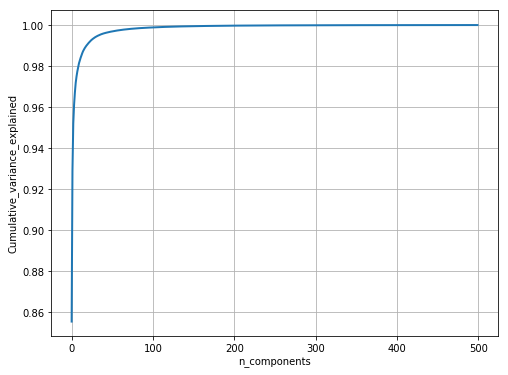

In [90]:
from sklearn.decomposition import TruncatedSVD
svd = TruncatedSVD(n_components = 500)
model = svd.fit_transform(CoMatDF)

percentage_var_explained = svd.explained_variance_ / np.sum(svd.explained_variance_);
cum_var_explained = np.cumsum(percentage_var_explained)

# cumulative explained variance vs n_components
plt.figure(figsize=(8, 6))
plt.plot(cum_var_explained, linewidth=2)
plt.axis()
plt.grid(True)
plt.xlabel('n_components')
plt.ylabel('Cumulative_variance_explained')
plt.show()

### N=100 covers most of the data variance

In [101]:
svd = TruncatedSVD(n_components=100)
result_train=svd.fit_transform(CoMatDF)

print(result_train.shape)
result_train

(2000, 100)


array([[ 8.65975518e+01, -2.49066971e+01, -3.10935040e+00, ...,
         9.86882871e-01,  1.54994059e+00, -1.71166994e+00],
       [ 2.76688889e+02, -6.70872185e+01,  1.26368687e+02, ...,
        -2.09911203e+00,  9.34264311e+00, -1.65988069e+00],
       [ 6.25623395e+02, -1.48470007e+02,  9.01505226e+01, ...,
        -1.01651050e+01,  1.14323711e+01, -3.07212495e+00],
       ...,
       [ 1.05075709e+02, -4.08002191e+01, -1.06634487e+00, ...,
        -8.18547436e+00,  2.15838542e+00, -2.02250520e+00],
       [ 5.27617420e+01, -5.20953656e+00,  1.52674437e+01, ...,
         7.05827172e-01, -5.99726051e-01, -9.53859538e-01],
       [ 4.11328688e+03, -1.04290408e+03, -4.74685879e+02, ...,
        -3.29641916e+01, -1.01006062e+01, -2.70600036e+01]])

 >- Vectorize the essay text and project titles using these word vectors. (while vectorizing, do ignore all the words which are not in top 2k words)

In [113]:
model = result_train
glove_words = set(df_idf_sort_desc_2k.index)
keys={}
for i,j in enumerate(glove_words):
    #print(i,j)
    keys[j]=i
keys

{'keys': 0,
 'severely': 1,
 'predominately': 2,
 'scenes': 3,
 'palsy': 4,
 'association': 5,
 'enabling': 6,
 'versions': 7,
 'fly': 8,
 'librarian': 9,
 'schedules': 10,
 'hearted': 11,
 'believer': 12,
 'containers': 13,
 'makeup': 14,
 'nannanstudent': 15,
 'happened': 16,
 'climb': 17,
 'chess': 18,
 'traumatic': 19,
 'signs': 20,
 'eyed': 21,
 'hoops': 22,
 'invest': 23,
 'fewer': 24,
 'bill': 25,
 'confined': 26,
 'luxury': 27,
 'amazes': 28,
 'packed': 29,
 'nannancreative': 30,
 'concerned': 31,
 'immigrated': 32,
 'thin': 33,
 'unprepared': 34,
 'reuse': 35,
 'joyful': 36,
 'basically': 37,
 '94': 38,
 'saved': 39,
 'recorded': 40,
 'christmas': 41,
 'facilities': 42,
 'breathe': 43,
 'diet': 44,
 'housed': 45,
 'approaches': 46,
 'graduates': 47,
 'understandings': 48,
 'rare': 49,
 'myriad': 50,
 'wet': 51,
 'closing': 52,
 'yearning': 53,
 'windows': 54,
 'brainpop': 55,
 'reside': 56,
 'refrigerator': 57,
 'miami': 58,
 'bonus': 59,
 'demonstrated': 60,
 'ti': 61,
 'wors

## Make Data Model Ready: project_essay | AVG W2V

In [114]:
# average Word2Vec for Train Essay
# compute average word2vec for each review.
X_train_essay_avg_w2v = []; # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(X_train['essay'].values): # for each review/sentence
    vector = np.zeros(100) # as word vectors are of zero length
    cnt_words =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if word in glove_words: #glove_word is a set
            vector += model[keys[word]]
            cnt_words += 1
    if cnt_words != 0:
        vector /= cnt_words
    X_train_essay_avg_w2v.append(vector)

print(len(X_train_essay_avg_w2v))
print(len(X_train_essay_avg_w2v[0]))

100%|█████████████████████████████████████████████████████████████████████████| 33500/33500 [00:01<00:00, 26634.93it/s]


33500
100


In [116]:
# average Word2Vec for Test Essay
# compute average word2vec for each review.
X_test_essay_avg_w2v = []; # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(X_test['essay'].values): # for each review/sentence
    vector = np.zeros(100) # as word vectors are of zero length
    cnt_words =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if word in glove_words:
            vector += model[keys[word]]
            cnt_words += 1
    if cnt_words != 0:
        vector /= cnt_words
    X_test_essay_avg_w2v.append(vector)

print(len(X_test_essay_avg_w2v))
print(len(X_test_essay_avg_w2v[0]))

100%|█████████████████████████████████████████████████████████████████████████| 16500/16500 [00:00<00:00, 27144.56it/s]


16500
100


## Make Data Model Ready: project_title | AVG W2V

In [118]:
# average Word2Vec for Train Title
# compute average word2vec for each review.
X_train_title_avg_w2v = []; # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(X_train['project_title'].values): # for each review/sentence
    vector = np.zeros(100) # as word vectors are of zero length
    cnt_words =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if word in glove_words:
            vector += model[keys[word]]
            cnt_words += 1
    if cnt_words != 0:
        vector /= cnt_words
    X_train_title_avg_w2v.append(vector)

print(len(X_train_title_avg_w2v))
print(len(X_train_title_avg_w2v[0]))

100%|████████████████████████████████████████████████████████████████████████| 33500/33500 [00:00<00:00, 270856.90it/s]


33500
100


In [119]:
# average Word2Vec for Test Essay
# compute average word2vec for each review.
X_test_title_avg_w2v = []; # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(X_test['project_title'].values): # for each review/sentence
    vector = np.zeros(100) # as word vectors are of zero length
    cnt_words =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if word in glove_words:
            vector += model[keys[word]]
            cnt_words += 1
    if cnt_words != 0:
        vector /= cnt_words
    X_test_title_avg_w2v.append(vector)

print(len(X_test_title_avg_w2v))
print(len(X_test_title_avg_w2v[0]))

100%|████████████████████████████████████████████████████████████████████████| 16500/16500 [00:00<00:00, 280415.63it/s]


16500
100


<h2>2.4 Merge the features from <font color='red'>step 3</font> and <font color='red'>step 4</font></h2>

In [97]:
# please write all the code with proper documentation, and proper titles for each subsection
# go through documentations and blogs before you start coding
# first figure out what to do, and then think about how to do.
# reading and understanding error messages will be very much helpfull in debugging your code
# when you plot any graph make sure you use 
    # a. Title, that describes your plot, this will be very helpful to the reader
    # b. Legends if needed
    # c. X-axis label
    # d. Y-axis label

In [120]:
# merge two sparse matrices: https://stackoverflow.com/a/19710648/4084039
from scipy.sparse import hstack
X_tr_set5_GBT = hstack((X_train_state_ohe, X_train_clean_ohe, X_train_cleanSub_ohe, X_train_grade_ohe,X_train_teacher_ohe, X_train_quantity_norm, X_train_TprevPrj_norm, X_train_price_norm,X_train_neg_norm,X_train_pos_norm,X_train_neu_norm,X_train_compound_norm, X_train_title_wc_norm,X_train_essay_wc_norm,X_train_essay_avg_w2v,X_train_title_avg_w2v)).tocsr()
X_te_set5_GBT = hstack((X_test_state_ohe, X_test_clean_ohe,X_test_cleanSub_ohe, X_test_grade_ohe,X_test_teacher_ohe, X_test_quantity_norm, X_test_TprevPrj_norm, X_test_price_norm, X_test_neg_norm,X_test_pos_norm,X_test_neu_norm,X_test_compound_norm,X_test_title_wc_norm, X_test_essay_wc_norm,X_test_essay_avg_w2v,X_test_title_avg_w2v)).tocsr()

print("Final Data matrix | XGBOOST")
print(X_tr_set5_GBT.shape, y_train.shape)
print(X_te_set5_GBT.shape, y_test.shape)
print("="*100)

Final Data matrix | XGBOOST
(33500, 308) (33500,)
(16500, 308) (16500,)


<h2>2.5 Apply XGBoost on the Final Features from the above section</h2>

https://xgboost.readthedocs.io/en/latest/python/python_intro.html

In [99]:
# No need to split the data into train and test(cv)
# use the Dmatrix and apply xgboost on the whole data
# please check the Quora case study notebook as reference

# please write all the code with proper documentation, and proper titles for each subsection
# go through documentations and blogs before you start coding
# first figure out what to do, and then think about how to do.
# reading and understanding error messages will be very much helpfull in debugging your code
# when you plot any graph make sure you use 
    # a. Title, that describes your plot, this will be very helpful to the reader
    # b. Legends if needed
    # c. X-axis label
    # d. Y-axis label

In [121]:
import sys
import math
 
import numpy as np
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import roc_auc_score

# you might need to install this one
import xgboost as xgb

class XGBoostClassifier():
    def __init__(self, num_boost_round=10, **params):
        self.clf = None
        self.num_boost_round = num_boost_round
        self.params = params
        self.params.update({'objective': 'multi:softprob'})
 
    def fit(self, X, y, num_boost_round=None):
        num_boost_round = num_boost_round or self.num_boost_round
        self.label2num = {label: i for i, label in enumerate(sorted(set(y)))}
        dtrain = xgb.DMatrix(X, label=[self.label2num[label] for label in y])
        self.clf = xgb.train(params=self.params, dtrain=dtrain, num_boost_round=num_boost_round, verbose_eval=1)
 
    def predict(self, X):
        num2label = {i: label for label, i in self.label2num.items()}
        Y = self.predict_proba(X)
        y = np.argmax(Y, axis=1)
        return np.array([num2label[i] for i in y])
 
    def predict_proba(self, X):
        dtest = xgb.DMatrix(X)
        return self.clf.predict(dtest)
 
    def score(self, X, y):
        Y = self.predict_proba(X)[:,1]
        return roc_auc_score(y, Y)
 
    def get_params(self, deep=True):
        return self.params
 
    def set_params(self, **params):
        if 'num_boost_round' in params:
            self.num_boost_round = params.pop('num_boost_round')
        if 'objective' in params:
            del params['objective']
        self.params.update(params)
        return self


In [144]:
XGclf = XGBoostClassifier(eval_metric = 'auc', num_class = 2, nthread = 4)
###################################################################
#               Change from here                                  #
###################################################################
parameters = {
    'num_boost_round': [5,11,15,21,25], #[100, 250, 500],
    'eta': [0.05, 0.1, 0.3],
    'max_depth': [2,3,5,7,10],  #[6, 9, 12],
    'subsample': [0.9, 1.0],
    'colsample_bytree': [0.9, 1.0],
}

clf = GridSearchCV(XGclf, parameters,cv=3, scoring='roc_auc', return_train_score=True)
# return_train_score : boolean, default=False
# If False, the cv_results_ attribute will not include training scores. Computing training scores is used to
# get insights on how different parameter settings impact the overfitting/underfitting trade-off. However computing
# the scores on the training set can be computationally expensive and is not strictly required to select the parameters
# that yield the best generalization performance.


#X = np.array([[1,2], [3,4], [2,1], [4,3], [1,0], [4,5]])
#Y = np.array([0, 1, 0, 1, 0, 1])
clf.fit(X_tr_set5_GBT, y_train)

GridSearchCV(cv=3, error_score='raise-deprecating',
             estimator=<__main__.XGBoostClassifier object at 0x000001FA524BEA58>,
             iid='warn', n_jobs=None,
             param_grid={'colsample_bytree': [0.9, 1.0],
                         'eta': [0.05, 0.1, 0.3], 'max_depth': [2, 3, 5, 7, 10],
                         'num_boost_round': [5, 11, 15, 21, 25],
                         'subsample': [0.9, 1.0]},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=True,
             scoring='roc_auc', verbose=0)

In [146]:
print(clf.best_estimator_)
print(clf.best_params_)
print(clf.score(X_te_set5_GBT, y_test))

{'colsample_bytree': 1.0, 'eta': 0.3, 'max_depth': 2, 'num_boost_round': 11, 'subsample': 0.9}
0.5589668798423189


In [130]:
##t(clf.cv_results_)
#best_parameters, score, _ = max(clf.cv_results_, key=lambda x: x[1])
#print("best_parameters:",best_parameters)
#print('score:', score)
#for # in sorted(best_parameters.keys()):
#    print("%s: %r" % (param_name, best_parameters[param_name]))

ValueError: too many values to unpack (expected 3)

In [129]:
#best_parameters

NameError: name 'best_parameters' is not defined

In [132]:
#clf.cv_results_
#clf.
print(clf.best_estimator_)

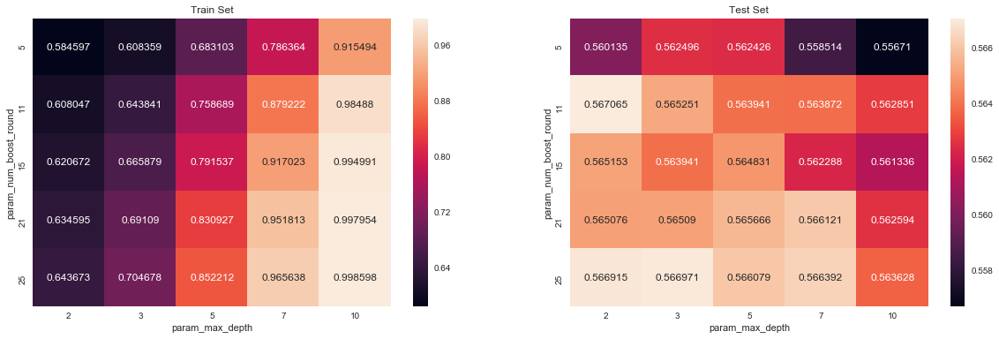

In [147]:
# from Assignment 8_DonorsChoose_DT

# https://seaborn.pydata.org/generated/seaborn.heatmap.html  
import seaborn as sns; sns.set()
max_scores1=pd.DataFrame(clf.cv_results_).groupby(['param_num_boost_round','param_max_depth']).max().unstack()[['mean_test_score','mean_train_score']]

fig,ax=plt.subplots(1,2,figsize=(20,6))

sns.heatmap(max_scores1.mean_train_score,annot=True,fmt='4g',ax=ax[0])
sns.heatmap(max_scores1.mean_test_score,annot=True,fmt='4g',ax=ax[1])

ax[0].set_title('Train Set')
ax[1].set_title('Test Set')

plt.show()

In [148]:
print(clf.score(X_tr_set5_GBT,y_train))
print(clf.score(X_te_set5_GBT,y_test))
print(clf.best_params_)
print(clf.best_score_)

0.5930462801691487
0.5589668798423189
{'colsample_bytree': 1.0, 'eta': 0.3, 'max_depth': 2, 'num_boost_round': 11, 'subsample': 0.9}
0.567064911747751


# Best Parameter
'max_depth': 2, 'num_boost_round': 11

In [149]:
#Best tune parameters
param_grid = {'max_depth': [2],
              'num_boost_round': [11]
             }

In [150]:
#code source: http://occam.olin.edu/sites/default/files/DataScienceMaterials/machine_learning_lecture_2/Machine%20Learning%20Lecture%202.html
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.datasets import *
import xgboost as xgb

#Using GridSearchCV
# https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html
# XGBoostError: value 0 for Parameter num_class should be greater equal to 1
modelbestXBb = GridSearchCV(XGBoostClassifier(num_class = 2),param_grid)
modelbestXBb.fit(X_tr_set5_GBT, y_train)

print(modelbestXBb.best_score_)
print(modelbestXBb.score(X_te_set5_GBT, y_test))

0.559504953417887
0.5552580828647962


{'max_depth': 2, 'num_boost_round': 11}
0.5552580828647962


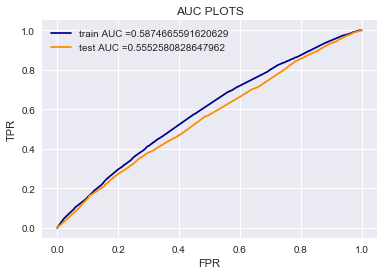

In [152]:
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html#sklearn.metrics.roc_curve
from sklearn.metrics import roc_curve, auc

y_train_XB_pred = modelbestXBb.predict_proba(X_tr_set5_GBT)[:,1]
y_test_XB_pred = modelbestXBb.predict_proba(X_te_set5_GBT)[:,1]

print(modelbestXBb.best_params_)
print(modelbestXBb.score(X_te_set5_GBT, y_test))

train_fpr, train_tpr, tr_thresholds = roc_curve(y_train, y_train_XB_pred)
test_fpr, test_tpr, te_thresholds = roc_curve(y_test, y_test_XB_pred)

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)),color='darkblue')
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)),color='darkorange')
plt.legend()
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("AUC PLOTS")
plt.grid(True)
plt.show()

In [153]:
# we are writing our own function for predict, with defined thresould
# we will pick a threshold that will give the least fpr
def predict(proba, threshould, fpr, tpr):
    
    t = threshould[np.argmax(tpr*(1-fpr))]
    
    # (tpr*(1-fpr)) will be maximum if your fpr is very low and tpr is very high
    
    print("the maximum value of tpr*(1-fpr)", max(tpr*(1-fpr)), "for threshold", np.round(t,3))
    predictions = []
    for i in proba:
        if i>=t:
            predictions.append(1)
        else:
            predictions.append(0)
    return predictions

In [154]:
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.confusion_matrix.html
print("="*100)
from sklearn.metrics import confusion_matrix
print("Train confusion matrix")
print(confusion_matrix(y_train, predict(y_train_XB_pred, tr_thresholds, train_fpr, train_tpr)))
print("Test confusion matrix")
print(confusion_matrix(y_test, predict(y_test_XB_pred, te_thresholds, test_fpr, test_tpr)))

Train confusion matrix
the maximum value of tpr*(1-fpr) 0.31716043603290306 for threshold 0.836
[[ 2856  2312]
 [12072 16260]]
Test confusion matrix
the maximum value of tpr*(1-fpr) 0.2900099541519036 for threshold 0.837
[[1310 1236]
 [6089 7865]]


the maximum value of tpr*(1-fpr) 0.31716043603290306 for threshold 0.836


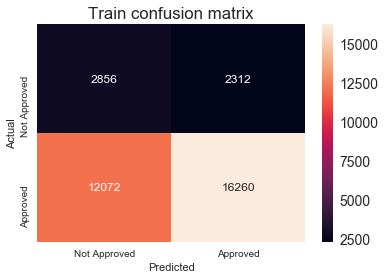

the maximum value of tpr*(1-fpr) 0.2900099541519036 for threshold 0.837


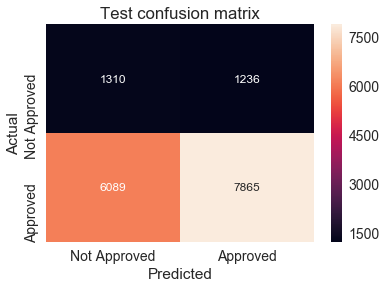

In [155]:
import seaborn as snTr
import seaborn as snTe
import pandas as pdH
import matplotlib.pyplot as pltTr
import matplotlib.pyplot as pltTe

# https://stackoverflow.com/questions/35572000/how-can-i-plot-a-confusion-matrix
arrayTr=confusion_matrix(y_train, predict(y_train_XB_pred, tr_thresholds, train_fpr, train_tpr))
df_cmTr = pdH.DataFrame(arrayTr,range(2),range(2))
#print(arrayTr)
# https://stackoverflow.com/questions/32723798/how-do-i-add-a-title-to-seaborn-heatmap
axTr = pltTr.axes()

snTr.set(font_scale=1.4)#for label size

# https://seaborn.pydata.org/generated/seaborn.heatmap.html

snTr.heatmap(df_cmTr, annot=True,annot_kws={"size": 12},fmt="d",ax=axTr)# font size, format in digit

labels=['Not Approved','Approved']
axTr.set_xticklabels(labels)
axTr.set_yticklabels(labels)
#Suggestion 4.Label confusion matrix heatmap with actual and predicted labels.
pltTr.title("Train confusion matrix")
pltTr.xlabel("Predicted")
pltTr.ylabel("Actual")
pltTr.show()

# https://stackoverflow.com/questions/50947776/plot-two-seaborn-heatmap-graphs-side-by-side
#fig, ax =plt.subplots(1,1)

# https://stackoverflow.com/questions/35572000/how-can-i-plot-a-confusion-matrix
arrayTe=confusion_matrix(y_test, predict(y_test_XB_pred, te_thresholds, test_fpr, test_tpr))
df_cmTe = pdH.DataFrame(arrayTe,range(2),range(2))

axTe = pltTe.axes()

snTe.set(font_scale=1.4)#for label size

# https://seaborn.pydata.org/generated/seaborn.heatmap.html
snTe.heatmap(df_cmTe, annot=True,annot_kws={"size": 12},fmt="d",ax=axTe)# font size, format in digit

#Suggestion 4.Label confusion matrix heatmap with actual and predicted labels.
axTe.set_xticklabels(labels)
axTe.set_yticklabels(labels)
pltTe.title("Test confusion matrix")
pltTe.xlabel("Predicted")
pltTe.ylabel("Actual")
pltTe.show()

<h1>3. Conclusion</h1>

In [156]:
# Please write down few lines about what you observed from this assignment. 
# Please compare all your models using Prettytable library
from prettytable import PrettyTable
    
x = PrettyTable()

x.field_names = ["Vectorizer", "Model", "max_depth", "num_boost_round","AUC"]

x.add_row(["wordtovec", "XgBoost  ", 2, 11, 0.5552580828647962 ])

print(x)

+------------+-----------+-----------+-----------------+--------------------+
| Vectorizer |   Model   | max_depth | num_boost_round |        AUC         |
+------------+-----------+-----------+-----------------+--------------------+
| wordtovec  | XgBoost   |     2     |        11       | 0.5552580828647962 |
+------------+-----------+-----------+-----------------+--------------------+


# Summary

## Step followed

--------------

- Preprocessing of Project_subject_categories
- Preprocessing of Project_subject_subcategories
- Preprocessing of Project_grade_category
- Preprocessing of teacher_prefix
- Text Preprocessing for Project essay and Project Title
- Numeric feature for Essay, no of wordcount
- Numeric feature for Project Title, no of wordcount
- Compute Sentiment score
	- 'neg', 'pos', 'neu', 'compound'
	
- Add Numeric features (preprocessed_essay, preprocessed_title), 
	Essay word count, Project's title word count, 
	Compute Sentiment score('neg', 'pos', 'neu', 'compound') 
	in project_data

- Took first 50000 data points for doing the assignment # and removed the Class lable (Project_is_approved)	
- Split the data in Train and Test

Making datamodel ready

text
          - encoding of school_state is splited into Train and Test vector
          - encoding of clean_category is splited into Train and Test vector
          - encoding of clean_subcategory is splited into Train and Test vector
          - encoding of project_grade_category is splited into Train and Test vector
          - encoding of teacher_prefix is splited into Train and Test vector
			  
numeric
          - encoding of quantity is splited into Train and Test vector    
          - encoding of teacher_number_of_previously_posted_projects is splited into Train and Test vector
          - encoding of price is splited into Train and Test vector                
          - encoding of sentimental score | neg, is splited into Train and Test vector
          - encoding of sentimental score | pos, is splited into Train and Test vector
          - encoding of sentimental score | neu, is splited into Train and Test vector
          - encoding of sentimental score | compound, is splited into Train and Test vector
          - encoding of numerical | number of words in the title, is splited into Train and Test vector
          - encoding of numerical | number of words in the essay, is splited into Train and Test vector

- concatanate essay text with project title in EssayTitle and then find the top 2k words 
	- Vectorize EssayTitle, with TFIDFVectorizer.
	- Made a dataframe with, Tfidf_vectorizer.get_feature_names() as index and Tfidf_vectorizer.idf_ as columns
	- sort with argsort() to sort with index
	- Take top 2000 words
	
-Create Co-Occurance MAtrix
	- Function chk_with_Key_feature_list: This take Text as input, and return true, if it exist in Key_feature_list
	- Function cal_occ: this take whole Dataframe, Corpus list, rangeLength, Window=5
		For each word in CorpusList,
			it check if the word is present in Key_feature_list, by calling chk_with_Key_feature_list function	
				if the word exist: For a window of 5 word, both left and right side of the data, it check			
					it call chk_with_Key_feature_list function, and check its neigbour (here 5) one by one
						if i=j, i,e, it is a diagonal matrix, then ignore
						else : increment the count of the Dataframe for that i,j cell
	- numpy matrix of all zero is initialize
	- Datafrmae is created on above numpy matrix, with Top_features words as both rows index and columns index
	- Window of neighobr is 5
	- populate Key_feature_list, top tfidf text
	- for each and every value of rows of EssayTitle	
		- put all the words of cell, as a list, andput it in CorpusList
		- calculate rangelength of CorpusList
		- Call cal_occ function with above values
	-print the Co-occurance matrix
	
- Run TruncatedSVD with n_component = 500
- draw the plot between cum_var_explained and n_components
- choose best n_components (here 100)
- Use TruncateSVD, to reduce the dimensionality of matrix.
- take the top 2000 words, in glove_word, inorder to chech, against the word of Essay and project_title.
	- if the word exist, then we need to derive the avgW2V.
	
- merge via hstack,  'said' categorical , numerical features + project_title(avgW2V) + preprocessed_essay (avgW2V)
- Fit a model on on train (on above merge features) data by using GridSearchCV(XGBoostClassifier(eval_metric = 'auc', num_class = 2, nthread = 4)
- take the mean_train and mean-test value from the  above fit model.
- Draw HEATMAP for both train and test data, between param_num_boost_round, param_max_depth and AUC(mean_train/test_score).
- Choose best max_depth and num_boost_round from best_param_ function
- Draw roc_auc graph
- Create Confusion matrix, in heatmap